In [ ]:
from IPython.core.display import display, HTML
display(HTML("<style>.container {width:90% !important;}</style>"))

In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
%matplotlib inline

import warnings
warnings.filterwarnings(action='ignore')

pd.set_option('display.max_columns', None) # 컬럼 수가 많으므로 요약되어 표시되지 않게 함

In [52]:
plt.rcParams['xtick.color'] = 'white'
plt.rcParams['ytick.color'] = 'white'
plt.rcParams['axes.labelcolor'] = 'white'
plt.rcParams['axes.titlecolor'] = 'white'
plt.rcParams['figure.titlesize'] = 30
plt.rcParams["font.family"] = "NanumGothic"


# 데이터 불러오기

In [18]:
import pandas as pd

train = pd.read_csv("./train.csv")
train = train.drop(columns = ["id"], axis = 1)


test = pd.read_csv("./test.csv")
test = test.drop(columns = ["id"], axis = 1)

submission = pd.read_csv("./sample_submission.csv")

print(f'train set은 {train.shape[1]} 개의 feature를 가진 {train.shape[0]} 개의 데이터 샘플로 이루어져 있습니다.')
print(train.shape)
train.head()

train set은 23 개의 feature를 가진 3000 개의 데이터 샘플로 이루어져 있습니다.
(3000, 23)


,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes,target
0,Female,disloyal Customer,22,Business travel,Eco,1599,3,0,3,3,4,3,4,4,5,4,4,4,5,4,0,0.0,0
1,Female,Loyal Customer,37,Business travel,Business,2810,2,4,4,4,1,4,3,5,5,4,2,1,5,2,18,18.0,0
2,Male,Loyal Customer,46,Business travel,Business,2622,1,1,1,1,4,5,5,4,4,4,4,5,4,3,0,0.0,1
3,Female,disloyal Customer,24,Business travel,Eco,2348,3,3,3,3,3,3,3,3,2,4,5,3,4,3,10,2.0,0
4,Female,Loyal Customer,58,Business travel,Business,105,3,3,3,3,4,4,5,4,4,4,4,4,4,5,0,0.0,1


In [19]:
print(f'test set은 {test.shape[1]} 개의 feature를 가진 {test.shape[0]} 개의 데이터 샘플로 이루어져 있습니다.')
print(test.shape)
test.head()

test set은 22 개의 feature를 가진 2000 개의 데이터 샘플로 이루어져 있습니다.
(2000, 22)


,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,Female,Loyal Customer,61,Personal Travel,Eco,2037,1,1,1,1,3,5,5,5,5,5,5,3,5,3,51,58.0
1,Female,disloyal Customer,27,Business travel,Business,1846,1,1,1,4,1,1,1,1,3,4,5,4,4,1,0,0.0
2,Female,Loyal Customer,52,Business travel,Business,1622,4,4,4,4,4,3,4,5,5,5,5,4,5,3,0,0.0
3,Male,Loyal Customer,54,Business travel,Business,3534,4,4,4,4,5,4,5,2,2,2,2,5,2,1,0,0.0
4,Female,Loyal Customer,41,Business travel,Eco,1471,4,3,3,3,4,4,4,4,3,1,2,5,4,4,0,0.0


In [20]:
numeric_features = train.columns[(train.dtypes == "float64") | (train.dtypes == "int64")]

categorical_features = train.columns[(train.dtypes == "O")]

print("수치형 데이터는 다음과 같습니다. \n ", list(numeric_features))
print("\n")
print("범주형 데이터는 다음과 같습니다. \n ", list(categorical_features))

수치형 데이터는 다음과 같습니다. 
  ['Age', 'Flight Distance', 'Seat comfort', 'Departure/Arrival time convenient', 'Food and drink', 'Gate location', 'Inflight wifi service', 'Inflight entertainment', 'Online support', 'Ease of Online booking', 'On-board service', 'Leg room service', 'Baggage handling', 'Checkin service', 'Cleanliness', 'Online boarding', 'Departure Delay in Minutes', 'Arrival Delay in Minutes', 'target']


범주형 데이터는 다음과 같습니다. 
  ['Gender', 'Customer Type', 'Type of Travel', 'Class']


In [21]:
print(f"수치형 데이터 컬럼의 개수는 {len(numeric_features)}")
print(f"범주형 데이터 컬럼의 개수는 {len(categorical_features)}")

수치형 데이터 컬럼의 개수는 19
범주형 데이터 컬럼의 개수는 4


In [22]:
#결측치 있는지 확인하는 함수

def check_missing_col(dataframe):
    
    missing_col = []
    counted_missing_col = 0
    for i, col in enumerate(dataframe.columns):
        missing_values = sum(dataframe[col].isna())
        is_missing = True if missing_values >= 1 else False
        if is_missing:
            counted_missing_col += 1
            print(f'결측치가 있는 컬럼은: {col}입니다')
            print(f'총 {missing_values}개의 결측치가 존재합니다.\n')
            missing_col.append([col, dataframe[col].dtype])
    print(f'결측치가 있는 컬럼 의 개수는 {counted_missing_col} 입니다')

    if counted_missing_col == 0:
        print('결측치가 존재하지 않습니다')

    return missing_col




In [23]:
missing_col = check_missing_col(train)
print(missing_col)

결측치가 있는 컬럼 의 개수는 0 입니다
결측치가 존재하지 않습니다
[]


In [24]:
missing_col = check_missing_col(test)
print(missing_col)

결측치가 있는 컬럼 의 개수는 0 입니다
결측치가 존재하지 않습니다
[]


In [25]:
train.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes,target
0,Female,disloyal Customer,22,Business travel,Eco,1599,3,0,3,3,4,3,4,4,5,4,4,4,5,4,0,0.0,0
1,Female,Loyal Customer,37,Business travel,Business,2810,2,4,4,4,1,4,3,5,5,4,2,1,5,2,18,18.0,0
2,Male,Loyal Customer,46,Business travel,Business,2622,1,1,1,1,4,5,5,4,4,4,4,5,4,3,0,0.0,1
3,Female,disloyal Customer,24,Business travel,Eco,2348,3,3,3,3,3,3,3,3,2,4,5,3,4,3,10,2.0,0
4,Female,Loyal Customer,58,Business travel,Business,105,3,3,3,3,4,4,5,4,4,4,4,4,4,5,0,0.0,1


In [26]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 23 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Gender                             3000 non-null   object 
 1   Customer Type                      3000 non-null   object 
 2   Age                                3000 non-null   int64  
 3   Type of Travel                     3000 non-null   object 
 4   Class                              3000 non-null   object 
 5   Flight Distance                    3000 non-null   int64  
 6   Seat comfort                       3000 non-null   int64  
 7   Departure/Arrival time convenient  3000 non-null   int64  
 8   Food and drink                     3000 non-null   int64  
 9   Gate location                      3000 non-null   int64  
 10  Inflight wifi service              3000 non-null   int64  
 11  Inflight entertainment             3000 non-null   int64

# 기초 통계 분석

In [27]:
def numeric_histogram(df) :
    
    plt.style.use("ggplot")

    # 히스토그램 을 사용해서 데이터의 분포를 살펴봅니다.
    plt.figure(figsize=(25,20))
    
    plt.suptitle("numeric histogram", fontsize=40)

    # id는 제외하고 시각화합니다.
    cols = df.columns
    for i in range(len(cols)):
        plt.subplot(5,5,i+1)
        plt.title(cols[i], fontsize=20, color = "black")
        if len(df[cols[i]].unique()) > 20:
            plt.hist(df[cols[i]], bins=20, color='b', alpha=0.7)
        else:
            temp = df[cols[i]].value_counts()
            plt.bar(temp.keys(), temp.values, width=0.5, alpha=0.7)
            plt.xticks(temp.keys())
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

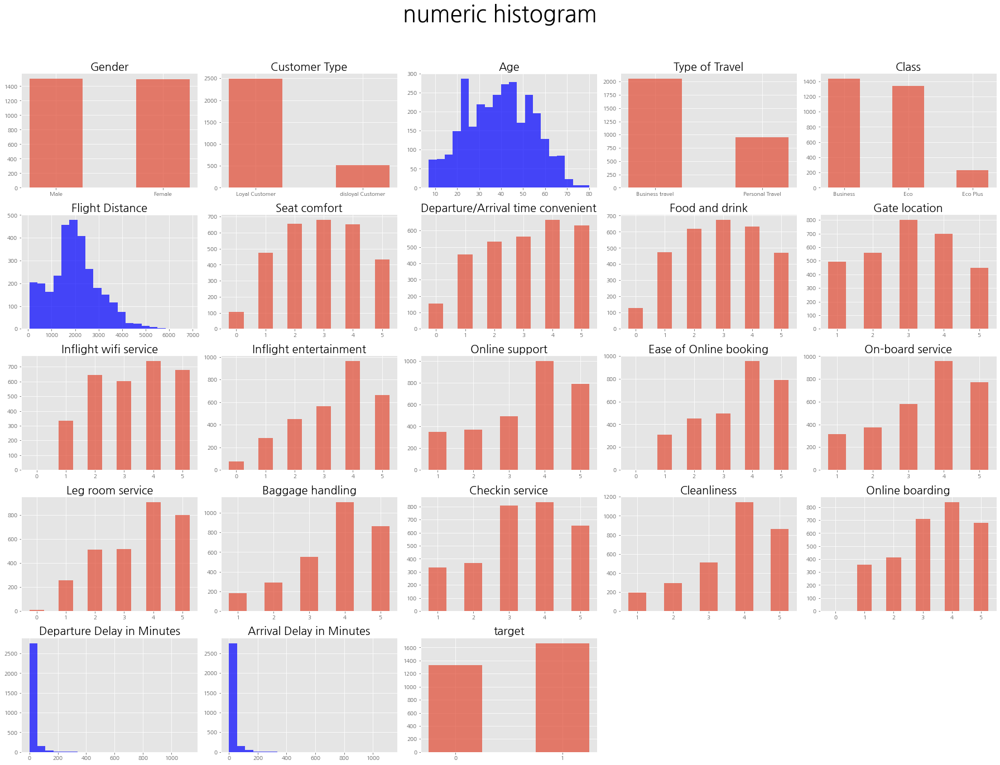

In [28]:
numeric_histogram(train)

### lastdefiance20 님 코드 참고
#  



데이터 훑어볼 때 두가지 우선적으로 살펴보기!
- 데이터의 분포가 상대적으로 매우 적은지 => 매우 적다면 범주를 합치거나 하는 등의 변환이 필요함
- 데이터의 분포가 극단적으로 치우쳐 있는지 => log 변환 등의 방법을 통해 정규화해주는 작업이 필요함  
#    


위의 일변량 그래프에서 주목해야할 점!
- Flight Distance, Departure Delay in Minutes, Arrival Delay in Minutes 등의 그래프가 왼쪽으로 치우쳐져 있다는 점
- Leg room service 등 1~5를 가진 feature중에서 0값의 분포가 매우 적다는 점

#   
수치형 데이터 박스플랏
- Flight Distance, Departure Delay in Minutes, Arrival Delay in Minutes에 이상치들이 보임


In [29]:
def numeric_boxplots(df):
    
    plt.style.use("ggplot")

    feature = numeric_features

    # Boxplot을 이용해서 데이터의 분포 살펴보기

    plt.figure(figsize = (20,15))
    plt.suptitle("수치형데이터 - boxplot", fontsize = 40)

    for i in range(len(feature)) :
        plt.subplot(5,4,i+1)
        plt.title(feature[i], color = "black")
        plt.boxplot(df[feature[i]])
    plt.show()

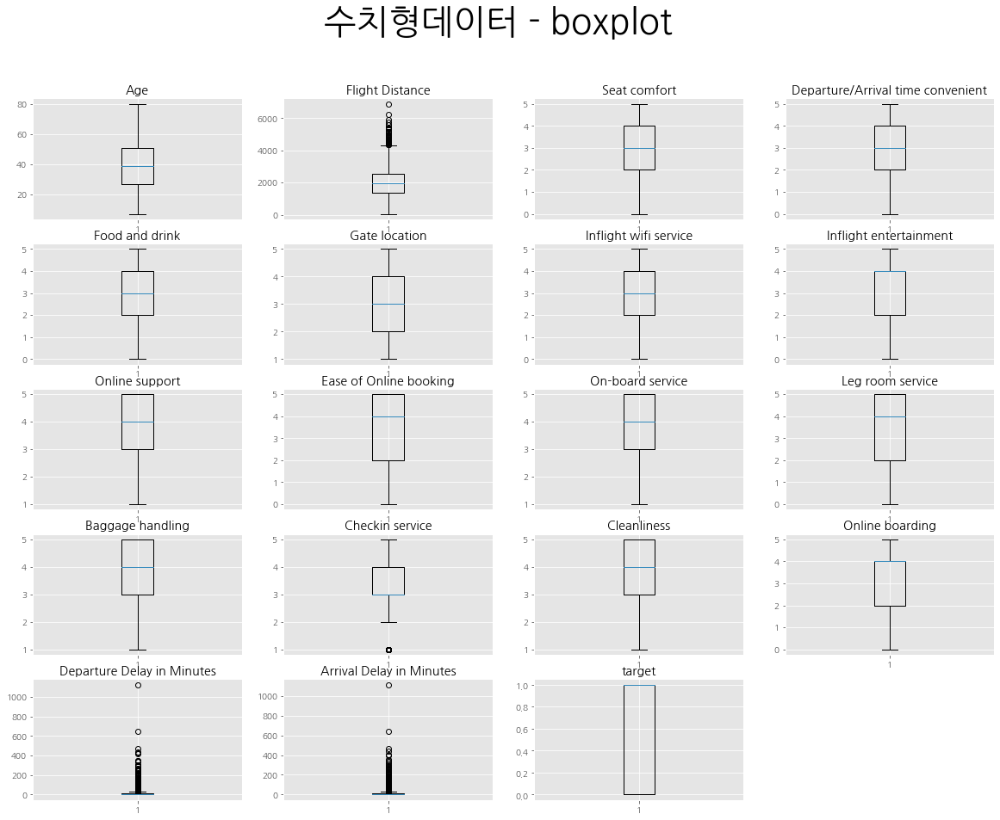

In [30]:
numeric_boxplots(train)



성지코딩님 코드 참고
- 박스들이 중간에 있을 수록 이상치가 없을수록 골고루 분포되어 있는것으로 해석할 수 있음
- 즉 target이 0이던 1이던 골고루 있다는 것은 그렇게 중요한 특징이 아니라는 것


In [34]:
def numeric_vs_target(df):    
    
    # 수치형 데이터 분리
    #numeric_feature = data.columns[(data.dtypes=='int64') | (data.dtypes=='float')]
    num_data = df[numeric_features]

    # 박스플롯
    fig, axes = plt.subplots(4, 5, figsize=(25, 20))

    fig.suptitle('수치형 vs target', fontsize= 40)
    for ax, col in zip(axes.flat, num_data.columns[:-1]):
       
        sns.boxplot(x= 'target', y= col, ax=ax, data=num_data)
        ax.set_title(col, fontsize=20,color = "b")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

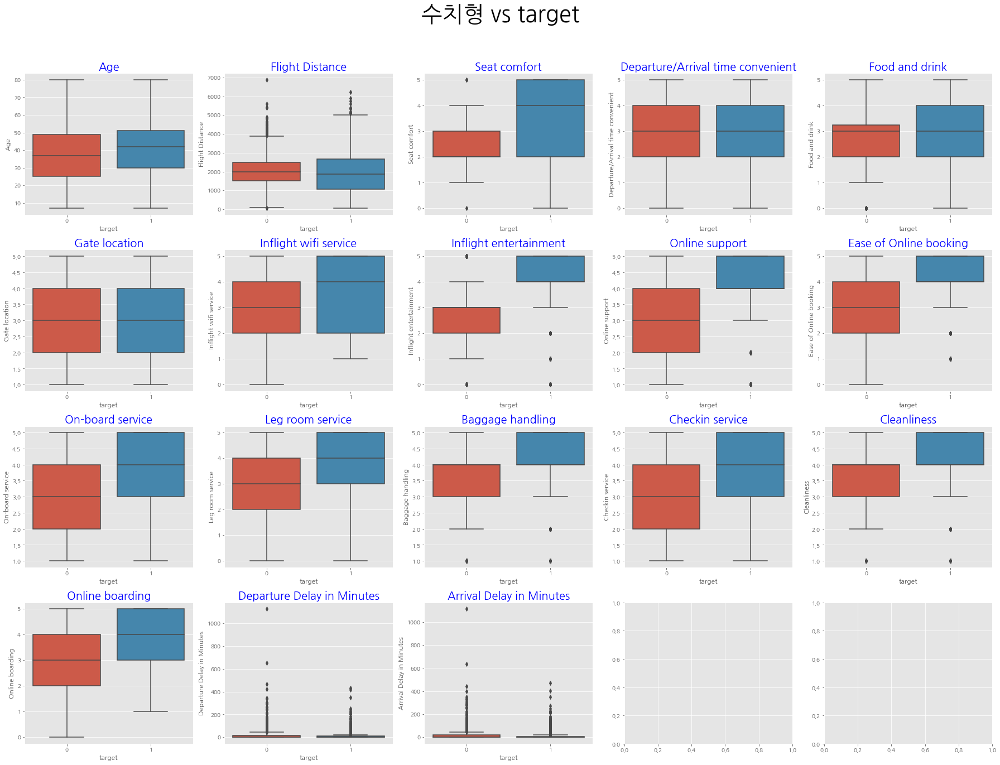

In [35]:
numeric_vs_target(train)

In [46]:
def categorical_vs_target(df):    
    
    # 타겟 설정
    target = "target"
    # 범주형 데이터 분리
    categorical_feature = df.columns[df.dtypes=='object']

    plt.figure(figsize=(20,15))
    plt.suptitle("Violin Plot", fontsize=40)

    # id는 제외하고 시각화합니다.
    for i in range(len(categorical_feature)):
        plt.subplot(2,2,i+1)
        plt.xlabel(categorical_feature[i])
        plt.ylabel(target)
        sns.violinplot(x= df[categorical_feature[i]], y= df[target])
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

In [42]:
categorical_features

Index(['Gender', 'Customer Type', 'Type of Travel', 'Class'], dtype='object')

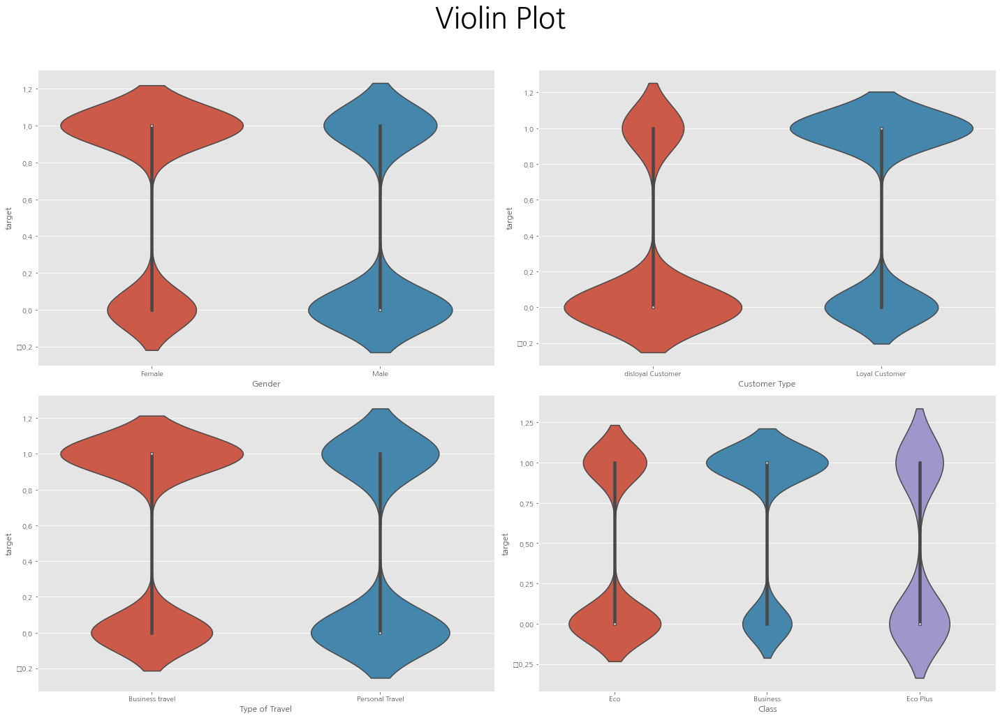

In [47]:
categorical_vs_target(train)

- gender의 경우 1은 여자가 많고 0은 남자가 많음
- Customer Type의 경우 disloyal customer와 Loyal customer에 남녀 차이가 남
- Type of Travel도 여자가 1이 많음
- Ckass의 경우 Business가 1이 많음 eco와 eco plus는 비슷

# 상관계수 확인

# 
- target을 기준으로 상관계수 값을보면 Inlflight entertainment, Online support, Ease of Online booking 등등이 높은 상관계수 값을 보임

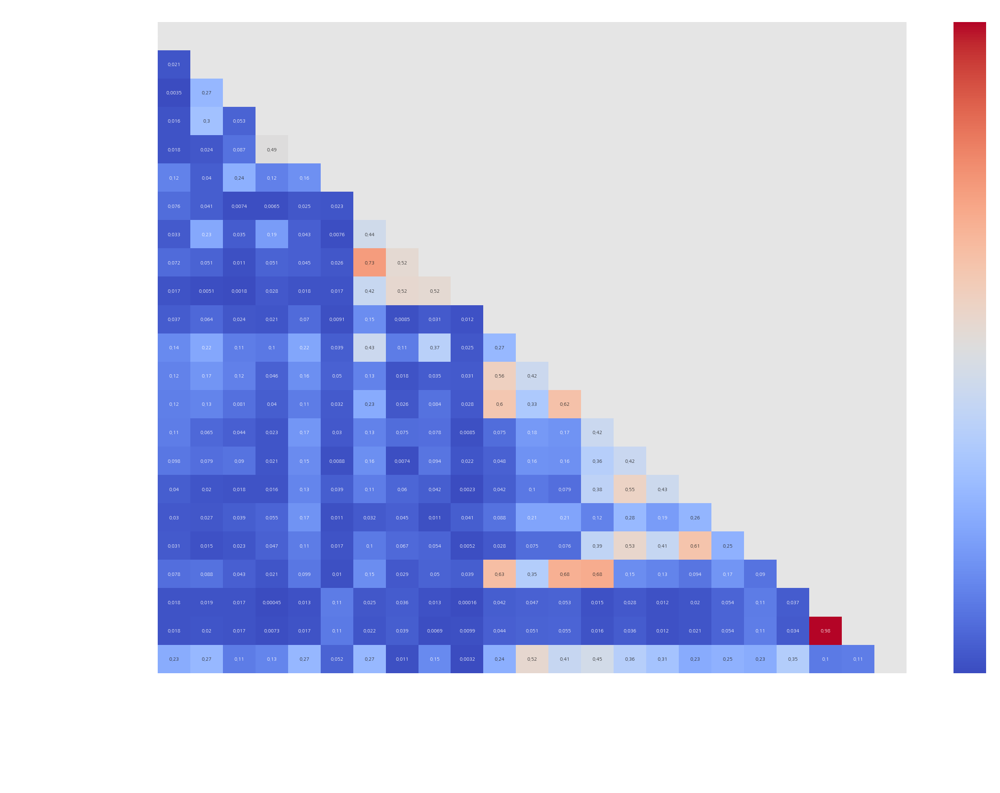

In [59]:
corr_df = train.copy()
corr_df[corr_df.columns[corr_df.dtypes=='O']] = corr_df[corr_df.columns[corr_df.dtypes=='O']].astype(str).apply(LabelEncoder().fit_transform)

plt.figure(figsize=(35,25))

heat_table = abs(corr_df.corr())
mask = np.zeros_like(heat_table)
mask[np.triu_indices_from(mask)] = True
heatmap_ax = sns.heatmap(heat_table, annot=True, mask = mask, cmap='coolwarm')
heatmap_ax.set_xticklabels(heatmap_ax.get_xticklabels(), fontsize=20, rotation=45)
heatmap_ax.set_yticklabels(heatmap_ax.get_yticklabels(), fontsize=20)
plt.title('correlation between features', fontsize=40)
plt.show()

## Departure Delay in Minutes 와 Arrival Delay in Minutes에 대하여

- 출발시간이 지연되면 당연히 도착시간도 지연됨   
- 둘의 상관계수는 0.98로 매우 높은 상관관계를 가짐   
- 관련 키워드는 다중 공선성.   
    - 즉 target이 아닌 특징들에 대하여 서로 **독립적**인 관계여야 함
    - 위의 두 특징은 서로 독립적인 관계가 아니고 거의 하나로 움직이게 됨. 주로 상관계수가 0.7이상일 때 다중 공선성이 나타난다고 함
    - 0.7 이상의 특징쌍이 하나 더 보임. 'Food and drink' 와 'Seat confort'. 좌석의 편리성과 음식 관계는 비싼 좌석일수록 자리가 편하고 음식이 잘 나오므로 높게 나타난것으로 추정
    
    - 다중 공선성 처리 방법중 가장 간단한 방법은 둘 중 한 특징을 제거하는 것
        - 2개의 쌍 중 target과의 상관계수가 낮은 특징을 제거할 계획
        - Departure Delay in Minutes & Arrival Delay in Minutes (target과의 상관관계 : 0.1 & 0.11) => Departure Delay in Minutes 제거
        - Food and drink & Seat confort (target과의 상관관계 : 0.15 & 0.27) => Food and drink 제거

In [60]:
# Departure Delay in Minutes 와 Food and drink 컬럼 제거


train_df = train.copy()
test_df = test.copy()


train_df.drop("Departure Delay in Minutes", axis = 1, inplace = True)
train_df.drop("Food and drink", axis = 1, inplace = True)

test_df.drop("Departure Delay in Minutes", axis = 1, inplace = True)
test_df.drop("Food and drink", axis = 1, inplace = True)

### 이상치 확인
# 
- Flight Distance, Departure Delay in Minutes, Arrival Delay in Minutes에 이상치가 많음(원본데이터를 봤을 때!)
- 이상치는 제거하자!

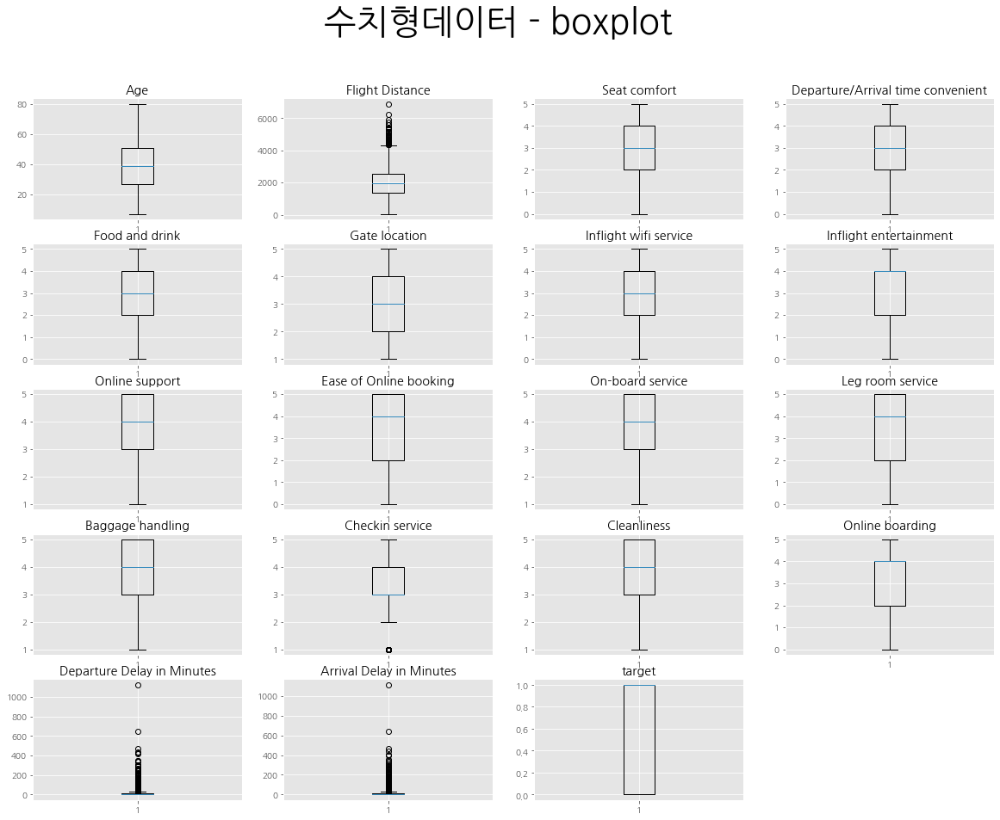

In [61]:
numeric_boxplots(train)

In [86]:
def outlier_index(df):
    
    q1 = df.quantile(.25)
    q3 = df.quantile(.75)
    iqr = q3 - q1
    
    low = q1 - 1.5 * iqr
    high = q3 + 1.5 * iqr
    
    return np.where((df > high) | (df < low))

In [97]:
Arrival_Delay_in_Minutes_index = outlier_index(train_df["Arrival Delay in Minutes"])[0]
Flight_Distance_index = outlier_index(train_df["Flight Distance"])[0]
Checkin_service_index = outlier_index(train_df["Checkin service"])[0]

이상치 행 drop하려 했지만 개수가 많아 평균값으로 대체

- Checkin service는 이상치 하나
- Arrival Delay in Minutes와, Flight Distance는 이상치가 꽤 있음
- 평균값말고 회귀분석으로 예측도 해보면 괜찮을 듯!?

In [98]:
train_df.loc[Arrival_Delay_in_Minutes_index, "Arrival Delay in Minutes"] = train_df["Arrival Delay in Minutes"].mean()
train_df.loc[Flight_Distance_index, "Flight Distance"] = train_df["Flight Distance"].mean()
train_df.loc[Checkin_service_index, "Checkin service"] = train_df["Checkin service"].mean()

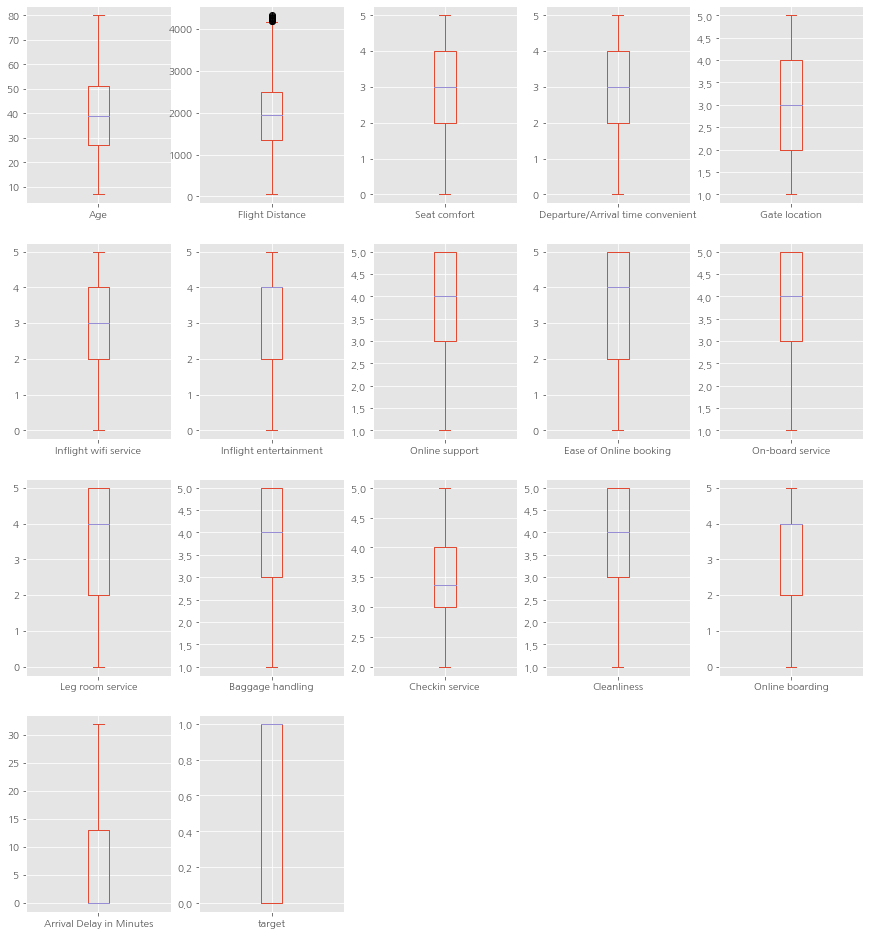

In [108]:
train_df.plot(kind = "box", subplots = True, figsize = (15,21), layout = (5,5))
plt.show()

In [127]:
Arrival_Delay_in_Minutes_index = outlier_index(test_df["Arrival Delay in Minutes"])[0]
Flight_Distance_index = outlier_index(test_df["Flight Distance"])[0]
Checkin_service_index = outlier_index(test_df["Checkin service"])[0]

test_df.loc[Arrival_Delay_in_Minutes_index, "Arrival Delay in Minutes"] = test_df["Arrival Delay in Minutes"].mean()
test_df.loc[Flight_Distance_index, "Flight Distance"] = test_df["Flight Distance"].mean()
test_df.loc[Checkin_service_index, "Checkin service"] = test_df["Checkin service"].mean()


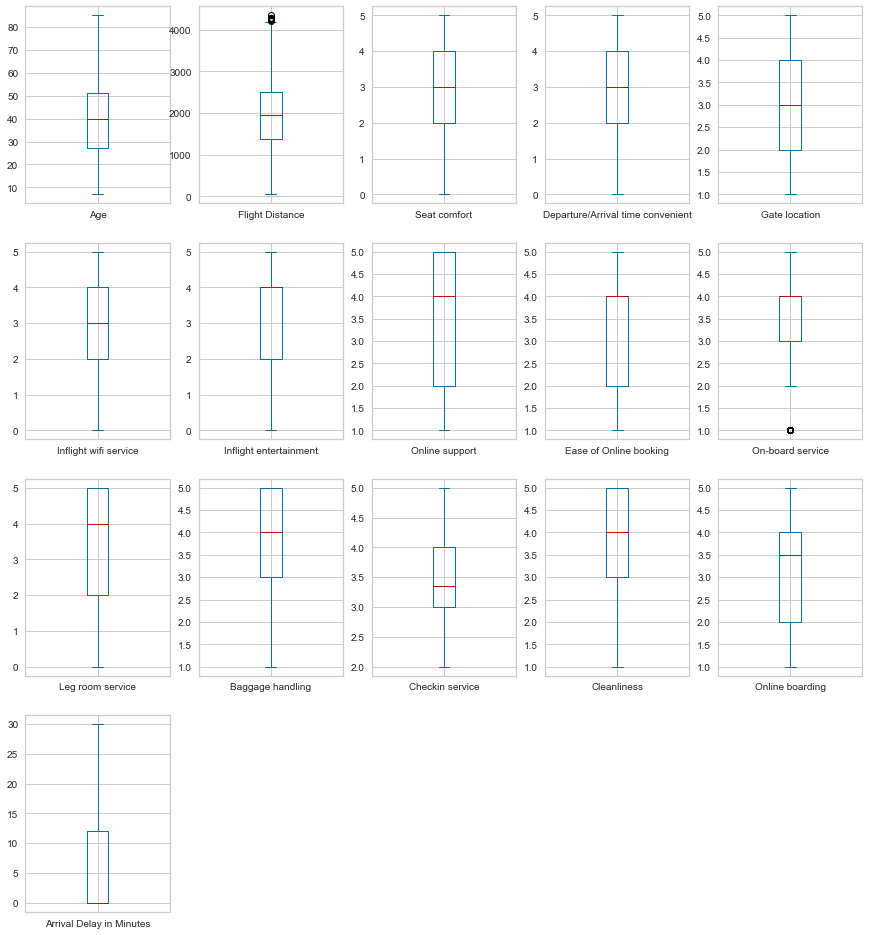

In [128]:
test_df.plot(kind = "box", subplots = True, figsize = (15,21), layout = (5,5))
plt.show()

On-board service에서 이상치 하나가 보임. 나중에 처리해보기!

# 원본 데이터 라벨링

- 범주형 데이터
###  
    - Gender : Female, Male
    - Customer Type : disloyal Customer, Loyal Customer
    - Type of Travel : Business Travel , Personal Travel
    - Class : Eco, Business, Eco Plus
### 
- Gender는 원핫인코딩..?
- Customer Type, Type of Travel도 원핫? 차이가 있긴 함
- Class에서 Business는 차이가 남 Eco, Eco Plus는 차이가 별로...

In [129]:
# 데이터 셋
train_df[train_df.columns[train_df.dtypes=='O']] = train_df[train_df.columns[train_df.dtypes=='O']].astype(str).apply(LabelEncoder().fit_transform)

# 테스트 셋
test_df[test_df.columns[test_df.dtypes=='O']] = test_df[test_df.columns[test_df.dtypes=='O']].astype(str).apply(LabelEncoder().fit_transform)

# 모델 학습하기

In [111]:
from pycaret.classification import *
clf1 = setup(data = train_df,
             silent = True,
             target = 'target',
             session_id = 19950425,
             log_experiment=True,
             n_jobs = -1)

,Description,Value
0,session_id,19950425
1,Target,target
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(3000, 21)"
5,Missing Values,0
6,Numeric Features,4
7,Categorical Features,16
8,Ordinal Features,0
9,High Cardinality Features,0


In [112]:
best = compare_models(n_select = 5, fold = 10)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9300,0.9813,0.9334,0.9408,0.9370,0.8582,0.8586,0.1330
rf,Random Forest Classifier,0.9176,0.9738,0.9309,0.9228,0.9262,0.8328,0.8343,0.0930
gbc,Gradient Boosting Classifier,0.9176,0.9741,0.9240,0.9282,0.9258,0.8331,0.8336,0.1140
et,Extra Trees Classifier,0.9166,0.9763,0.9283,0.9234,0.9256,0.8308,0.8313,0.0810
lr,Logistic Regression,0.9009,0.9638,0.9113,0.9121,0.9113,0.7990,0.7999,0.7010
ada,Ada Boost Classifier,0.8961,0.9609,0.9053,0.9090,0.9067,0.7895,0.7904,0.0550
ridge,Ridge Classifier,0.8957,0.0000,0.9053,0.9081,0.9064,0.7885,0.7893,0.0050
lda,Linear Discriminant Analysis,0.8952,0.9622,0.9053,0.9074,0.9060,0.7875,0.7883,0.0100
dt,Decision Tree Classifier,0.8723,0.8707,0.8840,0.8889,0.8856,0.7410,0.7427,0.0070
nb,Naive Bayes,0.8633,0.9342,0.8397,0.9094,0.8726,0.7256,0.7291,0.0050


# 모델 학습하기

In [125]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from ngboost import NGBClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier

from sklearn.model_selection import KFold

from sklearn.model_selection import cross_val_score # 교차검증
from sklearn.model_selection import train_test_split


from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV

In [139]:
cat_class = CatBoostClassifier()
ngb_class = NGBClassifier()
gb_class = GradientBoostingClassifier()
rf_class = RandomForestClassifier()
dt_class = DecisionTreeClassifier()
xgb_class = XGBClassifier()
lgbm_class = LGBMClassifier()
extra_class = ExtraTreesClassifier()
lr = LogisticRegression()

In [176]:
X_data = train_df.drop(columns = ["target"], axis = 1)
y_target = train_df["target"]

X_test = test_df

In [141]:
def get_avg_accuracy_cv(models):
    
    for model in models:
        
        # 분할하지 않고 전체 데이터로 cross_val_score() 수행
        accuracy_avg = np.mean(cross_val_score(model, X_data, y_target, scoring = "accuracy", cv = 5 ))
        #NMAE_avg = mae_avg / np.mean(np.abs(y_target))
        
        print("\n{0} CV 평균 Accuracy 값 : {1}".format(model.__class__.__name__, np.round(accuracy_avg,3)))
        
        #return NMAE_avg

In [132]:
models = [cat_class, ngb_class, gb_class, rf_class, dt_class, xgb_class, lgbm_class,lr,extra_class]

get_avg_accuracy_cv(models)

Learning rate set to 0.014972
0:	learn: 0.6787772	total: 148ms	remaining: 2m 27s
1:	learn: 0.6645284	total: 155ms	remaining: 1m 17s
2:	learn: 0.6518080	total: 161ms	remaining: 53.6s
3:	learn: 0.6390835	total: 166ms	remaining: 41.5s
4:	learn: 0.6273473	total: 170ms	remaining: 33.8s
5:	learn: 0.6149884	total: 173ms	remaining: 28.6s
6:	learn: 0.6049342	total: 176ms	remaining: 25s
7:	learn: 0.5943459	total: 178ms	remaining: 22.1s
8:	learn: 0.5852633	total: 181ms	remaining: 19.9s
9:	learn: 0.5736040	total: 183ms	remaining: 18.2s
10:	learn: 0.5601062	total: 186ms	remaining: 16.7s
11:	learn: 0.5503511	total: 188ms	remaining: 15.5s
12:	learn: 0.5406702	total: 190ms	remaining: 14.5s
13:	learn: 0.5317387	total: 193ms	remaining: 13.6s
14:	learn: 0.5231517	total: 195ms	remaining: 12.8s
15:	learn: 0.5130611	total: 197ms	remaining: 12.1s
16:	learn: 0.5048517	total: 200ms	remaining: 11.5s
17:	learn: 0.4964089	total: 202ms	remaining: 11s
18:	learn: 0.4886647	total: 204ms	remaining: 10.5s
19:	learn: 0.

175:	learn: 0.1870764	total: 521ms	remaining: 2.44s
176:	learn: 0.1864974	total: 524ms	remaining: 2.43s
177:	learn: 0.1861763	total: 526ms	remaining: 2.43s
178:	learn: 0.1858030	total: 528ms	remaining: 2.42s
179:	learn: 0.1853900	total: 530ms	remaining: 2.41s
180:	learn: 0.1847531	total: 532ms	remaining: 2.41s
181:	learn: 0.1843988	total: 534ms	remaining: 2.4s
182:	learn: 0.1838865	total: 536ms	remaining: 2.39s
183:	learn: 0.1831638	total: 538ms	remaining: 2.38s
184:	learn: 0.1827841	total: 540ms	remaining: 2.38s
185:	learn: 0.1823397	total: 542ms	remaining: 2.37s
186:	learn: 0.1819122	total: 544ms	remaining: 2.37s
187:	learn: 0.1813694	total: 546ms	remaining: 2.36s
188:	learn: 0.1807817	total: 548ms	remaining: 2.35s
189:	learn: 0.1802962	total: 550ms	remaining: 2.34s
190:	learn: 0.1796165	total: 552ms	remaining: 2.34s
191:	learn: 0.1792381	total: 554ms	remaining: 2.33s
192:	learn: 0.1789276	total: 556ms	remaining: 2.33s
193:	learn: 0.1786088	total: 558ms	remaining: 2.32s
194:	learn: 0

341:	learn: 0.1337065	total: 870ms	remaining: 1.67s
342:	learn: 0.1335753	total: 872ms	remaining: 1.67s
343:	learn: 0.1333790	total: 874ms	remaining: 1.67s
344:	learn: 0.1332235	total: 875ms	remaining: 1.66s
345:	learn: 0.1330321	total: 877ms	remaining: 1.66s
346:	learn: 0.1327982	total: 879ms	remaining: 1.65s
347:	learn: 0.1326229	total: 881ms	remaining: 1.65s
348:	learn: 0.1324621	total: 883ms	remaining: 1.65s
349:	learn: 0.1322225	total: 885ms	remaining: 1.64s
350:	learn: 0.1321647	total: 887ms	remaining: 1.64s
351:	learn: 0.1319095	total: 889ms	remaining: 1.64s
352:	learn: 0.1317373	total: 891ms	remaining: 1.63s
353:	learn: 0.1315070	total: 893ms	remaining: 1.63s
354:	learn: 0.1313281	total: 895ms	remaining: 1.63s
355:	learn: 0.1311031	total: 897ms	remaining: 1.62s
356:	learn: 0.1309805	total: 899ms	remaining: 1.62s
357:	learn: 0.1308557	total: 901ms	remaining: 1.62s
358:	learn: 0.1305880	total: 903ms	remaining: 1.61s
359:	learn: 0.1305129	total: 906ms	remaining: 1.61s
360:	learn: 

512:	learn: 0.1049645	total: 1.22s	remaining: 1.16s
513:	learn: 0.1048414	total: 1.22s	remaining: 1.15s
514:	learn: 0.1047370	total: 1.22s	remaining: 1.15s
515:	learn: 0.1045263	total: 1.22s	remaining: 1.15s
516:	learn: 0.1042946	total: 1.23s	remaining: 1.15s
517:	learn: 0.1039206	total: 1.23s	remaining: 1.14s
518:	learn: 0.1038155	total: 1.23s	remaining: 1.14s
519:	learn: 0.1036205	total: 1.23s	remaining: 1.14s
520:	learn: 0.1034092	total: 1.23s	remaining: 1.13s
521:	learn: 0.1032233	total: 1.24s	remaining: 1.13s
522:	learn: 0.1030825	total: 1.24s	remaining: 1.13s
523:	learn: 0.1029636	total: 1.24s	remaining: 1.13s
524:	learn: 0.1028511	total: 1.24s	remaining: 1.12s
525:	learn: 0.1027463	total: 1.24s	remaining: 1.12s
526:	learn: 0.1024621	total: 1.25s	remaining: 1.12s
527:	learn: 0.1023155	total: 1.25s	remaining: 1.12s
528:	learn: 0.1021642	total: 1.25s	remaining: 1.11s
529:	learn: 0.1020629	total: 1.25s	remaining: 1.11s
530:	learn: 0.1019750	total: 1.26s	remaining: 1.11s
531:	learn: 

684:	learn: 0.0835012	total: 1.56s	remaining: 720ms
685:	learn: 0.0834129	total: 1.57s	remaining: 717ms
686:	learn: 0.0833145	total: 1.57s	remaining: 715ms
687:	learn: 0.0831957	total: 1.57s	remaining: 713ms
688:	learn: 0.0831303	total: 1.57s	remaining: 710ms
689:	learn: 0.0830658	total: 1.57s	remaining: 708ms
690:	learn: 0.0830004	total: 1.58s	remaining: 705ms
691:	learn: 0.0828998	total: 1.58s	remaining: 703ms
692:	learn: 0.0828595	total: 1.58s	remaining: 701ms
693:	learn: 0.0827589	total: 1.58s	remaining: 698ms
694:	learn: 0.0826928	total: 1.59s	remaining: 696ms
695:	learn: 0.0825798	total: 1.59s	remaining: 694ms
696:	learn: 0.0825164	total: 1.59s	remaining: 691ms
697:	learn: 0.0824523	total: 1.59s	remaining: 689ms
698:	learn: 0.0822656	total: 1.59s	remaining: 686ms
699:	learn: 0.0821740	total: 1.6s	remaining: 684ms
700:	learn: 0.0821143	total: 1.6s	remaining: 682ms
701:	learn: 0.0820735	total: 1.6s	remaining: 679ms
702:	learn: 0.0820060	total: 1.6s	remaining: 677ms
703:	learn: 0.08

863:	learn: 0.0689412	total: 1.92s	remaining: 302ms
864:	learn: 0.0688793	total: 1.92s	remaining: 299ms
865:	learn: 0.0688432	total: 1.92s	remaining: 297ms
866:	learn: 0.0687419	total: 1.92s	remaining: 295ms
867:	learn: 0.0687121	total: 1.92s	remaining: 293ms
868:	learn: 0.0686475	total: 1.93s	remaining: 290ms
869:	learn: 0.0686180	total: 1.93s	remaining: 288ms
870:	learn: 0.0685268	total: 1.93s	remaining: 286ms
871:	learn: 0.0684732	total: 1.93s	remaining: 284ms
872:	learn: 0.0683724	total: 1.93s	remaining: 281ms
873:	learn: 0.0682747	total: 1.94s	remaining: 279ms
874:	learn: 0.0682182	total: 1.94s	remaining: 277ms
875:	learn: 0.0681747	total: 1.94s	remaining: 275ms
876:	learn: 0.0681256	total: 1.94s	remaining: 272ms
877:	learn: 0.0680080	total: 1.94s	remaining: 270ms
878:	learn: 0.0679559	total: 1.95s	remaining: 268ms
879:	learn: 0.0678557	total: 1.95s	remaining: 266ms
880:	learn: 0.0677598	total: 1.95s	remaining: 263ms
881:	learn: 0.0676918	total: 1.95s	remaining: 261ms
882:	learn: 

99:	learn: 0.2416432	total: 207ms	remaining: 1.87s
100:	learn: 0.2407744	total: 209ms	remaining: 1.86s
101:	learn: 0.2402118	total: 211ms	remaining: 1.86s
102:	learn: 0.2395157	total: 213ms	remaining: 1.85s
103:	learn: 0.2387297	total: 215ms	remaining: 1.85s
104:	learn: 0.2377309	total: 217ms	remaining: 1.85s
105:	learn: 0.2372828	total: 219ms	remaining: 1.85s
106:	learn: 0.2359103	total: 221ms	remaining: 1.84s
107:	learn: 0.2348883	total: 223ms	remaining: 1.84s
108:	learn: 0.2332430	total: 225ms	remaining: 1.84s
109:	learn: 0.2323955	total: 227ms	remaining: 1.84s
110:	learn: 0.2316872	total: 229ms	remaining: 1.84s
111:	learn: 0.2309083	total: 231ms	remaining: 1.83s
112:	learn: 0.2303209	total: 233ms	remaining: 1.83s
113:	learn: 0.2293607	total: 235ms	remaining: 1.83s
114:	learn: 0.2281358	total: 237ms	remaining: 1.83s
115:	learn: 0.2266407	total: 239ms	remaining: 1.82s
116:	learn: 0.2257275	total: 241ms	remaining: 1.82s
117:	learn: 0.2250239	total: 243ms	remaining: 1.82s
118:	learn: 0

273:	learn: 0.1498252	total: 556ms	remaining: 1.47s
274:	learn: 0.1496534	total: 558ms	remaining: 1.47s
275:	learn: 0.1492073	total: 560ms	remaining: 1.47s
276:	learn: 0.1490077	total: 562ms	remaining: 1.47s
277:	learn: 0.1487373	total: 564ms	remaining: 1.47s
278:	learn: 0.1485187	total: 566ms	remaining: 1.46s
279:	learn: 0.1481774	total: 568ms	remaining: 1.46s
280:	learn: 0.1479685	total: 571ms	remaining: 1.46s
281:	learn: 0.1477300	total: 573ms	remaining: 1.46s
282:	learn: 0.1473568	total: 575ms	remaining: 1.46s
283:	learn: 0.1469903	total: 577ms	remaining: 1.45s
284:	learn: 0.1468722	total: 579ms	remaining: 1.45s
285:	learn: 0.1465962	total: 581ms	remaining: 1.45s
286:	learn: 0.1462968	total: 583ms	remaining: 1.45s
287:	learn: 0.1461064	total: 585ms	remaining: 1.45s
288:	learn: 0.1459269	total: 587ms	remaining: 1.45s
289:	learn: 0.1457202	total: 590ms	remaining: 1.44s
290:	learn: 0.1455136	total: 592ms	remaining: 1.44s
291:	learn: 0.1451930	total: 594ms	remaining: 1.44s
292:	learn: 

444:	learn: 0.1126058	total: 904ms	remaining: 1.13s
445:	learn: 0.1124928	total: 907ms	remaining: 1.13s
446:	learn: 0.1123584	total: 909ms	remaining: 1.12s
447:	learn: 0.1121019	total: 910ms	remaining: 1.12s
448:	learn: 0.1119198	total: 912ms	remaining: 1.12s
449:	learn: 0.1117963	total: 915ms	remaining: 1.12s
450:	learn: 0.1114212	total: 917ms	remaining: 1.11s
451:	learn: 0.1112659	total: 918ms	remaining: 1.11s
452:	learn: 0.1111199	total: 920ms	remaining: 1.11s
453:	learn: 0.1108711	total: 922ms	remaining: 1.11s
454:	learn: 0.1107496	total: 925ms	remaining: 1.11s
455:	learn: 0.1105934	total: 927ms	remaining: 1.1s
456:	learn: 0.1104052	total: 929ms	remaining: 1.1s
457:	learn: 0.1102530	total: 931ms	remaining: 1.1s
458:	learn: 0.1100560	total: 933ms	remaining: 1.1s
459:	learn: 0.1099277	total: 935ms	remaining: 1.1s
460:	learn: 0.1098305	total: 937ms	remaining: 1.09s
461:	learn: 0.1094497	total: 939ms	remaining: 1.09s
462:	learn: 0.1093131	total: 941ms	remaining: 1.09s
463:	learn: 0.109

620:	learn: 0.0864201	total: 1.25s	remaining: 765ms
621:	learn: 0.0862091	total: 1.25s	remaining: 763ms
622:	learn: 0.0861381	total: 1.26s	remaining: 761ms
623:	learn: 0.0859008	total: 1.26s	remaining: 759ms
624:	learn: 0.0857836	total: 1.26s	remaining: 757ms
625:	learn: 0.0857276	total: 1.26s	remaining: 755ms
626:	learn: 0.0856663	total: 1.26s	remaining: 753ms
627:	learn: 0.0855618	total: 1.27s	remaining: 751ms
628:	learn: 0.0854593	total: 1.27s	remaining: 749ms
629:	learn: 0.0853634	total: 1.27s	remaining: 747ms
630:	learn: 0.0852670	total: 1.27s	remaining: 745ms
631:	learn: 0.0851367	total: 1.27s	remaining: 743ms
632:	learn: 0.0850005	total: 1.28s	remaining: 741ms
633:	learn: 0.0849287	total: 1.28s	remaining: 739ms
634:	learn: 0.0848094	total: 1.28s	remaining: 737ms
635:	learn: 0.0847007	total: 1.28s	remaining: 735ms
636:	learn: 0.0845575	total: 1.28s	remaining: 733ms
637:	learn: 0.0843931	total: 1.29s	remaining: 731ms
638:	learn: 0.0843366	total: 1.29s	remaining: 729ms
639:	learn: 

792:	learn: 0.0686698	total: 1.6s	remaining: 419ms
793:	learn: 0.0685586	total: 1.61s	remaining: 417ms
794:	learn: 0.0684963	total: 1.61s	remaining: 415ms
795:	learn: 0.0684547	total: 1.61s	remaining: 413ms
796:	learn: 0.0683738	total: 1.61s	remaining: 411ms
797:	learn: 0.0683101	total: 1.61s	remaining: 409ms
798:	learn: 0.0682493	total: 1.62s	remaining: 407ms
799:	learn: 0.0681924	total: 1.62s	remaining: 405ms
800:	learn: 0.0681132	total: 1.62s	remaining: 403ms
801:	learn: 0.0680653	total: 1.62s	remaining: 401ms
802:	learn: 0.0680218	total: 1.63s	remaining: 399ms
803:	learn: 0.0678955	total: 1.63s	remaining: 397ms
804:	learn: 0.0678216	total: 1.63s	remaining: 395ms
805:	learn: 0.0677172	total: 1.63s	remaining: 393ms
806:	learn: 0.0676571	total: 1.63s	remaining: 391ms
807:	learn: 0.0675756	total: 1.64s	remaining: 389ms
808:	learn: 0.0675376	total: 1.64s	remaining: 386ms
809:	learn: 0.0674328	total: 1.64s	remaining: 384ms
810:	learn: 0.0672964	total: 1.64s	remaining: 382ms
811:	learn: 0

968:	learn: 0.0569687	total: 1.95s	remaining: 62.5ms
969:	learn: 0.0569210	total: 1.96s	remaining: 60.5ms
970:	learn: 0.0568461	total: 1.96s	remaining: 58.5ms
971:	learn: 0.0567556	total: 1.96s	remaining: 56.5ms
972:	learn: 0.0567258	total: 1.96s	remaining: 54.5ms
973:	learn: 0.0566550	total: 1.97s	remaining: 52.5ms
974:	learn: 0.0565773	total: 1.97s	remaining: 50.4ms
975:	learn: 0.0565366	total: 1.97s	remaining: 48.4ms
976:	learn: 0.0564595	total: 1.97s	remaining: 46.4ms
977:	learn: 0.0563938	total: 1.97s	remaining: 44.4ms
978:	learn: 0.0563123	total: 1.98s	remaining: 42.4ms
979:	learn: 0.0562403	total: 1.98s	remaining: 40.4ms
980:	learn: 0.0561494	total: 1.98s	remaining: 38.3ms
981:	learn: 0.0560928	total: 1.98s	remaining: 36.3ms
982:	learn: 0.0559901	total: 1.98s	remaining: 34.3ms
983:	learn: 0.0559121	total: 1.99s	remaining: 32.3ms
984:	learn: 0.0558487	total: 1.99s	remaining: 30.3ms
985:	learn: 0.0557271	total: 1.99s	remaining: 28.3ms
986:	learn: 0.0556698	total: 1.99s	remaining: 

203:	learn: 0.1802340	total: 424ms	remaining: 1.65s
204:	learn: 0.1797590	total: 426ms	remaining: 1.65s
205:	learn: 0.1794756	total: 429ms	remaining: 1.65s
206:	learn: 0.1791375	total: 431ms	remaining: 1.65s
207:	learn: 0.1787731	total: 432ms	remaining: 1.65s
208:	learn: 0.1785900	total: 435ms	remaining: 1.65s
209:	learn: 0.1782205	total: 437ms	remaining: 1.64s
210:	learn: 0.1779430	total: 439ms	remaining: 1.64s
211:	learn: 0.1772137	total: 441ms	remaining: 1.64s
212:	learn: 0.1768408	total: 443ms	remaining: 1.64s
213:	learn: 0.1765042	total: 445ms	remaining: 1.63s
214:	learn: 0.1759820	total: 447ms	remaining: 1.63s
215:	learn: 0.1756411	total: 449ms	remaining: 1.63s
216:	learn: 0.1749962	total: 451ms	remaining: 1.63s
217:	learn: 0.1745316	total: 453ms	remaining: 1.62s
218:	learn: 0.1740219	total: 455ms	remaining: 1.62s
219:	learn: 0.1737573	total: 457ms	remaining: 1.62s
220:	learn: 0.1734641	total: 459ms	remaining: 1.62s
221:	learn: 0.1732142	total: 460ms	remaining: 1.61s
222:	learn: 

376:	learn: 0.1326275	total: 771ms	remaining: 1.27s
377:	learn: 0.1324895	total: 773ms	remaining: 1.27s
378:	learn: 0.1322941	total: 775ms	remaining: 1.27s
379:	learn: 0.1320877	total: 777ms	remaining: 1.27s
380:	learn: 0.1318722	total: 780ms	remaining: 1.27s
381:	learn: 0.1317513	total: 781ms	remaining: 1.26s
382:	learn: 0.1315764	total: 783ms	remaining: 1.26s
383:	learn: 0.1312169	total: 785ms	remaining: 1.26s
384:	learn: 0.1311208	total: 787ms	remaining: 1.26s
385:	learn: 0.1309309	total: 790ms	remaining: 1.26s
386:	learn: 0.1307217	total: 792ms	remaining: 1.25s
387:	learn: 0.1305821	total: 794ms	remaining: 1.25s
388:	learn: 0.1301734	total: 796ms	remaining: 1.25s
389:	learn: 0.1298954	total: 798ms	remaining: 1.25s
390:	learn: 0.1296264	total: 800ms	remaining: 1.25s
391:	learn: 0.1294528	total: 802ms	remaining: 1.24s
392:	learn: 0.1292742	total: 804ms	remaining: 1.24s
393:	learn: 0.1291679	total: 806ms	remaining: 1.24s
394:	learn: 0.1288679	total: 809ms	remaining: 1.24s
395:	learn: 

542:	learn: 0.1047561	total: 1.12s	remaining: 943ms
543:	learn: 0.1044910	total: 1.12s	remaining: 941ms
544:	learn: 0.1043820	total: 1.13s	remaining: 939ms
545:	learn: 0.1042487	total: 1.13s	remaining: 937ms
546:	learn: 0.1041318	total: 1.13s	remaining: 935ms
547:	learn: 0.1038840	total: 1.13s	remaining: 933ms
548:	learn: 0.1037883	total: 1.14s	remaining: 933ms
549:	learn: 0.1035014	total: 1.14s	remaining: 931ms
550:	learn: 0.1033773	total: 1.14s	remaining: 931ms
551:	learn: 0.1032538	total: 1.14s	remaining: 929ms
552:	learn: 0.1030600	total: 1.15s	remaining: 927ms
553:	learn: 0.1028009	total: 1.15s	remaining: 924ms
554:	learn: 0.1026474	total: 1.15s	remaining: 923ms
555:	learn: 0.1025617	total: 1.15s	remaining: 921ms
556:	learn: 0.1023995	total: 1.15s	remaining: 919ms
557:	learn: 0.1023098	total: 1.16s	remaining: 916ms
558:	learn: 0.1021049	total: 1.16s	remaining: 914ms
559:	learn: 0.1020414	total: 1.16s	remaining: 912ms
560:	learn: 0.1018679	total: 1.16s	remaining: 910ms
561:	learn: 

716:	learn: 0.0839072	total: 1.47s	remaining: 580ms
717:	learn: 0.0838592	total: 1.47s	remaining: 578ms
718:	learn: 0.0837906	total: 1.47s	remaining: 576ms
719:	learn: 0.0837394	total: 1.47s	remaining: 574ms
720:	learn: 0.0836385	total: 1.48s	remaining: 572ms
721:	learn: 0.0835008	total: 1.48s	remaining: 569ms
722:	learn: 0.0834357	total: 1.48s	remaining: 567ms
723:	learn: 0.0833845	total: 1.48s	remaining: 565ms
724:	learn: 0.0832945	total: 1.49s	remaining: 563ms
725:	learn: 0.0832679	total: 1.49s	remaining: 561ms
726:	learn: 0.0831681	total: 1.49s	remaining: 559ms
727:	learn: 0.0830654	total: 1.49s	remaining: 557ms
728:	learn: 0.0829197	total: 1.49s	remaining: 555ms
729:	learn: 0.0828425	total: 1.5s	remaining: 553ms
730:	learn: 0.0827113	total: 1.5s	remaining: 551ms
731:	learn: 0.0826500	total: 1.5s	remaining: 549ms
732:	learn: 0.0825504	total: 1.5s	remaining: 547ms
733:	learn: 0.0825228	total: 1.5s	remaining: 545ms
734:	learn: 0.0824404	total: 1.5s	remaining: 543ms
735:	learn: 0.0823

879:	learn: 0.0699406	total: 1.82s	remaining: 248ms
880:	learn: 0.0698603	total: 1.82s	remaining: 246ms
881:	learn: 0.0697696	total: 1.82s	remaining: 244ms
882:	learn: 0.0696751	total: 1.82s	remaining: 242ms
883:	learn: 0.0695892	total: 1.83s	remaining: 240ms
884:	learn: 0.0695379	total: 1.83s	remaining: 238ms
885:	learn: 0.0694379	total: 1.83s	remaining: 236ms
886:	learn: 0.0693988	total: 1.83s	remaining: 233ms
887:	learn: 0.0693424	total: 1.83s	remaining: 231ms
888:	learn: 0.0692715	total: 1.84s	remaining: 229ms
889:	learn: 0.0692390	total: 1.84s	remaining: 227ms
890:	learn: 0.0691120	total: 1.84s	remaining: 225ms
891:	learn: 0.0690396	total: 1.84s	remaining: 223ms
892:	learn: 0.0689779	total: 1.84s	remaining: 221ms
893:	learn: 0.0688705	total: 1.85s	remaining: 219ms
894:	learn: 0.0688028	total: 1.85s	remaining: 217ms
895:	learn: 0.0687383	total: 1.85s	remaining: 215ms
896:	learn: 0.0686079	total: 1.85s	remaining: 213ms
897:	learn: 0.0685374	total: 1.85s	remaining: 211ms
898:	learn: 

113:	learn: 0.2317391	total: 247ms	remaining: 1.92s
114:	learn: 0.2307348	total: 249ms	remaining: 1.91s
115:	learn: 0.2299318	total: 251ms	remaining: 1.91s
116:	learn: 0.2294392	total: 252ms	remaining: 1.91s
117:	learn: 0.2289386	total: 254ms	remaining: 1.9s
118:	learn: 0.2280494	total: 256ms	remaining: 1.9s
119:	learn: 0.2274921	total: 258ms	remaining: 1.9s
120:	learn: 0.2266581	total: 261ms	remaining: 1.89s
121:	learn: 0.2256787	total: 263ms	remaining: 1.89s
122:	learn: 0.2252118	total: 265ms	remaining: 1.89s
123:	learn: 0.2240676	total: 267ms	remaining: 1.88s
124:	learn: 0.2233047	total: 269ms	remaining: 1.88s
125:	learn: 0.2225872	total: 271ms	remaining: 1.88s
126:	learn: 0.2219835	total: 273ms	remaining: 1.87s
127:	learn: 0.2210922	total: 275ms	remaining: 1.87s
128:	learn: 0.2194438	total: 277ms	remaining: 1.87s
129:	learn: 0.2178278	total: 279ms	remaining: 1.86s
130:	learn: 0.2172491	total: 281ms	remaining: 1.86s
131:	learn: 0.2160667	total: 283ms	remaining: 1.86s
132:	learn: 0.2

287:	learn: 0.1519658	total: 596ms	remaining: 1.47s
288:	learn: 0.1515143	total: 598ms	remaining: 1.47s
289:	learn: 0.1512714	total: 599ms	remaining: 1.47s
290:	learn: 0.1509477	total: 602ms	remaining: 1.47s
291:	learn: 0.1507803	total: 604ms	remaining: 1.46s
292:	learn: 0.1503162	total: 605ms	remaining: 1.46s
293:	learn: 0.1501034	total: 607ms	remaining: 1.46s
294:	learn: 0.1498378	total: 609ms	remaining: 1.46s
295:	learn: 0.1495410	total: 612ms	remaining: 1.45s
296:	learn: 0.1493641	total: 614ms	remaining: 1.45s
297:	learn: 0.1490385	total: 616ms	remaining: 1.45s
298:	learn: 0.1487891	total: 618ms	remaining: 1.45s
299:	learn: 0.1486683	total: 620ms	remaining: 1.45s
300:	learn: 0.1484220	total: 621ms	remaining: 1.44s
301:	learn: 0.1480914	total: 623ms	remaining: 1.44s
302:	learn: 0.1479494	total: 625ms	remaining: 1.44s
303:	learn: 0.1477366	total: 627ms	remaining: 1.44s
304:	learn: 0.1474971	total: 629ms	remaining: 1.43s
305:	learn: 0.1472674	total: 631ms	remaining: 1.43s
306:	learn: 

464:	learn: 0.1138462	total: 946ms	remaining: 1.09s
465:	learn: 0.1136841	total: 948ms	remaining: 1.09s
466:	learn: 0.1135404	total: 950ms	remaining: 1.08s
467:	learn: 0.1132547	total: 952ms	remaining: 1.08s
468:	learn: 0.1130644	total: 954ms	remaining: 1.08s
469:	learn: 0.1129728	total: 956ms	remaining: 1.08s
470:	learn: 0.1128522	total: 958ms	remaining: 1.07s
471:	learn: 0.1126844	total: 960ms	remaining: 1.07s
472:	learn: 0.1124343	total: 962ms	remaining: 1.07s
473:	learn: 0.1122147	total: 964ms	remaining: 1.07s
474:	learn: 0.1119940	total: 966ms	remaining: 1.07s
475:	learn: 0.1118068	total: 968ms	remaining: 1.06s
476:	learn: 0.1117259	total: 970ms	remaining: 1.06s
477:	learn: 0.1114826	total: 972ms	remaining: 1.06s
478:	learn: 0.1113970	total: 974ms	remaining: 1.06s
479:	learn: 0.1110112	total: 976ms	remaining: 1.06s
480:	learn: 0.1108311	total: 978ms	remaining: 1.05s
481:	learn: 0.1106549	total: 980ms	remaining: 1.05s
482:	learn: 0.1105703	total: 982ms	remaining: 1.05s
483:	learn: 

643:	learn: 0.0886855	total: 1.3s	remaining: 717ms
644:	learn: 0.0886019	total: 1.3s	remaining: 715ms
645:	learn: 0.0884310	total: 1.3s	remaining: 713ms
646:	learn: 0.0883090	total: 1.3s	remaining: 711ms
647:	learn: 0.0882550	total: 1.3s	remaining: 709ms
648:	learn: 0.0880731	total: 1.31s	remaining: 707ms
649:	learn: 0.0880172	total: 1.31s	remaining: 704ms
650:	learn: 0.0878974	total: 1.31s	remaining: 703ms
651:	learn: 0.0877621	total: 1.31s	remaining: 701ms
652:	learn: 0.0876316	total: 1.31s	remaining: 699ms
653:	learn: 0.0875900	total: 1.32s	remaining: 697ms
654:	learn: 0.0875371	total: 1.32s	remaining: 694ms
655:	learn: 0.0874140	total: 1.32s	remaining: 692ms
656:	learn: 0.0873200	total: 1.32s	remaining: 690ms
657:	learn: 0.0871688	total: 1.32s	remaining: 688ms
658:	learn: 0.0870416	total: 1.33s	remaining: 686ms
659:	learn: 0.0869276	total: 1.33s	remaining: 684ms
660:	learn: 0.0868658	total: 1.33s	remaining: 682ms
661:	learn: 0.0868092	total: 1.33s	remaining: 680ms
662:	learn: 0.086

816:	learn: 0.0734804	total: 1.65s	remaining: 369ms
817:	learn: 0.0733977	total: 1.65s	remaining: 367ms
818:	learn: 0.0733484	total: 1.65s	remaining: 365ms
819:	learn: 0.0732721	total: 1.65s	remaining: 363ms
820:	learn: 0.0732098	total: 1.65s	remaining: 361ms
821:	learn: 0.0731171	total: 1.66s	remaining: 359ms
822:	learn: 0.0729857	total: 1.66s	remaining: 357ms
823:	learn: 0.0729132	total: 1.66s	remaining: 355ms
824:	learn: 0.0728166	total: 1.66s	remaining: 353ms
825:	learn: 0.0727276	total: 1.66s	remaining: 351ms
826:	learn: 0.0726839	total: 1.67s	remaining: 349ms
827:	learn: 0.0725889	total: 1.67s	remaining: 347ms
828:	learn: 0.0725103	total: 1.67s	remaining: 345ms
829:	learn: 0.0723019	total: 1.67s	remaining: 343ms
830:	learn: 0.0722354	total: 1.68s	remaining: 341ms
831:	learn: 0.0721090	total: 1.68s	remaining: 339ms
832:	learn: 0.0720411	total: 1.68s	remaining: 337ms
833:	learn: 0.0719864	total: 1.68s	remaining: 335ms
834:	learn: 0.0719333	total: 1.68s	remaining: 333ms
835:	learn: 

977:	learn: 0.0614001	total: 1.99s	remaining: 44.9ms
978:	learn: 0.0613595	total: 2s	remaining: 42.8ms
979:	learn: 0.0612781	total: 2s	remaining: 40.8ms
980:	learn: 0.0611990	total: 2s	remaining: 38.7ms
981:	learn: 0.0611356	total: 2s	remaining: 36.7ms
982:	learn: 0.0610691	total: 2s	remaining: 34.7ms
983:	learn: 0.0609970	total: 2s	remaining: 32.6ms
984:	learn: 0.0608855	total: 2.01s	remaining: 30.6ms
985:	learn: 0.0607941	total: 2.01s	remaining: 28.5ms
986:	learn: 0.0607205	total: 2.01s	remaining: 26.5ms
987:	learn: 0.0606854	total: 2.01s	remaining: 24.5ms
988:	learn: 0.0606358	total: 2.02s	remaining: 22.4ms
989:	learn: 0.0605648	total: 2.02s	remaining: 20.4ms
990:	learn: 0.0605390	total: 2.02s	remaining: 18.3ms
991:	learn: 0.0604891	total: 2.02s	remaining: 16.3ms
992:	learn: 0.0604622	total: 2.02s	remaining: 14.3ms
993:	learn: 0.0604013	total: 2.03s	remaining: 12.2ms
994:	learn: 0.0603437	total: 2.03s	remaining: 10.2ms
995:	learn: 0.0602952	total: 2.03s	remaining: 8.15ms
996:	learn:

211:	learn: 0.1767116	total: 437ms	remaining: 1.62s
212:	learn: 0.1764886	total: 439ms	remaining: 1.62s
213:	learn: 0.1761546	total: 441ms	remaining: 1.62s
214:	learn: 0.1757190	total: 443ms	remaining: 1.62s
215:	learn: 0.1754327	total: 445ms	remaining: 1.61s
216:	learn: 0.1749426	total: 447ms	remaining: 1.61s
217:	learn: 0.1745671	total: 449ms	remaining: 1.61s
218:	learn: 0.1740195	total: 451ms	remaining: 1.61s
219:	learn: 0.1736877	total: 453ms	remaining: 1.61s
220:	learn: 0.1731945	total: 455ms	remaining: 1.6s
221:	learn: 0.1724874	total: 457ms	remaining: 1.6s
222:	learn: 0.1721377	total: 459ms	remaining: 1.6s
223:	learn: 0.1716653	total: 461ms	remaining: 1.6s
224:	learn: 0.1709799	total: 463ms	remaining: 1.59s
225:	learn: 0.1708114	total: 465ms	remaining: 1.59s
226:	learn: 0.1705370	total: 467ms	remaining: 1.59s
227:	learn: 0.1700892	total: 469ms	remaining: 1.59s
228:	learn: 0.1697615	total: 471ms	remaining: 1.58s
229:	learn: 0.1691212	total: 473ms	remaining: 1.58s
230:	learn: 0.16

390:	learn: 0.1287900	total: 789ms	remaining: 1.23s
391:	learn: 0.1286278	total: 791ms	remaining: 1.23s
392:	learn: 0.1285483	total: 793ms	remaining: 1.22s
393:	learn: 0.1283460	total: 795ms	remaining: 1.22s
394:	learn: 0.1281850	total: 797ms	remaining: 1.22s
395:	learn: 0.1279653	total: 799ms	remaining: 1.22s
396:	learn: 0.1278049	total: 801ms	remaining: 1.22s
397:	learn: 0.1275907	total: 819ms	remaining: 1.24s
398:	learn: 0.1274854	total: 821ms	remaining: 1.24s
399:	learn: 0.1272263	total: 823ms	remaining: 1.23s
400:	learn: 0.1271348	total: 825ms	remaining: 1.23s
401:	learn: 0.1268812	total: 828ms	remaining: 1.23s
402:	learn: 0.1266946	total: 830ms	remaining: 1.23s
403:	learn: 0.1265414	total: 832ms	remaining: 1.23s
404:	learn: 0.1263041	total: 833ms	remaining: 1.22s
405:	learn: 0.1262018	total: 835ms	remaining: 1.22s
406:	learn: 0.1259897	total: 837ms	remaining: 1.22s
407:	learn: 0.1255833	total: 839ms	remaining: 1.22s
408:	learn: 0.1253854	total: 841ms	remaining: 1.22s
409:	learn: 

561:	learn: 0.0998172	total: 1.14s	remaining: 887ms
562:	learn: 0.0997194	total: 1.14s	remaining: 885ms
563:	learn: 0.0996440	total: 1.14s	remaining: 883ms
564:	learn: 0.0995896	total: 1.14s	remaining: 881ms
565:	learn: 0.0995019	total: 1.15s	remaining: 878ms
566:	learn: 0.0992975	total: 1.15s	remaining: 876ms
567:	learn: 0.0991352	total: 1.15s	remaining: 875ms
568:	learn: 0.0990664	total: 1.15s	remaining: 873ms
569:	learn: 0.0988356	total: 1.15s	remaining: 871ms
570:	learn: 0.0986635	total: 1.16s	remaining: 869ms
571:	learn: 0.0985565	total: 1.16s	remaining: 867ms
572:	learn: 0.0984060	total: 1.16s	remaining: 865ms
573:	learn: 0.0981672	total: 1.16s	remaining: 863ms
574:	learn: 0.0980633	total: 1.16s	remaining: 861ms
575:	learn: 0.0979947	total: 1.17s	remaining: 859ms
576:	learn: 0.0978738	total: 1.17s	remaining: 857ms
577:	learn: 0.0977186	total: 1.17s	remaining: 855ms
578:	learn: 0.0975858	total: 1.17s	remaining: 853ms
579:	learn: 0.0974860	total: 1.18s	remaining: 851ms
580:	learn: 

734:	learn: 0.0813309	total: 1.49s	remaining: 536ms
735:	learn: 0.0812737	total: 1.49s	remaining: 534ms
736:	learn: 0.0812175	total: 1.49s	remaining: 532ms
737:	learn: 0.0811784	total: 1.49s	remaining: 530ms
738:	learn: 0.0811192	total: 1.5s	remaining: 528ms
739:	learn: 0.0810084	total: 1.5s	remaining: 526ms
740:	learn: 0.0808848	total: 1.5s	remaining: 524ms
741:	learn: 0.0808322	total: 1.5s	remaining: 522ms
742:	learn: 0.0808079	total: 1.5s	remaining: 520ms
743:	learn: 0.0806844	total: 1.5s	remaining: 518ms
744:	learn: 0.0805955	total: 1.51s	remaining: 516ms
745:	learn: 0.0805050	total: 1.51s	remaining: 514ms
746:	learn: 0.0804417	total: 1.51s	remaining: 512ms
747:	learn: 0.0804099	total: 1.51s	remaining: 510ms
748:	learn: 0.0803243	total: 1.51s	remaining: 508ms
749:	learn: 0.0802779	total: 1.52s	remaining: 506ms
750:	learn: 0.0800304	total: 1.52s	remaining: 504ms
751:	learn: 0.0798351	total: 1.52s	remaining: 502ms
752:	learn: 0.0797166	total: 1.52s	remaining: 500ms
753:	learn: 0.0795

903:	learn: 0.0663226	total: 1.83s	remaining: 195ms
904:	learn: 0.0662173	total: 1.84s	remaining: 193ms
905:	learn: 0.0661252	total: 1.84s	remaining: 191ms
906:	learn: 0.0660863	total: 1.84s	remaining: 189ms
907:	learn: 0.0660254	total: 1.84s	remaining: 187ms
908:	learn: 0.0659473	total: 1.85s	remaining: 185ms
909:	learn: 0.0658612	total: 1.85s	remaining: 183ms
910:	learn: 0.0657714	total: 1.85s	remaining: 181ms
911:	learn: 0.0656839	total: 1.85s	remaining: 179ms
912:	learn: 0.0656265	total: 1.85s	remaining: 177ms
913:	learn: 0.0655043	total: 1.86s	remaining: 175ms
914:	learn: 0.0653912	total: 1.86s	remaining: 173ms
915:	learn: 0.0653288	total: 1.86s	remaining: 171ms
916:	learn: 0.0652341	total: 1.86s	remaining: 169ms
917:	learn: 0.0651403	total: 1.86s	remaining: 167ms
918:	learn: 0.0650909	total: 1.87s	remaining: 164ms
919:	learn: 0.0650324	total: 1.87s	remaining: 162ms
920:	learn: 0.0649681	total: 1.87s	remaining: 160ms
921:	learn: 0.0648816	total: 1.87s	remaining: 158ms
922:	learn: 


XGBClassifier CV 평균 Accuracy 값 : -0.934

LGBMClassifier CV 평균 Accuracy 값 : -0.926


XGB, LGBM, Extra, RandomForest, Gradient, catboost가 잘 나옴

# 하이퍼파라미터 튜닝

In [144]:
def predict_best_params(model,X_data, y_target,test, params, cv = 10):
    
    grid_model = GridSearchCV(model, param_grid = params, scoring = "accuracy", cv = cv)
    
    grid_model.fit(X_data, y_target)
    
    accuracy = (1 * grid_model.best_score_)
    #nmae = mae / np.mean(np.abs(y_target))
    
    Model = grid_model.best_estimator_
    Model_pred = Model.predict(test)

    
    print("{0} {1} CV 시 최적 평균 accuracy 값 : {2}, 최적 alpha : {3}".format(model.__class__.__name__, cv , np.round(accuracy,8), grid_model.best_params_))
    print("최적 파라미터로 예측한 값 \n", Model_pred)
    
    return Model_pred

In [169]:
def return_best_params(model,X_data, y_target,test, params, cv = 2):
    
    grid_model = GridSearchCV(model, param_grid = params, scoring = "accuracy", cv = cv)
    
    grid_model.fit(X_data, y_target)
    
    accuracy = (1 * grid_model.best_score_)
    #nmae = mae / np.mean(np.abs(y_target))
    
    Model = grid_model.best_estimator_
    Model_pred = Model.predict(test)

    
    print("{0} {1} CV 시 최적 평균 accuracy 값 : {2}, 최적 alpha : {3}".format(model.__class__.__name__, cv , np.round(accuracy,8), grid_model.best_params_))
    print("최적 파라미터로 예측한 값 \n", Model_pred)
    
    #return Model_pred
    return Model

In [171]:
a= return_best_params(xgb_class,X_data,y_target,test_df,xgb_params)

[23:39:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[23:39:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[23:39:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[23:39:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[23:39:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:39:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:39:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

In [177]:
VotingClassifier(estimators=[("XGB",a)])

VotingClassifier(estimators=[('XGB',
                              XGBClassifier(base_score=0.5, booster='gbtree',
                                            colsample_bylevel=0.9,
                                            colsample_bynode=1,
                                            colsample_bytree=0.5,
                                            enable_categorical=False, gamma=1,
                                            gpu_id=-1, importance_type=None,
                                            interaction_constraints='',
                                            learning_rate=0.300000012,
                                            max_delta_step=0, max_depth=6,
                                            min_child_weight=1, missing=nan,
                                            monotone_constraints='()',
                                            n_estimators=50, n_jobs=4,
                                            nthread=4, num_parallel_tree=1,
                   

In [178]:
b = VotingClassifier(estimators=[("XGB",a)])

In [ ]:
b.fit(X_data, )

In [146]:
rf_params = {
            'n_estimators' : [10, 100, 1000],
           'max_depth' : [6, 8, 10, 12],
           'min_samples_leaf' : [8, 12, 18],
           'min_samples_split' : [8, 16, 20]
            }

xgb_params={
            'booster' :['gbtree'],
             'silent':[True],
             'max_depth':[5,6,8],
             'min_child_weight':[1,3,5],
             'gamma':[0,1,2,3],
             'nthread':[4],
             'colsample_bytree':[0.5,0.8],
             'colsample_bylevel':[0.9],
             'n_estimators':[50],
             'objective':['binary:logistic'],
             'random_state':[2]}

lgbm_params = {
    'learning_rate': [0.005, 0.01],
    'n_estimators': [100, 500, 1000],
    'num_leaves': [12, 16, 20], # large num_leaves helps improve accuracy but might lead to over-fitting
    'boosting_type' : ['dart'], # for better accuracy -> try dart
    'objective' : ['binary'],
    'max_bin':[300, 600], # large max_bin helps improve accuracy but might slow down training progress
    }

cat_params = {'learning_rate': [0.03, 0.1],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1, 3, 5, 7, 9]}

In [147]:
rf_best_predict = print_best_params(rf_class,X_data,y_target,test_df,rf_params)

RandomForestClassifier 10 CV 시 최적 평균 NMAE 값 : 0.18345324, 최적 alpha : {'max_depth': 10, 'min_samples_leaf': 8, 'min_samples_split': 16, 'n_estimators': 100}
최적 파라미터로 예측한 값 
 [1 0 1 ... 0 1 1]


In [149]:
#rf_best_predict = print_best_params(rf_class,X_data,y_target,test_df,rf_params)
xgb_best_predict = print_best_params(xgb_class,X_data,y_target,test_df,xgb_params)
lgbm_best_predict = print_best_params(lgbm_class,X_data,y_target,test_df,lgbm_params)
cat_best_predict = print_best_params(cat_class,X_data,y_target,test_df,cat_params)

[22:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:39:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:39:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:39:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:39:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:39:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd

[22:40:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

[22:40:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[22:40:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:40:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to

94:	learn: 0.2336049	total: 139ms	remaining: 1.32s
95:	learn: 0.2322724	total: 141ms	remaining: 1.32s
96:	learn: 0.2313919	total: 142ms	remaining: 1.32s
97:	learn: 0.2301869	total: 143ms	remaining: 1.32s
98:	learn: 0.2290078	total: 145ms	remaining: 1.32s
99:	learn: 0.2283787	total: 146ms	remaining: 1.32s
100:	learn: 0.2279201	total: 147ms	remaining: 1.31s
101:	learn: 0.2269552	total: 149ms	remaining: 1.31s
102:	learn: 0.2260278	total: 150ms	remaining: 1.31s
103:	learn: 0.2249203	total: 152ms	remaining: 1.31s
104:	learn: 0.2238699	total: 153ms	remaining: 1.3s
105:	learn: 0.2232584	total: 155ms	remaining: 1.3s
106:	learn: 0.2224208	total: 156ms	remaining: 1.3s
107:	learn: 0.2211681	total: 157ms	remaining: 1.3s
108:	learn: 0.2201684	total: 159ms	remaining: 1.3s
109:	learn: 0.2194872	total: 160ms	remaining: 1.3s
110:	learn: 0.2189763	total: 162ms	remaining: 1.3s
111:	learn: 0.2186338	total: 163ms	remaining: 1.29s
112:	learn: 0.2179433	total: 165ms	remaining: 1.29s
113:	learn: 0.2176909	tot

338:	learn: 0.1389848	total: 484ms	remaining: 944ms
339:	learn: 0.1388173	total: 486ms	remaining: 943ms
340:	learn: 0.1386393	total: 487ms	remaining: 941ms
341:	learn: 0.1383970	total: 489ms	remaining: 940ms
342:	learn: 0.1382647	total: 490ms	remaining: 939ms
343:	learn: 0.1381363	total: 491ms	remaining: 937ms
344:	learn: 0.1379749	total: 493ms	remaining: 936ms
345:	learn: 0.1378012	total: 494ms	remaining: 934ms
346:	learn: 0.1376625	total: 496ms	remaining: 933ms
347:	learn: 0.1374780	total: 497ms	remaining: 932ms
348:	learn: 0.1373565	total: 499ms	remaining: 930ms
349:	learn: 0.1370301	total: 500ms	remaining: 929ms
350:	learn: 0.1368497	total: 502ms	remaining: 928ms
351:	learn: 0.1366751	total: 503ms	remaining: 926ms
352:	learn: 0.1365175	total: 505ms	remaining: 925ms
353:	learn: 0.1362974	total: 506ms	remaining: 923ms
354:	learn: 0.1361076	total: 508ms	remaining: 922ms
355:	learn: 0.1359586	total: 509ms	remaining: 921ms
356:	learn: 0.1355944	total: 510ms	remaining: 919ms
357:	learn: 

576:	learn: 0.1015844	total: 827ms	remaining: 606ms
577:	learn: 0.1014011	total: 828ms	remaining: 605ms
578:	learn: 0.1012330	total: 830ms	remaining: 603ms
579:	learn: 0.1011413	total: 831ms	remaining: 602ms
580:	learn: 0.1010836	total: 833ms	remaining: 601ms
581:	learn: 0.1009691	total: 834ms	remaining: 599ms
582:	learn: 0.1008782	total: 835ms	remaining: 598ms
583:	learn: 0.1007974	total: 837ms	remaining: 596ms
584:	learn: 0.1007082	total: 838ms	remaining: 595ms
585:	learn: 0.1006252	total: 840ms	remaining: 593ms
586:	learn: 0.1005357	total: 841ms	remaining: 592ms
587:	learn: 0.1004132	total: 843ms	remaining: 590ms
588:	learn: 0.1002381	total: 844ms	remaining: 589ms
589:	learn: 0.1000686	total: 845ms	remaining: 588ms
590:	learn: 0.0999769	total: 847ms	remaining: 586ms
591:	learn: 0.0998620	total: 848ms	remaining: 585ms
592:	learn: 0.0997962	total: 850ms	remaining: 583ms
593:	learn: 0.0996720	total: 851ms	remaining: 582ms
594:	learn: 0.0995371	total: 852ms	remaining: 580ms
595:	learn: 

817:	learn: 0.0765028	total: 1.17s	remaining: 261ms
818:	learn: 0.0764601	total: 1.17s	remaining: 259ms
819:	learn: 0.0763475	total: 1.17s	remaining: 258ms
820:	learn: 0.0762116	total: 1.18s	remaining: 256ms
821:	learn: 0.0761228	total: 1.18s	remaining: 255ms
822:	learn: 0.0760802	total: 1.18s	remaining: 253ms
823:	learn: 0.0759676	total: 1.18s	remaining: 252ms
824:	learn: 0.0759300	total: 1.18s	remaining: 250ms
825:	learn: 0.0758478	total: 1.18s	remaining: 249ms
826:	learn: 0.0757734	total: 1.18s	remaining: 248ms
827:	learn: 0.0756673	total: 1.18s	remaining: 246ms
828:	learn: 0.0756209	total: 1.19s	remaining: 245ms
829:	learn: 0.0755264	total: 1.19s	remaining: 243ms
830:	learn: 0.0754669	total: 1.19s	remaining: 242ms
831:	learn: 0.0754084	total: 1.19s	remaining: 240ms
832:	learn: 0.0753499	total: 1.19s	remaining: 239ms
833:	learn: 0.0752815	total: 1.19s	remaining: 238ms
834:	learn: 0.0751779	total: 1.19s	remaining: 236ms
835:	learn: 0.0751037	total: 1.2s	remaining: 235ms
836:	learn: 0

34:	learn: 0.3402075	total: 48.4ms	remaining: 1.33s
35:	learn: 0.3373667	total: 50.1ms	remaining: 1.34s
36:	learn: 0.3338345	total: 51.5ms	remaining: 1.34s
37:	learn: 0.3302434	total: 53.2ms	remaining: 1.35s
38:	learn: 0.3265874	total: 54.6ms	remaining: 1.34s
39:	learn: 0.3233195	total: 55.9ms	remaining: 1.34s
40:	learn: 0.3212200	total: 57.1ms	remaining: 1.33s
41:	learn: 0.3181246	total: 58.8ms	remaining: 1.34s
42:	learn: 0.3155998	total: 60.2ms	remaining: 1.34s
43:	learn: 0.3133021	total: 61.9ms	remaining: 1.34s
44:	learn: 0.3103278	total: 63.2ms	remaining: 1.34s
45:	learn: 0.3070127	total: 64.5ms	remaining: 1.34s
46:	learn: 0.3057667	total: 65.8ms	remaining: 1.33s
47:	learn: 0.3034920	total: 67.2ms	remaining: 1.33s
48:	learn: 0.3010881	total: 68.5ms	remaining: 1.33s
49:	learn: 0.2991415	total: 70.1ms	remaining: 1.33s
50:	learn: 0.2975104	total: 71.5ms	remaining: 1.33s
51:	learn: 0.2954411	total: 72.8ms	remaining: 1.33s
52:	learn: 0.2896516	total: 74.2ms	remaining: 1.32s
53:	learn: 0

276:	learn: 0.1528314	total: 392ms	remaining: 1.02s
277:	learn: 0.1527261	total: 393ms	remaining: 1.02s
278:	learn: 0.1523609	total: 395ms	remaining: 1.02s
279:	learn: 0.1521481	total: 396ms	remaining: 1.02s
280:	learn: 0.1518467	total: 397ms	remaining: 1.02s
281:	learn: 0.1516017	total: 399ms	remaining: 1.01s
282:	learn: 0.1514349	total: 400ms	remaining: 1.01s
283:	learn: 0.1511675	total: 401ms	remaining: 1.01s
284:	learn: 0.1508951	total: 403ms	remaining: 1.01s
285:	learn: 0.1506387	total: 405ms	remaining: 1.01s
286:	learn: 0.1504482	total: 406ms	remaining: 1.01s
287:	learn: 0.1502726	total: 407ms	remaining: 1.01s
288:	learn: 0.1500838	total: 409ms	remaining: 1s
289:	learn: 0.1498820	total: 411ms	remaining: 1s
290:	learn: 0.1496664	total: 412ms	remaining: 1s
291:	learn: 0.1494681	total: 414ms	remaining: 1s
292:	learn: 0.1493421	total: 415ms	remaining: 1s
293:	learn: 0.1491171	total: 416ms	remaining: 1s
294:	learn: 0.1488897	total: 418ms	remaining: 999ms
295:	learn: 0.1487902	total: 4

523:	learn: 0.1078421	total: 737ms	remaining: 669ms
524:	learn: 0.1077083	total: 738ms	remaining: 668ms
525:	learn: 0.1074562	total: 740ms	remaining: 667ms
526:	learn: 0.1073628	total: 741ms	remaining: 665ms
527:	learn: 0.1072463	total: 743ms	remaining: 664ms
528:	learn: 0.1071388	total: 744ms	remaining: 662ms
529:	learn: 0.1069980	total: 745ms	remaining: 661ms
530:	learn: 0.1069382	total: 747ms	remaining: 660ms
531:	learn: 0.1067307	total: 748ms	remaining: 658ms
532:	learn: 0.1066070	total: 750ms	remaining: 657ms
533:	learn: 0.1064432	total: 751ms	remaining: 656ms
534:	learn: 0.1063048	total: 753ms	remaining: 654ms
535:	learn: 0.1061110	total: 754ms	remaining: 653ms
536:	learn: 0.1059581	total: 756ms	remaining: 651ms
537:	learn: 0.1055994	total: 757ms	remaining: 650ms
538:	learn: 0.1054041	total: 759ms	remaining: 649ms
539:	learn: 0.1052935	total: 760ms	remaining: 647ms
540:	learn: 0.1050503	total: 762ms	remaining: 646ms
541:	learn: 0.1049583	total: 763ms	remaining: 645ms
542:	learn: 

739:	learn: 0.0825977	total: 1.08s	remaining: 380ms
740:	learn: 0.0824909	total: 1.08s	remaining: 378ms
741:	learn: 0.0823496	total: 1.08s	remaining: 377ms
742:	learn: 0.0822920	total: 1.08s	remaining: 375ms
743:	learn: 0.0822234	total: 1.09s	remaining: 374ms
744:	learn: 0.0821084	total: 1.09s	remaining: 373ms
745:	learn: 0.0820563	total: 1.09s	remaining: 371ms
746:	learn: 0.0819379	total: 1.09s	remaining: 370ms
747:	learn: 0.0818008	total: 1.09s	remaining: 368ms
748:	learn: 0.0816724	total: 1.09s	remaining: 367ms
749:	learn: 0.0815688	total: 1.09s	remaining: 365ms
750:	learn: 0.0814173	total: 1.1s	remaining: 364ms
751:	learn: 0.0813268	total: 1.1s	remaining: 362ms
752:	learn: 0.0812245	total: 1.1s	remaining: 361ms
753:	learn: 0.0810744	total: 1.1s	remaining: 359ms
754:	learn: 0.0809657	total: 1.1s	remaining: 358ms
755:	learn: 0.0809131	total: 1.1s	remaining: 357ms
756:	learn: 0.0807929	total: 1.1s	remaining: 355ms
757:	learn: 0.0807449	total: 1.11s	remaining: 354ms
758:	learn: 0.08064

979:	learn: 0.0636608	total: 1.42s	remaining: 29.1ms
980:	learn: 0.0636162	total: 1.43s	remaining: 27.6ms
981:	learn: 0.0635462	total: 1.43s	remaining: 26.2ms
982:	learn: 0.0634701	total: 1.43s	remaining: 24.7ms
983:	learn: 0.0634177	total: 1.43s	remaining: 23.3ms
984:	learn: 0.0633693	total: 1.43s	remaining: 21.8ms
985:	learn: 0.0633132	total: 1.43s	remaining: 20.4ms
986:	learn: 0.0632520	total: 1.44s	remaining: 18.9ms
987:	learn: 0.0631916	total: 1.44s	remaining: 17.5ms
988:	learn: 0.0631209	total: 1.44s	remaining: 16ms
989:	learn: 0.0630530	total: 1.44s	remaining: 14.5ms
990:	learn: 0.0630049	total: 1.44s	remaining: 13.1ms
991:	learn: 0.0629557	total: 1.44s	remaining: 11.6ms
992:	learn: 0.0629016	total: 1.44s	remaining: 10.2ms
993:	learn: 0.0628347	total: 1.45s	remaining: 8.72ms
994:	learn: 0.0627686	total: 1.45s	remaining: 7.27ms
995:	learn: 0.0627043	total: 1.45s	remaining: 5.82ms
996:	learn: 0.0626742	total: 1.45s	remaining: 4.36ms
997:	learn: 0.0626550	total: 1.45s	remaining: 2.

202:	learn: 0.1745766	total: 285ms	remaining: 1.12s
203:	learn: 0.1743686	total: 287ms	remaining: 1.12s
204:	learn: 0.1740388	total: 288ms	remaining: 1.12s
205:	learn: 0.1736083	total: 289ms	remaining: 1.11s
206:	learn: 0.1733371	total: 291ms	remaining: 1.11s
207:	learn: 0.1731031	total: 292ms	remaining: 1.11s
208:	learn: 0.1727028	total: 294ms	remaining: 1.11s
209:	learn: 0.1719162	total: 295ms	remaining: 1.11s
210:	learn: 0.1716530	total: 297ms	remaining: 1.11s
211:	learn: 0.1714032	total: 298ms	remaining: 1.11s
212:	learn: 0.1711584	total: 299ms	remaining: 1.11s
213:	learn: 0.1709374	total: 301ms	remaining: 1.1s
214:	learn: 0.1706131	total: 303ms	remaining: 1.1s
215:	learn: 0.1702497	total: 304ms	remaining: 1.1s
216:	learn: 0.1699165	total: 305ms	remaining: 1.1s
217:	learn: 0.1695034	total: 307ms	remaining: 1.1s
218:	learn: 0.1692255	total: 308ms	remaining: 1.1s
219:	learn: 0.1687992	total: 310ms	remaining: 1.1s
220:	learn: 0.1684781	total: 311ms	remaining: 1.1s
221:	learn: 0.168100

434:	learn: 0.1182225	total: 630ms	remaining: 818ms
435:	learn: 0.1180576	total: 632ms	remaining: 817ms
436:	learn: 0.1178915	total: 633ms	remaining: 816ms
437:	learn: 0.1177250	total: 635ms	remaining: 815ms
438:	learn: 0.1173996	total: 636ms	remaining: 813ms
439:	learn: 0.1172447	total: 638ms	remaining: 812ms
440:	learn: 0.1170846	total: 639ms	remaining: 810ms
441:	learn: 0.1169354	total: 641ms	remaining: 809ms
442:	learn: 0.1168526	total: 642ms	remaining: 808ms
443:	learn: 0.1167562	total: 644ms	remaining: 806ms
444:	learn: 0.1164892	total: 645ms	remaining: 805ms
445:	learn: 0.1161761	total: 647ms	remaining: 803ms
446:	learn: 0.1160912	total: 648ms	remaining: 802ms
447:	learn: 0.1158897	total: 650ms	remaining: 801ms
448:	learn: 0.1158165	total: 651ms	remaining: 799ms
449:	learn: 0.1157548	total: 653ms	remaining: 798ms
450:	learn: 0.1155792	total: 654ms	remaining: 796ms
451:	learn: 0.1154690	total: 655ms	remaining: 795ms
452:	learn: 0.1153412	total: 657ms	remaining: 793ms
453:	learn: 

678:	learn: 0.0869513	total: 975ms	remaining: 461ms
679:	learn: 0.0868955	total: 976ms	remaining: 459ms
680:	learn: 0.0868235	total: 977ms	remaining: 458ms
681:	learn: 0.0867663	total: 979ms	remaining: 456ms
682:	learn: 0.0866211	total: 980ms	remaining: 455ms
683:	learn: 0.0864889	total: 982ms	remaining: 454ms
684:	learn: 0.0863435	total: 983ms	remaining: 452ms
685:	learn: 0.0861714	total: 985ms	remaining: 451ms
686:	learn: 0.0860764	total: 986ms	remaining: 449ms
687:	learn: 0.0859760	total: 988ms	remaining: 448ms
688:	learn: 0.0858679	total: 989ms	remaining: 446ms
689:	learn: 0.0858197	total: 991ms	remaining: 445ms
690:	learn: 0.0857271	total: 992ms	remaining: 444ms
691:	learn: 0.0856572	total: 994ms	remaining: 442ms
692:	learn: 0.0855915	total: 995ms	remaining: 441ms
693:	learn: 0.0855075	total: 997ms	remaining: 439ms
694:	learn: 0.0854337	total: 998ms	remaining: 438ms
695:	learn: 0.0852939	total: 999ms	remaining: 437ms
696:	learn: 0.0850667	total: 1s	remaining: 435ms
697:	learn: 0.0

920:	learn: 0.0661669	total: 1.32s	remaining: 113ms
921:	learn: 0.0660493	total: 1.32s	remaining: 112ms
922:	learn: 0.0659517	total: 1.32s	remaining: 110ms
923:	learn: 0.0658925	total: 1.32s	remaining: 109ms
924:	learn: 0.0658068	total: 1.32s	remaining: 107ms
925:	learn: 0.0657411	total: 1.32s	remaining: 106ms
926:	learn: 0.0656466	total: 1.33s	remaining: 105ms
927:	learn: 0.0655589	total: 1.33s	remaining: 103ms
928:	learn: 0.0654824	total: 1.33s	remaining: 102ms
929:	learn: 0.0654288	total: 1.33s	remaining: 100ms
930:	learn: 0.0652750	total: 1.33s	remaining: 98.8ms
931:	learn: 0.0651694	total: 1.33s	remaining: 97.3ms
932:	learn: 0.0651354	total: 1.33s	remaining: 95.9ms
933:	learn: 0.0650683	total: 1.34s	remaining: 94.5ms
934:	learn: 0.0650065	total: 1.34s	remaining: 93.1ms
935:	learn: 0.0649258	total: 1.34s	remaining: 91.6ms
936:	learn: 0.0648673	total: 1.34s	remaining: 90.2ms
937:	learn: 0.0647914	total: 1.34s	remaining: 88.7ms
938:	learn: 0.0647032	total: 1.34s	remaining: 87.3ms
939

118:	learn: 0.2120850	total: 178ms	remaining: 1.32s
119:	learn: 0.2115021	total: 179ms	remaining: 1.31s
120:	learn: 0.2111293	total: 181ms	remaining: 1.31s
121:	learn: 0.2107758	total: 182ms	remaining: 1.31s
122:	learn: 0.2099556	total: 183ms	remaining: 1.31s
123:	learn: 0.2094894	total: 185ms	remaining: 1.3s
124:	learn: 0.2090990	total: 187ms	remaining: 1.31s
125:	learn: 0.2082487	total: 188ms	remaining: 1.3s
126:	learn: 0.2079334	total: 189ms	remaining: 1.3s
127:	learn: 0.2070042	total: 191ms	remaining: 1.3s
128:	learn: 0.2061477	total: 192ms	remaining: 1.3s
129:	learn: 0.2056695	total: 194ms	remaining: 1.29s
130:	learn: 0.2053599	total: 195ms	remaining: 1.29s
131:	learn: 0.2046018	total: 197ms	remaining: 1.29s
132:	learn: 0.2038476	total: 198ms	remaining: 1.29s
133:	learn: 0.2034096	total: 200ms	remaining: 1.29s
134:	learn: 0.2030392	total: 201ms	remaining: 1.29s
135:	learn: 0.2023881	total: 202ms	remaining: 1.28s
136:	learn: 0.2017516	total: 204ms	remaining: 1.28s
137:	learn: 0.201

360:	learn: 0.1361422	total: 521ms	remaining: 923ms
361:	learn: 0.1356694	total: 523ms	remaining: 922ms
362:	learn: 0.1353742	total: 524ms	remaining: 920ms
363:	learn: 0.1352221	total: 526ms	remaining: 919ms
364:	learn: 0.1349679	total: 527ms	remaining: 917ms
365:	learn: 0.1348324	total: 529ms	remaining: 916ms
366:	learn: 0.1346330	total: 530ms	remaining: 914ms
367:	learn: 0.1341377	total: 532ms	remaining: 913ms
368:	learn: 0.1338859	total: 533ms	remaining: 911ms
369:	learn: 0.1337615	total: 535ms	remaining: 910ms
370:	learn: 0.1335095	total: 536ms	remaining: 909ms
371:	learn: 0.1332883	total: 537ms	remaining: 907ms
372:	learn: 0.1331316	total: 539ms	remaining: 906ms
373:	learn: 0.1329623	total: 540ms	remaining: 904ms
374:	learn: 0.1327277	total: 542ms	remaining: 903ms
375:	learn: 0.1325354	total: 543ms	remaining: 902ms
376:	learn: 0.1323986	total: 545ms	remaining: 900ms
377:	learn: 0.1322280	total: 546ms	remaining: 899ms
378:	learn: 0.1320864	total: 548ms	remaining: 897ms
379:	learn: 

602:	learn: 0.0971941	total: 866ms	remaining: 570ms
603:	learn: 0.0971266	total: 868ms	remaining: 569ms
604:	learn: 0.0970701	total: 869ms	remaining: 567ms
605:	learn: 0.0969433	total: 871ms	remaining: 566ms
606:	learn: 0.0968593	total: 872ms	remaining: 565ms
607:	learn: 0.0967898	total: 874ms	remaining: 563ms
608:	learn: 0.0967030	total: 875ms	remaining: 562ms
609:	learn: 0.0966590	total: 876ms	remaining: 560ms
610:	learn: 0.0965710	total: 878ms	remaining: 559ms
611:	learn: 0.0964815	total: 879ms	remaining: 557ms
612:	learn: 0.0963476	total: 881ms	remaining: 556ms
613:	learn: 0.0961940	total: 882ms	remaining: 555ms
614:	learn: 0.0961043	total: 884ms	remaining: 553ms
615:	learn: 0.0959490	total: 885ms	remaining: 552ms
616:	learn: 0.0958463	total: 887ms	remaining: 550ms
617:	learn: 0.0957179	total: 888ms	remaining: 549ms
618:	learn: 0.0955789	total: 889ms	remaining: 547ms
619:	learn: 0.0954972	total: 891ms	remaining: 546ms
620:	learn: 0.0953873	total: 892ms	remaining: 545ms
621:	learn: 

835:	learn: 0.0743519	total: 1.21s	remaining: 238ms
836:	learn: 0.0742871	total: 1.21s	remaining: 236ms
837:	learn: 0.0742299	total: 1.21s	remaining: 235ms
838:	learn: 0.0741680	total: 1.22s	remaining: 233ms
839:	learn: 0.0741045	total: 1.22s	remaining: 232ms
840:	learn: 0.0740008	total: 1.22s	remaining: 230ms
841:	learn: 0.0738618	total: 1.22s	remaining: 229ms
842:	learn: 0.0737984	total: 1.22s	remaining: 227ms
843:	learn: 0.0737290	total: 1.22s	remaining: 226ms
844:	learn: 0.0736381	total: 1.22s	remaining: 224ms
845:	learn: 0.0735521	total: 1.23s	remaining: 223ms
846:	learn: 0.0735050	total: 1.23s	remaining: 222ms
847:	learn: 0.0734199	total: 1.23s	remaining: 220ms
848:	learn: 0.0732935	total: 1.23s	remaining: 219ms
849:	learn: 0.0732355	total: 1.23s	remaining: 217ms
850:	learn: 0.0731864	total: 1.23s	remaining: 216ms
851:	learn: 0.0731261	total: 1.23s	remaining: 214ms
852:	learn: 0.0730769	total: 1.24s	remaining: 213ms
853:	learn: 0.0729083	total: 1.24s	remaining: 211ms
854:	learn: 

56:	learn: 0.2819393	total: 81.8ms	remaining: 1.35s
57:	learn: 0.2797720	total: 83.3ms	remaining: 1.35s
58:	learn: 0.2779824	total: 84.7ms	remaining: 1.35s
59:	learn: 0.2765797	total: 86.1ms	remaining: 1.35s
60:	learn: 0.2755134	total: 87.4ms	remaining: 1.35s
61:	learn: 0.2739723	total: 88.9ms	remaining: 1.34s
62:	learn: 0.2723548	total: 90.3ms	remaining: 1.34s
63:	learn: 0.2710806	total: 91.6ms	remaining: 1.34s
64:	learn: 0.2692823	total: 93ms	remaining: 1.34s
65:	learn: 0.2683755	total: 94.5ms	remaining: 1.34s
66:	learn: 0.2672220	total: 96ms	remaining: 1.34s
67:	learn: 0.2658307	total: 97.4ms	remaining: 1.33s
68:	learn: 0.2647026	total: 99ms	remaining: 1.33s
69:	learn: 0.2633075	total: 100ms	remaining: 1.33s
70:	learn: 0.2627284	total: 102ms	remaining: 1.33s
71:	learn: 0.2609971	total: 103ms	remaining: 1.33s
72:	learn: 0.2601143	total: 105ms	remaining: 1.33s
73:	learn: 0.2586367	total: 106ms	remaining: 1.33s
74:	learn: 0.2570957	total: 108ms	remaining: 1.33s
75:	learn: 0.2556485	tot

284:	learn: 0.1545050	total: 426ms	remaining: 1.07s
285:	learn: 0.1540525	total: 427ms	remaining: 1.07s
286:	learn: 0.1536737	total: 429ms	remaining: 1.06s
287:	learn: 0.1532745	total: 430ms	remaining: 1.06s
288:	learn: 0.1530513	total: 432ms	remaining: 1.06s
289:	learn: 0.1527414	total: 433ms	remaining: 1.06s
290:	learn: 0.1526018	total: 435ms	remaining: 1.06s
291:	learn: 0.1524709	total: 436ms	remaining: 1.06s
292:	learn: 0.1521074	total: 438ms	remaining: 1.05s
293:	learn: 0.1519887	total: 439ms	remaining: 1.05s
294:	learn: 0.1517846	total: 441ms	remaining: 1.05s
295:	learn: 0.1516615	total: 442ms	remaining: 1.05s
296:	learn: 0.1513918	total: 444ms	remaining: 1.05s
297:	learn: 0.1511354	total: 445ms	remaining: 1.05s
298:	learn: 0.1508780	total: 446ms	remaining: 1.05s
299:	learn: 0.1506262	total: 448ms	remaining: 1.04s
300:	learn: 0.1502891	total: 449ms	remaining: 1.04s
301:	learn: 0.1500436	total: 451ms	remaining: 1.04s
302:	learn: 0.1498065	total: 452ms	remaining: 1.04s
303:	learn: 

526:	learn: 0.1068883	total: 770ms	remaining: 691ms
527:	learn: 0.1067864	total: 771ms	remaining: 689ms
528:	learn: 0.1066958	total: 773ms	remaining: 688ms
529:	learn: 0.1065342	total: 774ms	remaining: 686ms
530:	learn: 0.1063838	total: 775ms	remaining: 685ms
531:	learn: 0.1062665	total: 777ms	remaining: 683ms
532:	learn: 0.1061712	total: 778ms	remaining: 682ms
533:	learn: 0.1060777	total: 780ms	remaining: 681ms
534:	learn: 0.1057529	total: 781ms	remaining: 679ms
535:	learn: 0.1055445	total: 783ms	remaining: 677ms
536:	learn: 0.1052503	total: 784ms	remaining: 676ms
537:	learn: 0.1051378	total: 785ms	remaining: 675ms
538:	learn: 0.1050380	total: 787ms	remaining: 673ms
539:	learn: 0.1049080	total: 788ms	remaining: 672ms
540:	learn: 0.1047030	total: 790ms	remaining: 670ms
541:	learn: 0.1045669	total: 791ms	remaining: 669ms
542:	learn: 0.1044642	total: 793ms	remaining: 667ms
543:	learn: 0.1042838	total: 794ms	remaining: 666ms
544:	learn: 0.1040988	total: 796ms	remaining: 664ms
545:	learn: 

766:	learn: 0.0789928	total: 1.11s	remaining: 339ms
767:	learn: 0.0789056	total: 1.11s	remaining: 337ms
768:	learn: 0.0787687	total: 1.12s	remaining: 336ms
769:	learn: 0.0786938	total: 1.12s	remaining: 334ms
770:	learn: 0.0785823	total: 1.12s	remaining: 333ms
771:	learn: 0.0785148	total: 1.12s	remaining: 331ms
772:	learn: 0.0784502	total: 1.12s	remaining: 330ms
773:	learn: 0.0783940	total: 1.12s	remaining: 328ms
774:	learn: 0.0783185	total: 1.13s	remaining: 327ms
775:	learn: 0.0781900	total: 1.13s	remaining: 325ms
776:	learn: 0.0781289	total: 1.13s	remaining: 324ms
777:	learn: 0.0780466	total: 1.13s	remaining: 323ms
778:	learn: 0.0779822	total: 1.13s	remaining: 321ms
779:	learn: 0.0779487	total: 1.13s	remaining: 320ms
780:	learn: 0.0778390	total: 1.13s	remaining: 318ms
781:	learn: 0.0778044	total: 1.14s	remaining: 317ms
782:	learn: 0.0777146	total: 1.14s	remaining: 315ms
783:	learn: 0.0776669	total: 1.14s	remaining: 314ms
784:	learn: 0.0775445	total: 1.14s	remaining: 312ms
785:	learn: 

999:	learn: 0.0608928	total: 1.46s	remaining: 0us
0:	learn: 0.6663968	total: 1.61ms	remaining: 1.61s
1:	learn: 0.6458543	total: 3.07ms	remaining: 1.53s
2:	learn: 0.6220460	total: 4.38ms	remaining: 1.46s
3:	learn: 0.6026397	total: 5.7ms	remaining: 1.42s
4:	learn: 0.5845204	total: 7.03ms	remaining: 1.4s
5:	learn: 0.5686060	total: 8.5ms	remaining: 1.41s
6:	learn: 0.5534342	total: 9.86ms	remaining: 1.4s
7:	learn: 0.5374195	total: 11.4ms	remaining: 1.42s
8:	learn: 0.5226619	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5098711	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4976117	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4846370	total: 17ms	remaining: 1.4s
12:	learn: 0.4739261	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4637049	total: 19.8ms	remaining: 1.39s
14:	learn: 0.4571275	total: 21.1ms	remaining: 1.38s
15:	learn: 0.4482758	total: 22.3ms	remaining: 1.37s
16:	learn: 0.4408862	total: 23.7ms	remaining: 1.37s
17:	learn: 0.4324400	total: 25ms	remaining: 1.36s
18:	learn: 0.4239714	total: 26.5ms

224:	learn: 0.1729011	total: 312ms	remaining: 1.07s
225:	learn: 0.1726112	total: 314ms	remaining: 1.07s
226:	learn: 0.1724758	total: 316ms	remaining: 1.07s
227:	learn: 0.1719484	total: 317ms	remaining: 1.07s
228:	learn: 0.1714364	total: 318ms	remaining: 1.07s
229:	learn: 0.1711970	total: 320ms	remaining: 1.07s
230:	learn: 0.1709308	total: 321ms	remaining: 1.07s
231:	learn: 0.1708536	total: 323ms	remaining: 1.07s
232:	learn: 0.1704009	total: 324ms	remaining: 1.07s
233:	learn: 0.1702405	total: 326ms	remaining: 1.07s
234:	learn: 0.1698830	total: 327ms	remaining: 1.06s
235:	learn: 0.1695944	total: 329ms	remaining: 1.06s
236:	learn: 0.1692285	total: 330ms	remaining: 1.06s
237:	learn: 0.1685205	total: 332ms	remaining: 1.06s
238:	learn: 0.1682891	total: 333ms	remaining: 1.06s
239:	learn: 0.1680059	total: 335ms	remaining: 1.06s
240:	learn: 0.1678114	total: 336ms	remaining: 1.06s
241:	learn: 0.1676160	total: 338ms	remaining: 1.06s
242:	learn: 0.1673624	total: 339ms	remaining: 1.06s
243:	learn: 

463:	learn: 0.1166210	total: 654ms	remaining: 755ms
464:	learn: 0.1164960	total: 656ms	remaining: 754ms
465:	learn: 0.1163553	total: 657ms	remaining: 753ms
466:	learn: 0.1161580	total: 658ms	remaining: 751ms
467:	learn: 0.1160404	total: 660ms	remaining: 750ms
468:	learn: 0.1159515	total: 661ms	remaining: 749ms
469:	learn: 0.1157883	total: 663ms	remaining: 748ms
470:	learn: 0.1156040	total: 664ms	remaining: 746ms
471:	learn: 0.1153927	total: 666ms	remaining: 745ms
472:	learn: 0.1152886	total: 667ms	remaining: 744ms
473:	learn: 0.1150982	total: 669ms	remaining: 742ms
474:	learn: 0.1148402	total: 671ms	remaining: 741ms
475:	learn: 0.1146509	total: 672ms	remaining: 740ms
476:	learn: 0.1144905	total: 674ms	remaining: 739ms
477:	learn: 0.1143771	total: 675ms	remaining: 737ms
478:	learn: 0.1142489	total: 677ms	remaining: 736ms
479:	learn: 0.1141783	total: 678ms	remaining: 735ms
480:	learn: 0.1140040	total: 680ms	remaining: 733ms
481:	learn: 0.1139002	total: 681ms	remaining: 732ms
482:	learn: 

693:	learn: 0.0872056	total: 999ms	remaining: 440ms
694:	learn: 0.0871450	total: 1s	remaining: 439ms
695:	learn: 0.0870759	total: 1s	remaining: 438ms
696:	learn: 0.0869980	total: 1s	remaining: 436ms
697:	learn: 0.0868509	total: 1s	remaining: 435ms
698:	learn: 0.0867935	total: 1.01s	remaining: 433ms
699:	learn: 0.0866721	total: 1.01s	remaining: 432ms
700:	learn: 0.0866047	total: 1.01s	remaining: 430ms
701:	learn: 0.0865174	total: 1.01s	remaining: 429ms
702:	learn: 0.0864266	total: 1.01s	remaining: 428ms
703:	learn: 0.0863357	total: 1.01s	remaining: 426ms
704:	learn: 0.0862246	total: 1.01s	remaining: 425ms
705:	learn: 0.0861217	total: 1.02s	remaining: 423ms
706:	learn: 0.0859973	total: 1.02s	remaining: 422ms
707:	learn: 0.0859126	total: 1.02s	remaining: 421ms
708:	learn: 0.0858466	total: 1.02s	remaining: 419ms
709:	learn: 0.0857945	total: 1.03s	remaining: 422ms
710:	learn: 0.0856225	total: 1.03s	remaining: 420ms
711:	learn: 0.0855813	total: 1.03s	remaining: 419ms
712:	learn: 0.0854760	to

929:	learn: 0.0675009	total: 1.34s	remaining: 101ms
930:	learn: 0.0674655	total: 1.35s	remaining: 99.8ms
931:	learn: 0.0674108	total: 1.35s	remaining: 98.4ms
932:	learn: 0.0673346	total: 1.35s	remaining: 96.9ms
933:	learn: 0.0672728	total: 1.35s	remaining: 95.5ms
934:	learn: 0.0671827	total: 1.35s	remaining: 94ms
935:	learn: 0.0670580	total: 1.35s	remaining: 92.6ms
936:	learn: 0.0669392	total: 1.35s	remaining: 91.1ms
937:	learn: 0.0668976	total: 1.36s	remaining: 89.7ms
938:	learn: 0.0668276	total: 1.36s	remaining: 88.2ms
939:	learn: 0.0667389	total: 1.36s	remaining: 86.8ms
940:	learn: 0.0666673	total: 1.36s	remaining: 85.4ms
941:	learn: 0.0665703	total: 1.36s	remaining: 83.9ms
942:	learn: 0.0665212	total: 1.36s	remaining: 82.5ms
943:	learn: 0.0664714	total: 1.36s	remaining: 81ms
944:	learn: 0.0664303	total: 1.37s	remaining: 79.6ms
945:	learn: 0.0664032	total: 1.37s	remaining: 78.1ms
946:	learn: 0.0663232	total: 1.37s	remaining: 76.7ms
947:	learn: 0.0662619	total: 1.37s	remaining: 75.2m

149:	learn: 0.1999710	total: 212ms	remaining: 1.2s
150:	learn: 0.1996655	total: 214ms	remaining: 1.2s
151:	learn: 0.1993877	total: 215ms	remaining: 1.2s
152:	learn: 0.1989440	total: 216ms	remaining: 1.2s
153:	learn: 0.1986382	total: 218ms	remaining: 1.2s
154:	learn: 0.1983883	total: 219ms	remaining: 1.19s
155:	learn: 0.1977871	total: 220ms	remaining: 1.19s
156:	learn: 0.1974780	total: 222ms	remaining: 1.19s
157:	learn: 0.1969827	total: 223ms	remaining: 1.19s
158:	learn: 0.1966579	total: 225ms	remaining: 1.19s
159:	learn: 0.1964897	total: 226ms	remaining: 1.19s
160:	learn: 0.1962627	total: 228ms	remaining: 1.19s
161:	learn: 0.1959060	total: 229ms	remaining: 1.19s
162:	learn: 0.1956676	total: 231ms	remaining: 1.18s
163:	learn: 0.1951285	total: 232ms	remaining: 1.18s
164:	learn: 0.1947555	total: 234ms	remaining: 1.18s
165:	learn: 0.1945247	total: 235ms	remaining: 1.18s
166:	learn: 0.1939091	total: 237ms	remaining: 1.18s
167:	learn: 0.1934920	total: 238ms	remaining: 1.18s
168:	learn: 0.193

393:	learn: 0.1309904	total: 556ms	remaining: 856ms
394:	learn: 0.1308607	total: 558ms	remaining: 854ms
395:	learn: 0.1306852	total: 559ms	remaining: 853ms
396:	learn: 0.1304396	total: 561ms	remaining: 852ms
397:	learn: 0.1302495	total: 562ms	remaining: 851ms
398:	learn: 0.1301200	total: 564ms	remaining: 849ms
399:	learn: 0.1299199	total: 565ms	remaining: 847ms
400:	learn: 0.1295753	total: 566ms	remaining: 846ms
401:	learn: 0.1294467	total: 568ms	remaining: 844ms
402:	learn: 0.1292490	total: 569ms	remaining: 843ms
403:	learn: 0.1291305	total: 570ms	remaining: 841ms
404:	learn: 0.1289650	total: 572ms	remaining: 840ms
405:	learn: 0.1287230	total: 573ms	remaining: 839ms
406:	learn: 0.1285748	total: 575ms	remaining: 838ms
407:	learn: 0.1284037	total: 576ms	remaining: 836ms
408:	learn: 0.1282743	total: 578ms	remaining: 835ms
409:	learn: 0.1281138	total: 579ms	remaining: 833ms
410:	learn: 0.1279145	total: 581ms	remaining: 832ms
411:	learn: 0.1277518	total: 582ms	remaining: 831ms
412:	learn: 

631:	learn: 0.0969690	total: 901ms	remaining: 525ms
632:	learn: 0.0969056	total: 903ms	remaining: 523ms
633:	learn: 0.0968349	total: 904ms	remaining: 522ms
634:	learn: 0.0966895	total: 906ms	remaining: 521ms
635:	learn: 0.0966088	total: 907ms	remaining: 519ms
636:	learn: 0.0965109	total: 909ms	remaining: 518ms
637:	learn: 0.0963893	total: 910ms	remaining: 516ms
638:	learn: 0.0963027	total: 912ms	remaining: 515ms
639:	learn: 0.0961683	total: 913ms	remaining: 514ms
640:	learn: 0.0959989	total: 915ms	remaining: 512ms
641:	learn: 0.0959416	total: 916ms	remaining: 511ms
642:	learn: 0.0958277	total: 918ms	remaining: 510ms
643:	learn: 0.0957715	total: 919ms	remaining: 508ms
644:	learn: 0.0957071	total: 921ms	remaining: 507ms
645:	learn: 0.0956538	total: 922ms	remaining: 505ms
646:	learn: 0.0955432	total: 923ms	remaining: 504ms
647:	learn: 0.0954210	total: 925ms	remaining: 502ms
648:	learn: 0.0953223	total: 926ms	remaining: 501ms
649:	learn: 0.0952461	total: 928ms	remaining: 499ms
650:	learn: 

870:	learn: 0.0735689	total: 1.25s	remaining: 185ms
871:	learn: 0.0735050	total: 1.25s	remaining: 183ms
872:	learn: 0.0734595	total: 1.25s	remaining: 182ms
873:	learn: 0.0734078	total: 1.25s	remaining: 180ms
874:	learn: 0.0733324	total: 1.25s	remaining: 179ms
875:	learn: 0.0732475	total: 1.25s	remaining: 177ms
876:	learn: 0.0731719	total: 1.25s	remaining: 176ms
877:	learn: 0.0730472	total: 1.26s	remaining: 175ms
878:	learn: 0.0729776	total: 1.26s	remaining: 173ms
879:	learn: 0.0728945	total: 1.26s	remaining: 172ms
880:	learn: 0.0728402	total: 1.26s	remaining: 170ms
881:	learn: 0.0727519	total: 1.26s	remaining: 169ms
882:	learn: 0.0726996	total: 1.26s	remaining: 168ms
883:	learn: 0.0726694	total: 1.26s	remaining: 166ms
884:	learn: 0.0725941	total: 1.27s	remaining: 165ms
885:	learn: 0.0725056	total: 1.27s	remaining: 163ms
886:	learn: 0.0724252	total: 1.27s	remaining: 162ms
887:	learn: 0.0723749	total: 1.27s	remaining: 160ms
888:	learn: 0.0722762	total: 1.27s	remaining: 159ms
889:	learn: 

84:	learn: 0.2385472	total: 127ms	remaining: 1.36s
85:	learn: 0.2376089	total: 128ms	remaining: 1.36s
86:	learn: 0.2371726	total: 130ms	remaining: 1.36s
87:	learn: 0.2363403	total: 131ms	remaining: 1.36s
88:	learn: 0.2357917	total: 133ms	remaining: 1.36s
89:	learn: 0.2348520	total: 134ms	remaining: 1.36s
90:	learn: 0.2342066	total: 136ms	remaining: 1.35s
91:	learn: 0.2335185	total: 137ms	remaining: 1.35s
92:	learn: 0.2324819	total: 138ms	remaining: 1.35s
93:	learn: 0.2312525	total: 140ms	remaining: 1.35s
94:	learn: 0.2304763	total: 142ms	remaining: 1.35s
95:	learn: 0.2289604	total: 143ms	remaining: 1.35s
96:	learn: 0.2284344	total: 145ms	remaining: 1.35s
97:	learn: 0.2279206	total: 146ms	remaining: 1.34s
98:	learn: 0.2267043	total: 148ms	remaining: 1.34s
99:	learn: 0.2262217	total: 149ms	remaining: 1.34s
100:	learn: 0.2256893	total: 151ms	remaining: 1.34s
101:	learn: 0.2250904	total: 152ms	remaining: 1.34s
102:	learn: 0.2236023	total: 154ms	remaining: 1.34s
103:	learn: 0.2231433	total:

325:	learn: 0.1359119	total: 471ms	remaining: 974ms
326:	learn: 0.1357170	total: 473ms	remaining: 973ms
327:	learn: 0.1355485	total: 474ms	remaining: 972ms
328:	learn: 0.1353234	total: 476ms	remaining: 970ms
329:	learn: 0.1352237	total: 477ms	remaining: 969ms
330:	learn: 0.1350335	total: 479ms	remaining: 967ms
331:	learn: 0.1348045	total: 480ms	remaining: 967ms
332:	learn: 0.1346235	total: 482ms	remaining: 965ms
333:	learn: 0.1344012	total: 483ms	remaining: 964ms
334:	learn: 0.1342448	total: 485ms	remaining: 962ms
335:	learn: 0.1341236	total: 486ms	remaining: 961ms
336:	learn: 0.1338807	total: 488ms	remaining: 959ms
337:	learn: 0.1335997	total: 489ms	remaining: 959ms
338:	learn: 0.1334321	total: 491ms	remaining: 957ms
339:	learn: 0.1333507	total: 492ms	remaining: 956ms
340:	learn: 0.1331004	total: 494ms	remaining: 954ms
341:	learn: 0.1329455	total: 495ms	remaining: 953ms
342:	learn: 0.1327570	total: 497ms	remaining: 952ms
343:	learn: 0.1325939	total: 498ms	remaining: 950ms
344:	learn: 

566:	learn: 0.0992914	total: 816ms	remaining: 623ms
567:	learn: 0.0991468	total: 818ms	remaining: 622ms
568:	learn: 0.0990771	total: 819ms	remaining: 620ms
569:	learn: 0.0989565	total: 821ms	remaining: 619ms
570:	learn: 0.0988430	total: 822ms	remaining: 618ms
571:	learn: 0.0987644	total: 823ms	remaining: 616ms
572:	learn: 0.0986392	total: 825ms	remaining: 615ms
573:	learn: 0.0985700	total: 826ms	remaining: 613ms
574:	learn: 0.0985171	total: 827ms	remaining: 612ms
575:	learn: 0.0984029	total: 829ms	remaining: 610ms
576:	learn: 0.0982709	total: 830ms	remaining: 609ms
577:	learn: 0.0981359	total: 831ms	remaining: 607ms
578:	learn: 0.0980203	total: 833ms	remaining: 606ms
579:	learn: 0.0979311	total: 834ms	remaining: 604ms
580:	learn: 0.0978727	total: 836ms	remaining: 603ms
581:	learn: 0.0977856	total: 837ms	remaining: 601ms
582:	learn: 0.0977362	total: 839ms	remaining: 600ms
583:	learn: 0.0975485	total: 840ms	remaining: 598ms
584:	learn: 0.0974351	total: 841ms	remaining: 597ms
585:	learn: 

810:	learn: 0.0752574	total: 1.16s	remaining: 270ms
811:	learn: 0.0751946	total: 1.16s	remaining: 269ms
812:	learn: 0.0750763	total: 1.16s	remaining: 267ms
813:	learn: 0.0749861	total: 1.16s	remaining: 266ms
814:	learn: 0.0748722	total: 1.17s	remaining: 265ms
815:	learn: 0.0748205	total: 1.17s	remaining: 263ms
816:	learn: 0.0747785	total: 1.17s	remaining: 262ms
817:	learn: 0.0747177	total: 1.17s	remaining: 260ms
818:	learn: 0.0746626	total: 1.17s	remaining: 259ms
819:	learn: 0.0746218	total: 1.17s	remaining: 257ms
820:	learn: 0.0745296	total: 1.17s	remaining: 256ms
821:	learn: 0.0744720	total: 1.17s	remaining: 254ms
822:	learn: 0.0743948	total: 1.18s	remaining: 253ms
823:	learn: 0.0742866	total: 1.18s	remaining: 252ms
824:	learn: 0.0741894	total: 1.19s	remaining: 252ms
825:	learn: 0.0740866	total: 1.19s	remaining: 251ms
826:	learn: 0.0739931	total: 1.19s	remaining: 249ms
827:	learn: 0.0738703	total: 1.19s	remaining: 248ms
828:	learn: 0.0738080	total: 1.2s	remaining: 247ms
829:	learn: 0

22:	learn: 0.3970059	total: 32.2ms	remaining: 1.37s
23:	learn: 0.3917579	total: 33.7ms	remaining: 1.37s
24:	learn: 0.3880061	total: 35ms	remaining: 1.37s
25:	learn: 0.3816613	total: 36.5ms	remaining: 1.37s
26:	learn: 0.3768740	total: 37.8ms	remaining: 1.36s
27:	learn: 0.3724969	total: 39.3ms	remaining: 1.36s
28:	learn: 0.3669925	total: 40.8ms	remaining: 1.37s
29:	learn: 0.3636053	total: 42.3ms	remaining: 1.37s
30:	learn: 0.3579213	total: 43.7ms	remaining: 1.37s
31:	learn: 0.3532263	total: 45.3ms	remaining: 1.37s
32:	learn: 0.3502217	total: 46.8ms	remaining: 1.37s
33:	learn: 0.3464172	total: 48.3ms	remaining: 1.37s
34:	learn: 0.3420982	total: 49.7ms	remaining: 1.37s
35:	learn: 0.3374266	total: 51.1ms	remaining: 1.37s
36:	learn: 0.3335617	total: 52.4ms	remaining: 1.36s
37:	learn: 0.3296814	total: 54ms	remaining: 1.37s
38:	learn: 0.3259384	total: 55.4ms	remaining: 1.36s
39:	learn: 0.3227932	total: 56.7ms	remaining: 1.36s
40:	learn: 0.3195865	total: 58.1ms	remaining: 1.36s
41:	learn: 0.316

263:	learn: 0.1586801	total: 375ms	remaining: 1.04s
264:	learn: 0.1584149	total: 376ms	remaining: 1.04s
265:	learn: 0.1580866	total: 378ms	remaining: 1.04s
266:	learn: 0.1578373	total: 379ms	remaining: 1.04s
267:	learn: 0.1571858	total: 380ms	remaining: 1.04s
268:	learn: 0.1570880	total: 382ms	remaining: 1.04s
269:	learn: 0.1568073	total: 383ms	remaining: 1.04s
270:	learn: 0.1564539	total: 385ms	remaining: 1.03s
271:	learn: 0.1562997	total: 386ms	remaining: 1.03s
272:	learn: 0.1561597	total: 388ms	remaining: 1.03s
273:	learn: 0.1559591	total: 389ms	remaining: 1.03s
274:	learn: 0.1554970	total: 390ms	remaining: 1.03s
275:	learn: 0.1552328	total: 392ms	remaining: 1.03s
276:	learn: 0.1549941	total: 393ms	remaining: 1.03s
277:	learn: 0.1548426	total: 395ms	remaining: 1.02s
278:	learn: 0.1546334	total: 396ms	remaining: 1.02s
279:	learn: 0.1544089	total: 398ms	remaining: 1.02s
280:	learn: 0.1537897	total: 399ms	remaining: 1.02s
281:	learn: 0.1533749	total: 401ms	remaining: 1.02s
282:	learn: 

500:	learn: 0.1100149	total: 719ms	remaining: 716ms
501:	learn: 0.1098104	total: 721ms	remaining: 715ms
502:	learn: 0.1096833	total: 722ms	remaining: 714ms
503:	learn: 0.1095133	total: 724ms	remaining: 712ms
504:	learn: 0.1094407	total: 725ms	remaining: 711ms
505:	learn: 0.1091931	total: 727ms	remaining: 709ms
506:	learn: 0.1090111	total: 728ms	remaining: 708ms
507:	learn: 0.1088126	total: 730ms	remaining: 707ms
508:	learn: 0.1086902	total: 731ms	remaining: 705ms
509:	learn: 0.1085623	total: 733ms	remaining: 704ms
510:	learn: 0.1084849	total: 734ms	remaining: 702ms
511:	learn: 0.1084004	total: 735ms	remaining: 701ms
512:	learn: 0.1083187	total: 737ms	remaining: 699ms
513:	learn: 0.1077250	total: 738ms	remaining: 698ms
514:	learn: 0.1075980	total: 740ms	remaining: 697ms
515:	learn: 0.1075248	total: 741ms	remaining: 695ms
516:	learn: 0.1073984	total: 743ms	remaining: 694ms
517:	learn: 0.1071789	total: 744ms	remaining: 692ms
518:	learn: 0.1070133	total: 745ms	remaining: 691ms
519:	learn: 

740:	learn: 0.0795289	total: 1.06s	remaining: 372ms
741:	learn: 0.0794596	total: 1.06s	remaining: 371ms
742:	learn: 0.0793520	total: 1.07s	remaining: 369ms
743:	learn: 0.0792493	total: 1.07s	remaining: 368ms
744:	learn: 0.0791546	total: 1.07s	remaining: 366ms
745:	learn: 0.0790421	total: 1.07s	remaining: 365ms
746:	learn: 0.0789416	total: 1.07s	remaining: 363ms
747:	learn: 0.0788049	total: 1.07s	remaining: 362ms
748:	learn: 0.0787314	total: 1.07s	remaining: 361ms
749:	learn: 0.0786744	total: 1.08s	remaining: 359ms
750:	learn: 0.0785433	total: 1.08s	remaining: 358ms
751:	learn: 0.0783746	total: 1.08s	remaining: 356ms
752:	learn: 0.0783211	total: 1.08s	remaining: 355ms
753:	learn: 0.0782324	total: 1.08s	remaining: 353ms
754:	learn: 0.0781911	total: 1.08s	remaining: 352ms
755:	learn: 0.0780890	total: 1.09s	remaining: 351ms
756:	learn: 0.0780036	total: 1.09s	remaining: 349ms
757:	learn: 0.0778729	total: 1.09s	remaining: 348ms
758:	learn: 0.0777786	total: 1.09s	remaining: 346ms
759:	learn: 

984:	learn: 0.0601693	total: 1.41s	remaining: 21.5ms
985:	learn: 0.0601455	total: 1.41s	remaining: 20ms
986:	learn: 0.0600920	total: 1.41s	remaining: 18.6ms
987:	learn: 0.0600259	total: 1.41s	remaining: 17.2ms
988:	learn: 0.0599463	total: 1.41s	remaining: 15.7ms
989:	learn: 0.0598912	total: 1.42s	remaining: 14.3ms
990:	learn: 0.0598172	total: 1.42s	remaining: 12.9ms
991:	learn: 0.0597808	total: 1.42s	remaining: 11.4ms
992:	learn: 0.0597412	total: 1.42s	remaining: 10ms
993:	learn: 0.0597039	total: 1.42s	remaining: 8.59ms
994:	learn: 0.0596270	total: 1.42s	remaining: 7.15ms
995:	learn: 0.0595964	total: 1.43s	remaining: 5.72ms
996:	learn: 0.0595550	total: 1.43s	remaining: 4.29ms
997:	learn: 0.0594688	total: 1.43s	remaining: 2.86ms
998:	learn: 0.0593967	total: 1.43s	remaining: 1.43ms
999:	learn: 0.0593443	total: 1.43s	remaining: 0us
0:	learn: 0.6663853	total: 1.43ms	remaining: 1.42s
1:	learn: 0.6461270	total: 2.62ms	remaining: 1.31s
2:	learn: 0.6236484	total: 4.08ms	remaining: 1.36s
3:	lea

183:	learn: 0.1877208	total: 286ms	remaining: 1.27s
184:	learn: 0.1861984	total: 288ms	remaining: 1.27s
185:	learn: 0.1858232	total: 289ms	remaining: 1.26s
186:	learn: 0.1856425	total: 291ms	remaining: 1.26s
187:	learn: 0.1853762	total: 292ms	remaining: 1.26s
188:	learn: 0.1851820	total: 294ms	remaining: 1.26s
189:	learn: 0.1846922	total: 295ms	remaining: 1.26s
190:	learn: 0.1844011	total: 297ms	remaining: 1.26s
191:	learn: 0.1839922	total: 298ms	remaining: 1.25s
192:	learn: 0.1837957	total: 300ms	remaining: 1.25s
193:	learn: 0.1832703	total: 301ms	remaining: 1.25s
194:	learn: 0.1829665	total: 303ms	remaining: 1.25s
195:	learn: 0.1827045	total: 304ms	remaining: 1.25s
196:	learn: 0.1824897	total: 306ms	remaining: 1.25s
197:	learn: 0.1821863	total: 307ms	remaining: 1.24s
198:	learn: 0.1820826	total: 309ms	remaining: 1.24s
199:	learn: 0.1814086	total: 310ms	remaining: 1.24s
200:	learn: 0.1809637	total: 312ms	remaining: 1.24s
201:	learn: 0.1804492	total: 313ms	remaining: 1.24s
202:	learn: 

416:	learn: 0.1255849	total: 628ms	remaining: 878ms
417:	learn: 0.1254454	total: 630ms	remaining: 878ms
418:	learn: 0.1252864	total: 632ms	remaining: 876ms
419:	learn: 0.1251434	total: 633ms	remaining: 875ms
420:	learn: 0.1248700	total: 635ms	remaining: 873ms
421:	learn: 0.1246774	total: 636ms	remaining: 871ms
422:	learn: 0.1245643	total: 638ms	remaining: 870ms
423:	learn: 0.1244001	total: 639ms	remaining: 868ms
424:	learn: 0.1241450	total: 641ms	remaining: 867ms
425:	learn: 0.1239901	total: 643ms	remaining: 866ms
426:	learn: 0.1238841	total: 644ms	remaining: 864ms
427:	learn: 0.1237789	total: 645ms	remaining: 863ms
428:	learn: 0.1236129	total: 647ms	remaining: 861ms
429:	learn: 0.1234592	total: 648ms	remaining: 860ms
430:	learn: 0.1232431	total: 650ms	remaining: 858ms
431:	learn: 0.1231043	total: 651ms	remaining: 856ms
432:	learn: 0.1229585	total: 653ms	remaining: 855ms
433:	learn: 0.1227693	total: 654ms	remaining: 853ms
434:	learn: 0.1227008	total: 655ms	remaining: 851ms
435:	learn: 

658:	learn: 0.0925763	total: 972ms	remaining: 503ms
659:	learn: 0.0925026	total: 973ms	remaining: 501ms
660:	learn: 0.0923834	total: 975ms	remaining: 500ms
661:	learn: 0.0922297	total: 976ms	remaining: 498ms
662:	learn: 0.0921483	total: 978ms	remaining: 497ms
663:	learn: 0.0920284	total: 979ms	remaining: 495ms
664:	learn: 0.0919271	total: 981ms	remaining: 494ms
665:	learn: 0.0918448	total: 982ms	remaining: 493ms
666:	learn: 0.0917802	total: 984ms	remaining: 491ms
667:	learn: 0.0917383	total: 985ms	remaining: 490ms
668:	learn: 0.0915584	total: 987ms	remaining: 488ms
669:	learn: 0.0914912	total: 988ms	remaining: 487ms
670:	learn: 0.0913245	total: 990ms	remaining: 485ms
671:	learn: 0.0912263	total: 991ms	remaining: 484ms
672:	learn: 0.0910982	total: 993ms	remaining: 482ms
673:	learn: 0.0909942	total: 994ms	remaining: 481ms
674:	learn: 0.0908473	total: 995ms	remaining: 479ms
675:	learn: 0.0907876	total: 997ms	remaining: 478ms
676:	learn: 0.0906623	total: 998ms	remaining: 476ms
677:	learn: 

902:	learn: 0.0703766	total: 1.32s	remaining: 141ms
903:	learn: 0.0703055	total: 1.32s	remaining: 140ms
904:	learn: 0.0702808	total: 1.32s	remaining: 139ms
905:	learn: 0.0702171	total: 1.32s	remaining: 137ms
906:	learn: 0.0701610	total: 1.32s	remaining: 136ms
907:	learn: 0.0700978	total: 1.32s	remaining: 134ms
908:	learn: 0.0700181	total: 1.32s	remaining: 133ms
909:	learn: 0.0699146	total: 1.33s	remaining: 131ms
910:	learn: 0.0698346	total: 1.33s	remaining: 130ms
911:	learn: 0.0697283	total: 1.33s	remaining: 128ms
912:	learn: 0.0697001	total: 1.33s	remaining: 127ms
913:	learn: 0.0696370	total: 1.33s	remaining: 125ms
914:	learn: 0.0695406	total: 1.33s	remaining: 124ms
915:	learn: 0.0694222	total: 1.33s	remaining: 122ms
916:	learn: 0.0692613	total: 1.34s	remaining: 121ms
917:	learn: 0.0691888	total: 1.34s	remaining: 120ms
918:	learn: 0.0691551	total: 1.34s	remaining: 118ms
919:	learn: 0.0691031	total: 1.34s	remaining: 117ms
920:	learn: 0.0690147	total: 1.34s	remaining: 115ms
921:	learn: 

117:	learn: 0.1254059	total: 172ms	remaining: 1.29s
118:	learn: 0.1248343	total: 174ms	remaining: 1.28s
119:	learn: 0.1241982	total: 175ms	remaining: 1.28s
120:	learn: 0.1237422	total: 176ms	remaining: 1.28s
121:	learn: 0.1232993	total: 178ms	remaining: 1.28s
122:	learn: 0.1228100	total: 179ms	remaining: 1.28s
123:	learn: 0.1224254	total: 181ms	remaining: 1.28s
124:	learn: 0.1218654	total: 182ms	remaining: 1.27s
125:	learn: 0.1213405	total: 184ms	remaining: 1.27s
126:	learn: 0.1206688	total: 185ms	remaining: 1.27s
127:	learn: 0.1198712	total: 186ms	remaining: 1.27s
128:	learn: 0.1195184	total: 188ms	remaining: 1.27s
129:	learn: 0.1187177	total: 189ms	remaining: 1.27s
130:	learn: 0.1183749	total: 191ms	remaining: 1.26s
131:	learn: 0.1179812	total: 192ms	remaining: 1.26s
132:	learn: 0.1173990	total: 194ms	remaining: 1.26s
133:	learn: 0.1168698	total: 195ms	remaining: 1.26s
134:	learn: 0.1163767	total: 196ms	remaining: 1.26s
135:	learn: 0.1159819	total: 198ms	remaining: 1.26s
136:	learn: 

355:	learn: 0.0493865	total: 516ms	remaining: 933ms
356:	learn: 0.0492967	total: 517ms	remaining: 931ms
357:	learn: 0.0491546	total: 518ms	remaining: 930ms
358:	learn: 0.0490203	total: 520ms	remaining: 929ms
359:	learn: 0.0489263	total: 522ms	remaining: 927ms
360:	learn: 0.0487387	total: 523ms	remaining: 926ms
361:	learn: 0.0486555	total: 524ms	remaining: 924ms
362:	learn: 0.0484721	total: 526ms	remaining: 923ms
363:	learn: 0.0483649	total: 527ms	remaining: 921ms
364:	learn: 0.0482753	total: 529ms	remaining: 920ms
365:	learn: 0.0481783	total: 530ms	remaining: 919ms
366:	learn: 0.0479756	total: 532ms	remaining: 917ms
367:	learn: 0.0477647	total: 533ms	remaining: 916ms
368:	learn: 0.0475583	total: 535ms	remaining: 914ms
369:	learn: 0.0474604	total: 536ms	remaining: 913ms
370:	learn: 0.0472604	total: 537ms	remaining: 911ms
371:	learn: 0.0471723	total: 539ms	remaining: 910ms
372:	learn: 0.0470886	total: 540ms	remaining: 908ms
373:	learn: 0.0469468	total: 542ms	remaining: 906ms
374:	learn: 

596:	learn: 0.0231650	total: 861ms	remaining: 581ms
597:	learn: 0.0230928	total: 862ms	remaining: 580ms
598:	learn: 0.0230590	total: 864ms	remaining: 578ms
599:	learn: 0.0229800	total: 865ms	remaining: 577ms
600:	learn: 0.0229313	total: 867ms	remaining: 575ms
601:	learn: 0.0228516	total: 868ms	remaining: 574ms
602:	learn: 0.0227899	total: 870ms	remaining: 573ms
603:	learn: 0.0227899	total: 871ms	remaining: 571ms
604:	learn: 0.0227377	total: 872ms	remaining: 569ms
605:	learn: 0.0226265	total: 874ms	remaining: 568ms
606:	learn: 0.0225769	total: 875ms	remaining: 566ms
607:	learn: 0.0224671	total: 876ms	remaining: 565ms
608:	learn: 0.0224419	total: 878ms	remaining: 564ms
609:	learn: 0.0224230	total: 879ms	remaining: 562ms
610:	learn: 0.0224096	total: 881ms	remaining: 561ms
611:	learn: 0.0223649	total: 882ms	remaining: 559ms
612:	learn: 0.0223074	total: 883ms	remaining: 558ms
613:	learn: 0.0222739	total: 885ms	remaining: 556ms
614:	learn: 0.0222148	total: 886ms	remaining: 555ms
615:	learn: 

839:	learn: 0.0124385	total: 1.2s	remaining: 229ms
840:	learn: 0.0123951	total: 1.2s	remaining: 228ms
841:	learn: 0.0123775	total: 1.21s	remaining: 226ms
842:	learn: 0.0123607	total: 1.21s	remaining: 225ms
843:	learn: 0.0123347	total: 1.21s	remaining: 223ms
844:	learn: 0.0122989	total: 1.21s	remaining: 222ms
845:	learn: 0.0122815	total: 1.21s	remaining: 221ms
846:	learn: 0.0122584	total: 1.21s	remaining: 219ms
847:	learn: 0.0122347	total: 1.21s	remaining: 218ms
848:	learn: 0.0121800	total: 1.22s	remaining: 216ms
849:	learn: 0.0121799	total: 1.22s	remaining: 215ms
850:	learn: 0.0121799	total: 1.22s	remaining: 213ms
851:	learn: 0.0121798	total: 1.22s	remaining: 212ms
852:	learn: 0.0121706	total: 1.22s	remaining: 210ms
853:	learn: 0.0121617	total: 1.22s	remaining: 209ms
854:	learn: 0.0121462	total: 1.22s	remaining: 208ms
855:	learn: 0.0121273	total: 1.23s	remaining: 206ms
856:	learn: 0.0121272	total: 1.23s	remaining: 205ms
857:	learn: 0.0121171	total: 1.23s	remaining: 203ms
858:	learn: 0.

59:	learn: 0.1768112	total: 84.3ms	remaining: 1.32s
60:	learn: 0.1760748	total: 85.8ms	remaining: 1.32s
61:	learn: 0.1753058	total: 87.2ms	remaining: 1.32s
62:	learn: 0.1744236	total: 88.6ms	remaining: 1.32s
63:	learn: 0.1739795	total: 90ms	remaining: 1.32s
64:	learn: 0.1729777	total: 91.5ms	remaining: 1.32s
65:	learn: 0.1714896	total: 92.9ms	remaining: 1.31s
66:	learn: 0.1707431	total: 94.3ms	remaining: 1.31s
67:	learn: 0.1701013	total: 95.6ms	remaining: 1.31s
68:	learn: 0.1693478	total: 97ms	remaining: 1.31s
69:	learn: 0.1686224	total: 98.4ms	remaining: 1.31s
70:	learn: 0.1681981	total: 99.9ms	remaining: 1.31s
71:	learn: 0.1669322	total: 101ms	remaining: 1.3s
72:	learn: 0.1656743	total: 103ms	remaining: 1.31s
73:	learn: 0.1649566	total: 104ms	remaining: 1.3s
74:	learn: 0.1641477	total: 106ms	remaining: 1.3s
75:	learn: 0.1636749	total: 107ms	remaining: 1.3s
76:	learn: 0.1622254	total: 109ms	remaining: 1.3s
77:	learn: 0.1615049	total: 111ms	remaining: 1.31s
78:	learn: 0.1601016	total: 

300:	learn: 0.0608701	total: 429ms	remaining: 995ms
301:	learn: 0.0605675	total: 430ms	remaining: 994ms
302:	learn: 0.0603404	total: 432ms	remaining: 993ms
303:	learn: 0.0601127	total: 433ms	remaining: 992ms
304:	learn: 0.0598038	total: 435ms	remaining: 990ms
305:	learn: 0.0594520	total: 436ms	remaining: 989ms
306:	learn: 0.0592041	total: 437ms	remaining: 987ms
307:	learn: 0.0590348	total: 439ms	remaining: 986ms
308:	learn: 0.0588135	total: 440ms	remaining: 985ms
309:	learn: 0.0586077	total: 442ms	remaining: 984ms
310:	learn: 0.0584023	total: 443ms	remaining: 982ms
311:	learn: 0.0582275	total: 445ms	remaining: 981ms
312:	learn: 0.0581067	total: 446ms	remaining: 980ms
313:	learn: 0.0578571	total: 448ms	remaining: 979ms
314:	learn: 0.0576566	total: 449ms	remaining: 977ms
315:	learn: 0.0574070	total: 451ms	remaining: 976ms
316:	learn: 0.0573208	total: 452ms	remaining: 974ms
317:	learn: 0.0570803	total: 453ms	remaining: 973ms
318:	learn: 0.0569154	total: 455ms	remaining: 971ms
319:	learn: 

542:	learn: 0.0284784	total: 789ms	remaining: 664ms
543:	learn: 0.0283160	total: 791ms	remaining: 663ms
544:	learn: 0.0282081	total: 792ms	remaining: 661ms
545:	learn: 0.0281363	total: 794ms	remaining: 660ms
546:	learn: 0.0280131	total: 795ms	remaining: 659ms
547:	learn: 0.0279100	total: 797ms	remaining: 657ms
548:	learn: 0.0278598	total: 798ms	remaining: 656ms
549:	learn: 0.0277720	total: 800ms	remaining: 654ms
550:	learn: 0.0277028	total: 802ms	remaining: 653ms
551:	learn: 0.0276540	total: 803ms	remaining: 652ms
552:	learn: 0.0274025	total: 805ms	remaining: 651ms
553:	learn: 0.0273070	total: 806ms	remaining: 649ms
554:	learn: 0.0272592	total: 808ms	remaining: 648ms
555:	learn: 0.0271542	total: 809ms	remaining: 646ms
556:	learn: 0.0271127	total: 811ms	remaining: 645ms
557:	learn: 0.0270392	total: 812ms	remaining: 643ms
558:	learn: 0.0269909	total: 814ms	remaining: 642ms
559:	learn: 0.0269263	total: 815ms	remaining: 641ms
560:	learn: 0.0268559	total: 817ms	remaining: 639ms
561:	learn: 

784:	learn: 0.0139169	total: 1.13s	remaining: 310ms
785:	learn: 0.0138901	total: 1.13s	remaining: 309ms
786:	learn: 0.0138687	total: 1.14s	remaining: 307ms
787:	learn: 0.0138435	total: 1.14s	remaining: 306ms
788:	learn: 0.0137905	total: 1.14s	remaining: 304ms
789:	learn: 0.0137898	total: 1.14s	remaining: 303ms
790:	learn: 0.0137662	total: 1.14s	remaining: 302ms
791:	learn: 0.0137230	total: 1.14s	remaining: 300ms
792:	learn: 0.0136997	total: 1.14s	remaining: 299ms
793:	learn: 0.0136815	total: 1.15s	remaining: 297ms
794:	learn: 0.0136568	total: 1.15s	remaining: 296ms
795:	learn: 0.0136403	total: 1.15s	remaining: 294ms
796:	learn: 0.0136200	total: 1.15s	remaining: 293ms
797:	learn: 0.0135633	total: 1.15s	remaining: 291ms
798:	learn: 0.0135173	total: 1.15s	remaining: 290ms
799:	learn: 0.0134966	total: 1.15s	remaining: 289ms
800:	learn: 0.0134818	total: 1.16s	remaining: 287ms
801:	learn: 0.0134494	total: 1.16s	remaining: 286ms
802:	learn: 0.0134270	total: 1.16s	remaining: 284ms
803:	learn: 

2:	learn: 0.5024402	total: 4.42ms	remaining: 1.47s
3:	learn: 0.4616446	total: 5.94ms	remaining: 1.48s
4:	learn: 0.4303468	total: 7.49ms	remaining: 1.49s
5:	learn: 0.4056566	total: 9.04ms	remaining: 1.5s
6:	learn: 0.3877298	total: 10.3ms	remaining: 1.46s
7:	learn: 0.3684227	total: 11.8ms	remaining: 1.47s
8:	learn: 0.3501447	total: 13.9ms	remaining: 1.53s
9:	learn: 0.3362781	total: 15.3ms	remaining: 1.51s
10:	learn: 0.3251844	total: 17.1ms	remaining: 1.54s
11:	learn: 0.3118758	total: 18.5ms	remaining: 1.52s
12:	learn: 0.3024146	total: 19.9ms	remaining: 1.51s
13:	learn: 0.2949164	total: 21.6ms	remaining: 1.52s
14:	learn: 0.2863085	total: 23.2ms	remaining: 1.52s
15:	learn: 0.2773437	total: 24.9ms	remaining: 1.53s
16:	learn: 0.2733100	total: 26.4ms	remaining: 1.52s
17:	learn: 0.2692192	total: 27.9ms	remaining: 1.52s
18:	learn: 0.2643701	total: 29.2ms	remaining: 1.51s
19:	learn: 0.2594036	total: 30.8ms	remaining: 1.51s
20:	learn: 0.2541339	total: 32.3ms	remaining: 1.5s
21:	learn: 0.2503854	t

238:	learn: 0.0735669	total: 346ms	remaining: 1.1s
239:	learn: 0.0733610	total: 348ms	remaining: 1.1s
240:	learn: 0.0730730	total: 349ms	remaining: 1.1s
241:	learn: 0.0728626	total: 350ms	remaining: 1.1s
242:	learn: 0.0724201	total: 352ms	remaining: 1.1s
243:	learn: 0.0721420	total: 353ms	remaining: 1.09s
244:	learn: 0.0718639	total: 355ms	remaining: 1.09s
245:	learn: 0.0717520	total: 357ms	remaining: 1.09s
246:	learn: 0.0715944	total: 358ms	remaining: 1.09s
247:	learn: 0.0713072	total: 359ms	remaining: 1.09s
248:	learn: 0.0710022	total: 361ms	remaining: 1.09s
249:	learn: 0.0708204	total: 362ms	remaining: 1.09s
250:	learn: 0.0707515	total: 364ms	remaining: 1.08s
251:	learn: 0.0705478	total: 365ms	remaining: 1.08s
252:	learn: 0.0703176	total: 367ms	remaining: 1.08s
253:	learn: 0.0701729	total: 368ms	remaining: 1.08s
254:	learn: 0.0699672	total: 370ms	remaining: 1.08s
255:	learn: 0.0697282	total: 371ms	remaining: 1.08s
256:	learn: 0.0692988	total: 373ms	remaining: 1.08s
257:	learn: 0.069

480:	learn: 0.0318524	total: 690ms	remaining: 745ms
481:	learn: 0.0317782	total: 691ms	remaining: 743ms
482:	learn: 0.0316964	total: 693ms	remaining: 742ms
483:	learn: 0.0316209	total: 695ms	remaining: 741ms
484:	learn: 0.0315176	total: 696ms	remaining: 739ms
485:	learn: 0.0314031	total: 698ms	remaining: 738ms
486:	learn: 0.0313184	total: 699ms	remaining: 736ms
487:	learn: 0.0311974	total: 700ms	remaining: 735ms
488:	learn: 0.0311174	total: 702ms	remaining: 733ms
489:	learn: 0.0309880	total: 704ms	remaining: 732ms
490:	learn: 0.0308600	total: 705ms	remaining: 731ms
491:	learn: 0.0307835	total: 706ms	remaining: 729ms
492:	learn: 0.0306597	total: 708ms	remaining: 728ms
493:	learn: 0.0305708	total: 709ms	remaining: 727ms
494:	learn: 0.0304854	total: 711ms	remaining: 725ms
495:	learn: 0.0304231	total: 712ms	remaining: 724ms
496:	learn: 0.0303838	total: 714ms	remaining: 722ms
497:	learn: 0.0303255	total: 715ms	remaining: 721ms
498:	learn: 0.0302238	total: 716ms	remaining: 719ms
499:	learn: 

723:	learn: 0.0155174	total: 1.03s	remaining: 394ms
724:	learn: 0.0154583	total: 1.04s	remaining: 393ms
725:	learn: 0.0153890	total: 1.04s	remaining: 392ms
726:	learn: 0.0153326	total: 1.04s	remaining: 390ms
727:	learn: 0.0152905	total: 1.04s	remaining: 389ms
728:	learn: 0.0152147	total: 1.04s	remaining: 387ms
729:	learn: 0.0152014	total: 1.04s	remaining: 386ms
730:	learn: 0.0151783	total: 1.04s	remaining: 384ms
731:	learn: 0.0151546	total: 1.05s	remaining: 383ms
732:	learn: 0.0150673	total: 1.05s	remaining: 382ms
733:	learn: 0.0150337	total: 1.05s	remaining: 380ms
734:	learn: 0.0149930	total: 1.05s	remaining: 379ms
735:	learn: 0.0149841	total: 1.05s	remaining: 377ms
736:	learn: 0.0149700	total: 1.05s	remaining: 376ms
737:	learn: 0.0149339	total: 1.05s	remaining: 374ms
738:	learn: 0.0149128	total: 1.06s	remaining: 373ms
739:	learn: 0.0148490	total: 1.06s	remaining: 372ms
740:	learn: 0.0148285	total: 1.06s	remaining: 370ms
741:	learn: 0.0147971	total: 1.06s	remaining: 369ms
742:	learn: 

968:	learn: 0.0092513	total: 1.38s	remaining: 44.1ms
969:	learn: 0.0092359	total: 1.38s	remaining: 42.7ms
970:	learn: 0.0092021	total: 1.38s	remaining: 41.2ms
971:	learn: 0.0091676	total: 1.38s	remaining: 39.8ms
972:	learn: 0.0091677	total: 1.38s	remaining: 38.4ms
973:	learn: 0.0091516	total: 1.38s	remaining: 37ms
974:	learn: 0.0091515	total: 1.39s	remaining: 35.5ms
975:	learn: 0.0091456	total: 1.39s	remaining: 34.1ms
976:	learn: 0.0091455	total: 1.39s	remaining: 32.7ms
977:	learn: 0.0091356	total: 1.39s	remaining: 31.3ms
978:	learn: 0.0091132	total: 1.39s	remaining: 29.9ms
979:	learn: 0.0090931	total: 1.39s	remaining: 28.4ms
980:	learn: 0.0090731	total: 1.39s	remaining: 27ms
981:	learn: 0.0090595	total: 1.4s	remaining: 25.6ms
982:	learn: 0.0090271	total: 1.4s	remaining: 24.2ms
983:	learn: 0.0090132	total: 1.4s	remaining: 22.7ms
984:	learn: 0.0089932	total: 1.4s	remaining: 21.3ms
985:	learn: 0.0089514	total: 1.4s	remaining: 19.9ms
986:	learn: 0.0089293	total: 1.4s	remaining: 18.5ms
987

189:	learn: 0.0906218	total: 271ms	remaining: 1.15s
190:	learn: 0.0902748	total: 272ms	remaining: 1.15s
191:	learn: 0.0899132	total: 274ms	remaining: 1.15s
192:	learn: 0.0894481	total: 275ms	remaining: 1.15s
193:	learn: 0.0889323	total: 277ms	remaining: 1.15s
194:	learn: 0.0885419	total: 278ms	remaining: 1.15s
195:	learn: 0.0880485	total: 279ms	remaining: 1.15s
196:	learn: 0.0873542	total: 281ms	remaining: 1.14s
197:	learn: 0.0870672	total: 282ms	remaining: 1.14s
198:	learn: 0.0867561	total: 284ms	remaining: 1.14s
199:	learn: 0.0864100	total: 285ms	remaining: 1.14s
200:	learn: 0.0862447	total: 286ms	remaining: 1.14s
201:	learn: 0.0857531	total: 288ms	remaining: 1.14s
202:	learn: 0.0854579	total: 289ms	remaining: 1.14s
203:	learn: 0.0851643	total: 291ms	remaining: 1.14s
204:	learn: 0.0849912	total: 292ms	remaining: 1.13s
205:	learn: 0.0846358	total: 294ms	remaining: 1.13s
206:	learn: 0.0844960	total: 295ms	remaining: 1.13s
207:	learn: 0.0842512	total: 297ms	remaining: 1.13s
208:	learn: 

427:	learn: 0.0386832	total: 613ms	remaining: 819ms
428:	learn: 0.0385987	total: 614ms	remaining: 817ms
429:	learn: 0.0384798	total: 616ms	remaining: 817ms
430:	learn: 0.0383903	total: 618ms	remaining: 815ms
431:	learn: 0.0381851	total: 619ms	remaining: 814ms
432:	learn: 0.0380974	total: 620ms	remaining: 812ms
433:	learn: 0.0379902	total: 622ms	remaining: 811ms
434:	learn: 0.0379259	total: 623ms	remaining: 809ms
435:	learn: 0.0378219	total: 625ms	remaining: 808ms
436:	learn: 0.0377423	total: 626ms	remaining: 807ms
437:	learn: 0.0375952	total: 628ms	remaining: 805ms
438:	learn: 0.0374471	total: 629ms	remaining: 804ms
439:	learn: 0.0372234	total: 631ms	remaining: 803ms
440:	learn: 0.0371177	total: 632ms	remaining: 801ms
441:	learn: 0.0370506	total: 634ms	remaining: 800ms
442:	learn: 0.0369367	total: 635ms	remaining: 799ms
443:	learn: 0.0368369	total: 637ms	remaining: 797ms
444:	learn: 0.0367304	total: 638ms	remaining: 796ms
445:	learn: 0.0366563	total: 639ms	remaining: 794ms
446:	learn: 

668:	learn: 0.0188418	total: 957ms	remaining: 473ms
669:	learn: 0.0187313	total: 958ms	remaining: 472ms
670:	learn: 0.0187023	total: 959ms	remaining: 470ms
671:	learn: 0.0186704	total: 961ms	remaining: 469ms
672:	learn: 0.0186104	total: 962ms	remaining: 467ms
673:	learn: 0.0185412	total: 963ms	remaining: 466ms
674:	learn: 0.0184760	total: 965ms	remaining: 465ms
675:	learn: 0.0184068	total: 967ms	remaining: 463ms
676:	learn: 0.0183391	total: 968ms	remaining: 462ms
677:	learn: 0.0183038	total: 969ms	remaining: 460ms
678:	learn: 0.0182755	total: 971ms	remaining: 459ms
679:	learn: 0.0182073	total: 972ms	remaining: 458ms
680:	learn: 0.0181859	total: 974ms	remaining: 456ms
681:	learn: 0.0181381	total: 976ms	remaining: 455ms
682:	learn: 0.0180688	total: 977ms	remaining: 453ms
683:	learn: 0.0180389	total: 978ms	remaining: 452ms
684:	learn: 0.0180101	total: 980ms	remaining: 451ms
685:	learn: 0.0179830	total: 981ms	remaining: 449ms
686:	learn: 0.0178930	total: 983ms	remaining: 448ms
687:	learn: 

915:	learn: 0.0103328	total: 1.3s	remaining: 119ms
916:	learn: 0.0103117	total: 1.3s	remaining: 118ms
917:	learn: 0.0102889	total: 1.3s	remaining: 116ms
918:	learn: 0.0102889	total: 1.3s	remaining: 115ms
919:	learn: 0.0102888	total: 1.3s	remaining: 113ms
920:	learn: 0.0102680	total: 1.31s	remaining: 112ms
921:	learn: 0.0102570	total: 1.31s	remaining: 111ms
922:	learn: 0.0102570	total: 1.31s	remaining: 109ms
923:	learn: 0.0102570	total: 1.31s	remaining: 108ms
924:	learn: 0.0102570	total: 1.31s	remaining: 106ms
925:	learn: 0.0102569	total: 1.31s	remaining: 105ms
926:	learn: 0.0102568	total: 1.31s	remaining: 103ms
927:	learn: 0.0102567	total: 1.31s	remaining: 102ms
928:	learn: 0.0102567	total: 1.31s	remaining: 101ms
929:	learn: 0.0102566	total: 1.32s	remaining: 99.1ms
930:	learn: 0.0102566	total: 1.32s	remaining: 97.7ms
931:	learn: 0.0102466	total: 1.32s	remaining: 96.3ms
932:	learn: 0.0102043	total: 1.32s	remaining: 94.9ms
933:	learn: 0.0101820	total: 1.32s	remaining: 93.5ms
934:	learn: 

140:	learn: 0.1162216	total: 201ms	remaining: 1.22s
141:	learn: 0.1158097	total: 203ms	remaining: 1.22s
142:	learn: 0.1152339	total: 204ms	remaining: 1.22s
143:	learn: 0.1147356	total: 205ms	remaining: 1.22s
144:	learn: 0.1142949	total: 207ms	remaining: 1.22s
145:	learn: 0.1139377	total: 208ms	remaining: 1.22s
146:	learn: 0.1134731	total: 210ms	remaining: 1.22s
147:	learn: 0.1126709	total: 211ms	remaining: 1.21s
148:	learn: 0.1121101	total: 212ms	remaining: 1.21s
149:	learn: 0.1115385	total: 213ms	remaining: 1.21s
150:	learn: 0.1113386	total: 215ms	remaining: 1.21s
151:	learn: 0.1109672	total: 217ms	remaining: 1.21s
152:	learn: 0.1104885	total: 219ms	remaining: 1.21s
153:	learn: 0.1094102	total: 220ms	remaining: 1.21s
154:	learn: 0.1081883	total: 221ms	remaining: 1.21s
155:	learn: 0.1076809	total: 223ms	remaining: 1.21s
156:	learn: 0.1071270	total: 224ms	remaining: 1.2s
157:	learn: 0.1065715	total: 226ms	remaining: 1.2s
158:	learn: 0.1061416	total: 227ms	remaining: 1.2s
159:	learn: 0.1

380:	learn: 0.0455311	total: 546ms	remaining: 886ms
381:	learn: 0.0454628	total: 547ms	remaining: 885ms
382:	learn: 0.0452944	total: 549ms	remaining: 884ms
383:	learn: 0.0452324	total: 550ms	remaining: 883ms
384:	learn: 0.0450973	total: 552ms	remaining: 881ms
385:	learn: 0.0449568	total: 553ms	remaining: 880ms
386:	learn: 0.0447755	total: 555ms	remaining: 878ms
387:	learn: 0.0446384	total: 556ms	remaining: 877ms
388:	learn: 0.0445189	total: 557ms	remaining: 876ms
389:	learn: 0.0444336	total: 559ms	remaining: 874ms
390:	learn: 0.0443192	total: 560ms	remaining: 873ms
391:	learn: 0.0441274	total: 562ms	remaining: 871ms
392:	learn: 0.0439979	total: 563ms	remaining: 870ms
393:	learn: 0.0438328	total: 565ms	remaining: 868ms
394:	learn: 0.0436446	total: 566ms	remaining: 867ms
395:	learn: 0.0434642	total: 567ms	remaining: 866ms
396:	learn: 0.0431096	total: 569ms	remaining: 864ms
397:	learn: 0.0429129	total: 570ms	remaining: 863ms
398:	learn: 0.0428075	total: 572ms	remaining: 861ms
399:	learn: 

624:	learn: 0.0214178	total: 890ms	remaining: 534ms
625:	learn: 0.0213355	total: 891ms	remaining: 532ms
626:	learn: 0.0212269	total: 893ms	remaining: 531ms
627:	learn: 0.0211517	total: 894ms	remaining: 529ms
628:	learn: 0.0210844	total: 895ms	remaining: 528ms
629:	learn: 0.0210501	total: 897ms	remaining: 527ms
630:	learn: 0.0209304	total: 898ms	remaining: 525ms
631:	learn: 0.0208751	total: 900ms	remaining: 524ms
632:	learn: 0.0208131	total: 901ms	remaining: 522ms
633:	learn: 0.0207762	total: 903ms	remaining: 521ms
634:	learn: 0.0207061	total: 904ms	remaining: 520ms
635:	learn: 0.0206414	total: 906ms	remaining: 518ms
636:	learn: 0.0205623	total: 907ms	remaining: 517ms
637:	learn: 0.0205105	total: 909ms	remaining: 516ms
638:	learn: 0.0204583	total: 910ms	remaining: 514ms
639:	learn: 0.0203526	total: 911ms	remaining: 513ms
640:	learn: 0.0203119	total: 913ms	remaining: 511ms
641:	learn: 0.0202121	total: 915ms	remaining: 510ms
642:	learn: 0.0200882	total: 916ms	remaining: 509ms
643:	learn: 

868:	learn: 0.0114271	total: 1.23s	remaining: 186ms
869:	learn: 0.0114071	total: 1.23s	remaining: 184ms
870:	learn: 0.0113677	total: 1.24s	remaining: 183ms
871:	learn: 0.0113515	total: 1.24s	remaining: 182ms
872:	learn: 0.0113435	total: 1.24s	remaining: 180ms
873:	learn: 0.0113222	total: 1.24s	remaining: 179ms
874:	learn: 0.0112994	total: 1.24s	remaining: 177ms
875:	learn: 0.0112412	total: 1.24s	remaining: 176ms
876:	learn: 0.0112294	total: 1.24s	remaining: 174ms
877:	learn: 0.0112218	total: 1.25s	remaining: 173ms
878:	learn: 0.0112217	total: 1.25s	remaining: 172ms
879:	learn: 0.0111928	total: 1.25s	remaining: 170ms
880:	learn: 0.0111706	total: 1.25s	remaining: 169ms
881:	learn: 0.0111706	total: 1.25s	remaining: 167ms
882:	learn: 0.0111705	total: 1.25s	remaining: 166ms
883:	learn: 0.0111641	total: 1.25s	remaining: 164ms
884:	learn: 0.0111477	total: 1.25s	remaining: 163ms
885:	learn: 0.0111385	total: 1.26s	remaining: 162ms
886:	learn: 0.0110889	total: 1.26s	remaining: 160ms
887:	learn: 

89:	learn: 0.1447610	total: 135ms	remaining: 1.36s
90:	learn: 0.1440034	total: 136ms	remaining: 1.36s
91:	learn: 0.1430165	total: 138ms	remaining: 1.36s
92:	learn: 0.1424330	total: 139ms	remaining: 1.35s
93:	learn: 0.1414847	total: 141ms	remaining: 1.35s
94:	learn: 0.1406408	total: 142ms	remaining: 1.35s
95:	learn: 0.1400142	total: 143ms	remaining: 1.35s
96:	learn: 0.1394044	total: 145ms	remaining: 1.34s
97:	learn: 0.1390082	total: 146ms	remaining: 1.34s
98:	learn: 0.1381983	total: 147ms	remaining: 1.34s
99:	learn: 0.1372724	total: 149ms	remaining: 1.34s
100:	learn: 0.1366977	total: 150ms	remaining: 1.34s
101:	learn: 0.1361977	total: 152ms	remaining: 1.34s
102:	learn: 0.1355403	total: 153ms	remaining: 1.34s
103:	learn: 0.1350151	total: 155ms	remaining: 1.33s
104:	learn: 0.1344993	total: 156ms	remaining: 1.33s
105:	learn: 0.1338925	total: 158ms	remaining: 1.33s
106:	learn: 0.1331881	total: 159ms	remaining: 1.33s
107:	learn: 0.1324809	total: 161ms	remaining: 1.33s
108:	learn: 0.1318958	t

333:	learn: 0.0539924	total: 480ms	remaining: 958ms
334:	learn: 0.0537431	total: 482ms	remaining: 957ms
335:	learn: 0.0536303	total: 484ms	remaining: 956ms
336:	learn: 0.0534782	total: 485ms	remaining: 954ms
337:	learn: 0.0533578	total: 486ms	remaining: 953ms
338:	learn: 0.0532183	total: 488ms	remaining: 951ms
339:	learn: 0.0530335	total: 489ms	remaining: 950ms
340:	learn: 0.0529205	total: 491ms	remaining: 948ms
341:	learn: 0.0525517	total: 492ms	remaining: 947ms
342:	learn: 0.0523441	total: 494ms	remaining: 946ms
343:	learn: 0.0520843	total: 495ms	remaining: 944ms
344:	learn: 0.0520103	total: 496ms	remaining: 943ms
345:	learn: 0.0517697	total: 498ms	remaining: 941ms
346:	learn: 0.0516507	total: 500ms	remaining: 940ms
347:	learn: 0.0514623	total: 501ms	remaining: 939ms
348:	learn: 0.0513184	total: 503ms	remaining: 938ms
349:	learn: 0.0511841	total: 504ms	remaining: 936ms
350:	learn: 0.0509492	total: 505ms	remaining: 935ms
351:	learn: 0.0508316	total: 507ms	remaining: 933ms
352:	learn: 

565:	learn: 0.0258600	total: 824ms	remaining: 632ms
566:	learn: 0.0258371	total: 826ms	remaining: 631ms
567:	learn: 0.0258017	total: 827ms	remaining: 629ms
568:	learn: 0.0257230	total: 828ms	remaining: 628ms
569:	learn: 0.0256332	total: 830ms	remaining: 626ms
570:	learn: 0.0255981	total: 831ms	remaining: 625ms
571:	learn: 0.0255464	total: 833ms	remaining: 623ms
572:	learn: 0.0254896	total: 834ms	remaining: 622ms
573:	learn: 0.0254090	total: 836ms	remaining: 620ms
574:	learn: 0.0253616	total: 837ms	remaining: 619ms
575:	learn: 0.0252300	total: 838ms	remaining: 617ms
576:	learn: 0.0250253	total: 840ms	remaining: 616ms
577:	learn: 0.0249521	total: 842ms	remaining: 614ms
578:	learn: 0.0248351	total: 843ms	remaining: 613ms
579:	learn: 0.0247933	total: 844ms	remaining: 611ms
580:	learn: 0.0246953	total: 846ms	remaining: 610ms
581:	learn: 0.0246397	total: 847ms	remaining: 609ms
582:	learn: 0.0246028	total: 849ms	remaining: 607ms
583:	learn: 0.0245030	total: 850ms	remaining: 606ms
584:	learn: 

790:	learn: 0.0141325	total: 1.17s	remaining: 309ms
791:	learn: 0.0140930	total: 1.17s	remaining: 307ms
792:	learn: 0.0140623	total: 1.17s	remaining: 306ms
793:	learn: 0.0140439	total: 1.17s	remaining: 305ms
794:	learn: 0.0140060	total: 1.18s	remaining: 303ms
795:	learn: 0.0139697	total: 1.18s	remaining: 302ms
796:	learn: 0.0139544	total: 1.18s	remaining: 300ms
797:	learn: 0.0139004	total: 1.18s	remaining: 299ms
798:	learn: 0.0138863	total: 1.18s	remaining: 297ms
799:	learn: 0.0138420	total: 1.18s	remaining: 296ms
800:	learn: 0.0138309	total: 1.18s	remaining: 294ms
801:	learn: 0.0137824	total: 1.19s	remaining: 293ms
802:	learn: 0.0137324	total: 1.19s	remaining: 291ms
803:	learn: 0.0137146	total: 1.19s	remaining: 290ms
804:	learn: 0.0136850	total: 1.19s	remaining: 288ms
805:	learn: 0.0136553	total: 1.19s	remaining: 287ms
806:	learn: 0.0136344	total: 1.19s	remaining: 285ms
807:	learn: 0.0136148	total: 1.19s	remaining: 284ms
808:	learn: 0.0136068	total: 1.2s	remaining: 282ms
809:	learn: 0

3:	learn: 0.4615214	total: 12.7ms	remaining: 3.17s
4:	learn: 0.4366575	total: 14.9ms	remaining: 2.97s
5:	learn: 0.4110941	total: 17ms	remaining: 2.82s
6:	learn: 0.3918816	total: 19ms	remaining: 2.7s
7:	learn: 0.3716144	total: 20.6ms	remaining: 2.55s
8:	learn: 0.3531586	total: 22.2ms	remaining: 2.45s
9:	learn: 0.3420011	total: 23.8ms	remaining: 2.35s
10:	learn: 0.3317173	total: 25.2ms	remaining: 2.27s
11:	learn: 0.3237434	total: 26.5ms	remaining: 2.18s
12:	learn: 0.3157080	total: 28ms	remaining: 2.12s
13:	learn: 0.3103678	total: 29.3ms	remaining: 2.07s
14:	learn: 0.3055313	total: 30.7ms	remaining: 2.02s
15:	learn: 0.2955373	total: 32.1ms	remaining: 1.98s
16:	learn: 0.2920863	total: 33.7ms	remaining: 1.95s
17:	learn: 0.2879313	total: 35ms	remaining: 1.91s
18:	learn: 0.2795400	total: 36.7ms	remaining: 1.9s
19:	learn: 0.2763994	total: 38.1ms	remaining: 1.87s
20:	learn: 0.2711555	total: 39.4ms	remaining: 1.84s
21:	learn: 0.2670656	total: 40.8ms	remaining: 1.81s
22:	learn: 0.2610424	total: 4

241:	learn: 0.0785289	total: 354ms	remaining: 1.11s
242:	learn: 0.0782312	total: 356ms	remaining: 1.11s
243:	learn: 0.0778778	total: 357ms	remaining: 1.11s
244:	learn: 0.0775120	total: 359ms	remaining: 1.1s
245:	learn: 0.0772815	total: 360ms	remaining: 1.1s
246:	learn: 0.0769971	total: 361ms	remaining: 1.1s
247:	learn: 0.0767292	total: 363ms	remaining: 1.1s
248:	learn: 0.0765336	total: 364ms	remaining: 1.1s
249:	learn: 0.0762801	total: 366ms	remaining: 1.1s
250:	learn: 0.0760885	total: 367ms	remaining: 1.1s
251:	learn: 0.0757453	total: 369ms	remaining: 1.09s
252:	learn: 0.0756017	total: 370ms	remaining: 1.09s
253:	learn: 0.0753963	total: 372ms	remaining: 1.09s
254:	learn: 0.0751342	total: 373ms	remaining: 1.09s
255:	learn: 0.0748238	total: 375ms	remaining: 1.09s
256:	learn: 0.0745579	total: 376ms	remaining: 1.09s
257:	learn: 0.0742035	total: 378ms	remaining: 1.09s
258:	learn: 0.0739916	total: 379ms	remaining: 1.08s
259:	learn: 0.0737430	total: 381ms	remaining: 1.08s
260:	learn: 0.07355

483:	learn: 0.0341860	total: 699ms	remaining: 745ms
484:	learn: 0.0341081	total: 700ms	remaining: 743ms
485:	learn: 0.0340017	total: 701ms	remaining: 742ms
486:	learn: 0.0339279	total: 703ms	remaining: 740ms
487:	learn: 0.0338165	total: 704ms	remaining: 739ms
488:	learn: 0.0337155	total: 706ms	remaining: 737ms
489:	learn: 0.0335947	total: 707ms	remaining: 736ms
490:	learn: 0.0334833	total: 709ms	remaining: 735ms
491:	learn: 0.0333976	total: 710ms	remaining: 733ms
492:	learn: 0.0333663	total: 711ms	remaining: 732ms
493:	learn: 0.0332820	total: 713ms	remaining: 730ms
494:	learn: 0.0331567	total: 714ms	remaining: 729ms
495:	learn: 0.0330107	total: 716ms	remaining: 728ms
496:	learn: 0.0329291	total: 718ms	remaining: 726ms
497:	learn: 0.0328779	total: 719ms	remaining: 725ms
498:	learn: 0.0328302	total: 720ms	remaining: 723ms
499:	learn: 0.0327280	total: 722ms	remaining: 722ms
500:	learn: 0.0326269	total: 723ms	remaining: 720ms
501:	learn: 0.0325073	total: 725ms	remaining: 719ms
502:	learn: 

721:	learn: 0.0176335	total: 1.04s	remaining: 401ms
722:	learn: 0.0175769	total: 1.04s	remaining: 400ms
723:	learn: 0.0175405	total: 1.04s	remaining: 398ms
724:	learn: 0.0175056	total: 1.05s	remaining: 397ms
725:	learn: 0.0174856	total: 1.05s	remaining: 396ms
726:	learn: 0.0174393	total: 1.05s	remaining: 394ms
727:	learn: 0.0173955	total: 1.05s	remaining: 393ms
728:	learn: 0.0173549	total: 1.05s	remaining: 391ms
729:	learn: 0.0173049	total: 1.05s	remaining: 390ms
730:	learn: 0.0172323	total: 1.05s	remaining: 388ms
731:	learn: 0.0171931	total: 1.06s	remaining: 387ms
732:	learn: 0.0171418	total: 1.06s	remaining: 385ms
733:	learn: 0.0171280	total: 1.06s	remaining: 384ms
734:	learn: 0.0170739	total: 1.06s	remaining: 383ms
735:	learn: 0.0170508	total: 1.06s	remaining: 381ms
736:	learn: 0.0169873	total: 1.06s	remaining: 380ms
737:	learn: 0.0169189	total: 1.06s	remaining: 378ms
738:	learn: 0.0168692	total: 1.07s	remaining: 377ms
739:	learn: 0.0168398	total: 1.07s	remaining: 375ms
740:	learn: 

953:	learn: 0.0103143	total: 1.39s	remaining: 66.9ms
954:	learn: 0.0103043	total: 1.39s	remaining: 65.4ms
955:	learn: 0.0102618	total: 1.39s	remaining: 64ms
956:	learn: 0.0102465	total: 1.39s	remaining: 62.5ms
957:	learn: 0.0102145	total: 1.39s	remaining: 61.1ms
958:	learn: 0.0101927	total: 1.39s	remaining: 59.6ms
959:	learn: 0.0101654	total: 1.4s	remaining: 58.2ms
960:	learn: 0.0101395	total: 1.4s	remaining: 56.7ms
961:	learn: 0.0101200	total: 1.4s	remaining: 55.2ms
962:	learn: 0.0101007	total: 1.4s	remaining: 53.8ms
963:	learn: 0.0100843	total: 1.4s	remaining: 52.3ms
964:	learn: 0.0100672	total: 1.4s	remaining: 50.9ms
965:	learn: 0.0100412	total: 1.4s	remaining: 49.4ms
966:	learn: 0.0099998	total: 1.41s	remaining: 48ms
967:	learn: 0.0099725	total: 1.41s	remaining: 46.5ms
968:	learn: 0.0099724	total: 1.41s	remaining: 45ms
969:	learn: 0.0099724	total: 1.41s	remaining: 43.6ms
970:	learn: 0.0099724	total: 1.41s	remaining: 42.1ms
971:	learn: 0.0099539	total: 1.41s	remaining: 40.7ms
972:	l

175:	learn: 0.0948034	total: 251ms	remaining: 1.17s
176:	learn: 0.0945311	total: 253ms	remaining: 1.17s
177:	learn: 0.0942785	total: 254ms	remaining: 1.17s
178:	learn: 0.0939860	total: 256ms	remaining: 1.17s
179:	learn: 0.0933193	total: 257ms	remaining: 1.17s
180:	learn: 0.0931193	total: 259ms	remaining: 1.17s
181:	learn: 0.0924980	total: 260ms	remaining: 1.17s
182:	learn: 0.0918287	total: 262ms	remaining: 1.17s
183:	learn: 0.0916183	total: 263ms	remaining: 1.17s
184:	learn: 0.0914566	total: 265ms	remaining: 1.17s
185:	learn: 0.0910056	total: 266ms	remaining: 1.17s
186:	learn: 0.0907827	total: 268ms	remaining: 1.17s
187:	learn: 0.0904505	total: 270ms	remaining: 1.16s
188:	learn: 0.0902659	total: 271ms	remaining: 1.16s
189:	learn: 0.0898650	total: 273ms	remaining: 1.16s
190:	learn: 0.0891793	total: 274ms	remaining: 1.16s
191:	learn: 0.0889730	total: 276ms	remaining: 1.16s
192:	learn: 0.0886396	total: 277ms	remaining: 1.16s
193:	learn: 0.0882969	total: 279ms	remaining: 1.16s
194:	learn: 

415:	learn: 0.0405686	total: 596ms	remaining: 837ms
416:	learn: 0.0403368	total: 598ms	remaining: 836ms
417:	learn: 0.0402462	total: 599ms	remaining: 834ms
418:	learn: 0.0401255	total: 601ms	remaining: 833ms
419:	learn: 0.0399631	total: 602ms	remaining: 831ms
420:	learn: 0.0398886	total: 603ms	remaining: 830ms
421:	learn: 0.0397481	total: 605ms	remaining: 829ms
422:	learn: 0.0395852	total: 607ms	remaining: 827ms
423:	learn: 0.0395469	total: 608ms	remaining: 826ms
424:	learn: 0.0394653	total: 609ms	remaining: 824ms
425:	learn: 0.0393894	total: 611ms	remaining: 823ms
426:	learn: 0.0392863	total: 612ms	remaining: 821ms
427:	learn: 0.0391928	total: 614ms	remaining: 821ms
428:	learn: 0.0390378	total: 615ms	remaining: 819ms
429:	learn: 0.0387697	total: 617ms	remaining: 818ms
430:	learn: 0.0385922	total: 618ms	remaining: 816ms
431:	learn: 0.0384378	total: 620ms	remaining: 815ms
432:	learn: 0.0383093	total: 621ms	remaining: 813ms
433:	learn: 0.0382140	total: 623ms	remaining: 812ms
434:	learn: 

660:	learn: 0.0183857	total: 942ms	remaining: 483ms
661:	learn: 0.0183579	total: 944ms	remaining: 482ms
662:	learn: 0.0183190	total: 945ms	remaining: 480ms
663:	learn: 0.0182649	total: 947ms	remaining: 479ms
664:	learn: 0.0182295	total: 948ms	remaining: 478ms
665:	learn: 0.0181689	total: 949ms	remaining: 476ms
666:	learn: 0.0180598	total: 951ms	remaining: 475ms
667:	learn: 0.0180139	total: 952ms	remaining: 473ms
668:	learn: 0.0179779	total: 954ms	remaining: 472ms
669:	learn: 0.0179408	total: 955ms	remaining: 470ms
670:	learn: 0.0178748	total: 956ms	remaining: 469ms
671:	learn: 0.0177730	total: 958ms	remaining: 468ms
672:	learn: 0.0177200	total: 960ms	remaining: 466ms
673:	learn: 0.0176558	total: 961ms	remaining: 465ms
674:	learn: 0.0176265	total: 962ms	remaining: 463ms
675:	learn: 0.0175565	total: 964ms	remaining: 462ms
676:	learn: 0.0175248	total: 965ms	remaining: 460ms
677:	learn: 0.0174771	total: 966ms	remaining: 459ms
678:	learn: 0.0174062	total: 968ms	remaining: 458ms
679:	learn: 

902:	learn: 0.0099107	total: 1.28s	remaining: 138ms
903:	learn: 0.0098896	total: 1.28s	remaining: 137ms
904:	learn: 0.0098619	total: 1.29s	remaining: 135ms
905:	learn: 0.0098455	total: 1.29s	remaining: 134ms
906:	learn: 0.0098296	total: 1.29s	remaining: 132ms
907:	learn: 0.0098014	total: 1.29s	remaining: 131ms
908:	learn: 0.0097777	total: 1.29s	remaining: 129ms
909:	learn: 0.0097657	total: 1.29s	remaining: 128ms
910:	learn: 0.0097551	total: 1.29s	remaining: 127ms
911:	learn: 0.0097415	total: 1.3s	remaining: 125ms
912:	learn: 0.0097414	total: 1.3s	remaining: 124ms
913:	learn: 0.0097115	total: 1.3s	remaining: 122ms
914:	learn: 0.0096967	total: 1.3s	remaining: 121ms
915:	learn: 0.0096967	total: 1.3s	remaining: 119ms
916:	learn: 0.0096832	total: 1.3s	remaining: 118ms
917:	learn: 0.0096380	total: 1.3s	remaining: 117ms
918:	learn: 0.0096090	total: 1.31s	remaining: 115ms
919:	learn: 0.0095934	total: 1.31s	remaining: 114ms
920:	learn: 0.0095663	total: 1.31s	remaining: 112ms
921:	learn: 0.00954

117:	learn: 0.1233976	total: 170ms	remaining: 1.27s
118:	learn: 0.1228297	total: 172ms	remaining: 1.27s
119:	learn: 0.1221976	total: 173ms	remaining: 1.27s
120:	learn: 0.1211789	total: 175ms	remaining: 1.27s
121:	learn: 0.1204451	total: 176ms	remaining: 1.27s
122:	learn: 0.1199236	total: 177ms	remaining: 1.26s
123:	learn: 0.1194180	total: 179ms	remaining: 1.26s
124:	learn: 0.1186057	total: 180ms	remaining: 1.26s
125:	learn: 0.1178928	total: 182ms	remaining: 1.26s
126:	learn: 0.1174747	total: 183ms	remaining: 1.26s
127:	learn: 0.1169580	total: 185ms	remaining: 1.26s
128:	learn: 0.1163833	total: 186ms	remaining: 1.26s
129:	learn: 0.1159288	total: 188ms	remaining: 1.25s
130:	learn: 0.1154725	total: 189ms	remaining: 1.25s
131:	learn: 0.1150292	total: 190ms	remaining: 1.25s
132:	learn: 0.1148131	total: 191ms	remaining: 1.25s
133:	learn: 0.1141483	total: 193ms	remaining: 1.25s
134:	learn: 0.1132378	total: 194ms	remaining: 1.25s
135:	learn: 0.1126702	total: 196ms	remaining: 1.25s
136:	learn: 

349:	learn: 0.0499863	total: 514ms	remaining: 954ms
350:	learn: 0.0498046	total: 515ms	remaining: 953ms
351:	learn: 0.0496448	total: 517ms	remaining: 952ms
352:	learn: 0.0493701	total: 518ms	remaining: 950ms
353:	learn: 0.0491202	total: 520ms	remaining: 948ms
354:	learn: 0.0489364	total: 521ms	remaining: 946ms
355:	learn: 0.0488072	total: 522ms	remaining: 945ms
356:	learn: 0.0486056	total: 524ms	remaining: 944ms
357:	learn: 0.0484846	total: 525ms	remaining: 942ms
358:	learn: 0.0483370	total: 527ms	remaining: 941ms
359:	learn: 0.0481077	total: 528ms	remaining: 939ms
360:	learn: 0.0479628	total: 530ms	remaining: 937ms
361:	learn: 0.0478315	total: 531ms	remaining: 936ms
362:	learn: 0.0477241	total: 533ms	remaining: 935ms
363:	learn: 0.0475308	total: 534ms	remaining: 933ms
364:	learn: 0.0474126	total: 535ms	remaining: 932ms
365:	learn: 0.0471824	total: 537ms	remaining: 930ms
366:	learn: 0.0470201	total: 538ms	remaining: 929ms
367:	learn: 0.0468611	total: 540ms	remaining: 927ms
368:	learn: 

581:	learn: 0.0228914	total: 860ms	remaining: 618ms
582:	learn: 0.0228638	total: 861ms	remaining: 616ms
583:	learn: 0.0227592	total: 863ms	remaining: 615ms
584:	learn: 0.0226380	total: 864ms	remaining: 613ms
585:	learn: 0.0226096	total: 866ms	remaining: 612ms
586:	learn: 0.0225124	total: 867ms	remaining: 610ms
587:	learn: 0.0224919	total: 869ms	remaining: 609ms
588:	learn: 0.0224742	total: 870ms	remaining: 607ms
589:	learn: 0.0224430	total: 872ms	remaining: 606ms
590:	learn: 0.0223653	total: 873ms	remaining: 604ms
591:	learn: 0.0223219	total: 875ms	remaining: 603ms
592:	learn: 0.0222934	total: 876ms	remaining: 601ms
593:	learn: 0.0222242	total: 878ms	remaining: 600ms
594:	learn: 0.0221966	total: 879ms	remaining: 598ms
595:	learn: 0.0221518	total: 881ms	remaining: 597ms
596:	learn: 0.0220847	total: 882ms	remaining: 595ms
597:	learn: 0.0220163	total: 883ms	remaining: 594ms
598:	learn: 0.0219452	total: 885ms	remaining: 592ms
599:	learn: 0.0218861	total: 886ms	remaining: 591ms
600:	learn: 

824:	learn: 0.0119510	total: 1.2s	remaining: 255ms
825:	learn: 0.0119347	total: 1.21s	remaining: 254ms
826:	learn: 0.0119040	total: 1.21s	remaining: 253ms
827:	learn: 0.0118853	total: 1.21s	remaining: 251ms
828:	learn: 0.0118676	total: 1.21s	remaining: 250ms
829:	learn: 0.0118433	total: 1.21s	remaining: 248ms
830:	learn: 0.0118208	total: 1.21s	remaining: 247ms
831:	learn: 0.0117574	total: 1.21s	remaining: 245ms
832:	learn: 0.0117491	total: 1.22s	remaining: 244ms
833:	learn: 0.0116999	total: 1.22s	remaining: 242ms
834:	learn: 0.0116651	total: 1.22s	remaining: 241ms
835:	learn: 0.0116284	total: 1.22s	remaining: 239ms
836:	learn: 0.0115876	total: 1.22s	remaining: 238ms
837:	learn: 0.0115400	total: 1.22s	remaining: 236ms
838:	learn: 0.0115144	total: 1.22s	remaining: 235ms
839:	learn: 0.0115143	total: 1.23s	remaining: 233ms
840:	learn: 0.0114836	total: 1.23s	remaining: 232ms
841:	learn: 0.0114617	total: 1.23s	remaining: 230ms
842:	learn: 0.0114214	total: 1.23s	remaining: 229ms
843:	learn: 0

53:	learn: 0.1905939	total: 77.4ms	remaining: 1.35s
54:	learn: 0.1896796	total: 78.9ms	remaining: 1.35s
55:	learn: 0.1888570	total: 80.3ms	remaining: 1.35s
56:	learn: 0.1882023	total: 81.9ms	remaining: 1.35s
57:	learn: 0.1869963	total: 83.2ms	remaining: 1.35s
58:	learn: 0.1849506	total: 84.6ms	remaining: 1.35s
59:	learn: 0.1838308	total: 85.9ms	remaining: 1.34s
60:	learn: 0.1827543	total: 87.3ms	remaining: 1.34s
61:	learn: 0.1817800	total: 88.7ms	remaining: 1.34s
62:	learn: 0.1807671	total: 90.2ms	remaining: 1.34s
63:	learn: 0.1793550	total: 91.7ms	remaining: 1.34s
64:	learn: 0.1785382	total: 93.3ms	remaining: 1.34s
65:	learn: 0.1773767	total: 94.7ms	remaining: 1.34s
66:	learn: 0.1761398	total: 96.1ms	remaining: 1.34s
67:	learn: 0.1757255	total: 97.4ms	remaining: 1.33s
68:	learn: 0.1740132	total: 98.9ms	remaining: 1.33s
69:	learn: 0.1731741	total: 100ms	remaining: 1.33s
70:	learn: 0.1719727	total: 102ms	remaining: 1.33s
71:	learn: 0.1713318	total: 103ms	remaining: 1.33s
72:	learn: 0.17

279:	learn: 0.0664981	total: 423ms	remaining: 1.09s
280:	learn: 0.0663028	total: 425ms	remaining: 1.09s
281:	learn: 0.0661264	total: 427ms	remaining: 1.09s
282:	learn: 0.0658074	total: 429ms	remaining: 1.09s
283:	learn: 0.0654401	total: 431ms	remaining: 1.09s
284:	learn: 0.0651526	total: 433ms	remaining: 1.08s
285:	learn: 0.0648134	total: 435ms	remaining: 1.08s
286:	learn: 0.0645993	total: 436ms	remaining: 1.08s
287:	learn: 0.0643766	total: 438ms	remaining: 1.08s
288:	learn: 0.0640931	total: 440ms	remaining: 1.08s
289:	learn: 0.0636600	total: 441ms	remaining: 1.08s
290:	learn: 0.0635457	total: 443ms	remaining: 1.08s
291:	learn: 0.0633460	total: 444ms	remaining: 1.08s
292:	learn: 0.0632160	total: 446ms	remaining: 1.08s
293:	learn: 0.0630325	total: 447ms	remaining: 1.07s
294:	learn: 0.0629368	total: 449ms	remaining: 1.07s
295:	learn: 0.0627000	total: 450ms	remaining: 1.07s
296:	learn: 0.0625715	total: 452ms	remaining: 1.07s
297:	learn: 0.0623281	total: 453ms	remaining: 1.07s
298:	learn: 

508:	learn: 0.0321186	total: 767ms	remaining: 740ms
509:	learn: 0.0320537	total: 768ms	remaining: 738ms
510:	learn: 0.0319954	total: 770ms	remaining: 736ms
511:	learn: 0.0318517	total: 771ms	remaining: 735ms
512:	learn: 0.0317653	total: 773ms	remaining: 733ms
513:	learn: 0.0316811	total: 774ms	remaining: 732ms
514:	learn: 0.0315525	total: 776ms	remaining: 731ms
515:	learn: 0.0314759	total: 777ms	remaining: 729ms
516:	learn: 0.0313806	total: 779ms	remaining: 727ms
517:	learn: 0.0313185	total: 780ms	remaining: 726ms
518:	learn: 0.0312428	total: 781ms	remaining: 724ms
519:	learn: 0.0311547	total: 783ms	remaining: 723ms
520:	learn: 0.0310022	total: 785ms	remaining: 722ms
521:	learn: 0.0309379	total: 786ms	remaining: 720ms
522:	learn: 0.0308576	total: 788ms	remaining: 719ms
523:	learn: 0.0307416	total: 789ms	remaining: 717ms
524:	learn: 0.0306961	total: 791ms	remaining: 715ms
525:	learn: 0.0305645	total: 792ms	remaining: 714ms
526:	learn: 0.0305309	total: 794ms	remaining: 712ms
527:	learn: 

745:	learn: 0.0165191	total: 1.11s	remaining: 378ms
746:	learn: 0.0164723	total: 1.11s	remaining: 377ms
747:	learn: 0.0164561	total: 1.11s	remaining: 375ms
748:	learn: 0.0164094	total: 1.11s	remaining: 374ms
749:	learn: 0.0163662	total: 1.12s	remaining: 372ms
750:	learn: 0.0163071	total: 1.12s	remaining: 371ms
751:	learn: 0.0162509	total: 1.12s	remaining: 369ms
752:	learn: 0.0161672	total: 1.12s	remaining: 368ms
753:	learn: 0.0161382	total: 1.12s	remaining: 366ms
754:	learn: 0.0161051	total: 1.12s	remaining: 365ms
755:	learn: 0.0160156	total: 1.13s	remaining: 363ms
756:	learn: 0.0159626	total: 1.13s	remaining: 362ms
757:	learn: 0.0159625	total: 1.13s	remaining: 360ms
758:	learn: 0.0158712	total: 1.13s	remaining: 359ms
759:	learn: 0.0158298	total: 1.13s	remaining: 357ms
760:	learn: 0.0157884	total: 1.13s	remaining: 356ms
761:	learn: 0.0157425	total: 1.13s	remaining: 354ms
762:	learn: 0.0157424	total: 1.14s	remaining: 353ms
763:	learn: 0.0157096	total: 1.14s	remaining: 351ms
764:	learn: 

991:	learn: 0.0095848	total: 1.45s	remaining: 11.7ms
992:	learn: 0.0095718	total: 1.46s	remaining: 10.3ms
993:	learn: 0.0095576	total: 1.46s	remaining: 8.8ms
994:	learn: 0.0095286	total: 1.46s	remaining: 7.33ms
995:	learn: 0.0095197	total: 1.46s	remaining: 5.87ms
996:	learn: 0.0095196	total: 1.47s	remaining: 4.41ms
997:	learn: 0.0094876	total: 1.47s	remaining: 2.94ms
998:	learn: 0.0094873	total: 1.47s	remaining: 1.47ms
999:	learn: 0.0094873	total: 1.47s	remaining: 0us
0:	learn: 0.6672919	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6468818	total: 2.94ms	remaining: 1.47s
2:	learn: 0.6233745	total: 4.41ms	remaining: 1.47s
3:	learn: 0.6022502	total: 5.84ms	remaining: 1.45s
4:	learn: 0.5857872	total: 7.18ms	remaining: 1.43s
5:	learn: 0.5656533	total: 8.67ms	remaining: 1.44s
6:	learn: 0.5506348	total: 10ms	remaining: 1.42s
7:	learn: 0.5352308	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5202654	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5080934	total: 14.2ms	remaining: 1.41s
10:	learn: 0.495430

207:	learn: 0.1794841	total: 293ms	remaining: 1.12s
208:	learn: 0.1789602	total: 295ms	remaining: 1.11s
209:	learn: 0.1787457	total: 296ms	remaining: 1.11s
210:	learn: 0.1784217	total: 298ms	remaining: 1.11s
211:	learn: 0.1783519	total: 299ms	remaining: 1.11s
212:	learn: 0.1781009	total: 300ms	remaining: 1.11s
213:	learn: 0.1778432	total: 302ms	remaining: 1.11s
214:	learn: 0.1774993	total: 303ms	remaining: 1.11s
215:	learn: 0.1773482	total: 305ms	remaining: 1.1s
216:	learn: 0.1770285	total: 306ms	remaining: 1.1s
217:	learn: 0.1767594	total: 308ms	remaining: 1.1s
218:	learn: 0.1764127	total: 309ms	remaining: 1.1s
219:	learn: 0.1760148	total: 310ms	remaining: 1.1s
220:	learn: 0.1758969	total: 312ms	remaining: 1.1s
221:	learn: 0.1756133	total: 313ms	remaining: 1.1s
222:	learn: 0.1752645	total: 315ms	remaining: 1.1s
223:	learn: 0.1744498	total: 316ms	remaining: 1.09s
224:	learn: 0.1742946	total: 318ms	remaining: 1.09s
225:	learn: 0.1738207	total: 319ms	remaining: 1.09s
226:	learn: 0.173591

439:	learn: 0.1276043	total: 637ms	remaining: 811ms
440:	learn: 0.1274149	total: 639ms	remaining: 810ms
441:	learn: 0.1272893	total: 640ms	remaining: 808ms
442:	learn: 0.1271644	total: 641ms	remaining: 807ms
443:	learn: 0.1270465	total: 643ms	remaining: 805ms
444:	learn: 0.1268883	total: 644ms	remaining: 804ms
445:	learn: 0.1266898	total: 646ms	remaining: 802ms
446:	learn: 0.1265756	total: 647ms	remaining: 801ms
447:	learn: 0.1264077	total: 649ms	remaining: 799ms
448:	learn: 0.1261556	total: 650ms	remaining: 798ms
449:	learn: 0.1260048	total: 652ms	remaining: 797ms
450:	learn: 0.1258891	total: 653ms	remaining: 795ms
451:	learn: 0.1256593	total: 655ms	remaining: 794ms
452:	learn: 0.1254856	total: 656ms	remaining: 793ms
453:	learn: 0.1253908	total: 658ms	remaining: 791ms
454:	learn: 0.1251602	total: 659ms	remaining: 789ms
455:	learn: 0.1250091	total: 661ms	remaining: 788ms
456:	learn: 0.1248172	total: 662ms	remaining: 787ms
457:	learn: 0.1247572	total: 664ms	remaining: 786ms
458:	learn: 

677:	learn: 0.0986434	total: 982ms	remaining: 466ms
678:	learn: 0.0985367	total: 983ms	remaining: 465ms
679:	learn: 0.0984907	total: 985ms	remaining: 463ms
680:	learn: 0.0983898	total: 986ms	remaining: 462ms
681:	learn: 0.0982603	total: 988ms	remaining: 460ms
682:	learn: 0.0980515	total: 989ms	remaining: 459ms
683:	learn: 0.0979602	total: 990ms	remaining: 458ms
684:	learn: 0.0978607	total: 992ms	remaining: 456ms
685:	learn: 0.0977856	total: 994ms	remaining: 455ms
686:	learn: 0.0976930	total: 995ms	remaining: 453ms
687:	learn: 0.0976525	total: 997ms	remaining: 452ms
688:	learn: 0.0975730	total: 998ms	remaining: 450ms
689:	learn: 0.0974255	total: 999ms	remaining: 449ms
690:	learn: 0.0973007	total: 1s	remaining: 448ms
691:	learn: 0.0971533	total: 1s	remaining: 446ms
692:	learn: 0.0970640	total: 1s	remaining: 445ms
693:	learn: 0.0969543	total: 1s	remaining: 443ms
694:	learn: 0.0968159	total: 1.01s	remaining: 442ms
695:	learn: 0.0966475	total: 1.01s	remaining: 440ms
696:	learn: 0.0965716	to

917:	learn: 0.0778997	total: 1.33s	remaining: 118ms
918:	learn: 0.0778186	total: 1.33s	remaining: 117ms
919:	learn: 0.0777060	total: 1.33s	remaining: 116ms
920:	learn: 0.0776297	total: 1.33s	remaining: 114ms
921:	learn: 0.0775538	total: 1.33s	remaining: 113ms
922:	learn: 0.0774797	total: 1.33s	remaining: 111ms
923:	learn: 0.0773867	total: 1.33s	remaining: 110ms
924:	learn: 0.0773390	total: 1.34s	remaining: 108ms
925:	learn: 0.0772971	total: 1.34s	remaining: 107ms
926:	learn: 0.0772720	total: 1.34s	remaining: 105ms
927:	learn: 0.0772337	total: 1.34s	remaining: 104ms
928:	learn: 0.0771477	total: 1.34s	remaining: 103ms
929:	learn: 0.0770594	total: 1.34s	remaining: 101ms
930:	learn: 0.0769393	total: 1.34s	remaining: 99.7ms
931:	learn: 0.0768246	total: 1.35s	remaining: 98.3ms
932:	learn: 0.0767761	total: 1.35s	remaining: 96.8ms
933:	learn: 0.0766797	total: 1.35s	remaining: 95.4ms
934:	learn: 0.0766180	total: 1.35s	remaining: 93.9ms
935:	learn: 0.0765810	total: 1.35s	remaining: 92.5ms
936:	l

129:	learn: 0.2120968	total: 192ms	remaining: 1.29s
130:	learn: 0.2112385	total: 194ms	remaining: 1.29s
131:	learn: 0.2106418	total: 196ms	remaining: 1.29s
132:	learn: 0.2100181	total: 197ms	remaining: 1.28s
133:	learn: 0.2091706	total: 199ms	remaining: 1.28s
134:	learn: 0.2086261	total: 200ms	remaining: 1.28s
135:	learn: 0.2079081	total: 202ms	remaining: 1.28s
136:	learn: 0.2077381	total: 203ms	remaining: 1.28s
137:	learn: 0.2071889	total: 205ms	remaining: 1.28s
138:	learn: 0.2068903	total: 206ms	remaining: 1.28s
139:	learn: 0.2062610	total: 208ms	remaining: 1.27s
140:	learn: 0.2057579	total: 209ms	remaining: 1.27s
141:	learn: 0.2052735	total: 211ms	remaining: 1.27s
142:	learn: 0.2046143	total: 212ms	remaining: 1.27s
143:	learn: 0.2038523	total: 214ms	remaining: 1.27s
144:	learn: 0.2031487	total: 216ms	remaining: 1.27s
145:	learn: 0.2027315	total: 217ms	remaining: 1.27s
146:	learn: 0.2022177	total: 218ms	remaining: 1.27s
147:	learn: 0.2014510	total: 220ms	remaining: 1.26s
148:	learn: 

357:	learn: 0.1432098	total: 537ms	remaining: 963ms
358:	learn: 0.1430093	total: 538ms	remaining: 961ms
359:	learn: 0.1428095	total: 540ms	remaining: 959ms
360:	learn: 0.1427003	total: 541ms	remaining: 958ms
361:	learn: 0.1425753	total: 543ms	remaining: 956ms
362:	learn: 0.1424536	total: 544ms	remaining: 954ms
363:	learn: 0.1423022	total: 545ms	remaining: 953ms
364:	learn: 0.1421593	total: 547ms	remaining: 951ms
365:	learn: 0.1417569	total: 548ms	remaining: 949ms
366:	learn: 0.1416922	total: 549ms	remaining: 948ms
367:	learn: 0.1416218	total: 551ms	remaining: 946ms
368:	learn: 0.1413552	total: 552ms	remaining: 945ms
369:	learn: 0.1411540	total: 554ms	remaining: 943ms
370:	learn: 0.1409288	total: 555ms	remaining: 942ms
371:	learn: 0.1407933	total: 557ms	remaining: 940ms
372:	learn: 0.1405138	total: 558ms	remaining: 938ms
373:	learn: 0.1404367	total: 559ms	remaining: 936ms
374:	learn: 0.1402457	total: 561ms	remaining: 935ms
375:	learn: 0.1400880	total: 563ms	remaining: 934ms
376:	learn: 

578:	learn: 0.1086909	total: 883ms	remaining: 642ms
579:	learn: 0.1085677	total: 885ms	remaining: 641ms
580:	learn: 0.1085036	total: 886ms	remaining: 639ms
581:	learn: 0.1084641	total: 887ms	remaining: 637ms
582:	learn: 0.1084099	total: 889ms	remaining: 636ms
583:	learn: 0.1083334	total: 890ms	remaining: 634ms
584:	learn: 0.1082052	total: 891ms	remaining: 632ms
585:	learn: 0.1080766	total: 893ms	remaining: 631ms
586:	learn: 0.1079861	total: 894ms	remaining: 629ms
587:	learn: 0.1079423	total: 896ms	remaining: 628ms
588:	learn: 0.1077955	total: 897ms	remaining: 626ms
589:	learn: 0.1076200	total: 899ms	remaining: 625ms
590:	learn: 0.1075401	total: 900ms	remaining: 623ms
591:	learn: 0.1073732	total: 902ms	remaining: 621ms
592:	learn: 0.1073598	total: 903ms	remaining: 620ms
593:	learn: 0.1071734	total: 905ms	remaining: 618ms
594:	learn: 0.1070628	total: 906ms	remaining: 617ms
595:	learn: 0.1069061	total: 908ms	remaining: 615ms
596:	learn: 0.1067851	total: 909ms	remaining: 614ms
597:	learn: 

814:	learn: 0.0841362	total: 1.23s	remaining: 279ms
815:	learn: 0.0840733	total: 1.23s	remaining: 278ms
816:	learn: 0.0840017	total: 1.23s	remaining: 276ms
817:	learn: 0.0839289	total: 1.23s	remaining: 275ms
818:	learn: 0.0838433	total: 1.24s	remaining: 273ms
819:	learn: 0.0838264	total: 1.24s	remaining: 272ms
820:	learn: 0.0838148	total: 1.24s	remaining: 270ms
821:	learn: 0.0837373	total: 1.24s	remaining: 268ms
822:	learn: 0.0835874	total: 1.24s	remaining: 267ms
823:	learn: 0.0834620	total: 1.24s	remaining: 265ms
824:	learn: 0.0834038	total: 1.24s	remaining: 264ms
825:	learn: 0.0832779	total: 1.25s	remaining: 262ms
826:	learn: 0.0831920	total: 1.25s	remaining: 261ms
827:	learn: 0.0830765	total: 1.25s	remaining: 259ms
828:	learn: 0.0829495	total: 1.25s	remaining: 258ms
829:	learn: 0.0829231	total: 1.25s	remaining: 256ms
830:	learn: 0.0828993	total: 1.25s	remaining: 255ms
831:	learn: 0.0828246	total: 1.25s	remaining: 253ms
832:	learn: 0.0827630	total: 1.26s	remaining: 252ms
833:	learn: 

32:	learn: 0.3515606	total: 47.1ms	remaining: 1.38s
33:	learn: 0.3478328	total: 48.6ms	remaining: 1.38s
34:	learn: 0.3443489	total: 50ms	remaining: 1.38s
35:	learn: 0.3411481	total: 51.5ms	remaining: 1.38s
36:	learn: 0.3373605	total: 52.8ms	remaining: 1.37s
37:	learn: 0.3338704	total: 54.2ms	remaining: 1.37s
38:	learn: 0.3303076	total: 55.8ms	remaining: 1.37s
39:	learn: 0.3270770	total: 57.1ms	remaining: 1.37s
40:	learn: 0.3242948	total: 58.5ms	remaining: 1.37s
41:	learn: 0.3227623	total: 59.9ms	remaining: 1.37s
42:	learn: 0.3200770	total: 61.3ms	remaining: 1.36s
43:	learn: 0.3169576	total: 62.7ms	remaining: 1.36s
44:	learn: 0.3143837	total: 64.4ms	remaining: 1.37s
45:	learn: 0.3109948	total: 65.8ms	remaining: 1.36s
46:	learn: 0.3089116	total: 67.5ms	remaining: 1.37s
47:	learn: 0.3061894	total: 68.9ms	remaining: 1.37s
48:	learn: 0.3032901	total: 70.3ms	remaining: 1.36s
49:	learn: 0.3012394	total: 71.6ms	remaining: 1.36s
50:	learn: 0.2993594	total: 72.9ms	remaining: 1.36s
51:	learn: 0.2

271:	learn: 0.1602057	total: 391ms	remaining: 1.05s
272:	learn: 0.1600665	total: 393ms	remaining: 1.04s
273:	learn: 0.1598329	total: 394ms	remaining: 1.04s
274:	learn: 0.1597000	total: 395ms	remaining: 1.04s
275:	learn: 0.1594280	total: 397ms	remaining: 1.04s
276:	learn: 0.1591796	total: 398ms	remaining: 1.04s
277:	learn: 0.1587667	total: 400ms	remaining: 1.04s
278:	learn: 0.1585192	total: 401ms	remaining: 1.04s
279:	learn: 0.1582728	total: 402ms	remaining: 1.03s
280:	learn: 0.1580398	total: 404ms	remaining: 1.03s
281:	learn: 0.1579033	total: 405ms	remaining: 1.03s
282:	learn: 0.1576409	total: 407ms	remaining: 1.03s
283:	learn: 0.1574173	total: 408ms	remaining: 1.03s
284:	learn: 0.1570805	total: 410ms	remaining: 1.03s
285:	learn: 0.1568077	total: 411ms	remaining: 1.03s
286:	learn: 0.1566435	total: 413ms	remaining: 1.02s
287:	learn: 0.1562992	total: 414ms	remaining: 1.02s
288:	learn: 0.1560837	total: 416ms	remaining: 1.02s
289:	learn: 0.1558583	total: 417ms	remaining: 1.02s
290:	learn: 

511:	learn: 0.1157957	total: 734ms	remaining: 700ms
512:	learn: 0.1157284	total: 736ms	remaining: 698ms
513:	learn: 0.1155348	total: 737ms	remaining: 697ms
514:	learn: 0.1154099	total: 739ms	remaining: 696ms
515:	learn: 0.1152750	total: 740ms	remaining: 694ms
516:	learn: 0.1151693	total: 741ms	remaining: 693ms
517:	learn: 0.1149227	total: 743ms	remaining: 691ms
518:	learn: 0.1147606	total: 744ms	remaining: 690ms
519:	learn: 0.1146076	total: 746ms	remaining: 689ms
520:	learn: 0.1145081	total: 748ms	remaining: 687ms
521:	learn: 0.1144535	total: 749ms	remaining: 686ms
522:	learn: 0.1142695	total: 750ms	remaining: 684ms
523:	learn: 0.1141472	total: 752ms	remaining: 683ms
524:	learn: 0.1140185	total: 767ms	remaining: 694ms
525:	learn: 0.1139030	total: 769ms	remaining: 693ms
526:	learn: 0.1137328	total: 771ms	remaining: 692ms
527:	learn: 0.1136274	total: 772ms	remaining: 690ms
528:	learn: 0.1135256	total: 773ms	remaining: 689ms
529:	learn: 0.1135079	total: 775ms	remaining: 687ms
530:	learn: 

745:	learn: 0.0900187	total: 1.08s	remaining: 368ms
746:	learn: 0.0899240	total: 1.08s	remaining: 366ms
747:	learn: 0.0898597	total: 1.08s	remaining: 365ms
748:	learn: 0.0898359	total: 1.08s	remaining: 364ms
749:	learn: 0.0897659	total: 1.09s	remaining: 362ms
750:	learn: 0.0896213	total: 1.09s	remaining: 361ms
751:	learn: 0.0895452	total: 1.09s	remaining: 359ms
752:	learn: 0.0894437	total: 1.09s	remaining: 358ms
753:	learn: 0.0892660	total: 1.09s	remaining: 356ms
754:	learn: 0.0892109	total: 1.09s	remaining: 355ms
755:	learn: 0.0891166	total: 1.09s	remaining: 353ms
756:	learn: 0.0890308	total: 1.1s	remaining: 352ms
757:	learn: 0.0889366	total: 1.1s	remaining: 351ms
758:	learn: 0.0888644	total: 1.1s	remaining: 349ms
759:	learn: 0.0887716	total: 1.1s	remaining: 348ms
760:	learn: 0.0886739	total: 1.1s	remaining: 346ms
761:	learn: 0.0886675	total: 1.1s	remaining: 345ms
762:	learn: 0.0885929	total: 1.1s	remaining: 343ms
763:	learn: 0.0885498	total: 1.11s	remaining: 342ms
764:	learn: 0.08851

984:	learn: 0.0719231	total: 1.42s	remaining: 21.7ms
985:	learn: 0.0718338	total: 1.43s	remaining: 20.2ms
986:	learn: 0.0717334	total: 1.43s	remaining: 18.8ms
987:	learn: 0.0716703	total: 1.43s	remaining: 17.4ms
988:	learn: 0.0715872	total: 1.43s	remaining: 15.9ms
989:	learn: 0.0714923	total: 1.43s	remaining: 14.5ms
990:	learn: 0.0714576	total: 1.43s	remaining: 13ms
991:	learn: 0.0714062	total: 1.43s	remaining: 11.6ms
992:	learn: 0.0713510	total: 1.44s	remaining: 10.1ms
993:	learn: 0.0712671	total: 1.44s	remaining: 8.68ms
994:	learn: 0.0712000	total: 1.44s	remaining: 7.23ms
995:	learn: 0.0711210	total: 1.44s	remaining: 5.78ms
996:	learn: 0.0710441	total: 1.44s	remaining: 4.34ms
997:	learn: 0.0709785	total: 1.44s	remaining: 2.89ms
998:	learn: 0.0709261	total: 1.44s	remaining: 1.45ms
999:	learn: 0.0708493	total: 1.45s	remaining: 0us
0:	learn: 0.6662617	total: 4.21ms	remaining: 4.21s
1:	learn: 0.6458870	total: 7.16ms	remaining: 3.57s
2:	learn: 0.6232681	total: 11.5ms	remaining: 3.81s
3:	l

193:	learn: 0.1820472	total: 286ms	remaining: 1.19s
194:	learn: 0.1817225	total: 287ms	remaining: 1.19s
195:	learn: 0.1814116	total: 289ms	remaining: 1.18s
196:	learn: 0.1812325	total: 290ms	remaining: 1.18s
197:	learn: 0.1809870	total: 292ms	remaining: 1.18s
198:	learn: 0.1809015	total: 293ms	remaining: 1.18s
199:	learn: 0.1802006	total: 295ms	remaining: 1.18s
200:	learn: 0.1798223	total: 296ms	remaining: 1.18s
201:	learn: 0.1793754	total: 298ms	remaining: 1.18s
202:	learn: 0.1791502	total: 299ms	remaining: 1.17s
203:	learn: 0.1788513	total: 301ms	remaining: 1.17s
204:	learn: 0.1785616	total: 302ms	remaining: 1.17s
205:	learn: 0.1782986	total: 304ms	remaining: 1.17s
206:	learn: 0.1780645	total: 305ms	remaining: 1.17s
207:	learn: 0.1777397	total: 307ms	remaining: 1.17s
208:	learn: 0.1774709	total: 308ms	remaining: 1.17s
209:	learn: 0.1771946	total: 310ms	remaining: 1.16s
210:	learn: 0.1769180	total: 311ms	remaining: 1.16s
211:	learn: 0.1767374	total: 313ms	remaining: 1.16s
212:	learn: 

432:	learn: 0.1265894	total: 630ms	remaining: 825ms
433:	learn: 0.1264541	total: 631ms	remaining: 823ms
434:	learn: 0.1263333	total: 633ms	remaining: 822ms
435:	learn: 0.1261671	total: 634ms	remaining: 820ms
436:	learn: 0.1258873	total: 636ms	remaining: 819ms
437:	learn: 0.1256793	total: 637ms	remaining: 817ms
438:	learn: 0.1254610	total: 638ms	remaining: 816ms
439:	learn: 0.1252481	total: 640ms	remaining: 814ms
440:	learn: 0.1251358	total: 642ms	remaining: 813ms
441:	learn: 0.1250534	total: 643ms	remaining: 812ms
442:	learn: 0.1249265	total: 645ms	remaining: 810ms
443:	learn: 0.1247659	total: 646ms	remaining: 809ms
444:	learn: 0.1246004	total: 647ms	remaining: 807ms
445:	learn: 0.1245341	total: 649ms	remaining: 806ms
446:	learn: 0.1244199	total: 650ms	remaining: 805ms
447:	learn: 0.1244172	total: 652ms	remaining: 803ms
448:	learn: 0.1242466	total: 653ms	remaining: 801ms
449:	learn: 0.1240437	total: 654ms	remaining: 800ms
450:	learn: 0.1238940	total: 656ms	remaining: 798ms
451:	learn: 

673:	learn: 0.0952404	total: 974ms	remaining: 471ms
674:	learn: 0.0952035	total: 976ms	remaining: 470ms
675:	learn: 0.0951199	total: 977ms	remaining: 468ms
676:	learn: 0.0951185	total: 979ms	remaining: 467ms
677:	learn: 0.0950219	total: 980ms	remaining: 465ms
678:	learn: 0.0949294	total: 981ms	remaining: 464ms
679:	learn: 0.0947817	total: 983ms	remaining: 463ms
680:	learn: 0.0947374	total: 985ms	remaining: 461ms
681:	learn: 0.0946714	total: 986ms	remaining: 460ms
682:	learn: 0.0946117	total: 987ms	remaining: 458ms
683:	learn: 0.0945152	total: 989ms	remaining: 457ms
684:	learn: 0.0944702	total: 990ms	remaining: 455ms
685:	learn: 0.0944195	total: 992ms	remaining: 454ms
686:	learn: 0.0943204	total: 993ms	remaining: 453ms
687:	learn: 0.0942440	total: 995ms	remaining: 451ms
688:	learn: 0.0941581	total: 996ms	remaining: 450ms
689:	learn: 0.0940020	total: 997ms	remaining: 448ms
690:	learn: 0.0940007	total: 999ms	remaining: 447ms
691:	learn: 0.0938523	total: 1s	remaining: 445ms
692:	learn: 0.0

918:	learn: 0.0744018	total: 1.32s	remaining: 116ms
919:	learn: 0.0743390	total: 1.32s	remaining: 115ms
920:	learn: 0.0742679	total: 1.32s	remaining: 113ms
921:	learn: 0.0741009	total: 1.32s	remaining: 112ms
922:	learn: 0.0739710	total: 1.32s	remaining: 110ms
923:	learn: 0.0738608	total: 1.33s	remaining: 109ms
924:	learn: 0.0737722	total: 1.33s	remaining: 108ms
925:	learn: 0.0737335	total: 1.33s	remaining: 106ms
926:	learn: 0.0736784	total: 1.33s	remaining: 105ms
927:	learn: 0.0735746	total: 1.33s	remaining: 103ms
928:	learn: 0.0735422	total: 1.33s	remaining: 102ms
929:	learn: 0.0734117	total: 1.33s	remaining: 100ms
930:	learn: 0.0733457	total: 1.34s	remaining: 99.1ms
931:	learn: 0.0732235	total: 1.34s	remaining: 97.6ms
932:	learn: 0.0731685	total: 1.34s	remaining: 96.2ms
933:	learn: 0.0730656	total: 1.34s	remaining: 94.8ms
934:	learn: 0.0729724	total: 1.34s	remaining: 93.3ms
935:	learn: 0.0728992	total: 1.34s	remaining: 91.9ms
936:	learn: 0.0728600	total: 1.34s	remaining: 90.4ms
937:	

123:	learn: 0.2211935	total: 189ms	remaining: 1.34s
124:	learn: 0.2205187	total: 191ms	remaining: 1.33s
125:	learn: 0.2200000	total: 192ms	remaining: 1.33s
126:	learn: 0.2192690	total: 193ms	remaining: 1.33s
127:	learn: 0.2189172	total: 195ms	remaining: 1.33s
128:	learn: 0.2177254	total: 196ms	remaining: 1.32s
129:	learn: 0.2168925	total: 198ms	remaining: 1.32s
130:	learn: 0.2164316	total: 199ms	remaining: 1.32s
131:	learn: 0.2160703	total: 201ms	remaining: 1.32s
132:	learn: 0.2143768	total: 202ms	remaining: 1.32s
133:	learn: 0.2133528	total: 203ms	remaining: 1.31s
134:	learn: 0.2129000	total: 205ms	remaining: 1.31s
135:	learn: 0.2124795	total: 206ms	remaining: 1.31s
136:	learn: 0.2121821	total: 208ms	remaining: 1.31s
137:	learn: 0.2116553	total: 209ms	remaining: 1.3s
138:	learn: 0.2112487	total: 210ms	remaining: 1.3s
139:	learn: 0.2108544	total: 212ms	remaining: 1.3s
140:	learn: 0.2102648	total: 213ms	remaining: 1.3s
141:	learn: 0.2091187	total: 215ms	remaining: 1.3s
142:	learn: 0.208

363:	learn: 0.1452048	total: 533ms	remaining: 930ms
364:	learn: 0.1448394	total: 534ms	remaining: 929ms
365:	learn: 0.1447337	total: 536ms	remaining: 928ms
366:	learn: 0.1445509	total: 537ms	remaining: 926ms
367:	learn: 0.1444751	total: 538ms	remaining: 924ms
368:	learn: 0.1443547	total: 540ms	remaining: 923ms
369:	learn: 0.1442013	total: 541ms	remaining: 922ms
370:	learn: 0.1440178	total: 543ms	remaining: 920ms
371:	learn: 0.1437562	total: 555ms	remaining: 937ms
372:	learn: 0.1436904	total: 556ms	remaining: 935ms
373:	learn: 0.1435022	total: 558ms	remaining: 933ms
374:	learn: 0.1433459	total: 559ms	remaining: 932ms
375:	learn: 0.1431044	total: 560ms	remaining: 930ms
376:	learn: 0.1429212	total: 562ms	remaining: 928ms
377:	learn: 0.1427346	total: 563ms	remaining: 927ms
378:	learn: 0.1423857	total: 565ms	remaining: 926ms
379:	learn: 0.1422031	total: 566ms	remaining: 924ms
380:	learn: 0.1420367	total: 568ms	remaining: 922ms
381:	learn: 0.1417865	total: 569ms	remaining: 920ms
382:	learn: 

597:	learn: 0.1066516	total: 878ms	remaining: 590ms
598:	learn: 0.1065990	total: 879ms	remaining: 589ms
599:	learn: 0.1065123	total: 881ms	remaining: 587ms
600:	learn: 0.1063550	total: 882ms	remaining: 585ms
601:	learn: 0.1061019	total: 883ms	remaining: 584ms
602:	learn: 0.1059560	total: 885ms	remaining: 582ms
603:	learn: 0.1059172	total: 886ms	remaining: 581ms
604:	learn: 0.1058181	total: 888ms	remaining: 579ms
605:	learn: 0.1056583	total: 889ms	remaining: 578ms
606:	learn: 0.1055815	total: 890ms	remaining: 576ms
607:	learn: 0.1054917	total: 892ms	remaining: 575ms
608:	learn: 0.1053349	total: 893ms	remaining: 574ms
609:	learn: 0.1052826	total: 895ms	remaining: 572ms
610:	learn: 0.1050846	total: 896ms	remaining: 571ms
611:	learn: 0.1050430	total: 898ms	remaining: 569ms
612:	learn: 0.1049711	total: 899ms	remaining: 568ms
613:	learn: 0.1048790	total: 900ms	remaining: 566ms
614:	learn: 0.1047795	total: 902ms	remaining: 565ms
615:	learn: 0.1046627	total: 904ms	remaining: 563ms
616:	learn: 

839:	learn: 0.0819278	total: 1.22s	remaining: 233ms
840:	learn: 0.0818035	total: 1.22s	remaining: 232ms
841:	learn: 0.0817496	total: 1.23s	remaining: 230ms
842:	learn: 0.0817158	total: 1.23s	remaining: 229ms
843:	learn: 0.0815910	total: 1.23s	remaining: 227ms
844:	learn: 0.0814851	total: 1.23s	remaining: 226ms
845:	learn: 0.0813776	total: 1.23s	remaining: 224ms
846:	learn: 0.0812620	total: 1.23s	remaining: 223ms
847:	learn: 0.0812049	total: 1.23s	remaining: 221ms
848:	learn: 0.0810970	total: 1.24s	remaining: 220ms
849:	learn: 0.0810039	total: 1.24s	remaining: 218ms
850:	learn: 0.0808812	total: 1.24s	remaining: 217ms
851:	learn: 0.0806390	total: 1.24s	remaining: 216ms
852:	learn: 0.0805220	total: 1.24s	remaining: 214ms
853:	learn: 0.0804002	total: 1.24s	remaining: 213ms
854:	learn: 0.0802787	total: 1.25s	remaining: 211ms
855:	learn: 0.0802089	total: 1.25s	remaining: 210ms
856:	learn: 0.0799822	total: 1.25s	remaining: 208ms
857:	learn: 0.0799506	total: 1.25s	remaining: 207ms
858:	learn: 

53:	learn: 0.2924981	total: 74.5ms	remaining: 1.3s
54:	learn: 0.2876261	total: 75.9ms	remaining: 1.3s
55:	learn: 0.2856920	total: 77.3ms	remaining: 1.3s
56:	learn: 0.2840586	total: 78.6ms	remaining: 1.3s
57:	learn: 0.2817966	total: 80.2ms	remaining: 1.3s
58:	learn: 0.2807952	total: 81.4ms	remaining: 1.3s
59:	learn: 0.2790896	total: 82.9ms	remaining: 1.3s
60:	learn: 0.2773594	total: 84.4ms	remaining: 1.3s
61:	learn: 0.2766183	total: 85.9ms	remaining: 1.3s
62:	learn: 0.2752625	total: 87.2ms	remaining: 1.3s
63:	learn: 0.2733527	total: 88.6ms	remaining: 1.29s
64:	learn: 0.2721139	total: 90ms	remaining: 1.29s
65:	learn: 0.2713151	total: 91.5ms	remaining: 1.29s
66:	learn: 0.2702933	total: 92.8ms	remaining: 1.29s
67:	learn: 0.2691587	total: 94.2ms	remaining: 1.29s
68:	learn: 0.2674590	total: 95.6ms	remaining: 1.29s
69:	learn: 0.2662413	total: 97ms	remaining: 1.29s
70:	learn: 0.2650310	total: 98.6ms	remaining: 1.29s
71:	learn: 0.2644058	total: 100ms	remaining: 1.29s
72:	learn: 0.2637430	total:

285:	learn: 0.1614444	total: 421ms	remaining: 1.05s
286:	learn: 0.1613024	total: 423ms	remaining: 1.05s
287:	learn: 0.1610928	total: 425ms	remaining: 1.05s
288:	learn: 0.1608649	total: 427ms	remaining: 1.05s
289:	learn: 0.1606461	total: 428ms	remaining: 1.05s
290:	learn: 0.1602858	total: 429ms	remaining: 1.05s
291:	learn: 0.1597876	total: 431ms	remaining: 1.04s
292:	learn: 0.1595879	total: 433ms	remaining: 1.04s
293:	learn: 0.1594054	total: 434ms	remaining: 1.04s
294:	learn: 0.1589284	total: 435ms	remaining: 1.04s
295:	learn: 0.1587841	total: 437ms	remaining: 1.04s
296:	learn: 0.1586546	total: 438ms	remaining: 1.04s
297:	learn: 0.1584613	total: 440ms	remaining: 1.03s
298:	learn: 0.1582646	total: 441ms	remaining: 1.03s
299:	learn: 0.1577690	total: 443ms	remaining: 1.03s
300:	learn: 0.1575887	total: 444ms	remaining: 1.03s
301:	learn: 0.1573515	total: 446ms	remaining: 1.03s
302:	learn: 0.1572065	total: 447ms	remaining: 1.03s
303:	learn: 0.1569824	total: 449ms	remaining: 1.03s
304:	learn: 

519:	learn: 0.1161141	total: 765ms	remaining: 706ms
520:	learn: 0.1160050	total: 766ms	remaining: 705ms
521:	learn: 0.1159037	total: 768ms	remaining: 703ms
522:	learn: 0.1157440	total: 769ms	remaining: 702ms
523:	learn: 0.1153440	total: 771ms	remaining: 700ms
524:	learn: 0.1151345	total: 772ms	remaining: 699ms
525:	learn: 0.1149829	total: 774ms	remaining: 697ms
526:	learn: 0.1149116	total: 775ms	remaining: 696ms
527:	learn: 0.1147270	total: 777ms	remaining: 694ms
528:	learn: 0.1145134	total: 778ms	remaining: 693ms
529:	learn: 0.1143955	total: 779ms	remaining: 691ms
530:	learn: 0.1143348	total: 781ms	remaining: 690ms
531:	learn: 0.1141671	total: 782ms	remaining: 688ms
532:	learn: 0.1139104	total: 784ms	remaining: 687ms
533:	learn: 0.1137690	total: 785ms	remaining: 685ms
534:	learn: 0.1137064	total: 787ms	remaining: 684ms
535:	learn: 0.1136191	total: 788ms	remaining: 682ms
536:	learn: 0.1134499	total: 790ms	remaining: 681ms
537:	learn: 0.1133025	total: 791ms	remaining: 680ms
538:	learn: 

758:	learn: 0.0883119	total: 1.11s	remaining: 352ms
759:	learn: 0.0882311	total: 1.11s	remaining: 351ms
760:	learn: 0.0881288	total: 1.11s	remaining: 349ms
761:	learn: 0.0879973	total: 1.11s	remaining: 348ms
762:	learn: 0.0879008	total: 1.11s	remaining: 346ms
763:	learn: 0.0877310	total: 1.12s	remaining: 345ms
764:	learn: 0.0876907	total: 1.12s	remaining: 343ms
765:	learn: 0.0875907	total: 1.12s	remaining: 342ms
766:	learn: 0.0875621	total: 1.12s	remaining: 340ms
767:	learn: 0.0874967	total: 1.12s	remaining: 339ms
768:	learn: 0.0873357	total: 1.12s	remaining: 337ms
769:	learn: 0.0872279	total: 1.12s	remaining: 336ms
770:	learn: 0.0871267	total: 1.13s	remaining: 335ms
771:	learn: 0.0870907	total: 1.13s	remaining: 333ms
772:	learn: 0.0870184	total: 1.13s	remaining: 332ms
773:	learn: 0.0869545	total: 1.13s	remaining: 330ms
774:	learn: 0.0868930	total: 1.13s	remaining: 329ms
775:	learn: 0.0867922	total: 1.13s	remaining: 327ms
776:	learn: 0.0865801	total: 1.14s	remaining: 326ms
777:	learn: 

986:	learn: 0.0711511	total: 1.46s	remaining: 19.2ms
987:	learn: 0.0710769	total: 1.46s	remaining: 17.7ms
988:	learn: 0.0709824	total: 1.46s	remaining: 16.2ms
989:	learn: 0.0709361	total: 1.46s	remaining: 14.7ms
990:	learn: 0.0708675	total: 1.46s	remaining: 13.3ms
991:	learn: 0.0708055	total: 1.46s	remaining: 11.8ms
992:	learn: 0.0707529	total: 1.46s	remaining: 10.3ms
993:	learn: 0.0706896	total: 1.47s	remaining: 8.84ms
994:	learn: 0.0706115	total: 1.47s	remaining: 7.37ms
995:	learn: 0.0705629	total: 1.47s	remaining: 5.89ms
996:	learn: 0.0705153	total: 1.47s	remaining: 4.42ms
997:	learn: 0.0703820	total: 1.47s	remaining: 2.95ms
998:	learn: 0.0703349	total: 1.47s	remaining: 1.47ms
999:	learn: 0.0702492	total: 1.47s	remaining: 0us
0:	learn: 0.6675887	total: 4.29ms	remaining: 4.29s
1:	learn: 0.6472181	total: 7.25ms	remaining: 3.62s
2:	learn: 0.6251037	total: 9.97ms	remaining: 3.31s
3:	learn: 0.6087519	total: 13.2ms	remaining: 3.28s
4:	learn: 0.5875978	total: 14.8ms	remaining: 2.95s
5:	lea

189:	learn: 0.1880170	total: 282ms	remaining: 1.2s
190:	learn: 0.1876619	total: 284ms	remaining: 1.2s
191:	learn: 0.1870515	total: 285ms	remaining: 1.2s
192:	learn: 0.1868289	total: 287ms	remaining: 1.2s
193:	learn: 0.1866603	total: 288ms	remaining: 1.2s
194:	learn: 0.1864229	total: 290ms	remaining: 1.2s
195:	learn: 0.1862547	total: 291ms	remaining: 1.19s
196:	learn: 0.1859275	total: 292ms	remaining: 1.19s
197:	learn: 0.1854519	total: 294ms	remaining: 1.19s
198:	learn: 0.1848368	total: 295ms	remaining: 1.19s
199:	learn: 0.1847109	total: 297ms	remaining: 1.19s
200:	learn: 0.1844384	total: 298ms	remaining: 1.19s
201:	learn: 0.1841844	total: 300ms	remaining: 1.18s
202:	learn: 0.1838658	total: 301ms	remaining: 1.18s
203:	learn: 0.1837006	total: 303ms	remaining: 1.18s
204:	learn: 0.1833300	total: 304ms	remaining: 1.18s
205:	learn: 0.1828648	total: 306ms	remaining: 1.18s
206:	learn: 0.1825786	total: 307ms	remaining: 1.18s
207:	learn: 0.1824235	total: 308ms	remaining: 1.17s
208:	learn: 0.1820

433:	learn: 0.1308373	total: 626ms	remaining: 817ms
434:	learn: 0.1306893	total: 628ms	remaining: 816ms
435:	learn: 0.1305112	total: 629ms	remaining: 814ms
436:	learn: 0.1302875	total: 631ms	remaining: 813ms
437:	learn: 0.1301477	total: 632ms	remaining: 811ms
438:	learn: 0.1300267	total: 634ms	remaining: 810ms
439:	learn: 0.1298199	total: 635ms	remaining: 808ms
440:	learn: 0.1297291	total: 636ms	remaining: 807ms
441:	learn: 0.1295394	total: 638ms	remaining: 805ms
442:	learn: 0.1294183	total: 639ms	remaining: 804ms
443:	learn: 0.1292090	total: 641ms	remaining: 802ms
444:	learn: 0.1290294	total: 642ms	remaining: 801ms
445:	learn: 0.1287483	total: 644ms	remaining: 799ms
446:	learn: 0.1285399	total: 645ms	remaining: 798ms
447:	learn: 0.1283625	total: 646ms	remaining: 797ms
448:	learn: 0.1282225	total: 648ms	remaining: 795ms
449:	learn: 0.1280796	total: 649ms	remaining: 793ms
450:	learn: 0.1279691	total: 651ms	remaining: 792ms
451:	learn: 0.1278657	total: 652ms	remaining: 791ms
452:	learn: 

662:	learn: 0.1014868	total: 972ms	remaining: 494ms
663:	learn: 0.1014327	total: 974ms	remaining: 493ms
664:	learn: 0.1013010	total: 975ms	remaining: 491ms
665:	learn: 0.1012419	total: 977ms	remaining: 490ms
666:	learn: 0.1012045	total: 978ms	remaining: 488ms
667:	learn: 0.1011576	total: 980ms	remaining: 487ms
668:	learn: 0.1010793	total: 981ms	remaining: 485ms
669:	learn: 0.1009304	total: 982ms	remaining: 484ms
670:	learn: 0.1008527	total: 984ms	remaining: 483ms
671:	learn: 0.1008167	total: 986ms	remaining: 481ms
672:	learn: 0.1007739	total: 987ms	remaining: 480ms
673:	learn: 0.1006670	total: 989ms	remaining: 478ms
674:	learn: 0.1005494	total: 990ms	remaining: 477ms
675:	learn: 0.1003820	total: 991ms	remaining: 475ms
676:	learn: 0.1003465	total: 993ms	remaining: 474ms
677:	learn: 0.1003089	total: 994ms	remaining: 472ms
678:	learn: 0.1001927	total: 996ms	remaining: 471ms
679:	learn: 0.1000643	total: 997ms	remaining: 469ms
680:	learn: 0.0999973	total: 998ms	remaining: 468ms
681:	learn: 

902:	learn: 0.0798209	total: 1.32s	remaining: 142ms
903:	learn: 0.0797983	total: 1.32s	remaining: 140ms
904:	learn: 0.0797015	total: 1.32s	remaining: 139ms
905:	learn: 0.0796038	total: 1.32s	remaining: 137ms
906:	learn: 0.0795784	total: 1.32s	remaining: 136ms
907:	learn: 0.0794823	total: 1.32s	remaining: 134ms
908:	learn: 0.0794449	total: 1.33s	remaining: 133ms
909:	learn: 0.0793416	total: 1.33s	remaining: 131ms
910:	learn: 0.0792856	total: 1.33s	remaining: 130ms
911:	learn: 0.0792110	total: 1.33s	remaining: 128ms
912:	learn: 0.0791412	total: 1.33s	remaining: 127ms
913:	learn: 0.0790574	total: 1.33s	remaining: 125ms
914:	learn: 0.0790016	total: 1.33s	remaining: 124ms
915:	learn: 0.0789256	total: 1.34s	remaining: 123ms
916:	learn: 0.0788850	total: 1.34s	remaining: 121ms
917:	learn: 0.0788047	total: 1.34s	remaining: 120ms
918:	learn: 0.0786905	total: 1.34s	remaining: 118ms
919:	learn: 0.0786406	total: 1.34s	remaining: 117ms
920:	learn: 0.0785647	total: 1.34s	remaining: 115ms
921:	learn: 

113:	learn: 0.2192287	total: 169ms	remaining: 1.32s
114:	learn: 0.2187963	total: 171ms	remaining: 1.31s
115:	learn: 0.2179032	total: 173ms	remaining: 1.31s
116:	learn: 0.2174039	total: 174ms	remaining: 1.31s
117:	learn: 0.2166275	total: 175ms	remaining: 1.31s
118:	learn: 0.2159902	total: 177ms	remaining: 1.31s
119:	learn: 0.2153514	total: 178ms	remaining: 1.31s
120:	learn: 0.2143725	total: 180ms	remaining: 1.31s
121:	learn: 0.2133937	total: 182ms	remaining: 1.31s
122:	learn: 0.2131661	total: 183ms	remaining: 1.31s
123:	learn: 0.2118793	total: 185ms	remaining: 1.3s
124:	learn: 0.2111263	total: 186ms	remaining: 1.3s
125:	learn: 0.2107683	total: 188ms	remaining: 1.3s
126:	learn: 0.2102874	total: 189ms	remaining: 1.3s
127:	learn: 0.2095502	total: 191ms	remaining: 1.3s
128:	learn: 0.2085774	total: 192ms	remaining: 1.3s
129:	learn: 0.2078739	total: 194ms	remaining: 1.3s
130:	learn: 0.2076649	total: 195ms	remaining: 1.29s
131:	learn: 0.2072127	total: 197ms	remaining: 1.29s
132:	learn: 0.20656

349:	learn: 0.1362814	total: 515ms	remaining: 957ms
350:	learn: 0.1361530	total: 517ms	remaining: 956ms
351:	learn: 0.1358372	total: 519ms	remaining: 955ms
352:	learn: 0.1354534	total: 520ms	remaining: 953ms
353:	learn: 0.1352676	total: 536ms	remaining: 978ms
354:	learn: 0.1351106	total: 537ms	remaining: 976ms
355:	learn: 0.1349640	total: 539ms	remaining: 975ms
356:	learn: 0.1347986	total: 541ms	remaining: 974ms
357:	learn: 0.1345699	total: 542ms	remaining: 972ms
358:	learn: 0.1344307	total: 543ms	remaining: 970ms
359:	learn: 0.1342660	total: 545ms	remaining: 968ms
360:	learn: 0.1340774	total: 546ms	remaining: 967ms
361:	learn: 0.1340038	total: 548ms	remaining: 965ms
362:	learn: 0.1336433	total: 549ms	remaining: 963ms
363:	learn: 0.1334520	total: 551ms	remaining: 962ms
364:	learn: 0.1332526	total: 552ms	remaining: 960ms
365:	learn: 0.1330520	total: 553ms	remaining: 959ms
366:	learn: 0.1327135	total: 555ms	remaining: 957ms
367:	learn: 0.1325269	total: 556ms	remaining: 956ms
368:	learn: 

581:	learn: 0.1038177	total: 860ms	remaining: 617ms
582:	learn: 0.1036752	total: 861ms	remaining: 616ms
583:	learn: 0.1035446	total: 863ms	remaining: 615ms
584:	learn: 0.1034052	total: 864ms	remaining: 613ms
585:	learn: 0.1033343	total: 866ms	remaining: 612ms
586:	learn: 0.1031870	total: 867ms	remaining: 610ms
587:	learn: 0.1031131	total: 869ms	remaining: 609ms
588:	learn: 0.1029927	total: 870ms	remaining: 607ms
589:	learn: 0.1029458	total: 872ms	remaining: 606ms
590:	learn: 0.1028913	total: 873ms	remaining: 604ms
591:	learn: 0.1027551	total: 875ms	remaining: 603ms
592:	learn: 0.1026540	total: 876ms	remaining: 601ms
593:	learn: 0.1025989	total: 877ms	remaining: 600ms
594:	learn: 0.1024863	total: 879ms	remaining: 598ms
595:	learn: 0.1023762	total: 880ms	remaining: 597ms
596:	learn: 0.1022680	total: 882ms	remaining: 596ms
597:	learn: 0.1022046	total: 884ms	remaining: 594ms
598:	learn: 0.1021070	total: 885ms	remaining: 592ms
599:	learn: 0.1019832	total: 886ms	remaining: 591ms
600:	learn: 

819:	learn: 0.0814347	total: 1.2s	remaining: 264ms
820:	learn: 0.0812981	total: 1.21s	remaining: 263ms
821:	learn: 0.0812471	total: 1.21s	remaining: 262ms
822:	learn: 0.0812074	total: 1.21s	remaining: 260ms
823:	learn: 0.0810059	total: 1.21s	remaining: 259ms
824:	learn: 0.0808966	total: 1.21s	remaining: 257ms
825:	learn: 0.0807892	total: 1.21s	remaining: 256ms
826:	learn: 0.0807002	total: 1.21s	remaining: 254ms
827:	learn: 0.0806389	total: 1.22s	remaining: 253ms
828:	learn: 0.0805830	total: 1.22s	remaining: 251ms
829:	learn: 0.0805221	total: 1.22s	remaining: 250ms
830:	learn: 0.0804303	total: 1.22s	remaining: 248ms
831:	learn: 0.0803426	total: 1.22s	remaining: 247ms
832:	learn: 0.0802735	total: 1.22s	remaining: 245ms
833:	learn: 0.0802138	total: 1.22s	remaining: 244ms
834:	learn: 0.0801524	total: 1.23s	remaining: 242ms
835:	learn: 0.0801296	total: 1.23s	remaining: 241ms
836:	learn: 0.0800395	total: 1.23s	remaining: 239ms
837:	learn: 0.0799120	total: 1.23s	remaining: 238ms
838:	learn: 0

29:	learn: 0.3594955	total: 42.2ms	remaining: 1.36s
30:	learn: 0.3534946	total: 43.7ms	remaining: 1.36s
31:	learn: 0.3497297	total: 45.3ms	remaining: 1.37s
32:	learn: 0.3464360	total: 46.7ms	remaining: 1.37s
33:	learn: 0.3425228	total: 48.1ms	remaining: 1.36s
34:	learn: 0.3384677	total: 49.4ms	remaining: 1.36s
35:	learn: 0.3342743	total: 50.9ms	remaining: 1.36s
36:	learn: 0.3313934	total: 52.4ms	remaining: 1.36s
37:	learn: 0.3273199	total: 54ms	remaining: 1.37s
38:	learn: 0.3247009	total: 55.8ms	remaining: 1.37s
39:	learn: 0.3214185	total: 57.2ms	remaining: 1.37s
40:	learn: 0.3178562	total: 58.6ms	remaining: 1.37s
41:	learn: 0.3145681	total: 60ms	remaining: 1.37s
42:	learn: 0.3122176	total: 61.4ms	remaining: 1.37s
43:	learn: 0.3099615	total: 62.8ms	remaining: 1.36s
44:	learn: 0.3086002	total: 64.6ms	remaining: 1.37s
45:	learn: 0.3067985	total: 66ms	remaining: 1.37s
46:	learn: 0.3047415	total: 67.5ms	remaining: 1.37s
47:	learn: 0.3025996	total: 68.9ms	remaining: 1.37s
48:	learn: 0.30052

270:	learn: 0.1624973	total: 387ms	remaining: 1.04s
271:	learn: 0.1622884	total: 389ms	remaining: 1.04s
272:	learn: 0.1619173	total: 390ms	remaining: 1.04s
273:	learn: 0.1617061	total: 392ms	remaining: 1.04s
274:	learn: 0.1615377	total: 393ms	remaining: 1.04s
275:	learn: 0.1612421	total: 395ms	remaining: 1.03s
276:	learn: 0.1611180	total: 396ms	remaining: 1.03s
277:	learn: 0.1604692	total: 398ms	remaining: 1.03s
278:	learn: 0.1601283	total: 399ms	remaining: 1.03s
279:	learn: 0.1597981	total: 401ms	remaining: 1.03s
280:	learn: 0.1595666	total: 402ms	remaining: 1.03s
281:	learn: 0.1594012	total: 403ms	remaining: 1.03s
282:	learn: 0.1591414	total: 405ms	remaining: 1.02s
283:	learn: 0.1590395	total: 406ms	remaining: 1.02s
284:	learn: 0.1588404	total: 408ms	remaining: 1.02s
285:	learn: 0.1585316	total: 409ms	remaining: 1.02s
286:	learn: 0.1584002	total: 411ms	remaining: 1.02s
287:	learn: 0.1581791	total: 412ms	remaining: 1.02s
288:	learn: 0.1578776	total: 413ms	remaining: 1.02s
289:	learn: 

500:	learn: 0.1173249	total: 732ms	remaining: 729ms
501:	learn: 0.1170792	total: 734ms	remaining: 728ms
502:	learn: 0.1169031	total: 735ms	remaining: 727ms
503:	learn: 0.1167498	total: 737ms	remaining: 725ms
504:	learn: 0.1165575	total: 738ms	remaining: 724ms
505:	learn: 0.1165002	total: 740ms	remaining: 722ms
506:	learn: 0.1163460	total: 741ms	remaining: 721ms
507:	learn: 0.1161633	total: 742ms	remaining: 719ms
508:	learn: 0.1158757	total: 744ms	remaining: 718ms
509:	learn: 0.1156940	total: 745ms	remaining: 716ms
510:	learn: 0.1155436	total: 747ms	remaining: 715ms
511:	learn: 0.1154154	total: 748ms	remaining: 713ms
512:	learn: 0.1153450	total: 750ms	remaining: 712ms
513:	learn: 0.1151308	total: 751ms	remaining: 710ms
514:	learn: 0.1150091	total: 753ms	remaining: 709ms
515:	learn: 0.1148224	total: 754ms	remaining: 707ms
516:	learn: 0.1146960	total: 756ms	remaining: 706ms
517:	learn: 0.1145815	total: 757ms	remaining: 704ms
518:	learn: 0.1145216	total: 758ms	remaining: 703ms
519:	learn: 

741:	learn: 0.0884807	total: 1.08s	remaining: 374ms
742:	learn: 0.0884040	total: 1.08s	remaining: 373ms
743:	learn: 0.0883069	total: 1.08s	remaining: 372ms
744:	learn: 0.0881296	total: 1.08s	remaining: 370ms
745:	learn: 0.0879753	total: 1.08s	remaining: 369ms
746:	learn: 0.0878609	total: 1.08s	remaining: 367ms
747:	learn: 0.0877716	total: 1.08s	remaining: 366ms
748:	learn: 0.0876385	total: 1.09s	remaining: 364ms
749:	learn: 0.0876048	total: 1.09s	remaining: 363ms
750:	learn: 0.0875411	total: 1.09s	remaining: 361ms
751:	learn: 0.0874635	total: 1.09s	remaining: 360ms
752:	learn: 0.0873896	total: 1.09s	remaining: 358ms
753:	learn: 0.0872400	total: 1.09s	remaining: 357ms
754:	learn: 0.0870917	total: 1.09s	remaining: 356ms
755:	learn: 0.0870535	total: 1.1s	remaining: 354ms
756:	learn: 0.0869673	total: 1.1s	remaining: 353ms
757:	learn: 0.0869059	total: 1.1s	remaining: 351ms
758:	learn: 0.0868392	total: 1.1s	remaining: 350ms
759:	learn: 0.0867839	total: 1.1s	remaining: 348ms
760:	learn: 0.086

975:	learn: 0.0698544	total: 1.42s	remaining: 35ms
976:	learn: 0.0697972	total: 1.42s	remaining: 33.5ms
977:	learn: 0.0697137	total: 1.43s	remaining: 32.1ms
978:	learn: 0.0696565	total: 1.43s	remaining: 30.6ms
979:	learn: 0.0695950	total: 1.43s	remaining: 29.2ms
980:	learn: 0.0695853	total: 1.43s	remaining: 27.7ms
981:	learn: 0.0695241	total: 1.43s	remaining: 26.3ms
982:	learn: 0.0694729	total: 1.43s	remaining: 24.8ms
983:	learn: 0.0693876	total: 1.44s	remaining: 23.3ms
984:	learn: 0.0693385	total: 1.45s	remaining: 22.1ms
985:	learn: 0.0693019	total: 1.45s	remaining: 20.6ms
986:	learn: 0.0692300	total: 1.45s	remaining: 19.1ms
987:	learn: 0.0691920	total: 1.45s	remaining: 17.7ms
988:	learn: 0.0691606	total: 1.46s	remaining: 16.2ms
989:	learn: 0.0690943	total: 1.46s	remaining: 14.7ms
990:	learn: 0.0690293	total: 1.46s	remaining: 13.2ms
991:	learn: 0.0689797	total: 1.46s	remaining: 11.8ms
992:	learn: 0.0689261	total: 1.46s	remaining: 10.3ms
993:	learn: 0.0689004	total: 1.46s	remaining: 8.

186:	learn: 0.1908148	total: 267ms	remaining: 1.16s
187:	learn: 0.1902900	total: 269ms	remaining: 1.16s
188:	learn: 0.1901554	total: 270ms	remaining: 1.16s
189:	learn: 0.1899301	total: 272ms	remaining: 1.16s
190:	learn: 0.1896502	total: 273ms	remaining: 1.16s
191:	learn: 0.1893153	total: 275ms	remaining: 1.16s
192:	learn: 0.1890080	total: 276ms	remaining: 1.16s
193:	learn: 0.1887621	total: 278ms	remaining: 1.15s
194:	learn: 0.1881281	total: 279ms	remaining: 1.15s
195:	learn: 0.1877796	total: 281ms	remaining: 1.15s
196:	learn: 0.1872459	total: 282ms	remaining: 1.15s
197:	learn: 0.1866561	total: 284ms	remaining: 1.15s
198:	learn: 0.1863809	total: 285ms	remaining: 1.15s
199:	learn: 0.1861800	total: 287ms	remaining: 1.15s
200:	learn: 0.1859151	total: 288ms	remaining: 1.15s
201:	learn: 0.1856146	total: 290ms	remaining: 1.14s
202:	learn: 0.1851833	total: 291ms	remaining: 1.14s
203:	learn: 0.1849867	total: 293ms	remaining: 1.14s
204:	learn: 0.1847802	total: 294ms	remaining: 1.14s
205:	learn: 

418:	learn: 0.1345692	total: 611ms	remaining: 847ms
419:	learn: 0.1343732	total: 612ms	remaining: 845ms
420:	learn: 0.1342090	total: 614ms	remaining: 844ms
421:	learn: 0.1340120	total: 615ms	remaining: 843ms
422:	learn: 0.1338980	total: 617ms	remaining: 841ms
423:	learn: 0.1337859	total: 618ms	remaining: 840ms
424:	learn: 0.1336795	total: 619ms	remaining: 838ms
425:	learn: 0.1335627	total: 621ms	remaining: 837ms
426:	learn: 0.1333888	total: 622ms	remaining: 835ms
427:	learn: 0.1332406	total: 624ms	remaining: 834ms
428:	learn: 0.1330645	total: 625ms	remaining: 832ms
429:	learn: 0.1329252	total: 627ms	remaining: 831ms
430:	learn: 0.1327240	total: 628ms	remaining: 829ms
431:	learn: 0.1324956	total: 630ms	remaining: 828ms
432:	learn: 0.1323879	total: 631ms	remaining: 827ms
433:	learn: 0.1323034	total: 633ms	remaining: 826ms
434:	learn: 0.1321456	total: 635ms	remaining: 825ms
435:	learn: 0.1319722	total: 636ms	remaining: 823ms
436:	learn: 0.1317898	total: 638ms	remaining: 821ms
437:	learn: 

660:	learn: 0.1016375	total: 956ms	remaining: 490ms
661:	learn: 0.1015770	total: 958ms	remaining: 489ms
662:	learn: 0.1015244	total: 959ms	remaining: 488ms
663:	learn: 0.1015139	total: 960ms	remaining: 486ms
664:	learn: 0.1014281	total: 962ms	remaining: 485ms
665:	learn: 0.1013227	total: 963ms	remaining: 483ms
666:	learn: 0.1011895	total: 965ms	remaining: 482ms
667:	learn: 0.1009997	total: 966ms	remaining: 480ms
668:	learn: 0.1009668	total: 967ms	remaining: 479ms
669:	learn: 0.1008646	total: 969ms	remaining: 477ms
670:	learn: 0.1007655	total: 970ms	remaining: 476ms
671:	learn: 0.1007174	total: 972ms	remaining: 474ms
672:	learn: 0.1006168	total: 973ms	remaining: 473ms
673:	learn: 0.1005530	total: 975ms	remaining: 471ms
674:	learn: 0.1004331	total: 976ms	remaining: 470ms
675:	learn: 0.1003465	total: 977ms	remaining: 468ms
676:	learn: 0.1002410	total: 979ms	remaining: 467ms
677:	learn: 0.1002023	total: 980ms	remaining: 466ms
678:	learn: 0.1000817	total: 981ms	remaining: 464ms
679:	learn: 

902:	learn: 0.0799718	total: 1.3s	remaining: 140ms
903:	learn: 0.0799302	total: 1.3s	remaining: 138ms
904:	learn: 0.0798365	total: 1.3s	remaining: 137ms
905:	learn: 0.0797909	total: 1.3s	remaining: 135ms
906:	learn: 0.0797331	total: 1.31s	remaining: 134ms
907:	learn: 0.0796669	total: 1.31s	remaining: 133ms
908:	learn: 0.0796067	total: 1.31s	remaining: 131ms
909:	learn: 0.0795297	total: 1.31s	remaining: 130ms
910:	learn: 0.0795158	total: 1.31s	remaining: 128ms
911:	learn: 0.0794171	total: 1.31s	remaining: 127ms
912:	learn: 0.0793785	total: 1.31s	remaining: 125ms
913:	learn: 0.0792797	total: 1.32s	remaining: 124ms
914:	learn: 0.0792011	total: 1.32s	remaining: 122ms
915:	learn: 0.0791084	total: 1.32s	remaining: 121ms
916:	learn: 0.0790403	total: 1.32s	remaining: 120ms
917:	learn: 0.0789485	total: 1.32s	remaining: 118ms
918:	learn: 0.0789033	total: 1.32s	remaining: 117ms
919:	learn: 0.0788669	total: 1.32s	remaining: 115ms
920:	learn: 0.0788071	total: 1.33s	remaining: 114ms
921:	learn: 0.07

100:	learn: 0.1453648	total: 178ms	remaining: 1.59s
101:	learn: 0.1438668	total: 180ms	remaining: 1.58s
102:	learn: 0.1426165	total: 181ms	remaining: 1.58s
103:	learn: 0.1417436	total: 183ms	remaining: 1.57s
104:	learn: 0.1411864	total: 184ms	remaining: 1.57s
105:	learn: 0.1406237	total: 185ms	remaining: 1.56s
106:	learn: 0.1403410	total: 187ms	remaining: 1.56s
107:	learn: 0.1399865	total: 188ms	remaining: 1.55s
108:	learn: 0.1393851	total: 190ms	remaining: 1.55s
109:	learn: 0.1389260	total: 191ms	remaining: 1.54s
110:	learn: 0.1387329	total: 192ms	remaining: 1.54s
111:	learn: 0.1375225	total: 194ms	remaining: 1.54s
112:	learn: 0.1361022	total: 195ms	remaining: 1.53s
113:	learn: 0.1356216	total: 197ms	remaining: 1.53s
114:	learn: 0.1344355	total: 198ms	remaining: 1.52s
115:	learn: 0.1338437	total: 200ms	remaining: 1.52s
116:	learn: 0.1333308	total: 201ms	remaining: 1.52s
117:	learn: 0.1330358	total: 203ms	remaining: 1.51s
118:	learn: 0.1324769	total: 204ms	remaining: 1.51s
119:	learn: 

332:	learn: 0.0608459	total: 532ms	remaining: 1.06s
333:	learn: 0.0606723	total: 535ms	remaining: 1.07s
334:	learn: 0.0603940	total: 536ms	remaining: 1.06s
335:	learn: 0.0602897	total: 538ms	remaining: 1.06s
336:	learn: 0.0600197	total: 539ms	remaining: 1.06s
337:	learn: 0.0599636	total: 540ms	remaining: 1.06s
338:	learn: 0.0597856	total: 542ms	remaining: 1.06s
339:	learn: 0.0593952	total: 544ms	remaining: 1.05s
340:	learn: 0.0593134	total: 545ms	remaining: 1.05s
341:	learn: 0.0589285	total: 547ms	remaining: 1.05s
342:	learn: 0.0588532	total: 548ms	remaining: 1.05s
343:	learn: 0.0586752	total: 550ms	remaining: 1.05s
344:	learn: 0.0584774	total: 551ms	remaining: 1.05s
345:	learn: 0.0583166	total: 552ms	remaining: 1.04s
346:	learn: 0.0581536	total: 554ms	remaining: 1.04s
347:	learn: 0.0579780	total: 556ms	remaining: 1.04s
348:	learn: 0.0578458	total: 557ms	remaining: 1.04s
349:	learn: 0.0576179	total: 558ms	remaining: 1.04s
350:	learn: 0.0572622	total: 560ms	remaining: 1.03s
351:	learn: 

563:	learn: 0.0326662	total: 868ms	remaining: 671ms
564:	learn: 0.0326013	total: 869ms	remaining: 669ms
565:	learn: 0.0325452	total: 871ms	remaining: 668ms
566:	learn: 0.0324496	total: 872ms	remaining: 666ms
567:	learn: 0.0324183	total: 874ms	remaining: 665ms
568:	learn: 0.0323635	total: 875ms	remaining: 663ms
569:	learn: 0.0322303	total: 877ms	remaining: 662ms
570:	learn: 0.0321558	total: 878ms	remaining: 660ms
571:	learn: 0.0320557	total: 880ms	remaining: 658ms
572:	learn: 0.0320020	total: 881ms	remaining: 656ms
573:	learn: 0.0319462	total: 883ms	remaining: 655ms
574:	learn: 0.0318454	total: 884ms	remaining: 653ms
575:	learn: 0.0317685	total: 886ms	remaining: 652ms
576:	learn: 0.0316875	total: 887ms	remaining: 650ms
577:	learn: 0.0315568	total: 889ms	remaining: 649ms
578:	learn: 0.0314255	total: 890ms	remaining: 647ms
579:	learn: 0.0313929	total: 892ms	remaining: 646ms
580:	learn: 0.0312594	total: 893ms	remaining: 644ms
581:	learn: 0.0310583	total: 895ms	remaining: 643ms
582:	learn: 

780:	learn: 0.0200628	total: 1.21s	remaining: 341ms
781:	learn: 0.0200375	total: 1.22s	remaining: 339ms
782:	learn: 0.0199954	total: 1.22s	remaining: 338ms
783:	learn: 0.0199800	total: 1.22s	remaining: 336ms
784:	learn: 0.0199533	total: 1.22s	remaining: 335ms
785:	learn: 0.0198933	total: 1.22s	remaining: 333ms
786:	learn: 0.0198815	total: 1.22s	remaining: 331ms
787:	learn: 0.0198281	total: 1.23s	remaining: 330ms
788:	learn: 0.0197846	total: 1.23s	remaining: 328ms
789:	learn: 0.0197169	total: 1.23s	remaining: 327ms
790:	learn: 0.0196762	total: 1.23s	remaining: 325ms
791:	learn: 0.0196572	total: 1.23s	remaining: 324ms
792:	learn: 0.0196013	total: 1.23s	remaining: 322ms
793:	learn: 0.0195632	total: 1.24s	remaining: 320ms
794:	learn: 0.0195084	total: 1.24s	remaining: 319ms
795:	learn: 0.0194591	total: 1.24s	remaining: 317ms
796:	learn: 0.0193602	total: 1.24s	remaining: 316ms
797:	learn: 0.0192947	total: 1.24s	remaining: 314ms
798:	learn: 0.0192542	total: 1.24s	remaining: 313ms
799:	learn: 

1:	learn: 0.5549501	total: 3.27ms	remaining: 1.63s
2:	learn: 0.5118847	total: 4.82ms	remaining: 1.6s
3:	learn: 0.4702561	total: 6.28ms	remaining: 1.56s
4:	learn: 0.4388408	total: 7.74ms	remaining: 1.54s
5:	learn: 0.4083115	total: 9.19ms	remaining: 1.52s
6:	learn: 0.3895389	total: 10.6ms	remaining: 1.5s
7:	learn: 0.3724409	total: 12.1ms	remaining: 1.5s
8:	learn: 0.3581366	total: 13.4ms	remaining: 1.48s
9:	learn: 0.3427246	total: 14.9ms	remaining: 1.48s
10:	learn: 0.3250031	total: 16.3ms	remaining: 1.46s
11:	learn: 0.3165208	total: 17.7ms	remaining: 1.46s
12:	learn: 0.3060811	total: 19.2ms	remaining: 1.45s
13:	learn: 0.2939077	total: 20.7ms	remaining: 1.45s
14:	learn: 0.2885822	total: 22ms	remaining: 1.45s
15:	learn: 0.2836218	total: 23.6ms	remaining: 1.45s
16:	learn: 0.2750149	total: 25.1ms	remaining: 1.45s
17:	learn: 0.2683712	total: 26.6ms	remaining: 1.45s
18:	learn: 0.2641270	total: 28ms	remaining: 1.44s
19:	learn: 0.2584356	total: 29.3ms	remaining: 1.44s
20:	learn: 0.2524756	total: 

242:	learn: 0.0837675	total: 344ms	remaining: 1.07s
243:	learn: 0.0833472	total: 346ms	remaining: 1.07s
244:	learn: 0.0829548	total: 347ms	remaining: 1.07s
245:	learn: 0.0827153	total: 349ms	remaining: 1.07s
246:	learn: 0.0823112	total: 350ms	remaining: 1.07s
247:	learn: 0.0819531	total: 351ms	remaining: 1.06s
248:	learn: 0.0817052	total: 353ms	remaining: 1.06s
249:	learn: 0.0813595	total: 354ms	remaining: 1.06s
250:	learn: 0.0809574	total: 356ms	remaining: 1.06s
251:	learn: 0.0807520	total: 357ms	remaining: 1.06s
252:	learn: 0.0806891	total: 359ms	remaining: 1.06s
253:	learn: 0.0804570	total: 360ms	remaining: 1.06s
254:	learn: 0.0801692	total: 361ms	remaining: 1.06s
255:	learn: 0.0799580	total: 363ms	remaining: 1.05s
256:	learn: 0.0794900	total: 364ms	remaining: 1.05s
257:	learn: 0.0792778	total: 366ms	remaining: 1.05s
258:	learn: 0.0790205	total: 368ms	remaining: 1.05s
259:	learn: 0.0788924	total: 369ms	remaining: 1.05s
260:	learn: 0.0784379	total: 370ms	remaining: 1.05s
261:	learn: 

480:	learn: 0.0425630	total: 688ms	remaining: 742ms
481:	learn: 0.0425507	total: 689ms	remaining: 741ms
482:	learn: 0.0423298	total: 690ms	remaining: 739ms
483:	learn: 0.0420973	total: 692ms	remaining: 738ms
484:	learn: 0.0419498	total: 693ms	remaining: 736ms
485:	learn: 0.0417934	total: 695ms	remaining: 735ms
486:	learn: 0.0416862	total: 696ms	remaining: 733ms
487:	learn: 0.0415433	total: 697ms	remaining: 732ms
488:	learn: 0.0414661	total: 699ms	remaining: 730ms
489:	learn: 0.0413473	total: 700ms	remaining: 729ms
490:	learn: 0.0412686	total: 702ms	remaining: 728ms
491:	learn: 0.0411431	total: 703ms	remaining: 726ms
492:	learn: 0.0410020	total: 705ms	remaining: 725ms
493:	learn: 0.0408752	total: 706ms	remaining: 724ms
494:	learn: 0.0407005	total: 708ms	remaining: 722ms
495:	learn: 0.0405930	total: 709ms	remaining: 721ms
496:	learn: 0.0405104	total: 711ms	remaining: 719ms
497:	learn: 0.0404091	total: 712ms	remaining: 718ms
498:	learn: 0.0403562	total: 714ms	remaining: 717ms
499:	learn: 

719:	learn: 0.0235996	total: 1.03s	remaining: 401ms
720:	learn: 0.0235539	total: 1.03s	remaining: 400ms
721:	learn: 0.0235353	total: 1.03s	remaining: 398ms
722:	learn: 0.0234800	total: 1.03s	remaining: 397ms
723:	learn: 0.0234259	total: 1.04s	remaining: 395ms
724:	learn: 0.0234206	total: 1.04s	remaining: 394ms
725:	learn: 0.0234077	total: 1.04s	remaining: 392ms
726:	learn: 0.0233504	total: 1.04s	remaining: 391ms
727:	learn: 0.0233332	total: 1.04s	remaining: 390ms
728:	learn: 0.0232397	total: 1.04s	remaining: 388ms
729:	learn: 0.0232168	total: 1.05s	remaining: 387ms
730:	learn: 0.0231935	total: 1.05s	remaining: 386ms
731:	learn: 0.0231619	total: 1.05s	remaining: 384ms
732:	learn: 0.0231068	total: 1.05s	remaining: 383ms
733:	learn: 0.0230943	total: 1.05s	remaining: 381ms
734:	learn: 0.0229978	total: 1.05s	remaining: 380ms
735:	learn: 0.0229697	total: 1.05s	remaining: 378ms
736:	learn: 0.0229139	total: 1.06s	remaining: 377ms
737:	learn: 0.0228959	total: 1.06s	remaining: 376ms
738:	learn: 

961:	learn: 0.0147072	total: 1.38s	remaining: 54.3ms
962:	learn: 0.0146813	total: 1.38s	remaining: 52.9ms
963:	learn: 0.0146813	total: 1.38s	remaining: 51.4ms
964:	learn: 0.0146718	total: 1.38s	remaining: 50ms
965:	learn: 0.0146719	total: 1.38s	remaining: 48.6ms
966:	learn: 0.0146717	total: 1.38s	remaining: 47.1ms
967:	learn: 0.0146621	total: 1.38s	remaining: 45.7ms
968:	learn: 0.0146520	total: 1.38s	remaining: 44.3ms
969:	learn: 0.0146336	total: 1.39s	remaining: 42.9ms
970:	learn: 0.0145918	total: 1.39s	remaining: 41.4ms
971:	learn: 0.0145840	total: 1.39s	remaining: 40ms
972:	learn: 0.0145372	total: 1.39s	remaining: 38.6ms
973:	learn: 0.0145306	total: 1.39s	remaining: 37.1ms
974:	learn: 0.0145306	total: 1.39s	remaining: 35.7ms
975:	learn: 0.0145131	total: 1.39s	remaining: 34.3ms
976:	learn: 0.0145131	total: 1.4s	remaining: 32.8ms
977:	learn: 0.0144886	total: 1.4s	remaining: 31.4ms
978:	learn: 0.0144886	total: 1.4s	remaining: 30ms
979:	learn: 0.0144886	total: 1.4s	remaining: 28.6ms
980

178:	learn: 0.1015269	total: 261ms	remaining: 1.2s
179:	learn: 0.1012289	total: 263ms	remaining: 1.2s
180:	learn: 0.1009006	total: 265ms	remaining: 1.2s
181:	learn: 0.1003500	total: 266ms	remaining: 1.2s
182:	learn: 0.0999020	total: 267ms	remaining: 1.19s
183:	learn: 0.0997443	total: 269ms	remaining: 1.19s
184:	learn: 0.0994651	total: 270ms	remaining: 1.19s
185:	learn: 0.0991057	total: 272ms	remaining: 1.19s
186:	learn: 0.0988510	total: 273ms	remaining: 1.19s
187:	learn: 0.0984545	total: 275ms	remaining: 1.19s
188:	learn: 0.0981182	total: 276ms	remaining: 1.19s
189:	learn: 0.0977846	total: 278ms	remaining: 1.18s
190:	learn: 0.0974253	total: 279ms	remaining: 1.18s
191:	learn: 0.0970919	total: 281ms	remaining: 1.18s
192:	learn: 0.0959648	total: 283ms	remaining: 1.18s
193:	learn: 0.0956672	total: 284ms	remaining: 1.18s
194:	learn: 0.0951796	total: 285ms	remaining: 1.18s
195:	learn: 0.0948233	total: 287ms	remaining: 1.18s
196:	learn: 0.0944149	total: 289ms	remaining: 1.18s
197:	learn: 0.09

420:	learn: 0.0472659	total: 606ms	remaining: 833ms
421:	learn: 0.0471111	total: 607ms	remaining: 832ms
422:	learn: 0.0469437	total: 609ms	remaining: 830ms
423:	learn: 0.0468516	total: 610ms	remaining: 829ms
424:	learn: 0.0467193	total: 611ms	remaining: 827ms
425:	learn: 0.0466052	total: 613ms	remaining: 826ms
426:	learn: 0.0464191	total: 614ms	remaining: 824ms
427:	learn: 0.0463236	total: 616ms	remaining: 823ms
428:	learn: 0.0462344	total: 617ms	remaining: 821ms
429:	learn: 0.0459924	total: 619ms	remaining: 820ms
430:	learn: 0.0459051	total: 620ms	remaining: 819ms
431:	learn: 0.0456598	total: 622ms	remaining: 817ms
432:	learn: 0.0455318	total: 623ms	remaining: 816ms
433:	learn: 0.0454092	total: 625ms	remaining: 814ms
434:	learn: 0.0452806	total: 626ms	remaining: 813ms
435:	learn: 0.0450930	total: 627ms	remaining: 811ms
436:	learn: 0.0450061	total: 629ms	remaining: 810ms
437:	learn: 0.0447594	total: 630ms	remaining: 809ms
438:	learn: 0.0446793	total: 632ms	remaining: 808ms
439:	learn: 

662:	learn: 0.0253243	total: 949ms	remaining: 483ms
663:	learn: 0.0252678	total: 951ms	remaining: 481ms
664:	learn: 0.0252190	total: 952ms	remaining: 480ms
665:	learn: 0.0251203	total: 954ms	remaining: 478ms
666:	learn: 0.0250838	total: 955ms	remaining: 477ms
667:	learn: 0.0249754	total: 957ms	remaining: 475ms
668:	learn: 0.0249682	total: 958ms	remaining: 474ms
669:	learn: 0.0248672	total: 959ms	remaining: 472ms
670:	learn: 0.0248252	total: 961ms	remaining: 471ms
671:	learn: 0.0247237	total: 963ms	remaining: 470ms
672:	learn: 0.0246642	total: 964ms	remaining: 469ms
673:	learn: 0.0246228	total: 966ms	remaining: 467ms
674:	learn: 0.0245592	total: 967ms	remaining: 466ms
675:	learn: 0.0245300	total: 969ms	remaining: 464ms
676:	learn: 0.0244592	total: 970ms	remaining: 463ms
677:	learn: 0.0244071	total: 972ms	remaining: 462ms
678:	learn: 0.0244071	total: 973ms	remaining: 460ms
679:	learn: 0.0244063	total: 975ms	remaining: 459ms
680:	learn: 0.0244063	total: 976ms	remaining: 457ms
681:	learn: 

900:	learn: 0.0166618	total: 1.29s	remaining: 142ms
901:	learn: 0.0166242	total: 1.29s	remaining: 141ms
902:	learn: 0.0165915	total: 1.3s	remaining: 139ms
903:	learn: 0.0165575	total: 1.3s	remaining: 138ms
904:	learn: 0.0165452	total: 1.3s	remaining: 137ms
905:	learn: 0.0165239	total: 1.3s	remaining: 135ms
906:	learn: 0.0165131	total: 1.3s	remaining: 134ms
907:	learn: 0.0164910	total: 1.3s	remaining: 132ms
908:	learn: 0.0164910	total: 1.31s	remaining: 131ms
909:	learn: 0.0164902	total: 1.31s	remaining: 129ms
910:	learn: 0.0164668	total: 1.31s	remaining: 128ms
911:	learn: 0.0164568	total: 1.31s	remaining: 127ms
912:	learn: 0.0164567	total: 1.31s	remaining: 125ms
913:	learn: 0.0164246	total: 1.31s	remaining: 124ms
914:	learn: 0.0163831	total: 1.31s	remaining: 122ms
915:	learn: 0.0163549	total: 1.32s	remaining: 121ms
916:	learn: 0.0163281	total: 1.32s	remaining: 120ms
917:	learn: 0.0163281	total: 1.32s	remaining: 118ms
918:	learn: 0.0163051	total: 1.32s	remaining: 117ms
919:	learn: 0.0162

110:	learn: 0.1345069	total: 168ms	remaining: 1.34s
111:	learn: 0.1338528	total: 169ms	remaining: 1.34s
112:	learn: 0.1333876	total: 170ms	remaining: 1.34s
113:	learn: 0.1318889	total: 172ms	remaining: 1.34s
114:	learn: 0.1316078	total: 173ms	remaining: 1.33s
115:	learn: 0.1312369	total: 175ms	remaining: 1.33s
116:	learn: 0.1306707	total: 176ms	remaining: 1.33s
117:	learn: 0.1301359	total: 178ms	remaining: 1.33s
118:	learn: 0.1293730	total: 179ms	remaining: 1.33s
119:	learn: 0.1290072	total: 181ms	remaining: 1.32s
120:	learn: 0.1285494	total: 182ms	remaining: 1.32s
121:	learn: 0.1280535	total: 184ms	remaining: 1.32s
122:	learn: 0.1275097	total: 185ms	remaining: 1.32s
123:	learn: 0.1267915	total: 187ms	remaining: 1.32s
124:	learn: 0.1260466	total: 188ms	remaining: 1.31s
125:	learn: 0.1255180	total: 190ms	remaining: 1.31s
126:	learn: 0.1245678	total: 191ms	remaining: 1.31s
127:	learn: 0.1239592	total: 193ms	remaining: 1.31s
128:	learn: 0.1234137	total: 194ms	remaining: 1.31s
129:	learn: 

347:	learn: 0.0577640	total: 513ms	remaining: 961ms
348:	learn: 0.0576714	total: 515ms	remaining: 960ms
349:	learn: 0.0575766	total: 516ms	remaining: 959ms
350:	learn: 0.0574580	total: 518ms	remaining: 957ms
351:	learn: 0.0572915	total: 519ms	remaining: 955ms
352:	learn: 0.0569951	total: 520ms	remaining: 954ms
353:	learn: 0.0568902	total: 522ms	remaining: 952ms
354:	learn: 0.0565685	total: 523ms	remaining: 951ms
355:	learn: 0.0564668	total: 525ms	remaining: 950ms
356:	learn: 0.0562751	total: 526ms	remaining: 948ms
357:	learn: 0.0561608	total: 528ms	remaining: 946ms
358:	learn: 0.0559104	total: 529ms	remaining: 945ms
359:	learn: 0.0558062	total: 531ms	remaining: 943ms
360:	learn: 0.0556567	total: 532ms	remaining: 942ms
361:	learn: 0.0555774	total: 534ms	remaining: 941ms
362:	learn: 0.0553992	total: 535ms	remaining: 939ms
363:	learn: 0.0551129	total: 537ms	remaining: 937ms
364:	learn: 0.0550332	total: 538ms	remaining: 936ms
365:	learn: 0.0547296	total: 540ms	remaining: 935ms
366:	learn: 

585:	learn: 0.0300653	total: 861ms	remaining: 608ms
586:	learn: 0.0299596	total: 863ms	remaining: 607ms
587:	learn: 0.0298782	total: 864ms	remaining: 605ms
588:	learn: 0.0297783	total: 865ms	remaining: 604ms
589:	learn: 0.0297401	total: 867ms	remaining: 602ms
590:	learn: 0.0296523	total: 868ms	remaining: 601ms
591:	learn: 0.0296046	total: 869ms	remaining: 599ms
592:	learn: 0.0295123	total: 871ms	remaining: 598ms
593:	learn: 0.0294492	total: 872ms	remaining: 596ms
594:	learn: 0.0294176	total: 874ms	remaining: 595ms
595:	learn: 0.0293435	total: 875ms	remaining: 593ms
596:	learn: 0.0293032	total: 877ms	remaining: 592ms
597:	learn: 0.0292269	total: 878ms	remaining: 590ms
598:	learn: 0.0291665	total: 880ms	remaining: 589ms
599:	learn: 0.0290826	total: 881ms	remaining: 587ms
600:	learn: 0.0290007	total: 883ms	remaining: 586ms
601:	learn: 0.0288986	total: 884ms	remaining: 584ms
602:	learn: 0.0287839	total: 885ms	remaining: 583ms
603:	learn: 0.0287455	total: 887ms	remaining: 581ms
604:	learn: 

829:	learn: 0.0176959	total: 1.2s	remaining: 246ms
830:	learn: 0.0176380	total: 1.2s	remaining: 245ms
831:	learn: 0.0175931	total: 1.2s	remaining: 243ms
832:	learn: 0.0175762	total: 1.21s	remaining: 242ms
833:	learn: 0.0175462	total: 1.21s	remaining: 240ms
834:	learn: 0.0175140	total: 1.21s	remaining: 239ms
835:	learn: 0.0174270	total: 1.21s	remaining: 237ms
836:	learn: 0.0173940	total: 1.21s	remaining: 236ms
837:	learn: 0.0173940	total: 1.21s	remaining: 234ms
838:	learn: 0.0173592	total: 1.21s	remaining: 233ms
839:	learn: 0.0173274	total: 1.22s	remaining: 232ms
840:	learn: 0.0172688	total: 1.22s	remaining: 230ms
841:	learn: 0.0172432	total: 1.22s	remaining: 229ms
842:	learn: 0.0171521	total: 1.22s	remaining: 227ms
843:	learn: 0.0171263	total: 1.22s	remaining: 226ms
844:	learn: 0.0171023	total: 1.22s	remaining: 224ms
845:	learn: 0.0171024	total: 1.22s	remaining: 223ms
846:	learn: 0.0170571	total: 1.23s	remaining: 221ms
847:	learn: 0.0170231	total: 1.23s	remaining: 220ms
848:	learn: 0.0

37:	learn: 0.2093613	total: 61.9ms	remaining: 1.57s
38:	learn: 0.2066658	total: 63.4ms	remaining: 1.56s
39:	learn: 0.2057998	total: 64.9ms	remaining: 1.56s
40:	learn: 0.2039456	total: 66.4ms	remaining: 1.55s
41:	learn: 0.2017970	total: 68.2ms	remaining: 1.56s
42:	learn: 0.2003558	total: 69.9ms	remaining: 1.56s
43:	learn: 0.1987833	total: 71.3ms	remaining: 1.55s
44:	learn: 0.1978410	total: 72.8ms	remaining: 1.54s
45:	learn: 0.1965725	total: 74.1ms	remaining: 1.54s
46:	learn: 0.1956639	total: 75.7ms	remaining: 1.53s
47:	learn: 0.1942285	total: 77.1ms	remaining: 1.53s
48:	learn: 0.1928494	total: 78.7ms	remaining: 1.53s
49:	learn: 0.1916871	total: 80.1ms	remaining: 1.52s
50:	learn: 0.1909680	total: 81.4ms	remaining: 1.51s
51:	learn: 0.1897082	total: 82.7ms	remaining: 1.51s
52:	learn: 0.1873198	total: 84.4ms	remaining: 1.51s
53:	learn: 0.1868950	total: 85.7ms	remaining: 1.5s
54:	learn: 0.1856711	total: 87.3ms	remaining: 1.5s
55:	learn: 0.1847226	total: 88.7ms	remaining: 1.5s
56:	learn: 0.18

264:	learn: 0.0776013	total: 407ms	remaining: 1.13s
265:	learn: 0.0774156	total: 409ms	remaining: 1.13s
266:	learn: 0.0770679	total: 411ms	remaining: 1.13s
267:	learn: 0.0768544	total: 412ms	remaining: 1.13s
268:	learn: 0.0765303	total: 414ms	remaining: 1.12s
269:	learn: 0.0762615	total: 415ms	remaining: 1.12s
270:	learn: 0.0761847	total: 416ms	remaining: 1.12s
271:	learn: 0.0758889	total: 418ms	remaining: 1.12s
272:	learn: 0.0757253	total: 419ms	remaining: 1.12s
273:	learn: 0.0753996	total: 421ms	remaining: 1.11s
274:	learn: 0.0751565	total: 422ms	remaining: 1.11s
275:	learn: 0.0748509	total: 424ms	remaining: 1.11s
276:	learn: 0.0747766	total: 425ms	remaining: 1.11s
277:	learn: 0.0745512	total: 427ms	remaining: 1.11s
278:	learn: 0.0743017	total: 428ms	remaining: 1.11s
279:	learn: 0.0739953	total: 430ms	remaining: 1.1s
280:	learn: 0.0736780	total: 431ms	remaining: 1.1s
281:	learn: 0.0732952	total: 432ms	remaining: 1.1s
282:	learn: 0.0731344	total: 434ms	remaining: 1.1s
283:	learn: 0.07

499:	learn: 0.0402828	total: 754ms	remaining: 754ms
500:	learn: 0.0402402	total: 755ms	remaining: 752ms
501:	learn: 0.0401967	total: 757ms	remaining: 751ms
502:	learn: 0.0401114	total: 758ms	remaining: 749ms
503:	learn: 0.0400254	total: 760ms	remaining: 747ms
504:	learn: 0.0399818	total: 761ms	remaining: 746ms
505:	learn: 0.0398699	total: 763ms	remaining: 745ms
506:	learn: 0.0398374	total: 764ms	remaining: 743ms
507:	learn: 0.0397996	total: 765ms	remaining: 741ms
508:	learn: 0.0397610	total: 767ms	remaining: 740ms
509:	learn: 0.0396638	total: 769ms	remaining: 739ms
510:	learn: 0.0396198	total: 770ms	remaining: 737ms
511:	learn: 0.0395021	total: 772ms	remaining: 736ms
512:	learn: 0.0394825	total: 773ms	remaining: 734ms
513:	learn: 0.0394210	total: 775ms	remaining: 732ms
514:	learn: 0.0392844	total: 776ms	remaining: 731ms
515:	learn: 0.0392152	total: 777ms	remaining: 729ms
516:	learn: 0.0390040	total: 779ms	remaining: 728ms
517:	learn: 0.0389113	total: 780ms	remaining: 726ms
518:	learn: 

738:	learn: 0.0233783	total: 1.1s	remaining: 388ms
739:	learn: 0.0233344	total: 1.1s	remaining: 386ms
740:	learn: 0.0232696	total: 1.1s	remaining: 385ms
741:	learn: 0.0232169	total: 1.1s	remaining: 383ms
742:	learn: 0.0231880	total: 1.1s	remaining: 382ms
743:	learn: 0.0231714	total: 1.1s	remaining: 380ms
744:	learn: 0.0230837	total: 1.1s	remaining: 379ms
745:	learn: 0.0229883	total: 1.11s	remaining: 377ms
746:	learn: 0.0229512	total: 1.11s	remaining: 376ms
747:	learn: 0.0228965	total: 1.11s	remaining: 374ms
748:	learn: 0.0228022	total: 1.11s	remaining: 372ms
749:	learn: 0.0227568	total: 1.11s	remaining: 371ms
750:	learn: 0.0227104	total: 1.11s	remaining: 369ms
751:	learn: 0.0226777	total: 1.11s	remaining: 368ms
752:	learn: 0.0226242	total: 1.12s	remaining: 366ms
753:	learn: 0.0225814	total: 1.12s	remaining: 365ms
754:	learn: 0.0225550	total: 1.12s	remaining: 364ms
755:	learn: 0.0224648	total: 1.12s	remaining: 362ms
756:	learn: 0.0224335	total: 1.12s	remaining: 361ms
757:	learn: 0.02239

985:	learn: 0.0145236	total: 1.44s	remaining: 20.5ms
986:	learn: 0.0144941	total: 1.44s	remaining: 19ms
987:	learn: 0.0144646	total: 1.44s	remaining: 17.5ms
988:	learn: 0.0144216	total: 1.45s	remaining: 16.1ms
989:	learn: 0.0143766	total: 1.45s	remaining: 14.6ms
990:	learn: 0.0143408	total: 1.45s	remaining: 13.2ms
991:	learn: 0.0143198	total: 1.45s	remaining: 11.7ms
992:	learn: 0.0142840	total: 1.45s	remaining: 10.2ms
993:	learn: 0.0142706	total: 1.45s	remaining: 8.77ms
994:	learn: 0.0142500	total: 1.45s	remaining: 7.31ms
995:	learn: 0.0141746	total: 1.46s	remaining: 5.84ms
996:	learn: 0.0141511	total: 1.46s	remaining: 4.38ms
997:	learn: 0.0141298	total: 1.46s	remaining: 2.92ms
998:	learn: 0.0141104	total: 1.46s	remaining: 1.46ms
999:	learn: 0.0141052	total: 1.46s	remaining: 0us
0:	learn: 0.6125146	total: 1.38ms	remaining: 1.38s
1:	learn: 0.5568755	total: 2.74ms	remaining: 1.37s
2:	learn: 0.5118430	total: 4.47ms	remaining: 1.49s
3:	learn: 0.4752375	total: 5.94ms	remaining: 1.48s
4:	lea

204:	learn: 0.0934820	total: 296ms	remaining: 1.15s
205:	learn: 0.0932098	total: 298ms	remaining: 1.15s
206:	learn: 0.0931130	total: 299ms	remaining: 1.15s
207:	learn: 0.0929031	total: 300ms	remaining: 1.14s
208:	learn: 0.0924598	total: 302ms	remaining: 1.14s
209:	learn: 0.0920826	total: 303ms	remaining: 1.14s
210:	learn: 0.0917611	total: 305ms	remaining: 1.14s
211:	learn: 0.0913582	total: 306ms	remaining: 1.14s
212:	learn: 0.0909707	total: 308ms	remaining: 1.14s
213:	learn: 0.0908361	total: 309ms	remaining: 1.13s
214:	learn: 0.0907808	total: 310ms	remaining: 1.13s
215:	learn: 0.0907149	total: 312ms	remaining: 1.13s
216:	learn: 0.0906692	total: 313ms	remaining: 1.13s
217:	learn: 0.0903844	total: 315ms	remaining: 1.13s
218:	learn: 0.0902384	total: 316ms	remaining: 1.13s
219:	learn: 0.0898127	total: 318ms	remaining: 1.13s
220:	learn: 0.0895110	total: 319ms	remaining: 1.12s
221:	learn: 0.0894030	total: 320ms	remaining: 1.12s
222:	learn: 0.0890405	total: 322ms	remaining: 1.12s
223:	learn: 

438:	learn: 0.0468419	total: 640ms	remaining: 818ms
439:	learn: 0.0467938	total: 642ms	remaining: 817ms
440:	learn: 0.0466960	total: 643ms	remaining: 815ms
441:	learn: 0.0464401	total: 644ms	remaining: 814ms
442:	learn: 0.0462768	total: 646ms	remaining: 812ms
443:	learn: 0.0461499	total: 647ms	remaining: 811ms
444:	learn: 0.0460721	total: 649ms	remaining: 809ms
445:	learn: 0.0459771	total: 650ms	remaining: 808ms
446:	learn: 0.0457638	total: 652ms	remaining: 806ms
447:	learn: 0.0456760	total: 653ms	remaining: 805ms
448:	learn: 0.0455504	total: 655ms	remaining: 804ms
449:	learn: 0.0454184	total: 657ms	remaining: 802ms
450:	learn: 0.0452305	total: 658ms	remaining: 801ms
451:	learn: 0.0450760	total: 659ms	remaining: 799ms
452:	learn: 0.0448818	total: 661ms	remaining: 798ms
453:	learn: 0.0447555	total: 663ms	remaining: 797ms
454:	learn: 0.0446804	total: 664ms	remaining: 795ms
455:	learn: 0.0445882	total: 666ms	remaining: 794ms
456:	learn: 0.0444625	total: 667ms	remaining: 793ms
457:	learn: 

678:	learn: 0.0271658	total: 984ms	remaining: 465ms
679:	learn: 0.0271398	total: 986ms	remaining: 464ms
680:	learn: 0.0270953	total: 988ms	remaining: 463ms
681:	learn: 0.0270496	total: 989ms	remaining: 461ms
682:	learn: 0.0270172	total: 990ms	remaining: 460ms
683:	learn: 0.0269451	total: 992ms	remaining: 458ms
684:	learn: 0.0269115	total: 993ms	remaining: 457ms
685:	learn: 0.0268631	total: 995ms	remaining: 455ms
686:	learn: 0.0266123	total: 996ms	remaining: 454ms
687:	learn: 0.0265503	total: 997ms	remaining: 452ms
688:	learn: 0.0264666	total: 999ms	remaining: 451ms
689:	learn: 0.0264560	total: 1s	remaining: 449ms
690:	learn: 0.0264370	total: 1s	remaining: 448ms
691:	learn: 0.0264111	total: 1s	remaining: 447ms
692:	learn: 0.0263874	total: 1s	remaining: 445ms
693:	learn: 0.0261855	total: 1.01s	remaining: 444ms
694:	learn: 0.0261855	total: 1.01s	remaining: 442ms
695:	learn: 0.0261386	total: 1.01s	remaining: 441ms
696:	learn: 0.0261040	total: 1.01s	remaining: 439ms
697:	learn: 0.0260989	to

908:	learn: 0.0171301	total: 1.33s	remaining: 133ms
909:	learn: 0.0170703	total: 1.33s	remaining: 132ms
910:	learn: 0.0170699	total: 1.33s	remaining: 130ms
911:	learn: 0.0170229	total: 1.33s	remaining: 129ms
912:	learn: 0.0169829	total: 1.33s	remaining: 127ms
913:	learn: 0.0169829	total: 1.34s	remaining: 126ms
914:	learn: 0.0169730	total: 1.34s	remaining: 124ms
915:	learn: 0.0169690	total: 1.34s	remaining: 123ms
916:	learn: 0.0169234	total: 1.34s	remaining: 121ms
917:	learn: 0.0168851	total: 1.34s	remaining: 120ms
918:	learn: 0.0168703	total: 1.34s	remaining: 118ms
919:	learn: 0.0168297	total: 1.34s	remaining: 117ms
920:	learn: 0.0168045	total: 1.35s	remaining: 115ms
921:	learn: 0.0167619	total: 1.35s	remaining: 114ms
922:	learn: 0.0167192	total: 1.35s	remaining: 113ms
923:	learn: 0.0166934	total: 1.35s	remaining: 111ms
924:	learn: 0.0166719	total: 1.35s	remaining: 110ms
925:	learn: 0.0166717	total: 1.35s	remaining: 108ms
926:	learn: 0.0166662	total: 1.35s	remaining: 107ms
927:	learn: 

133:	learn: 0.1284233	total: 188ms	remaining: 1.22s
134:	learn: 0.1275222	total: 190ms	remaining: 1.22s
135:	learn: 0.1268467	total: 191ms	remaining: 1.21s
136:	learn: 0.1260955	total: 192ms	remaining: 1.21s
137:	learn: 0.1253142	total: 194ms	remaining: 1.21s
138:	learn: 0.1248913	total: 195ms	remaining: 1.21s
139:	learn: 0.1245995	total: 197ms	remaining: 1.21s
140:	learn: 0.1239922	total: 198ms	remaining: 1.21s
141:	learn: 0.1234846	total: 200ms	remaining: 1.21s
142:	learn: 0.1228442	total: 201ms	remaining: 1.2s
143:	learn: 0.1226725	total: 202ms	remaining: 1.2s
144:	learn: 0.1225380	total: 204ms	remaining: 1.2s
145:	learn: 0.1218635	total: 205ms	remaining: 1.2s
146:	learn: 0.1215840	total: 207ms	remaining: 1.2s
147:	learn: 0.1214734	total: 208ms	remaining: 1.2s
148:	learn: 0.1208220	total: 210ms	remaining: 1.2s
149:	learn: 0.1202511	total: 211ms	remaining: 1.2s
150:	learn: 0.1200222	total: 212ms	remaining: 1.19s
151:	learn: 0.1194453	total: 214ms	remaining: 1.19s
152:	learn: 0.119044

374:	learn: 0.0585548	total: 532ms	remaining: 887ms
375:	learn: 0.0582552	total: 534ms	remaining: 886ms
376:	learn: 0.0581065	total: 535ms	remaining: 885ms
377:	learn: 0.0578498	total: 537ms	remaining: 883ms
378:	learn: 0.0576216	total: 538ms	remaining: 882ms
379:	learn: 0.0575769	total: 540ms	remaining: 880ms
380:	learn: 0.0574153	total: 541ms	remaining: 879ms
381:	learn: 0.0573187	total: 542ms	remaining: 877ms
382:	learn: 0.0570306	total: 544ms	remaining: 876ms
383:	learn: 0.0566930	total: 545ms	remaining: 874ms
384:	learn: 0.0565424	total: 547ms	remaining: 873ms
385:	learn: 0.0563214	total: 548ms	remaining: 872ms
386:	learn: 0.0562867	total: 550ms	remaining: 871ms
387:	learn: 0.0562355	total: 551ms	remaining: 869ms
388:	learn: 0.0560244	total: 552ms	remaining: 868ms
389:	learn: 0.0558522	total: 554ms	remaining: 866ms
390:	learn: 0.0557774	total: 555ms	remaining: 865ms
391:	learn: 0.0556326	total: 557ms	remaining: 864ms
392:	learn: 0.0552615	total: 559ms	remaining: 863ms
393:	learn: 

613:	learn: 0.0301418	total: 877ms	remaining: 551ms
614:	learn: 0.0300839	total: 879ms	remaining: 550ms
615:	learn: 0.0300665	total: 880ms	remaining: 549ms
616:	learn: 0.0300324	total: 882ms	remaining: 547ms
617:	learn: 0.0299961	total: 884ms	remaining: 546ms
618:	learn: 0.0298440	total: 885ms	remaining: 545ms
619:	learn: 0.0297544	total: 887ms	remaining: 543ms
620:	learn: 0.0296508	total: 888ms	remaining: 542ms
621:	learn: 0.0294266	total: 890ms	remaining: 541ms
622:	learn: 0.0293882	total: 891ms	remaining: 539ms
623:	learn: 0.0292877	total: 892ms	remaining: 538ms
624:	learn: 0.0292469	total: 894ms	remaining: 536ms
625:	learn: 0.0291604	total: 895ms	remaining: 535ms
626:	learn: 0.0290682	total: 897ms	remaining: 533ms
627:	learn: 0.0290217	total: 898ms	remaining: 532ms
628:	learn: 0.0289335	total: 900ms	remaining: 531ms
629:	learn: 0.0288755	total: 901ms	remaining: 529ms
630:	learn: 0.0287878	total: 903ms	remaining: 528ms
631:	learn: 0.0287388	total: 904ms	remaining: 526ms
632:	learn: 

847:	learn: 0.0188186	total: 1.22s	remaining: 219ms
848:	learn: 0.0187852	total: 1.22s	remaining: 218ms
849:	learn: 0.0187498	total: 1.22s	remaining: 216ms
850:	learn: 0.0186617	total: 1.23s	remaining: 215ms
851:	learn: 0.0186487	total: 1.23s	remaining: 213ms
852:	learn: 0.0186014	total: 1.23s	remaining: 212ms
853:	learn: 0.0185667	total: 1.23s	remaining: 210ms
854:	learn: 0.0185234	total: 1.23s	remaining: 209ms
855:	learn: 0.0184925	total: 1.23s	remaining: 207ms
856:	learn: 0.0184777	total: 1.23s	remaining: 206ms
857:	learn: 0.0184361	total: 1.24s	remaining: 205ms
858:	learn: 0.0183612	total: 1.24s	remaining: 203ms
859:	learn: 0.0183257	total: 1.24s	remaining: 202ms
860:	learn: 0.0182951	total: 1.24s	remaining: 200ms
861:	learn: 0.0182684	total: 1.24s	remaining: 199ms
862:	learn: 0.0182372	total: 1.24s	remaining: 197ms
863:	learn: 0.0182093	total: 1.24s	remaining: 196ms
864:	learn: 0.0181798	total: 1.25s	remaining: 194ms
865:	learn: 0.0181576	total: 1.25s	remaining: 193ms
866:	learn: 

71:	learn: 0.1642731	total: 103ms	remaining: 1.33s
72:	learn: 0.1632803	total: 105ms	remaining: 1.33s
73:	learn: 0.1618700	total: 107ms	remaining: 1.33s
74:	learn: 0.1611774	total: 108ms	remaining: 1.33s
75:	learn: 0.1607321	total: 109ms	remaining: 1.33s
76:	learn: 0.1602275	total: 111ms	remaining: 1.32s
77:	learn: 0.1587676	total: 112ms	remaining: 1.32s
78:	learn: 0.1578601	total: 114ms	remaining: 1.32s
79:	learn: 0.1569396	total: 115ms	remaining: 1.32s
80:	learn: 0.1559156	total: 117ms	remaining: 1.32s
81:	learn: 0.1551137	total: 118ms	remaining: 1.32s
82:	learn: 0.1538023	total: 119ms	remaining: 1.32s
83:	learn: 0.1532202	total: 121ms	remaining: 1.32s
84:	learn: 0.1521048	total: 122ms	remaining: 1.31s
85:	learn: 0.1514311	total: 124ms	remaining: 1.32s
86:	learn: 0.1506748	total: 125ms	remaining: 1.31s
87:	learn: 0.1500111	total: 127ms	remaining: 1.31s
88:	learn: 0.1490294	total: 128ms	remaining: 1.31s
89:	learn: 0.1483388	total: 130ms	remaining: 1.31s
90:	learn: 0.1475180	total: 131

315:	learn: 0.0631868	total: 451ms	remaining: 976ms
316:	learn: 0.0628827	total: 453ms	remaining: 975ms
317:	learn: 0.0626910	total: 454ms	remaining: 974ms
318:	learn: 0.0620363	total: 456ms	remaining: 973ms
319:	learn: 0.0619063	total: 457ms	remaining: 972ms
320:	learn: 0.0616874	total: 459ms	remaining: 970ms
321:	learn: 0.0613518	total: 460ms	remaining: 969ms
322:	learn: 0.0612757	total: 462ms	remaining: 968ms
323:	learn: 0.0610031	total: 463ms	remaining: 966ms
324:	learn: 0.0607879	total: 465ms	remaining: 965ms
325:	learn: 0.0604836	total: 466ms	remaining: 963ms
326:	learn: 0.0602977	total: 467ms	remaining: 962ms
327:	learn: 0.0601645	total: 469ms	remaining: 961ms
328:	learn: 0.0600208	total: 470ms	remaining: 959ms
329:	learn: 0.0599549	total: 472ms	remaining: 958ms
330:	learn: 0.0596828	total: 473ms	remaining: 956ms
331:	learn: 0.0595981	total: 475ms	remaining: 955ms
332:	learn: 0.0594157	total: 476ms	remaining: 953ms
333:	learn: 0.0592317	total: 477ms	remaining: 952ms
334:	learn: 

555:	learn: 0.0313235	total: 791ms	remaining: 632ms
556:	learn: 0.0312029	total: 793ms	remaining: 631ms
557:	learn: 0.0311367	total: 794ms	remaining: 629ms
558:	learn: 0.0310381	total: 796ms	remaining: 628ms
559:	learn: 0.0309828	total: 797ms	remaining: 626ms
560:	learn: 0.0309362	total: 798ms	remaining: 625ms
561:	learn: 0.0309045	total: 800ms	remaining: 623ms
562:	learn: 0.0308489	total: 801ms	remaining: 622ms
563:	learn: 0.0306999	total: 803ms	remaining: 621ms
564:	learn: 0.0306406	total: 804ms	remaining: 619ms
565:	learn: 0.0305410	total: 806ms	remaining: 618ms
566:	learn: 0.0303900	total: 807ms	remaining: 616ms
567:	learn: 0.0303251	total: 809ms	remaining: 615ms
568:	learn: 0.0302181	total: 810ms	remaining: 614ms
569:	learn: 0.0301389	total: 812ms	remaining: 612ms
570:	learn: 0.0300112	total: 813ms	remaining: 611ms
571:	learn: 0.0298938	total: 815ms	remaining: 610ms
572:	learn: 0.0297860	total: 816ms	remaining: 608ms
573:	learn: 0.0296802	total: 818ms	remaining: 607ms
574:	learn: 

791:	learn: 0.0178896	total: 1.14s	remaining: 299ms
792:	learn: 0.0178263	total: 1.14s	remaining: 297ms
793:	learn: 0.0177938	total: 1.14s	remaining: 296ms
794:	learn: 0.0177649	total: 1.14s	remaining: 294ms
795:	learn: 0.0177646	total: 1.14s	remaining: 293ms
796:	learn: 0.0177317	total: 1.14s	remaining: 291ms
797:	learn: 0.0176941	total: 1.15s	remaining: 290ms
798:	learn: 0.0176835	total: 1.15s	remaining: 288ms
799:	learn: 0.0176490	total: 1.15s	remaining: 287ms
800:	learn: 0.0176281	total: 1.15s	remaining: 286ms
801:	learn: 0.0176036	total: 1.15s	remaining: 284ms
802:	learn: 0.0175938	total: 1.15s	remaining: 283ms
803:	learn: 0.0175493	total: 1.15s	remaining: 281ms
804:	learn: 0.0175321	total: 1.16s	remaining: 280ms
805:	learn: 0.0174996	total: 1.16s	remaining: 278ms
806:	learn: 0.0174477	total: 1.16s	remaining: 277ms
807:	learn: 0.0173766	total: 1.16s	remaining: 276ms
808:	learn: 0.0173538	total: 1.16s	remaining: 274ms
809:	learn: 0.0172802	total: 1.16s	remaining: 273ms
810:	learn: 

13:	learn: 0.3026830	total: 20.1ms	remaining: 1.42s
14:	learn: 0.2967259	total: 22.2ms	remaining: 1.46s
15:	learn: 0.2910035	total: 23.7ms	remaining: 1.46s
16:	learn: 0.2838465	total: 25.2ms	remaining: 1.46s
17:	learn: 0.2774996	total: 26.6ms	remaining: 1.45s
18:	learn: 0.2723629	total: 28.1ms	remaining: 1.45s
19:	learn: 0.2630413	total: 29.4ms	remaining: 1.44s
20:	learn: 0.2574359	total: 30.9ms	remaining: 1.44s
21:	learn: 0.2553543	total: 32.4ms	remaining: 1.44s
22:	learn: 0.2525405	total: 33.8ms	remaining: 1.43s
23:	learn: 0.2492339	total: 35.3ms	remaining: 1.44s
24:	learn: 0.2459748	total: 36.7ms	remaining: 1.43s
25:	learn: 0.2421702	total: 38.1ms	remaining: 1.43s
26:	learn: 0.2399373	total: 39.6ms	remaining: 1.43s
27:	learn: 0.2375261	total: 41ms	remaining: 1.42s
28:	learn: 0.2347632	total: 42.4ms	remaining: 1.42s
29:	learn: 0.2330775	total: 43.8ms	remaining: 1.42s
30:	learn: 0.2314702	total: 45.3ms	remaining: 1.42s
31:	learn: 0.2245669	total: 46.7ms	remaining: 1.41s
32:	learn: 0.2

254:	learn: 0.0763100	total: 364ms	remaining: 1.06s
255:	learn: 0.0761709	total: 365ms	remaining: 1.06s
256:	learn: 0.0759450	total: 367ms	remaining: 1.06s
257:	learn: 0.0757248	total: 368ms	remaining: 1.06s
258:	learn: 0.0754749	total: 370ms	remaining: 1.06s
259:	learn: 0.0747864	total: 371ms	remaining: 1.06s
260:	learn: 0.0745084	total: 373ms	remaining: 1.05s
261:	learn: 0.0742157	total: 374ms	remaining: 1.05s
262:	learn: 0.0739919	total: 376ms	remaining: 1.05s
263:	learn: 0.0738822	total: 377ms	remaining: 1.05s
264:	learn: 0.0737319	total: 378ms	remaining: 1.05s
265:	learn: 0.0735623	total: 380ms	remaining: 1.05s
266:	learn: 0.0732897	total: 381ms	remaining: 1.05s
267:	learn: 0.0729936	total: 383ms	remaining: 1.05s
268:	learn: 0.0728394	total: 384ms	remaining: 1.04s
269:	learn: 0.0724474	total: 386ms	remaining: 1.04s
270:	learn: 0.0721134	total: 387ms	remaining: 1.04s
271:	learn: 0.0719483	total: 388ms	remaining: 1.04s
272:	learn: 0.0715649	total: 390ms	remaining: 1.04s
273:	learn: 

495:	learn: 0.0368755	total: 708ms	remaining: 720ms
496:	learn: 0.0368170	total: 710ms	remaining: 718ms
497:	learn: 0.0366725	total: 711ms	remaining: 717ms
498:	learn: 0.0365802	total: 713ms	remaining: 716ms
499:	learn: 0.0363618	total: 714ms	remaining: 714ms
500:	learn: 0.0362940	total: 715ms	remaining: 713ms
501:	learn: 0.0361949	total: 717ms	remaining: 711ms
502:	learn: 0.0361299	total: 718ms	remaining: 710ms
503:	learn: 0.0360966	total: 720ms	remaining: 709ms
504:	learn: 0.0359515	total: 721ms	remaining: 707ms
505:	learn: 0.0359180	total: 723ms	remaining: 706ms
506:	learn: 0.0358336	total: 724ms	remaining: 704ms
507:	learn: 0.0357643	total: 726ms	remaining: 703ms
508:	learn: 0.0355967	total: 727ms	remaining: 701ms
509:	learn: 0.0354914	total: 729ms	remaining: 700ms
510:	learn: 0.0353532	total: 730ms	remaining: 699ms
511:	learn: 0.0352400	total: 732ms	remaining: 697ms
512:	learn: 0.0351922	total: 733ms	remaining: 696ms
513:	learn: 0.0350560	total: 734ms	remaining: 694ms
514:	learn: 

740:	learn: 0.0207531	total: 1.05s	remaining: 368ms
741:	learn: 0.0206868	total: 1.05s	remaining: 367ms
742:	learn: 0.0206577	total: 1.05s	remaining: 365ms
743:	learn: 0.0206246	total: 1.06s	remaining: 364ms
744:	learn: 0.0206003	total: 1.06s	remaining: 362ms
745:	learn: 0.0205760	total: 1.06s	remaining: 361ms
746:	learn: 0.0205273	total: 1.06s	remaining: 360ms
747:	learn: 0.0205011	total: 1.06s	remaining: 358ms
748:	learn: 0.0204786	total: 1.06s	remaining: 357ms
749:	learn: 0.0204478	total: 1.06s	remaining: 355ms
750:	learn: 0.0203942	total: 1.07s	remaining: 354ms
751:	learn: 0.0203494	total: 1.07s	remaining: 352ms
752:	learn: 0.0203493	total: 1.07s	remaining: 351ms
753:	learn: 0.0203293	total: 1.07s	remaining: 350ms
754:	learn: 0.0203160	total: 1.07s	remaining: 348ms
755:	learn: 0.0202902	total: 1.07s	remaining: 347ms
756:	learn: 0.0202645	total: 1.07s	remaining: 345ms
757:	learn: 0.0202360	total: 1.08s	remaining: 344ms
758:	learn: 0.0202075	total: 1.08s	remaining: 343ms
759:	learn: 

976:	learn: 0.0136396	total: 1.4s	remaining: 32.9ms
977:	learn: 0.0136198	total: 1.4s	remaining: 31.5ms
978:	learn: 0.0136113	total: 1.4s	remaining: 30ms
979:	learn: 0.0135547	total: 1.4s	remaining: 28.6ms
980:	learn: 0.0135430	total: 1.4s	remaining: 27.2ms
981:	learn: 0.0135306	total: 1.4s	remaining: 25.7ms
982:	learn: 0.0135168	total: 1.41s	remaining: 24.3ms
983:	learn: 0.0134901	total: 1.41s	remaining: 22.9ms
984:	learn: 0.0134577	total: 1.41s	remaining: 21.5ms
985:	learn: 0.0134490	total: 1.41s	remaining: 20ms
986:	learn: 0.0134490	total: 1.41s	remaining: 18.6ms
987:	learn: 0.0134248	total: 1.41s	remaining: 17.2ms
988:	learn: 0.0134011	total: 1.41s	remaining: 15.7ms
989:	learn: 0.0133929	total: 1.42s	remaining: 14.3ms
990:	learn: 0.0133657	total: 1.42s	remaining: 12.9ms
991:	learn: 0.0133576	total: 1.42s	remaining: 11.4ms
992:	learn: 0.0133576	total: 1.42s	remaining: 10ms
993:	learn: 0.0133576	total: 1.42s	remaining: 8.58ms
994:	learn: 0.0133287	total: 1.42s	remaining: 7.15ms
995:	

169:	learn: 0.1125333	total: 278ms	remaining: 1.35s
170:	learn: 0.1121548	total: 279ms	remaining: 1.35s
171:	learn: 0.1119006	total: 281ms	remaining: 1.35s
172:	learn: 0.1114768	total: 282ms	remaining: 1.35s
173:	learn: 0.1109252	total: 284ms	remaining: 1.34s
174:	learn: 0.1108709	total: 285ms	remaining: 1.34s
175:	learn: 0.1103928	total: 286ms	remaining: 1.34s
176:	learn: 0.1098514	total: 288ms	remaining: 1.34s
177:	learn: 0.1091624	total: 289ms	remaining: 1.34s
178:	learn: 0.1086394	total: 291ms	remaining: 1.33s
179:	learn: 0.1081677	total: 292ms	remaining: 1.33s
180:	learn: 0.1077411	total: 294ms	remaining: 1.33s
181:	learn: 0.1075882	total: 295ms	remaining: 1.33s
182:	learn: 0.1069762	total: 297ms	remaining: 1.32s
183:	learn: 0.1065448	total: 298ms	remaining: 1.32s
184:	learn: 0.1064160	total: 299ms	remaining: 1.32s
185:	learn: 0.1060376	total: 301ms	remaining: 1.32s
186:	learn: 0.1055165	total: 302ms	remaining: 1.31s
187:	learn: 0.1050680	total: 304ms	remaining: 1.31s
188:	learn: 

409:	learn: 0.0508677	total: 622ms	remaining: 895ms
410:	learn: 0.0507451	total: 629ms	remaining: 902ms
411:	learn: 0.0504733	total: 632ms	remaining: 902ms
412:	learn: 0.0502724	total: 634ms	remaining: 901ms
413:	learn: 0.0501676	total: 636ms	remaining: 900ms
414:	learn: 0.0499826	total: 637ms	remaining: 898ms
415:	learn: 0.0498023	total: 638ms	remaining: 896ms
416:	learn: 0.0496453	total: 640ms	remaining: 895ms
417:	learn: 0.0496325	total: 641ms	remaining: 893ms
418:	learn: 0.0495850	total: 643ms	remaining: 892ms
419:	learn: 0.0493973	total: 645ms	remaining: 890ms
420:	learn: 0.0492740	total: 646ms	remaining: 889ms
421:	learn: 0.0491972	total: 648ms	remaining: 887ms
422:	learn: 0.0490192	total: 649ms	remaining: 885ms
423:	learn: 0.0489024	total: 651ms	remaining: 884ms
424:	learn: 0.0487235	total: 652ms	remaining: 882ms
425:	learn: 0.0485197	total: 653ms	remaining: 881ms
426:	learn: 0.0481436	total: 655ms	remaining: 879ms
427:	learn: 0.0480484	total: 656ms	remaining: 877ms
428:	learn: 

644:	learn: 0.0283691	total: 967ms	remaining: 532ms
645:	learn: 0.0283399	total: 968ms	remaining: 530ms
646:	learn: 0.0282535	total: 969ms	remaining: 529ms
647:	learn: 0.0281860	total: 971ms	remaining: 527ms
648:	learn: 0.0281378	total: 972ms	remaining: 526ms
649:	learn: 0.0280833	total: 974ms	remaining: 524ms
650:	learn: 0.0279907	total: 975ms	remaining: 523ms
651:	learn: 0.0279208	total: 977ms	remaining: 521ms
652:	learn: 0.0277714	total: 978ms	remaining: 520ms
653:	learn: 0.0277250	total: 979ms	remaining: 518ms
654:	learn: 0.0275969	total: 981ms	remaining: 517ms
655:	learn: 0.0274657	total: 982ms	remaining: 515ms
656:	learn: 0.0274103	total: 984ms	remaining: 514ms
657:	learn: 0.0273158	total: 985ms	remaining: 512ms
658:	learn: 0.0272348	total: 987ms	remaining: 511ms
659:	learn: 0.0271716	total: 988ms	remaining: 509ms
660:	learn: 0.0271540	total: 989ms	remaining: 507ms
661:	learn: 0.0271299	total: 991ms	remaining: 506ms
662:	learn: 0.0270796	total: 993ms	remaining: 505ms
663:	learn: 

889:	learn: 0.0175159	total: 1.31s	remaining: 162ms
890:	learn: 0.0175044	total: 1.31s	remaining: 161ms
891:	learn: 0.0174588	total: 1.31s	remaining: 159ms
892:	learn: 0.0174380	total: 1.31s	remaining: 158ms
893:	learn: 0.0173991	total: 1.32s	remaining: 156ms
894:	learn: 0.0173733	total: 1.32s	remaining: 155ms
895:	learn: 0.0173345	total: 1.32s	remaining: 153ms
896:	learn: 0.0173120	total: 1.32s	remaining: 152ms
897:	learn: 0.0172959	total: 1.32s	remaining: 150ms
898:	learn: 0.0172542	total: 1.32s	remaining: 149ms
899:	learn: 0.0172231	total: 1.32s	remaining: 147ms
900:	learn: 0.0171745	total: 1.33s	remaining: 146ms
901:	learn: 0.0170893	total: 1.33s	remaining: 144ms
902:	learn: 0.0170607	total: 1.33s	remaining: 143ms
903:	learn: 0.0170417	total: 1.34s	remaining: 143ms
904:	learn: 0.0169452	total: 1.34s	remaining: 141ms
905:	learn: 0.0168899	total: 1.35s	remaining: 140ms
906:	learn: 0.0168421	total: 1.35s	remaining: 138ms
907:	learn: 0.0167913	total: 1.35s	remaining: 137ms
908:	learn: 

122:	learn: 0.2174851	total: 178ms	remaining: 1.26s
123:	learn: 0.2170489	total: 179ms	remaining: 1.26s
124:	learn: 0.2166548	total: 181ms	remaining: 1.26s
125:	learn: 0.2143560	total: 182ms	remaining: 1.26s
126:	learn: 0.2139762	total: 183ms	remaining: 1.26s
127:	learn: 0.2130400	total: 185ms	remaining: 1.26s
128:	learn: 0.2125222	total: 186ms	remaining: 1.26s
129:	learn: 0.2119491	total: 187ms	remaining: 1.25s
130:	learn: 0.2114800	total: 189ms	remaining: 1.25s
131:	learn: 0.2110579	total: 190ms	remaining: 1.25s
132:	learn: 0.2107127	total: 192ms	remaining: 1.25s
133:	learn: 0.2101567	total: 193ms	remaining: 1.25s
134:	learn: 0.2098419	total: 195ms	remaining: 1.25s
135:	learn: 0.2094346	total: 196ms	remaining: 1.25s
136:	learn: 0.2087484	total: 197ms	remaining: 1.24s
137:	learn: 0.2078958	total: 199ms	remaining: 1.24s
138:	learn: 0.2074974	total: 200ms	remaining: 1.24s
139:	learn: 0.2067443	total: 202ms	remaining: 1.24s
140:	learn: 0.2061878	total: 204ms	remaining: 1.24s
141:	learn: 

342:	learn: 0.1493719	total: 523ms	remaining: 1s
343:	learn: 0.1493323	total: 525ms	remaining: 1s
344:	learn: 0.1489891	total: 526ms	remaining: 999ms
345:	learn: 0.1488575	total: 528ms	remaining: 997ms
346:	learn: 0.1485416	total: 529ms	remaining: 995ms
347:	learn: 0.1483652	total: 530ms	remaining: 994ms
348:	learn: 0.1475425	total: 532ms	remaining: 992ms
349:	learn: 0.1473216	total: 533ms	remaining: 990ms
350:	learn: 0.1471119	total: 535ms	remaining: 989ms
351:	learn: 0.1468369	total: 536ms	remaining: 987ms
352:	learn: 0.1466908	total: 538ms	remaining: 985ms
353:	learn: 0.1465173	total: 539ms	remaining: 983ms
354:	learn: 0.1464146	total: 540ms	remaining: 982ms
355:	learn: 0.1463207	total: 542ms	remaining: 980ms
356:	learn: 0.1461499	total: 544ms	remaining: 979ms
357:	learn: 0.1459385	total: 545ms	remaining: 977ms
358:	learn: 0.1458453	total: 546ms	remaining: 975ms
359:	learn: 0.1458101	total: 548ms	remaining: 973ms
360:	learn: 0.1455563	total: 549ms	remaining: 972ms
361:	learn: 0.1454

580:	learn: 0.1146862	total: 867ms	remaining: 625ms
581:	learn: 0.1145849	total: 869ms	remaining: 624ms
582:	learn: 0.1144732	total: 870ms	remaining: 622ms
583:	learn: 0.1143488	total: 872ms	remaining: 621ms
584:	learn: 0.1142599	total: 873ms	remaining: 619ms
585:	learn: 0.1141760	total: 874ms	remaining: 618ms
586:	learn: 0.1140360	total: 876ms	remaining: 616ms
587:	learn: 0.1140162	total: 877ms	remaining: 615ms
588:	learn: 0.1138585	total: 879ms	remaining: 613ms
589:	learn: 0.1138065	total: 880ms	remaining: 612ms
590:	learn: 0.1133100	total: 897ms	remaining: 621ms
591:	learn: 0.1132403	total: 899ms	remaining: 620ms
592:	learn: 0.1131582	total: 900ms	remaining: 618ms
593:	learn: 0.1129099	total: 902ms	remaining: 616ms
594:	learn: 0.1127794	total: 903ms	remaining: 615ms
595:	learn: 0.1126208	total: 905ms	remaining: 613ms
596:	learn: 0.1125143	total: 906ms	remaining: 612ms
597:	learn: 0.1124173	total: 907ms	remaining: 610ms
598:	learn: 0.1123642	total: 909ms	remaining: 608ms
599:	learn: 

811:	learn: 0.0927572	total: 1.21s	remaining: 281ms
812:	learn: 0.0926879	total: 1.21s	remaining: 279ms
813:	learn: 0.0926182	total: 1.22s	remaining: 278ms
814:	learn: 0.0925787	total: 1.22s	remaining: 276ms
815:	learn: 0.0925511	total: 1.22s	remaining: 275ms
816:	learn: 0.0925318	total: 1.22s	remaining: 273ms
817:	learn: 0.0925202	total: 1.22s	remaining: 272ms
818:	learn: 0.0924593	total: 1.22s	remaining: 270ms
819:	learn: 0.0924191	total: 1.22s	remaining: 269ms
820:	learn: 0.0923742	total: 1.23s	remaining: 267ms
821:	learn: 0.0922038	total: 1.23s	remaining: 266ms
822:	learn: 0.0921050	total: 1.23s	remaining: 264ms
823:	learn: 0.0920214	total: 1.23s	remaining: 263ms
824:	learn: 0.0919180	total: 1.23s	remaining: 261ms
825:	learn: 0.0918711	total: 1.23s	remaining: 260ms
826:	learn: 0.0918061	total: 1.23s	remaining: 258ms
827:	learn: 0.0917638	total: 1.24s	remaining: 257ms
828:	learn: 0.0917115	total: 1.24s	remaining: 255ms
829:	learn: 0.0915877	total: 1.24s	remaining: 254ms
830:	learn: 

33:	learn: 0.3474260	total: 48ms	remaining: 1.36s
34:	learn: 0.3433900	total: 49.5ms	remaining: 1.36s
35:	learn: 0.3389289	total: 51ms	remaining: 1.36s
36:	learn: 0.3362582	total: 52.4ms	remaining: 1.36s
37:	learn: 0.3322069	total: 53.8ms	remaining: 1.36s
38:	learn: 0.3294103	total: 55.3ms	remaining: 1.36s
39:	learn: 0.3266886	total: 56.9ms	remaining: 1.37s
40:	learn: 0.3239425	total: 58.3ms	remaining: 1.36s
41:	learn: 0.3196743	total: 59.7ms	remaining: 1.36s
42:	learn: 0.3169067	total: 61.2ms	remaining: 1.36s
43:	learn: 0.3143819	total: 62.7ms	remaining: 1.36s
44:	learn: 0.3122877	total: 64.2ms	remaining: 1.36s
45:	learn: 0.3101545	total: 65.6ms	remaining: 1.36s
46:	learn: 0.3083159	total: 67.2ms	remaining: 1.36s
47:	learn: 0.3057523	total: 68.8ms	remaining: 1.36s
48:	learn: 0.3024083	total: 70.4ms	remaining: 1.37s
49:	learn: 0.3012469	total: 71.8ms	remaining: 1.36s
50:	learn: 0.2997406	total: 73.4ms	remaining: 1.36s
51:	learn: 0.2969628	total: 74.9ms	remaining: 1.37s
52:	learn: 0.293

267:	learn: 0.1689575	total: 390ms	remaining: 1.06s
268:	learn: 0.1688237	total: 392ms	remaining: 1.06s
269:	learn: 0.1684941	total: 393ms	remaining: 1.06s
270:	learn: 0.1683636	total: 394ms	remaining: 1.06s
271:	learn: 0.1681232	total: 396ms	remaining: 1.06s
272:	learn: 0.1678102	total: 397ms	remaining: 1.06s
273:	learn: 0.1673081	total: 399ms	remaining: 1.06s
274:	learn: 0.1669053	total: 400ms	remaining: 1.05s
275:	learn: 0.1665054	total: 402ms	remaining: 1.05s
276:	learn: 0.1662914	total: 403ms	remaining: 1.05s
277:	learn: 0.1661411	total: 404ms	remaining: 1.05s
278:	learn: 0.1658527	total: 406ms	remaining: 1.05s
279:	learn: 0.1655759	total: 407ms	remaining: 1.05s
280:	learn: 0.1651953	total: 409ms	remaining: 1.05s
281:	learn: 0.1648197	total: 410ms	remaining: 1.04s
282:	learn: 0.1644480	total: 412ms	remaining: 1.04s
283:	learn: 0.1640994	total: 413ms	remaining: 1.04s
284:	learn: 0.1636449	total: 415ms	remaining: 1.04s
285:	learn: 0.1633867	total: 416ms	remaining: 1.04s
286:	learn: 

505:	learn: 0.1227367	total: 734ms	remaining: 717ms
506:	learn: 0.1225507	total: 736ms	remaining: 715ms
507:	learn: 0.1224350	total: 737ms	remaining: 714ms
508:	learn: 0.1222894	total: 738ms	remaining: 712ms
509:	learn: 0.1222452	total: 740ms	remaining: 711ms
510:	learn: 0.1221342	total: 741ms	remaining: 709ms
511:	learn: 0.1219663	total: 743ms	remaining: 708ms
512:	learn: 0.1218560	total: 744ms	remaining: 706ms
513:	learn: 0.1217348	total: 746ms	remaining: 705ms
514:	learn: 0.1215852	total: 747ms	remaining: 704ms
515:	learn: 0.1215178	total: 749ms	remaining: 702ms
516:	learn: 0.1211359	total: 750ms	remaining: 701ms
517:	learn: 0.1210982	total: 751ms	remaining: 699ms
518:	learn: 0.1209562	total: 753ms	remaining: 698ms
519:	learn: 0.1208461	total: 754ms	remaining: 696ms
520:	learn: 0.1208169	total: 756ms	remaining: 695ms
521:	learn: 0.1207067	total: 757ms	remaining: 693ms
522:	learn: 0.1206056	total: 758ms	remaining: 692ms
523:	learn: 0.1204477	total: 760ms	remaining: 691ms
524:	learn: 

744:	learn: 0.0965440	total: 1.08s	remaining: 369ms
745:	learn: 0.0964422	total: 1.08s	remaining: 368ms
746:	learn: 0.0963259	total: 1.08s	remaining: 366ms
747:	learn: 0.0962938	total: 1.08s	remaining: 365ms
748:	learn: 0.0962226	total: 1.08s	remaining: 363ms
749:	learn: 0.0960778	total: 1.08s	remaining: 362ms
750:	learn: 0.0960223	total: 1.09s	remaining: 360ms
751:	learn: 0.0958100	total: 1.09s	remaining: 359ms
752:	learn: 0.0957233	total: 1.09s	remaining: 358ms
753:	learn: 0.0956178	total: 1.09s	remaining: 356ms
754:	learn: 0.0955354	total: 1.09s	remaining: 355ms
755:	learn: 0.0953861	total: 1.09s	remaining: 353ms
756:	learn: 0.0952415	total: 1.09s	remaining: 352ms
757:	learn: 0.0952091	total: 1.1s	remaining: 350ms
758:	learn: 0.0951660	total: 1.1s	remaining: 349ms
759:	learn: 0.0951328	total: 1.1s	remaining: 347ms
760:	learn: 0.0951247	total: 1.1s	remaining: 346ms
761:	learn: 0.0949942	total: 1.1s	remaining: 345ms
762:	learn: 0.0948661	total: 1.1s	remaining: 343ms
763:	learn: 0.0947

963:	learn: 0.0792651	total: 1.43s	remaining: 53.2ms
964:	learn: 0.0791967	total: 1.43s	remaining: 51.8ms
965:	learn: 0.0791260	total: 1.43s	remaining: 50.3ms
966:	learn: 0.0791141	total: 1.44s	remaining: 49ms
967:	learn: 0.0790426	total: 1.44s	remaining: 47.5ms
968:	learn: 0.0789812	total: 1.44s	remaining: 46.1ms
969:	learn: 0.0788576	total: 1.44s	remaining: 44.6ms
970:	learn: 0.0787994	total: 1.44s	remaining: 43.1ms
971:	learn: 0.0787142	total: 1.44s	remaining: 41.6ms
972:	learn: 0.0786235	total: 1.45s	remaining: 40.1ms
973:	learn: 0.0785449	total: 1.45s	remaining: 38.6ms
974:	learn: 0.0785302	total: 1.45s	remaining: 37.1ms
975:	learn: 0.0784445	total: 1.45s	remaining: 35.7ms
976:	learn: 0.0783567	total: 1.45s	remaining: 34.2ms
977:	learn: 0.0782662	total: 1.45s	remaining: 32.7ms
978:	learn: 0.0781767	total: 1.45s	remaining: 31.2ms
979:	learn: 0.0781129	total: 1.46s	remaining: 29.7ms
980:	learn: 0.0780994	total: 1.46s	remaining: 28.2ms
981:	learn: 0.0780466	total: 1.46s	remaining: 26

165:	learn: 0.1964534	total: 256ms	remaining: 1.29s
166:	learn: 0.1961978	total: 258ms	remaining: 1.28s
167:	learn: 0.1956035	total: 259ms	remaining: 1.28s
168:	learn: 0.1950072	total: 260ms	remaining: 1.28s
169:	learn: 0.1947343	total: 262ms	remaining: 1.28s
170:	learn: 0.1943326	total: 263ms	remaining: 1.28s
171:	learn: 0.1940167	total: 265ms	remaining: 1.27s
172:	learn: 0.1938640	total: 266ms	remaining: 1.27s
173:	learn: 0.1935725	total: 267ms	remaining: 1.27s
174:	learn: 0.1932194	total: 269ms	remaining: 1.27s
175:	learn: 0.1929687	total: 270ms	remaining: 1.26s
176:	learn: 0.1925053	total: 272ms	remaining: 1.26s
177:	learn: 0.1920064	total: 273ms	remaining: 1.26s
178:	learn: 0.1917985	total: 275ms	remaining: 1.26s
179:	learn: 0.1914485	total: 276ms	remaining: 1.26s
180:	learn: 0.1911872	total: 278ms	remaining: 1.26s
181:	learn: 0.1904395	total: 279ms	remaining: 1.25s
182:	learn: 0.1900825	total: 281ms	remaining: 1.25s
183:	learn: 0.1897689	total: 282ms	remaining: 1.25s
184:	learn: 

410:	learn: 0.1353057	total: 600ms	remaining: 859ms
411:	learn: 0.1351540	total: 601ms	remaining: 858ms
412:	learn: 0.1349717	total: 603ms	remaining: 857ms
413:	learn: 0.1348947	total: 604ms	remaining: 855ms
414:	learn: 0.1346242	total: 605ms	remaining: 853ms
415:	learn: 0.1339291	total: 607ms	remaining: 852ms
416:	learn: 0.1337060	total: 608ms	remaining: 850ms
417:	learn: 0.1335465	total: 609ms	remaining: 848ms
418:	learn: 0.1333326	total: 611ms	remaining: 847ms
419:	learn: 0.1331386	total: 612ms	remaining: 846ms
420:	learn: 0.1330769	total: 614ms	remaining: 844ms
421:	learn: 0.1329749	total: 616ms	remaining: 843ms
422:	learn: 0.1328241	total: 617ms	remaining: 842ms
423:	learn: 0.1326434	total: 618ms	remaining: 840ms
424:	learn: 0.1325012	total: 620ms	remaining: 838ms
425:	learn: 0.1323845	total: 621ms	remaining: 837ms
426:	learn: 0.1322478	total: 623ms	remaining: 836ms
427:	learn: 0.1320768	total: 625ms	remaining: 835ms
428:	learn: 0.1319682	total: 626ms	remaining: 833ms
429:	learn: 

651:	learn: 0.1042971	total: 943ms	remaining: 504ms
652:	learn: 0.1041939	total: 946ms	remaining: 502ms
653:	learn: 0.1041050	total: 947ms	remaining: 501ms
654:	learn: 0.1040232	total: 948ms	remaining: 499ms
655:	learn: 0.1039153	total: 950ms	remaining: 498ms
656:	learn: 0.1037924	total: 951ms	remaining: 496ms
657:	learn: 0.1037470	total: 952ms	remaining: 495ms
658:	learn: 0.1036360	total: 954ms	remaining: 493ms
659:	learn: 0.1035201	total: 955ms	remaining: 492ms
660:	learn: 0.1034423	total: 956ms	remaining: 491ms
661:	learn: 0.1032869	total: 958ms	remaining: 489ms
662:	learn: 0.1031328	total: 959ms	remaining: 488ms
663:	learn: 0.1030300	total: 961ms	remaining: 486ms
664:	learn: 0.1029281	total: 963ms	remaining: 485ms
665:	learn: 0.1028490	total: 964ms	remaining: 483ms
666:	learn: 0.1027311	total: 965ms	remaining: 482ms
667:	learn: 0.1026646	total: 967ms	remaining: 481ms
668:	learn: 0.1025929	total: 968ms	remaining: 479ms
669:	learn: 0.1024765	total: 970ms	remaining: 478ms
670:	learn: 

893:	learn: 0.0826927	total: 1.29s	remaining: 153ms
894:	learn: 0.0825800	total: 1.29s	remaining: 151ms
895:	learn: 0.0825402	total: 1.29s	remaining: 150ms
896:	learn: 0.0824679	total: 1.29s	remaining: 148ms
897:	learn: 0.0824099	total: 1.29s	remaining: 147ms
898:	learn: 0.0823656	total: 1.29s	remaining: 145ms
899:	learn: 0.0822846	total: 1.3s	remaining: 144ms
900:	learn: 0.0821742	total: 1.3s	remaining: 143ms
901:	learn: 0.0821020	total: 1.3s	remaining: 141ms
902:	learn: 0.0820154	total: 1.3s	remaining: 140ms
903:	learn: 0.0819188	total: 1.3s	remaining: 138ms
904:	learn: 0.0819173	total: 1.3s	remaining: 137ms
905:	learn: 0.0818701	total: 1.3s	remaining: 135ms
906:	learn: 0.0818634	total: 1.31s	remaining: 134ms
907:	learn: 0.0818172	total: 1.31s	remaining: 133ms
908:	learn: 0.0817659	total: 1.31s	remaining: 131ms
909:	learn: 0.0817140	total: 1.31s	remaining: 130ms
910:	learn: 0.0816319	total: 1.31s	remaining: 128ms
911:	learn: 0.0815409	total: 1.31s	remaining: 127ms
912:	learn: 0.08146

112:	learn: 0.2266570	total: 163ms	remaining: 1.28s
113:	learn: 0.2247468	total: 165ms	remaining: 1.28s
114:	learn: 0.2243461	total: 166ms	remaining: 1.28s
115:	learn: 0.2236417	total: 168ms	remaining: 1.28s
116:	learn: 0.2230602	total: 169ms	remaining: 1.27s
117:	learn: 0.2222750	total: 170ms	remaining: 1.27s
118:	learn: 0.2217541	total: 172ms	remaining: 1.27s
119:	learn: 0.2208941	total: 173ms	remaining: 1.27s
120:	learn: 0.2197151	total: 175ms	remaining: 1.27s
121:	learn: 0.2192321	total: 176ms	remaining: 1.27s
122:	learn: 0.2187137	total: 178ms	remaining: 1.26s
123:	learn: 0.2182208	total: 179ms	remaining: 1.26s
124:	learn: 0.2174550	total: 180ms	remaining: 1.26s
125:	learn: 0.2162976	total: 182ms	remaining: 1.26s
126:	learn: 0.2154657	total: 183ms	remaining: 1.26s
127:	learn: 0.2150652	total: 185ms	remaining: 1.26s
128:	learn: 0.2142435	total: 186ms	remaining: 1.26s
129:	learn: 0.2130196	total: 188ms	remaining: 1.25s
130:	learn: 0.2126195	total: 189ms	remaining: 1.25s
131:	learn: 

353:	learn: 0.1454667	total: 507ms	remaining: 926ms
354:	learn: 0.1452978	total: 509ms	remaining: 924ms
355:	learn: 0.1450490	total: 510ms	remaining: 923ms
356:	learn: 0.1448786	total: 512ms	remaining: 922ms
357:	learn: 0.1446635	total: 513ms	remaining: 920ms
358:	learn: 0.1442086	total: 514ms	remaining: 919ms
359:	learn: 0.1439898	total: 516ms	remaining: 917ms
360:	learn: 0.1438330	total: 517ms	remaining: 916ms
361:	learn: 0.1436517	total: 519ms	remaining: 914ms
362:	learn: 0.1435661	total: 520ms	remaining: 913ms
363:	learn: 0.1433441	total: 522ms	remaining: 912ms
364:	learn: 0.1431201	total: 523ms	remaining: 911ms
365:	learn: 0.1428629	total: 525ms	remaining: 909ms
366:	learn: 0.1426888	total: 526ms	remaining: 908ms
367:	learn: 0.1425271	total: 528ms	remaining: 907ms
368:	learn: 0.1416137	total: 529ms	remaining: 905ms
369:	learn: 0.1415100	total: 531ms	remaining: 904ms
370:	learn: 0.1413360	total: 532ms	remaining: 903ms
371:	learn: 0.1409692	total: 534ms	remaining: 901ms
372:	learn: 

601:	learn: 0.1098218	total: 859ms	remaining: 568ms
602:	learn: 0.1097392	total: 860ms	remaining: 567ms
603:	learn: 0.1096701	total: 862ms	remaining: 565ms
604:	learn: 0.1095855	total: 863ms	remaining: 564ms
605:	learn: 0.1094818	total: 865ms	remaining: 562ms
606:	learn: 0.1094625	total: 866ms	remaining: 561ms
607:	learn: 0.1093152	total: 868ms	remaining: 559ms
608:	learn: 0.1091559	total: 869ms	remaining: 558ms
609:	learn: 0.1090011	total: 871ms	remaining: 557ms
610:	learn: 0.1089159	total: 872ms	remaining: 555ms
611:	learn: 0.1088332	total: 874ms	remaining: 554ms
612:	learn: 0.1086958	total: 875ms	remaining: 553ms
613:	learn: 0.1085954	total: 877ms	remaining: 551ms
614:	learn: 0.1085526	total: 878ms	remaining: 550ms
615:	learn: 0.1084603	total: 887ms	remaining: 553ms
616:	learn: 0.1083860	total: 889ms	remaining: 552ms
617:	learn: 0.1082399	total: 890ms	remaining: 550ms
618:	learn: 0.1081586	total: 892ms	remaining: 549ms
619:	learn: 0.1080952	total: 893ms	remaining: 547ms
620:	learn: 

833:	learn: 0.0893977	total: 1.2s	remaining: 238ms
834:	learn: 0.0893712	total: 1.2s	remaining: 237ms
835:	learn: 0.0892682	total: 1.2s	remaining: 235ms
836:	learn: 0.0892071	total: 1.2s	remaining: 234ms
837:	learn: 0.0890963	total: 1.2s	remaining: 233ms
838:	learn: 0.0890955	total: 1.2s	remaining: 231ms
839:	learn: 0.0890145	total: 1.21s	remaining: 230ms
840:	learn: 0.0890021	total: 1.21s	remaining: 228ms
841:	learn: 0.0889232	total: 1.21s	remaining: 227ms
842:	learn: 0.0888202	total: 1.21s	remaining: 225ms
843:	learn: 0.0886796	total: 1.21s	remaining: 224ms
844:	learn: 0.0886346	total: 1.21s	remaining: 222ms
845:	learn: 0.0885801	total: 1.21s	remaining: 221ms
846:	learn: 0.0884636	total: 1.22s	remaining: 220ms
847:	learn: 0.0884052	total: 1.22s	remaining: 218ms
848:	learn: 0.0884042	total: 1.22s	remaining: 217ms
849:	learn: 0.0883472	total: 1.22s	remaining: 215ms
850:	learn: 0.0882361	total: 1.22s	remaining: 214ms
851:	learn: 0.0880627	total: 1.22s	remaining: 212ms
852:	learn: 0.0879

35:	learn: 0.3409929	total: 60.8ms	remaining: 1.63s
36:	learn: 0.3379019	total: 62.3ms	remaining: 1.62s
37:	learn: 0.3348925	total: 63.8ms	remaining: 1.61s
38:	learn: 0.3314668	total: 65.4ms	remaining: 1.61s
39:	learn: 0.3290482	total: 66.8ms	remaining: 1.6s
40:	learn: 0.3266678	total: 68.2ms	remaining: 1.59s
41:	learn: 0.3251792	total: 69.8ms	remaining: 1.59s
42:	learn: 0.3216574	total: 71.3ms	remaining: 1.59s
43:	learn: 0.3187870	total: 72.7ms	remaining: 1.58s
44:	learn: 0.3153058	total: 74.1ms	remaining: 1.57s
45:	learn: 0.3135184	total: 75.4ms	remaining: 1.56s
46:	learn: 0.3113299	total: 77ms	remaining: 1.56s
47:	learn: 0.3086029	total: 78.5ms	remaining: 1.56s
48:	learn: 0.3068362	total: 80.2ms	remaining: 1.56s
49:	learn: 0.3049574	total: 81.6ms	remaining: 1.55s
50:	learn: 0.3039517	total: 83.1ms	remaining: 1.55s
51:	learn: 0.3021438	total: 84.6ms	remaining: 1.54s
52:	learn: 0.2994168	total: 86.2ms	remaining: 1.54s
53:	learn: 0.2965046	total: 87.8ms	remaining: 1.54s
54:	learn: 0.29

270:	learn: 0.1664023	total: 403ms	remaining: 1.08s
271:	learn: 0.1662047	total: 405ms	remaining: 1.08s
272:	learn: 0.1658814	total: 406ms	remaining: 1.08s
273:	learn: 0.1655317	total: 408ms	remaining: 1.08s
274:	learn: 0.1654296	total: 409ms	remaining: 1.08s
275:	learn: 0.1652516	total: 411ms	remaining: 1.08s
276:	learn: 0.1649333	total: 412ms	remaining: 1.07s
277:	learn: 0.1648434	total: 413ms	remaining: 1.07s
278:	learn: 0.1646459	total: 415ms	remaining: 1.07s
279:	learn: 0.1643868	total: 416ms	remaining: 1.07s
280:	learn: 0.1642866	total: 418ms	remaining: 1.07s
281:	learn: 0.1641289	total: 419ms	remaining: 1.07s
282:	learn: 0.1640251	total: 421ms	remaining: 1.06s
283:	learn: 0.1639017	total: 422ms	remaining: 1.06s
284:	learn: 0.1636873	total: 424ms	remaining: 1.06s
285:	learn: 0.1635397	total: 425ms	remaining: 1.06s
286:	learn: 0.1633394	total: 427ms	remaining: 1.06s
287:	learn: 0.1631842	total: 428ms	remaining: 1.06s
288:	learn: 0.1629240	total: 430ms	remaining: 1.06s
289:	learn: 

512:	learn: 0.1236223	total: 748ms	remaining: 710ms
513:	learn: 0.1234841	total: 750ms	remaining: 709ms
514:	learn: 0.1233903	total: 751ms	remaining: 707ms
515:	learn: 0.1233679	total: 752ms	remaining: 706ms
516:	learn: 0.1231667	total: 754ms	remaining: 704ms
517:	learn: 0.1230038	total: 755ms	remaining: 703ms
518:	learn: 0.1229382	total: 756ms	remaining: 701ms
519:	learn: 0.1226971	total: 758ms	remaining: 700ms
520:	learn: 0.1225224	total: 760ms	remaining: 698ms
521:	learn: 0.1223050	total: 761ms	remaining: 697ms
522:	learn: 0.1221353	total: 762ms	remaining: 695ms
523:	learn: 0.1219483	total: 764ms	remaining: 694ms
524:	learn: 0.1218934	total: 765ms	remaining: 693ms
525:	learn: 0.1217598	total: 767ms	remaining: 691ms
526:	learn: 0.1217397	total: 768ms	remaining: 690ms
527:	learn: 0.1216279	total: 770ms	remaining: 688ms
528:	learn: 0.1215170	total: 771ms	remaining: 686ms
529:	learn: 0.1213685	total: 772ms	remaining: 685ms
530:	learn: 0.1212481	total: 774ms	remaining: 683ms
531:	learn: 

758:	learn: 0.0955769	total: 1.09s	remaining: 348ms
759:	learn: 0.0955366	total: 1.1s	remaining: 346ms
760:	learn: 0.0954522	total: 1.1s	remaining: 345ms
761:	learn: 0.0953444	total: 1.1s	remaining: 343ms
762:	learn: 0.0952482	total: 1.1s	remaining: 342ms
763:	learn: 0.0951251	total: 1.1s	remaining: 341ms
764:	learn: 0.0950572	total: 1.1s	remaining: 339ms
765:	learn: 0.0949067	total: 1.1s	remaining: 338ms
766:	learn: 0.0948272	total: 1.11s	remaining: 336ms
767:	learn: 0.0947245	total: 1.11s	remaining: 335ms
768:	learn: 0.0946314	total: 1.11s	remaining: 333ms
769:	learn: 0.0945450	total: 1.11s	remaining: 332ms
770:	learn: 0.0943570	total: 1.11s	remaining: 330ms
771:	learn: 0.0942608	total: 1.11s	remaining: 329ms
772:	learn: 0.0941363	total: 1.12s	remaining: 328ms
773:	learn: 0.0940847	total: 1.12s	remaining: 326ms
774:	learn: 0.0939696	total: 1.12s	remaining: 325ms
775:	learn: 0.0939266	total: 1.12s	remaining: 323ms
776:	learn: 0.0937993	total: 1.12s	remaining: 322ms
777:	learn: 0.09368

993:	learn: 0.0767332	total: 1.44s	remaining: 8.68ms
994:	learn: 0.0766651	total: 1.44s	remaining: 7.23ms
995:	learn: 0.0765676	total: 1.44s	remaining: 5.78ms
996:	learn: 0.0765614	total: 1.44s	remaining: 4.34ms
997:	learn: 0.0765187	total: 1.44s	remaining: 2.89ms
998:	learn: 0.0764683	total: 1.44s	remaining: 1.45ms
999:	learn: 0.0764449	total: 1.45s	remaining: 0us
0:	learn: 0.6678667	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6472790	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6244569	total: 4.21ms	remaining: 1.4s
3:	learn: 0.6075319	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5922186	total: 7.09ms	remaining: 1.41s
5:	learn: 0.5736507	total: 8.62ms	remaining: 1.43s
6:	learn: 0.5566560	total: 10ms	remaining: 1.42s
7:	learn: 0.5425559	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5279783	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5162451	total: 14.1ms	remaining: 1.39s
10:	learn: 0.5071235	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4995761	total: 17ms	remaining: 1.4s
12:	learn: 0.4882115	tota

209:	learn: 0.1842861	total: 306ms	remaining: 1.15s
210:	learn: 0.1840974	total: 307ms	remaining: 1.15s
211:	learn: 0.1840915	total: 308ms	remaining: 1.15s
212:	learn: 0.1837211	total: 310ms	remaining: 1.14s
213:	learn: 0.1835594	total: 311ms	remaining: 1.14s
214:	learn: 0.1833309	total: 313ms	remaining: 1.14s
215:	learn: 0.1830324	total: 314ms	remaining: 1.14s
216:	learn: 0.1827937	total: 316ms	remaining: 1.14s
217:	learn: 0.1825441	total: 317ms	remaining: 1.14s
218:	learn: 0.1822907	total: 319ms	remaining: 1.14s
219:	learn: 0.1821340	total: 320ms	remaining: 1.14s
220:	learn: 0.1818597	total: 322ms	remaining: 1.13s
221:	learn: 0.1817621	total: 323ms	remaining: 1.13s
222:	learn: 0.1816058	total: 324ms	remaining: 1.13s
223:	learn: 0.1813380	total: 326ms	remaining: 1.13s
224:	learn: 0.1807107	total: 327ms	remaining: 1.13s
225:	learn: 0.1807058	total: 328ms	remaining: 1.12s
226:	learn: 0.1806269	total: 330ms	remaining: 1.12s
227:	learn: 0.1804233	total: 331ms	remaining: 1.12s
228:	learn: 

432:	learn: 0.1348510	total: 650ms	remaining: 851ms
433:	learn: 0.1348286	total: 652ms	remaining: 850ms
434:	learn: 0.1346040	total: 653ms	remaining: 848ms
435:	learn: 0.1344003	total: 655ms	remaining: 847ms
436:	learn: 0.1343080	total: 656ms	remaining: 845ms
437:	learn: 0.1341608	total: 657ms	remaining: 843ms
438:	learn: 0.1339655	total: 659ms	remaining: 842ms
439:	learn: 0.1338346	total: 660ms	remaining: 840ms
440:	learn: 0.1333534	total: 662ms	remaining: 839ms
441:	learn: 0.1332244	total: 663ms	remaining: 837ms
442:	learn: 0.1331385	total: 665ms	remaining: 836ms
443:	learn: 0.1329829	total: 666ms	remaining: 834ms
444:	learn: 0.1328472	total: 668ms	remaining: 833ms
445:	learn: 0.1326977	total: 669ms	remaining: 831ms
446:	learn: 0.1325924	total: 671ms	remaining: 830ms
447:	learn: 0.1324616	total: 672ms	remaining: 828ms
448:	learn: 0.1322907	total: 674ms	remaining: 827ms
449:	learn: 0.1321142	total: 675ms	remaining: 825ms
450:	learn: 0.1319851	total: 677ms	remaining: 824ms
451:	learn: 

672:	learn: 0.1033834	total: 994ms	remaining: 483ms
673:	learn: 0.1032642	total: 996ms	remaining: 482ms
674:	learn: 0.1031110	total: 997ms	remaining: 480ms
675:	learn: 0.1030495	total: 999ms	remaining: 479ms
676:	learn: 0.1030356	total: 1s	remaining: 477ms
677:	learn: 0.1029761	total: 1s	remaining: 476ms
678:	learn: 0.1028388	total: 1s	remaining: 474ms
679:	learn: 0.1027265	total: 1s	remaining: 473ms
680:	learn: 0.1025762	total: 1.01s	remaining: 471ms
681:	learn: 0.1025383	total: 1.01s	remaining: 470ms
682:	learn: 0.1025023	total: 1.01s	remaining: 468ms
683:	learn: 0.1024718	total: 1.01s	remaining: 467ms
684:	learn: 0.1024058	total: 1.01s	remaining: 465ms
685:	learn: 0.1022785	total: 1.01s	remaining: 464ms
686:	learn: 0.1021793	total: 1.01s	remaining: 462ms
687:	learn: 0.1021398	total: 1.01s	remaining: 461ms
688:	learn: 0.1020178	total: 1.02s	remaining: 459ms
689:	learn: 0.1018980	total: 1.02s	remaining: 458ms
690:	learn: 0.1018258	total: 1.02s	remaining: 456ms
691:	learn: 0.1016924	to

912:	learn: 0.0830286	total: 1.34s	remaining: 128ms
913:	learn: 0.0829402	total: 1.34s	remaining: 126ms
914:	learn: 0.0828927	total: 1.34s	remaining: 125ms
915:	learn: 0.0828240	total: 1.34s	remaining: 123ms
916:	learn: 0.0827551	total: 1.34s	remaining: 122ms
917:	learn: 0.0826594	total: 1.35s	remaining: 120ms
918:	learn: 0.0826174	total: 1.35s	remaining: 119ms
919:	learn: 0.0825649	total: 1.35s	remaining: 117ms
920:	learn: 0.0825216	total: 1.35s	remaining: 116ms
921:	learn: 0.0824783	total: 1.35s	remaining: 114ms
922:	learn: 0.0824261	total: 1.35s	remaining: 113ms
923:	learn: 0.0824056	total: 1.35s	remaining: 111ms
924:	learn: 0.0823443	total: 1.36s	remaining: 110ms
925:	learn: 0.0822274	total: 1.36s	remaining: 109ms
926:	learn: 0.0821680	total: 1.36s	remaining: 107ms
927:	learn: 0.0820784	total: 1.36s	remaining: 106ms
928:	learn: 0.0819927	total: 1.36s	remaining: 104ms
929:	learn: 0.0819211	total: 1.36s	remaining: 103ms
930:	learn: 0.0818352	total: 1.36s	remaining: 101ms
931:	learn: 

135:	learn: 0.2196441	total: 193ms	remaining: 1.22s
136:	learn: 0.2193948	total: 194ms	remaining: 1.22s
137:	learn: 0.2184865	total: 196ms	remaining: 1.22s
138:	learn: 0.2181261	total: 197ms	remaining: 1.22s
139:	learn: 0.2173556	total: 198ms	remaining: 1.22s
140:	learn: 0.2170215	total: 200ms	remaining: 1.22s
141:	learn: 0.2166694	total: 201ms	remaining: 1.22s
142:	learn: 0.2162818	total: 203ms	remaining: 1.22s
143:	learn: 0.2155166	total: 204ms	remaining: 1.21s
144:	learn: 0.2147626	total: 206ms	remaining: 1.21s
145:	learn: 0.2139866	total: 207ms	remaining: 1.21s
146:	learn: 0.2137368	total: 209ms	remaining: 1.21s
147:	learn: 0.2134934	total: 210ms	remaining: 1.21s
148:	learn: 0.2129979	total: 212ms	remaining: 1.21s
149:	learn: 0.2125838	total: 213ms	remaining: 1.21s
150:	learn: 0.2118418	total: 215ms	remaining: 1.21s
151:	learn: 0.2114254	total: 216ms	remaining: 1.21s
152:	learn: 0.2111702	total: 218ms	remaining: 1.21s
153:	learn: 0.2107206	total: 219ms	remaining: 1.2s
154:	learn: 0

373:	learn: 0.1473281	total: 537ms	remaining: 899ms
374:	learn: 0.1471230	total: 539ms	remaining: 898ms
375:	learn: 0.1468020	total: 540ms	remaining: 896ms
376:	learn: 0.1465883	total: 541ms	remaining: 895ms
377:	learn: 0.1464391	total: 543ms	remaining: 893ms
378:	learn: 0.1462856	total: 544ms	remaining: 892ms
379:	learn: 0.1460365	total: 546ms	remaining: 890ms
380:	learn: 0.1457382	total: 547ms	remaining: 889ms
381:	learn: 0.1455687	total: 549ms	remaining: 888ms
382:	learn: 0.1453889	total: 550ms	remaining: 886ms
383:	learn: 0.1452907	total: 552ms	remaining: 885ms
384:	learn: 0.1451747	total: 553ms	remaining: 883ms
385:	learn: 0.1449988	total: 554ms	remaining: 882ms
386:	learn: 0.1447701	total: 556ms	remaining: 881ms
387:	learn: 0.1444382	total: 557ms	remaining: 879ms
388:	learn: 0.1442859	total: 559ms	remaining: 878ms
389:	learn: 0.1440391	total: 560ms	remaining: 876ms
390:	learn: 0.1438432	total: 562ms	remaining: 875ms
391:	learn: 0.1437050	total: 563ms	remaining: 874ms
392:	learn: 

611:	learn: 0.1153160	total: 881ms	remaining: 558ms
612:	learn: 0.1151108	total: 882ms	remaining: 557ms
613:	learn: 0.1150676	total: 884ms	remaining: 556ms
614:	learn: 0.1149844	total: 885ms	remaining: 554ms
615:	learn: 0.1149653	total: 886ms	remaining: 553ms
616:	learn: 0.1149024	total: 888ms	remaining: 551ms
617:	learn: 0.1147757	total: 889ms	remaining: 550ms
618:	learn: 0.1147322	total: 891ms	remaining: 548ms
619:	learn: 0.1146484	total: 892ms	remaining: 547ms
620:	learn: 0.1144299	total: 893ms	remaining: 545ms
621:	learn: 0.1143850	total: 895ms	remaining: 544ms
622:	learn: 0.1143275	total: 896ms	remaining: 542ms
623:	learn: 0.1142074	total: 898ms	remaining: 541ms
624:	learn: 0.1141504	total: 899ms	remaining: 539ms
625:	learn: 0.1140921	total: 901ms	remaining: 538ms
626:	learn: 0.1140753	total: 902ms	remaining: 537ms
627:	learn: 0.1139306	total: 903ms	remaining: 535ms
628:	learn: 0.1138065	total: 905ms	remaining: 534ms
629:	learn: 0.1137121	total: 907ms	remaining: 532ms
630:	learn: 

852:	learn: 0.0917059	total: 1.22s	remaining: 211ms
853:	learn: 0.0916437	total: 1.23s	remaining: 210ms
854:	learn: 0.0915271	total: 1.23s	remaining: 208ms
855:	learn: 0.0915035	total: 1.23s	remaining: 207ms
856:	learn: 0.0913769	total: 1.23s	remaining: 205ms
857:	learn: 0.0912663	total: 1.23s	remaining: 204ms
858:	learn: 0.0912419	total: 1.23s	remaining: 202ms
859:	learn: 0.0912049	total: 1.23s	remaining: 201ms
860:	learn: 0.0911763	total: 1.24s	remaining: 200ms
861:	learn: 0.0911061	total: 1.24s	remaining: 198ms
862:	learn: 0.0910462	total: 1.24s	remaining: 197ms
863:	learn: 0.0909666	total: 1.24s	remaining: 195ms
864:	learn: 0.0908869	total: 1.24s	remaining: 194ms
865:	learn: 0.0907639	total: 1.24s	remaining: 192ms
866:	learn: 0.0906497	total: 1.25s	remaining: 191ms
867:	learn: 0.0905715	total: 1.25s	remaining: 190ms
868:	learn: 0.0905597	total: 1.25s	remaining: 188ms
869:	learn: 0.0905357	total: 1.25s	remaining: 187ms
870:	learn: 0.0904309	total: 1.25s	remaining: 185ms
871:	learn: 

65:	learn: 0.2665970	total: 99.1ms	remaining: 1.4s
66:	learn: 0.2645960	total: 101ms	remaining: 1.4s
67:	learn: 0.2633076	total: 102ms	remaining: 1.4s
68:	learn: 0.2620060	total: 103ms	remaining: 1.4s
69:	learn: 0.2610376	total: 105ms	remaining: 1.4s
70:	learn: 0.2593474	total: 107ms	remaining: 1.4s
71:	learn: 0.2579024	total: 108ms	remaining: 1.39s
72:	learn: 0.2559479	total: 110ms	remaining: 1.39s
73:	learn: 0.2545923	total: 111ms	remaining: 1.39s
74:	learn: 0.2524979	total: 112ms	remaining: 1.39s
75:	learn: 0.2505849	total: 114ms	remaining: 1.39s
76:	learn: 0.2494141	total: 115ms	remaining: 1.38s
77:	learn: 0.2487512	total: 117ms	remaining: 1.38s
78:	learn: 0.2480802	total: 118ms	remaining: 1.38s
79:	learn: 0.2472701	total: 120ms	remaining: 1.38s
80:	learn: 0.2453307	total: 121ms	remaining: 1.37s
81:	learn: 0.2441739	total: 123ms	remaining: 1.37s
82:	learn: 0.2426479	total: 124ms	remaining: 1.38s
83:	learn: 0.2419274	total: 126ms	remaining: 1.37s
84:	learn: 0.2409287	total: 128ms	re

307:	learn: 0.1494354	total: 444ms	remaining: 998ms
308:	learn: 0.1491357	total: 446ms	remaining: 997ms
309:	learn: 0.1489019	total: 447ms	remaining: 996ms
310:	learn: 0.1486600	total: 449ms	remaining: 994ms
311:	learn: 0.1481857	total: 450ms	remaining: 992ms
312:	learn: 0.1478250	total: 451ms	remaining: 991ms
313:	learn: 0.1473793	total: 453ms	remaining: 989ms
314:	learn: 0.1468832	total: 454ms	remaining: 987ms
315:	learn: 0.1466791	total: 456ms	remaining: 986ms
316:	learn: 0.1464389	total: 457ms	remaining: 984ms
317:	learn: 0.1463256	total: 458ms	remaining: 983ms
318:	learn: 0.1460663	total: 460ms	remaining: 981ms
319:	learn: 0.1459503	total: 461ms	remaining: 980ms
320:	learn: 0.1457810	total: 463ms	remaining: 979ms
321:	learn: 0.1455482	total: 464ms	remaining: 977ms
322:	learn: 0.1454330	total: 465ms	remaining: 975ms
323:	learn: 0.1452557	total: 467ms	remaining: 974ms
324:	learn: 0.1448520	total: 468ms	remaining: 972ms
325:	learn: 0.1446819	total: 470ms	remaining: 971ms
326:	learn: 

549:	learn: 0.1107701	total: 789ms	remaining: 646ms
550:	learn: 0.1106176	total: 791ms	remaining: 644ms
551:	learn: 0.1105452	total: 792ms	remaining: 643ms
552:	learn: 0.1103985	total: 793ms	remaining: 641ms
553:	learn: 0.1102831	total: 795ms	remaining: 640ms
554:	learn: 0.1102432	total: 796ms	remaining: 638ms
555:	learn: 0.1100878	total: 798ms	remaining: 637ms
556:	learn: 0.1099873	total: 799ms	remaining: 635ms
557:	learn: 0.1099427	total: 800ms	remaining: 634ms
558:	learn: 0.1098067	total: 802ms	remaining: 632ms
559:	learn: 0.1097061	total: 803ms	remaining: 631ms
560:	learn: 0.1095562	total: 805ms	remaining: 630ms
561:	learn: 0.1094509	total: 806ms	remaining: 628ms
562:	learn: 0.1093074	total: 808ms	remaining: 627ms
563:	learn: 0.1091808	total: 809ms	remaining: 626ms
564:	learn: 0.1091060	total: 811ms	remaining: 624ms
565:	learn: 0.1089840	total: 812ms	remaining: 623ms
566:	learn: 0.1089388	total: 814ms	remaining: 621ms
567:	learn: 0.1088633	total: 815ms	remaining: 620ms
568:	learn: 

788:	learn: 0.0884740	total: 1.13s	remaining: 303ms
789:	learn: 0.0884065	total: 1.13s	remaining: 301ms
790:	learn: 0.0882928	total: 1.14s	remaining: 300ms
791:	learn: 0.0881778	total: 1.14s	remaining: 299ms
792:	learn: 0.0880428	total: 1.14s	remaining: 297ms
793:	learn: 0.0879996	total: 1.14s	remaining: 296ms
794:	learn: 0.0879815	total: 1.14s	remaining: 294ms
795:	learn: 0.0879249	total: 1.14s	remaining: 293ms
796:	learn: 0.0878996	total: 1.14s	remaining: 291ms
797:	learn: 0.0878332	total: 1.15s	remaining: 290ms
798:	learn: 0.0877902	total: 1.15s	remaining: 289ms
799:	learn: 0.0876217	total: 1.15s	remaining: 287ms
800:	learn: 0.0875591	total: 1.15s	remaining: 286ms
801:	learn: 0.0875284	total: 1.15s	remaining: 284ms
802:	learn: 0.0874199	total: 1.15s	remaining: 283ms
803:	learn: 0.0873303	total: 1.15s	remaining: 281ms
804:	learn: 0.0871839	total: 1.16s	remaining: 280ms
805:	learn: 0.0870462	total: 1.16s	remaining: 278ms
806:	learn: 0.0870075	total: 1.16s	remaining: 277ms
807:	learn: 

7:	learn: 0.5401523	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5251763	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5123460	total: 14.4ms	remaining: 1.43s
10:	learn: 0.5006912	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4870973	total: 17.3ms	remaining: 1.43s
12:	learn: 0.4763890	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4660390	total: 20.1ms	remaining: 1.41s
14:	learn: 0.4573995	total: 21.4ms	remaining: 1.41s
15:	learn: 0.4480214	total: 22.8ms	remaining: 1.4s
16:	learn: 0.4393214	total: 24.3ms	remaining: 1.4s
17:	learn: 0.4321618	total: 25.8ms	remaining: 1.41s
18:	learn: 0.4237772	total: 27.6ms	remaining: 1.42s
19:	learn: 0.4175650	total: 29ms	remaining: 1.42s
20:	learn: 0.4099948	total: 30.5ms	remaining: 1.42s
21:	learn: 0.4041313	total: 31.8ms	remaining: 1.41s
22:	learn: 0.3993613	total: 33.2ms	remaining: 1.41s
23:	learn: 0.3932137	total: 45ms	remaining: 1.83s
24:	learn: 0.3885814	total: 46.7ms	remaining: 1.82s
25:	learn: 0.3831421	total: 48.2ms	remaining: 1.81s
26:	learn: 0.3783196	

240:	learn: 0.1746143	total: 357ms	remaining: 1.12s
241:	learn: 0.1744111	total: 358ms	remaining: 1.12s
242:	learn: 0.1740113	total: 360ms	remaining: 1.12s
243:	learn: 0.1737837	total: 361ms	remaining: 1.12s
244:	learn: 0.1736440	total: 362ms	remaining: 1.12s
245:	learn: 0.1733606	total: 364ms	remaining: 1.11s
246:	learn: 0.1730474	total: 365ms	remaining: 1.11s
247:	learn: 0.1727897	total: 367ms	remaining: 1.11s
248:	learn: 0.1726293	total: 368ms	remaining: 1.11s
249:	learn: 0.1723573	total: 370ms	remaining: 1.11s
250:	learn: 0.1719496	total: 371ms	remaining: 1.11s
251:	learn: 0.1715589	total: 373ms	remaining: 1.1s
252:	learn: 0.1714009	total: 374ms	remaining: 1.1s
253:	learn: 0.1712101	total: 376ms	remaining: 1.1s
254:	learn: 0.1709139	total: 377ms	remaining: 1.1s
255:	learn: 0.1707920	total: 379ms	remaining: 1.1s
256:	learn: 0.1705600	total: 380ms	remaining: 1.1s
257:	learn: 0.1703421	total: 382ms	remaining: 1.1s
258:	learn: 0.1702232	total: 383ms	remaining: 1.09s
259:	learn: 0.17007

483:	learn: 0.1258124	total: 703ms	remaining: 750ms
484:	learn: 0.1257355	total: 705ms	remaining: 749ms
485:	learn: 0.1257120	total: 706ms	remaining: 747ms
486:	learn: 0.1256492	total: 708ms	remaining: 746ms
487:	learn: 0.1255362	total: 709ms	remaining: 744ms
488:	learn: 0.1254608	total: 711ms	remaining: 743ms
489:	learn: 0.1252887	total: 712ms	remaining: 741ms
490:	learn: 0.1249559	total: 714ms	remaining: 740ms
491:	learn: 0.1248057	total: 715ms	remaining: 739ms
492:	learn: 0.1247099	total: 717ms	remaining: 737ms
493:	learn: 0.1244935	total: 718ms	remaining: 736ms
494:	learn: 0.1243931	total: 720ms	remaining: 734ms
495:	learn: 0.1243371	total: 721ms	remaining: 733ms
496:	learn: 0.1242004	total: 723ms	remaining: 731ms
497:	learn: 0.1240953	total: 724ms	remaining: 730ms
498:	learn: 0.1239054	total: 726ms	remaining: 729ms
499:	learn: 0.1236974	total: 727ms	remaining: 727ms
500:	learn: 0.1234726	total: 728ms	remaining: 726ms
501:	learn: 0.1233163	total: 730ms	remaining: 724ms
502:	learn: 

725:	learn: 0.0955161	total: 1.04s	remaining: 395ms
726:	learn: 0.0953773	total: 1.05s	remaining: 393ms
727:	learn: 0.0952810	total: 1.05s	remaining: 392ms
728:	learn: 0.0952012	total: 1.05s	remaining: 390ms
729:	learn: 0.0950845	total: 1.05s	remaining: 389ms
730:	learn: 0.0949766	total: 1.05s	remaining: 388ms
731:	learn: 0.0948946	total: 1.05s	remaining: 386ms
732:	learn: 0.0947508	total: 1.06s	remaining: 385ms
733:	learn: 0.0946504	total: 1.06s	remaining: 383ms
734:	learn: 0.0945924	total: 1.06s	remaining: 382ms
735:	learn: 0.0945510	total: 1.06s	remaining: 380ms
736:	learn: 0.0944286	total: 1.06s	remaining: 379ms
737:	learn: 0.0943130	total: 1.06s	remaining: 377ms
738:	learn: 0.0943009	total: 1.06s	remaining: 376ms
739:	learn: 0.0942384	total: 1.07s	remaining: 375ms
740:	learn: 0.0941340	total: 1.07s	remaining: 373ms
741:	learn: 0.0940599	total: 1.07s	remaining: 372ms
742:	learn: 0.0940477	total: 1.07s	remaining: 370ms
743:	learn: 0.0939818	total: 1.07s	remaining: 369ms
744:	learn: 

955:	learn: 0.0769861	total: 1.39s	remaining: 63.9ms
956:	learn: 0.0769082	total: 1.39s	remaining: 62.5ms
957:	learn: 0.0768707	total: 1.39s	remaining: 61ms
958:	learn: 0.0768080	total: 1.39s	remaining: 59.6ms
959:	learn: 0.0767571	total: 1.39s	remaining: 58.1ms
960:	learn: 0.0767186	total: 1.4s	remaining: 56.7ms
961:	learn: 0.0766134	total: 1.4s	remaining: 55.2ms
962:	learn: 0.0765427	total: 1.4s	remaining: 53.8ms
963:	learn: 0.0763880	total: 1.4s	remaining: 52.3ms
964:	learn: 0.0763384	total: 1.4s	remaining: 50.9ms
965:	learn: 0.0762504	total: 1.4s	remaining: 49.4ms
966:	learn: 0.0762279	total: 1.41s	remaining: 48ms
967:	learn: 0.0761448	total: 1.41s	remaining: 46.5ms
968:	learn: 0.0761014	total: 1.41s	remaining: 45.1ms
969:	learn: 0.0760448	total: 1.41s	remaining: 43.6ms
970:	learn: 0.0759349	total: 1.41s	remaining: 42.1ms
971:	learn: 0.0758708	total: 1.41s	remaining: 40.7ms
972:	learn: 0.0758258	total: 1.41s	remaining: 39.2ms
973:	learn: 0.0757683	total: 1.42s	remaining: 37.8ms
974

164:	learn: 0.2020518	total: 237ms	remaining: 1.2s
165:	learn: 0.2019084	total: 239ms	remaining: 1.2s
166:	learn: 0.2014020	total: 241ms	remaining: 1.2s
167:	learn: 0.2012055	total: 242ms	remaining: 1.2s
168:	learn: 0.2009624	total: 244ms	remaining: 1.2s
169:	learn: 0.2004715	total: 245ms	remaining: 1.2s
170:	learn: 0.2001043	total: 247ms	remaining: 1.2s
171:	learn: 0.1993873	total: 248ms	remaining: 1.2s
172:	learn: 0.1990598	total: 250ms	remaining: 1.19s
173:	learn: 0.1988235	total: 251ms	remaining: 1.19s
174:	learn: 0.1987456	total: 253ms	remaining: 1.19s
175:	learn: 0.1977511	total: 254ms	remaining: 1.19s
176:	learn: 0.1975178	total: 256ms	remaining: 1.19s
177:	learn: 0.1971116	total: 257ms	remaining: 1.19s
178:	learn: 0.1967435	total: 259ms	remaining: 1.19s
179:	learn: 0.1967354	total: 260ms	remaining: 1.18s
180:	learn: 0.1964996	total: 261ms	remaining: 1.18s
181:	learn: 0.1961608	total: 263ms	remaining: 1.18s
182:	learn: 0.1957463	total: 264ms	remaining: 1.18s
183:	learn: 0.195586

404:	learn: 0.1431377	total: 598ms	remaining: 878ms
405:	learn: 0.1430885	total: 599ms	remaining: 877ms
406:	learn: 0.1429397	total: 601ms	remaining: 875ms
407:	learn: 0.1428017	total: 602ms	remaining: 874ms
408:	learn: 0.1426619	total: 604ms	remaining: 872ms
409:	learn: 0.1426347	total: 605ms	remaining: 871ms
410:	learn: 0.1420496	total: 606ms	remaining: 869ms
411:	learn: 0.1418232	total: 608ms	remaining: 868ms
412:	learn: 0.1416318	total: 609ms	remaining: 866ms
413:	learn: 0.1414150	total: 611ms	remaining: 865ms
414:	learn: 0.1410982	total: 612ms	remaining: 863ms
415:	learn: 0.1410061	total: 614ms	remaining: 862ms
416:	learn: 0.1408655	total: 615ms	remaining: 860ms
417:	learn: 0.1405074	total: 617ms	remaining: 859ms
418:	learn: 0.1404621	total: 618ms	remaining: 857ms
419:	learn: 0.1403706	total: 620ms	remaining: 856ms
420:	learn: 0.1403080	total: 621ms	remaining: 854ms
421:	learn: 0.1401220	total: 623ms	remaining: 853ms
422:	learn: 0.1399312	total: 625ms	remaining: 852ms
423:	learn: 

641:	learn: 0.1091578	total: 942ms	remaining: 525ms
642:	learn: 0.1090029	total: 944ms	remaining: 524ms
643:	learn: 0.1089196	total: 945ms	remaining: 522ms
644:	learn: 0.1088336	total: 947ms	remaining: 521ms
645:	learn: 0.1088211	total: 948ms	remaining: 520ms
646:	learn: 0.1085263	total: 950ms	remaining: 518ms
647:	learn: 0.1084740	total: 951ms	remaining: 517ms
648:	learn: 0.1084207	total: 953ms	remaining: 515ms
649:	learn: 0.1082403	total: 954ms	remaining: 514ms
650:	learn: 0.1081932	total: 956ms	remaining: 512ms
651:	learn: 0.1080408	total: 957ms	remaining: 511ms
652:	learn: 0.1079510	total: 959ms	remaining: 509ms
653:	learn: 0.1078192	total: 960ms	remaining: 508ms
654:	learn: 0.1076465	total: 961ms	remaining: 506ms
655:	learn: 0.1075915	total: 963ms	remaining: 505ms
656:	learn: 0.1075153	total: 965ms	remaining: 504ms
657:	learn: 0.1073996	total: 966ms	remaining: 502ms
658:	learn: 0.1072432	total: 968ms	remaining: 501ms
659:	learn: 0.1072023	total: 969ms	remaining: 499ms
660:	learn: 

884:	learn: 0.0865511	total: 1.29s	remaining: 167ms
885:	learn: 0.0864436	total: 1.29s	remaining: 166ms
886:	learn: 0.0863608	total: 1.29s	remaining: 164ms
887:	learn: 0.0863160	total: 1.29s	remaining: 163ms
888:	learn: 0.0862084	total: 1.29s	remaining: 161ms
889:	learn: 0.0861914	total: 1.29s	remaining: 160ms
890:	learn: 0.0861147	total: 1.29s	remaining: 158ms
891:	learn: 0.0861060	total: 1.3s	remaining: 157ms
892:	learn: 0.0860635	total: 1.3s	remaining: 155ms
893:	learn: 0.0859773	total: 1.3s	remaining: 154ms
894:	learn: 0.0859045	total: 1.3s	remaining: 153ms
895:	learn: 0.0858034	total: 1.3s	remaining: 151ms
896:	learn: 0.0857430	total: 1.3s	remaining: 150ms
897:	learn: 0.0856668	total: 1.3s	remaining: 148ms
898:	learn: 0.0855929	total: 1.31s	remaining: 147ms
899:	learn: 0.0855356	total: 1.31s	remaining: 145ms
900:	learn: 0.0853492	total: 1.31s	remaining: 144ms
901:	learn: 0.0852534	total: 1.31s	remaining: 142ms
902:	learn: 0.0851245	total: 1.31s	remaining: 141ms
903:	learn: 0.08499

120:	learn: 0.1333070	total: 176ms	remaining: 1.28s
121:	learn: 0.1327700	total: 178ms	remaining: 1.28s
122:	learn: 0.1326057	total: 179ms	remaining: 1.28s
123:	learn: 0.1323849	total: 181ms	remaining: 1.28s
124:	learn: 0.1319751	total: 182ms	remaining: 1.28s
125:	learn: 0.1314647	total: 184ms	remaining: 1.27s
126:	learn: 0.1308753	total: 185ms	remaining: 1.27s
127:	learn: 0.1300352	total: 186ms	remaining: 1.27s
128:	learn: 0.1296122	total: 188ms	remaining: 1.27s
129:	learn: 0.1290666	total: 189ms	remaining: 1.27s
130:	learn: 0.1285638	total: 191ms	remaining: 1.27s
131:	learn: 0.1276274	total: 192ms	remaining: 1.26s
132:	learn: 0.1271804	total: 194ms	remaining: 1.26s
133:	learn: 0.1266874	total: 195ms	remaining: 1.26s
134:	learn: 0.1261562	total: 197ms	remaining: 1.26s
135:	learn: 0.1257473	total: 198ms	remaining: 1.26s
136:	learn: 0.1254746	total: 200ms	remaining: 1.26s
137:	learn: 0.1250479	total: 201ms	remaining: 1.26s
138:	learn: 0.1248536	total: 203ms	remaining: 1.26s
139:	learn: 

347:	learn: 0.0654938	total: 521ms	remaining: 976ms
348:	learn: 0.0652507	total: 522ms	remaining: 974ms
349:	learn: 0.0651230	total: 524ms	remaining: 973ms
350:	learn: 0.0649059	total: 525ms	remaining: 971ms
351:	learn: 0.0647092	total: 527ms	remaining: 970ms
352:	learn: 0.0645461	total: 528ms	remaining: 968ms
353:	learn: 0.0642700	total: 530ms	remaining: 967ms
354:	learn: 0.0642054	total: 531ms	remaining: 965ms
355:	learn: 0.0641581	total: 533ms	remaining: 964ms
356:	learn: 0.0641041	total: 534ms	remaining: 962ms
357:	learn: 0.0639830	total: 536ms	remaining: 961ms
358:	learn: 0.0638034	total: 537ms	remaining: 959ms
359:	learn: 0.0637301	total: 539ms	remaining: 958ms
360:	learn: 0.0636618	total: 540ms	remaining: 957ms
361:	learn: 0.0635877	total: 542ms	remaining: 955ms
362:	learn: 0.0633799	total: 543ms	remaining: 953ms
363:	learn: 0.0631913	total: 545ms	remaining: 952ms
364:	learn: 0.0630364	total: 546ms	remaining: 951ms
365:	learn: 0.0628368	total: 548ms	remaining: 949ms
366:	learn: 

587:	learn: 0.0381423	total: 865ms	remaining: 606ms
588:	learn: 0.0380516	total: 867ms	remaining: 605ms
589:	learn: 0.0380419	total: 868ms	remaining: 603ms
590:	learn: 0.0379316	total: 870ms	remaining: 602ms
591:	learn: 0.0378175	total: 871ms	remaining: 600ms
592:	learn: 0.0378173	total: 872ms	remaining: 599ms
593:	learn: 0.0376482	total: 874ms	remaining: 597ms
594:	learn: 0.0376215	total: 875ms	remaining: 596ms
595:	learn: 0.0375587	total: 876ms	remaining: 594ms
596:	learn: 0.0375111	total: 878ms	remaining: 593ms
597:	learn: 0.0374818	total: 879ms	remaining: 591ms
598:	learn: 0.0374198	total: 881ms	remaining: 590ms
599:	learn: 0.0372919	total: 882ms	remaining: 588ms
600:	learn: 0.0372918	total: 883ms	remaining: 586ms
601:	learn: 0.0372654	total: 885ms	remaining: 585ms
602:	learn: 0.0372459	total: 886ms	remaining: 583ms
603:	learn: 0.0372459	total: 887ms	remaining: 582ms
604:	learn: 0.0371883	total: 889ms	remaining: 580ms
605:	learn: 0.0371881	total: 890ms	remaining: 579ms
606:	learn: 

816:	learn: 0.0257542	total: 1.21s	remaining: 271ms
817:	learn: 0.0256796	total: 1.21s	remaining: 270ms
818:	learn: 0.0256409	total: 1.21s	remaining: 268ms
819:	learn: 0.0256083	total: 1.22s	remaining: 267ms
820:	learn: 0.0255841	total: 1.22s	remaining: 265ms
821:	learn: 0.0255842	total: 1.22s	remaining: 264ms
822:	learn: 0.0255536	total: 1.22s	remaining: 262ms
823:	learn: 0.0255328	total: 1.22s	remaining: 261ms
824:	learn: 0.0255056	total: 1.22s	remaining: 259ms
825:	learn: 0.0254765	total: 1.22s	remaining: 258ms
826:	learn: 0.0253865	total: 1.23s	remaining: 256ms
827:	learn: 0.0253357	total: 1.23s	remaining: 255ms
828:	learn: 0.0252930	total: 1.23s	remaining: 253ms
829:	learn: 0.0252329	total: 1.23s	remaining: 252ms
830:	learn: 0.0251678	total: 1.23s	remaining: 250ms
831:	learn: 0.0251587	total: 1.23s	remaining: 249ms
832:	learn: 0.0250852	total: 1.23s	remaining: 247ms
833:	learn: 0.0250546	total: 1.24s	remaining: 246ms
834:	learn: 0.0250213	total: 1.24s	remaining: 244ms
835:	learn: 

37:	learn: 0.2181194	total: 53.6ms	remaining: 1.36s
38:	learn: 0.2159422	total: 55.1ms	remaining: 1.36s
39:	learn: 0.2144519	total: 56.6ms	remaining: 1.36s
40:	learn: 0.2127226	total: 57.9ms	remaining: 1.35s
41:	learn: 0.2117025	total: 59.4ms	remaining: 1.35s
42:	learn: 0.2093531	total: 60.8ms	remaining: 1.35s
43:	learn: 0.2072847	total: 62.4ms	remaining: 1.35s
44:	learn: 0.2065333	total: 63.7ms	remaining: 1.35s
45:	learn: 0.2050017	total: 65.1ms	remaining: 1.35s
46:	learn: 0.2034262	total: 66.7ms	remaining: 1.35s
47:	learn: 0.2029429	total: 68.1ms	remaining: 1.35s
48:	learn: 0.2004442	total: 69.5ms	remaining: 1.35s
49:	learn: 0.1984387	total: 71.1ms	remaining: 1.35s
50:	learn: 0.1972909	total: 72.6ms	remaining: 1.35s
51:	learn: 0.1972630	total: 73.8ms	remaining: 1.34s
52:	learn: 0.1964620	total: 75.5ms	remaining: 1.35s
53:	learn: 0.1949645	total: 77ms	remaining: 1.35s
54:	learn: 0.1930947	total: 78.4ms	remaining: 1.35s
55:	learn: 0.1923001	total: 79.7ms	remaining: 1.34s
56:	learn: 0.1

274:	learn: 0.0807593	total: 397ms	remaining: 1.05s
275:	learn: 0.0803757	total: 398ms	remaining: 1.04s
276:	learn: 0.0801472	total: 400ms	remaining: 1.04s
277:	learn: 0.0798915	total: 401ms	remaining: 1.04s
278:	learn: 0.0796683	total: 403ms	remaining: 1.04s
279:	learn: 0.0795668	total: 404ms	remaining: 1.04s
280:	learn: 0.0794059	total: 406ms	remaining: 1.04s
281:	learn: 0.0791080	total: 407ms	remaining: 1.04s
282:	learn: 0.0788676	total: 408ms	remaining: 1.03s
283:	learn: 0.0786417	total: 410ms	remaining: 1.03s
284:	learn: 0.0782195	total: 411ms	remaining: 1.03s
285:	learn: 0.0779295	total: 413ms	remaining: 1.03s
286:	learn: 0.0776710	total: 414ms	remaining: 1.03s
287:	learn: 0.0773843	total: 416ms	remaining: 1.03s
288:	learn: 0.0771960	total: 417ms	remaining: 1.03s
289:	learn: 0.0768409	total: 419ms	remaining: 1.02s
290:	learn: 0.0767010	total: 420ms	remaining: 1.02s
291:	learn: 0.0764256	total: 422ms	remaining: 1.02s
292:	learn: 0.0763874	total: 423ms	remaining: 1.02s
293:	learn: 

498:	learn: 0.0449571	total: 742ms	remaining: 745ms
499:	learn: 0.0448205	total: 743ms	remaining: 743ms
500:	learn: 0.0447038	total: 745ms	remaining: 742ms
501:	learn: 0.0446572	total: 746ms	remaining: 740ms
502:	learn: 0.0445278	total: 748ms	remaining: 739ms
503:	learn: 0.0444026	total: 749ms	remaining: 737ms
504:	learn: 0.0443431	total: 751ms	remaining: 736ms
505:	learn: 0.0441679	total: 752ms	remaining: 734ms
506:	learn: 0.0440580	total: 754ms	remaining: 733ms
507:	learn: 0.0439827	total: 755ms	remaining: 732ms
508:	learn: 0.0438449	total: 757ms	remaining: 730ms
509:	learn: 0.0437361	total: 758ms	remaining: 728ms
510:	learn: 0.0437312	total: 759ms	remaining: 727ms
511:	learn: 0.0436361	total: 761ms	remaining: 725ms
512:	learn: 0.0435515	total: 762ms	remaining: 724ms
513:	learn: 0.0434397	total: 764ms	remaining: 722ms
514:	learn: 0.0433301	total: 765ms	remaining: 721ms
515:	learn: 0.0431776	total: 767ms	remaining: 719ms
516:	learn: 0.0430484	total: 768ms	remaining: 718ms
517:	learn: 

739:	learn: 0.0276684	total: 1.09s	remaining: 382ms
740:	learn: 0.0276499	total: 1.09s	remaining: 380ms
741:	learn: 0.0276187	total: 1.09s	remaining: 379ms
742:	learn: 0.0276097	total: 1.09s	remaining: 377ms
743:	learn: 0.0275584	total: 1.09s	remaining: 376ms
744:	learn: 0.0275205	total: 1.09s	remaining: 374ms
745:	learn: 0.0274540	total: 1.09s	remaining: 373ms
746:	learn: 0.0274510	total: 1.1s	remaining: 371ms
747:	learn: 0.0273952	total: 1.1s	remaining: 370ms
748:	learn: 0.0273739	total: 1.1s	remaining: 368ms
749:	learn: 0.0273300	total: 1.1s	remaining: 367ms
750:	learn: 0.0272551	total: 1.1s	remaining: 365ms
751:	learn: 0.0272106	total: 1.1s	remaining: 364ms
752:	learn: 0.0270939	total: 1.1s	remaining: 362ms
753:	learn: 0.0269627	total: 1.11s	remaining: 361ms
754:	learn: 0.0269578	total: 1.11s	remaining: 359ms
755:	learn: 0.0268661	total: 1.11s	remaining: 358ms
756:	learn: 0.0267952	total: 1.11s	remaining: 356ms
757:	learn: 0.0267387	total: 1.11s	remaining: 355ms
758:	learn: 0.02673

984:	learn: 0.0182734	total: 1.43s	remaining: 21.8ms
985:	learn: 0.0182333	total: 1.43s	remaining: 20.3ms
986:	learn: 0.0182197	total: 1.43s	remaining: 18.9ms
987:	learn: 0.0181754	total: 1.43s	remaining: 17.4ms
988:	learn: 0.0181638	total: 1.44s	remaining: 16ms
989:	learn: 0.0181384	total: 1.44s	remaining: 14.5ms
990:	learn: 0.0181303	total: 1.44s	remaining: 13.1ms
991:	learn: 0.0181090	total: 1.44s	remaining: 11.6ms
992:	learn: 0.0180951	total: 1.44s	remaining: 10.2ms
993:	learn: 0.0180739	total: 1.44s	remaining: 8.71ms
994:	learn: 0.0180186	total: 1.44s	remaining: 7.26ms
995:	learn: 0.0179788	total: 1.45s	remaining: 5.81ms
996:	learn: 0.0179423	total: 1.45s	remaining: 4.36ms
997:	learn: 0.0178971	total: 1.45s	remaining: 2.9ms
998:	learn: 0.0178716	total: 1.45s	remaining: 1.45ms
999:	learn: 0.0178485	total: 1.45s	remaining: 0us
0:	learn: 0.6108082	total: 1.39ms	remaining: 1.39s
1:	learn: 0.5566055	total: 2.77ms	remaining: 1.38s
2:	learn: 0.5078118	total: 4.18ms	remaining: 1.39s
3:	le

206:	learn: 0.0930363	total: 293ms	remaining: 1.12s
207:	learn: 0.0929312	total: 294ms	remaining: 1.12s
208:	learn: 0.0927052	total: 295ms	remaining: 1.12s
209:	learn: 0.0922725	total: 297ms	remaining: 1.11s
210:	learn: 0.0921501	total: 298ms	remaining: 1.11s
211:	learn: 0.0919764	total: 300ms	remaining: 1.11s
212:	learn: 0.0914782	total: 301ms	remaining: 1.11s
213:	learn: 0.0911016	total: 303ms	remaining: 1.11s
214:	learn: 0.0908172	total: 304ms	remaining: 1.11s
215:	learn: 0.0904932	total: 305ms	remaining: 1.11s
216:	learn: 0.0901159	total: 307ms	remaining: 1.11s
217:	learn: 0.0897128	total: 308ms	remaining: 1.1s
218:	learn: 0.0894789	total: 310ms	remaining: 1.1s
219:	learn: 0.0890793	total: 311ms	remaining: 1.1s
220:	learn: 0.0889400	total: 313ms	remaining: 1.1s
221:	learn: 0.0885868	total: 314ms	remaining: 1.1s
222:	learn: 0.0884146	total: 316ms	remaining: 1.1s
223:	learn: 0.0881603	total: 317ms	remaining: 1.1s
224:	learn: 0.0875896	total: 319ms	remaining: 1.1s
225:	learn: 0.087179

451:	learn: 0.0476648	total: 638ms	remaining: 774ms
452:	learn: 0.0475744	total: 640ms	remaining: 773ms
453:	learn: 0.0474415	total: 642ms	remaining: 772ms
454:	learn: 0.0473849	total: 643ms	remaining: 770ms
455:	learn: 0.0473833	total: 644ms	remaining: 769ms
456:	learn: 0.0471877	total: 646ms	remaining: 767ms
457:	learn: 0.0470200	total: 647ms	remaining: 766ms
458:	learn: 0.0470199	total: 649ms	remaining: 764ms
459:	learn: 0.0469484	total: 650ms	remaining: 763ms
460:	learn: 0.0469346	total: 651ms	remaining: 762ms
461:	learn: 0.0469287	total: 653ms	remaining: 760ms
462:	learn: 0.0469231	total: 654ms	remaining: 759ms
463:	learn: 0.0468755	total: 656ms	remaining: 757ms
464:	learn: 0.0468101	total: 657ms	remaining: 756ms
465:	learn: 0.0467184	total: 658ms	remaining: 754ms
466:	learn: 0.0465277	total: 660ms	remaining: 753ms
467:	learn: 0.0464801	total: 662ms	remaining: 752ms
468:	learn: 0.0464442	total: 663ms	remaining: 751ms
469:	learn: 0.0463703	total: 664ms	remaining: 749ms
470:	learn: 

681:	learn: 0.0296707	total: 981ms	remaining: 457ms
682:	learn: 0.0296107	total: 983ms	remaining: 456ms
683:	learn: 0.0296076	total: 984ms	remaining: 454ms
684:	learn: 0.0295355	total: 985ms	remaining: 453ms
685:	learn: 0.0294640	total: 987ms	remaining: 452ms
686:	learn: 0.0293827	total: 988ms	remaining: 450ms
687:	learn: 0.0293044	total: 989ms	remaining: 449ms
688:	learn: 0.0292491	total: 991ms	remaining: 447ms
689:	learn: 0.0290618	total: 992ms	remaining: 446ms
690:	learn: 0.0290042	total: 994ms	remaining: 444ms
691:	learn: 0.0289350	total: 995ms	remaining: 443ms
692:	learn: 0.0288854	total: 997ms	remaining: 441ms
693:	learn: 0.0288024	total: 998ms	remaining: 440ms
694:	learn: 0.0286762	total: 1000ms	remaining: 439ms
695:	learn: 0.0286066	total: 1s	remaining: 437ms
696:	learn: 0.0285357	total: 1s	remaining: 436ms
697:	learn: 0.0284239	total: 1s	remaining: 434ms
698:	learn: 0.0283617	total: 1s	remaining: 433ms
699:	learn: 0.0283068	total: 1.01s	remaining: 431ms
700:	learn: 0.0283041	t

919:	learn: 0.0199181	total: 1.31s	remaining: 114ms
920:	learn: 0.0199181	total: 1.32s	remaining: 113ms
921:	learn: 0.0198878	total: 1.32s	remaining: 111ms
922:	learn: 0.0198268	total: 1.32s	remaining: 110ms
923:	learn: 0.0198162	total: 1.32s	remaining: 109ms
924:	learn: 0.0197944	total: 1.32s	remaining: 107ms
925:	learn: 0.0197821	total: 1.32s	remaining: 106ms
926:	learn: 0.0197483	total: 1.32s	remaining: 104ms
927:	learn: 0.0197039	total: 1.33s	remaining: 103ms
928:	learn: 0.0196939	total: 1.33s	remaining: 102ms
929:	learn: 0.0196470	total: 1.33s	remaining: 100ms
930:	learn: 0.0196470	total: 1.33s	remaining: 98.6ms
931:	learn: 0.0196469	total: 1.33s	remaining: 97.2ms
932:	learn: 0.0196379	total: 1.33s	remaining: 95.8ms
933:	learn: 0.0196378	total: 1.33s	remaining: 94.3ms
934:	learn: 0.0196039	total: 1.33s	remaining: 92.9ms
935:	learn: 0.0195569	total: 1.34s	remaining: 91.5ms
936:	learn: 0.0195100	total: 1.34s	remaining: 90ms
937:	learn: 0.0194992	total: 1.34s	remaining: 88.6ms
938:	l

140:	learn: 0.1250146	total: 201ms	remaining: 1.22s
141:	learn: 0.1245366	total: 202ms	remaining: 1.22s
142:	learn: 0.1239932	total: 204ms	remaining: 1.22s
143:	learn: 0.1235298	total: 205ms	remaining: 1.22s
144:	learn: 0.1228621	total: 207ms	remaining: 1.22s
145:	learn: 0.1224712	total: 208ms	remaining: 1.22s
146:	learn: 0.1220198	total: 209ms	remaining: 1.22s
147:	learn: 0.1217091	total: 211ms	remaining: 1.21s
148:	learn: 0.1212186	total: 212ms	remaining: 1.21s
149:	learn: 0.1207239	total: 214ms	remaining: 1.21s
150:	learn: 0.1202266	total: 215ms	remaining: 1.21s
151:	learn: 0.1199645	total: 217ms	remaining: 1.21s
152:	learn: 0.1194371	total: 218ms	remaining: 1.21s
153:	learn: 0.1188146	total: 220ms	remaining: 1.21s
154:	learn: 0.1182121	total: 221ms	remaining: 1.21s
155:	learn: 0.1182053	total: 223ms	remaining: 1.2s
156:	learn: 0.1181129	total: 224ms	remaining: 1.2s
157:	learn: 0.1178109	total: 225ms	remaining: 1.2s
158:	learn: 0.1171563	total: 227ms	remaining: 1.2s
159:	learn: 0.11

379:	learn: 0.0578518	total: 545ms	remaining: 888ms
380:	learn: 0.0576819	total: 546ms	remaining: 887ms
381:	learn: 0.0575276	total: 547ms	remaining: 886ms
382:	learn: 0.0573101	total: 549ms	remaining: 885ms
383:	learn: 0.0572118	total: 551ms	remaining: 883ms
384:	learn: 0.0571262	total: 552ms	remaining: 882ms
385:	learn: 0.0570711	total: 554ms	remaining: 881ms
386:	learn: 0.0568024	total: 555ms	remaining: 879ms
387:	learn: 0.0567083	total: 557ms	remaining: 878ms
388:	learn: 0.0565354	total: 558ms	remaining: 877ms
389:	learn: 0.0563950	total: 560ms	remaining: 875ms
390:	learn: 0.0561716	total: 561ms	remaining: 874ms
391:	learn: 0.0560803	total: 562ms	remaining: 872ms
392:	learn: 0.0559659	total: 564ms	remaining: 871ms
393:	learn: 0.0558296	total: 565ms	remaining: 869ms
394:	learn: 0.0557600	total: 567ms	remaining: 868ms
395:	learn: 0.0556110	total: 568ms	remaining: 866ms
396:	learn: 0.0554354	total: 569ms	remaining: 865ms
397:	learn: 0.0553014	total: 571ms	remaining: 863ms
398:	learn: 

622:	learn: 0.0327256	total: 891ms	remaining: 539ms
623:	learn: 0.0326077	total: 892ms	remaining: 538ms
624:	learn: 0.0325513	total: 893ms	remaining: 536ms
625:	learn: 0.0324333	total: 895ms	remaining: 535ms
626:	learn: 0.0324052	total: 896ms	remaining: 533ms
627:	learn: 0.0322917	total: 898ms	remaining: 532ms
628:	learn: 0.0322420	total: 900ms	remaining: 531ms
629:	learn: 0.0322012	total: 901ms	remaining: 529ms
630:	learn: 0.0321565	total: 902ms	remaining: 528ms
631:	learn: 0.0320851	total: 904ms	remaining: 526ms
632:	learn: 0.0319948	total: 905ms	remaining: 525ms
633:	learn: 0.0318965	total: 907ms	remaining: 523ms
634:	learn: 0.0318712	total: 908ms	remaining: 522ms
635:	learn: 0.0318423	total: 910ms	remaining: 521ms
636:	learn: 0.0317791	total: 911ms	remaining: 519ms
637:	learn: 0.0317040	total: 912ms	remaining: 518ms
638:	learn: 0.0316089	total: 914ms	remaining: 516ms
639:	learn: 0.0314705	total: 915ms	remaining: 515ms
640:	learn: 0.0313904	total: 917ms	remaining: 514ms
641:	learn: 

861:	learn: 0.0208609	total: 1.23s	remaining: 197ms
862:	learn: 0.0208359	total: 1.23s	remaining: 196ms
863:	learn: 0.0208155	total: 1.24s	remaining: 195ms
864:	learn: 0.0207764	total: 1.24s	remaining: 193ms
865:	learn: 0.0207152	total: 1.24s	remaining: 192ms
866:	learn: 0.0206670	total: 1.24s	remaining: 190ms
867:	learn: 0.0206455	total: 1.24s	remaining: 189ms
868:	learn: 0.0205842	total: 1.24s	remaining: 187ms
869:	learn: 0.0205599	total: 1.24s	remaining: 186ms
870:	learn: 0.0205280	total: 1.25s	remaining: 185ms
871:	learn: 0.0204876	total: 1.25s	remaining: 183ms
872:	learn: 0.0204559	total: 1.25s	remaining: 182ms
873:	learn: 0.0204320	total: 1.25s	remaining: 180ms
874:	learn: 0.0204017	total: 1.27s	remaining: 181ms
875:	learn: 0.0203831	total: 1.27s	remaining: 180ms
876:	learn: 0.0203680	total: 1.27s	remaining: 179ms
877:	learn: 0.0203533	total: 1.27s	remaining: 177ms
878:	learn: 0.0202958	total: 1.28s	remaining: 176ms
879:	learn: 0.0202293	total: 1.28s	remaining: 174ms
880:	learn: 

72:	learn: 0.1716370	total: 103ms	remaining: 1.31s
73:	learn: 0.1716243	total: 105ms	remaining: 1.31s
74:	learn: 0.1707280	total: 106ms	remaining: 1.31s
75:	learn: 0.1693388	total: 107ms	remaining: 1.3s
76:	learn: 0.1677117	total: 109ms	remaining: 1.31s
77:	learn: 0.1664135	total: 111ms	remaining: 1.31s
78:	learn: 0.1654705	total: 113ms	remaining: 1.31s
79:	learn: 0.1649129	total: 114ms	remaining: 1.31s
80:	learn: 0.1640565	total: 115ms	remaining: 1.31s
81:	learn: 0.1637267	total: 117ms	remaining: 1.31s
82:	learn: 0.1622117	total: 119ms	remaining: 1.31s
83:	learn: 0.1620074	total: 120ms	remaining: 1.31s
84:	learn: 0.1616129	total: 121ms	remaining: 1.31s
85:	learn: 0.1607189	total: 123ms	remaining: 1.31s
86:	learn: 0.1600095	total: 125ms	remaining: 1.31s
87:	learn: 0.1593612	total: 126ms	remaining: 1.3s
88:	learn: 0.1590203	total: 127ms	remaining: 1.3s
89:	learn: 0.1586318	total: 129ms	remaining: 1.3s
90:	learn: 0.1581488	total: 130ms	remaining: 1.3s
91:	learn: 0.1578677	total: 132ms	re

310:	learn: 0.0721724	total: 447ms	remaining: 990ms
311:	learn: 0.0720804	total: 448ms	remaining: 989ms
312:	learn: 0.0718845	total: 450ms	remaining: 988ms
313:	learn: 0.0717101	total: 451ms	remaining: 986ms
314:	learn: 0.0715781	total: 453ms	remaining: 985ms
315:	learn: 0.0713097	total: 454ms	remaining: 984ms
316:	learn: 0.0710973	total: 456ms	remaining: 982ms
317:	learn: 0.0710033	total: 457ms	remaining: 980ms
318:	learn: 0.0709301	total: 458ms	remaining: 979ms
319:	learn: 0.0708776	total: 460ms	remaining: 977ms
320:	learn: 0.0707330	total: 461ms	remaining: 976ms
321:	learn: 0.0706654	total: 463ms	remaining: 974ms
322:	learn: 0.0705375	total: 464ms	remaining: 973ms
323:	learn: 0.0702574	total: 466ms	remaining: 971ms
324:	learn: 0.0699137	total: 467ms	remaining: 970ms
325:	learn: 0.0696024	total: 469ms	remaining: 969ms
326:	learn: 0.0693375	total: 470ms	remaining: 967ms
327:	learn: 0.0691113	total: 471ms	remaining: 966ms
328:	learn: 0.0689946	total: 473ms	remaining: 964ms
329:	learn: 

549:	learn: 0.0398578	total: 791ms	remaining: 647ms
550:	learn: 0.0397853	total: 792ms	remaining: 645ms
551:	learn: 0.0397051	total: 794ms	remaining: 644ms
552:	learn: 0.0396311	total: 795ms	remaining: 643ms
553:	learn: 0.0395583	total: 796ms	remaining: 641ms
554:	learn: 0.0394473	total: 798ms	remaining: 640ms
555:	learn: 0.0392405	total: 800ms	remaining: 638ms
556:	learn: 0.0391374	total: 801ms	remaining: 637ms
557:	learn: 0.0391054	total: 803ms	remaining: 636ms
558:	learn: 0.0390830	total: 804ms	remaining: 634ms
559:	learn: 0.0390532	total: 805ms	remaining: 633ms
560:	learn: 0.0389785	total: 807ms	remaining: 631ms
561:	learn: 0.0389560	total: 808ms	remaining: 630ms
562:	learn: 0.0389085	total: 810ms	remaining: 628ms
563:	learn: 0.0388391	total: 811ms	remaining: 627ms
564:	learn: 0.0387963	total: 812ms	remaining: 626ms
565:	learn: 0.0387248	total: 814ms	remaining: 624ms
566:	learn: 0.0386995	total: 815ms	remaining: 623ms
567:	learn: 0.0386268	total: 817ms	remaining: 622ms
568:	learn: 

794:	learn: 0.0248973	total: 1.14s	remaining: 293ms
795:	learn: 0.0248297	total: 1.14s	remaining: 291ms
796:	learn: 0.0248128	total: 1.14s	remaining: 290ms
797:	learn: 0.0247880	total: 1.14s	remaining: 289ms
798:	learn: 0.0247280	total: 1.14s	remaining: 287ms
799:	learn: 0.0246752	total: 1.14s	remaining: 286ms
800:	learn: 0.0246194	total: 1.14s	remaining: 284ms
801:	learn: 0.0245807	total: 1.15s	remaining: 283ms
802:	learn: 0.0245358	total: 1.15s	remaining: 281ms
803:	learn: 0.0245140	total: 1.15s	remaining: 280ms
804:	learn: 0.0243992	total: 1.15s	remaining: 279ms
805:	learn: 0.0243639	total: 1.15s	remaining: 277ms
806:	learn: 0.0242971	total: 1.15s	remaining: 276ms
807:	learn: 0.0242584	total: 1.15s	remaining: 274ms
808:	learn: 0.0242121	total: 1.16s	remaining: 273ms
809:	learn: 0.0241766	total: 1.16s	remaining: 272ms
810:	learn: 0.0241626	total: 1.16s	remaining: 270ms
811:	learn: 0.0241148	total: 1.16s	remaining: 269ms
812:	learn: 0.0240995	total: 1.16s	remaining: 267ms
813:	learn: 

8:	learn: 0.3600860	total: 22.1ms	remaining: 2.43s
9:	learn: 0.3438347	total: 23.7ms	remaining: 2.35s
10:	learn: 0.3306105	total: 25.1ms	remaining: 2.26s
11:	learn: 0.3205421	total: 26.6ms	remaining: 2.19s
12:	learn: 0.3120833	total: 28ms	remaining: 2.13s
13:	learn: 0.3063862	total: 29.8ms	remaining: 2.1s
14:	learn: 0.3024070	total: 31.3ms	remaining: 2.05s
15:	learn: 0.2964313	total: 32.7ms	remaining: 2.01s
16:	learn: 0.2869329	total: 34ms	remaining: 1.96s
17:	learn: 0.2810441	total: 35.4ms	remaining: 1.93s
18:	learn: 0.2736191	total: 36.8ms	remaining: 1.9s
19:	learn: 0.2656197	total: 38.4ms	remaining: 1.88s
20:	learn: 0.2595263	total: 39.8ms	remaining: 1.86s
21:	learn: 0.2559470	total: 41.3ms	remaining: 1.83s
22:	learn: 0.2523937	total: 42.7ms	remaining: 1.81s
23:	learn: 0.2475470	total: 44.1ms	remaining: 1.79s
24:	learn: 0.2448393	total: 45.6ms	remaining: 1.78s
25:	learn: 0.2413625	total: 47.2ms	remaining: 1.77s
26:	learn: 0.2391154	total: 48.7ms	remaining: 1.75s
27:	learn: 0.2357336

227:	learn: 0.0919226	total: 367ms	remaining: 1.24s
228:	learn: 0.0913561	total: 368ms	remaining: 1.24s
229:	learn: 0.0912312	total: 370ms	remaining: 1.24s
230:	learn: 0.0909165	total: 371ms	remaining: 1.24s
231:	learn: 0.0906067	total: 373ms	remaining: 1.23s
232:	learn: 0.0903671	total: 374ms	remaining: 1.23s
233:	learn: 0.0899763	total: 376ms	remaining: 1.23s
234:	learn: 0.0897160	total: 377ms	remaining: 1.23s
235:	learn: 0.0893376	total: 378ms	remaining: 1.22s
236:	learn: 0.0888574	total: 380ms	remaining: 1.22s
237:	learn: 0.0886738	total: 381ms	remaining: 1.22s
238:	learn: 0.0884546	total: 383ms	remaining: 1.22s
239:	learn: 0.0881628	total: 384ms	remaining: 1.22s
240:	learn: 0.0878817	total: 386ms	remaining: 1.21s
241:	learn: 0.0877337	total: 387ms	remaining: 1.21s
242:	learn: 0.0873530	total: 389ms	remaining: 1.21s
243:	learn: 0.0869853	total: 390ms	remaining: 1.21s
244:	learn: 0.0868715	total: 392ms	remaining: 1.21s
245:	learn: 0.0867405	total: 393ms	remaining: 1.2s
246:	learn: 0

466:	learn: 0.0491415	total: 710ms	remaining: 811ms
467:	learn: 0.0490468	total: 712ms	remaining: 809ms
468:	learn: 0.0489497	total: 713ms	remaining: 807ms
469:	learn: 0.0487440	total: 714ms	remaining: 806ms
470:	learn: 0.0486825	total: 716ms	remaining: 804ms
471:	learn: 0.0486395	total: 717ms	remaining: 803ms
472:	learn: 0.0485487	total: 719ms	remaining: 801ms
473:	learn: 0.0483728	total: 720ms	remaining: 799ms
474:	learn: 0.0482865	total: 722ms	remaining: 798ms
475:	learn: 0.0481794	total: 723ms	remaining: 796ms
476:	learn: 0.0479104	total: 725ms	remaining: 795ms
477:	learn: 0.0477673	total: 726ms	remaining: 793ms
478:	learn: 0.0476611	total: 727ms	remaining: 791ms
479:	learn: 0.0475101	total: 729ms	remaining: 790ms
480:	learn: 0.0474038	total: 731ms	remaining: 788ms
481:	learn: 0.0472257	total: 732ms	remaining: 787ms
482:	learn: 0.0471400	total: 733ms	remaining: 785ms
483:	learn: 0.0469747	total: 735ms	remaining: 783ms
484:	learn: 0.0469033	total: 736ms	remaining: 782ms
485:	learn: 

706:	learn: 0.0290957	total: 1.05s	remaining: 437ms
707:	learn: 0.0290006	total: 1.06s	remaining: 436ms
708:	learn: 0.0288859	total: 1.06s	remaining: 434ms
709:	learn: 0.0287187	total: 1.06s	remaining: 433ms
710:	learn: 0.0286592	total: 1.06s	remaining: 431ms
711:	learn: 0.0286007	total: 1.06s	remaining: 430ms
712:	learn: 0.0285492	total: 1.06s	remaining: 428ms
713:	learn: 0.0284271	total: 1.06s	remaining: 427ms
714:	learn: 0.0283274	total: 1.07s	remaining: 425ms
715:	learn: 0.0282606	total: 1.07s	remaining: 424ms
716:	learn: 0.0281946	total: 1.07s	remaining: 422ms
717:	learn: 0.0281609	total: 1.07s	remaining: 421ms
718:	learn: 0.0281038	total: 1.07s	remaining: 419ms
719:	learn: 0.0280620	total: 1.07s	remaining: 418ms
720:	learn: 0.0280242	total: 1.07s	remaining: 416ms
721:	learn: 0.0279948	total: 1.08s	remaining: 415ms
722:	learn: 0.0279248	total: 1.08s	remaining: 413ms
723:	learn: 0.0279052	total: 1.08s	remaining: 412ms
724:	learn: 0.0278863	total: 1.08s	remaining: 410ms
725:	learn: 

953:	learn: 0.0197221	total: 1.4s	remaining: 67.5ms
954:	learn: 0.0196942	total: 1.4s	remaining: 66.1ms
955:	learn: 0.0196724	total: 1.4s	remaining: 64.6ms
956:	learn: 0.0196555	total: 1.4s	remaining: 63.1ms
957:	learn: 0.0196456	total: 1.41s	remaining: 61.6ms
958:	learn: 0.0196456	total: 1.41s	remaining: 60.2ms
959:	learn: 0.0196267	total: 1.41s	remaining: 58.7ms
960:	learn: 0.0196022	total: 1.41s	remaining: 57.2ms
961:	learn: 0.0195674	total: 1.41s	remaining: 55.8ms
962:	learn: 0.0195403	total: 1.41s	remaining: 54.3ms
963:	learn: 0.0195178	total: 1.41s	remaining: 52.8ms
964:	learn: 0.0195176	total: 1.42s	remaining: 51.4ms
965:	learn: 0.0194892	total: 1.42s	remaining: 49.9ms
966:	learn: 0.0194892	total: 1.42s	remaining: 48.4ms
967:	learn: 0.0194889	total: 1.42s	remaining: 46.9ms
968:	learn: 0.0194791	total: 1.42s	remaining: 45.5ms
969:	learn: 0.0194620	total: 1.42s	remaining: 44ms
970:	learn: 0.0194567	total: 1.42s	remaining: 42.5ms
971:	learn: 0.0194036	total: 1.43s	remaining: 41.1ms

172:	learn: 0.1159951	total: 247ms	remaining: 1.18s
173:	learn: 0.1159257	total: 248ms	remaining: 1.18s
174:	learn: 0.1156304	total: 250ms	remaining: 1.18s
175:	learn: 0.1154528	total: 251ms	remaining: 1.18s
176:	learn: 0.1150991	total: 253ms	remaining: 1.18s
177:	learn: 0.1143676	total: 254ms	remaining: 1.17s
178:	learn: 0.1138674	total: 256ms	remaining: 1.17s
179:	learn: 0.1133642	total: 257ms	remaining: 1.17s
180:	learn: 0.1128453	total: 258ms	remaining: 1.17s
181:	learn: 0.1127243	total: 260ms	remaining: 1.17s
182:	learn: 0.1119550	total: 261ms	remaining: 1.17s
183:	learn: 0.1117477	total: 263ms	remaining: 1.17s
184:	learn: 0.1110962	total: 264ms	remaining: 1.16s
185:	learn: 0.1108795	total: 266ms	remaining: 1.16s
186:	learn: 0.1102166	total: 267ms	remaining: 1.16s
187:	learn: 0.1101197	total: 269ms	remaining: 1.16s
188:	learn: 0.1097756	total: 270ms	remaining: 1.16s
189:	learn: 0.1091788	total: 271ms	remaining: 1.16s
190:	learn: 0.1087689	total: 273ms	remaining: 1.16s
191:	learn: 

413:	learn: 0.0574418	total: 590ms	remaining: 835ms
414:	learn: 0.0572916	total: 591ms	remaining: 834ms
415:	learn: 0.0571807	total: 593ms	remaining: 832ms
416:	learn: 0.0571064	total: 594ms	remaining: 831ms
417:	learn: 0.0568815	total: 596ms	remaining: 830ms
418:	learn: 0.0567497	total: 597ms	remaining: 828ms
419:	learn: 0.0566759	total: 599ms	remaining: 827ms
420:	learn: 0.0565817	total: 600ms	remaining: 825ms
421:	learn: 0.0564139	total: 601ms	remaining: 824ms
422:	learn: 0.0561567	total: 603ms	remaining: 822ms
423:	learn: 0.0560101	total: 604ms	remaining: 821ms
424:	learn: 0.0557683	total: 606ms	remaining: 820ms
425:	learn: 0.0556561	total: 608ms	remaining: 819ms
426:	learn: 0.0554956	total: 609ms	remaining: 818ms
427:	learn: 0.0554192	total: 611ms	remaining: 816ms
428:	learn: 0.0551773	total: 612ms	remaining: 815ms
429:	learn: 0.0549404	total: 613ms	remaining: 813ms
430:	learn: 0.0548049	total: 615ms	remaining: 812ms
431:	learn: 0.0546148	total: 616ms	remaining: 810ms
432:	learn: 

650:	learn: 0.0338796	total: 934ms	remaining: 500ms
651:	learn: 0.0338742	total: 935ms	remaining: 499ms
652:	learn: 0.0337755	total: 937ms	remaining: 498ms
653:	learn: 0.0337108	total: 938ms	remaining: 496ms
654:	learn: 0.0336329	total: 939ms	remaining: 495ms
655:	learn: 0.0336189	total: 941ms	remaining: 493ms
656:	learn: 0.0335827	total: 942ms	remaining: 492ms
657:	learn: 0.0335255	total: 944ms	remaining: 491ms
658:	learn: 0.0334489	total: 945ms	remaining: 489ms
659:	learn: 0.0333847	total: 947ms	remaining: 488ms
660:	learn: 0.0333371	total: 948ms	remaining: 486ms
661:	learn: 0.0332724	total: 950ms	remaining: 485ms
662:	learn: 0.0332021	total: 951ms	remaining: 483ms
663:	learn: 0.0331305	total: 953ms	remaining: 482ms
664:	learn: 0.0329649	total: 954ms	remaining: 481ms
665:	learn: 0.0329417	total: 955ms	remaining: 479ms
666:	learn: 0.0329270	total: 957ms	remaining: 478ms
667:	learn: 0.0328564	total: 958ms	remaining: 476ms
668:	learn: 0.0326992	total: 960ms	remaining: 475ms
669:	learn: 

897:	learn: 0.0226184	total: 1.28s	remaining: 145ms
898:	learn: 0.0225964	total: 1.28s	remaining: 144ms
899:	learn: 0.0225964	total: 1.28s	remaining: 142ms
900:	learn: 0.0225947	total: 1.28s	remaining: 141ms
901:	learn: 0.0225784	total: 1.28s	remaining: 139ms
902:	learn: 0.0225784	total: 1.28s	remaining: 138ms
903:	learn: 0.0225776	total: 1.28s	remaining: 137ms
904:	learn: 0.0225644	total: 1.29s	remaining: 135ms
905:	learn: 0.0224669	total: 1.29s	remaining: 134ms
906:	learn: 0.0224564	total: 1.29s	remaining: 132ms
907:	learn: 0.0223957	total: 1.29s	remaining: 131ms
908:	learn: 0.0223919	total: 1.29s	remaining: 129ms
909:	learn: 0.0223568	total: 1.29s	remaining: 128ms
910:	learn: 0.0222695	total: 1.3s	remaining: 127ms
911:	learn: 0.0222389	total: 1.3s	remaining: 125ms
912:	learn: 0.0222041	total: 1.3s	remaining: 124ms
913:	learn: 0.0221650	total: 1.3s	remaining: 122ms
914:	learn: 0.0221107	total: 1.3s	remaining: 121ms
915:	learn: 0.0221014	total: 1.3s	remaining: 120ms
916:	learn: 0.0220

115:	learn: 0.1331229	total: 176ms	remaining: 1.34s
116:	learn: 0.1328333	total: 177ms	remaining: 1.34s
117:	learn: 0.1322578	total: 179ms	remaining: 1.34s
118:	learn: 0.1316530	total: 180ms	remaining: 1.33s
119:	learn: 0.1312343	total: 182ms	remaining: 1.33s
120:	learn: 0.1306864	total: 183ms	remaining: 1.33s
121:	learn: 0.1298999	total: 185ms	remaining: 1.33s
122:	learn: 0.1294536	total: 186ms	remaining: 1.32s
123:	learn: 0.1291278	total: 187ms	remaining: 1.32s
124:	learn: 0.1286790	total: 189ms	remaining: 1.32s
125:	learn: 0.1281896	total: 190ms	remaining: 1.32s
126:	learn: 0.1276610	total: 192ms	remaining: 1.32s
127:	learn: 0.1267468	total: 193ms	remaining: 1.31s
128:	learn: 0.1264800	total: 195ms	remaining: 1.31s
129:	learn: 0.1259924	total: 196ms	remaining: 1.31s
130:	learn: 0.1253378	total: 197ms	remaining: 1.31s
131:	learn: 0.1247444	total: 199ms	remaining: 1.31s
132:	learn: 0.1239103	total: 200ms	remaining: 1.3s
133:	learn: 0.1237289	total: 202ms	remaining: 1.3s
134:	learn: 0.

356:	learn: 0.0604066	total: 520ms	remaining: 936ms
357:	learn: 0.0601478	total: 521ms	remaining: 935ms
358:	learn: 0.0599131	total: 523ms	remaining: 933ms
359:	learn: 0.0596889	total: 524ms	remaining: 932ms
360:	learn: 0.0595407	total: 525ms	remaining: 930ms
361:	learn: 0.0592968	total: 527ms	remaining: 929ms
362:	learn: 0.0592243	total: 528ms	remaining: 927ms
363:	learn: 0.0591117	total: 530ms	remaining: 926ms
364:	learn: 0.0586404	total: 531ms	remaining: 924ms
365:	learn: 0.0584151	total: 533ms	remaining: 923ms
366:	learn: 0.0583131	total: 534ms	remaining: 921ms
367:	learn: 0.0581209	total: 536ms	remaining: 920ms
368:	learn: 0.0579098	total: 537ms	remaining: 919ms
369:	learn: 0.0577518	total: 539ms	remaining: 918ms
370:	learn: 0.0575675	total: 540ms	remaining: 916ms
371:	learn: 0.0575024	total: 542ms	remaining: 914ms
372:	learn: 0.0573884	total: 543ms	remaining: 913ms
373:	learn: 0.0573605	total: 544ms	remaining: 911ms
374:	learn: 0.0570648	total: 546ms	remaining: 909ms
375:	learn: 

587:	learn: 0.0334978	total: 865ms	remaining: 606ms
588:	learn: 0.0334265	total: 866ms	remaining: 605ms
589:	learn: 0.0334018	total: 868ms	remaining: 603ms
590:	learn: 0.0333300	total: 869ms	remaining: 602ms
591:	learn: 0.0333085	total: 871ms	remaining: 600ms
592:	learn: 0.0332312	total: 872ms	remaining: 599ms
593:	learn: 0.0331259	total: 874ms	remaining: 597ms
594:	learn: 0.0330855	total: 875ms	remaining: 596ms
595:	learn: 0.0330136	total: 877ms	remaining: 594ms
596:	learn: 0.0329773	total: 878ms	remaining: 593ms
597:	learn: 0.0328934	total: 879ms	remaining: 591ms
598:	learn: 0.0328492	total: 881ms	remaining: 590ms
599:	learn: 0.0327473	total: 883ms	remaining: 588ms
600:	learn: 0.0326370	total: 884ms	remaining: 587ms
601:	learn: 0.0325703	total: 885ms	remaining: 585ms
602:	learn: 0.0324855	total: 887ms	remaining: 584ms
603:	learn: 0.0324350	total: 888ms	remaining: 582ms
604:	learn: 0.0322974	total: 890ms	remaining: 581ms
605:	learn: 0.0322256	total: 891ms	remaining: 579ms
606:	learn: 

828:	learn: 0.0212103	total: 1.21s	remaining: 249ms
829:	learn: 0.0211623	total: 1.21s	remaining: 248ms
830:	learn: 0.0211425	total: 1.21s	remaining: 246ms
831:	learn: 0.0211019	total: 1.21s	remaining: 245ms
832:	learn: 0.0210922	total: 1.21s	remaining: 243ms
833:	learn: 0.0210173	total: 1.22s	remaining: 242ms
834:	learn: 0.0209551	total: 1.22s	remaining: 240ms
835:	learn: 0.0209222	total: 1.22s	remaining: 239ms
836:	learn: 0.0208596	total: 1.22s	remaining: 238ms
837:	learn: 0.0207965	total: 1.22s	remaining: 236ms
838:	learn: 0.0207632	total: 1.22s	remaining: 235ms
839:	learn: 0.0207565	total: 1.22s	remaining: 233ms
840:	learn: 0.0207287	total: 1.23s	remaining: 232ms
841:	learn: 0.0206908	total: 1.23s	remaining: 230ms
842:	learn: 0.0206622	total: 1.23s	remaining: 229ms
843:	learn: 0.0206320	total: 1.23s	remaining: 227ms
844:	learn: 0.0205746	total: 1.23s	remaining: 226ms
845:	learn: 0.0205746	total: 1.23s	remaining: 224ms
846:	learn: 0.0205746	total: 1.23s	remaining: 223ms
847:	learn: 

35:	learn: 0.2190552	total: 52ms	remaining: 1.39s
36:	learn: 0.2178150	total: 53.4ms	remaining: 1.39s
37:	learn: 0.2137193	total: 54.9ms	remaining: 1.39s
38:	learn: 0.2115606	total: 56.2ms	remaining: 1.39s
39:	learn: 0.2102782	total: 57.7ms	remaining: 1.38s
40:	learn: 0.2084895	total: 59.1ms	remaining: 1.38s
41:	learn: 0.2069791	total: 60.7ms	remaining: 1.38s
42:	learn: 0.2054466	total: 62.1ms	remaining: 1.38s
43:	learn: 0.2042556	total: 63.6ms	remaining: 1.38s
44:	learn: 0.2031250	total: 65.1ms	remaining: 1.38s
45:	learn: 0.2014662	total: 66.6ms	remaining: 1.38s
46:	learn: 0.2000439	total: 68ms	remaining: 1.38s
47:	learn: 0.1995279	total: 69.4ms	remaining: 1.38s
48:	learn: 0.1978400	total: 70.8ms	remaining: 1.37s
49:	learn: 0.1960039	total: 72.2ms	remaining: 1.37s
50:	learn: 0.1950838	total: 73.6ms	remaining: 1.37s
51:	learn: 0.1928937	total: 75.4ms	remaining: 1.37s
52:	learn: 0.1910754	total: 76.8ms	remaining: 1.37s
53:	learn: 0.1910585	total: 77.9ms	remaining: 1.36s
54:	learn: 0.189

268:	learn: 0.0791755	total: 397ms	remaining: 1.08s
269:	learn: 0.0787488	total: 399ms	remaining: 1.08s
270:	learn: 0.0785091	total: 400ms	remaining: 1.08s
271:	learn: 0.0782701	total: 402ms	remaining: 1.07s
272:	learn: 0.0780296	total: 403ms	remaining: 1.07s
273:	learn: 0.0778436	total: 404ms	remaining: 1.07s
274:	learn: 0.0774916	total: 406ms	remaining: 1.07s
275:	learn: 0.0772825	total: 407ms	remaining: 1.07s
276:	learn: 0.0771485	total: 409ms	remaining: 1.07s
277:	learn: 0.0766641	total: 410ms	remaining: 1.06s
278:	learn: 0.0763368	total: 411ms	remaining: 1.06s
279:	learn: 0.0759816	total: 413ms	remaining: 1.06s
280:	learn: 0.0757205	total: 414ms	remaining: 1.06s
281:	learn: 0.0754455	total: 416ms	remaining: 1.06s
282:	learn: 0.0751483	total: 417ms	remaining: 1.06s
283:	learn: 0.0748576	total: 419ms	remaining: 1.06s
284:	learn: 0.0747638	total: 420ms	remaining: 1.05s
285:	learn: 0.0746169	total: 422ms	remaining: 1.05s
286:	learn: 0.0745009	total: 423ms	remaining: 1.05s
287:	learn: 

509:	learn: 0.0416006	total: 742ms	remaining: 713ms
510:	learn: 0.0415271	total: 744ms	remaining: 712ms
511:	learn: 0.0413527	total: 745ms	remaining: 710ms
512:	learn: 0.0413234	total: 747ms	remaining: 709ms
513:	learn: 0.0411438	total: 748ms	remaining: 707ms
514:	learn: 0.0410448	total: 750ms	remaining: 706ms
515:	learn: 0.0409654	total: 751ms	remaining: 704ms
516:	learn: 0.0408808	total: 752ms	remaining: 703ms
517:	learn: 0.0408078	total: 754ms	remaining: 701ms
518:	learn: 0.0406489	total: 755ms	remaining: 700ms
519:	learn: 0.0405392	total: 757ms	remaining: 698ms
520:	learn: 0.0404579	total: 758ms	remaining: 697ms
521:	learn: 0.0403404	total: 760ms	remaining: 696ms
522:	learn: 0.0402684	total: 761ms	remaining: 694ms
523:	learn: 0.0401926	total: 763ms	remaining: 693ms
524:	learn: 0.0400829	total: 764ms	remaining: 691ms
525:	learn: 0.0400070	total: 765ms	remaining: 690ms
526:	learn: 0.0399210	total: 767ms	remaining: 688ms
527:	learn: 0.0398850	total: 768ms	remaining: 687ms
528:	learn: 

752:	learn: 0.0251572	total: 1.09s	remaining: 356ms
753:	learn: 0.0251405	total: 1.09s	remaining: 355ms
754:	learn: 0.0251183	total: 1.09s	remaining: 354ms
755:	learn: 0.0251000	total: 1.09s	remaining: 352ms
756:	learn: 0.0250966	total: 1.09s	remaining: 351ms
757:	learn: 0.0250952	total: 1.09s	remaining: 349ms
758:	learn: 0.0250779	total: 1.09s	remaining: 348ms
759:	learn: 0.0250523	total: 1.1s	remaining: 346ms
760:	learn: 0.0250289	total: 1.1s	remaining: 345ms
761:	learn: 0.0249505	total: 1.1s	remaining: 343ms
762:	learn: 0.0248809	total: 1.1s	remaining: 342ms
763:	learn: 0.0248161	total: 1.1s	remaining: 341ms
764:	learn: 0.0247725	total: 1.1s	remaining: 339ms
765:	learn: 0.0247724	total: 1.1s	remaining: 338ms
766:	learn: 0.0247404	total: 1.11s	remaining: 336ms
767:	learn: 0.0247388	total: 1.11s	remaining: 335ms
768:	learn: 0.0247387	total: 1.11s	remaining: 333ms
769:	learn: 0.0247157	total: 1.11s	remaining: 332ms
770:	learn: 0.0246937	total: 1.11s	remaining: 330ms
771:	learn: 0.02469

0:	learn: 0.6141276	total: 1.38ms	remaining: 1.38s
1:	learn: 0.5585324	total: 2.74ms	remaining: 1.37s
2:	learn: 0.5122126	total: 4.19ms	remaining: 1.39s
3:	learn: 0.4781260	total: 5.6ms	remaining: 1.39s
4:	learn: 0.4529107	total: 7.31ms	remaining: 1.46s
5:	learn: 0.4249039	total: 8.86ms	remaining: 1.47s
6:	learn: 0.3986821	total: 10.4ms	remaining: 1.47s
7:	learn: 0.3834702	total: 11.8ms	remaining: 1.46s
8:	learn: 0.3687622	total: 13.3ms	remaining: 1.46s
9:	learn: 0.3598117	total: 14.7ms	remaining: 1.46s
10:	learn: 0.3504943	total: 16.2ms	remaining: 1.45s
11:	learn: 0.3367200	total: 17.6ms	remaining: 1.45s
12:	learn: 0.3228091	total: 19ms	remaining: 1.45s
13:	learn: 0.3150793	total: 20.4ms	remaining: 1.44s
14:	learn: 0.3095174	total: 21.9ms	remaining: 1.44s
15:	learn: 0.3029687	total: 23.3ms	remaining: 1.43s
16:	learn: 0.2962736	total: 24.9ms	remaining: 1.44s
17:	learn: 0.2892854	total: 26.2ms	remaining: 1.43s
18:	learn: 0.2852453	total: 27.6ms	remaining: 1.42s
19:	learn: 0.2812219	tota

231:	learn: 0.0934501	total: 334ms	remaining: 1.11s
232:	learn: 0.0929779	total: 336ms	remaining: 1.1s
233:	learn: 0.0926568	total: 337ms	remaining: 1.1s
234:	learn: 0.0925042	total: 339ms	remaining: 1.1s
235:	learn: 0.0922851	total: 340ms	remaining: 1.1s
236:	learn: 0.0919388	total: 342ms	remaining: 1.1s
237:	learn: 0.0914549	total: 343ms	remaining: 1.1s
238:	learn: 0.0911797	total: 345ms	remaining: 1.1s
239:	learn: 0.0909381	total: 346ms	remaining: 1.1s
240:	learn: 0.0906790	total: 348ms	remaining: 1.09s
241:	learn: 0.0905132	total: 365ms	remaining: 1.14s
242:	learn: 0.0900118	total: 366ms	remaining: 1.14s
243:	learn: 0.0899297	total: 368ms	remaining: 1.14s
244:	learn: 0.0897965	total: 369ms	remaining: 1.14s
245:	learn: 0.0895580	total: 371ms	remaining: 1.14s
246:	learn: 0.0893892	total: 372ms	remaining: 1.13s
247:	learn: 0.0893344	total: 373ms	remaining: 1.13s
248:	learn: 0.0892126	total: 375ms	remaining: 1.13s
249:	learn: 0.0889008	total: 376ms	remaining: 1.13s
250:	learn: 0.088650

454:	learn: 0.0502283	total: 681ms	remaining: 816ms
455:	learn: 0.0501075	total: 682ms	remaining: 814ms
456:	learn: 0.0500536	total: 684ms	remaining: 812ms
457:	learn: 0.0498394	total: 685ms	remaining: 811ms
458:	learn: 0.0497858	total: 687ms	remaining: 809ms
459:	learn: 0.0496442	total: 688ms	remaining: 808ms
460:	learn: 0.0495388	total: 690ms	remaining: 806ms
461:	learn: 0.0494555	total: 691ms	remaining: 805ms
462:	learn: 0.0491795	total: 692ms	remaining: 803ms
463:	learn: 0.0490313	total: 694ms	remaining: 802ms
464:	learn: 0.0489154	total: 695ms	remaining: 800ms
465:	learn: 0.0487505	total: 697ms	remaining: 799ms
466:	learn: 0.0483764	total: 698ms	remaining: 797ms
467:	learn: 0.0482411	total: 700ms	remaining: 796ms
468:	learn: 0.0481516	total: 701ms	remaining: 794ms
469:	learn: 0.0480438	total: 703ms	remaining: 793ms
470:	learn: 0.0479395	total: 704ms	remaining: 791ms
471:	learn: 0.0478557	total: 706ms	remaining: 790ms
472:	learn: 0.0476447	total: 707ms	remaining: 788ms
473:	learn: 

685:	learn: 0.0303357	total: 1.03s	remaining: 470ms
686:	learn: 0.0302722	total: 1.03s	remaining: 468ms
687:	learn: 0.0302569	total: 1.03s	remaining: 467ms
688:	learn: 0.0302180	total: 1.03s	remaining: 465ms
689:	learn: 0.0301989	total: 1.03s	remaining: 464ms
690:	learn: 0.0301656	total: 1.03s	remaining: 462ms
691:	learn: 0.0301563	total: 1.03s	remaining: 461ms
692:	learn: 0.0300470	total: 1.04s	remaining: 459ms
693:	learn: 0.0300239	total: 1.04s	remaining: 458ms
694:	learn: 0.0299775	total: 1.04s	remaining: 456ms
695:	learn: 0.0299313	total: 1.04s	remaining: 454ms
696:	learn: 0.0299231	total: 1.04s	remaining: 453ms
697:	learn: 0.0298910	total: 1.04s	remaining: 451ms
698:	learn: 0.0298661	total: 1.04s	remaining: 450ms
699:	learn: 0.0298420	total: 1.05s	remaining: 448ms
700:	learn: 0.0298170	total: 1.05s	remaining: 447ms
701:	learn: 0.0297469	total: 1.05s	remaining: 445ms
702:	learn: 0.0296526	total: 1.05s	remaining: 444ms
703:	learn: 0.0296200	total: 1.05s	remaining: 442ms
704:	learn: 

931:	learn: 0.0202139	total: 1.37s	remaining: 100ms
932:	learn: 0.0201999	total: 1.37s	remaining: 98.5ms
933:	learn: 0.0201244	total: 1.37s	remaining: 97.1ms
934:	learn: 0.0201052	total: 1.38s	remaining: 95.6ms
935:	learn: 0.0200577	total: 1.38s	remaining: 94.1ms
936:	learn: 0.0200408	total: 1.38s	remaining: 92.6ms
937:	learn: 0.0200103	total: 1.38s	remaining: 91.2ms
938:	learn: 0.0199529	total: 1.38s	remaining: 89.7ms
939:	learn: 0.0199190	total: 1.38s	remaining: 88.2ms
940:	learn: 0.0198934	total: 1.38s	remaining: 86.8ms
941:	learn: 0.0198790	total: 1.39s	remaining: 85.3ms
942:	learn: 0.0198219	total: 1.39s	remaining: 83.8ms
943:	learn: 0.0197953	total: 1.39s	remaining: 82.3ms
944:	learn: 0.0197782	total: 1.39s	remaining: 80.9ms
945:	learn: 0.0197614	total: 1.39s	remaining: 79.4ms
946:	learn: 0.0197431	total: 1.39s	remaining: 77.9ms
947:	learn: 0.0197342	total: 1.39s	remaining: 76.4ms
948:	learn: 0.0196845	total: 1.4s	remaining: 75ms
949:	learn: 0.0196670	total: 1.4s	remaining: 73.5m

151:	learn: 0.2040371	total: 221ms	remaining: 1.23s
152:	learn: 0.2036215	total: 223ms	remaining: 1.23s
153:	learn: 0.2031574	total: 224ms	remaining: 1.23s
154:	learn: 0.2030013	total: 225ms	remaining: 1.23s
155:	learn: 0.2027294	total: 227ms	remaining: 1.23s
156:	learn: 0.2024117	total: 228ms	remaining: 1.23s
157:	learn: 0.2021388	total: 230ms	remaining: 1.22s
158:	learn: 0.2020431	total: 231ms	remaining: 1.22s
159:	learn: 0.2010681	total: 232ms	remaining: 1.22s
160:	learn: 0.2007873	total: 234ms	remaining: 1.22s
161:	learn: 0.2005016	total: 235ms	remaining: 1.22s
162:	learn: 0.2003210	total: 237ms	remaining: 1.22s
163:	learn: 0.1999522	total: 238ms	remaining: 1.21s
164:	learn: 0.1996260	total: 239ms	remaining: 1.21s
165:	learn: 0.1995720	total: 241ms	remaining: 1.21s
166:	learn: 0.1992740	total: 242ms	remaining: 1.21s
167:	learn: 0.1985326	total: 244ms	remaining: 1.21s
168:	learn: 0.1979397	total: 245ms	remaining: 1.21s
169:	learn: 0.1973747	total: 246ms	remaining: 1.2s
170:	learn: 0

392:	learn: 0.1413667	total: 564ms	remaining: 872ms
393:	learn: 0.1412515	total: 566ms	remaining: 870ms
394:	learn: 0.1410968	total: 567ms	remaining: 869ms
395:	learn: 0.1409623	total: 569ms	remaining: 867ms
396:	learn: 0.1408201	total: 570ms	remaining: 866ms
397:	learn: 0.1407944	total: 572ms	remaining: 865ms
398:	learn: 0.1406515	total: 573ms	remaining: 863ms
399:	learn: 0.1404587	total: 575ms	remaining: 862ms
400:	learn: 0.1401968	total: 576ms	remaining: 860ms
401:	learn: 0.1400568	total: 577ms	remaining: 859ms
402:	learn: 0.1397626	total: 579ms	remaining: 858ms
403:	learn: 0.1395859	total: 580ms	remaining: 856ms
404:	learn: 0.1394595	total: 582ms	remaining: 855ms
405:	learn: 0.1394344	total: 583ms	remaining: 853ms
406:	learn: 0.1393067	total: 585ms	remaining: 852ms
407:	learn: 0.1391296	total: 586ms	remaining: 850ms
408:	learn: 0.1391053	total: 588ms	remaining: 849ms
409:	learn: 0.1390096	total: 589ms	remaining: 848ms
410:	learn: 0.1388274	total: 591ms	remaining: 847ms
411:	learn: 

619:	learn: 0.1126180	total: 910ms	remaining: 558ms
620:	learn: 0.1125319	total: 912ms	remaining: 557ms
621:	learn: 0.1124210	total: 913ms	remaining: 555ms
622:	learn: 0.1123118	total: 915ms	remaining: 554ms
623:	learn: 0.1122383	total: 916ms	remaining: 552ms
624:	learn: 0.1121644	total: 918ms	remaining: 551ms
625:	learn: 0.1121064	total: 919ms	remaining: 549ms
626:	learn: 0.1120017	total: 921ms	remaining: 548ms
627:	learn: 0.1119398	total: 922ms	remaining: 546ms
628:	learn: 0.1118454	total: 923ms	remaining: 545ms
629:	learn: 0.1117054	total: 925ms	remaining: 543ms
630:	learn: 0.1116304	total: 926ms	remaining: 542ms
631:	learn: 0.1115727	total: 928ms	remaining: 540ms
632:	learn: 0.1115099	total: 929ms	remaining: 539ms
633:	learn: 0.1114107	total: 930ms	remaining: 537ms
634:	learn: 0.1113980	total: 932ms	remaining: 536ms
635:	learn: 0.1113212	total: 933ms	remaining: 534ms
636:	learn: 0.1112256	total: 935ms	remaining: 533ms
637:	learn: 0.1110412	total: 936ms	remaining: 531ms
638:	learn: 

852:	learn: 0.0928668	total: 1.26s	remaining: 217ms
853:	learn: 0.0927862	total: 1.26s	remaining: 216ms
854:	learn: 0.0926961	total: 1.26s	remaining: 214ms
855:	learn: 0.0926297	total: 1.26s	remaining: 213ms
856:	learn: 0.0925391	total: 1.26s	remaining: 211ms
857:	learn: 0.0924608	total: 1.27s	remaining: 210ms
858:	learn: 0.0924285	total: 1.27s	remaining: 208ms
859:	learn: 0.0923544	total: 1.27s	remaining: 207ms
860:	learn: 0.0922691	total: 1.27s	remaining: 205ms
861:	learn: 0.0921794	total: 1.27s	remaining: 204ms
862:	learn: 0.0920935	total: 1.27s	remaining: 202ms
863:	learn: 0.0920929	total: 1.27s	remaining: 201ms
864:	learn: 0.0919757	total: 1.28s	remaining: 199ms
865:	learn: 0.0918907	total: 1.28s	remaining: 198ms
866:	learn: 0.0918271	total: 1.28s	remaining: 196ms
867:	learn: 0.0916818	total: 1.28s	remaining: 195ms
868:	learn: 0.0915859	total: 1.28s	remaining: 193ms
869:	learn: 0.0915120	total: 1.28s	remaining: 192ms
870:	learn: 0.0914152	total: 1.28s	remaining: 190ms
871:	learn: 

69:	learn: 0.2656851	total: 101ms	remaining: 1.34s
70:	learn: 0.2646227	total: 102ms	remaining: 1.34s
71:	learn: 0.2629826	total: 104ms	remaining: 1.34s
72:	learn: 0.2622076	total: 105ms	remaining: 1.33s
73:	learn: 0.2610769	total: 106ms	remaining: 1.33s
74:	learn: 0.2599950	total: 108ms	remaining: 1.33s
75:	learn: 0.2595094	total: 109ms	remaining: 1.33s
76:	learn: 0.2581207	total: 111ms	remaining: 1.33s
77:	learn: 0.2565206	total: 113ms	remaining: 1.33s
78:	learn: 0.2553382	total: 114ms	remaining: 1.33s
79:	learn: 0.2541496	total: 116ms	remaining: 1.33s
80:	learn: 0.2532451	total: 117ms	remaining: 1.33s
81:	learn: 0.2520866	total: 119ms	remaining: 1.33s
82:	learn: 0.2511105	total: 120ms	remaining: 1.33s
83:	learn: 0.2504088	total: 122ms	remaining: 1.33s
84:	learn: 0.2492721	total: 123ms	remaining: 1.33s
85:	learn: 0.2481403	total: 125ms	remaining: 1.32s
86:	learn: 0.2468836	total: 126ms	remaining: 1.32s
87:	learn: 0.2460709	total: 128ms	remaining: 1.32s
88:	learn: 0.2456486	total: 129

308:	learn: 0.1609296	total: 444ms	remaining: 994ms
309:	learn: 0.1606864	total: 446ms	remaining: 992ms
310:	learn: 0.1605414	total: 447ms	remaining: 991ms
311:	learn: 0.1603611	total: 449ms	remaining: 989ms
312:	learn: 0.1599078	total: 450ms	remaining: 988ms
313:	learn: 0.1599059	total: 451ms	remaining: 986ms
314:	learn: 0.1596034	total: 453ms	remaining: 984ms
315:	learn: 0.1595077	total: 454ms	remaining: 983ms
316:	learn: 0.1593777	total: 456ms	remaining: 982ms
317:	learn: 0.1589790	total: 457ms	remaining: 980ms
318:	learn: 0.1587844	total: 459ms	remaining: 979ms
319:	learn: 0.1584746	total: 460ms	remaining: 978ms
320:	learn: 0.1583496	total: 462ms	remaining: 977ms
321:	learn: 0.1582834	total: 463ms	remaining: 975ms
322:	learn: 0.1580818	total: 464ms	remaining: 973ms
323:	learn: 0.1577811	total: 466ms	remaining: 971ms
324:	learn: 0.1576220	total: 467ms	remaining: 970ms
325:	learn: 0.1575189	total: 469ms	remaining: 969ms
326:	learn: 0.1573470	total: 470ms	remaining: 968ms
327:	learn: 

547:	learn: 0.1218693	total: 788ms	remaining: 650ms
548:	learn: 0.1217643	total: 790ms	remaining: 649ms
549:	learn: 0.1217078	total: 791ms	remaining: 647ms
550:	learn: 0.1215177	total: 793ms	remaining: 646ms
551:	learn: 0.1214708	total: 794ms	remaining: 645ms
552:	learn: 0.1213001	total: 795ms	remaining: 643ms
553:	learn: 0.1212026	total: 797ms	remaining: 642ms
554:	learn: 0.1210082	total: 798ms	remaining: 640ms
555:	learn: 0.1209537	total: 800ms	remaining: 639ms
556:	learn: 0.1208447	total: 801ms	remaining: 637ms
557:	learn: 0.1207579	total: 803ms	remaining: 636ms
558:	learn: 0.1207124	total: 804ms	remaining: 634ms
559:	learn: 0.1204837	total: 806ms	remaining: 633ms
560:	learn: 0.1204459	total: 807ms	remaining: 631ms
561:	learn: 0.1202571	total: 809ms	remaining: 630ms
562:	learn: 0.1201303	total: 810ms	remaining: 629ms
563:	learn: 0.1199867	total: 812ms	remaining: 628ms
564:	learn: 0.1199065	total: 813ms	remaining: 626ms
565:	learn: 0.1197338	total: 814ms	remaining: 624ms
566:	learn: 

789:	learn: 0.0968670	total: 1.13s	remaining: 301ms
790:	learn: 0.0967446	total: 1.14s	remaining: 300ms
791:	learn: 0.0966985	total: 1.14s	remaining: 299ms
792:	learn: 0.0965321	total: 1.14s	remaining: 297ms
793:	learn: 0.0964699	total: 1.14s	remaining: 296ms
794:	learn: 0.0963798	total: 1.14s	remaining: 294ms
795:	learn: 0.0962890	total: 1.14s	remaining: 293ms
796:	learn: 0.0961696	total: 1.14s	remaining: 291ms
797:	learn: 0.0960212	total: 1.15s	remaining: 290ms
798:	learn: 0.0956519	total: 1.15s	remaining: 289ms
799:	learn: 0.0955960	total: 1.15s	remaining: 287ms
800:	learn: 0.0954757	total: 1.15s	remaining: 286ms
801:	learn: 0.0953831	total: 1.15s	remaining: 284ms
802:	learn: 0.0953073	total: 1.15s	remaining: 283ms
803:	learn: 0.0951647	total: 1.15s	remaining: 281ms
804:	learn: 0.0950412	total: 1.16s	remaining: 280ms
805:	learn: 0.0949257	total: 1.16s	remaining: 279ms
806:	learn: 0.0948403	total: 1.16s	remaining: 277ms
807:	learn: 0.0947559	total: 1.16s	remaining: 276ms
808:	learn: 

3:	learn: 0.6066861	total: 5.9ms	remaining: 1.47s
4:	learn: 0.5887027	total: 7.63ms	remaining: 1.52s
5:	learn: 0.5728364	total: 9.05ms	remaining: 1.5s
6:	learn: 0.5574299	total: 10.4ms	remaining: 1.48s
7:	learn: 0.5416322	total: 12ms	remaining: 1.49s
8:	learn: 0.5263731	total: 13.4ms	remaining: 1.48s
9:	learn: 0.5138550	total: 14.8ms	remaining: 1.47s
10:	learn: 0.5020544	total: 16.2ms	remaining: 1.46s
11:	learn: 0.4890976	total: 17.7ms	remaining: 1.45s
12:	learn: 0.4782097	total: 19.1ms	remaining: 1.45s
13:	learn: 0.4678752	total: 20.3ms	remaining: 1.43s
14:	learn: 0.4592551	total: 21.7ms	remaining: 1.43s
15:	learn: 0.4520058	total: 23.3ms	remaining: 1.43s
16:	learn: 0.4426231	total: 24.8ms	remaining: 1.43s
17:	learn: 0.4349695	total: 26.6ms	remaining: 1.45s
18:	learn: 0.4269859	total: 28.2ms	remaining: 1.45s
19:	learn: 0.4200690	total: 29.6ms	remaining: 1.45s
20:	learn: 0.4127421	total: 31ms	remaining: 1.45s
21:	learn: 0.4069308	total: 32.4ms	remaining: 1.44s
22:	learn: 0.4009072	tota

230:	learn: 0.1744912	total: 352ms	remaining: 1.17s
231:	learn: 0.1741896	total: 353ms	remaining: 1.17s
232:	learn: 0.1739665	total: 355ms	remaining: 1.17s
233:	learn: 0.1734552	total: 356ms	remaining: 1.17s
234:	learn: 0.1732182	total: 358ms	remaining: 1.16s
235:	learn: 0.1729140	total: 359ms	remaining: 1.16s
236:	learn: 0.1725082	total: 361ms	remaining: 1.16s
237:	learn: 0.1725040	total: 362ms	remaining: 1.16s
238:	learn: 0.1722678	total: 363ms	remaining: 1.16s
239:	learn: 0.1720426	total: 365ms	remaining: 1.15s
240:	learn: 0.1716925	total: 366ms	remaining: 1.15s
241:	learn: 0.1715274	total: 368ms	remaining: 1.15s
242:	learn: 0.1712247	total: 369ms	remaining: 1.15s
243:	learn: 0.1709913	total: 371ms	remaining: 1.15s
244:	learn: 0.1707135	total: 372ms	remaining: 1.15s
245:	learn: 0.1703817	total: 374ms	remaining: 1.14s
246:	learn: 0.1700762	total: 375ms	remaining: 1.14s
247:	learn: 0.1697340	total: 376ms	remaining: 1.14s
248:	learn: 0.1695825	total: 378ms	remaining: 1.14s
249:	learn: 

473:	learn: 0.1285041	total: 695ms	remaining: 771ms
474:	learn: 0.1283625	total: 697ms	remaining: 770ms
475:	learn: 0.1281182	total: 698ms	remaining: 769ms
476:	learn: 0.1279788	total: 700ms	remaining: 767ms
477:	learn: 0.1278295	total: 701ms	remaining: 766ms
478:	learn: 0.1277560	total: 703ms	remaining: 764ms
479:	learn: 0.1276339	total: 704ms	remaining: 763ms
480:	learn: 0.1275587	total: 705ms	remaining: 761ms
481:	learn: 0.1274054	total: 707ms	remaining: 760ms
482:	learn: 0.1272058	total: 708ms	remaining: 758ms
483:	learn: 0.1270048	total: 710ms	remaining: 757ms
484:	learn: 0.1268129	total: 711ms	remaining: 755ms
485:	learn: 0.1267528	total: 713ms	remaining: 754ms
486:	learn: 0.1266285	total: 714ms	remaining: 752ms
487:	learn: 0.1264746	total: 716ms	remaining: 751ms
488:	learn: 0.1261487	total: 717ms	remaining: 750ms
489:	learn: 0.1259647	total: 719ms	remaining: 748ms
490:	learn: 0.1257320	total: 720ms	remaining: 747ms
491:	learn: 0.1255608	total: 721ms	remaining: 745ms
492:	learn: 

706:	learn: 0.1019857	total: 1.05s	remaining: 435ms
707:	learn: 0.1019312	total: 1.05s	remaining: 434ms
708:	learn: 0.1018156	total: 1.05s	remaining: 433ms
709:	learn: 0.1016390	total: 1.06s	remaining: 432ms
710:	learn: 0.1015904	total: 1.06s	remaining: 430ms
711:	learn: 0.1015572	total: 1.06s	remaining: 429ms
712:	learn: 0.1014546	total: 1.06s	remaining: 428ms
713:	learn: 0.1014021	total: 1.06s	remaining: 426ms
714:	learn: 0.1013283	total: 1.06s	remaining: 425ms
715:	learn: 0.1012322	total: 1.07s	remaining: 423ms
716:	learn: 0.1012181	total: 1.07s	remaining: 422ms
717:	learn: 0.1010979	total: 1.07s	remaining: 420ms
718:	learn: 0.1009706	total: 1.07s	remaining: 419ms
719:	learn: 0.1009246	total: 1.07s	remaining: 417ms
720:	learn: 0.1007305	total: 1.07s	remaining: 416ms
721:	learn: 0.1006293	total: 1.08s	remaining: 414ms
722:	learn: 0.1004902	total: 1.08s	remaining: 413ms
723:	learn: 0.1004509	total: 1.08s	remaining: 411ms
724:	learn: 0.1003773	total: 1.08s	remaining: 410ms
725:	learn: 

931:	learn: 0.0843094	total: 1.39s	remaining: 101ms
932:	learn: 0.0842680	total: 1.39s	remaining: 99.6ms
933:	learn: 0.0842015	total: 1.39s	remaining: 98.1ms
934:	learn: 0.0841188	total: 1.39s	remaining: 96.6ms
935:	learn: 0.0840496	total: 1.39s	remaining: 95.1ms
936:	learn: 0.0839513	total: 1.39s	remaining: 93.6ms
937:	learn: 0.0838282	total: 1.39s	remaining: 92.1ms
938:	learn: 0.0837684	total: 1.4s	remaining: 90.6ms
939:	learn: 0.0837399	total: 1.4s	remaining: 89.2ms
940:	learn: 0.0836948	total: 1.4s	remaining: 87.7ms
941:	learn: 0.0835510	total: 1.4s	remaining: 86.2ms
942:	learn: 0.0834698	total: 1.4s	remaining: 84.7ms
943:	learn: 0.0834424	total: 1.4s	remaining: 83.2ms
944:	learn: 0.0834207	total: 1.4s	remaining: 81.7ms
945:	learn: 0.0834006	total: 1.41s	remaining: 80.2ms
946:	learn: 0.0833357	total: 1.41s	remaining: 78.7ms
947:	learn: 0.0832653	total: 1.41s	remaining: 77.3ms
948:	learn: 0.0831791	total: 1.41s	remaining: 75.8ms
949:	learn: 0.0830996	total: 1.41s	remaining: 74.3ms
9

134:	learn: 0.2093399	total: 218ms	remaining: 1.39s
135:	learn: 0.2089827	total: 219ms	remaining: 1.39s
136:	learn: 0.2087064	total: 221ms	remaining: 1.39s
137:	learn: 0.2083412	total: 222ms	remaining: 1.39s
138:	learn: 0.2079055	total: 224ms	remaining: 1.39s
139:	learn: 0.2073265	total: 225ms	remaining: 1.38s
140:	learn: 0.2062377	total: 227ms	remaining: 1.38s
141:	learn: 0.2056302	total: 228ms	remaining: 1.38s
142:	learn: 0.2054088	total: 230ms	remaining: 1.38s
143:	learn: 0.2049456	total: 231ms	remaining: 1.37s
144:	learn: 0.2045081	total: 232ms	remaining: 1.37s
145:	learn: 0.2042372	total: 234ms	remaining: 1.37s
146:	learn: 0.2039124	total: 235ms	remaining: 1.36s
147:	learn: 0.2034555	total: 237ms	remaining: 1.36s
148:	learn: 0.2031269	total: 238ms	remaining: 1.36s
149:	learn: 0.2023537	total: 240ms	remaining: 1.36s
150:	learn: 0.2021184	total: 241ms	remaining: 1.35s
151:	learn: 0.2016983	total: 243ms	remaining: 1.35s
152:	learn: 0.2015666	total: 244ms	remaining: 1.35s
153:	learn: 

368:	learn: 0.1452123	total: 561ms	remaining: 960ms
369:	learn: 0.1451113	total: 563ms	remaining: 958ms
370:	learn: 0.1449674	total: 564ms	remaining: 956ms
371:	learn: 0.1448463	total: 566ms	remaining: 955ms
372:	learn: 0.1446594	total: 567ms	remaining: 953ms
373:	learn: 0.1444775	total: 569ms	remaining: 952ms
374:	learn: 0.1443432	total: 570ms	remaining: 950ms
375:	learn: 0.1442617	total: 572ms	remaining: 949ms
376:	learn: 0.1440162	total: 573ms	remaining: 947ms
377:	learn: 0.1438070	total: 575ms	remaining: 945ms
378:	learn: 0.1435675	total: 576ms	remaining: 944ms
379:	learn: 0.1433376	total: 577ms	remaining: 942ms
380:	learn: 0.1430941	total: 579ms	remaining: 940ms
381:	learn: 0.1429214	total: 580ms	remaining: 939ms
382:	learn: 0.1427212	total: 582ms	remaining: 937ms
383:	learn: 0.1425793	total: 583ms	remaining: 936ms
384:	learn: 0.1425109	total: 585ms	remaining: 934ms
385:	learn: 0.1423763	total: 586ms	remaining: 932ms
386:	learn: 0.1421790	total: 588ms	remaining: 931ms
387:	learn: 

609:	learn: 0.1099343	total: 907ms	remaining: 580ms
610:	learn: 0.1097845	total: 908ms	remaining: 578ms
611:	learn: 0.1096228	total: 910ms	remaining: 577ms
612:	learn: 0.1095529	total: 911ms	remaining: 575ms
613:	learn: 0.1094332	total: 913ms	remaining: 574ms
614:	learn: 0.1093078	total: 914ms	remaining: 572ms
615:	learn: 0.1091081	total: 916ms	remaining: 571ms
616:	learn: 0.1089801	total: 917ms	remaining: 569ms
617:	learn: 0.1088434	total: 918ms	remaining: 568ms
618:	learn: 0.1088426	total: 920ms	remaining: 566ms
619:	learn: 0.1088224	total: 921ms	remaining: 565ms
620:	learn: 0.1087377	total: 923ms	remaining: 563ms
621:	learn: 0.1086557	total: 924ms	remaining: 562ms
622:	learn: 0.1085179	total: 926ms	remaining: 560ms
623:	learn: 0.1084376	total: 927ms	remaining: 559ms
624:	learn: 0.1083133	total: 928ms	remaining: 557ms
625:	learn: 0.1081427	total: 930ms	remaining: 555ms
626:	learn: 0.1080780	total: 931ms	remaining: 554ms
627:	learn: 0.1078721	total: 933ms	remaining: 552ms
628:	learn: 

851:	learn: 0.0900440	total: 1.25s	remaining: 217ms
852:	learn: 0.0899476	total: 1.25s	remaining: 216ms
853:	learn: 0.0899470	total: 1.25s	remaining: 214ms
854:	learn: 0.0898768	total: 1.25s	remaining: 213ms
855:	learn: 0.0898206	total: 1.26s	remaining: 211ms
856:	learn: 0.0897701	total: 1.26s	remaining: 210ms
857:	learn: 0.0897074	total: 1.26s	remaining: 208ms
858:	learn: 0.0896010	total: 1.26s	remaining: 207ms
859:	learn: 0.0895361	total: 1.26s	remaining: 205ms
860:	learn: 0.0894922	total: 1.26s	remaining: 204ms
861:	learn: 0.0894409	total: 1.26s	remaining: 202ms
862:	learn: 0.0894403	total: 1.26s	remaining: 201ms
863:	learn: 0.0894284	total: 1.27s	remaining: 199ms
864:	learn: 0.0893527	total: 1.27s	remaining: 198ms
865:	learn: 0.0891821	total: 1.27s	remaining: 197ms
866:	learn: 0.0891592	total: 1.27s	remaining: 195ms
867:	learn: 0.0890488	total: 1.27s	remaining: 194ms
868:	learn: 0.0889969	total: 1.27s	remaining: 192ms
869:	learn: 0.0889222	total: 1.27s	remaining: 191ms
870:	learn: 

68:	learn: 0.2765241	total: 99.7ms	remaining: 1.34s
69:	learn: 0.2755783	total: 101ms	remaining: 1.34s
70:	learn: 0.2734334	total: 103ms	remaining: 1.34s
71:	learn: 0.2721799	total: 104ms	remaining: 1.34s
72:	learn: 0.2702574	total: 105ms	remaining: 1.34s
73:	learn: 0.2694693	total: 107ms	remaining: 1.34s
74:	learn: 0.2679880	total: 108ms	remaining: 1.34s
75:	learn: 0.2670443	total: 110ms	remaining: 1.34s
76:	learn: 0.2662812	total: 111ms	remaining: 1.33s
77:	learn: 0.2652444	total: 113ms	remaining: 1.33s
78:	learn: 0.2643902	total: 114ms	remaining: 1.33s
79:	learn: 0.2637487	total: 116ms	remaining: 1.33s
80:	learn: 0.2629905	total: 117ms	remaining: 1.33s
81:	learn: 0.2622489	total: 119ms	remaining: 1.33s
82:	learn: 0.2611345	total: 120ms	remaining: 1.33s
83:	learn: 0.2602795	total: 122ms	remaining: 1.33s
84:	learn: 0.2594751	total: 123ms	remaining: 1.33s
85:	learn: 0.2571436	total: 125ms	remaining: 1.32s
86:	learn: 0.2557339	total: 126ms	remaining: 1.32s
87:	learn: 0.2545251	total: 12

308:	learn: 0.1619634	total: 443ms	remaining: 990ms
309:	learn: 0.1619017	total: 444ms	remaining: 989ms
310:	learn: 0.1617897	total: 446ms	remaining: 989ms
311:	learn: 0.1616830	total: 448ms	remaining: 988ms
312:	learn: 0.1614331	total: 449ms	remaining: 986ms
313:	learn: 0.1613836	total: 451ms	remaining: 985ms
314:	learn: 0.1611758	total: 452ms	remaining: 984ms
315:	learn: 0.1611282	total: 454ms	remaining: 982ms
316:	learn: 0.1609476	total: 455ms	remaining: 980ms
317:	learn: 0.1608757	total: 456ms	remaining: 979ms
318:	learn: 0.1606281	total: 458ms	remaining: 977ms
319:	learn: 0.1604626	total: 459ms	remaining: 975ms
320:	learn: 0.1601542	total: 460ms	remaining: 974ms
321:	learn: 0.1597645	total: 462ms	remaining: 972ms
322:	learn: 0.1596405	total: 463ms	remaining: 971ms
323:	learn: 0.1588371	total: 465ms	remaining: 970ms
324:	learn: 0.1587909	total: 467ms	remaining: 969ms
325:	learn: 0.1582930	total: 468ms	remaining: 968ms
326:	learn: 0.1579519	total: 470ms	remaining: 966ms
327:	learn: 

552:	learn: 0.1210441	total: 792ms	remaining: 640ms
553:	learn: 0.1209550	total: 793ms	remaining: 638ms
554:	learn: 0.1207514	total: 794ms	remaining: 637ms
555:	learn: 0.1205832	total: 796ms	remaining: 636ms
556:	learn: 0.1204844	total: 797ms	remaining: 634ms
557:	learn: 0.1203482	total: 799ms	remaining: 633ms
558:	learn: 0.1202812	total: 800ms	remaining: 631ms
559:	learn: 0.1201172	total: 801ms	remaining: 630ms
560:	learn: 0.1197150	total: 803ms	remaining: 628ms
561:	learn: 0.1195746	total: 804ms	remaining: 627ms
562:	learn: 0.1193590	total: 806ms	remaining: 625ms
563:	learn: 0.1192456	total: 807ms	remaining: 624ms
564:	learn: 0.1191903	total: 808ms	remaining: 622ms
565:	learn: 0.1191352	total: 810ms	remaining: 621ms
566:	learn: 0.1189992	total: 811ms	remaining: 620ms
567:	learn: 0.1188627	total: 813ms	remaining: 618ms
568:	learn: 0.1187663	total: 814ms	remaining: 617ms
569:	learn: 0.1186718	total: 816ms	remaining: 616ms
570:	learn: 0.1184458	total: 817ms	remaining: 614ms
571:	learn: 

788:	learn: 0.0939696	total: 1.13s	remaining: 303ms
789:	learn: 0.0938127	total: 1.13s	remaining: 301ms
790:	learn: 0.0936467	total: 1.14s	remaining: 300ms
791:	learn: 0.0935669	total: 1.14s	remaining: 299ms
792:	learn: 0.0935351	total: 1.14s	remaining: 297ms
793:	learn: 0.0934236	total: 1.14s	remaining: 296ms
794:	learn: 0.0932832	total: 1.14s	remaining: 294ms
795:	learn: 0.0931854	total: 1.14s	remaining: 293ms
796:	learn: 0.0931505	total: 1.14s	remaining: 291ms
797:	learn: 0.0930518	total: 1.15s	remaining: 290ms
798:	learn: 0.0930060	total: 1.15s	remaining: 288ms
799:	learn: 0.0928763	total: 1.15s	remaining: 287ms
800:	learn: 0.0927776	total: 1.15s	remaining: 286ms
801:	learn: 0.0927531	total: 1.15s	remaining: 284ms
802:	learn: 0.0927177	total: 1.15s	remaining: 283ms
803:	learn: 0.0926495	total: 1.15s	remaining: 281ms
804:	learn: 0.0925550	total: 1.16s	remaining: 280ms
805:	learn: 0.0923606	total: 1.16s	remaining: 278ms
806:	learn: 0.0922293	total: 1.16s	remaining: 277ms
807:	learn: 

1:	learn: 0.6477565	total: 3.12ms	remaining: 1.56s
2:	learn: 0.6253919	total: 4.79ms	remaining: 1.59s
3:	learn: 0.6085685	total: 6.26ms	remaining: 1.56s
4:	learn: 0.5933363	total: 7.88ms	remaining: 1.57s
5:	learn: 0.5750969	total: 9.46ms	remaining: 1.57s
6:	learn: 0.5597195	total: 11ms	remaining: 1.56s
7:	learn: 0.5457697	total: 12.4ms	remaining: 1.53s
8:	learn: 0.5311205	total: 13.7ms	remaining: 1.51s
9:	learn: 0.5175768	total: 15.2ms	remaining: 1.5s
10:	learn: 0.5084494	total: 16.8ms	remaining: 1.51s
11:	learn: 0.5009871	total: 18.4ms	remaining: 1.51s
12:	learn: 0.4896028	total: 19.7ms	remaining: 1.49s
13:	learn: 0.4803674	total: 21ms	remaining: 1.48s
14:	learn: 0.4734795	total: 22.5ms	remaining: 1.48s
15:	learn: 0.4655610	total: 24.1ms	remaining: 1.48s
16:	learn: 0.4553681	total: 25.6ms	remaining: 1.48s
17:	learn: 0.4474971	total: 27.1ms	remaining: 1.48s
18:	learn: 0.4375791	total: 28.5ms	remaining: 1.47s
19:	learn: 0.4307053	total: 29.8ms	remaining: 1.46s
20:	learn: 0.4221661	total

242:	learn: 0.1768701	total: 346ms	remaining: 1.08s
243:	learn: 0.1766236	total: 348ms	remaining: 1.08s
244:	learn: 0.1763393	total: 350ms	remaining: 1.08s
245:	learn: 0.1761145	total: 351ms	remaining: 1.07s
246:	learn: 0.1759032	total: 352ms	remaining: 1.07s
247:	learn: 0.1758546	total: 354ms	remaining: 1.07s
248:	learn: 0.1756459	total: 355ms	remaining: 1.07s
249:	learn: 0.1753140	total: 357ms	remaining: 1.07s
250:	learn: 0.1752249	total: 358ms	remaining: 1.07s
251:	learn: 0.1749473	total: 359ms	remaining: 1.07s
252:	learn: 0.1747899	total: 361ms	remaining: 1.06s
253:	learn: 0.1744925	total: 364ms	remaining: 1.07s
254:	learn: 0.1743186	total: 366ms	remaining: 1.07s
255:	learn: 0.1739539	total: 367ms	remaining: 1.07s
256:	learn: 0.1737498	total: 369ms	remaining: 1.06s
257:	learn: 0.1735338	total: 371ms	remaining: 1.07s
258:	learn: 0.1734254	total: 373ms	remaining: 1.06s
259:	learn: 0.1730315	total: 374ms	remaining: 1.06s
260:	learn: 0.1723627	total: 376ms	remaining: 1.06s
261:	learn: 

482:	learn: 0.1309541	total: 690ms	remaining: 739ms
483:	learn: 0.1308425	total: 692ms	remaining: 738ms
484:	learn: 0.1307792	total: 693ms	remaining: 736ms
485:	learn: 0.1306382	total: 695ms	remaining: 735ms
486:	learn: 0.1303977	total: 696ms	remaining: 733ms
487:	learn: 0.1302649	total: 697ms	remaining: 732ms
488:	learn: 0.1301446	total: 699ms	remaining: 730ms
489:	learn: 0.1299699	total: 700ms	remaining: 729ms
490:	learn: 0.1298659	total: 702ms	remaining: 727ms
491:	learn: 0.1297601	total: 703ms	remaining: 726ms
492:	learn: 0.1297005	total: 705ms	remaining: 725ms
493:	learn: 0.1295680	total: 706ms	remaining: 723ms
494:	learn: 0.1295187	total: 708ms	remaining: 722ms
495:	learn: 0.1293364	total: 709ms	remaining: 721ms
496:	learn: 0.1292113	total: 710ms	remaining: 719ms
497:	learn: 0.1291338	total: 712ms	remaining: 718ms
498:	learn: 0.1290467	total: 713ms	remaining: 716ms
499:	learn: 0.1289019	total: 715ms	remaining: 715ms
500:	learn: 0.1288867	total: 716ms	remaining: 714ms
501:	learn: 

721:	learn: 0.1029972	total: 1.03s	remaining: 398ms
722:	learn: 0.1029276	total: 1.03s	remaining: 397ms
723:	learn: 0.1027678	total: 1.04s	remaining: 395ms
724:	learn: 0.1026839	total: 1.04s	remaining: 394ms
725:	learn: 0.1025619	total: 1.04s	remaining: 393ms
726:	learn: 0.1024888	total: 1.04s	remaining: 391ms
727:	learn: 0.1023629	total: 1.04s	remaining: 390ms
728:	learn: 0.1022936	total: 1.04s	remaining: 388ms
729:	learn: 0.1022465	total: 1.04s	remaining: 387ms
730:	learn: 0.1021205	total: 1.05s	remaining: 385ms
731:	learn: 0.1020549	total: 1.05s	remaining: 384ms
732:	learn: 0.1019080	total: 1.05s	remaining: 382ms
733:	learn: 0.1018078	total: 1.05s	remaining: 381ms
734:	learn: 0.1017686	total: 1.05s	remaining: 379ms
735:	learn: 0.1017211	total: 1.05s	remaining: 378ms
736:	learn: 0.1016805	total: 1.05s	remaining: 377ms
737:	learn: 0.1016715	total: 1.06s	remaining: 375ms
738:	learn: 0.1016343	total: 1.06s	remaining: 374ms
739:	learn: 0.1015895	total: 1.06s	remaining: 372ms
740:	learn: 

966:	learn: 0.0846451	total: 1.38s	remaining: 47.1ms
967:	learn: 0.0845398	total: 1.38s	remaining: 45.7ms
968:	learn: 0.0845223	total: 1.38s	remaining: 44.2ms
969:	learn: 0.0844248	total: 1.38s	remaining: 42.8ms
970:	learn: 0.0843816	total: 1.39s	remaining: 41.4ms
971:	learn: 0.0843032	total: 1.39s	remaining: 39.9ms
972:	learn: 0.0842099	total: 1.39s	remaining: 38.5ms
973:	learn: 0.0841045	total: 1.39s	remaining: 37.1ms
974:	learn: 0.0840336	total: 1.39s	remaining: 35.7ms
975:	learn: 0.0840154	total: 1.39s	remaining: 34.2ms
976:	learn: 0.0839857	total: 1.39s	remaining: 32.8ms
977:	learn: 0.0839007	total: 1.4s	remaining: 31.4ms
978:	learn: 0.0838744	total: 1.4s	remaining: 30ms
979:	learn: 0.0838134	total: 1.4s	remaining: 28.5ms
980:	learn: 0.0837765	total: 1.4s	remaining: 27.1ms
981:	learn: 0.0836756	total: 1.4s	remaining: 25.7ms
982:	learn: 0.0836443	total: 1.4s	remaining: 24.3ms
983:	learn: 0.0835624	total: 1.4s	remaining: 22.8ms
984:	learn: 0.0835405	total: 1.41s	remaining: 21.4ms
98

183:	learn: 0.1982794	total: 266ms	remaining: 1.18s
184:	learn: 0.1980889	total: 268ms	remaining: 1.18s
185:	learn: 0.1978420	total: 269ms	remaining: 1.18s
186:	learn: 0.1976739	total: 270ms	remaining: 1.18s
187:	learn: 0.1973659	total: 272ms	remaining: 1.17s
188:	learn: 0.1966172	total: 273ms	remaining: 1.17s
189:	learn: 0.1966097	total: 274ms	remaining: 1.17s
190:	learn: 0.1961106	total: 276ms	remaining: 1.17s
191:	learn: 0.1955885	total: 277ms	remaining: 1.17s
192:	learn: 0.1953420	total: 279ms	remaining: 1.16s
193:	learn: 0.1951208	total: 280ms	remaining: 1.16s
194:	learn: 0.1945985	total: 281ms	remaining: 1.16s
195:	learn: 0.1943432	total: 283ms	remaining: 1.16s
196:	learn: 0.1940434	total: 284ms	remaining: 1.16s
197:	learn: 0.1937636	total: 286ms	remaining: 1.16s
198:	learn: 0.1934393	total: 287ms	remaining: 1.16s
199:	learn: 0.1928794	total: 289ms	remaining: 1.16s
200:	learn: 0.1924348	total: 290ms	remaining: 1.15s
201:	learn: 0.1922423	total: 292ms	remaining: 1.15s
202:	learn: 

423:	learn: 0.1443252	total: 609ms	remaining: 827ms
424:	learn: 0.1441235	total: 610ms	remaining: 826ms
425:	learn: 0.1440488	total: 612ms	remaining: 824ms
426:	learn: 0.1438338	total: 613ms	remaining: 823ms
427:	learn: 0.1436217	total: 615ms	remaining: 821ms
428:	learn: 0.1435117	total: 616ms	remaining: 820ms
429:	learn: 0.1432961	total: 618ms	remaining: 819ms
430:	learn: 0.1430927	total: 619ms	remaining: 817ms
431:	learn: 0.1429574	total: 621ms	remaining: 816ms
432:	learn: 0.1427832	total: 622ms	remaining: 814ms
433:	learn: 0.1426332	total: 623ms	remaining: 813ms
434:	learn: 0.1425369	total: 625ms	remaining: 812ms
435:	learn: 0.1423192	total: 627ms	remaining: 810ms
436:	learn: 0.1421190	total: 628ms	remaining: 809ms
437:	learn: 0.1419797	total: 629ms	remaining: 807ms
438:	learn: 0.1417879	total: 630ms	remaining: 806ms
439:	learn: 0.1416908	total: 632ms	remaining: 804ms
440:	learn: 0.1414922	total: 633ms	remaining: 803ms
441:	learn: 0.1414446	total: 635ms	remaining: 802ms
442:	learn: 

663:	learn: 0.1152430	total: 954ms	remaining: 483ms
664:	learn: 0.1151214	total: 956ms	remaining: 482ms
665:	learn: 0.1150402	total: 957ms	remaining: 480ms
666:	learn: 0.1148339	total: 959ms	remaining: 479ms
667:	learn: 0.1148020	total: 960ms	remaining: 477ms
668:	learn: 0.1147445	total: 961ms	remaining: 476ms
669:	learn: 0.1146528	total: 963ms	remaining: 474ms
670:	learn: 0.1145029	total: 964ms	remaining: 473ms
671:	learn: 0.1144441	total: 966ms	remaining: 472ms
672:	learn: 0.1143049	total: 967ms	remaining: 470ms
673:	learn: 0.1141476	total: 969ms	remaining: 469ms
674:	learn: 0.1139833	total: 970ms	remaining: 467ms
675:	learn: 0.1138424	total: 972ms	remaining: 466ms
676:	learn: 0.1138001	total: 973ms	remaining: 464ms
677:	learn: 0.1136563	total: 975ms	remaining: 463ms
678:	learn: 0.1135787	total: 976ms	remaining: 462ms
679:	learn: 0.1134857	total: 978ms	remaining: 460ms
680:	learn: 0.1134408	total: 979ms	remaining: 459ms
681:	learn: 0.1133310	total: 981ms	remaining: 457ms
682:	learn: 

901:	learn: 0.0921756	total: 1.3s	remaining: 141ms
902:	learn: 0.0921057	total: 1.3s	remaining: 139ms
903:	learn: 0.0920078	total: 1.3s	remaining: 138ms
904:	learn: 0.0919369	total: 1.3s	remaining: 137ms
905:	learn: 0.0918223	total: 1.3s	remaining: 135ms
906:	learn: 0.0916902	total: 1.3s	remaining: 134ms
907:	learn: 0.0916038	total: 1.3s	remaining: 132ms
908:	learn: 0.0915930	total: 1.31s	remaining: 131ms
909:	learn: 0.0915186	total: 1.31s	remaining: 129ms
910:	learn: 0.0914334	total: 1.31s	remaining: 128ms
911:	learn: 0.0913263	total: 1.31s	remaining: 127ms
912:	learn: 0.0913003	total: 1.31s	remaining: 125ms
913:	learn: 0.0912376	total: 1.31s	remaining: 124ms
914:	learn: 0.0911979	total: 1.31s	remaining: 122ms
915:	learn: 0.0911112	total: 1.32s	remaining: 121ms
916:	learn: 0.0910147	total: 1.32s	remaining: 119ms
917:	learn: 0.0909337	total: 1.32s	remaining: 118ms
918:	learn: 0.0908480	total: 1.32s	remaining: 116ms
919:	learn: 0.0908222	total: 1.32s	remaining: 115ms
920:	learn: 0.09074

110:	learn: 0.2257262	total: 168ms	remaining: 1.35s
111:	learn: 0.2253296	total: 170ms	remaining: 1.35s
112:	learn: 0.2244348	total: 171ms	remaining: 1.34s
113:	learn: 0.2239130	total: 173ms	remaining: 1.34s
114:	learn: 0.2236526	total: 174ms	remaining: 1.34s
115:	learn: 0.2227089	total: 175ms	remaining: 1.34s
116:	learn: 0.2221821	total: 177ms	remaining: 1.33s
117:	learn: 0.2209176	total: 178ms	remaining: 1.33s
118:	learn: 0.2205881	total: 180ms	remaining: 1.33s
119:	learn: 0.2192888	total: 181ms	remaining: 1.33s
120:	learn: 0.2179834	total: 183ms	remaining: 1.33s
121:	learn: 0.2176305	total: 184ms	remaining: 1.32s
122:	learn: 0.2174531	total: 185ms	remaining: 1.32s
123:	learn: 0.2168895	total: 187ms	remaining: 1.32s
124:	learn: 0.2160953	total: 188ms	remaining: 1.32s
125:	learn: 0.2157561	total: 190ms	remaining: 1.32s
126:	learn: 0.2152995	total: 191ms	remaining: 1.31s
127:	learn: 0.2143711	total: 193ms	remaining: 1.31s
128:	learn: 0.2131944	total: 194ms	remaining: 1.31s
129:	learn: 

350:	learn: 0.1410611	total: 512ms	remaining: 947ms
351:	learn: 0.1409169	total: 514ms	remaining: 946ms
352:	learn: 0.1408426	total: 515ms	remaining: 944ms
353:	learn: 0.1406082	total: 517ms	remaining: 943ms
354:	learn: 0.1404368	total: 518ms	remaining: 941ms
355:	learn: 0.1403885	total: 519ms	remaining: 939ms
356:	learn: 0.1402148	total: 521ms	remaining: 938ms
357:	learn: 0.1400437	total: 522ms	remaining: 936ms
358:	learn: 0.1399847	total: 524ms	remaining: 935ms
359:	learn: 0.1398472	total: 525ms	remaining: 934ms
360:	learn: 0.1396025	total: 527ms	remaining: 932ms
361:	learn: 0.1393849	total: 528ms	remaining: 931ms
362:	learn: 0.1387893	total: 529ms	remaining: 929ms
363:	learn: 0.1385551	total: 531ms	remaining: 928ms
364:	learn: 0.1383401	total: 532ms	remaining: 926ms
365:	learn: 0.1381886	total: 534ms	remaining: 924ms
366:	learn: 0.1380315	total: 535ms	remaining: 923ms
367:	learn: 0.1379060	total: 537ms	remaining: 922ms
368:	learn: 0.1377747	total: 538ms	remaining: 920ms
369:	learn: 

590:	learn: 0.1100467	total: 856ms	remaining: 593ms
591:	learn: 0.1100012	total: 858ms	remaining: 591ms
592:	learn: 0.1099200	total: 860ms	remaining: 590ms
593:	learn: 0.1097384	total: 861ms	remaining: 588ms
594:	learn: 0.1097064	total: 862ms	remaining: 587ms
595:	learn: 0.1096613	total: 864ms	remaining: 585ms
596:	learn: 0.1095667	total: 865ms	remaining: 584ms
597:	learn: 0.1094074	total: 867ms	remaining: 583ms
598:	learn: 0.1092208	total: 868ms	remaining: 581ms
599:	learn: 0.1090880	total: 869ms	remaining: 580ms
600:	learn: 0.1090498	total: 871ms	remaining: 578ms
601:	learn: 0.1089870	total: 872ms	remaining: 576ms
602:	learn: 0.1089149	total: 873ms	remaining: 575ms
603:	learn: 0.1088020	total: 875ms	remaining: 574ms
604:	learn: 0.1086779	total: 876ms	remaining: 572ms
605:	learn: 0.1086180	total: 878ms	remaining: 571ms
606:	learn: 0.1085272	total: 879ms	remaining: 569ms
607:	learn: 0.1084513	total: 880ms	remaining: 568ms
608:	learn: 0.1083364	total: 882ms	remaining: 566ms
609:	learn: 

825:	learn: 0.0898890	total: 1.2s	remaining: 253ms
826:	learn: 0.0898249	total: 1.2s	remaining: 251ms
827:	learn: 0.0897731	total: 1.2s	remaining: 250ms
828:	learn: 0.0896231	total: 1.2s	remaining: 249ms
829:	learn: 0.0895655	total: 1.21s	remaining: 247ms
830:	learn: 0.0895251	total: 1.21s	remaining: 246ms
831:	learn: 0.0894682	total: 1.21s	remaining: 244ms
832:	learn: 0.0894286	total: 1.21s	remaining: 243ms
833:	learn: 0.0894018	total: 1.21s	remaining: 241ms
834:	learn: 0.0893313	total: 1.21s	remaining: 240ms
835:	learn: 0.0892394	total: 1.21s	remaining: 238ms
836:	learn: 0.0891396	total: 1.22s	remaining: 237ms
837:	learn: 0.0891304	total: 1.22s	remaining: 235ms
838:	learn: 0.0890832	total: 1.22s	remaining: 234ms
839:	learn: 0.0890605	total: 1.22s	remaining: 233ms
840:	learn: 0.0890191	total: 1.22s	remaining: 231ms
841:	learn: 0.0889033	total: 1.22s	remaining: 230ms
842:	learn: 0.0887739	total: 1.23s	remaining: 228ms
843:	learn: 0.0886859	total: 1.23s	remaining: 227ms
844:	learn: 0.08

25:	learn: 0.3850670	total: 38.7ms	remaining: 1.45s
26:	learn: 0.3812481	total: 40.3ms	remaining: 1.45s
27:	learn: 0.3760938	total: 41.8ms	remaining: 1.45s
28:	learn: 0.3711305	total: 43.4ms	remaining: 1.45s
29:	learn: 0.3676813	total: 44.9ms	remaining: 1.45s
30:	learn: 0.3631656	total: 46.2ms	remaining: 1.44s
31:	learn: 0.3590411	total: 47.6ms	remaining: 1.44s
32:	learn: 0.3558639	total: 49ms	remaining: 1.44s
33:	learn: 0.3521355	total: 50.6ms	remaining: 1.44s
34:	learn: 0.3481606	total: 52ms	remaining: 1.43s
35:	learn: 0.3434446	total: 53.5ms	remaining: 1.43s
36:	learn: 0.3401387	total: 55ms	remaining: 1.43s
37:	learn: 0.3362098	total: 56.6ms	remaining: 1.43s
38:	learn: 0.3327298	total: 58ms	remaining: 1.43s
39:	learn: 0.3296956	total: 59.5ms	remaining: 1.43s
40:	learn: 0.3262012	total: 60.9ms	remaining: 1.43s
41:	learn: 0.3220603	total: 62.3ms	remaining: 1.42s
42:	learn: 0.3196677	total: 63.8ms	remaining: 1.42s
43:	learn: 0.3179707	total: 65.3ms	remaining: 1.42s
44:	learn: 0.3158799

261:	learn: 0.1707300	total: 386ms	remaining: 1.09s
262:	learn: 0.1701311	total: 388ms	remaining: 1.09s
263:	learn: 0.1700328	total: 389ms	remaining: 1.08s
264:	learn: 0.1696636	total: 391ms	remaining: 1.08s
265:	learn: 0.1694203	total: 392ms	remaining: 1.08s
266:	learn: 0.1691312	total: 394ms	remaining: 1.08s
267:	learn: 0.1689200	total: 395ms	remaining: 1.08s
268:	learn: 0.1686979	total: 397ms	remaining: 1.08s
269:	learn: 0.1683683	total: 398ms	remaining: 1.08s
270:	learn: 0.1683220	total: 399ms	remaining: 1.07s
271:	learn: 0.1681565	total: 401ms	remaining: 1.07s
272:	learn: 0.1680485	total: 402ms	remaining: 1.07s
273:	learn: 0.1677250	total: 404ms	remaining: 1.07s
274:	learn: 0.1674357	total: 406ms	remaining: 1.07s
275:	learn: 0.1673388	total: 407ms	remaining: 1.07s
276:	learn: 0.1666749	total: 409ms	remaining: 1.07s
277:	learn: 0.1663151	total: 410ms	remaining: 1.06s
278:	learn: 0.1660764	total: 411ms	remaining: 1.06s
279:	learn: 0.1656834	total: 413ms	remaining: 1.06s
280:	learn: 

496:	learn: 0.1262264	total: 726ms	remaining: 735ms
497:	learn: 0.1260738	total: 728ms	remaining: 734ms
498:	learn: 0.1257704	total: 730ms	remaining: 733ms
499:	learn: 0.1255832	total: 731ms	remaining: 731ms
500:	learn: 0.1254238	total: 732ms	remaining: 729ms
501:	learn: 0.1251982	total: 734ms	remaining: 728ms
502:	learn: 0.1251127	total: 735ms	remaining: 726ms
503:	learn: 0.1249945	total: 737ms	remaining: 725ms
504:	learn: 0.1248160	total: 738ms	remaining: 724ms
505:	learn: 0.1247242	total: 740ms	remaining: 722ms
506:	learn: 0.1245680	total: 741ms	remaining: 721ms
507:	learn: 0.1244813	total: 742ms	remaining: 719ms
508:	learn: 0.1242870	total: 744ms	remaining: 717ms
509:	learn: 0.1241537	total: 745ms	remaining: 716ms
510:	learn: 0.1240776	total: 747ms	remaining: 715ms
511:	learn: 0.1239357	total: 748ms	remaining: 713ms
512:	learn: 0.1237632	total: 750ms	remaining: 712ms
513:	learn: 0.1236736	total: 751ms	remaining: 710ms
514:	learn: 0.1236041	total: 753ms	remaining: 709ms
515:	learn: 

722:	learn: 0.0993186	total: 1.07s	remaining: 411ms
723:	learn: 0.0992163	total: 1.07s	remaining: 409ms
724:	learn: 0.0991467	total: 1.07s	remaining: 408ms
725:	learn: 0.0991008	total: 1.08s	remaining: 406ms
726:	learn: 0.0990742	total: 1.08s	remaining: 405ms
727:	learn: 0.0989370	total: 1.08s	remaining: 404ms
728:	learn: 0.0987979	total: 1.08s	remaining: 403ms
729:	learn: 0.0986777	total: 1.08s	remaining: 401ms
730:	learn: 0.0985618	total: 1.09s	remaining: 400ms
731:	learn: 0.0984544	total: 1.09s	remaining: 398ms
732:	learn: 0.0984006	total: 1.09s	remaining: 397ms
733:	learn: 0.0982861	total: 1.09s	remaining: 395ms
734:	learn: 0.0982683	total: 1.09s	remaining: 394ms
735:	learn: 0.0982099	total: 1.09s	remaining: 392ms
736:	learn: 0.0981556	total: 1.09s	remaining: 391ms
737:	learn: 0.0979720	total: 1.1s	remaining: 389ms
738:	learn: 0.0978547	total: 1.1s	remaining: 388ms
739:	learn: 0.0978452	total: 1.1s	remaining: 386ms
740:	learn: 0.0977042	total: 1.1s	remaining: 385ms
741:	learn: 0.09

947:	learn: 0.0809925	total: 1.42s	remaining: 77.8ms
948:	learn: 0.0809684	total: 1.42s	remaining: 76.3ms
949:	learn: 0.0809226	total: 1.42s	remaining: 74.9ms
950:	learn: 0.0808940	total: 1.42s	remaining: 73.4ms
951:	learn: 0.0808587	total: 1.43s	remaining: 71.9ms
952:	learn: 0.0808348	total: 1.43s	remaining: 70.4ms
953:	learn: 0.0807292	total: 1.43s	remaining: 68.9ms
954:	learn: 0.0806603	total: 1.43s	remaining: 67.4ms
955:	learn: 0.0805961	total: 1.43s	remaining: 65.9ms
956:	learn: 0.0804786	total: 1.43s	remaining: 64.4ms
957:	learn: 0.0804202	total: 1.43s	remaining: 62.9ms
958:	learn: 0.0803680	total: 1.45s	remaining: 62ms
959:	learn: 0.0803234	total: 1.45s	remaining: 60.5ms
960:	learn: 0.0801892	total: 1.45s	remaining: 59ms
961:	learn: 0.0800714	total: 1.46s	remaining: 57.5ms
962:	learn: 0.0799532	total: 1.46s	remaining: 56ms
963:	learn: 0.0798537	total: 1.46s	remaining: 54.5ms
964:	learn: 0.0797435	total: 1.46s	remaining: 53ms
965:	learn: 0.0796815	total: 1.46s	remaining: 51.4ms
9

148:	learn: 0.2128721	total: 226ms	remaining: 1.29s
149:	learn: 0.2125596	total: 227ms	remaining: 1.29s
150:	learn: 0.2120636	total: 229ms	remaining: 1.29s
151:	learn: 0.2115668	total: 230ms	remaining: 1.28s
152:	learn: 0.2111442	total: 232ms	remaining: 1.28s
153:	learn: 0.2103481	total: 233ms	remaining: 1.28s
154:	learn: 0.2099539	total: 234ms	remaining: 1.28s
155:	learn: 0.2088799	total: 236ms	remaining: 1.27s
156:	learn: 0.2084937	total: 237ms	remaining: 1.27s
157:	learn: 0.2081684	total: 239ms	remaining: 1.27s
158:	learn: 0.2076156	total: 240ms	remaining: 1.27s
159:	learn: 0.2073657	total: 242ms	remaining: 1.27s
160:	learn: 0.2067786	total: 243ms	remaining: 1.27s
161:	learn: 0.2063360	total: 244ms	remaining: 1.26s
162:	learn: 0.2060338	total: 246ms	remaining: 1.26s
163:	learn: 0.2051978	total: 247ms	remaining: 1.26s
164:	learn: 0.2050206	total: 249ms	remaining: 1.26s
165:	learn: 0.2045768	total: 250ms	remaining: 1.26s
166:	learn: 0.2040097	total: 252ms	remaining: 1.26s
167:	learn: 

386:	learn: 0.1512656	total: 570ms	remaining: 903ms
387:	learn: 0.1508947	total: 572ms	remaining: 902ms
388:	learn: 0.1505986	total: 573ms	remaining: 900ms
389:	learn: 0.1502628	total: 575ms	remaining: 899ms
390:	learn: 0.1501966	total: 576ms	remaining: 897ms
391:	learn: 0.1501713	total: 577ms	remaining: 895ms
392:	learn: 0.1498411	total: 579ms	remaining: 894ms
393:	learn: 0.1496372	total: 581ms	remaining: 893ms
394:	learn: 0.1494112	total: 582ms	remaining: 891ms
395:	learn: 0.1493428	total: 583ms	remaining: 890ms
396:	learn: 0.1491714	total: 585ms	remaining: 888ms
397:	learn: 0.1488210	total: 586ms	remaining: 886ms
398:	learn: 0.1484872	total: 588ms	remaining: 885ms
399:	learn: 0.1482845	total: 589ms	remaining: 883ms
400:	learn: 0.1478861	total: 591ms	remaining: 882ms
401:	learn: 0.1476431	total: 592ms	remaining: 881ms
402:	learn: 0.1474191	total: 594ms	remaining: 879ms
403:	learn: 0.1471100	total: 595ms	remaining: 878ms
404:	learn: 0.1469801	total: 597ms	remaining: 877ms
405:	learn: 

628:	learn: 0.1160118	total: 914ms	remaining: 539ms
629:	learn: 0.1159606	total: 915ms	remaining: 537ms
630:	learn: 0.1159019	total: 917ms	remaining: 536ms
631:	learn: 0.1157681	total: 918ms	remaining: 535ms
632:	learn: 0.1156149	total: 919ms	remaining: 533ms
633:	learn: 0.1155176	total: 921ms	remaining: 532ms
634:	learn: 0.1153984	total: 923ms	remaining: 530ms
635:	learn: 0.1152552	total: 924ms	remaining: 529ms
636:	learn: 0.1151034	total: 926ms	remaining: 527ms
637:	learn: 0.1149331	total: 927ms	remaining: 526ms
638:	learn: 0.1148220	total: 929ms	remaining: 525ms
639:	learn: 0.1146734	total: 930ms	remaining: 523ms
640:	learn: 0.1145632	total: 931ms	remaining: 522ms
641:	learn: 0.1143630	total: 933ms	remaining: 520ms
642:	learn: 0.1142413	total: 934ms	remaining: 519ms
643:	learn: 0.1141357	total: 935ms	remaining: 517ms
644:	learn: 0.1140230	total: 937ms	remaining: 516ms
645:	learn: 0.1138803	total: 938ms	remaining: 514ms
646:	learn: 0.1138367	total: 940ms	remaining: 513ms
647:	learn: 

859:	learn: 0.0948469	total: 1.26s	remaining: 205ms
860:	learn: 0.0947609	total: 1.26s	remaining: 204ms
861:	learn: 0.0946651	total: 1.26s	remaining: 202ms
862:	learn: 0.0945968	total: 1.26s	remaining: 201ms
863:	learn: 0.0945146	total: 1.26s	remaining: 199ms
864:	learn: 0.0944140	total: 1.27s	remaining: 198ms
865:	learn: 0.0943039	total: 1.27s	remaining: 196ms
866:	learn: 0.0942506	total: 1.27s	remaining: 195ms
867:	learn: 0.0942172	total: 1.27s	remaining: 193ms
868:	learn: 0.0941792	total: 1.27s	remaining: 192ms
869:	learn: 0.0941790	total: 1.27s	remaining: 190ms
870:	learn: 0.0941100	total: 1.27s	remaining: 189ms
871:	learn: 0.0940175	total: 1.28s	remaining: 187ms
872:	learn: 0.0939311	total: 1.28s	remaining: 186ms
873:	learn: 0.0938596	total: 1.28s	remaining: 185ms
874:	learn: 0.0937449	total: 1.28s	remaining: 183ms
875:	learn: 0.0937158	total: 1.28s	remaining: 182ms
876:	learn: 0.0936306	total: 1.29s	remaining: 180ms
877:	learn: 0.0935490	total: 1.29s	remaining: 179ms
878:	learn: 

77:	learn: 0.1722288	total: 111ms	remaining: 1.32s
78:	learn: 0.1716828	total: 113ms	remaining: 1.32s
79:	learn: 0.1700710	total: 114ms	remaining: 1.31s
80:	learn: 0.1690776	total: 116ms	remaining: 1.31s
81:	learn: 0.1683047	total: 117ms	remaining: 1.31s
82:	learn: 0.1676042	total: 119ms	remaining: 1.31s
83:	learn: 0.1667958	total: 120ms	remaining: 1.31s
84:	learn: 0.1663579	total: 121ms	remaining: 1.31s
85:	learn: 0.1654215	total: 123ms	remaining: 1.3s
86:	learn: 0.1637689	total: 124ms	remaining: 1.3s
87:	learn: 0.1627278	total: 126ms	remaining: 1.3s
88:	learn: 0.1622370	total: 127ms	remaining: 1.3s
89:	learn: 0.1617901	total: 129ms	remaining: 1.3s
90:	learn: 0.1612872	total: 130ms	remaining: 1.3s
91:	learn: 0.1608713	total: 131ms	remaining: 1.3s
92:	learn: 0.1597291	total: 133ms	remaining: 1.29s
93:	learn: 0.1589357	total: 134ms	remaining: 1.29s
94:	learn: 0.1573629	total: 136ms	remaining: 1.29s
95:	learn: 0.1548209	total: 138ms	remaining: 1.29s
96:	learn: 0.1537738	total: 139ms	rema

308:	learn: 0.0776528	total: 456ms	remaining: 1.02s
309:	learn: 0.0775719	total: 457ms	remaining: 1.02s
310:	learn: 0.0774992	total: 459ms	remaining: 1.02s
311:	learn: 0.0773077	total: 460ms	remaining: 1.01s
312:	learn: 0.0772800	total: 462ms	remaining: 1.01s
313:	learn: 0.0770823	total: 463ms	remaining: 1.01s
314:	learn: 0.0769295	total: 465ms	remaining: 1.01s
315:	learn: 0.0766869	total: 466ms	remaining: 1.01s
316:	learn: 0.0764998	total: 468ms	remaining: 1.01s
317:	learn: 0.0763191	total: 469ms	remaining: 1s
318:	learn: 0.0761116	total: 470ms	remaining: 1s
319:	learn: 0.0760090	total: 472ms	remaining: 1s
320:	learn: 0.0758332	total: 473ms	remaining: 1s
321:	learn: 0.0756141	total: 475ms	remaining: 999ms
322:	learn: 0.0752480	total: 491ms	remaining: 1.03s
323:	learn: 0.0751217	total: 494ms	remaining: 1.03s
324:	learn: 0.0749253	total: 496ms	remaining: 1.03s
325:	learn: 0.0746979	total: 498ms	remaining: 1.03s
326:	learn: 0.0744664	total: 499ms	remaining: 1.03s
327:	learn: 0.0741734	to

537:	learn: 0.0468416	total: 801ms	remaining: 688ms
538:	learn: 0.0468415	total: 802ms	remaining: 686ms
539:	learn: 0.0467667	total: 804ms	remaining: 685ms
540:	learn: 0.0466868	total: 805ms	remaining: 683ms
541:	learn: 0.0466619	total: 807ms	remaining: 682ms
542:	learn: 0.0465107	total: 808ms	remaining: 680ms
543:	learn: 0.0465107	total: 809ms	remaining: 679ms
544:	learn: 0.0464076	total: 811ms	remaining: 677ms
545:	learn: 0.0463130	total: 812ms	remaining: 675ms
546:	learn: 0.0462487	total: 814ms	remaining: 674ms
547:	learn: 0.0461268	total: 815ms	remaining: 672ms
548:	learn: 0.0460227	total: 817ms	remaining: 671ms
549:	learn: 0.0459656	total: 818ms	remaining: 670ms
550:	learn: 0.0459010	total: 820ms	remaining: 668ms
551:	learn: 0.0458612	total: 821ms	remaining: 666ms
552:	learn: 0.0458612	total: 822ms	remaining: 665ms
553:	learn: 0.0458406	total: 824ms	remaining: 663ms
554:	learn: 0.0458406	total: 825ms	remaining: 661ms
555:	learn: 0.0457675	total: 827ms	remaining: 660ms
556:	learn: 

776:	learn: 0.0303284	total: 1.15s	remaining: 329ms
777:	learn: 0.0302593	total: 1.15s	remaining: 327ms
778:	learn: 0.0302242	total: 1.15s	remaining: 326ms
779:	learn: 0.0301536	total: 1.15s	remaining: 325ms
780:	learn: 0.0301536	total: 1.15s	remaining: 323ms
781:	learn: 0.0300819	total: 1.15s	remaining: 321ms
782:	learn: 0.0300537	total: 1.15s	remaining: 320ms
783:	learn: 0.0300417	total: 1.16s	remaining: 318ms
784:	learn: 0.0300004	total: 1.16s	remaining: 317ms
785:	learn: 0.0299612	total: 1.16s	remaining: 315ms
786:	learn: 0.0299152	total: 1.16s	remaining: 314ms
787:	learn: 0.0298386	total: 1.16s	remaining: 312ms
788:	learn: 0.0297318	total: 1.16s	remaining: 311ms
789:	learn: 0.0296989	total: 1.16s	remaining: 310ms
790:	learn: 0.0295845	total: 1.17s	remaining: 308ms
791:	learn: 0.0295724	total: 1.17s	remaining: 307ms
792:	learn: 0.0295445	total: 1.17s	remaining: 305ms
793:	learn: 0.0295045	total: 1.17s	remaining: 304ms
794:	learn: 0.0294763	total: 1.17s	remaining: 302ms
795:	learn: 

1:	learn: 0.5577618	total: 7.41ms	remaining: 3.69s
2:	learn: 0.5099834	total: 9.21ms	remaining: 3.06s
3:	learn: 0.4763354	total: 11ms	remaining: 2.74s
4:	learn: 0.4505423	total: 13.1ms	remaining: 2.61s
5:	learn: 0.4218578	total: 15.1ms	remaining: 2.5s
6:	learn: 0.3986736	total: 17.6ms	remaining: 2.5s
7:	learn: 0.3842895	total: 20.1ms	remaining: 2.49s
8:	learn: 0.3663715	total: 21.9ms	remaining: 2.41s
9:	learn: 0.3565286	total: 23.8ms	remaining: 2.35s
10:	learn: 0.3468724	total: 25.9ms	remaining: 2.33s
11:	learn: 0.3365216	total: 27.5ms	remaining: 2.26s
12:	learn: 0.3227158	total: 29.1ms	remaining: 2.21s
13:	learn: 0.3125955	total: 30.6ms	remaining: 2.15s
14:	learn: 0.3059045	total: 32.1ms	remaining: 2.11s
15:	learn: 0.2992183	total: 33.4ms	remaining: 2.06s
16:	learn: 0.2918068	total: 34.8ms	remaining: 2.01s
17:	learn: 0.2849134	total: 36.1ms	remaining: 1.97s
18:	learn: 0.2778706	total: 37.5ms	remaining: 1.94s
19:	learn: 0.2713919	total: 38.9ms	remaining: 1.91s
20:	learn: 0.2684971	tota

215:	learn: 0.1038869	total: 342ms	remaining: 1.24s
216:	learn: 0.1035879	total: 344ms	remaining: 1.24s
217:	learn: 0.1027743	total: 345ms	remaining: 1.24s
218:	learn: 0.1023145	total: 347ms	remaining: 1.24s
219:	learn: 0.1018412	total: 348ms	remaining: 1.23s
220:	learn: 0.1012974	total: 349ms	remaining: 1.23s
221:	learn: 0.1012535	total: 351ms	remaining: 1.23s
222:	learn: 0.1011218	total: 352ms	remaining: 1.23s
223:	learn: 0.1006988	total: 354ms	remaining: 1.23s
224:	learn: 0.1004260	total: 355ms	remaining: 1.22s
225:	learn: 0.1001254	total: 357ms	remaining: 1.22s
226:	learn: 0.0995225	total: 358ms	remaining: 1.22s
227:	learn: 0.0993982	total: 359ms	remaining: 1.22s
228:	learn: 0.0991177	total: 361ms	remaining: 1.22s
229:	learn: 0.0988137	total: 363ms	remaining: 1.22s
230:	learn: 0.0984513	total: 365ms	remaining: 1.21s
231:	learn: 0.0980695	total: 366ms	remaining: 1.21s
232:	learn: 0.0977795	total: 367ms	remaining: 1.21s
233:	learn: 0.0973699	total: 369ms	remaining: 1.21s
234:	learn: 

455:	learn: 0.0564751	total: 687ms	remaining: 820ms
456:	learn: 0.0563102	total: 689ms	remaining: 818ms
457:	learn: 0.0562626	total: 690ms	remaining: 817ms
458:	learn: 0.0561724	total: 692ms	remaining: 816ms
459:	learn: 0.0559579	total: 694ms	remaining: 814ms
460:	learn: 0.0558671	total: 695ms	remaining: 813ms
461:	learn: 0.0556639	total: 696ms	remaining: 811ms
462:	learn: 0.0554629	total: 698ms	remaining: 809ms
463:	learn: 0.0552911	total: 699ms	remaining: 808ms
464:	learn: 0.0551284	total: 701ms	remaining: 806ms
465:	learn: 0.0550327	total: 702ms	remaining: 805ms
466:	learn: 0.0549450	total: 704ms	remaining: 804ms
467:	learn: 0.0548987	total: 705ms	remaining: 802ms
468:	learn: 0.0548533	total: 707ms	remaining: 800ms
469:	learn: 0.0548421	total: 708ms	remaining: 799ms
470:	learn: 0.0546000	total: 710ms	remaining: 797ms
471:	learn: 0.0544885	total: 712ms	remaining: 796ms
472:	learn: 0.0542975	total: 713ms	remaining: 794ms
473:	learn: 0.0541348	total: 715ms	remaining: 793ms
474:	learn: 

683:	learn: 0.0350982	total: 1.03s	remaining: 477ms
684:	learn: 0.0350211	total: 1.03s	remaining: 476ms
685:	learn: 0.0349763	total: 1.03s	remaining: 474ms
686:	learn: 0.0348877	total: 1.04s	remaining: 473ms
687:	learn: 0.0348019	total: 1.04s	remaining: 471ms
688:	learn: 0.0347518	total: 1.04s	remaining: 470ms
689:	learn: 0.0346653	total: 1.04s	remaining: 468ms
690:	learn: 0.0346204	total: 1.04s	remaining: 467ms
691:	learn: 0.0344821	total: 1.04s	remaining: 465ms
692:	learn: 0.0344598	total: 1.05s	remaining: 463ms
693:	learn: 0.0342999	total: 1.05s	remaining: 462ms
694:	learn: 0.0341730	total: 1.05s	remaining: 460ms
695:	learn: 0.0340585	total: 1.05s	remaining: 459ms
696:	learn: 0.0340253	total: 1.05s	remaining: 457ms
697:	learn: 0.0338196	total: 1.05s	remaining: 456ms
698:	learn: 0.0337571	total: 1.05s	remaining: 454ms
699:	learn: 0.0337021	total: 1.06s	remaining: 453ms
700:	learn: 0.0336341	total: 1.06s	remaining: 451ms
701:	learn: 0.0336112	total: 1.06s	remaining: 450ms
702:	learn: 

926:	learn: 0.0226543	total: 1.38s	remaining: 109ms
927:	learn: 0.0226148	total: 1.38s	remaining: 107ms
928:	learn: 0.0225777	total: 1.38s	remaining: 106ms
929:	learn: 0.0225425	total: 1.39s	remaining: 104ms
930:	learn: 0.0225250	total: 1.39s	remaining: 103ms
931:	learn: 0.0224987	total: 1.39s	remaining: 101ms
932:	learn: 0.0224567	total: 1.39s	remaining: 99.8ms
933:	learn: 0.0224242	total: 1.39s	remaining: 98.3ms
934:	learn: 0.0223973	total: 1.39s	remaining: 96.8ms
935:	learn: 0.0223580	total: 1.39s	remaining: 95.3ms
936:	learn: 0.0223120	total: 1.4s	remaining: 93.8ms
937:	learn: 0.0222685	total: 1.4s	remaining: 92.3ms
938:	learn: 0.0222528	total: 1.4s	remaining: 90.9ms
939:	learn: 0.0222282	total: 1.4s	remaining: 89.4ms
940:	learn: 0.0222093	total: 1.4s	remaining: 87.9ms
941:	learn: 0.0221723	total: 1.4s	remaining: 86.4ms
942:	learn: 0.0221291	total: 1.4s	remaining: 84.9ms
943:	learn: 0.0221040	total: 1.41s	remaining: 83.4ms
944:	learn: 0.0220343	total: 1.41s	remaining: 81.9ms
945:	l

143:	learn: 0.1250295	total: 206ms	remaining: 1.22s
144:	learn: 0.1243417	total: 208ms	remaining: 1.23s
145:	learn: 0.1239352	total: 209ms	remaining: 1.22s
146:	learn: 0.1234465	total: 211ms	remaining: 1.22s
147:	learn: 0.1228442	total: 212ms	remaining: 1.22s
148:	learn: 0.1222555	total: 213ms	remaining: 1.22s
149:	learn: 0.1216618	total: 215ms	remaining: 1.22s
150:	learn: 0.1207087	total: 216ms	remaining: 1.22s
151:	learn: 0.1201954	total: 218ms	remaining: 1.22s
152:	learn: 0.1198114	total: 219ms	remaining: 1.21s
153:	learn: 0.1195160	total: 221ms	remaining: 1.21s
154:	learn: 0.1190937	total: 222ms	remaining: 1.21s
155:	learn: 0.1186152	total: 224ms	remaining: 1.21s
156:	learn: 0.1185795	total: 225ms	remaining: 1.21s
157:	learn: 0.1182840	total: 227ms	remaining: 1.21s
158:	learn: 0.1179163	total: 229ms	remaining: 1.21s
159:	learn: 0.1174889	total: 230ms	remaining: 1.21s
160:	learn: 0.1171100	total: 232ms	remaining: 1.21s
161:	learn: 0.1168559	total: 234ms	remaining: 1.21s
162:	learn: 

361:	learn: 0.0659853	total: 553ms	remaining: 974ms
362:	learn: 0.0658740	total: 554ms	remaining: 973ms
363:	learn: 0.0657923	total: 556ms	remaining: 971ms
364:	learn: 0.0657201	total: 557ms	remaining: 969ms
365:	learn: 0.0654972	total: 559ms	remaining: 969ms
366:	learn: 0.0654440	total: 561ms	remaining: 968ms
367:	learn: 0.0652654	total: 562ms	remaining: 966ms
368:	learn: 0.0650530	total: 564ms	remaining: 964ms
369:	learn: 0.0649260	total: 565ms	remaining: 962ms
370:	learn: 0.0647467	total: 567ms	remaining: 961ms
371:	learn: 0.0646340	total: 568ms	remaining: 959ms
372:	learn: 0.0645035	total: 570ms	remaining: 958ms
373:	learn: 0.0642478	total: 571ms	remaining: 956ms
374:	learn: 0.0640971	total: 573ms	remaining: 955ms
375:	learn: 0.0639807	total: 574ms	remaining: 953ms
376:	learn: 0.0636721	total: 576ms	remaining: 951ms
377:	learn: 0.0634116	total: 577ms	remaining: 950ms
378:	learn: 0.0631470	total: 579ms	remaining: 948ms
379:	learn: 0.0630658	total: 580ms	remaining: 946ms
380:	learn: 

597:	learn: 0.0416327	total: 898ms	remaining: 603ms
598:	learn: 0.0415793	total: 900ms	remaining: 602ms
599:	learn: 0.0414508	total: 901ms	remaining: 601ms
600:	learn: 0.0413247	total: 902ms	remaining: 599ms
601:	learn: 0.0411400	total: 904ms	remaining: 597ms
602:	learn: 0.0410388	total: 905ms	remaining: 596ms
603:	learn: 0.0408955	total: 907ms	remaining: 594ms
604:	learn: 0.0408154	total: 908ms	remaining: 593ms
605:	learn: 0.0406532	total: 910ms	remaining: 591ms
606:	learn: 0.0406532	total: 911ms	remaining: 590ms
607:	learn: 0.0405484	total: 912ms	remaining: 588ms
608:	learn: 0.0404942	total: 914ms	remaining: 587ms
609:	learn: 0.0404150	total: 915ms	remaining: 585ms
610:	learn: 0.0403173	total: 917ms	remaining: 584ms
611:	learn: 0.0402015	total: 918ms	remaining: 582ms
612:	learn: 0.0402015	total: 919ms	remaining: 580ms
613:	learn: 0.0402015	total: 920ms	remaining: 579ms
614:	learn: 0.0402015	total: 921ms	remaining: 577ms
615:	learn: 0.0402015	total: 923ms	remaining: 575ms
616:	learn: 

835:	learn: 0.0305069	total: 1.24s	remaining: 243ms
836:	learn: 0.0304322	total: 1.24s	remaining: 242ms
837:	learn: 0.0303395	total: 1.24s	remaining: 240ms
838:	learn: 0.0303257	total: 1.24s	remaining: 239ms
839:	learn: 0.0302749	total: 1.25s	remaining: 237ms
840:	learn: 0.0302750	total: 1.25s	remaining: 236ms
841:	learn: 0.0302749	total: 1.25s	remaining: 234ms
842:	learn: 0.0302749	total: 1.25s	remaining: 233ms
843:	learn: 0.0302749	total: 1.25s	remaining: 231ms
844:	learn: 0.0302228	total: 1.25s	remaining: 230ms
845:	learn: 0.0300762	total: 1.25s	remaining: 228ms
846:	learn: 0.0300762	total: 1.25s	remaining: 227ms
847:	learn: 0.0300406	total: 1.25s	remaining: 225ms
848:	learn: 0.0299744	total: 1.26s	remaining: 224ms
849:	learn: 0.0299277	total: 1.26s	remaining: 222ms
850:	learn: 0.0298310	total: 1.26s	remaining: 221ms
851:	learn: 0.0297230	total: 1.26s	remaining: 219ms
852:	learn: 0.0297103	total: 1.26s	remaining: 218ms
853:	learn: 0.0296581	total: 1.26s	remaining: 216ms
854:	learn: 

55:	learn: 0.1890416	total: 79.2ms	remaining: 1.33s
56:	learn: 0.1885453	total: 80.9ms	remaining: 1.34s
57:	learn: 0.1869799	total: 82.5ms	remaining: 1.34s
58:	learn: 0.1868177	total: 83.9ms	remaining: 1.34s
59:	learn: 0.1854929	total: 85.2ms	remaining: 1.33s
60:	learn: 0.1850405	total: 86.5ms	remaining: 1.33s
61:	learn: 0.1845922	total: 88ms	remaining: 1.33s
62:	learn: 0.1843265	total: 89.4ms	remaining: 1.33s
63:	learn: 0.1834618	total: 90.8ms	remaining: 1.33s
64:	learn: 0.1820669	total: 92.3ms	remaining: 1.33s
65:	learn: 0.1809749	total: 93.7ms	remaining: 1.32s
66:	learn: 0.1799978	total: 95.1ms	remaining: 1.32s
67:	learn: 0.1794192	total: 96.3ms	remaining: 1.32s
68:	learn: 0.1784313	total: 97.8ms	remaining: 1.32s
69:	learn: 0.1774542	total: 99.3ms	remaining: 1.32s
70:	learn: 0.1769686	total: 101ms	remaining: 1.32s
71:	learn: 0.1760733	total: 102ms	remaining: 1.32s
72:	learn: 0.1751054	total: 104ms	remaining: 1.31s
73:	learn: 0.1726108	total: 105ms	remaining: 1.31s
74:	learn: 0.17198

300:	learn: 0.0808313	total: 424ms	remaining: 984ms
301:	learn: 0.0807602	total: 425ms	remaining: 983ms
302:	learn: 0.0806164	total: 427ms	remaining: 982ms
303:	learn: 0.0801566	total: 428ms	remaining: 980ms
304:	learn: 0.0800061	total: 430ms	remaining: 979ms
305:	learn: 0.0796791	total: 431ms	remaining: 978ms
306:	learn: 0.0793505	total: 433ms	remaining: 977ms
307:	learn: 0.0792008	total: 434ms	remaining: 976ms
308:	learn: 0.0789394	total: 436ms	remaining: 974ms
309:	learn: 0.0788614	total: 437ms	remaining: 973ms
310:	learn: 0.0786487	total: 439ms	remaining: 972ms
311:	learn: 0.0784304	total: 440ms	remaining: 970ms
312:	learn: 0.0782777	total: 441ms	remaining: 969ms
313:	learn: 0.0779874	total: 443ms	remaining: 968ms
314:	learn: 0.0772708	total: 444ms	remaining: 966ms
315:	learn: 0.0771126	total: 446ms	remaining: 965ms
316:	learn: 0.0769750	total: 447ms	remaining: 964ms
317:	learn: 0.0768087	total: 449ms	remaining: 962ms
318:	learn: 0.0766926	total: 450ms	remaining: 961ms
319:	learn: 

530:	learn: 0.0455945	total: 765ms	remaining: 676ms
531:	learn: 0.0454962	total: 767ms	remaining: 675ms
532:	learn: 0.0453826	total: 768ms	remaining: 673ms
533:	learn: 0.0453295	total: 770ms	remaining: 672ms
534:	learn: 0.0451879	total: 771ms	remaining: 670ms
535:	learn: 0.0451475	total: 773ms	remaining: 669ms
536:	learn: 0.0450756	total: 774ms	remaining: 667ms
537:	learn: 0.0449883	total: 775ms	remaining: 666ms
538:	learn: 0.0449109	total: 777ms	remaining: 665ms
539:	learn: 0.0448490	total: 779ms	remaining: 663ms
540:	learn: 0.0447791	total: 780ms	remaining: 662ms
541:	learn: 0.0447168	total: 781ms	remaining: 660ms
542:	learn: 0.0445579	total: 783ms	remaining: 659ms
543:	learn: 0.0444310	total: 785ms	remaining: 658ms
544:	learn: 0.0443727	total: 786ms	remaining: 656ms
545:	learn: 0.0443582	total: 788ms	remaining: 655ms
546:	learn: 0.0442823	total: 789ms	remaining: 653ms
547:	learn: 0.0441748	total: 790ms	remaining: 652ms
548:	learn: 0.0440695	total: 792ms	remaining: 650ms
549:	learn: 

769:	learn: 0.0290334	total: 1.11s	remaining: 331ms
770:	learn: 0.0289739	total: 1.11s	remaining: 330ms
771:	learn: 0.0289181	total: 1.11s	remaining: 328ms
772:	learn: 0.0288111	total: 1.11s	remaining: 327ms
773:	learn: 0.0287865	total: 1.11s	remaining: 325ms
774:	learn: 0.0287460	total: 1.11s	remaining: 324ms
775:	learn: 0.0287168	total: 1.12s	remaining: 323ms
776:	learn: 0.0287168	total: 1.12s	remaining: 321ms
777:	learn: 0.0286721	total: 1.12s	remaining: 320ms
778:	learn: 0.0286083	total: 1.12s	remaining: 318ms
779:	learn: 0.0286037	total: 1.12s	remaining: 317ms
780:	learn: 0.0285364	total: 1.12s	remaining: 315ms
781:	learn: 0.0285363	total: 1.13s	remaining: 314ms
782:	learn: 0.0285179	total: 1.13s	remaining: 312ms
783:	learn: 0.0285171	total: 1.13s	remaining: 311ms
784:	learn: 0.0284894	total: 1.13s	remaining: 309ms
785:	learn: 0.0284736	total: 1.13s	remaining: 308ms
786:	learn: 0.0284647	total: 1.13s	remaining: 307ms
787:	learn: 0.0284276	total: 1.13s	remaining: 305ms
788:	learn: 

1:	learn: 0.5588828	total: 3.36ms	remaining: 1.67s
2:	learn: 0.5155198	total: 5.32ms	remaining: 1.77s
3:	learn: 0.4743077	total: 6.72ms	remaining: 1.67s
4:	learn: 0.4437391	total: 8.07ms	remaining: 1.6s
5:	learn: 0.4142114	total: 9.46ms	remaining: 1.57s
6:	learn: 0.3955852	total: 10.9ms	remaining: 1.54s
7:	learn: 0.3762379	total: 12.3ms	remaining: 1.52s
8:	learn: 0.3596737	total: 13.9ms	remaining: 1.53s
9:	learn: 0.3460083	total: 15.5ms	remaining: 1.53s
10:	learn: 0.3329859	total: 17ms	remaining: 1.52s
11:	learn: 0.3239387	total: 18.5ms	remaining: 1.52s
12:	learn: 0.3155511	total: 19.7ms	remaining: 1.5s
13:	learn: 0.3037578	total: 21.1ms	remaining: 1.49s
14:	learn: 0.2992525	total: 22.6ms	remaining: 1.48s
15:	learn: 0.2943240	total: 24.1ms	remaining: 1.48s
16:	learn: 0.2892340	total: 25.6ms	remaining: 1.48s
17:	learn: 0.2841563	total: 27.1ms	remaining: 1.48s
18:	learn: 0.2796021	total: 28.5ms	remaining: 1.47s
19:	learn: 0.2727581	total: 29.9ms	remaining: 1.47s
20:	learn: 0.2644147	tota

236:	learn: 0.0937485	total: 338ms	remaining: 1.09s
237:	learn: 0.0934987	total: 339ms	remaining: 1.09s
238:	learn: 0.0931624	total: 341ms	remaining: 1.08s
239:	learn: 0.0926798	total: 342ms	remaining: 1.08s
240:	learn: 0.0923751	total: 343ms	remaining: 1.08s
241:	learn: 0.0922173	total: 345ms	remaining: 1.08s
242:	learn: 0.0920942	total: 346ms	remaining: 1.08s
243:	learn: 0.0918433	total: 348ms	remaining: 1.08s
244:	learn: 0.0916345	total: 349ms	remaining: 1.08s
245:	learn: 0.0914359	total: 351ms	remaining: 1.07s
246:	learn: 0.0913429	total: 352ms	remaining: 1.07s
247:	learn: 0.0907443	total: 354ms	remaining: 1.07s
248:	learn: 0.0906232	total: 355ms	remaining: 1.07s
249:	learn: 0.0904609	total: 357ms	remaining: 1.07s
250:	learn: 0.0901173	total: 358ms	remaining: 1.07s
251:	learn: 0.0898538	total: 360ms	remaining: 1.07s
252:	learn: 0.0894445	total: 361ms	remaining: 1.07s
253:	learn: 0.0887464	total: 363ms	remaining: 1.06s
254:	learn: 0.0883266	total: 364ms	remaining: 1.06s
255:	learn: 

472:	learn: 0.0510570	total: 684ms	remaining: 762ms
473:	learn: 0.0509628	total: 685ms	remaining: 761ms
474:	learn: 0.0508169	total: 687ms	remaining: 759ms
475:	learn: 0.0507284	total: 688ms	remaining: 758ms
476:	learn: 0.0506966	total: 689ms	remaining: 756ms
477:	learn: 0.0506335	total: 691ms	remaining: 754ms
478:	learn: 0.0505912	total: 692ms	remaining: 753ms
479:	learn: 0.0505050	total: 694ms	remaining: 751ms
480:	learn: 0.0503684	total: 695ms	remaining: 750ms
481:	learn: 0.0503458	total: 697ms	remaining: 749ms
482:	learn: 0.0503087	total: 698ms	remaining: 747ms
483:	learn: 0.0502850	total: 699ms	remaining: 745ms
484:	learn: 0.0501713	total: 701ms	remaining: 744ms
485:	learn: 0.0501170	total: 702ms	remaining: 742ms
486:	learn: 0.0500802	total: 704ms	remaining: 741ms
487:	learn: 0.0496926	total: 705ms	remaining: 740ms
488:	learn: 0.0496813	total: 706ms	remaining: 738ms
489:	learn: 0.0496369	total: 708ms	remaining: 737ms
490:	learn: 0.0495968	total: 709ms	remaining: 735ms
491:	learn: 

713:	learn: 0.0320524	total: 1.03s	remaining: 412ms
714:	learn: 0.0319692	total: 1.03s	remaining: 410ms
715:	learn: 0.0319153	total: 1.03s	remaining: 409ms
716:	learn: 0.0318485	total: 1.03s	remaining: 407ms
717:	learn: 0.0318004	total: 1.03s	remaining: 406ms
718:	learn: 0.0317646	total: 1.03s	remaining: 404ms
719:	learn: 0.0316661	total: 1.03s	remaining: 403ms
720:	learn: 0.0316217	total: 1.04s	remaining: 401ms
721:	learn: 0.0315920	total: 1.04s	remaining: 400ms
722:	learn: 0.0315739	total: 1.04s	remaining: 399ms
723:	learn: 0.0315197	total: 1.04s	remaining: 397ms
724:	learn: 0.0314981	total: 1.04s	remaining: 396ms
725:	learn: 0.0314082	total: 1.04s	remaining: 394ms
726:	learn: 0.0313711	total: 1.05s	remaining: 393ms
727:	learn: 0.0312828	total: 1.05s	remaining: 391ms
728:	learn: 0.0312401	total: 1.05s	remaining: 390ms
729:	learn: 0.0311711	total: 1.05s	remaining: 389ms
730:	learn: 0.0310849	total: 1.05s	remaining: 387ms
731:	learn: 0.0310609	total: 1.05s	remaining: 386ms
732:	learn: 

954:	learn: 0.0217161	total: 1.37s	remaining: 64.6ms
955:	learn: 0.0216710	total: 1.37s	remaining: 63.2ms
956:	learn: 0.0215982	total: 1.37s	remaining: 61.8ms
957:	learn: 0.0215163	total: 1.38s	remaining: 60.3ms
958:	learn: 0.0214714	total: 1.38s	remaining: 58.9ms
959:	learn: 0.0214086	total: 1.38s	remaining: 57.5ms
960:	learn: 0.0213680	total: 1.38s	remaining: 56ms
961:	learn: 0.0213223	total: 1.38s	remaining: 54.6ms
962:	learn: 0.0212917	total: 1.38s	remaining: 53.1ms
963:	learn: 0.0212575	total: 1.38s	remaining: 51.7ms
964:	learn: 0.0212338	total: 1.39s	remaining: 50.3ms
965:	learn: 0.0212136	total: 1.39s	remaining: 48.8ms
966:	learn: 0.0212135	total: 1.39s	remaining: 47.4ms
967:	learn: 0.0212061	total: 1.39s	remaining: 46ms
968:	learn: 0.0211573	total: 1.39s	remaining: 44.5ms
969:	learn: 0.0211511	total: 1.39s	remaining: 43.1ms
970:	learn: 0.0211326	total: 1.39s	remaining: 41.7ms
971:	learn: 0.0211099	total: 1.4s	remaining: 40.2ms
972:	learn: 0.0210635	total: 1.4s	remaining: 38.8ms

168:	learn: 0.1211422	total: 242ms	remaining: 1.19s
169:	learn: 0.1206415	total: 243ms	remaining: 1.19s
170:	learn: 0.1199728	total: 245ms	remaining: 1.19s
171:	learn: 0.1194752	total: 246ms	remaining: 1.19s
172:	learn: 0.1189484	total: 248ms	remaining: 1.18s
173:	learn: 0.1184925	total: 249ms	remaining: 1.18s
174:	learn: 0.1171476	total: 251ms	remaining: 1.18s
175:	learn: 0.1165692	total: 252ms	remaining: 1.18s
176:	learn: 0.1162177	total: 253ms	remaining: 1.18s
177:	learn: 0.1156821	total: 255ms	remaining: 1.18s
178:	learn: 0.1153645	total: 257ms	remaining: 1.18s
179:	learn: 0.1150869	total: 258ms	remaining: 1.18s
180:	learn: 0.1150397	total: 259ms	remaining: 1.17s
181:	learn: 0.1146523	total: 261ms	remaining: 1.17s
182:	learn: 0.1141769	total: 262ms	remaining: 1.17s
183:	learn: 0.1131007	total: 264ms	remaining: 1.17s
184:	learn: 0.1125170	total: 265ms	remaining: 1.17s
185:	learn: 0.1120989	total: 267ms	remaining: 1.17s
186:	learn: 0.1116632	total: 268ms	remaining: 1.17s
187:	learn: 

409:	learn: 0.0628103	total: 586ms	remaining: 844ms
410:	learn: 0.0627426	total: 588ms	remaining: 843ms
411:	learn: 0.0626196	total: 590ms	remaining: 842ms
412:	learn: 0.0622698	total: 591ms	remaining: 840ms
413:	learn: 0.0620577	total: 593ms	remaining: 839ms
414:	learn: 0.0618829	total: 594ms	remaining: 837ms
415:	learn: 0.0617437	total: 596ms	remaining: 836ms
416:	learn: 0.0615699	total: 597ms	remaining: 835ms
417:	learn: 0.0613544	total: 599ms	remaining: 833ms
418:	learn: 0.0612149	total: 600ms	remaining: 832ms
419:	learn: 0.0611265	total: 601ms	remaining: 830ms
420:	learn: 0.0609185	total: 603ms	remaining: 829ms
421:	learn: 0.0608526	total: 604ms	remaining: 828ms
422:	learn: 0.0607617	total: 606ms	remaining: 826ms
423:	learn: 0.0606189	total: 607ms	remaining: 825ms
424:	learn: 0.0605206	total: 609ms	remaining: 823ms
425:	learn: 0.0603899	total: 610ms	remaining: 822ms
426:	learn: 0.0602795	total: 612ms	remaining: 821ms
427:	learn: 0.0601310	total: 613ms	remaining: 819ms
428:	learn: 

655:	learn: 0.0385013	total: 936ms	remaining: 491ms
656:	learn: 0.0384392	total: 937ms	remaining: 489ms
657:	learn: 0.0384103	total: 939ms	remaining: 488ms
658:	learn: 0.0383368	total: 940ms	remaining: 487ms
659:	learn: 0.0382533	total: 942ms	remaining: 485ms
660:	learn: 0.0382038	total: 943ms	remaining: 484ms
661:	learn: 0.0381800	total: 945ms	remaining: 482ms
662:	learn: 0.0381390	total: 946ms	remaining: 481ms
663:	learn: 0.0380701	total: 947ms	remaining: 479ms
664:	learn: 0.0378999	total: 949ms	remaining: 478ms
665:	learn: 0.0377975	total: 950ms	remaining: 477ms
666:	learn: 0.0377296	total: 952ms	remaining: 475ms
667:	learn: 0.0377240	total: 953ms	remaining: 474ms
668:	learn: 0.0376748	total: 955ms	remaining: 472ms
669:	learn: 0.0375743	total: 956ms	remaining: 471ms
670:	learn: 0.0375020	total: 958ms	remaining: 469ms
671:	learn: 0.0373109	total: 959ms	remaining: 468ms
672:	learn: 0.0372560	total: 960ms	remaining: 467ms
673:	learn: 0.0372314	total: 962ms	remaining: 465ms
674:	learn: 

896:	learn: 0.0252786	total: 1.28s	remaining: 147ms
897:	learn: 0.0252474	total: 1.28s	remaining: 145ms
898:	learn: 0.0252236	total: 1.28s	remaining: 144ms
899:	learn: 0.0252089	total: 1.28s	remaining: 142ms
900:	learn: 0.0251688	total: 1.28s	remaining: 141ms
901:	learn: 0.0250742	total: 1.28s	remaining: 140ms
902:	learn: 0.0250156	total: 1.28s	remaining: 138ms
903:	learn: 0.0249271	total: 1.29s	remaining: 137ms
904:	learn: 0.0248790	total: 1.29s	remaining: 135ms
905:	learn: 0.0248458	total: 1.29s	remaining: 134ms
906:	learn: 0.0248123	total: 1.29s	remaining: 132ms
907:	learn: 0.0247519	total: 1.29s	remaining: 131ms
908:	learn: 0.0247222	total: 1.29s	remaining: 130ms
909:	learn: 0.0246147	total: 1.29s	remaining: 128ms
910:	learn: 0.0246121	total: 1.3s	remaining: 127ms
911:	learn: 0.0245655	total: 1.3s	remaining: 125ms
912:	learn: 0.0245235	total: 1.3s	remaining: 124ms
913:	learn: 0.0245061	total: 1.3s	remaining: 123ms
914:	learn: 0.0244600	total: 1.3s	remaining: 121ms
915:	learn: 0.024

113:	learn: 0.1529870	total: 171ms	remaining: 1.33s
114:	learn: 0.1521096	total: 173ms	remaining: 1.33s
115:	learn: 0.1511624	total: 174ms	remaining: 1.33s
116:	learn: 0.1504535	total: 176ms	remaining: 1.32s
117:	learn: 0.1498999	total: 177ms	remaining: 1.32s
118:	learn: 0.1487728	total: 179ms	remaining: 1.32s
119:	learn: 0.1475705	total: 180ms	remaining: 1.32s
120:	learn: 0.1470835	total: 181ms	remaining: 1.32s
121:	learn: 0.1466562	total: 183ms	remaining: 1.31s
122:	learn: 0.1462188	total: 184ms	remaining: 1.31s
123:	learn: 0.1450993	total: 186ms	remaining: 1.31s
124:	learn: 0.1448261	total: 188ms	remaining: 1.31s
125:	learn: 0.1443677	total: 189ms	remaining: 1.31s
126:	learn: 0.1438396	total: 190ms	remaining: 1.31s
127:	learn: 0.1438137	total: 192ms	remaining: 1.31s
128:	learn: 0.1437443	total: 193ms	remaining: 1.31s
129:	learn: 0.1419973	total: 195ms	remaining: 1.3s
130:	learn: 0.1416430	total: 197ms	remaining: 1.3s
131:	learn: 0.1413741	total: 198ms	remaining: 1.3s
132:	learn: 0.1

344:	learn: 0.0745911	total: 516ms	remaining: 979ms
345:	learn: 0.0742211	total: 517ms	remaining: 978ms
346:	learn: 0.0739217	total: 519ms	remaining: 976ms
347:	learn: 0.0738063	total: 520ms	remaining: 975ms
348:	learn: 0.0733798	total: 522ms	remaining: 973ms
349:	learn: 0.0730071	total: 523ms	remaining: 971ms
350:	learn: 0.0727826	total: 525ms	remaining: 970ms
351:	learn: 0.0726053	total: 526ms	remaining: 968ms
352:	learn: 0.0724558	total: 528ms	remaining: 967ms
353:	learn: 0.0723977	total: 529ms	remaining: 965ms
354:	learn: 0.0722177	total: 530ms	remaining: 964ms
355:	learn: 0.0720547	total: 532ms	remaining: 962ms
356:	learn: 0.0717538	total: 533ms	remaining: 961ms
357:	learn: 0.0715711	total: 535ms	remaining: 960ms
358:	learn: 0.0714208	total: 536ms	remaining: 958ms
359:	learn: 0.0712531	total: 538ms	remaining: 956ms
360:	learn: 0.0711407	total: 539ms	remaining: 955ms
361:	learn: 0.0709864	total: 541ms	remaining: 953ms
362:	learn: 0.0706415	total: 543ms	remaining: 952ms
363:	learn: 

572:	learn: 0.0448828	total: 859ms	remaining: 640ms
573:	learn: 0.0447870	total: 861ms	remaining: 639ms
574:	learn: 0.0446171	total: 862ms	remaining: 637ms
575:	learn: 0.0444936	total: 863ms	remaining: 636ms
576:	learn: 0.0444253	total: 865ms	remaining: 634ms
577:	learn: 0.0443916	total: 867ms	remaining: 633ms
578:	learn: 0.0443006	total: 868ms	remaining: 631ms
579:	learn: 0.0441832	total: 870ms	remaining: 630ms
580:	learn: 0.0440938	total: 871ms	remaining: 628ms
581:	learn: 0.0439909	total: 872ms	remaining: 627ms
582:	learn: 0.0437622	total: 874ms	remaining: 625ms
583:	learn: 0.0437239	total: 875ms	remaining: 624ms
584:	learn: 0.0436906	total: 877ms	remaining: 622ms
585:	learn: 0.0435982	total: 878ms	remaining: 621ms
586:	learn: 0.0434735	total: 880ms	remaining: 619ms
587:	learn: 0.0434057	total: 881ms	remaining: 617ms
588:	learn: 0.0433530	total: 883ms	remaining: 616ms
589:	learn: 0.0433218	total: 884ms	remaining: 614ms
590:	learn: 0.0432461	total: 886ms	remaining: 613ms
591:	learn: 

816:	learn: 0.0296865	total: 1.2s	remaining: 270ms
817:	learn: 0.0296441	total: 1.21s	remaining: 268ms
818:	learn: 0.0296238	total: 1.21s	remaining: 267ms
819:	learn: 0.0295721	total: 1.21s	remaining: 265ms
820:	learn: 0.0295456	total: 1.21s	remaining: 264ms
821:	learn: 0.0294814	total: 1.21s	remaining: 262ms
822:	learn: 0.0294775	total: 1.21s	remaining: 261ms
823:	learn: 0.0294652	total: 1.21s	remaining: 259ms
824:	learn: 0.0294402	total: 1.22s	remaining: 258ms
825:	learn: 0.0294210	total: 1.22s	remaining: 256ms
826:	learn: 0.0294091	total: 1.22s	remaining: 255ms
827:	learn: 0.0293604	total: 1.22s	remaining: 253ms
828:	learn: 0.0293501	total: 1.22s	remaining: 252ms
829:	learn: 0.0293500	total: 1.22s	remaining: 251ms
830:	learn: 0.0293443	total: 1.22s	remaining: 249ms
831:	learn: 0.0293279	total: 1.23s	remaining: 248ms
832:	learn: 0.0292993	total: 1.23s	remaining: 246ms
833:	learn: 0.0292906	total: 1.23s	remaining: 245ms
834:	learn: 0.0292768	total: 1.23s	remaining: 243ms
835:	learn: 0

42:	learn: 0.2017090	total: 61.1ms	remaining: 1.36s
43:	learn: 0.2012455	total: 62.5ms	remaining: 1.36s
44:	learn: 0.2000867	total: 64ms	remaining: 1.36s
45:	learn: 0.1981390	total: 65.3ms	remaining: 1.35s
46:	learn: 0.1968312	total: 66.8ms	remaining: 1.35s
47:	learn: 0.1960732	total: 68.3ms	remaining: 1.35s
48:	learn: 0.1952424	total: 69.7ms	remaining: 1.35s
49:	learn: 0.1934935	total: 71.1ms	remaining: 1.35s
50:	learn: 0.1926251	total: 72.7ms	remaining: 1.35s
51:	learn: 0.1893277	total: 74.2ms	remaining: 1.35s
52:	learn: 0.1886512	total: 75.7ms	remaining: 1.35s
53:	learn: 0.1879523	total: 77.3ms	remaining: 1.35s
54:	learn: 0.1859495	total: 78.8ms	remaining: 1.35s
55:	learn: 0.1852870	total: 80.1ms	remaining: 1.35s
56:	learn: 0.1842694	total: 81.6ms	remaining: 1.35s
57:	learn: 0.1835571	total: 83ms	remaining: 1.35s
58:	learn: 0.1828260	total: 84.5ms	remaining: 1.35s
59:	learn: 0.1817714	total: 85.8ms	remaining: 1.34s
60:	learn: 0.1801624	total: 87.2ms	remaining: 1.34s
61:	learn: 0.178

270:	learn: 0.0813549	total: 406ms	remaining: 1.09s
271:	learn: 0.0810828	total: 407ms	remaining: 1.09s
272:	learn: 0.0808728	total: 409ms	remaining: 1.09s
273:	learn: 0.0806704	total: 410ms	remaining: 1.09s
274:	learn: 0.0804200	total: 411ms	remaining: 1.08s
275:	learn: 0.0800240	total: 413ms	remaining: 1.08s
276:	learn: 0.0797908	total: 414ms	remaining: 1.08s
277:	learn: 0.0796176	total: 416ms	remaining: 1.08s
278:	learn: 0.0795337	total: 417ms	remaining: 1.08s
279:	learn: 0.0794152	total: 419ms	remaining: 1.08s
280:	learn: 0.0790970	total: 420ms	remaining: 1.07s
281:	learn: 0.0788387	total: 421ms	remaining: 1.07s
282:	learn: 0.0784730	total: 423ms	remaining: 1.07s
283:	learn: 0.0781503	total: 424ms	remaining: 1.07s
284:	learn: 0.0781017	total: 426ms	remaining: 1.07s
285:	learn: 0.0776776	total: 427ms	remaining: 1.07s
286:	learn: 0.0776271	total: 429ms	remaining: 1.06s
287:	learn: 0.0773695	total: 430ms	remaining: 1.06s
288:	learn: 0.0771713	total: 431ms	remaining: 1.06s
289:	learn: 

505:	learn: 0.0456316	total: 750ms	remaining: 733ms
506:	learn: 0.0452503	total: 752ms	remaining: 731ms
507:	learn: 0.0451546	total: 753ms	remaining: 730ms
508:	learn: 0.0450805	total: 755ms	remaining: 728ms
509:	learn: 0.0449824	total: 756ms	remaining: 727ms
510:	learn: 0.0449687	total: 758ms	remaining: 725ms
511:	learn: 0.0449222	total: 759ms	remaining: 724ms
512:	learn: 0.0448123	total: 761ms	remaining: 722ms
513:	learn: 0.0447487	total: 762ms	remaining: 721ms
514:	learn: 0.0447264	total: 764ms	remaining: 719ms
515:	learn: 0.0446700	total: 765ms	remaining: 718ms
516:	learn: 0.0445220	total: 767ms	remaining: 716ms
517:	learn: 0.0445009	total: 768ms	remaining: 715ms
518:	learn: 0.0443918	total: 770ms	remaining: 713ms
519:	learn: 0.0443060	total: 771ms	remaining: 712ms
520:	learn: 0.0442198	total: 773ms	remaining: 710ms
521:	learn: 0.0441103	total: 774ms	remaining: 709ms
522:	learn: 0.0440778	total: 776ms	remaining: 708ms
523:	learn: 0.0439532	total: 777ms	remaining: 706ms
524:	learn: 

745:	learn: 0.0284447	total: 1.09s	remaining: 373ms
746:	learn: 0.0284000	total: 1.1s	remaining: 371ms
747:	learn: 0.0283397	total: 1.1s	remaining: 370ms
748:	learn: 0.0283187	total: 1.1s	remaining: 368ms
749:	learn: 0.0283027	total: 1.1s	remaining: 367ms
750:	learn: 0.0282684	total: 1.1s	remaining: 365ms
751:	learn: 0.0281707	total: 1.1s	remaining: 364ms
752:	learn: 0.0281023	total: 1.1s	remaining: 362ms
753:	learn: 0.0280580	total: 1.11s	remaining: 361ms
754:	learn: 0.0280078	total: 1.11s	remaining: 360ms
755:	learn: 0.0279797	total: 1.11s	remaining: 358ms
756:	learn: 0.0279038	total: 1.11s	remaining: 357ms
757:	learn: 0.0278736	total: 1.11s	remaining: 355ms
758:	learn: 0.0278436	total: 1.11s	remaining: 354ms
759:	learn: 0.0277867	total: 1.11s	remaining: 352ms
760:	learn: 0.0277023	total: 1.12s	remaining: 351ms
761:	learn: 0.0276793	total: 1.12s	remaining: 349ms
762:	learn: 0.0276132	total: 1.12s	remaining: 348ms
763:	learn: 0.0275051	total: 1.12s	remaining: 346ms
764:	learn: 0.02748

991:	learn: 0.0202799	total: 1.44s	remaining: 11.6ms
992:	learn: 0.0202798	total: 1.44s	remaining: 10.1ms
993:	learn: 0.0202684	total: 1.44s	remaining: 8.7ms
994:	learn: 0.0202671	total: 1.44s	remaining: 7.25ms
995:	learn: 0.0202477	total: 1.44s	remaining: 5.8ms
996:	learn: 0.0202197	total: 1.44s	remaining: 4.35ms
997:	learn: 0.0202196	total: 1.45s	remaining: 2.9ms
998:	learn: 0.0201906	total: 1.45s	remaining: 1.45ms
999:	learn: 0.0201555	total: 1.45s	remaining: 0us
0:	learn: 0.6148995	total: 1.41ms	remaining: 1.41s
1:	learn: 0.5598306	total: 2.78ms	remaining: 1.39s
2:	learn: 0.5125760	total: 4.14ms	remaining: 1.38s
3:	learn: 0.4784796	total: 5.48ms	remaining: 1.36s
4:	learn: 0.4530557	total: 6.86ms	remaining: 1.36s
5:	learn: 0.4260853	total: 24.3ms	remaining: 4.02s
6:	learn: 0.4029232	total: 26.2ms	remaining: 3.72s
7:	learn: 0.3880231	total: 29ms	remaining: 3.59s
8:	learn: 0.3706333	total: 30.6ms	remaining: 3.37s
9:	learn: 0.3610010	total: 32.3ms	remaining: 3.2s
10:	learn: 0.3460890	t

188:	learn: 0.1080224	total: 305ms	remaining: 1.31s
189:	learn: 0.1077066	total: 307ms	remaining: 1.31s
190:	learn: 0.1072954	total: 308ms	remaining: 1.3s
191:	learn: 0.1067199	total: 309ms	remaining: 1.3s
192:	learn: 0.1064284	total: 311ms	remaining: 1.3s
193:	learn: 0.1061138	total: 312ms	remaining: 1.3s
194:	learn: 0.1055353	total: 313ms	remaining: 1.29s
195:	learn: 0.1052795	total: 315ms	remaining: 1.29s
196:	learn: 0.1051932	total: 316ms	remaining: 1.29s
197:	learn: 0.1048894	total: 318ms	remaining: 1.29s
198:	learn: 0.1047995	total: 319ms	remaining: 1.28s
199:	learn: 0.1045560	total: 321ms	remaining: 1.28s
200:	learn: 0.1041201	total: 322ms	remaining: 1.28s
201:	learn: 0.1034350	total: 324ms	remaining: 1.28s
202:	learn: 0.1030810	total: 325ms	remaining: 1.27s
203:	learn: 0.1028321	total: 326ms	remaining: 1.27s
204:	learn: 0.1023993	total: 328ms	remaining: 1.27s
205:	learn: 0.1023594	total: 329ms	remaining: 1.27s
206:	learn: 0.1020575	total: 331ms	remaining: 1.27s
207:	learn: 0.10

426:	learn: 0.0554177	total: 648ms	remaining: 870ms
427:	learn: 0.0552945	total: 650ms	remaining: 869ms
428:	learn: 0.0552131	total: 651ms	remaining: 867ms
429:	learn: 0.0551661	total: 653ms	remaining: 865ms
430:	learn: 0.0551111	total: 654ms	remaining: 864ms
431:	learn: 0.0548520	total: 656ms	remaining: 862ms
432:	learn: 0.0547278	total: 657ms	remaining: 861ms
433:	learn: 0.0546054	total: 658ms	remaining: 859ms
434:	learn: 0.0545249	total: 660ms	remaining: 857ms
435:	learn: 0.0543763	total: 662ms	remaining: 856ms
436:	learn: 0.0541316	total: 663ms	remaining: 854ms
437:	learn: 0.0539802	total: 665ms	remaining: 853ms
438:	learn: 0.0538604	total: 666ms	remaining: 851ms
439:	learn: 0.0536993	total: 667ms	remaining: 849ms
440:	learn: 0.0536429	total: 669ms	remaining: 848ms
441:	learn: 0.0534778	total: 670ms	remaining: 846ms
442:	learn: 0.0534579	total: 671ms	remaining: 844ms
443:	learn: 0.0532784	total: 673ms	remaining: 843ms
444:	learn: 0.0530891	total: 675ms	remaining: 841ms
445:	learn: 

669:	learn: 0.0336074	total: 994ms	remaining: 489ms
670:	learn: 0.0335515	total: 995ms	remaining: 488ms
671:	learn: 0.0334415	total: 997ms	remaining: 487ms
672:	learn: 0.0333670	total: 998ms	remaining: 485ms
673:	learn: 0.0333670	total: 999ms	remaining: 483ms
674:	learn: 0.0333225	total: 1s	remaining: 482ms
675:	learn: 0.0332974	total: 1s	remaining: 480ms
676:	learn: 0.0332950	total: 1s	remaining: 479ms
677:	learn: 0.0332437	total: 1s	remaining: 477ms
678:	learn: 0.0331916	total: 1.01s	remaining: 476ms
679:	learn: 0.0330753	total: 1.01s	remaining: 474ms
680:	learn: 0.0330198	total: 1.01s	remaining: 473ms
681:	learn: 0.0329564	total: 1.01s	remaining: 471ms
682:	learn: 0.0329301	total: 1.01s	remaining: 470ms
683:	learn: 0.0328854	total: 1.01s	remaining: 469ms
684:	learn: 0.0328134	total: 1.01s	remaining: 467ms
685:	learn: 0.0327720	total: 1.02s	remaining: 466ms
686:	learn: 0.0327453	total: 1.02s	remaining: 464ms
687:	learn: 0.0327408	total: 1.02s	remaining: 463ms
688:	learn: 0.0327387	to

915:	learn: 0.0244897	total: 1.34s	remaining: 123ms
916:	learn: 0.0244897	total: 1.34s	remaining: 121ms
917:	learn: 0.0244876	total: 1.34s	remaining: 120ms
918:	learn: 0.0244876	total: 1.34s	remaining: 118ms
919:	learn: 0.0244876	total: 1.34s	remaining: 117ms
920:	learn: 0.0244560	total: 1.34s	remaining: 115ms
921:	learn: 0.0244559	total: 1.34s	remaining: 114ms
922:	learn: 0.0243902	total: 1.34s	remaining: 112ms
923:	learn: 0.0243268	total: 1.35s	remaining: 111ms
924:	learn: 0.0241904	total: 1.35s	remaining: 109ms
925:	learn: 0.0241441	total: 1.35s	remaining: 108ms
926:	learn: 0.0240554	total: 1.35s	remaining: 106ms
927:	learn: 0.0239301	total: 1.35s	remaining: 105ms
928:	learn: 0.0238633	total: 1.35s	remaining: 104ms
929:	learn: 0.0238211	total: 1.36s	remaining: 102ms
930:	learn: 0.0237136	total: 1.36s	remaining: 101ms
931:	learn: 0.0236461	total: 1.36s	remaining: 99.2ms
932:	learn: 0.0236262	total: 1.36s	remaining: 97.7ms
933:	learn: 0.0235847	total: 1.36s	remaining: 96.3ms
934:	lear

127:	learn: 0.1433820	total: 187ms	remaining: 1.28s
128:	learn: 0.1429026	total: 190ms	remaining: 1.28s
129:	learn: 0.1425742	total: 191ms	remaining: 1.28s
130:	learn: 0.1419015	total: 192ms	remaining: 1.28s
131:	learn: 0.1412736	total: 194ms	remaining: 1.27s
132:	learn: 0.1409669	total: 195ms	remaining: 1.27s
133:	learn: 0.1407256	total: 197ms	remaining: 1.27s
134:	learn: 0.1400800	total: 198ms	remaining: 1.27s
135:	learn: 0.1398198	total: 199ms	remaining: 1.27s
136:	learn: 0.1391333	total: 201ms	remaining: 1.26s
137:	learn: 0.1385443	total: 202ms	remaining: 1.26s
138:	learn: 0.1379123	total: 204ms	remaining: 1.26s
139:	learn: 0.1378454	total: 205ms	remaining: 1.26s
140:	learn: 0.1374907	total: 207ms	remaining: 1.26s
141:	learn: 0.1366823	total: 208ms	remaining: 1.26s
142:	learn: 0.1361877	total: 210ms	remaining: 1.26s
143:	learn: 0.1356900	total: 211ms	remaining: 1.25s
144:	learn: 0.1351380	total: 213ms	remaining: 1.25s
145:	learn: 0.1347527	total: 214ms	remaining: 1.25s
146:	learn: 

363:	learn: 0.0713140	total: 535ms	remaining: 935ms
364:	learn: 0.0711780	total: 537ms	remaining: 934ms
365:	learn: 0.0707973	total: 538ms	remaining: 932ms
366:	learn: 0.0705850	total: 540ms	remaining: 931ms
367:	learn: 0.0703708	total: 541ms	remaining: 929ms
368:	learn: 0.0702252	total: 543ms	remaining: 928ms
369:	learn: 0.0701215	total: 544ms	remaining: 926ms
370:	learn: 0.0699603	total: 545ms	remaining: 925ms
371:	learn: 0.0698665	total: 547ms	remaining: 923ms
372:	learn: 0.0696180	total: 548ms	remaining: 922ms
373:	learn: 0.0689703	total: 550ms	remaining: 920ms
374:	learn: 0.0688056	total: 551ms	remaining: 919ms
375:	learn: 0.0687545	total: 553ms	remaining: 917ms
376:	learn: 0.0686073	total: 554ms	remaining: 916ms
377:	learn: 0.0684342	total: 556ms	remaining: 914ms
378:	learn: 0.0683650	total: 557ms	remaining: 913ms
379:	learn: 0.0681747	total: 559ms	remaining: 912ms
380:	learn: 0.0680629	total: 560ms	remaining: 910ms
381:	learn: 0.0678524	total: 562ms	remaining: 908ms
382:	learn: 

597:	learn: 0.0427470	total: 879ms	remaining: 591ms
598:	learn: 0.0425852	total: 881ms	remaining: 590ms
599:	learn: 0.0425005	total: 882ms	remaining: 588ms
600:	learn: 0.0424834	total: 883ms	remaining: 587ms
601:	learn: 0.0423463	total: 885ms	remaining: 585ms
602:	learn: 0.0422604	total: 886ms	remaining: 583ms
603:	learn: 0.0421284	total: 888ms	remaining: 582ms
604:	learn: 0.0420968	total: 889ms	remaining: 580ms
605:	learn: 0.0419930	total: 890ms	remaining: 579ms
606:	learn: 0.0419072	total: 892ms	remaining: 577ms
607:	learn: 0.0418256	total: 893ms	remaining: 576ms
608:	learn: 0.0417732	total: 895ms	remaining: 574ms
609:	learn: 0.0416770	total: 896ms	remaining: 573ms
610:	learn: 0.0416410	total: 897ms	remaining: 571ms
611:	learn: 0.0415759	total: 899ms	remaining: 570ms
612:	learn: 0.0414379	total: 900ms	remaining: 568ms
613:	learn: 0.0413300	total: 902ms	remaining: 567ms
614:	learn: 0.0411917	total: 903ms	remaining: 565ms
615:	learn: 0.0410551	total: 905ms	remaining: 564ms
616:	learn: 

839:	learn: 0.0278039	total: 1.22s	remaining: 233ms
840:	learn: 0.0277627	total: 1.22s	remaining: 231ms
841:	learn: 0.0277378	total: 1.23s	remaining: 230ms
842:	learn: 0.0277157	total: 1.23s	remaining: 229ms
843:	learn: 0.0276515	total: 1.23s	remaining: 227ms
844:	learn: 0.0276013	total: 1.23s	remaining: 226ms
845:	learn: 0.0275041	total: 1.23s	remaining: 224ms
846:	learn: 0.0274830	total: 1.23s	remaining: 223ms
847:	learn: 0.0274583	total: 1.23s	remaining: 221ms
848:	learn: 0.0274373	total: 1.24s	remaining: 220ms
849:	learn: 0.0274141	total: 1.24s	remaining: 218ms
850:	learn: 0.0273369	total: 1.24s	remaining: 217ms
851:	learn: 0.0272805	total: 1.24s	remaining: 215ms
852:	learn: 0.0271667	total: 1.24s	remaining: 214ms
853:	learn: 0.0271666	total: 1.24s	remaining: 212ms
854:	learn: 0.0271166	total: 1.24s	remaining: 211ms
855:	learn: 0.0270490	total: 1.25s	remaining: 209ms
856:	learn: 0.0269943	total: 1.25s	remaining: 208ms
857:	learn: 0.0269237	total: 1.25s	remaining: 207ms
858:	learn: 

45:	learn: 0.3139026	total: 72.6ms	remaining: 1.5s
46:	learn: 0.3114095	total: 74.2ms	remaining: 1.5s
47:	learn: 0.3097425	total: 75.6ms	remaining: 1.5s
48:	learn: 0.3079173	total: 76.9ms	remaining: 1.49s
49:	learn: 0.3058739	total: 78.2ms	remaining: 1.49s
50:	learn: 0.3033146	total: 79.7ms	remaining: 1.48s
51:	learn: 0.3009571	total: 81.1ms	remaining: 1.48s
52:	learn: 0.2990787	total: 82.5ms	remaining: 1.47s
53:	learn: 0.2962698	total: 84ms	remaining: 1.47s
54:	learn: 0.2946429	total: 85.4ms	remaining: 1.47s
55:	learn: 0.2924410	total: 86.7ms	remaining: 1.46s
56:	learn: 0.2901270	total: 88.3ms	remaining: 1.46s
57:	learn: 0.2878732	total: 89.7ms	remaining: 1.46s
58:	learn: 0.2858723	total: 91.3ms	remaining: 1.46s
59:	learn: 0.2843543	total: 92.8ms	remaining: 1.45s
60:	learn: 0.2832988	total: 94.4ms	remaining: 1.45s
61:	learn: 0.2819390	total: 95.8ms	remaining: 1.45s
62:	learn: 0.2805010	total: 97.2ms	remaining: 1.45s
63:	learn: 0.2782735	total: 98.8ms	remaining: 1.45s
64:	learn: 0.2748

268:	learn: 0.1716166	total: 420ms	remaining: 1.14s
269:	learn: 0.1713581	total: 421ms	remaining: 1.14s
270:	learn: 0.1711698	total: 423ms	remaining: 1.14s
271:	learn: 0.1710741	total: 424ms	remaining: 1.14s
272:	learn: 0.1709263	total: 426ms	remaining: 1.13s
273:	learn: 0.1708084	total: 427ms	remaining: 1.13s
274:	learn: 0.1703303	total: 429ms	remaining: 1.13s
275:	learn: 0.1701248	total: 430ms	remaining: 1.13s
276:	learn: 0.1698562	total: 432ms	remaining: 1.13s
277:	learn: 0.1698534	total: 433ms	remaining: 1.12s
278:	learn: 0.1694239	total: 435ms	remaining: 1.12s
279:	learn: 0.1690422	total: 436ms	remaining: 1.12s
280:	learn: 0.1689509	total: 437ms	remaining: 1.12s
281:	learn: 0.1689483	total: 438ms	remaining: 1.12s
282:	learn: 0.1687937	total: 440ms	remaining: 1.11s
283:	learn: 0.1686742	total: 442ms	remaining: 1.11s
284:	learn: 0.1685750	total: 443ms	remaining: 1.11s
285:	learn: 0.1685729	total: 444ms	remaining: 1.11s
286:	learn: 0.1681435	total: 446ms	remaining: 1.11s
287:	learn: 

510:	learn: 0.1318347	total: 762ms	remaining: 729ms
511:	learn: 0.1317387	total: 764ms	remaining: 728ms
512:	learn: 0.1315775	total: 765ms	remaining: 726ms
513:	learn: 0.1315313	total: 767ms	remaining: 725ms
514:	learn: 0.1312514	total: 768ms	remaining: 723ms
515:	learn: 0.1312077	total: 769ms	remaining: 721ms
516:	learn: 0.1310651	total: 771ms	remaining: 720ms
517:	learn: 0.1310126	total: 772ms	remaining: 718ms
518:	learn: 0.1308744	total: 773ms	remaining: 717ms
519:	learn: 0.1308558	total: 775ms	remaining: 715ms
520:	learn: 0.1306399	total: 776ms	remaining: 713ms
521:	learn: 0.1304364	total: 777ms	remaining: 712ms
522:	learn: 0.1303675	total: 779ms	remaining: 710ms
523:	learn: 0.1302476	total: 780ms	remaining: 709ms
524:	learn: 0.1297356	total: 782ms	remaining: 707ms
525:	learn: 0.1295853	total: 783ms	remaining: 706ms
526:	learn: 0.1293309	total: 785ms	remaining: 704ms
527:	learn: 0.1293162	total: 786ms	remaining: 703ms
528:	learn: 0.1290862	total: 787ms	remaining: 701ms
529:	learn: 

755:	learn: 0.1050006	total: 1.11s	remaining: 357ms
756:	learn: 0.1049669	total: 1.11s	remaining: 356ms
757:	learn: 0.1049341	total: 1.11s	remaining: 354ms
758:	learn: 0.1048513	total: 1.11s	remaining: 353ms
759:	learn: 0.1047761	total: 1.11s	remaining: 351ms
760:	learn: 0.1047472	total: 1.11s	remaining: 350ms
761:	learn: 0.1046919	total: 1.11s	remaining: 348ms
762:	learn: 0.1046482	total: 1.11s	remaining: 347ms
763:	learn: 0.1045862	total: 1.12s	remaining: 345ms
764:	learn: 0.1045539	total: 1.12s	remaining: 344ms
765:	learn: 0.1045057	total: 1.12s	remaining: 342ms
766:	learn: 0.1044808	total: 1.12s	remaining: 341ms
767:	learn: 0.1043980	total: 1.12s	remaining: 339ms
768:	learn: 0.1043144	total: 1.12s	remaining: 338ms
769:	learn: 0.1041388	total: 1.13s	remaining: 336ms
770:	learn: 0.1040744	total: 1.13s	remaining: 335ms
771:	learn: 0.1038546	total: 1.13s	remaining: 333ms
772:	learn: 0.1037038	total: 1.13s	remaining: 332ms
773:	learn: 0.1035945	total: 1.13s	remaining: 330ms
774:	learn: 

986:	learn: 0.0888370	total: 1.45s	remaining: 19.1ms
987:	learn: 0.0888218	total: 1.45s	remaining: 17.7ms
988:	learn: 0.0888155	total: 1.46s	remaining: 16.2ms
989:	learn: 0.0887288	total: 1.46s	remaining: 14.7ms
990:	learn: 0.0886919	total: 1.46s	remaining: 13.2ms
991:	learn: 0.0886720	total: 1.46s	remaining: 11.8ms
992:	learn: 0.0885673	total: 1.46s	remaining: 10.3ms
993:	learn: 0.0885026	total: 1.46s	remaining: 8.82ms
994:	learn: 0.0884779	total: 1.46s	remaining: 7.35ms
995:	learn: 0.0884717	total: 1.46s	remaining: 5.88ms
996:	learn: 0.0883506	total: 1.47s	remaining: 4.41ms
997:	learn: 0.0882234	total: 1.47s	remaining: 2.94ms
998:	learn: 0.0881592	total: 1.47s	remaining: 1.47ms
999:	learn: 0.0881400	total: 1.47s	remaining: 0us
0:	learn: 0.6683811	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6474541	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6249948	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6044682	total: 5.52ms	remaining: 1.38s
4:	learn: 0.5877450	total: 7.08ms	remaining: 1.41s
5:	lea

202:	learn: 0.1891287	total: 296ms	remaining: 1.16s
203:	learn: 0.1890204	total: 297ms	remaining: 1.16s
204:	learn: 0.1889009	total: 299ms	remaining: 1.16s
205:	learn: 0.1887817	total: 301ms	remaining: 1.16s
206:	learn: 0.1882657	total: 302ms	remaining: 1.16s
207:	learn: 0.1878763	total: 304ms	remaining: 1.16s
208:	learn: 0.1872537	total: 305ms	remaining: 1.15s
209:	learn: 0.1868112	total: 306ms	remaining: 1.15s
210:	learn: 0.1865478	total: 308ms	remaining: 1.15s
211:	learn: 0.1859534	total: 310ms	remaining: 1.15s
212:	learn: 0.1856755	total: 311ms	remaining: 1.15s
213:	learn: 0.1855698	total: 313ms	remaining: 1.15s
214:	learn: 0.1853320	total: 314ms	remaining: 1.15s
215:	learn: 0.1851418	total: 316ms	remaining: 1.15s
216:	learn: 0.1842773	total: 317ms	remaining: 1.14s
217:	learn: 0.1838069	total: 319ms	remaining: 1.14s
218:	learn: 0.1836171	total: 320ms	remaining: 1.14s
219:	learn: 0.1835728	total: 322ms	remaining: 1.14s
220:	learn: 0.1830508	total: 323ms	remaining: 1.14s
221:	learn: 

440:	learn: 0.1425232	total: 638ms	remaining: 809ms
441:	learn: 0.1424556	total: 640ms	remaining: 808ms
442:	learn: 0.1423594	total: 641ms	remaining: 806ms
443:	learn: 0.1421524	total: 643ms	remaining: 805ms
444:	learn: 0.1418547	total: 644ms	remaining: 803ms
445:	learn: 0.1416669	total: 646ms	remaining: 802ms
446:	learn: 0.1414454	total: 647ms	remaining: 800ms
447:	learn: 0.1413063	total: 648ms	remaining: 799ms
448:	learn: 0.1410200	total: 650ms	remaining: 797ms
449:	learn: 0.1409113	total: 651ms	remaining: 796ms
450:	learn: 0.1407780	total: 653ms	remaining: 795ms
451:	learn: 0.1405940	total: 654ms	remaining: 793ms
452:	learn: 0.1404197	total: 656ms	remaining: 792ms
453:	learn: 0.1403610	total: 657ms	remaining: 790ms
454:	learn: 0.1402303	total: 659ms	remaining: 789ms
455:	learn: 0.1399949	total: 660ms	remaining: 788ms
456:	learn: 0.1397413	total: 662ms	remaining: 786ms
457:	learn: 0.1395488	total: 663ms	remaining: 785ms
458:	learn: 0.1392645	total: 665ms	remaining: 783ms
459:	learn: 

679:	learn: 0.1094667	total: 982ms	remaining: 462ms
680:	learn: 0.1093006	total: 983ms	remaining: 461ms
681:	learn: 0.1092648	total: 985ms	remaining: 459ms
682:	learn: 0.1092069	total: 986ms	remaining: 458ms
683:	learn: 0.1091549	total: 988ms	remaining: 456ms
684:	learn: 0.1090053	total: 989ms	remaining: 455ms
685:	learn: 0.1088869	total: 990ms	remaining: 453ms
686:	learn: 0.1088488	total: 992ms	remaining: 452ms
687:	learn: 0.1087560	total: 993ms	remaining: 450ms
688:	learn: 0.1086292	total: 994ms	remaining: 449ms
689:	learn: 0.1084778	total: 996ms	remaining: 447ms
690:	learn: 0.1083858	total: 998ms	remaining: 446ms
691:	learn: 0.1082607	total: 999ms	remaining: 445ms
692:	learn: 0.1081960	total: 1s	remaining: 443ms
693:	learn: 0.1080139	total: 1s	remaining: 442ms
694:	learn: 0.1078987	total: 1s	remaining: 440ms
695:	learn: 0.1078347	total: 1s	remaining: 439ms
696:	learn: 0.1077555	total: 1.01s	remaining: 438ms
697:	learn: 0.1076817	total: 1.01s	remaining: 436ms
698:	learn: 0.1076483	to

922:	learn: 0.0890541	total: 1.33s	remaining: 111ms
923:	learn: 0.0890028	total: 1.33s	remaining: 109ms
924:	learn: 0.0889471	total: 1.33s	remaining: 108ms
925:	learn: 0.0888273	total: 1.33s	remaining: 106ms
926:	learn: 0.0887251	total: 1.33s	remaining: 105ms
927:	learn: 0.0886830	total: 1.33s	remaining: 103ms
928:	learn: 0.0885724	total: 1.33s	remaining: 102ms
929:	learn: 0.0884622	total: 1.34s	remaining: 101ms
930:	learn: 0.0884024	total: 1.34s	remaining: 99.2ms
931:	learn: 0.0883458	total: 1.34s	remaining: 97.7ms
932:	learn: 0.0882821	total: 1.34s	remaining: 96.3ms
933:	learn: 0.0881442	total: 1.34s	remaining: 94.9ms
934:	learn: 0.0880268	total: 1.34s	remaining: 93.5ms
935:	learn: 0.0879607	total: 1.34s	remaining: 92ms
936:	learn: 0.0879174	total: 1.35s	remaining: 90.6ms
937:	learn: 0.0878542	total: 1.35s	remaining: 89.1ms
938:	learn: 0.0877337	total: 1.35s	remaining: 87.7ms
939:	learn: 0.0876953	total: 1.35s	remaining: 86.3ms
940:	learn: 0.0875962	total: 1.35s	remaining: 84.8ms
941

139:	learn: 0.2082182	total: 203ms	remaining: 1.25s
140:	learn: 0.2078467	total: 205ms	remaining: 1.25s
141:	learn: 0.2067735	total: 206ms	remaining: 1.24s
142:	learn: 0.2064150	total: 207ms	remaining: 1.24s
143:	learn: 0.2059293	total: 209ms	remaining: 1.24s
144:	learn: 0.2055064	total: 210ms	remaining: 1.24s
145:	learn: 0.2046761	total: 212ms	remaining: 1.24s
146:	learn: 0.2042489	total: 213ms	remaining: 1.24s
147:	learn: 0.2039214	total: 214ms	remaining: 1.23s
148:	learn: 0.2032782	total: 216ms	remaining: 1.23s
149:	learn: 0.2028673	total: 218ms	remaining: 1.24s
150:	learn: 0.2021972	total: 220ms	remaining: 1.24s
151:	learn: 0.2018388	total: 222ms	remaining: 1.24s
152:	learn: 0.2014914	total: 223ms	remaining: 1.24s
153:	learn: 0.2007858	total: 225ms	remaining: 1.24s
154:	learn: 0.2006361	total: 227ms	remaining: 1.24s
155:	learn: 0.2003517	total: 229ms	remaining: 1.24s
156:	learn: 0.2001208	total: 230ms	remaining: 1.24s
157:	learn: 0.1998000	total: 231ms	remaining: 1.23s
158:	learn: 

380:	learn: 0.1478993	total: 549ms	remaining: 891ms
381:	learn: 0.1475766	total: 550ms	remaining: 890ms
382:	learn: 0.1475476	total: 551ms	remaining: 888ms
383:	learn: 0.1474276	total: 553ms	remaining: 887ms
384:	learn: 0.1473352	total: 555ms	remaining: 886ms
385:	learn: 0.1471622	total: 557ms	remaining: 885ms
386:	learn: 0.1469944	total: 558ms	remaining: 884ms
387:	learn: 0.1468237	total: 559ms	remaining: 882ms
388:	learn: 0.1466472	total: 561ms	remaining: 881ms
389:	learn: 0.1464972	total: 562ms	remaining: 880ms
390:	learn: 0.1463397	total: 564ms	remaining: 878ms
391:	learn: 0.1461702	total: 565ms	remaining: 877ms
392:	learn: 0.1461186	total: 567ms	remaining: 876ms
393:	learn: 0.1459511	total: 568ms	remaining: 874ms
394:	learn: 0.1455288	total: 570ms	remaining: 873ms
395:	learn: 0.1455140	total: 571ms	remaining: 871ms
396:	learn: 0.1452642	total: 573ms	remaining: 870ms
397:	learn: 0.1451022	total: 575ms	remaining: 869ms
398:	learn: 0.1449631	total: 576ms	remaining: 868ms
399:	learn: 

615:	learn: 0.1164126	total: 891ms	remaining: 555ms
616:	learn: 0.1162307	total: 892ms	remaining: 554ms
617:	learn: 0.1161685	total: 894ms	remaining: 552ms
618:	learn: 0.1160192	total: 895ms	remaining: 551ms
619:	learn: 0.1158899	total: 897ms	remaining: 550ms
620:	learn: 0.1156282	total: 898ms	remaining: 548ms
621:	learn: 0.1155143	total: 899ms	remaining: 547ms
622:	learn: 0.1153388	total: 901ms	remaining: 545ms
623:	learn: 0.1152548	total: 902ms	remaining: 544ms
624:	learn: 0.1151516	total: 904ms	remaining: 542ms
625:	learn: 0.1150105	total: 906ms	remaining: 541ms
626:	learn: 0.1149580	total: 908ms	remaining: 540ms
627:	learn: 0.1148512	total: 909ms	remaining: 539ms
628:	learn: 0.1146309	total: 910ms	remaining: 537ms
629:	learn: 0.1145239	total: 912ms	remaining: 536ms
630:	learn: 0.1143572	total: 913ms	remaining: 534ms
631:	learn: 0.1142257	total: 915ms	remaining: 533ms
632:	learn: 0.1140329	total: 916ms	remaining: 531ms
633:	learn: 0.1140254	total: 918ms	remaining: 530ms
634:	learn: 

853:	learn: 0.0954106	total: 1.23s	remaining: 211ms
854:	learn: 0.0953483	total: 1.24s	remaining: 210ms
855:	learn: 0.0953131	total: 1.24s	remaining: 208ms
856:	learn: 0.0951780	total: 1.24s	remaining: 207ms
857:	learn: 0.0951629	total: 1.24s	remaining: 205ms
858:	learn: 0.0950781	total: 1.24s	remaining: 204ms
859:	learn: 0.0950168	total: 1.24s	remaining: 202ms
860:	learn: 0.0948843	total: 1.24s	remaining: 201ms
861:	learn: 0.0947717	total: 1.25s	remaining: 199ms
862:	learn: 0.0946765	total: 1.25s	remaining: 198ms
863:	learn: 0.0946191	total: 1.25s	remaining: 197ms
864:	learn: 0.0945818	total: 1.25s	remaining: 195ms
865:	learn: 0.0945211	total: 1.25s	remaining: 194ms
866:	learn: 0.0942924	total: 1.25s	remaining: 192ms
867:	learn: 0.0941985	total: 1.25s	remaining: 191ms
868:	learn: 0.0941411	total: 1.25s	remaining: 189ms
869:	learn: 0.0940795	total: 1.26s	remaining: 188ms
870:	learn: 0.0940211	total: 1.26s	remaining: 186ms
871:	learn: 0.0939366	total: 1.26s	remaining: 185ms
872:	learn: 

73:	learn: 0.2646650	total: 105ms	remaining: 1.31s
74:	learn: 0.2624030	total: 106ms	remaining: 1.31s
75:	learn: 0.2607891	total: 108ms	remaining: 1.31s
76:	learn: 0.2595827	total: 109ms	remaining: 1.31s
77:	learn: 0.2580502	total: 110ms	remaining: 1.3s
78:	learn: 0.2571099	total: 112ms	remaining: 1.3s
79:	learn: 0.2561576	total: 113ms	remaining: 1.3s
80:	learn: 0.2548160	total: 115ms	remaining: 1.3s
81:	learn: 0.2536302	total: 116ms	remaining: 1.3s
82:	learn: 0.2526948	total: 118ms	remaining: 1.3s
83:	learn: 0.2518920	total: 119ms	remaining: 1.3s
84:	learn: 0.2502844	total: 120ms	remaining: 1.3s
85:	learn: 0.2495895	total: 122ms	remaining: 1.3s
86:	learn: 0.2483097	total: 123ms	remaining: 1.29s
87:	learn: 0.2469368	total: 125ms	remaining: 1.29s
88:	learn: 0.2465286	total: 126ms	remaining: 1.29s
89:	learn: 0.2451876	total: 128ms	remaining: 1.29s
90:	learn: 0.2446723	total: 129ms	remaining: 1.29s
91:	learn: 0.2436065	total: 131ms	remaining: 1.29s
92:	learn: 0.2429216	total: 132ms	remain

315:	learn: 0.1601344	total: 446ms	remaining: 965ms
316:	learn: 0.1601166	total: 447ms	remaining: 964ms
317:	learn: 0.1599503	total: 449ms	remaining: 963ms
318:	learn: 0.1597488	total: 450ms	remaining: 961ms
319:	learn: 0.1596875	total: 451ms	remaining: 959ms
320:	learn: 0.1596854	total: 453ms	remaining: 957ms
321:	learn: 0.1595720	total: 454ms	remaining: 956ms
322:	learn: 0.1595701	total: 455ms	remaining: 954ms
323:	learn: 0.1593870	total: 457ms	remaining: 953ms
324:	learn: 0.1593851	total: 458ms	remaining: 951ms
325:	learn: 0.1592616	total: 460ms	remaining: 950ms
326:	learn: 0.1591451	total: 461ms	remaining: 949ms
327:	learn: 0.1587836	total: 462ms	remaining: 948ms
328:	learn: 0.1585103	total: 464ms	remaining: 946ms
329:	learn: 0.1582422	total: 466ms	remaining: 946ms
330:	learn: 0.1580613	total: 467ms	remaining: 944ms
331:	learn: 0.1579094	total: 469ms	remaining: 943ms
332:	learn: 0.1579079	total: 470ms	remaining: 940ms
333:	learn: 0.1578143	total: 471ms	remaining: 939ms
334:	learn: 

555:	learn: 0.1219853	total: 789ms	remaining: 630ms
556:	learn: 0.1219129	total: 791ms	remaining: 629ms
557:	learn: 0.1218771	total: 792ms	remaining: 627ms
558:	learn: 0.1217668	total: 794ms	remaining: 626ms
559:	learn: 0.1216103	total: 795ms	remaining: 625ms
560:	learn: 0.1214973	total: 796ms	remaining: 623ms
561:	learn: 0.1214698	total: 798ms	remaining: 622ms
562:	learn: 0.1214047	total: 799ms	remaining: 620ms
563:	learn: 0.1211836	total: 801ms	remaining: 619ms
564:	learn: 0.1209882	total: 802ms	remaining: 617ms
565:	learn: 0.1208028	total: 804ms	remaining: 616ms
566:	learn: 0.1206991	total: 805ms	remaining: 615ms
567:	learn: 0.1205111	total: 807ms	remaining: 613ms
568:	learn: 0.1204443	total: 808ms	remaining: 612ms
569:	learn: 0.1203924	total: 809ms	remaining: 611ms
570:	learn: 0.1202248	total: 811ms	remaining: 609ms
571:	learn: 0.1201000	total: 812ms	remaining: 608ms
572:	learn: 0.1198850	total: 814ms	remaining: 607ms
573:	learn: 0.1197235	total: 816ms	remaining: 605ms
574:	learn: 

792:	learn: 0.1024909	total: 1.13s	remaining: 296ms
793:	learn: 0.1024487	total: 1.14s	remaining: 295ms
794:	learn: 0.1023355	total: 1.14s	remaining: 293ms
795:	learn: 0.1022613	total: 1.14s	remaining: 292ms
796:	learn: 0.1021785	total: 1.14s	remaining: 290ms
797:	learn: 0.1020319	total: 1.14s	remaining: 289ms
798:	learn: 0.1019572	total: 1.14s	remaining: 288ms
799:	learn: 0.1018200	total: 1.14s	remaining: 286ms
800:	learn: 0.1017073	total: 1.15s	remaining: 285ms
801:	learn: 0.1017066	total: 1.15s	remaining: 283ms
802:	learn: 0.1016822	total: 1.15s	remaining: 282ms
803:	learn: 0.1016611	total: 1.15s	remaining: 280ms
804:	learn: 0.1016405	total: 1.15s	remaining: 279ms
805:	learn: 0.1016125	total: 1.15s	remaining: 278ms
806:	learn: 0.1016119	total: 1.15s	remaining: 276ms
807:	learn: 0.1014948	total: 1.16s	remaining: 275ms
808:	learn: 0.1013908	total: 1.16s	remaining: 273ms
809:	learn: 0.1013076	total: 1.16s	remaining: 272ms
810:	learn: 0.1012382	total: 1.16s	remaining: 270ms
811:	learn: 

12:	learn: 0.4791402	total: 19.5ms	remaining: 1.48s
13:	learn: 0.4683419	total: 21.1ms	remaining: 1.48s
14:	learn: 0.4597783	total: 22.5ms	remaining: 1.48s
15:	learn: 0.4516741	total: 23.9ms	remaining: 1.47s
16:	learn: 0.4423065	total: 25.5ms	remaining: 1.47s
17:	learn: 0.4358409	total: 26.8ms	remaining: 1.46s
18:	learn: 0.4286717	total: 28.2ms	remaining: 1.46s
19:	learn: 0.4218635	total: 29.7ms	remaining: 1.45s
20:	learn: 0.4138582	total: 31ms	remaining: 1.45s
21:	learn: 0.4072348	total: 32.4ms	remaining: 1.44s
22:	learn: 0.4007213	total: 34.1ms	remaining: 1.45s
23:	learn: 0.3956878	total: 35.8ms	remaining: 1.46s
24:	learn: 0.3905507	total: 37.1ms	remaining: 1.45s
25:	learn: 0.3872367	total: 38.5ms	remaining: 1.44s
26:	learn: 0.3836148	total: 39.8ms	remaining: 1.43s
27:	learn: 0.3787998	total: 41.4ms	remaining: 1.44s
28:	learn: 0.3739866	total: 42.8ms	remaining: 1.43s
29:	learn: 0.3721269	total: 43.9ms	remaining: 1.42s
30:	learn: 0.3678945	total: 45.6ms	remaining: 1.42s
31:	learn: 0.3

244:	learn: 0.1792813	total: 365ms	remaining: 1.12s
245:	learn: 0.1790323	total: 367ms	remaining: 1.12s
246:	learn: 0.1788096	total: 368ms	remaining: 1.12s
247:	learn: 0.1787392	total: 369ms	remaining: 1.12s
248:	learn: 0.1785189	total: 371ms	remaining: 1.12s
249:	learn: 0.1783471	total: 372ms	remaining: 1.12s
250:	learn: 0.1782111	total: 374ms	remaining: 1.11s
251:	learn: 0.1780684	total: 375ms	remaining: 1.11s
252:	learn: 0.1777641	total: 377ms	remaining: 1.11s
253:	learn: 0.1776091	total: 378ms	remaining: 1.11s
254:	learn: 0.1772900	total: 379ms	remaining: 1.11s
255:	learn: 0.1770627	total: 381ms	remaining: 1.11s
256:	learn: 0.1769372	total: 382ms	remaining: 1.1s
257:	learn: 0.1767325	total: 384ms	remaining: 1.1s
258:	learn: 0.1765583	total: 385ms	remaining: 1.1s
259:	learn: 0.1762098	total: 387ms	remaining: 1.1s
260:	learn: 0.1760260	total: 388ms	remaining: 1.1s
261:	learn: 0.1757380	total: 390ms	remaining: 1.1s
262:	learn: 0.1751211	total: 391ms	remaining: 1.09s
263:	learn: 0.1749

480:	learn: 0.1396173	total: 710ms	remaining: 766ms
481:	learn: 0.1395079	total: 711ms	remaining: 764ms
482:	learn: 0.1394207	total: 713ms	remaining: 763ms
483:	learn: 0.1394031	total: 714ms	remaining: 761ms
484:	learn: 0.1391977	total: 715ms	remaining: 760ms
485:	learn: 0.1391808	total: 717ms	remaining: 758ms
486:	learn: 0.1391646	total: 718ms	remaining: 756ms
487:	learn: 0.1389802	total: 720ms	remaining: 755ms
488:	learn: 0.1388561	total: 721ms	remaining: 753ms
489:	learn: 0.1388403	total: 722ms	remaining: 752ms
490:	learn: 0.1385043	total: 724ms	remaining: 751ms
491:	learn: 0.1384326	total: 726ms	remaining: 749ms
492:	learn: 0.1383155	total: 727ms	remaining: 748ms
493:	learn: 0.1382176	total: 728ms	remaining: 746ms
494:	learn: 0.1380570	total: 730ms	remaining: 745ms
495:	learn: 0.1380046	total: 731ms	remaining: 743ms
496:	learn: 0.1379405	total: 733ms	remaining: 742ms
497:	learn: 0.1376113	total: 734ms	remaining: 740ms
498:	learn: 0.1372835	total: 736ms	remaining: 739ms
499:	learn: 

705:	learn: 0.1109405	total: 1.05s	remaining: 439ms
706:	learn: 0.1107417	total: 1.06s	remaining: 438ms
707:	learn: 0.1105748	total: 1.06s	remaining: 437ms
708:	learn: 0.1104341	total: 1.06s	remaining: 435ms
709:	learn: 0.1102665	total: 1.06s	remaining: 434ms
710:	learn: 0.1102278	total: 1.06s	remaining: 432ms
711:	learn: 0.1101161	total: 1.06s	remaining: 430ms
712:	learn: 0.1099256	total: 1.06s	remaining: 429ms
713:	learn: 0.1097668	total: 1.07s	remaining: 427ms
714:	learn: 0.1096440	total: 1.07s	remaining: 426ms
715:	learn: 0.1095666	total: 1.07s	remaining: 424ms
716:	learn: 0.1095162	total: 1.07s	remaining: 423ms
717:	learn: 0.1094530	total: 1.07s	remaining: 421ms
718:	learn: 0.1092783	total: 1.07s	remaining: 420ms
719:	learn: 0.1091163	total: 1.07s	remaining: 418ms
720:	learn: 0.1090810	total: 1.08s	remaining: 417ms
721:	learn: 0.1089101	total: 1.08s	remaining: 415ms
722:	learn: 0.1086020	total: 1.08s	remaining: 414ms
723:	learn: 0.1084567	total: 1.08s	remaining: 412ms
724:	learn: 

939:	learn: 0.0907679	total: 1.4s	remaining: 89.4ms
940:	learn: 0.0907139	total: 1.4s	remaining: 87.9ms
941:	learn: 0.0906939	total: 1.4s	remaining: 86.4ms
942:	learn: 0.0906615	total: 1.4s	remaining: 84.9ms
943:	learn: 0.0905520	total: 1.41s	remaining: 83.4ms
944:	learn: 0.0904600	total: 1.41s	remaining: 81.9ms
945:	learn: 0.0904067	total: 1.41s	remaining: 80.4ms
946:	learn: 0.0903697	total: 1.41s	remaining: 78.9ms
947:	learn: 0.0903325	total: 1.41s	remaining: 77.5ms
948:	learn: 0.0902060	total: 1.41s	remaining: 76ms
949:	learn: 0.0901173	total: 1.42s	remaining: 74.5ms
950:	learn: 0.0899791	total: 1.43s	remaining: 73.9ms
951:	learn: 0.0899316	total: 1.44s	remaining: 72.4ms
952:	learn: 0.0898518	total: 1.44s	remaining: 70.9ms
953:	learn: 0.0897547	total: 1.44s	remaining: 69.4ms
954:	learn: 0.0897500	total: 1.44s	remaining: 67.8ms
955:	learn: 0.0897196	total: 1.44s	remaining: 66.3ms
956:	learn: 0.0896334	total: 1.44s	remaining: 64.8ms
957:	learn: 0.0895667	total: 1.44s	remaining: 63.3ms

144:	learn: 0.2131113	total: 209ms	remaining: 1.23s
145:	learn: 0.2121415	total: 211ms	remaining: 1.24s
146:	learn: 0.2118650	total: 213ms	remaining: 1.23s
147:	learn: 0.2116511	total: 214ms	remaining: 1.23s
148:	learn: 0.2106802	total: 215ms	remaining: 1.23s
149:	learn: 0.2099353	total: 217ms	remaining: 1.23s
150:	learn: 0.2092030	total: 218ms	remaining: 1.23s
151:	learn: 0.2083585	total: 220ms	remaining: 1.23s
152:	learn: 0.2080974	total: 221ms	remaining: 1.22s
153:	learn: 0.2076759	total: 223ms	remaining: 1.22s
154:	learn: 0.2072963	total: 224ms	remaining: 1.22s
155:	learn: 0.2071385	total: 226ms	remaining: 1.22s
156:	learn: 0.2069065	total: 227ms	remaining: 1.22s
157:	learn: 0.2064532	total: 229ms	remaining: 1.22s
158:	learn: 0.2060929	total: 230ms	remaining: 1.22s
159:	learn: 0.2056019	total: 232ms	remaining: 1.22s
160:	learn: 0.2053244	total: 233ms	remaining: 1.21s
161:	learn: 0.2047394	total: 234ms	remaining: 1.21s
162:	learn: 0.2041256	total: 236ms	remaining: 1.21s
163:	learn: 

372:	learn: 0.1523525	total: 555ms	remaining: 933ms
373:	learn: 0.1522350	total: 557ms	remaining: 931ms
374:	learn: 0.1520018	total: 558ms	remaining: 930ms
375:	learn: 0.1519300	total: 559ms	remaining: 928ms
376:	learn: 0.1517609	total: 561ms	remaining: 927ms
377:	learn: 0.1516495	total: 562ms	remaining: 925ms
378:	learn: 0.1514462	total: 564ms	remaining: 924ms
379:	learn: 0.1513071	total: 565ms	remaining: 922ms
380:	learn: 0.1510315	total: 566ms	remaining: 920ms
381:	learn: 0.1508825	total: 568ms	remaining: 919ms
382:	learn: 0.1507943	total: 570ms	remaining: 918ms
383:	learn: 0.1506036	total: 571ms	remaining: 916ms
384:	learn: 0.1504790	total: 573ms	remaining: 915ms
385:	learn: 0.1502967	total: 574ms	remaining: 913ms
386:	learn: 0.1501926	total: 576ms	remaining: 912ms
387:	learn: 0.1500079	total: 577ms	remaining: 910ms
388:	learn: 0.1497271	total: 579ms	remaining: 909ms
389:	learn: 0.1497256	total: 580ms	remaining: 907ms
390:	learn: 0.1496625	total: 582ms	remaining: 906ms
391:	learn: 

616:	learn: 0.1181741	total: 900ms	remaining: 558ms
617:	learn: 0.1179976	total: 901ms	remaining: 557ms
618:	learn: 0.1178772	total: 903ms	remaining: 556ms
619:	learn: 0.1177989	total: 904ms	remaining: 554ms
620:	learn: 0.1175664	total: 905ms	remaining: 553ms
621:	learn: 0.1174841	total: 907ms	remaining: 551ms
622:	learn: 0.1173372	total: 908ms	remaining: 550ms
623:	learn: 0.1170963	total: 910ms	remaining: 548ms
624:	learn: 0.1169665	total: 911ms	remaining: 547ms
625:	learn: 0.1167571	total: 913ms	remaining: 545ms
626:	learn: 0.1166124	total: 914ms	remaining: 544ms
627:	learn: 0.1164456	total: 916ms	remaining: 542ms
628:	learn: 0.1162758	total: 917ms	remaining: 541ms
629:	learn: 0.1161354	total: 919ms	remaining: 539ms
630:	learn: 0.1159587	total: 920ms	remaining: 538ms
631:	learn: 0.1155637	total: 921ms	remaining: 536ms
632:	learn: 0.1153525	total: 923ms	remaining: 535ms
633:	learn: 0.1149252	total: 924ms	remaining: 533ms
634:	learn: 0.1147278	total: 925ms	remaining: 532ms
635:	learn: 

846:	learn: 0.0957734	total: 1.24s	remaining: 225ms
847:	learn: 0.0957322	total: 1.25s	remaining: 223ms
848:	learn: 0.0956328	total: 1.25s	remaining: 222ms
849:	learn: 0.0955087	total: 1.25s	remaining: 220ms
850:	learn: 0.0954478	total: 1.25s	remaining: 219ms
851:	learn: 0.0953110	total: 1.25s	remaining: 217ms
852:	learn: 0.0952321	total: 1.25s	remaining: 216ms
853:	learn: 0.0951662	total: 1.25s	remaining: 214ms
854:	learn: 0.0949687	total: 1.25s	remaining: 213ms
855:	learn: 0.0949218	total: 1.26s	remaining: 211ms
856:	learn: 0.0948373	total: 1.26s	remaining: 210ms
857:	learn: 0.0947387	total: 1.26s	remaining: 209ms
858:	learn: 0.0946780	total: 1.26s	remaining: 207ms
859:	learn: 0.0945820	total: 1.26s	remaining: 206ms
860:	learn: 0.0944964	total: 1.26s	remaining: 204ms
861:	learn: 0.0943962	total: 1.27s	remaining: 203ms
862:	learn: 0.0943053	total: 1.27s	remaining: 201ms
863:	learn: 0.0942672	total: 1.27s	remaining: 200ms
864:	learn: 0.0941909	total: 1.27s	remaining: 198ms
865:	learn: 

62:	learn: 0.2851732	total: 90.9ms	remaining: 1.35s
63:	learn: 0.2831381	total: 92.6ms	remaining: 1.35s
64:	learn: 0.2812240	total: 94.1ms	remaining: 1.35s
65:	learn: 0.2801295	total: 95.5ms	remaining: 1.35s
66:	learn: 0.2791379	total: 96.8ms	remaining: 1.35s
67:	learn: 0.2779227	total: 98.2ms	remaining: 1.34s
68:	learn: 0.2772601	total: 100ms	remaining: 1.35s
69:	learn: 0.2757522	total: 102ms	remaining: 1.35s
70:	learn: 0.2745960	total: 103ms	remaining: 1.35s
71:	learn: 0.2735420	total: 105ms	remaining: 1.35s
72:	learn: 0.2725371	total: 106ms	remaining: 1.35s
73:	learn: 0.2714496	total: 108ms	remaining: 1.35s
74:	learn: 0.2699412	total: 110ms	remaining: 1.35s
75:	learn: 0.2681795	total: 111ms	remaining: 1.35s
76:	learn: 0.2664040	total: 113ms	remaining: 1.35s
77:	learn: 0.2644484	total: 114ms	remaining: 1.35s
78:	learn: 0.2636759	total: 116ms	remaining: 1.35s
79:	learn: 0.2625204	total: 118ms	remaining: 1.35s
80:	learn: 0.2617728	total: 119ms	remaining: 1.35s
81:	learn: 0.2610911	tota

296:	learn: 0.1680540	total: 435ms	remaining: 1.03s
297:	learn: 0.1678392	total: 437ms	remaining: 1.03s
298:	learn: 0.1677140	total: 438ms	remaining: 1.03s
299:	learn: 0.1675930	total: 439ms	remaining: 1.02s
300:	learn: 0.1675159	total: 441ms	remaining: 1.02s
301:	learn: 0.1670204	total: 443ms	remaining: 1.02s
302:	learn: 0.1668968	total: 444ms	remaining: 1.02s
303:	learn: 0.1667192	total: 445ms	remaining: 1.02s
304:	learn: 0.1663725	total: 447ms	remaining: 1.02s
305:	learn: 0.1662573	total: 449ms	remaining: 1.02s
306:	learn: 0.1659703	total: 450ms	remaining: 1.01s
307:	learn: 0.1658140	total: 452ms	remaining: 1.01s
308:	learn: 0.1655876	total: 453ms	remaining: 1.01s
309:	learn: 0.1654108	total: 454ms	remaining: 1.01s
310:	learn: 0.1650133	total: 456ms	remaining: 1.01s
311:	learn: 0.1647993	total: 458ms	remaining: 1.01s
312:	learn: 0.1646881	total: 459ms	remaining: 1.01s
313:	learn: 0.1644872	total: 460ms	remaining: 1s
314:	learn: 0.1644854	total: 462ms	remaining: 1s
315:	learn: 0.1643

537:	learn: 0.1314932	total: 778ms	remaining: 668ms
538:	learn: 0.1314258	total: 780ms	remaining: 667ms
539:	learn: 0.1312714	total: 782ms	remaining: 666ms
540:	learn: 0.1311605	total: 783ms	remaining: 664ms
541:	learn: 0.1310658	total: 784ms	remaining: 663ms
542:	learn: 0.1310155	total: 786ms	remaining: 662ms
543:	learn: 0.1308894	total: 787ms	remaining: 660ms
544:	learn: 0.1308071	total: 789ms	remaining: 658ms
545:	learn: 0.1306308	total: 790ms	remaining: 657ms
546:	learn: 0.1304712	total: 792ms	remaining: 656ms
547:	learn: 0.1304180	total: 793ms	remaining: 654ms
548:	learn: 0.1302522	total: 794ms	remaining: 653ms
549:	learn: 0.1300738	total: 796ms	remaining: 651ms
550:	learn: 0.1299303	total: 798ms	remaining: 650ms
551:	learn: 0.1296773	total: 799ms	remaining: 649ms
552:	learn: 0.1294998	total: 801ms	remaining: 647ms
553:	learn: 0.1293583	total: 802ms	remaining: 646ms
554:	learn: 0.1292220	total: 803ms	remaining: 644ms
555:	learn: 0.1291659	total: 805ms	remaining: 643ms
556:	learn: 

782:	learn: 0.1054023	total: 1.13s	remaining: 312ms
783:	learn: 0.1052978	total: 1.13s	remaining: 311ms
784:	learn: 0.1052338	total: 1.13s	remaining: 309ms
785:	learn: 0.1051194	total: 1.13s	remaining: 308ms
786:	learn: 0.1049695	total: 1.13s	remaining: 306ms
787:	learn: 0.1048700	total: 1.13s	remaining: 305ms
788:	learn: 0.1048071	total: 1.13s	remaining: 303ms
789:	learn: 0.1047592	total: 1.14s	remaining: 302ms
790:	learn: 0.1046394	total: 1.14s	remaining: 301ms
791:	learn: 0.1043331	total: 1.14s	remaining: 299ms
792:	learn: 0.1042517	total: 1.14s	remaining: 298ms
793:	learn: 0.1041540	total: 1.14s	remaining: 296ms
794:	learn: 0.1040654	total: 1.14s	remaining: 295ms
795:	learn: 0.1040360	total: 1.15s	remaining: 294ms
796:	learn: 0.1039396	total: 1.15s	remaining: 292ms
797:	learn: 0.1038616	total: 1.15s	remaining: 291ms
798:	learn: 0.1038457	total: 1.15s	remaining: 289ms
799:	learn: 0.1037719	total: 1.15s	remaining: 288ms
800:	learn: 0.1036966	total: 1.15s	remaining: 287ms
801:	learn: 

1:	learn: 0.6478643	total: 6.31ms	remaining: 3.15s
2:	learn: 0.6272159	total: 8.31ms	remaining: 2.76s
3:	learn: 0.6102032	total: 10.5ms	remaining: 2.61s
4:	learn: 0.5948219	total: 12.4ms	remaining: 2.47s
5:	learn: 0.5762764	total: 14.3ms	remaining: 2.36s
6:	learn: 0.5590915	total: 15.7ms	remaining: 2.22s
7:	learn: 0.5451035	total: 17.3ms	remaining: 2.14s
8:	learn: 0.5301280	total: 18.9ms	remaining: 2.08s
9:	learn: 0.5183169	total: 20.8ms	remaining: 2.06s
10:	learn: 0.5076194	total: 22.3ms	remaining: 2s
11:	learn: 0.4963736	total: 24ms	remaining: 1.97s
12:	learn: 0.4863813	total: 25.6ms	remaining: 1.94s
13:	learn: 0.4772643	total: 27ms	remaining: 1.9s
14:	learn: 0.4674985	total: 28.4ms	remaining: 1.86s
15:	learn: 0.4587047	total: 29.8ms	remaining: 1.83s
16:	learn: 0.4498964	total: 31.2ms	remaining: 1.8s
17:	learn: 0.4421466	total: 32.7ms	remaining: 1.78s
18:	learn: 0.4327765	total: 34.2ms	remaining: 1.77s
19:	learn: 0.4263584	total: 35.8ms	remaining: 1.75s
20:	learn: 0.4192711	total: 37

230:	learn: 0.1729489	total: 343ms	remaining: 1.14s
231:	learn: 0.1727888	total: 344ms	remaining: 1.14s
232:	learn: 0.1725846	total: 346ms	remaining: 1.14s
233:	learn: 0.1724941	total: 347ms	remaining: 1.14s
234:	learn: 0.1723607	total: 349ms	remaining: 1.14s
235:	learn: 0.1721166	total: 350ms	remaining: 1.13s
236:	learn: 0.1718264	total: 352ms	remaining: 1.13s
237:	learn: 0.1716663	total: 353ms	remaining: 1.13s
238:	learn: 0.1714985	total: 354ms	remaining: 1.13s
239:	learn: 0.1712691	total: 356ms	remaining: 1.13s
240:	learn: 0.1709385	total: 367ms	remaining: 1.16s
241:	learn: 0.1705031	total: 368ms	remaining: 1.15s
242:	learn: 0.1703630	total: 370ms	remaining: 1.15s
243:	learn: 0.1698766	total: 371ms	remaining: 1.15s
244:	learn: 0.1692446	total: 372ms	remaining: 1.15s
245:	learn: 0.1689945	total: 374ms	remaining: 1.15s
246:	learn: 0.1687449	total: 375ms	remaining: 1.14s
247:	learn: 0.1684015	total: 377ms	remaining: 1.14s
248:	learn: 0.1680044	total: 378ms	remaining: 1.14s
249:	learn: 

463:	learn: 0.1277676	total: 688ms	remaining: 795ms
464:	learn: 0.1276005	total: 689ms	remaining: 793ms
465:	learn: 0.1275094	total: 691ms	remaining: 792ms
466:	learn: 0.1273793	total: 692ms	remaining: 790ms
467:	learn: 0.1272456	total: 695ms	remaining: 790ms
468:	learn: 0.1269529	total: 696ms	remaining: 788ms
469:	learn: 0.1267713	total: 698ms	remaining: 787ms
470:	learn: 0.1265965	total: 699ms	remaining: 786ms
471:	learn: 0.1264872	total: 701ms	remaining: 784ms
472:	learn: 0.1264331	total: 702ms	remaining: 782ms
473:	learn: 0.1263034	total: 704ms	remaining: 781ms
474:	learn: 0.1261618	total: 705ms	remaining: 779ms
475:	learn: 0.1260818	total: 706ms	remaining: 778ms
476:	learn: 0.1259592	total: 708ms	remaining: 776ms
477:	learn: 0.1258366	total: 709ms	remaining: 775ms
478:	learn: 0.1257311	total: 711ms	remaining: 773ms
479:	learn: 0.1255799	total: 712ms	remaining: 771ms
480:	learn: 0.1253259	total: 714ms	remaining: 770ms
481:	learn: 0.1252887	total: 715ms	remaining: 768ms
482:	learn: 

696:	learn: 0.1034806	total: 1.03s	remaining: 448ms
697:	learn: 0.1033575	total: 1.03s	remaining: 447ms
698:	learn: 0.1032087	total: 1.03s	remaining: 445ms
699:	learn: 0.1031356	total: 1.03s	remaining: 444ms
700:	learn: 0.1030566	total: 1.04s	remaining: 442ms
701:	learn: 0.1029552	total: 1.04s	remaining: 441ms
702:	learn: 0.1029182	total: 1.04s	remaining: 439ms
703:	learn: 0.1028878	total: 1.04s	remaining: 438ms
704:	learn: 0.1027863	total: 1.04s	remaining: 436ms
705:	learn: 0.1027026	total: 1.04s	remaining: 435ms
706:	learn: 0.1026544	total: 1.04s	remaining: 433ms
707:	learn: 0.1025600	total: 1.05s	remaining: 432ms
708:	learn: 0.1024306	total: 1.05s	remaining: 430ms
709:	learn: 0.1023223	total: 1.05s	remaining: 429ms
710:	learn: 0.1022919	total: 1.05s	remaining: 427ms
711:	learn: 0.1021916	total: 1.05s	remaining: 426ms
712:	learn: 0.1021530	total: 1.05s	remaining: 424ms
713:	learn: 0.1019657	total: 1.05s	remaining: 423ms
714:	learn: 0.1019209	total: 1.06s	remaining: 421ms
715:	learn: 

939:	learn: 0.0861970	total: 1.38s	remaining: 87.8ms
940:	learn: 0.0860815	total: 1.38s	remaining: 86.3ms
941:	learn: 0.0860578	total: 1.38s	remaining: 84.9ms
942:	learn: 0.0860219	total: 1.38s	remaining: 83.4ms
943:	learn: 0.0859701	total: 1.38s	remaining: 81.9ms
944:	learn: 0.0858997	total: 1.38s	remaining: 80.5ms
945:	learn: 0.0857957	total: 1.38s	remaining: 79ms
946:	learn: 0.0857240	total: 1.39s	remaining: 77.5ms
947:	learn: 0.0856510	total: 1.39s	remaining: 76.1ms
948:	learn: 0.0856383	total: 1.39s	remaining: 74.6ms
949:	learn: 0.0856064	total: 1.39s	remaining: 73.1ms
950:	learn: 0.0854806	total: 1.39s	remaining: 71.7ms
951:	learn: 0.0854060	total: 1.39s	remaining: 70.2ms
952:	learn: 0.0853002	total: 1.39s	remaining: 68.7ms
953:	learn: 0.0852027	total: 1.4s	remaining: 67.3ms
954:	learn: 0.0851665	total: 1.4s	remaining: 65.8ms
955:	learn: 0.0851132	total: 1.4s	remaining: 64.4ms
956:	learn: 0.0850424	total: 1.4s	remaining: 62.9ms
957:	learn: 0.0850125	total: 1.4s	remaining: 61.4ms


153:	learn: 0.2062594	total: 228ms	remaining: 1.25s
154:	learn: 0.2059132	total: 229ms	remaining: 1.25s
155:	learn: 0.2056152	total: 231ms	remaining: 1.25s
156:	learn: 0.2052796	total: 232ms	remaining: 1.25s
157:	learn: 0.2044931	total: 234ms	remaining: 1.25s
158:	learn: 0.2034755	total: 235ms	remaining: 1.24s
159:	learn: 0.2026695	total: 237ms	remaining: 1.24s
160:	learn: 0.2022587	total: 238ms	remaining: 1.24s
161:	learn: 0.2020219	total: 239ms	remaining: 1.24s
162:	learn: 0.2017929	total: 241ms	remaining: 1.24s
163:	learn: 0.2013291	total: 242ms	remaining: 1.23s
164:	learn: 0.2010921	total: 244ms	remaining: 1.23s
165:	learn: 0.2005475	total: 245ms	remaining: 1.23s
166:	learn: 0.2002686	total: 247ms	remaining: 1.23s
167:	learn: 0.1996291	total: 248ms	remaining: 1.23s
168:	learn: 0.1992775	total: 249ms	remaining: 1.23s
169:	learn: 0.1990879	total: 251ms	remaining: 1.23s
170:	learn: 0.1988739	total: 253ms	remaining: 1.22s
171:	learn: 0.1982595	total: 254ms	remaining: 1.22s
172:	learn: 

388:	learn: 0.1494913	total: 572ms	remaining: 899ms
389:	learn: 0.1493440	total: 574ms	remaining: 898ms
390:	learn: 0.1493217	total: 575ms	remaining: 896ms
391:	learn: 0.1491538	total: 577ms	remaining: 895ms
392:	learn: 0.1490591	total: 578ms	remaining: 893ms
393:	learn: 0.1489375	total: 579ms	remaining: 891ms
394:	learn: 0.1488049	total: 581ms	remaining: 890ms
395:	learn: 0.1487831	total: 582ms	remaining: 888ms
396:	learn: 0.1486222	total: 584ms	remaining: 887ms
397:	learn: 0.1483425	total: 585ms	remaining: 885ms
398:	learn: 0.1483273	total: 586ms	remaining: 883ms
399:	learn: 0.1482220	total: 588ms	remaining: 881ms
400:	learn: 0.1482013	total: 589ms	remaining: 880ms
401:	learn: 0.1481239	total: 590ms	remaining: 878ms
402:	learn: 0.1481033	total: 592ms	remaining: 877ms
403:	learn: 0.1479795	total: 593ms	remaining: 875ms
404:	learn: 0.1478377	total: 595ms	remaining: 874ms
405:	learn: 0.1475452	total: 596ms	remaining: 872ms
406:	learn: 0.1473434	total: 598ms	remaining: 871ms
407:	learn: 

622:	learn: 0.1156795	total: 917ms	remaining: 555ms
623:	learn: 0.1155521	total: 918ms	remaining: 553ms
624:	learn: 0.1153006	total: 920ms	remaining: 552ms
625:	learn: 0.1152027	total: 921ms	remaining: 550ms
626:	learn: 0.1150535	total: 922ms	remaining: 549ms
627:	learn: 0.1149611	total: 924ms	remaining: 547ms
628:	learn: 0.1148118	total: 925ms	remaining: 546ms
629:	learn: 0.1147972	total: 927ms	remaining: 544ms
630:	learn: 0.1147051	total: 928ms	remaining: 543ms
631:	learn: 0.1145980	total: 930ms	remaining: 541ms
632:	learn: 0.1144488	total: 931ms	remaining: 540ms
633:	learn: 0.1143288	total: 933ms	remaining: 539ms
634:	learn: 0.1140951	total: 934ms	remaining: 537ms
635:	learn: 0.1139244	total: 936ms	remaining: 535ms
636:	learn: 0.1138421	total: 937ms	remaining: 534ms
637:	learn: 0.1137570	total: 938ms	remaining: 532ms
638:	learn: 0.1136748	total: 940ms	remaining: 531ms
639:	learn: 0.1135707	total: 941ms	remaining: 529ms
640:	learn: 0.1132384	total: 943ms	remaining: 528ms
641:	learn: 

863:	learn: 0.0917852	total: 1.26s	remaining: 199ms
864:	learn: 0.0917208	total: 1.26s	remaining: 197ms
865:	learn: 0.0916281	total: 1.26s	remaining: 196ms
866:	learn: 0.0915457	total: 1.26s	remaining: 194ms
867:	learn: 0.0914521	total: 1.27s	remaining: 193ms
868:	learn: 0.0914312	total: 1.27s	remaining: 191ms
869:	learn: 0.0912818	total: 1.27s	remaining: 190ms
870:	learn: 0.0911003	total: 1.27s	remaining: 188ms
871:	learn: 0.0910058	total: 1.27s	remaining: 187ms
872:	learn: 0.0909313	total: 1.27s	remaining: 185ms
873:	learn: 0.0907921	total: 1.27s	remaining: 184ms
874:	learn: 0.0906782	total: 1.28s	remaining: 182ms
875:	learn: 0.0905074	total: 1.28s	remaining: 181ms
876:	learn: 0.0904212	total: 1.28s	remaining: 180ms
877:	learn: 0.0903656	total: 1.28s	remaining: 178ms
878:	learn: 0.0903226	total: 1.28s	remaining: 177ms
879:	learn: 0.0902578	total: 1.28s	remaining: 175ms
880:	learn: 0.0901107	total: 1.28s	remaining: 174ms
881:	learn: 0.0900534	total: 1.29s	remaining: 172ms
882:	learn: 

70:	learn: 0.2757024	total: 120ms	remaining: 1.56s
71:	learn: 0.2736134	total: 121ms	remaining: 1.56s
72:	learn: 0.2721770	total: 123ms	remaining: 1.56s
73:	learn: 0.2711892	total: 124ms	remaining: 1.55s
74:	learn: 0.2695920	total: 126ms	remaining: 1.55s
75:	learn: 0.2677883	total: 127ms	remaining: 1.54s
76:	learn: 0.2668792	total: 129ms	remaining: 1.54s
77:	learn: 0.2649041	total: 130ms	remaining: 1.53s
78:	learn: 0.2632967	total: 131ms	remaining: 1.53s
79:	learn: 0.2615679	total: 133ms	remaining: 1.53s
80:	learn: 0.2601032	total: 134ms	remaining: 1.52s
81:	learn: 0.2592469	total: 136ms	remaining: 1.52s
82:	learn: 0.2574318	total: 137ms	remaining: 1.51s
83:	learn: 0.2566365	total: 139ms	remaining: 1.51s
84:	learn: 0.2551692	total: 140ms	remaining: 1.51s
85:	learn: 0.2546272	total: 141ms	remaining: 1.5s
86:	learn: 0.2540894	total: 143ms	remaining: 1.5s
87:	learn: 0.2533879	total: 144ms	remaining: 1.5s
88:	learn: 0.2529536	total: 146ms	remaining: 1.49s
89:	learn: 0.2522117	total: 147ms	

314:	learn: 0.1632388	total: 464ms	remaining: 1.01s
315:	learn: 0.1630955	total: 466ms	remaining: 1.01s
316:	learn: 0.1629342	total: 467ms	remaining: 1.01s
317:	learn: 0.1629326	total: 468ms	remaining: 1s
318:	learn: 0.1626569	total: 470ms	remaining: 1s
319:	learn: 0.1625741	total: 471ms	remaining: 1s
320:	learn: 0.1624931	total: 473ms	remaining: 1000ms
321:	learn: 0.1624069	total: 474ms	remaining: 998ms
322:	learn: 0.1623777	total: 475ms	remaining: 996ms
323:	learn: 0.1623491	total: 477ms	remaining: 995ms
324:	learn: 0.1621471	total: 478ms	remaining: 993ms
325:	learn: 0.1620270	total: 480ms	remaining: 992ms
326:	learn: 0.1619007	total: 481ms	remaining: 990ms
327:	learn: 0.1617504	total: 483ms	remaining: 989ms
328:	learn: 0.1615576	total: 484ms	remaining: 987ms
329:	learn: 0.1613812	total: 485ms	remaining: 986ms
330:	learn: 0.1612014	total: 487ms	remaining: 984ms
331:	learn: 0.1611625	total: 488ms	remaining: 982ms
332:	learn: 0.1609488	total: 490ms	remaining: 981ms
333:	learn: 0.160732

556:	learn: 0.1271892	total: 807ms	remaining: 642ms
557:	learn: 0.1271366	total: 809ms	remaining: 641ms
558:	learn: 0.1270409	total: 810ms	remaining: 639ms
559:	learn: 0.1268100	total: 812ms	remaining: 638ms
560:	learn: 0.1267997	total: 813ms	remaining: 636ms
561:	learn: 0.1267007	total: 814ms	remaining: 635ms
562:	learn: 0.1264202	total: 816ms	remaining: 633ms
563:	learn: 0.1262719	total: 817ms	remaining: 632ms
564:	learn: 0.1261520	total: 819ms	remaining: 630ms
565:	learn: 0.1260710	total: 820ms	remaining: 629ms
566:	learn: 0.1259463	total: 822ms	remaining: 628ms
567:	learn: 0.1257625	total: 824ms	remaining: 626ms
568:	learn: 0.1256599	total: 825ms	remaining: 625ms
569:	learn: 0.1254960	total: 826ms	remaining: 623ms
570:	learn: 0.1253296	total: 828ms	remaining: 622ms
571:	learn: 0.1252505	total: 829ms	remaining: 621ms
572:	learn: 0.1250652	total: 831ms	remaining: 619ms
573:	learn: 0.1249274	total: 833ms	remaining: 618ms
574:	learn: 0.1248075	total: 834ms	remaining: 616ms
575:	learn: 

796:	learn: 0.1035076	total: 1.15s	remaining: 293ms
797:	learn: 0.1034222	total: 1.15s	remaining: 292ms
798:	learn: 0.1032299	total: 1.16s	remaining: 291ms
799:	learn: 0.1031819	total: 1.16s	remaining: 289ms
800:	learn: 0.1030806	total: 1.16s	remaining: 288ms
801:	learn: 0.1029511	total: 1.16s	remaining: 286ms
802:	learn: 0.1028342	total: 1.16s	remaining: 285ms
803:	learn: 0.1027351	total: 1.16s	remaining: 283ms
804:	learn: 0.1026572	total: 1.16s	remaining: 282ms
805:	learn: 0.1025559	total: 1.17s	remaining: 280ms
806:	learn: 0.1024505	total: 1.17s	remaining: 279ms
807:	learn: 0.1024018	total: 1.17s	remaining: 278ms
808:	learn: 0.1023145	total: 1.17s	remaining: 276ms
809:	learn: 0.1022732	total: 1.17s	remaining: 275ms
810:	learn: 0.1022232	total: 1.17s	remaining: 273ms
811:	learn: 0.1021510	total: 1.17s	remaining: 272ms
812:	learn: 0.1020707	total: 1.18s	remaining: 270ms
813:	learn: 0.1020370	total: 1.18s	remaining: 269ms
814:	learn: 0.1019647	total: 1.18s	remaining: 267ms
815:	learn: 

9:	learn: 0.3507265	total: 14.1ms	remaining: 1.39s
10:	learn: 0.3371182	total: 15.6ms	remaining: 1.4s
11:	learn: 0.3277615	total: 16.9ms	remaining: 1.39s
12:	learn: 0.3166677	total: 18.4ms	remaining: 1.4s
13:	learn: 0.3030691	total: 19.9ms	remaining: 1.4s
14:	learn: 0.2980940	total: 21.3ms	remaining: 1.4s
15:	learn: 0.2885931	total: 22.7ms	remaining: 1.4s
16:	learn: 0.2842850	total: 24.1ms	remaining: 1.39s
17:	learn: 0.2794953	total: 25.5ms	remaining: 1.39s
18:	learn: 0.2737526	total: 27.3ms	remaining: 1.41s
19:	learn: 0.2710924	total: 28.9ms	remaining: 1.41s
20:	learn: 0.2647447	total: 30.3ms	remaining: 1.41s
21:	learn: 0.2605334	total: 31.8ms	remaining: 1.41s
22:	learn: 0.2582659	total: 33.2ms	remaining: 1.41s
23:	learn: 0.2537594	total: 34.8ms	remaining: 1.41s
24:	learn: 0.2482737	total: 36.4ms	remaining: 1.42s
25:	learn: 0.2447659	total: 37.8ms	remaining: 1.42s
26:	learn: 0.2428409	total: 39.4ms	remaining: 1.42s
27:	learn: 0.2404878	total: 40.7ms	remaining: 1.41s
28:	learn: 0.23897

249:	learn: 0.0952546	total: 358ms	remaining: 1.07s
250:	learn: 0.0949892	total: 360ms	remaining: 1.07s
251:	learn: 0.0946254	total: 361ms	remaining: 1.07s
252:	learn: 0.0943992	total: 363ms	remaining: 1.07s
253:	learn: 0.0942934	total: 364ms	remaining: 1.07s
254:	learn: 0.0938878	total: 366ms	remaining: 1.07s
255:	learn: 0.0933904	total: 367ms	remaining: 1.07s
256:	learn: 0.0929695	total: 369ms	remaining: 1.06s
257:	learn: 0.0928544	total: 370ms	remaining: 1.06s
258:	learn: 0.0925204	total: 372ms	remaining: 1.06s
259:	learn: 0.0920769	total: 373ms	remaining: 1.06s
260:	learn: 0.0920202	total: 375ms	remaining: 1.06s
261:	learn: 0.0919292	total: 376ms	remaining: 1.06s
262:	learn: 0.0918058	total: 378ms	remaining: 1.06s
263:	learn: 0.0912221	total: 379ms	remaining: 1.06s
264:	learn: 0.0908318	total: 381ms	remaining: 1.05s
265:	learn: 0.0908318	total: 382ms	remaining: 1.05s
266:	learn: 0.0904284	total: 383ms	remaining: 1.05s
267:	learn: 0.0897103	total: 385ms	remaining: 1.05s
268:	learn: 

494:	learn: 0.0573102	total: 704ms	remaining: 718ms
495:	learn: 0.0572544	total: 706ms	remaining: 717ms
496:	learn: 0.0572419	total: 707ms	remaining: 715ms
497:	learn: 0.0570422	total: 708ms	remaining: 714ms
498:	learn: 0.0570200	total: 710ms	remaining: 713ms
499:	learn: 0.0569349	total: 711ms	remaining: 711ms
500:	learn: 0.0566922	total: 712ms	remaining: 710ms
501:	learn: 0.0565004	total: 714ms	remaining: 708ms
502:	learn: 0.0564213	total: 716ms	remaining: 707ms
503:	learn: 0.0563303	total: 717ms	remaining: 706ms
504:	learn: 0.0563189	total: 718ms	remaining: 704ms
505:	learn: 0.0563081	total: 720ms	remaining: 703ms
506:	learn: 0.0562744	total: 721ms	remaining: 701ms
507:	learn: 0.0562450	total: 723ms	remaining: 700ms
508:	learn: 0.0561331	total: 724ms	remaining: 699ms
509:	learn: 0.0560630	total: 726ms	remaining: 697ms
510:	learn: 0.0560629	total: 727ms	remaining: 695ms
511:	learn: 0.0560207	total: 728ms	remaining: 694ms
512:	learn: 0.0559983	total: 730ms	remaining: 693ms
513:	learn: 

733:	learn: 0.0368182	total: 1.04s	remaining: 379ms
734:	learn: 0.0366792	total: 1.05s	remaining: 378ms
735:	learn: 0.0366133	total: 1.05s	remaining: 376ms
736:	learn: 0.0364301	total: 1.05s	remaining: 375ms
737:	learn: 0.0363552	total: 1.05s	remaining: 373ms
738:	learn: 0.0363397	total: 1.05s	remaining: 372ms
739:	learn: 0.0363397	total: 1.05s	remaining: 370ms
740:	learn: 0.0362779	total: 1.05s	remaining: 369ms
741:	learn: 0.0362779	total: 1.06s	remaining: 367ms
742:	learn: 0.0362154	total: 1.06s	remaining: 366ms
743:	learn: 0.0361950	total: 1.06s	remaining: 365ms
744:	learn: 0.0361800	total: 1.06s	remaining: 363ms
745:	learn: 0.0360975	total: 1.06s	remaining: 362ms
746:	learn: 0.0360514	total: 1.06s	remaining: 360ms
747:	learn: 0.0358884	total: 1.06s	remaining: 359ms
748:	learn: 0.0358636	total: 1.07s	remaining: 358ms
749:	learn: 0.0358233	total: 1.07s	remaining: 356ms
750:	learn: 0.0357114	total: 1.07s	remaining: 355ms
751:	learn: 0.0356593	total: 1.07s	remaining: 353ms
752:	learn: 

948:	learn: 0.0272192	total: 1.39s	remaining: 74.7ms
949:	learn: 0.0271696	total: 1.39s	remaining: 73.3ms
950:	learn: 0.0271259	total: 1.39s	remaining: 71.8ms
951:	learn: 0.0270333	total: 1.39s	remaining: 70.3ms
952:	learn: 0.0269174	total: 1.4s	remaining: 68.9ms
953:	learn: 0.0268664	total: 1.4s	remaining: 67.4ms
954:	learn: 0.0268322	total: 1.4s	remaining: 65.9ms
955:	learn: 0.0267842	total: 1.4s	remaining: 64.5ms
956:	learn: 0.0267355	total: 1.4s	remaining: 63ms
957:	learn: 0.0267062	total: 1.4s	remaining: 61.5ms
958:	learn: 0.0266649	total: 1.4s	remaining: 60.1ms
959:	learn: 0.0266321	total: 1.41s	remaining: 58.6ms
960:	learn: 0.0265342	total: 1.41s	remaining: 57.1ms
961:	learn: 0.0264488	total: 1.41s	remaining: 55.7ms
962:	learn: 0.0263610	total: 1.41s	remaining: 54.2ms
963:	learn: 0.0263391	total: 1.41s	remaining: 52.7ms
964:	learn: 0.0263038	total: 1.41s	remaining: 51.3ms
965:	learn: 0.0262508	total: 1.42s	remaining: 49.8ms
966:	learn: 0.0262265	total: 1.42s	remaining: 48.4ms
96

157:	learn: 0.1306347	total: 239ms	remaining: 1.27s
158:	learn: 0.1302883	total: 241ms	remaining: 1.27s
159:	learn: 0.1297473	total: 242ms	remaining: 1.27s
160:	learn: 0.1292901	total: 244ms	remaining: 1.27s
161:	learn: 0.1292376	total: 245ms	remaining: 1.27s
162:	learn: 0.1290271	total: 246ms	remaining: 1.26s
163:	learn: 0.1288835	total: 248ms	remaining: 1.26s
164:	learn: 0.1288439	total: 249ms	remaining: 1.26s
165:	learn: 0.1283544	total: 251ms	remaining: 1.26s
166:	learn: 0.1282382	total: 252ms	remaining: 1.26s
167:	learn: 0.1272954	total: 254ms	remaining: 1.25s
168:	learn: 0.1266590	total: 255ms	remaining: 1.25s
169:	learn: 0.1261384	total: 256ms	remaining: 1.25s
170:	learn: 0.1258046	total: 258ms	remaining: 1.25s
171:	learn: 0.1255316	total: 259ms	remaining: 1.25s
172:	learn: 0.1249711	total: 260ms	remaining: 1.24s
173:	learn: 0.1243900	total: 262ms	remaining: 1.24s
174:	learn: 0.1237316	total: 263ms	remaining: 1.24s
175:	learn: 0.1231399	total: 265ms	remaining: 1.24s
176:	learn: 

396:	learn: 0.0665200	total: 582ms	remaining: 885ms
397:	learn: 0.0662199	total: 584ms	remaining: 883ms
398:	learn: 0.0661002	total: 585ms	remaining: 882ms
399:	learn: 0.0657861	total: 587ms	remaining: 880ms
400:	learn: 0.0656327	total: 588ms	remaining: 879ms
401:	learn: 0.0654325	total: 590ms	remaining: 877ms
402:	learn: 0.0652542	total: 591ms	remaining: 876ms
403:	learn: 0.0651174	total: 593ms	remaining: 874ms
404:	learn: 0.0649770	total: 594ms	remaining: 873ms
405:	learn: 0.0648514	total: 596ms	remaining: 871ms
406:	learn: 0.0647352	total: 597ms	remaining: 870ms
407:	learn: 0.0644737	total: 599ms	remaining: 869ms
408:	learn: 0.0641989	total: 600ms	remaining: 868ms
409:	learn: 0.0640741	total: 602ms	remaining: 866ms
410:	learn: 0.0639284	total: 603ms	remaining: 865ms
411:	learn: 0.0637874	total: 605ms	remaining: 863ms
412:	learn: 0.0637251	total: 606ms	remaining: 862ms
413:	learn: 0.0636702	total: 608ms	remaining: 860ms
414:	learn: 0.0635656	total: 609ms	remaining: 859ms
415:	learn: 

636:	learn: 0.0398564	total: 927ms	remaining: 528ms
637:	learn: 0.0397419	total: 929ms	remaining: 527ms
638:	learn: 0.0397138	total: 930ms	remaining: 526ms
639:	learn: 0.0395792	total: 932ms	remaining: 524ms
640:	learn: 0.0395541	total: 933ms	remaining: 523ms
641:	learn: 0.0395127	total: 934ms	remaining: 521ms
642:	learn: 0.0393186	total: 936ms	remaining: 520ms
643:	learn: 0.0391883	total: 937ms	remaining: 518ms
644:	learn: 0.0390700	total: 939ms	remaining: 517ms
645:	learn: 0.0390105	total: 940ms	remaining: 515ms
646:	learn: 0.0389480	total: 942ms	remaining: 514ms
647:	learn: 0.0387474	total: 943ms	remaining: 512ms
648:	learn: 0.0387080	total: 944ms	remaining: 511ms
649:	learn: 0.0385720	total: 946ms	remaining: 509ms
650:	learn: 0.0385261	total: 947ms	remaining: 508ms
651:	learn: 0.0384723	total: 949ms	remaining: 506ms
652:	learn: 0.0383224	total: 950ms	remaining: 505ms
653:	learn: 0.0383212	total: 951ms	remaining: 503ms
654:	learn: 0.0382514	total: 953ms	remaining: 502ms
655:	learn: 

880:	learn: 0.0256958	total: 1.27s	remaining: 172ms
881:	learn: 0.0256518	total: 1.27s	remaining: 170ms
882:	learn: 0.0256211	total: 1.27s	remaining: 169ms
883:	learn: 0.0255868	total: 1.28s	remaining: 167ms
884:	learn: 0.0255444	total: 1.28s	remaining: 166ms
885:	learn: 0.0254964	total: 1.28s	remaining: 165ms
886:	learn: 0.0254591	total: 1.28s	remaining: 163ms
887:	learn: 0.0254053	total: 1.28s	remaining: 162ms
888:	learn: 0.0253446	total: 1.28s	remaining: 160ms
889:	learn: 0.0253042	total: 1.28s	remaining: 159ms
890:	learn: 0.0252989	total: 1.29s	remaining: 157ms
891:	learn: 0.0252751	total: 1.29s	remaining: 156ms
892:	learn: 0.0252293	total: 1.29s	remaining: 154ms
893:	learn: 0.0251983	total: 1.29s	remaining: 153ms
894:	learn: 0.0251728	total: 1.29s	remaining: 152ms
895:	learn: 0.0251665	total: 1.29s	remaining: 150ms
896:	learn: 0.0250810	total: 1.29s	remaining: 149ms
897:	learn: 0.0250550	total: 1.3s	remaining: 147ms
898:	learn: 0.0250170	total: 1.3s	remaining: 146ms
899:	learn: 0.

119:	learn: 0.1453868	total: 175ms	remaining: 1.28s
120:	learn: 0.1445883	total: 176ms	remaining: 1.28s
121:	learn: 0.1438285	total: 178ms	remaining: 1.28s
122:	learn: 0.1433750	total: 179ms	remaining: 1.28s
123:	learn: 0.1429512	total: 180ms	remaining: 1.27s
124:	learn: 0.1419100	total: 182ms	remaining: 1.27s
125:	learn: 0.1415158	total: 183ms	remaining: 1.27s
126:	learn: 0.1409926	total: 185ms	remaining: 1.27s
127:	learn: 0.1404813	total: 186ms	remaining: 1.27s
128:	learn: 0.1397970	total: 188ms	remaining: 1.27s
129:	learn: 0.1383836	total: 189ms	remaining: 1.27s
130:	learn: 0.1377568	total: 191ms	remaining: 1.26s
131:	learn: 0.1377134	total: 192ms	remaining: 1.26s
132:	learn: 0.1370417	total: 194ms	remaining: 1.26s
133:	learn: 0.1370016	total: 195ms	remaining: 1.26s
134:	learn: 0.1368057	total: 196ms	remaining: 1.26s
135:	learn: 0.1366397	total: 198ms	remaining: 1.25s
136:	learn: 0.1353170	total: 199ms	remaining: 1.25s
137:	learn: 0.1347843	total: 200ms	remaining: 1.25s
138:	learn: 

358:	learn: 0.0702813	total: 518ms	remaining: 924ms
359:	learn: 0.0700377	total: 519ms	remaining: 923ms
360:	learn: 0.0698311	total: 521ms	remaining: 921ms
361:	learn: 0.0695383	total: 522ms	remaining: 920ms
362:	learn: 0.0694296	total: 523ms	remaining: 919ms
363:	learn: 0.0694186	total: 525ms	remaining: 917ms
364:	learn: 0.0691710	total: 526ms	remaining: 916ms
365:	learn: 0.0688307	total: 528ms	remaining: 914ms
366:	learn: 0.0685949	total: 529ms	remaining: 913ms
367:	learn: 0.0684859	total: 531ms	remaining: 912ms
368:	learn: 0.0683505	total: 532ms	remaining: 910ms
369:	learn: 0.0682185	total: 534ms	remaining: 909ms
370:	learn: 0.0681182	total: 535ms	remaining: 907ms
371:	learn: 0.0679851	total: 537ms	remaining: 906ms
372:	learn: 0.0678683	total: 538ms	remaining: 904ms
373:	learn: 0.0678683	total: 539ms	remaining: 903ms
374:	learn: 0.0678603	total: 541ms	remaining: 901ms
375:	learn: 0.0677401	total: 542ms	remaining: 900ms
376:	learn: 0.0677298	total: 544ms	remaining: 898ms
377:	learn: 

594:	learn: 0.0463960	total: 876ms	remaining: 596ms
595:	learn: 0.0462145	total: 879ms	remaining: 596ms
596:	learn: 0.0460530	total: 882ms	remaining: 595ms
597:	learn: 0.0459146	total: 883ms	remaining: 594ms
598:	learn: 0.0458163	total: 885ms	remaining: 592ms
599:	learn: 0.0457170	total: 886ms	remaining: 591ms
600:	learn: 0.0454786	total: 888ms	remaining: 589ms
601:	learn: 0.0454530	total: 889ms	remaining: 588ms
602:	learn: 0.0453686	total: 891ms	remaining: 587ms
603:	learn: 0.0453508	total: 892ms	remaining: 585ms
604:	learn: 0.0453063	total: 894ms	remaining: 584ms
605:	learn: 0.0452861	total: 895ms	remaining: 582ms
606:	learn: 0.0451347	total: 896ms	remaining: 580ms
607:	learn: 0.0451347	total: 898ms	remaining: 579ms
608:	learn: 0.0450232	total: 899ms	remaining: 577ms
609:	learn: 0.0449966	total: 900ms	remaining: 576ms
610:	learn: 0.0449965	total: 902ms	remaining: 574ms
611:	learn: 0.0449522	total: 903ms	remaining: 572ms
612:	learn: 0.0449522	total: 904ms	remaining: 571ms
613:	learn: 

840:	learn: 0.0331157	total: 1.22s	remaining: 231ms
841:	learn: 0.0330975	total: 1.22s	remaining: 229ms
842:	learn: 0.0330975	total: 1.22s	remaining: 228ms
843:	learn: 0.0330319	total: 1.22s	remaining: 226ms
844:	learn: 0.0329125	total: 1.23s	remaining: 225ms
845:	learn: 0.0328594	total: 1.23s	remaining: 224ms
846:	learn: 0.0327795	total: 1.23s	remaining: 222ms
847:	learn: 0.0327628	total: 1.23s	remaining: 221ms
848:	learn: 0.0327405	total: 1.23s	remaining: 219ms
849:	learn: 0.0327310	total: 1.23s	remaining: 218ms
850:	learn: 0.0326753	total: 1.23s	remaining: 216ms
851:	learn: 0.0326191	total: 1.24s	remaining: 215ms
852:	learn: 0.0325868	total: 1.24s	remaining: 213ms
853:	learn: 0.0324702	total: 1.24s	remaining: 212ms
854:	learn: 0.0323711	total: 1.24s	remaining: 210ms
855:	learn: 0.0323711	total: 1.24s	remaining: 209ms
856:	learn: 0.0323371	total: 1.24s	remaining: 207ms
857:	learn: 0.0323370	total: 1.24s	remaining: 206ms
858:	learn: 0.0322786	total: 1.25s	remaining: 204ms
859:	learn: 

75:	learn: 0.1702587	total: 107ms	remaining: 1.3s
76:	learn: 0.1696438	total: 108ms	remaining: 1.3s
77:	learn: 0.1683566	total: 110ms	remaining: 1.29s
78:	learn: 0.1678224	total: 111ms	remaining: 1.29s
79:	learn: 0.1664344	total: 112ms	remaining: 1.29s
80:	learn: 0.1662239	total: 114ms	remaining: 1.29s
81:	learn: 0.1656989	total: 115ms	remaining: 1.29s
82:	learn: 0.1646659	total: 117ms	remaining: 1.29s
83:	learn: 0.1641456	total: 118ms	remaining: 1.29s
84:	learn: 0.1632315	total: 120ms	remaining: 1.29s
85:	learn: 0.1620757	total: 121ms	remaining: 1.29s
86:	learn: 0.1620673	total: 122ms	remaining: 1.28s
87:	learn: 0.1620578	total: 123ms	remaining: 1.28s
88:	learn: 0.1608668	total: 125ms	remaining: 1.28s
89:	learn: 0.1600068	total: 127ms	remaining: 1.28s
90:	learn: 0.1590301	total: 128ms	remaining: 1.28s
91:	learn: 0.1586018	total: 130ms	remaining: 1.28s
92:	learn: 0.1583262	total: 131ms	remaining: 1.28s
93:	learn: 0.1581427	total: 132ms	remaining: 1.27s
94:	learn: 0.1578112	total: 134ms

304:	learn: 0.0822986	total: 450ms	remaining: 1.03s
305:	learn: 0.0821366	total: 452ms	remaining: 1.02s
306:	learn: 0.0819955	total: 453ms	remaining: 1.02s
307:	learn: 0.0819018	total: 455ms	remaining: 1.02s
308:	learn: 0.0818780	total: 456ms	remaining: 1.02s
309:	learn: 0.0817818	total: 458ms	remaining: 1.02s
310:	learn: 0.0817550	total: 459ms	remaining: 1.02s
311:	learn: 0.0817171	total: 461ms	remaining: 1.01s
312:	learn: 0.0816802	total: 462ms	remaining: 1.01s
313:	learn: 0.0815829	total: 463ms	remaining: 1.01s
314:	learn: 0.0815612	total: 465ms	remaining: 1.01s
315:	learn: 0.0814450	total: 466ms	remaining: 1.01s
316:	learn: 0.0813249	total: 468ms	remaining: 1.01s
317:	learn: 0.0811527	total: 470ms	remaining: 1.01s
318:	learn: 0.0811082	total: 471ms	remaining: 1.01s
319:	learn: 0.0810883	total: 473ms	remaining: 1s
320:	learn: 0.0806730	total: 474ms	remaining: 1s
321:	learn: 0.0805245	total: 476ms	remaining: 1s
322:	learn: 0.0803806	total: 479ms	remaining: 1s
323:	learn: 0.0803804	to

536:	learn: 0.0491964	total: 795ms	remaining: 686ms
537:	learn: 0.0491352	total: 797ms	remaining: 685ms
538:	learn: 0.0490535	total: 800ms	remaining: 685ms
539:	learn: 0.0490062	total: 802ms	remaining: 683ms
540:	learn: 0.0488769	total: 803ms	remaining: 681ms
541:	learn: 0.0488390	total: 805ms	remaining: 680ms
542:	learn: 0.0487182	total: 806ms	remaining: 678ms
543:	learn: 0.0486889	total: 808ms	remaining: 677ms
544:	learn: 0.0485278	total: 809ms	remaining: 676ms
545:	learn: 0.0484892	total: 811ms	remaining: 674ms
546:	learn: 0.0484530	total: 812ms	remaining: 673ms
547:	learn: 0.0483324	total: 814ms	remaining: 671ms
548:	learn: 0.0481333	total: 815ms	remaining: 670ms
549:	learn: 0.0481026	total: 817ms	remaining: 668ms
550:	learn: 0.0480334	total: 818ms	remaining: 667ms
551:	learn: 0.0480173	total: 820ms	remaining: 665ms
552:	learn: 0.0479470	total: 821ms	remaining: 664ms
553:	learn: 0.0478321	total: 823ms	remaining: 662ms
554:	learn: 0.0478037	total: 824ms	remaining: 661ms
555:	learn: 

772:	learn: 0.0324770	total: 1.14s	remaining: 335ms
773:	learn: 0.0324770	total: 1.14s	remaining: 333ms
774:	learn: 0.0323922	total: 1.14s	remaining: 332ms
775:	learn: 0.0323446	total: 1.14s	remaining: 330ms
776:	learn: 0.0323357	total: 1.15s	remaining: 329ms
777:	learn: 0.0322529	total: 1.15s	remaining: 327ms
778:	learn: 0.0322222	total: 1.15s	remaining: 326ms
779:	learn: 0.0321270	total: 1.15s	remaining: 324ms
780:	learn: 0.0319984	total: 1.15s	remaining: 323ms
781:	learn: 0.0319984	total: 1.15s	remaining: 321ms
782:	learn: 0.0319774	total: 1.15s	remaining: 320ms
783:	learn: 0.0319648	total: 1.16s	remaining: 319ms
784:	learn: 0.0318835	total: 1.16s	remaining: 317ms
785:	learn: 0.0318696	total: 1.16s	remaining: 316ms
786:	learn: 0.0318690	total: 1.16s	remaining: 314ms
787:	learn: 0.0318526	total: 1.16s	remaining: 312ms
788:	learn: 0.0318526	total: 1.16s	remaining: 311ms
789:	learn: 0.0318444	total: 1.16s	remaining: 309ms
790:	learn: 0.0318349	total: 1.17s	remaining: 308ms
791:	learn: 

1:	learn: 0.5599932	total: 3.1ms	remaining: 1.55s
2:	learn: 0.5169518	total: 4.7ms	remaining: 1.56s
3:	learn: 0.4757305	total: 6.11ms	remaining: 1.52s
4:	learn: 0.4451164	total: 7.55ms	remaining: 1.5s
5:	learn: 0.4208078	total: 8.97ms	remaining: 1.49s
6:	learn: 0.4018906	total: 10.4ms	remaining: 1.47s
7:	learn: 0.3820605	total: 11.9ms	remaining: 1.47s
8:	learn: 0.3656446	total: 13.3ms	remaining: 1.47s
9:	learn: 0.3514843	total: 14.7ms	remaining: 1.46s
10:	learn: 0.3407429	total: 16ms	remaining: 1.44s
11:	learn: 0.3290632	total: 17.4ms	remaining: 1.44s
12:	learn: 0.3209708	total: 19ms	remaining: 1.44s
13:	learn: 0.3079225	total: 20.7ms	remaining: 1.46s
14:	learn: 0.3026784	total: 22.3ms	remaining: 1.47s
15:	learn: 0.2974587	total: 23.8ms	remaining: 1.46s
16:	learn: 0.2926253	total: 25.3ms	remaining: 1.46s
17:	learn: 0.2872803	total: 26.8ms	remaining: 1.46s
18:	learn: 0.2830661	total: 28.2ms	remaining: 1.46s
19:	learn: 0.2753670	total: 29.7ms	remaining: 1.46s
20:	learn: 0.2679238	total: 

239:	learn: 0.0960776	total: 343ms	remaining: 1.08s
240:	learn: 0.0957699	total: 344ms	remaining: 1.08s
241:	learn: 0.0953643	total: 346ms	remaining: 1.08s
242:	learn: 0.0950152	total: 347ms	remaining: 1.08s
243:	learn: 0.0947201	total: 348ms	remaining: 1.08s
244:	learn: 0.0942280	total: 350ms	remaining: 1.08s
245:	learn: 0.0941235	total: 351ms	remaining: 1.08s
246:	learn: 0.0938538	total: 353ms	remaining: 1.07s
247:	learn: 0.0936713	total: 354ms	remaining: 1.07s
248:	learn: 0.0934301	total: 355ms	remaining: 1.07s
249:	learn: 0.0933413	total: 357ms	remaining: 1.07s
250:	learn: 0.0928815	total: 358ms	remaining: 1.07s
251:	learn: 0.0926689	total: 360ms	remaining: 1.07s
252:	learn: 0.0925964	total: 361ms	remaining: 1.07s
253:	learn: 0.0921999	total: 363ms	remaining: 1.06s
254:	learn: 0.0920208	total: 364ms	remaining: 1.06s
255:	learn: 0.0917353	total: 365ms	remaining: 1.06s
256:	learn: 0.0912984	total: 367ms	remaining: 1.06s
257:	learn: 0.0911776	total: 369ms	remaining: 1.06s
258:	learn: 

478:	learn: 0.0555286	total: 687ms	remaining: 747ms
479:	learn: 0.0553204	total: 689ms	remaining: 746ms
480:	learn: 0.0552676	total: 690ms	remaining: 744ms
481:	learn: 0.0551502	total: 692ms	remaining: 743ms
482:	learn: 0.0549424	total: 693ms	remaining: 742ms
483:	learn: 0.0548192	total: 694ms	remaining: 740ms
484:	learn: 0.0546202	total: 696ms	remaining: 739ms
485:	learn: 0.0545977	total: 697ms	remaining: 737ms
486:	learn: 0.0544245	total: 699ms	remaining: 736ms
487:	learn: 0.0543248	total: 700ms	remaining: 735ms
488:	learn: 0.0541772	total: 702ms	remaining: 733ms
489:	learn: 0.0541005	total: 703ms	remaining: 732ms
490:	learn: 0.0539643	total: 704ms	remaining: 730ms
491:	learn: 0.0539170	total: 706ms	remaining: 729ms
492:	learn: 0.0539089	total: 707ms	remaining: 727ms
493:	learn: 0.0538527	total: 709ms	remaining: 726ms
494:	learn: 0.0537735	total: 710ms	remaining: 725ms
495:	learn: 0.0535327	total: 712ms	remaining: 723ms
496:	learn: 0.0534800	total: 713ms	remaining: 722ms
497:	learn: 

718:	learn: 0.0351181	total: 1.03s	remaining: 403ms
719:	learn: 0.0350874	total: 1.03s	remaining: 402ms
720:	learn: 0.0350484	total: 1.03s	remaining: 400ms
721:	learn: 0.0350298	total: 1.04s	remaining: 399ms
722:	learn: 0.0350105	total: 1.04s	remaining: 398ms
723:	learn: 0.0349800	total: 1.04s	remaining: 397ms
724:	learn: 0.0349722	total: 1.04s	remaining: 396ms
725:	learn: 0.0349169	total: 1.04s	remaining: 394ms
726:	learn: 0.0348129	total: 1.05s	remaining: 393ms
727:	learn: 0.0347189	total: 1.05s	remaining: 392ms
728:	learn: 0.0346900	total: 1.05s	remaining: 390ms
729:	learn: 0.0346679	total: 1.05s	remaining: 389ms
730:	learn: 0.0346679	total: 1.05s	remaining: 387ms
731:	learn: 0.0346429	total: 1.05s	remaining: 386ms
732:	learn: 0.0345732	total: 1.05s	remaining: 384ms
733:	learn: 0.0344946	total: 1.06s	remaining: 383ms
734:	learn: 0.0344440	total: 1.06s	remaining: 382ms
735:	learn: 0.0344120	total: 1.06s	remaining: 380ms
736:	learn: 0.0342186	total: 1.06s	remaining: 379ms
737:	learn: 

950:	learn: 0.0252017	total: 1.38s	remaining: 70.9ms
951:	learn: 0.0251639	total: 1.38s	remaining: 69.5ms
952:	learn: 0.0250475	total: 1.38s	remaining: 68ms
953:	learn: 0.0250108	total: 1.38s	remaining: 66.6ms
954:	learn: 0.0249304	total: 1.38s	remaining: 65.1ms
955:	learn: 0.0248907	total: 1.38s	remaining: 63.7ms
956:	learn: 0.0248292	total: 1.38s	remaining: 62.2ms
957:	learn: 0.0247660	total: 1.39s	remaining: 60.8ms
958:	learn: 0.0247162	total: 1.39s	remaining: 59.3ms
959:	learn: 0.0246687	total: 1.39s	remaining: 57.9ms
960:	learn: 0.0246201	total: 1.39s	remaining: 56.4ms
961:	learn: 0.0246077	total: 1.39s	remaining: 55ms
962:	learn: 0.0245744	total: 1.39s	remaining: 53.5ms
963:	learn: 0.0245398	total: 1.4s	remaining: 52.1ms
964:	learn: 0.0244743	total: 1.4s	remaining: 50.7ms
965:	learn: 0.0244596	total: 1.4s	remaining: 49.2ms
966:	learn: 0.0243903	total: 1.4s	remaining: 47.8ms
967:	learn: 0.0243793	total: 1.4s	remaining: 46.3ms
968:	learn: 0.0243631	total: 1.4s	remaining: 44.9ms
969

167:	learn: 0.1202965	total: 242ms	remaining: 1.2s
168:	learn: 0.1198580	total: 244ms	remaining: 1.2s
169:	learn: 0.1194687	total: 245ms	remaining: 1.2s
170:	learn: 0.1192722	total: 246ms	remaining: 1.19s
171:	learn: 0.1187766	total: 248ms	remaining: 1.19s
172:	learn: 0.1186420	total: 249ms	remaining: 1.19s
173:	learn: 0.1178952	total: 251ms	remaining: 1.19s
174:	learn: 0.1177193	total: 252ms	remaining: 1.19s
175:	learn: 0.1173846	total: 254ms	remaining: 1.19s
176:	learn: 0.1167662	total: 255ms	remaining: 1.19s
177:	learn: 0.1164805	total: 257ms	remaining: 1.19s
178:	learn: 0.1162284	total: 258ms	remaining: 1.18s
179:	learn: 0.1160755	total: 260ms	remaining: 1.18s
180:	learn: 0.1156404	total: 261ms	remaining: 1.18s
181:	learn: 0.1152065	total: 262ms	remaining: 1.18s
182:	learn: 0.1148925	total: 264ms	remaining: 1.18s
183:	learn: 0.1143709	total: 265ms	remaining: 1.18s
184:	learn: 0.1137181	total: 267ms	remaining: 1.18s
185:	learn: 0.1129294	total: 268ms	remaining: 1.17s
186:	learn: 0.1

393:	learn: 0.0674702	total: 587ms	remaining: 903ms
394:	learn: 0.0671616	total: 589ms	remaining: 902ms
395:	learn: 0.0670729	total: 590ms	remaining: 900ms
396:	learn: 0.0668397	total: 592ms	remaining: 899ms
397:	learn: 0.0667844	total: 593ms	remaining: 898ms
398:	learn: 0.0667545	total: 595ms	remaining: 896ms
399:	learn: 0.0665879	total: 596ms	remaining: 894ms
400:	learn: 0.0663838	total: 598ms	remaining: 893ms
401:	learn: 0.0663341	total: 599ms	remaining: 892ms
402:	learn: 0.0662667	total: 601ms	remaining: 890ms
403:	learn: 0.0660968	total: 602ms	remaining: 889ms
404:	learn: 0.0660543	total: 604ms	remaining: 887ms
405:	learn: 0.0660349	total: 605ms	remaining: 885ms
406:	learn: 0.0658644	total: 607ms	remaining: 884ms
407:	learn: 0.0656961	total: 608ms	remaining: 882ms
408:	learn: 0.0654985	total: 610ms	remaining: 881ms
409:	learn: 0.0653717	total: 611ms	remaining: 879ms
410:	learn: 0.0652626	total: 612ms	remaining: 877ms
411:	learn: 0.0651140	total: 614ms	remaining: 876ms
412:	learn: 

635:	learn: 0.0415804	total: 933ms	remaining: 534ms
636:	learn: 0.0415317	total: 935ms	remaining: 533ms
637:	learn: 0.0413822	total: 936ms	remaining: 531ms
638:	learn: 0.0412991	total: 938ms	remaining: 530ms
639:	learn: 0.0412650	total: 939ms	remaining: 528ms
640:	learn: 0.0412356	total: 940ms	remaining: 527ms
641:	learn: 0.0411839	total: 942ms	remaining: 525ms
642:	learn: 0.0410755	total: 943ms	remaining: 524ms
643:	learn: 0.0409781	total: 945ms	remaining: 522ms
644:	learn: 0.0409477	total: 946ms	remaining: 521ms
645:	learn: 0.0408394	total: 948ms	remaining: 519ms
646:	learn: 0.0408285	total: 949ms	remaining: 518ms
647:	learn: 0.0407257	total: 950ms	remaining: 516ms
648:	learn: 0.0406465	total: 952ms	remaining: 515ms
649:	learn: 0.0405762	total: 953ms	remaining: 513ms
650:	learn: 0.0405125	total: 955ms	remaining: 512ms
651:	learn: 0.0404429	total: 956ms	remaining: 510ms
652:	learn: 0.0403932	total: 958ms	remaining: 509ms
653:	learn: 0.0403335	total: 959ms	remaining: 507ms
654:	learn: 

876:	learn: 0.0295465	total: 1.28s	remaining: 180ms
877:	learn: 0.0295144	total: 1.28s	remaining: 178ms
878:	learn: 0.0294585	total: 1.28s	remaining: 177ms
879:	learn: 0.0294296	total: 1.28s	remaining: 175ms
880:	learn: 0.0293444	total: 1.29s	remaining: 174ms
881:	learn: 0.0292667	total: 1.29s	remaining: 172ms
882:	learn: 0.0292279	total: 1.29s	remaining: 171ms
883:	learn: 0.0291794	total: 1.29s	remaining: 169ms
884:	learn: 0.0291213	total: 1.29s	remaining: 168ms
885:	learn: 0.0289739	total: 1.29s	remaining: 167ms
886:	learn: 0.0289384	total: 1.29s	remaining: 165ms
887:	learn: 0.0288880	total: 1.3s	remaining: 164ms
888:	learn: 0.0288749	total: 1.3s	remaining: 162ms
889:	learn: 0.0288111	total: 1.3s	remaining: 161ms
890:	learn: 0.0287401	total: 1.3s	remaining: 159ms
891:	learn: 0.0287237	total: 1.3s	remaining: 158ms
892:	learn: 0.0286600	total: 1.3s	remaining: 156ms
893:	learn: 0.0285833	total: 1.31s	remaining: 155ms
894:	learn: 0.0284912	total: 1.31s	remaining: 153ms
895:	learn: 0.0284

94:	learn: 0.1632098	total: 135ms	remaining: 1.29s
95:	learn: 0.1628411	total: 137ms	remaining: 1.29s
96:	learn: 0.1618369	total: 138ms	remaining: 1.28s
97:	learn: 0.1617929	total: 139ms	remaining: 1.28s
98:	learn: 0.1616602	total: 141ms	remaining: 1.28s
99:	learn: 0.1603857	total: 142ms	remaining: 1.28s
100:	learn: 0.1598990	total: 144ms	remaining: 1.28s
101:	learn: 0.1584093	total: 145ms	remaining: 1.28s
102:	learn: 0.1555653	total: 146ms	remaining: 1.27s
103:	learn: 0.1554032	total: 148ms	remaining: 1.27s
104:	learn: 0.1541903	total: 149ms	remaining: 1.27s
105:	learn: 0.1541788	total: 150ms	remaining: 1.27s
106:	learn: 0.1535523	total: 152ms	remaining: 1.27s
107:	learn: 0.1530047	total: 154ms	remaining: 1.27s
108:	learn: 0.1524604	total: 155ms	remaining: 1.27s
109:	learn: 0.1519502	total: 156ms	remaining: 1.26s
110:	learn: 0.1517193	total: 158ms	remaining: 1.26s
111:	learn: 0.1516032	total: 159ms	remaining: 1.26s
112:	learn: 0.1511521	total: 161ms	remaining: 1.26s
113:	learn: 0.1510

334:	learn: 0.0815236	total: 479ms	remaining: 952ms
335:	learn: 0.0810857	total: 481ms	remaining: 951ms
336:	learn: 0.0809466	total: 483ms	remaining: 949ms
337:	learn: 0.0807261	total: 484ms	remaining: 948ms
338:	learn: 0.0806591	total: 486ms	remaining: 947ms
339:	learn: 0.0804262	total: 487ms	remaining: 945ms
340:	learn: 0.0801392	total: 488ms	remaining: 944ms
341:	learn: 0.0799492	total: 490ms	remaining: 943ms
342:	learn: 0.0797707	total: 491ms	remaining: 941ms
343:	learn: 0.0794767	total: 493ms	remaining: 940ms
344:	learn: 0.0792826	total: 494ms	remaining: 938ms
345:	learn: 0.0792257	total: 496ms	remaining: 937ms
346:	learn: 0.0792069	total: 497ms	remaining: 935ms
347:	learn: 0.0789757	total: 498ms	remaining: 934ms
348:	learn: 0.0787488	total: 500ms	remaining: 932ms
349:	learn: 0.0786669	total: 501ms	remaining: 931ms
350:	learn: 0.0785160	total: 503ms	remaining: 929ms
351:	learn: 0.0784813	total: 504ms	remaining: 928ms
352:	learn: 0.0784011	total: 505ms	remaining: 926ms
353:	learn: 

574:	learn: 0.0482704	total: 824ms	remaining: 609ms
575:	learn: 0.0481591	total: 825ms	remaining: 607ms
576:	learn: 0.0481147	total: 826ms	remaining: 606ms
577:	learn: 0.0480972	total: 828ms	remaining: 604ms
578:	learn: 0.0480151	total: 829ms	remaining: 603ms
579:	learn: 0.0479916	total: 831ms	remaining: 602ms
580:	learn: 0.0478795	total: 832ms	remaining: 600ms
581:	learn: 0.0477968	total: 834ms	remaining: 599ms
582:	learn: 0.0476415	total: 835ms	remaining: 597ms
583:	learn: 0.0475209	total: 837ms	remaining: 596ms
584:	learn: 0.0473895	total: 838ms	remaining: 595ms
585:	learn: 0.0472862	total: 840ms	remaining: 593ms
586:	learn: 0.0471191	total: 841ms	remaining: 592ms
587:	learn: 0.0470564	total: 843ms	remaining: 591ms
588:	learn: 0.0469565	total: 844ms	remaining: 589ms
589:	learn: 0.0468791	total: 846ms	remaining: 588ms
590:	learn: 0.0467754	total: 847ms	remaining: 586ms
591:	learn: 0.0466563	total: 848ms	remaining: 585ms
592:	learn: 0.0465886	total: 850ms	remaining: 583ms
593:	learn: 

822:	learn: 0.0318186	total: 1.17s	remaining: 252ms
823:	learn: 0.0317471	total: 1.17s	remaining: 250ms
824:	learn: 0.0317182	total: 1.17s	remaining: 249ms
825:	learn: 0.0315822	total: 1.17s	remaining: 247ms
826:	learn: 0.0315202	total: 1.18s	remaining: 246ms
827:	learn: 0.0315154	total: 1.18s	remaining: 244ms
828:	learn: 0.0314882	total: 1.18s	remaining: 243ms
829:	learn: 0.0314791	total: 1.18s	remaining: 242ms
830:	learn: 0.0314528	total: 1.18s	remaining: 240ms
831:	learn: 0.0314079	total: 1.18s	remaining: 239ms
832:	learn: 0.0313932	total: 1.18s	remaining: 237ms
833:	learn: 0.0313352	total: 1.19s	remaining: 236ms
834:	learn: 0.0313107	total: 1.19s	remaining: 234ms
835:	learn: 0.0312802	total: 1.19s	remaining: 233ms
836:	learn: 0.0312117	total: 1.19s	remaining: 232ms
837:	learn: 0.0312117	total: 1.19s	remaining: 230ms
838:	learn: 0.0311881	total: 1.19s	remaining: 229ms
839:	learn: 0.0311332	total: 1.19s	remaining: 227ms
840:	learn: 0.0310885	total: 1.2s	remaining: 226ms
841:	learn: 0

43:	learn: 0.2030897	total: 63.2ms	remaining: 1.37s
44:	learn: 0.1992188	total: 64.8ms	remaining: 1.37s
45:	learn: 0.1977813	total: 66.1ms	remaining: 1.37s
46:	learn: 0.1965706	total: 67.5ms	remaining: 1.37s
47:	learn: 0.1956189	total: 69ms	remaining: 1.37s
48:	learn: 0.1944738	total: 70.3ms	remaining: 1.36s
49:	learn: 0.1934085	total: 71.8ms	remaining: 1.36s
50:	learn: 0.1928704	total: 73.2ms	remaining: 1.36s
51:	learn: 0.1919141	total: 74.5ms	remaining: 1.36s
52:	learn: 0.1891948	total: 75.9ms	remaining: 1.35s
53:	learn: 0.1885244	total: 77.3ms	remaining: 1.35s
54:	learn: 0.1873966	total: 78.8ms	remaining: 1.35s
55:	learn: 0.1863956	total: 80.2ms	remaining: 1.35s
56:	learn: 0.1850257	total: 81.8ms	remaining: 1.35s
57:	learn: 0.1837478	total: 83.1ms	remaining: 1.35s
58:	learn: 0.1831911	total: 84.8ms	remaining: 1.35s
59:	learn: 0.1822535	total: 86.2ms	remaining: 1.35s
60:	learn: 0.1814555	total: 87.6ms	remaining: 1.35s
61:	learn: 0.1808725	total: 89.1ms	remaining: 1.35s
62:	learn: 0.1

272:	learn: 0.0844551	total: 408ms	remaining: 1.08s
273:	learn: 0.0842417	total: 409ms	remaining: 1.08s
274:	learn: 0.0838532	total: 412ms	remaining: 1.08s
275:	learn: 0.0836427	total: 414ms	remaining: 1.08s
276:	learn: 0.0834342	total: 416ms	remaining: 1.08s
277:	learn: 0.0833631	total: 417ms	remaining: 1.08s
278:	learn: 0.0831565	total: 419ms	remaining: 1.08s
279:	learn: 0.0831199	total: 420ms	remaining: 1.08s
280:	learn: 0.0830246	total: 422ms	remaining: 1.08s
281:	learn: 0.0828167	total: 423ms	remaining: 1.08s
282:	learn: 0.0827331	total: 425ms	remaining: 1.07s
283:	learn: 0.0826570	total: 426ms	remaining: 1.07s
284:	learn: 0.0824454	total: 428ms	remaining: 1.07s
285:	learn: 0.0822995	total: 429ms	remaining: 1.07s
286:	learn: 0.0819790	total: 431ms	remaining: 1.07s
287:	learn: 0.0816722	total: 432ms	remaining: 1.07s
288:	learn: 0.0813798	total: 434ms	remaining: 1.07s
289:	learn: 0.0811885	total: 435ms	remaining: 1.06s
290:	learn: 0.0810852	total: 436ms	remaining: 1.06s
291:	learn: 

510:	learn: 0.0481510	total: 751ms	remaining: 719ms
511:	learn: 0.0480329	total: 753ms	remaining: 718ms
512:	learn: 0.0479125	total: 755ms	remaining: 716ms
513:	learn: 0.0478941	total: 756ms	remaining: 715ms
514:	learn: 0.0477702	total: 757ms	remaining: 713ms
515:	learn: 0.0476938	total: 759ms	remaining: 712ms
516:	learn: 0.0475338	total: 760ms	remaining: 710ms
517:	learn: 0.0474842	total: 762ms	remaining: 709ms
518:	learn: 0.0472814	total: 763ms	remaining: 707ms
519:	learn: 0.0471044	total: 765ms	remaining: 706ms
520:	learn: 0.0470823	total: 766ms	remaining: 704ms
521:	learn: 0.0470102	total: 768ms	remaining: 703ms
522:	learn: 0.0469649	total: 769ms	remaining: 701ms
523:	learn: 0.0468350	total: 771ms	remaining: 700ms
524:	learn: 0.0466718	total: 772ms	remaining: 699ms
525:	learn: 0.0465517	total: 774ms	remaining: 697ms
526:	learn: 0.0465159	total: 775ms	remaining: 696ms
527:	learn: 0.0464670	total: 776ms	remaining: 694ms
528:	learn: 0.0463582	total: 778ms	remaining: 693ms
529:	learn: 

740:	learn: 0.0297911	total: 1.1s	remaining: 383ms
741:	learn: 0.0297798	total: 1.1s	remaining: 382ms
742:	learn: 0.0296985	total: 1.1s	remaining: 381ms
743:	learn: 0.0296440	total: 1.11s	remaining: 381ms
744:	learn: 0.0296188	total: 1.11s	remaining: 379ms
745:	learn: 0.0295952	total: 1.11s	remaining: 378ms
746:	learn: 0.0295349	total: 1.11s	remaining: 376ms
747:	learn: 0.0294499	total: 1.11s	remaining: 375ms
748:	learn: 0.0294126	total: 1.11s	remaining: 373ms
749:	learn: 0.0293479	total: 1.11s	remaining: 372ms
750:	learn: 0.0293098	total: 1.12s	remaining: 370ms
751:	learn: 0.0292125	total: 1.12s	remaining: 369ms
752:	learn: 0.0291767	total: 1.12s	remaining: 367ms
753:	learn: 0.0291660	total: 1.12s	remaining: 366ms
754:	learn: 0.0290928	total: 1.12s	remaining: 364ms
755:	learn: 0.0290724	total: 1.12s	remaining: 363ms
756:	learn: 0.0290052	total: 1.13s	remaining: 361ms
757:	learn: 0.0290052	total: 1.13s	remaining: 360ms
758:	learn: 0.0289977	total: 1.13s	remaining: 358ms
759:	learn: 0.0

986:	learn: 0.0210084	total: 1.44s	remaining: 19ms
987:	learn: 0.0209907	total: 1.44s	remaining: 17.5ms
988:	learn: 0.0209351	total: 1.44s	remaining: 16.1ms
989:	learn: 0.0209076	total: 1.44s	remaining: 14.6ms
990:	learn: 0.0209075	total: 1.45s	remaining: 13.1ms
991:	learn: 0.0208500	total: 1.45s	remaining: 11.7ms
992:	learn: 0.0208499	total: 1.45s	remaining: 10.2ms
993:	learn: 0.0208301	total: 1.45s	remaining: 8.75ms
994:	learn: 0.0208229	total: 1.45s	remaining: 7.29ms
995:	learn: 0.0208228	total: 1.45s	remaining: 5.83ms
996:	learn: 0.0208002	total: 1.45s	remaining: 4.37ms
997:	learn: 0.0207462	total: 1.46s	remaining: 2.92ms
998:	learn: 0.0207462	total: 1.46s	remaining: 1.46ms
999:	learn: 0.0207225	total: 1.46s	remaining: 0us
0:	learn: 0.6161163	total: 1.39ms	remaining: 1.39s
1:	learn: 0.5609096	total: 2.77ms	remaining: 1.38s
2:	learn: 0.5071152	total: 4.55ms	remaining: 1.51s
3:	learn: 0.4667052	total: 6.1ms	remaining: 1.52s
4:	learn: 0.4413566	total: 21.1ms	remaining: 4.21s
5:	learn:

191:	learn: 0.1127658	total: 298ms	remaining: 1.25s
192:	learn: 0.1121615	total: 299ms	remaining: 1.25s
193:	learn: 0.1118846	total: 301ms	remaining: 1.25s
194:	learn: 0.1118459	total: 302ms	remaining: 1.25s
195:	learn: 0.1116859	total: 304ms	remaining: 1.25s
196:	learn: 0.1116504	total: 305ms	remaining: 1.24s
197:	learn: 0.1114461	total: 307ms	remaining: 1.24s
198:	learn: 0.1113457	total: 308ms	remaining: 1.24s
199:	learn: 0.1111508	total: 309ms	remaining: 1.24s
200:	learn: 0.1109747	total: 311ms	remaining: 1.24s
201:	learn: 0.1107375	total: 312ms	remaining: 1.23s
202:	learn: 0.1104340	total: 314ms	remaining: 1.23s
203:	learn: 0.1097136	total: 315ms	remaining: 1.23s
204:	learn: 0.1092800	total: 316ms	remaining: 1.23s
205:	learn: 0.1089233	total: 318ms	remaining: 1.23s
206:	learn: 0.1085839	total: 319ms	remaining: 1.22s
207:	learn: 0.1077243	total: 321ms	remaining: 1.22s
208:	learn: 0.1075493	total: 322ms	remaining: 1.22s
209:	learn: 0.1071052	total: 324ms	remaining: 1.22s
210:	learn: 

416:	learn: 0.0613983	total: 643ms	remaining: 899ms
417:	learn: 0.0612854	total: 644ms	remaining: 897ms
418:	learn: 0.0612012	total: 646ms	remaining: 896ms
419:	learn: 0.0610868	total: 647ms	remaining: 894ms
420:	learn: 0.0610307	total: 649ms	remaining: 892ms
421:	learn: 0.0606551	total: 650ms	remaining: 891ms
422:	learn: 0.0605579	total: 652ms	remaining: 889ms
423:	learn: 0.0604087	total: 653ms	remaining: 887ms
424:	learn: 0.0603298	total: 655ms	remaining: 886ms
425:	learn: 0.0602329	total: 656ms	remaining: 884ms
426:	learn: 0.0601169	total: 658ms	remaining: 882ms
427:	learn: 0.0600507	total: 659ms	remaining: 881ms
428:	learn: 0.0599950	total: 661ms	remaining: 879ms
429:	learn: 0.0597672	total: 662ms	remaining: 878ms
430:	learn: 0.0596190	total: 663ms	remaining: 876ms
431:	learn: 0.0594925	total: 665ms	remaining: 874ms
432:	learn: 0.0593226	total: 666ms	remaining: 872ms
433:	learn: 0.0593226	total: 667ms	remaining: 870ms
434:	learn: 0.0591897	total: 669ms	remaining: 868ms
435:	learn: 

656:	learn: 0.0394886	total: 986ms	remaining: 515ms
657:	learn: 0.0394439	total: 987ms	remaining: 513ms
658:	learn: 0.0393482	total: 989ms	remaining: 512ms
659:	learn: 0.0391924	total: 990ms	remaining: 510ms
660:	learn: 0.0390983	total: 992ms	remaining: 509ms
661:	learn: 0.0390192	total: 993ms	remaining: 507ms
662:	learn: 0.0389377	total: 994ms	remaining: 505ms
663:	learn: 0.0388907	total: 996ms	remaining: 504ms
664:	learn: 0.0388858	total: 997ms	remaining: 502ms
665:	learn: 0.0388804	total: 999ms	remaining: 501ms
666:	learn: 0.0388803	total: 1s	remaining: 499ms
667:	learn: 0.0388758	total: 1s	remaining: 498ms
668:	learn: 0.0388434	total: 1s	remaining: 496ms
669:	learn: 0.0386541	total: 1s	remaining: 495ms
670:	learn: 0.0385438	total: 1s	remaining: 493ms
671:	learn: 0.0385240	total: 1.01s	remaining: 492ms
672:	learn: 0.0384930	total: 1.01s	remaining: 490ms
673:	learn: 0.0383274	total: 1.01s	remaining: 489ms
674:	learn: 0.0382588	total: 1.01s	remaining: 487ms
675:	learn: 0.0381230	total

905:	learn: 0.0313044	total: 1.33s	remaining: 138ms
906:	learn: 0.0312473	total: 1.33s	remaining: 136ms
907:	learn: 0.0311989	total: 1.33s	remaining: 135ms
908:	learn: 0.0311940	total: 1.33s	remaining: 133ms
909:	learn: 0.0311684	total: 1.33s	remaining: 132ms
910:	learn: 0.0311683	total: 1.33s	remaining: 130ms
911:	learn: 0.0311636	total: 1.34s	remaining: 129ms
912:	learn: 0.0311637	total: 1.34s	remaining: 127ms
913:	learn: 0.0311318	total: 1.34s	remaining: 126ms
914:	learn: 0.0311202	total: 1.34s	remaining: 125ms
915:	learn: 0.0311202	total: 1.34s	remaining: 123ms
916:	learn: 0.0311202	total: 1.34s	remaining: 122ms
917:	learn: 0.0311202	total: 1.34s	remaining: 120ms
918:	learn: 0.0311096	total: 1.34s	remaining: 119ms
919:	learn: 0.0311095	total: 1.35s	remaining: 117ms
920:	learn: 0.0311095	total: 1.35s	remaining: 116ms
921:	learn: 0.0311094	total: 1.35s	remaining: 114ms
922:	learn: 0.0311094	total: 1.35s	remaining: 113ms
923:	learn: 0.0311093	total: 1.35s	remaining: 111ms
924:	learn: 

131:	learn: 0.1457099	total: 185ms	remaining: 1.22s
132:	learn: 0.1454704	total: 187ms	remaining: 1.22s
133:	learn: 0.1454661	total: 188ms	remaining: 1.22s
134:	learn: 0.1449611	total: 190ms	remaining: 1.22s
135:	learn: 0.1441515	total: 191ms	remaining: 1.22s
136:	learn: 0.1441068	total: 193ms	remaining: 1.21s
137:	learn: 0.1434229	total: 194ms	remaining: 1.21s
138:	learn: 0.1425230	total: 195ms	remaining: 1.21s
139:	learn: 0.1419169	total: 197ms	remaining: 1.21s
140:	learn: 0.1411983	total: 199ms	remaining: 1.21s
141:	learn: 0.1407295	total: 200ms	remaining: 1.21s
142:	learn: 0.1400941	total: 201ms	remaining: 1.21s
143:	learn: 0.1400644	total: 203ms	remaining: 1.2s
144:	learn: 0.1388810	total: 204ms	remaining: 1.2s
145:	learn: 0.1381484	total: 206ms	remaining: 1.2s
146:	learn: 0.1379571	total: 207ms	remaining: 1.2s
147:	learn: 0.1372909	total: 208ms	remaining: 1.2s
148:	learn: 0.1369421	total: 210ms	remaining: 1.2s
149:	learn: 0.1365109	total: 211ms	remaining: 1.2s
150:	learn: 0.13620

372:	learn: 0.0714944	total: 530ms	remaining: 891ms
373:	learn: 0.0714670	total: 531ms	remaining: 889ms
374:	learn: 0.0711889	total: 533ms	remaining: 888ms
375:	learn: 0.0709124	total: 534ms	remaining: 886ms
376:	learn: 0.0706517	total: 536ms	remaining: 885ms
377:	learn: 0.0705099	total: 537ms	remaining: 883ms
378:	learn: 0.0703294	total: 538ms	remaining: 882ms
379:	learn: 0.0698986	total: 540ms	remaining: 880ms
380:	learn: 0.0698713	total: 541ms	remaining: 879ms
381:	learn: 0.0697942	total: 542ms	remaining: 877ms
382:	learn: 0.0695003	total: 544ms	remaining: 876ms
383:	learn: 0.0694070	total: 545ms	remaining: 874ms
384:	learn: 0.0691595	total: 547ms	remaining: 873ms
385:	learn: 0.0690467	total: 548ms	remaining: 872ms
386:	learn: 0.0688632	total: 550ms	remaining: 871ms
387:	learn: 0.0686116	total: 551ms	remaining: 870ms
388:	learn: 0.0683242	total: 553ms	remaining: 868ms
389:	learn: 0.0681880	total: 554ms	remaining: 867ms
390:	learn: 0.0679834	total: 556ms	remaining: 866ms
391:	learn: 

596:	learn: 0.0438158	total: 875ms	remaining: 590ms
597:	learn: 0.0437896	total: 876ms	remaining: 589ms
598:	learn: 0.0437469	total: 878ms	remaining: 588ms
599:	learn: 0.0436847	total: 879ms	remaining: 586ms
600:	learn: 0.0435849	total: 881ms	remaining: 585ms
601:	learn: 0.0434062	total: 882ms	remaining: 583ms
602:	learn: 0.0433284	total: 884ms	remaining: 582ms
603:	learn: 0.0433018	total: 885ms	remaining: 580ms
604:	learn: 0.0431349	total: 886ms	remaining: 579ms
605:	learn: 0.0430711	total: 888ms	remaining: 577ms
606:	learn: 0.0430395	total: 889ms	remaining: 576ms
607:	learn: 0.0429142	total: 891ms	remaining: 574ms
608:	learn: 0.0428706	total: 892ms	remaining: 573ms
609:	learn: 0.0427313	total: 894ms	remaining: 571ms
610:	learn: 0.0427097	total: 895ms	remaining: 570ms
611:	learn: 0.0426709	total: 896ms	remaining: 568ms
612:	learn: 0.0425754	total: 898ms	remaining: 567ms
613:	learn: 0.0424901	total: 899ms	remaining: 565ms
614:	learn: 0.0424632	total: 901ms	remaining: 564ms
615:	learn: 

834:	learn: 0.0307616	total: 1.22s	remaining: 241ms
835:	learn: 0.0307150	total: 1.22s	remaining: 239ms
836:	learn: 0.0306846	total: 1.22s	remaining: 238ms
837:	learn: 0.0305941	total: 1.22s	remaining: 237ms
838:	learn: 0.0305238	total: 1.22s	remaining: 235ms
839:	learn: 0.0305015	total: 1.23s	remaining: 234ms
840:	learn: 0.0304405	total: 1.23s	remaining: 232ms
841:	learn: 0.0304017	total: 1.23s	remaining: 231ms
842:	learn: 0.0303827	total: 1.23s	remaining: 229ms
843:	learn: 0.0303103	total: 1.23s	remaining: 228ms
844:	learn: 0.0302446	total: 1.23s	remaining: 226ms
845:	learn: 0.0301958	total: 1.23s	remaining: 225ms
846:	learn: 0.0301739	total: 1.24s	remaining: 223ms
847:	learn: 0.0301646	total: 1.24s	remaining: 222ms
848:	learn: 0.0301222	total: 1.24s	remaining: 220ms
849:	learn: 0.0300585	total: 1.24s	remaining: 219ms
850:	learn: 0.0299720	total: 1.24s	remaining: 218ms
851:	learn: 0.0299345	total: 1.24s	remaining: 216ms
852:	learn: 0.0299160	total: 1.25s	remaining: 215ms
853:	learn: 

35:	learn: 0.2754284	total: 78.4ms	remaining: 2.1s
36:	learn: 0.2733588	total: 80.5ms	remaining: 2.09s
37:	learn: 0.2680443	total: 82.6ms	remaining: 2.09s
38:	learn: 0.2640036	total: 84.7ms	remaining: 2.09s
39:	learn: 0.2614030	total: 86.9ms	remaining: 2.08s
40:	learn: 0.2583054	total: 89ms	remaining: 2.08s
41:	learn: 0.2549261	total: 91.1ms	remaining: 2.08s
42:	learn: 0.2529753	total: 93.2ms	remaining: 2.07s
43:	learn: 0.2502823	total: 95.2ms	remaining: 2.07s
44:	learn: 0.2484354	total: 97.2ms	remaining: 2.06s
45:	learn: 0.2452352	total: 99.4ms	remaining: 2.06s
46:	learn: 0.2426602	total: 102ms	remaining: 2.06s
47:	learn: 0.2388313	total: 104ms	remaining: 2.05s
48:	learn: 0.2364668	total: 106ms	remaining: 2.05s
49:	learn: 0.2341863	total: 108ms	remaining: 2.05s
50:	learn: 0.2311192	total: 110ms	remaining: 2.05s
51:	learn: 0.2295226	total: 112ms	remaining: 2.05s
52:	learn: 0.2272016	total: 114ms	remaining: 2.04s
53:	learn: 0.2253276	total: 116ms	remaining: 2.04s
54:	learn: 0.2230950	to

197:	learn: 0.1143413	total: 431ms	remaining: 1.75s
198:	learn: 0.1139951	total: 433ms	remaining: 1.74s
199:	learn: 0.1137585	total: 436ms	remaining: 1.74s
200:	learn: 0.1132554	total: 438ms	remaining: 1.74s
201:	learn: 0.1128481	total: 440ms	remaining: 1.74s
202:	learn: 0.1125246	total: 442ms	remaining: 1.73s
203:	learn: 0.1121866	total: 444ms	remaining: 1.73s
204:	learn: 0.1119673	total: 446ms	remaining: 1.73s
205:	learn: 0.1115184	total: 448ms	remaining: 1.73s
206:	learn: 0.1112316	total: 450ms	remaining: 1.72s
207:	learn: 0.1109183	total: 452ms	remaining: 1.72s
208:	learn: 0.1106656	total: 454ms	remaining: 1.72s
209:	learn: 0.1103682	total: 456ms	remaining: 1.72s
210:	learn: 0.1100189	total: 458ms	remaining: 1.71s
211:	learn: 0.1096653	total: 460ms	remaining: 1.71s
212:	learn: 0.1093286	total: 463ms	remaining: 1.71s
213:	learn: 0.1089346	total: 465ms	remaining: 1.71s
214:	learn: 0.1083198	total: 467ms	remaining: 1.7s
215:	learn: 0.1080932	total: 469ms	remaining: 1.7s
216:	learn: 0.

370:	learn: 0.0678224	total: 782ms	remaining: 1.32s
371:	learn: 0.0674744	total: 784ms	remaining: 1.32s
372:	learn: 0.0672899	total: 786ms	remaining: 1.32s
373:	learn: 0.0671484	total: 788ms	remaining: 1.32s
374:	learn: 0.0669368	total: 790ms	remaining: 1.32s
375:	learn: 0.0667507	total: 792ms	remaining: 1.31s
376:	learn: 0.0666529	total: 794ms	remaining: 1.31s
377:	learn: 0.0664709	total: 796ms	remaining: 1.31s
378:	learn: 0.0662507	total: 798ms	remaining: 1.31s
379:	learn: 0.0659801	total: 801ms	remaining: 1.31s
380:	learn: 0.0657920	total: 803ms	remaining: 1.3s
381:	learn: 0.0656617	total: 805ms	remaining: 1.3s
382:	learn: 0.0654310	total: 807ms	remaining: 1.3s
383:	learn: 0.0651951	total: 809ms	remaining: 1.3s
384:	learn: 0.0650386	total: 812ms	remaining: 1.3s
385:	learn: 0.0649206	total: 814ms	remaining: 1.29s
386:	learn: 0.0646787	total: 816ms	remaining: 1.29s
387:	learn: 0.0645176	total: 818ms	remaining: 1.29s
388:	learn: 0.0643306	total: 820ms	remaining: 1.29s
389:	learn: 0.064

537:	learn: 0.0426382	total: 1.13s	remaining: 972ms
538:	learn: 0.0424780	total: 1.13s	remaining: 969ms
539:	learn: 0.0423430	total: 1.14s	remaining: 967ms
540:	learn: 0.0422615	total: 1.14s	remaining: 965ms
541:	learn: 0.0422020	total: 1.14s	remaining: 963ms
542:	learn: 0.0421507	total: 1.14s	remaining: 961ms
543:	learn: 0.0421016	total: 1.14s	remaining: 959ms
544:	learn: 0.0420078	total: 1.15s	remaining: 957ms
545:	learn: 0.0418479	total: 1.15s	remaining: 955ms
546:	learn: 0.0416901	total: 1.15s	remaining: 953ms
547:	learn: 0.0416072	total: 1.15s	remaining: 950ms
548:	learn: 0.0414527	total: 1.15s	remaining: 948ms
549:	learn: 0.0413497	total: 1.16s	remaining: 946ms
550:	learn: 0.0412454	total: 1.16s	remaining: 944ms
551:	learn: 0.0411428	total: 1.16s	remaining: 942ms
552:	learn: 0.0410290	total: 1.16s	remaining: 940ms
553:	learn: 0.0409280	total: 1.16s	remaining: 938ms
554:	learn: 0.0407637	total: 1.17s	remaining: 936ms
555:	learn: 0.0406421	total: 1.17s	remaining: 934ms
556:	learn: 

702:	learn: 0.0278818	total: 1.48s	remaining: 626ms
703:	learn: 0.0278276	total: 1.48s	remaining: 624ms
704:	learn: 0.0277389	total: 1.49s	remaining: 622ms
705:	learn: 0.0276297	total: 1.49s	remaining: 620ms
706:	learn: 0.0275748	total: 1.49s	remaining: 618ms
707:	learn: 0.0275251	total: 1.49s	remaining: 616ms
708:	learn: 0.0274684	total: 1.5s	remaining: 614ms
709:	learn: 0.0274243	total: 1.5s	remaining: 612ms
710:	learn: 0.0273330	total: 1.5s	remaining: 609ms
711:	learn: 0.0272708	total: 1.5s	remaining: 607ms
712:	learn: 0.0272011	total: 1.5s	remaining: 605ms
713:	learn: 0.0271330	total: 1.5s	remaining: 603ms
714:	learn: 0.0270558	total: 1.51s	remaining: 601ms
715:	learn: 0.0269891	total: 1.51s	remaining: 599ms
716:	learn: 0.0269320	total: 1.51s	remaining: 597ms
717:	learn: 0.0268450	total: 1.51s	remaining: 595ms
718:	learn: 0.0267947	total: 1.52s	remaining: 593ms
719:	learn: 0.0267495	total: 1.52s	remaining: 591ms
720:	learn: 0.0266954	total: 1.52s	remaining: 589ms
721:	learn: 0.0266

861:	learn: 0.0195562	total: 1.83s	remaining: 294ms
862:	learn: 0.0195070	total: 1.84s	remaining: 291ms
863:	learn: 0.0194733	total: 1.84s	remaining: 289ms
864:	learn: 0.0194434	total: 1.84s	remaining: 287ms
865:	learn: 0.0194080	total: 1.84s	remaining: 285ms
866:	learn: 0.0193877	total: 1.84s	remaining: 283ms
867:	learn: 0.0193426	total: 1.85s	remaining: 281ms
868:	learn: 0.0193128	total: 1.85s	remaining: 279ms
869:	learn: 0.0192780	total: 1.85s	remaining: 277ms
870:	learn: 0.0192430	total: 1.85s	remaining: 274ms
871:	learn: 0.0191731	total: 1.85s	remaining: 272ms
872:	learn: 0.0191499	total: 1.86s	remaining: 270ms
873:	learn: 0.0191163	total: 1.86s	remaining: 268ms
874:	learn: 0.0191024	total: 1.86s	remaining: 266ms
875:	learn: 0.0190707	total: 1.86s	remaining: 264ms
876:	learn: 0.0190308	total: 1.86s	remaining: 262ms
877:	learn: 0.0189964	total: 1.87s	remaining: 259ms
878:	learn: 0.0189665	total: 1.87s	remaining: 257ms
879:	learn: 0.0189154	total: 1.87s	remaining: 255ms
880:	learn: 

92:	learn: 0.1741207	total: 193ms	remaining: 1.88s
93:	learn: 0.1734286	total: 195ms	remaining: 1.88s
94:	learn: 0.1725969	total: 197ms	remaining: 1.88s
95:	learn: 0.1716557	total: 200ms	remaining: 1.88s
96:	learn: 0.1711635	total: 202ms	remaining: 1.88s
97:	learn: 0.1702282	total: 204ms	remaining: 1.87s
98:	learn: 0.1696225	total: 206ms	remaining: 1.87s
99:	learn: 0.1686950	total: 208ms	remaining: 1.87s
100:	learn: 0.1675157	total: 210ms	remaining: 1.87s
101:	learn: 0.1668912	total: 212ms	remaining: 1.86s
102:	learn: 0.1658298	total: 214ms	remaining: 1.87s
103:	learn: 0.1653179	total: 217ms	remaining: 1.87s
104:	learn: 0.1650506	total: 219ms	remaining: 1.86s
105:	learn: 0.1640767	total: 221ms	remaining: 1.86s
106:	learn: 0.1625814	total: 223ms	remaining: 1.86s
107:	learn: 0.1615063	total: 225ms	remaining: 1.86s
108:	learn: 0.1610520	total: 227ms	remaining: 1.85s
109:	learn: 0.1600713	total: 229ms	remaining: 1.85s
110:	learn: 0.1594771	total: 231ms	remaining: 1.85s
111:	learn: 0.158745

255:	learn: 0.0959822	total: 544ms	remaining: 1.58s
256:	learn: 0.0956678	total: 547ms	remaining: 1.58s
257:	learn: 0.0951692	total: 549ms	remaining: 1.58s
258:	learn: 0.0948719	total: 551ms	remaining: 1.57s
259:	learn: 0.0947146	total: 553ms	remaining: 1.57s
260:	learn: 0.0944688	total: 555ms	remaining: 1.57s
261:	learn: 0.0941201	total: 557ms	remaining: 1.57s
262:	learn: 0.0938582	total: 559ms	remaining: 1.57s
263:	learn: 0.0934187	total: 561ms	remaining: 1.56s
264:	learn: 0.0931472	total: 563ms	remaining: 1.56s
265:	learn: 0.0928786	total: 565ms	remaining: 1.56s
266:	learn: 0.0925910	total: 567ms	remaining: 1.56s
267:	learn: 0.0923966	total: 569ms	remaining: 1.55s
268:	learn: 0.0918666	total: 571ms	remaining: 1.55s
269:	learn: 0.0914894	total: 574ms	remaining: 1.55s
270:	learn: 0.0912548	total: 576ms	remaining: 1.55s
271:	learn: 0.0910330	total: 578ms	remaining: 1.55s
272:	learn: 0.0907612	total: 580ms	remaining: 1.54s
273:	learn: 0.0905290	total: 582ms	remaining: 1.54s
274:	learn: 

419:	learn: 0.0588439	total: 894ms	remaining: 1.23s
420:	learn: 0.0586888	total: 896ms	remaining: 1.23s
421:	learn: 0.0584814	total: 898ms	remaining: 1.23s
422:	learn: 0.0583507	total: 900ms	remaining: 1.23s
423:	learn: 0.0580884	total: 902ms	remaining: 1.23s
424:	learn: 0.0579371	total: 904ms	remaining: 1.22s
425:	learn: 0.0578504	total: 906ms	remaining: 1.22s
426:	learn: 0.0577444	total: 908ms	remaining: 1.22s
427:	learn: 0.0575550	total: 910ms	remaining: 1.22s
428:	learn: 0.0573635	total: 912ms	remaining: 1.21s
429:	learn: 0.0570631	total: 914ms	remaining: 1.21s
430:	learn: 0.0569334	total: 916ms	remaining: 1.21s
431:	learn: 0.0568362	total: 919ms	remaining: 1.21s
432:	learn: 0.0567408	total: 921ms	remaining: 1.21s
433:	learn: 0.0564316	total: 923ms	remaining: 1.2s
434:	learn: 0.0563403	total: 925ms	remaining: 1.2s
435:	learn: 0.0562540	total: 927ms	remaining: 1.2s
436:	learn: 0.0560917	total: 929ms	remaining: 1.2s
437:	learn: 0.0558160	total: 931ms	remaining: 1.19s
438:	learn: 0.05

589:	learn: 0.0375361	total: 1.24s	remaining: 864ms
590:	learn: 0.0374438	total: 1.25s	remaining: 862ms
591:	learn: 0.0373319	total: 1.25s	remaining: 860ms
592:	learn: 0.0372535	total: 1.25s	remaining: 858ms
593:	learn: 0.0370724	total: 1.25s	remaining: 856ms
594:	learn: 0.0369577	total: 1.25s	remaining: 854ms
595:	learn: 0.0369008	total: 1.26s	remaining: 852ms
596:	learn: 0.0368125	total: 1.26s	remaining: 849ms
597:	learn: 0.0367664	total: 1.26s	remaining: 847ms
598:	learn: 0.0366790	total: 1.26s	remaining: 845ms
599:	learn: 0.0366041	total: 1.26s	remaining: 843ms
600:	learn: 0.0365345	total: 1.27s	remaining: 841ms
601:	learn: 0.0364494	total: 1.27s	remaining: 839ms
602:	learn: 0.0363411	total: 1.27s	remaining: 837ms
603:	learn: 0.0362681	total: 1.27s	remaining: 835ms
604:	learn: 0.0362133	total: 1.27s	remaining: 833ms
605:	learn: 0.0361777	total: 1.28s	remaining: 831ms
606:	learn: 0.0360821	total: 1.28s	remaining: 828ms
607:	learn: 0.0359942	total: 1.28s	remaining: 826ms
608:	learn: 

754:	learn: 0.0248598	total: 1.6s	remaining: 518ms
755:	learn: 0.0247770	total: 1.6s	remaining: 516ms
756:	learn: 0.0247329	total: 1.6s	remaining: 514ms
757:	learn: 0.0246772	total: 1.6s	remaining: 512ms
758:	learn: 0.0246589	total: 1.6s	remaining: 510ms
759:	learn: 0.0246408	total: 1.61s	remaining: 508ms
760:	learn: 0.0246163	total: 1.61s	remaining: 506ms
761:	learn: 0.0245578	total: 1.61s	remaining: 504ms
762:	learn: 0.0245092	total: 1.61s	remaining: 501ms
763:	learn: 0.0244302	total: 1.62s	remaining: 499ms
764:	learn: 0.0243817	total: 1.62s	remaining: 497ms
765:	learn: 0.0242985	total: 1.62s	remaining: 495ms
766:	learn: 0.0242603	total: 1.62s	remaining: 493ms
767:	learn: 0.0242389	total: 1.62s	remaining: 491ms
768:	learn: 0.0241678	total: 1.63s	remaining: 489ms
769:	learn: 0.0240698	total: 1.63s	remaining: 487ms
770:	learn: 0.0239810	total: 1.63s	remaining: 484ms
771:	learn: 0.0239147	total: 1.63s	remaining: 482ms
772:	learn: 0.0238623	total: 1.64s	remaining: 480ms
773:	learn: 0.023

922:	learn: 0.0174966	total: 1.95s	remaining: 162ms
923:	learn: 0.0174560	total: 1.95s	remaining: 160ms
924:	learn: 0.0174077	total: 1.95s	remaining: 158ms
925:	learn: 0.0173463	total: 1.95s	remaining: 156ms
926:	learn: 0.0172915	total: 1.95s	remaining: 154ms
927:	learn: 0.0172670	total: 1.96s	remaining: 152ms
928:	learn: 0.0172274	total: 1.96s	remaining: 150ms
929:	learn: 0.0172002	total: 1.96s	remaining: 148ms
930:	learn: 0.0171649	total: 1.96s	remaining: 145ms
931:	learn: 0.0170730	total: 1.97s	remaining: 143ms
932:	learn: 0.0170476	total: 1.97s	remaining: 141ms
933:	learn: 0.0170176	total: 1.97s	remaining: 139ms
934:	learn: 0.0169802	total: 1.97s	remaining: 137ms
935:	learn: 0.0169646	total: 1.97s	remaining: 135ms
936:	learn: 0.0169295	total: 1.98s	remaining: 133ms
937:	learn: 0.0168783	total: 1.98s	remaining: 131ms
938:	learn: 0.0168486	total: 1.98s	remaining: 129ms
939:	learn: 0.0168154	total: 1.98s	remaining: 127ms
940:	learn: 0.0167938	total: 1.98s	remaining: 124ms
941:	learn: 

85:	learn: 0.1778107	total: 175ms	remaining: 1.86s
86:	learn: 0.1767008	total: 178ms	remaining: 1.86s
87:	learn: 0.1755201	total: 180ms	remaining: 1.87s
88:	learn: 0.1741575	total: 183ms	remaining: 1.87s
89:	learn: 0.1732605	total: 185ms	remaining: 1.87s
90:	learn: 0.1723187	total: 187ms	remaining: 1.86s
91:	learn: 0.1700249	total: 189ms	remaining: 1.86s
92:	learn: 0.1691601	total: 191ms	remaining: 1.86s
93:	learn: 0.1683100	total: 193ms	remaining: 1.86s
94:	learn: 0.1671003	total: 195ms	remaining: 1.86s
95:	learn: 0.1663536	total: 197ms	remaining: 1.86s
96:	learn: 0.1656850	total: 199ms	remaining: 1.86s
97:	learn: 0.1648141	total: 201ms	remaining: 1.85s
98:	learn: 0.1640357	total: 204ms	remaining: 1.85s
99:	learn: 0.1629983	total: 206ms	remaining: 1.85s
100:	learn: 0.1622767	total: 208ms	remaining: 1.85s
101:	learn: 0.1616750	total: 210ms	remaining: 1.85s
102:	learn: 0.1610352	total: 212ms	remaining: 1.84s
103:	learn: 0.1603993	total: 214ms	remaining: 1.84s
104:	learn: 0.1598013	total

321:	learn: 0.0746153	total: 703ms	remaining: 1.48s
322:	learn: 0.0743840	total: 705ms	remaining: 1.48s
323:	learn: 0.0742678	total: 707ms	remaining: 1.47s
324:	learn: 0.0741321	total: 709ms	remaining: 1.47s
325:	learn: 0.0739661	total: 711ms	remaining: 1.47s
326:	learn: 0.0736928	total: 713ms	remaining: 1.47s
327:	learn: 0.0733195	total: 715ms	remaining: 1.47s
328:	learn: 0.0731908	total: 717ms	remaining: 1.46s
329:	learn: 0.0730200	total: 720ms	remaining: 1.46s
330:	learn: 0.0726649	total: 722ms	remaining: 1.46s
331:	learn: 0.0723941	total: 724ms	remaining: 1.46s
332:	learn: 0.0722761	total: 726ms	remaining: 1.45s
333:	learn: 0.0720207	total: 728ms	remaining: 1.45s
334:	learn: 0.0717943	total: 730ms	remaining: 1.45s
335:	learn: 0.0715080	total: 732ms	remaining: 1.45s
336:	learn: 0.0713498	total: 734ms	remaining: 1.44s
337:	learn: 0.0711193	total: 736ms	remaining: 1.44s
338:	learn: 0.0709855	total: 738ms	remaining: 1.44s
339:	learn: 0.0706885	total: 740ms	remaining: 1.44s
340:	learn: 

479:	learn: 0.0480898	total: 1.05s	remaining: 1.14s
480:	learn: 0.0479458	total: 1.05s	remaining: 1.14s
481:	learn: 0.0478434	total: 1.06s	remaining: 1.14s
482:	learn: 0.0476106	total: 1.06s	remaining: 1.13s
483:	learn: 0.0473954	total: 1.06s	remaining: 1.13s
484:	learn: 0.0472169	total: 1.06s	remaining: 1.13s
485:	learn: 0.0470400	total: 1.06s	remaining: 1.13s
486:	learn: 0.0469337	total: 1.07s	remaining: 1.12s
487:	learn: 0.0468049	total: 1.07s	remaining: 1.12s
488:	learn: 0.0467183	total: 1.07s	remaining: 1.12s
489:	learn: 0.0466374	total: 1.07s	remaining: 1.12s
490:	learn: 0.0465433	total: 1.07s	remaining: 1.11s
491:	learn: 0.0464790	total: 1.08s	remaining: 1.11s
492:	learn: 0.0463449	total: 1.08s	remaining: 1.11s
493:	learn: 0.0462422	total: 1.08s	remaining: 1.11s
494:	learn: 0.0461286	total: 1.08s	remaining: 1.11s
495:	learn: 0.0459622	total: 1.09s	remaining: 1.1s
496:	learn: 0.0458309	total: 1.09s	remaining: 1.1s
497:	learn: 0.0457181	total: 1.09s	remaining: 1.1s
498:	learn: 0.0

643:	learn: 0.0310651	total: 1.4s	remaining: 777ms
644:	learn: 0.0309933	total: 1.41s	remaining: 774ms
645:	learn: 0.0309400	total: 1.41s	remaining: 772ms
646:	learn: 0.0308381	total: 1.41s	remaining: 770ms
647:	learn: 0.0307280	total: 1.41s	remaining: 768ms
648:	learn: 0.0305870	total: 1.42s	remaining: 765ms
649:	learn: 0.0304715	total: 1.42s	remaining: 763ms
650:	learn: 0.0303894	total: 1.42s	remaining: 761ms
651:	learn: 0.0303185	total: 1.42s	remaining: 759ms
652:	learn: 0.0302444	total: 1.42s	remaining: 757ms
653:	learn: 0.0301428	total: 1.43s	remaining: 754ms
654:	learn: 0.0300099	total: 1.43s	remaining: 752ms
655:	learn: 0.0299431	total: 1.43s	remaining: 750ms
656:	learn: 0.0298413	total: 1.43s	remaining: 748ms
657:	learn: 0.0298086	total: 1.43s	remaining: 745ms
658:	learn: 0.0297459	total: 1.44s	remaining: 743ms
659:	learn: 0.0297031	total: 1.44s	remaining: 741ms
660:	learn: 0.0296093	total: 1.44s	remaining: 739ms
661:	learn: 0.0295460	total: 1.44s	remaining: 737ms
662:	learn: 0

808:	learn: 0.0208703	total: 1.76s	remaining: 415ms
809:	learn: 0.0208356	total: 1.76s	remaining: 412ms
810:	learn: 0.0208151	total: 1.76s	remaining: 410ms
811:	learn: 0.0207836	total: 1.76s	remaining: 408ms
812:	learn: 0.0207332	total: 1.76s	remaining: 406ms
813:	learn: 0.0206659	total: 1.77s	remaining: 404ms
814:	learn: 0.0206250	total: 1.77s	remaining: 402ms
815:	learn: 0.0205946	total: 1.77s	remaining: 399ms
816:	learn: 0.0205670	total: 1.77s	remaining: 397ms
817:	learn: 0.0205448	total: 1.77s	remaining: 395ms
818:	learn: 0.0204639	total: 1.78s	remaining: 393ms
819:	learn: 0.0204173	total: 1.78s	remaining: 391ms
820:	learn: 0.0203889	total: 1.78s	remaining: 388ms
821:	learn: 0.0203336	total: 1.78s	remaining: 386ms
822:	learn: 0.0202892	total: 1.78s	remaining: 384ms
823:	learn: 0.0202652	total: 1.79s	remaining: 382ms
824:	learn: 0.0202272	total: 1.79s	remaining: 380ms
825:	learn: 0.0201849	total: 1.79s	remaining: 377ms
826:	learn: 0.0201506	total: 1.79s	remaining: 375ms
827:	learn: 

977:	learn: 0.0148960	total: 2.11s	remaining: 47.4ms
978:	learn: 0.0148785	total: 2.11s	remaining: 45.2ms
979:	learn: 0.0148605	total: 2.11s	remaining: 43.1ms
980:	learn: 0.0148180	total: 2.11s	remaining: 40.9ms
981:	learn: 0.0147801	total: 2.12s	remaining: 38.8ms
982:	learn: 0.0147412	total: 2.12s	remaining: 36.6ms
983:	learn: 0.0146999	total: 2.12s	remaining: 34.5ms
984:	learn: 0.0146581	total: 2.12s	remaining: 32.3ms
985:	learn: 0.0146401	total: 2.12s	remaining: 30.2ms
986:	learn: 0.0146341	total: 2.13s	remaining: 28ms
987:	learn: 0.0146117	total: 2.13s	remaining: 25.8ms
988:	learn: 0.0145979	total: 2.13s	remaining: 23.7ms
989:	learn: 0.0145664	total: 2.13s	remaining: 21.5ms
990:	learn: 0.0145513	total: 2.13s	remaining: 19.4ms
991:	learn: 0.0145301	total: 2.14s	remaining: 17.2ms
992:	learn: 0.0145157	total: 2.14s	remaining: 15.1ms
993:	learn: 0.0144784	total: 2.14s	remaining: 12.9ms
994:	learn: 0.0144549	total: 2.14s	remaining: 10.8ms
995:	learn: 0.0144358	total: 2.14s	remaining: 8.

209:	learn: 0.1092078	total: 438ms	remaining: 1.65s
210:	learn: 0.1088870	total: 440ms	remaining: 1.64s
211:	learn: 0.1085076	total: 442ms	remaining: 1.64s
212:	learn: 0.1080821	total: 444ms	remaining: 1.64s
213:	learn: 0.1077764	total: 446ms	remaining: 1.64s
214:	learn: 0.1071749	total: 448ms	remaining: 1.64s
215:	learn: 0.1067860	total: 450ms	remaining: 1.63s
216:	learn: 0.1065750	total: 452ms	remaining: 1.63s
217:	learn: 0.1062175	total: 454ms	remaining: 1.63s
218:	learn: 0.1057605	total: 457ms	remaining: 1.63s
219:	learn: 0.1055414	total: 458ms	remaining: 1.63s
220:	learn: 0.1052040	total: 460ms	remaining: 1.62s
221:	learn: 0.1049297	total: 463ms	remaining: 1.62s
222:	learn: 0.1045411	total: 465ms	remaining: 1.62s
223:	learn: 0.1041155	total: 467ms	remaining: 1.62s
224:	learn: 0.1037687	total: 469ms	remaining: 1.61s
225:	learn: 0.1034477	total: 471ms	remaining: 1.61s
226:	learn: 0.1032204	total: 473ms	remaining: 1.61s
227:	learn: 0.1029836	total: 475ms	remaining: 1.61s
228:	learn: 

441:	learn: 0.0544352	total: 966ms	remaining: 1.22s
442:	learn: 0.0542281	total: 968ms	remaining: 1.22s
443:	learn: 0.0540920	total: 970ms	remaining: 1.21s
444:	learn: 0.0539226	total: 972ms	remaining: 1.21s
445:	learn: 0.0537535	total: 974ms	remaining: 1.21s
446:	learn: 0.0536542	total: 976ms	remaining: 1.21s
447:	learn: 0.0535237	total: 979ms	remaining: 1.21s
448:	learn: 0.0534356	total: 981ms	remaining: 1.2s
449:	learn: 0.0533572	total: 983ms	remaining: 1.2s
450:	learn: 0.0532415	total: 985ms	remaining: 1.2s
451:	learn: 0.0530912	total: 987ms	remaining: 1.2s
452:	learn: 0.0530179	total: 989ms	remaining: 1.19s
453:	learn: 0.0527967	total: 991ms	remaining: 1.19s
454:	learn: 0.0526952	total: 993ms	remaining: 1.19s
455:	learn: 0.0525943	total: 995ms	remaining: 1.19s
456:	learn: 0.0524856	total: 997ms	remaining: 1.19s
457:	learn: 0.0523128	total: 999ms	remaining: 1.18s
458:	learn: 0.0520120	total: 1s	remaining: 1.18s
459:	learn: 0.0519146	total: 1s	remaining: 1.18s
460:	learn: 0.0518371	

610:	learn: 0.0356466	total: 1.31s	remaining: 837ms
611:	learn: 0.0356026	total: 1.32s	remaining: 835ms
612:	learn: 0.0354744	total: 1.32s	remaining: 833ms
613:	learn: 0.0353737	total: 1.32s	remaining: 831ms
614:	learn: 0.0353408	total: 1.32s	remaining: 829ms
615:	learn: 0.0352906	total: 1.32s	remaining: 826ms
616:	learn: 0.0352343	total: 1.33s	remaining: 824ms
617:	learn: 0.0351616	total: 1.33s	remaining: 822ms
618:	learn: 0.0350717	total: 1.33s	remaining: 820ms
619:	learn: 0.0350070	total: 1.33s	remaining: 817ms
620:	learn: 0.0349265	total: 1.33s	remaining: 815ms
621:	learn: 0.0348548	total: 1.34s	remaining: 813ms
622:	learn: 0.0348189	total: 1.34s	remaining: 811ms
623:	learn: 0.0347203	total: 1.34s	remaining: 809ms
624:	learn: 0.0346486	total: 1.34s	remaining: 807ms
625:	learn: 0.0345070	total: 1.35s	remaining: 805ms
626:	learn: 0.0344295	total: 1.35s	remaining: 802ms
627:	learn: 0.0343651	total: 1.35s	remaining: 800ms
628:	learn: 0.0343048	total: 1.35s	remaining: 798ms
629:	learn: 

781:	learn: 0.0244909	total: 1.66s	remaining: 464ms
782:	learn: 0.0244493	total: 1.67s	remaining: 462ms
783:	learn: 0.0244043	total: 1.67s	remaining: 460ms
784:	learn: 0.0243790	total: 1.67s	remaining: 458ms
785:	learn: 0.0243537	total: 1.67s	remaining: 455ms
786:	learn: 0.0243121	total: 1.68s	remaining: 453ms
787:	learn: 0.0242640	total: 1.68s	remaining: 451ms
788:	learn: 0.0241999	total: 1.68s	remaining: 449ms
789:	learn: 0.0241417	total: 1.68s	remaining: 447ms
790:	learn: 0.0240775	total: 1.68s	remaining: 445ms
791:	learn: 0.0240399	total: 1.69s	remaining: 443ms
792:	learn: 0.0240036	total: 1.69s	remaining: 441ms
793:	learn: 0.0239396	total: 1.69s	remaining: 438ms
794:	learn: 0.0238959	total: 1.69s	remaining: 436ms
795:	learn: 0.0238477	total: 1.69s	remaining: 434ms
796:	learn: 0.0238007	total: 1.7s	remaining: 432ms
797:	learn: 0.0237661	total: 1.7s	remaining: 430ms
798:	learn: 0.0237294	total: 1.7s	remaining: 428ms
799:	learn: 0.0236840	total: 1.7s	remaining: 426ms
800:	learn: 0.02

1:	learn: 0.6351936	total: 17.2ms	remaining: 8.57s
2:	learn: 0.6120420	total: 21.7ms	remaining: 7.2s
3:	learn: 0.5891695	total: 25.8ms	remaining: 6.42s
4:	learn: 0.5662140	total: 28.9ms	remaining: 5.75s
5:	learn: 0.5452110	total: 31.4ms	remaining: 5.19s
6:	learn: 0.5263402	total: 33.8ms	remaining: 4.79s
7:	learn: 0.5097674	total: 36.2ms	remaining: 4.49s
8:	learn: 0.4957338	total: 38.3ms	remaining: 4.22s
9:	learn: 0.4765928	total: 40.5ms	remaining: 4s
10:	learn: 0.4618567	total: 42.8ms	remaining: 3.85s
11:	learn: 0.4477387	total: 45.2ms	remaining: 3.72s
12:	learn: 0.4351428	total: 47.2ms	remaining: 3.58s
13:	learn: 0.4242526	total: 49.3ms	remaining: 3.47s
14:	learn: 0.4131499	total: 51.5ms	remaining: 3.38s
15:	learn: 0.4007610	total: 53.7ms	remaining: 3.3s
16:	learn: 0.3914819	total: 55.9ms	remaining: 3.23s
17:	learn: 0.3803023	total: 57.9ms	remaining: 3.16s
18:	learn: 0.3698282	total: 59.8ms	remaining: 3.09s
19:	learn: 0.3630096	total: 61.9ms	remaining: 3.03s
20:	learn: 0.3539138	total

165:	learn: 0.1278001	total: 369ms	remaining: 1.85s
166:	learn: 0.1271934	total: 371ms	remaining: 1.85s
167:	learn: 0.1269784	total: 373ms	remaining: 1.85s
168:	learn: 0.1264700	total: 375ms	remaining: 1.84s
169:	learn: 0.1253256	total: 377ms	remaining: 1.84s
170:	learn: 0.1249446	total: 380ms	remaining: 1.84s
171:	learn: 0.1245529	total: 382ms	remaining: 1.84s
172:	learn: 0.1242310	total: 384ms	remaining: 1.83s
173:	learn: 0.1238244	total: 386ms	remaining: 1.83s
174:	learn: 0.1234191	total: 388ms	remaining: 1.83s
175:	learn: 0.1231877	total: 390ms	remaining: 1.83s
176:	learn: 0.1227890	total: 392ms	remaining: 1.82s
177:	learn: 0.1220462	total: 394ms	remaining: 1.82s
178:	learn: 0.1217700	total: 396ms	remaining: 1.82s
179:	learn: 0.1214650	total: 398ms	remaining: 1.81s
180:	learn: 0.1209472	total: 401ms	remaining: 1.81s
181:	learn: 0.1205852	total: 403ms	remaining: 1.81s
182:	learn: 0.1198814	total: 405ms	remaining: 1.81s
183:	learn: 0.1195855	total: 407ms	remaining: 1.8s
184:	learn: 0

327:	learn: 0.0768205	total: 719ms	remaining: 1.47s
328:	learn: 0.0766741	total: 722ms	remaining: 1.47s
329:	learn: 0.0764957	total: 723ms	remaining: 1.47s
330:	learn: 0.0762309	total: 726ms	remaining: 1.47s
331:	learn: 0.0759833	total: 728ms	remaining: 1.46s
332:	learn: 0.0758271	total: 730ms	remaining: 1.46s
333:	learn: 0.0757227	total: 732ms	remaining: 1.46s
334:	learn: 0.0755767	total: 734ms	remaining: 1.46s
335:	learn: 0.0754133	total: 736ms	remaining: 1.45s
336:	learn: 0.0752659	total: 738ms	remaining: 1.45s
337:	learn: 0.0751533	total: 740ms	remaining: 1.45s
338:	learn: 0.0749419	total: 742ms	remaining: 1.45s
339:	learn: 0.0747199	total: 744ms	remaining: 1.44s
340:	learn: 0.0745095	total: 747ms	remaining: 1.44s
341:	learn: 0.0744288	total: 749ms	remaining: 1.44s
342:	learn: 0.0742835	total: 751ms	remaining: 1.44s
343:	learn: 0.0737568	total: 753ms	remaining: 1.44s
344:	learn: 0.0736176	total: 755ms	remaining: 1.43s
345:	learn: 0.0735093	total: 757ms	remaining: 1.43s
346:	learn: 

495:	learn: 0.0494531	total: 1.07s	remaining: 1.09s
496:	learn: 0.0493501	total: 1.07s	remaining: 1.08s
497:	learn: 0.0492800	total: 1.07s	remaining: 1.08s
498:	learn: 0.0491852	total: 1.08s	remaining: 1.08s
499:	learn: 0.0491263	total: 1.08s	remaining: 1.08s
500:	learn: 0.0490202	total: 1.08s	remaining: 1.08s
501:	learn: 0.0489116	total: 1.08s	remaining: 1.07s
502:	learn: 0.0488407	total: 1.08s	remaining: 1.07s
503:	learn: 0.0486610	total: 1.09s	remaining: 1.07s
504:	learn: 0.0485857	total: 1.09s	remaining: 1.07s
505:	learn: 0.0484916	total: 1.09s	remaining: 1.06s
506:	learn: 0.0483626	total: 1.09s	remaining: 1.06s
507:	learn: 0.0482090	total: 1.09s	remaining: 1.06s
508:	learn: 0.0480297	total: 1.1s	remaining: 1.06s
509:	learn: 0.0478787	total: 1.1s	remaining: 1.06s
510:	learn: 0.0476121	total: 1.1s	remaining: 1.05s
511:	learn: 0.0474732	total: 1.1s	remaining: 1.05s
512:	learn: 0.0473764	total: 1.11s	remaining: 1.05s
513:	learn: 0.0472081	total: 1.11s	remaining: 1.05s
514:	learn: 0.04

668:	learn: 0.0324579	total: 1.43s	remaining: 706ms
669:	learn: 0.0323407	total: 1.43s	remaining: 704ms
670:	learn: 0.0322648	total: 1.43s	remaining: 702ms
671:	learn: 0.0322369	total: 1.43s	remaining: 700ms
672:	learn: 0.0321725	total: 1.44s	remaining: 698ms
673:	learn: 0.0321066	total: 1.44s	remaining: 696ms
674:	learn: 0.0320525	total: 1.44s	remaining: 694ms
675:	learn: 0.0319882	total: 1.44s	remaining: 692ms
676:	learn: 0.0319275	total: 1.45s	remaining: 690ms
677:	learn: 0.0318846	total: 1.45s	remaining: 688ms
678:	learn: 0.0318235	total: 1.45s	remaining: 686ms
679:	learn: 0.0317736	total: 1.45s	remaining: 683ms
680:	learn: 0.0316830	total: 1.45s	remaining: 681ms
681:	learn: 0.0316061	total: 1.46s	remaining: 679ms
682:	learn: 0.0315170	total: 1.46s	remaining: 677ms
683:	learn: 0.0314021	total: 1.46s	remaining: 675ms
684:	learn: 0.0313568	total: 1.46s	remaining: 673ms
685:	learn: 0.0313048	total: 1.47s	remaining: 671ms
686:	learn: 0.0312034	total: 1.47s	remaining: 669ms
687:	learn: 

893:	learn: 0.0201294	total: 1.95s	remaining: 231ms
894:	learn: 0.0201042	total: 1.95s	remaining: 229ms
895:	learn: 0.0200726	total: 1.95s	remaining: 227ms
896:	learn: 0.0200330	total: 1.95s	remaining: 224ms
897:	learn: 0.0200001	total: 1.96s	remaining: 222ms
898:	learn: 0.0199517	total: 1.96s	remaining: 220ms
899:	learn: 0.0199008	total: 1.96s	remaining: 218ms
900:	learn: 0.0198813	total: 1.96s	remaining: 216ms
901:	learn: 0.0198570	total: 1.96s	remaining: 213ms
902:	learn: 0.0198192	total: 1.97s	remaining: 211ms
903:	learn: 0.0198049	total: 1.97s	remaining: 209ms
904:	learn: 0.0197272	total: 1.97s	remaining: 207ms
905:	learn: 0.0196798	total: 1.97s	remaining: 205ms
906:	learn: 0.0196619	total: 1.98s	remaining: 203ms
907:	learn: 0.0196262	total: 1.98s	remaining: 200ms
908:	learn: 0.0195517	total: 1.98s	remaining: 198ms
909:	learn: 0.0195201	total: 1.98s	remaining: 196ms
910:	learn: 0.0194904	total: 1.98s	remaining: 194ms
911:	learn: 0.0194409	total: 1.99s	remaining: 192ms
912:	learn: 

123:	learn: 0.1553241	total: 267ms	remaining: 1.89s
124:	learn: 0.1546786	total: 269ms	remaining: 1.89s
125:	learn: 0.1542739	total: 272ms	remaining: 1.88s
126:	learn: 0.1538104	total: 273ms	remaining: 1.88s
127:	learn: 0.1531895	total: 275ms	remaining: 1.88s
128:	learn: 0.1510725	total: 278ms	remaining: 1.87s
129:	learn: 0.1503493	total: 280ms	remaining: 1.87s
130:	learn: 0.1497048	total: 282ms	remaining: 1.87s
131:	learn: 0.1491987	total: 284ms	remaining: 1.87s
132:	learn: 0.1485880	total: 286ms	remaining: 1.87s
133:	learn: 0.1479047	total: 289ms	remaining: 1.87s
134:	learn: 0.1475299	total: 291ms	remaining: 1.86s
135:	learn: 0.1467591	total: 293ms	remaining: 1.86s
136:	learn: 0.1463265	total: 295ms	remaining: 1.86s
137:	learn: 0.1456135	total: 297ms	remaining: 1.85s
138:	learn: 0.1449642	total: 299ms	remaining: 1.85s
139:	learn: 0.1444849	total: 301ms	remaining: 1.85s
140:	learn: 0.1437187	total: 303ms	remaining: 1.84s
141:	learn: 0.1432383	total: 305ms	remaining: 1.84s
142:	learn: 

291:	learn: 0.0879323	total: 617ms	remaining: 1.5s
292:	learn: 0.0876879	total: 619ms	remaining: 1.49s
293:	learn: 0.0873593	total: 621ms	remaining: 1.49s
294:	learn: 0.0871060	total: 623ms	remaining: 1.49s
295:	learn: 0.0868252	total: 625ms	remaining: 1.49s
296:	learn: 0.0865898	total: 627ms	remaining: 1.48s
297:	learn: 0.0863759	total: 629ms	remaining: 1.48s
298:	learn: 0.0860665	total: 632ms	remaining: 1.48s
299:	learn: 0.0858703	total: 634ms	remaining: 1.48s
300:	learn: 0.0856425	total: 636ms	remaining: 1.48s
301:	learn: 0.0855122	total: 638ms	remaining: 1.47s
302:	learn: 0.0852804	total: 640ms	remaining: 1.47s
303:	learn: 0.0849347	total: 642ms	remaining: 1.47s
304:	learn: 0.0846698	total: 645ms	remaining: 1.47s
305:	learn: 0.0843386	total: 647ms	remaining: 1.47s
306:	learn: 0.0840970	total: 649ms	remaining: 1.46s
307:	learn: 0.0837964	total: 651ms	remaining: 1.46s
308:	learn: 0.0835729	total: 653ms	remaining: 1.46s
309:	learn: 0.0832924	total: 656ms	remaining: 1.46s
310:	learn: 0

452:	learn: 0.0559484	total: 971ms	remaining: 1.17s
453:	learn: 0.0557859	total: 973ms	remaining: 1.17s
454:	learn: 0.0557285	total: 975ms	remaining: 1.17s
455:	learn: 0.0555745	total: 977ms	remaining: 1.17s
456:	learn: 0.0553493	total: 979ms	remaining: 1.16s
457:	learn: 0.0551372	total: 981ms	remaining: 1.16s
458:	learn: 0.0549142	total: 983ms	remaining: 1.16s
459:	learn: 0.0547131	total: 985ms	remaining: 1.16s
460:	learn: 0.0544661	total: 987ms	remaining: 1.15s
461:	learn: 0.0543661	total: 989ms	remaining: 1.15s
462:	learn: 0.0540696	total: 991ms	remaining: 1.15s
463:	learn: 0.0538333	total: 993ms	remaining: 1.15s
464:	learn: 0.0537083	total: 995ms	remaining: 1.15s
465:	learn: 0.0535586	total: 997ms	remaining: 1.14s
466:	learn: 0.0534274	total: 1000ms	remaining: 1.14s
467:	learn: 0.0533098	total: 1s	remaining: 1.14s
468:	learn: 0.0531717	total: 1s	remaining: 1.14s
469:	learn: 0.0529495	total: 1.01s	remaining: 1.13s
470:	learn: 0.0528711	total: 1.01s	remaining: 1.13s
471:	learn: 0.052

619:	learn: 0.0360216	total: 1.32s	remaining: 808ms
620:	learn: 0.0359548	total: 1.32s	remaining: 806ms
621:	learn: 0.0358975	total: 1.32s	remaining: 804ms
622:	learn: 0.0358372	total: 1.32s	remaining: 802ms
623:	learn: 0.0357632	total: 1.33s	remaining: 799ms
624:	learn: 0.0356950	total: 1.33s	remaining: 797ms
625:	learn: 0.0355523	total: 1.33s	remaining: 795ms
626:	learn: 0.0355125	total: 1.33s	remaining: 793ms
627:	learn: 0.0354284	total: 1.33s	remaining: 791ms
628:	learn: 0.0353043	total: 1.34s	remaining: 789ms
629:	learn: 0.0352563	total: 1.34s	remaining: 787ms
630:	learn: 0.0351414	total: 1.34s	remaining: 785ms
631:	learn: 0.0350456	total: 1.34s	remaining: 782ms
632:	learn: 0.0349511	total: 1.35s	remaining: 781ms
633:	learn: 0.0348649	total: 1.35s	remaining: 778ms
634:	learn: 0.0348126	total: 1.35s	remaining: 776ms
635:	learn: 0.0347512	total: 1.35s	remaining: 774ms
636:	learn: 0.0345900	total: 1.35s	remaining: 772ms
637:	learn: 0.0345233	total: 1.36s	remaining: 770ms
638:	learn: 

781:	learn: 0.0248483	total: 1.67s	remaining: 465ms
782:	learn: 0.0248051	total: 1.67s	remaining: 463ms
783:	learn: 0.0247594	total: 1.67s	remaining: 461ms
784:	learn: 0.0247299	total: 1.68s	remaining: 459ms
785:	learn: 0.0246782	total: 1.68s	remaining: 457ms
786:	learn: 0.0246063	total: 1.68s	remaining: 455ms
787:	learn: 0.0245659	total: 1.68s	remaining: 452ms
788:	learn: 0.0245032	total: 1.68s	remaining: 450ms
789:	learn: 0.0244543	total: 1.69s	remaining: 448ms
790:	learn: 0.0243762	total: 1.69s	remaining: 446ms
791:	learn: 0.0243394	total: 1.69s	remaining: 444ms
792:	learn: 0.0242899	total: 1.69s	remaining: 442ms
793:	learn: 0.0242294	total: 1.69s	remaining: 440ms
794:	learn: 0.0242057	total: 1.7s	remaining: 437ms
795:	learn: 0.0241313	total: 1.7s	remaining: 435ms
796:	learn: 0.0240822	total: 1.7s	remaining: 433ms
797:	learn: 0.0239995	total: 1.7s	remaining: 431ms
798:	learn: 0.0239409	total: 1.7s	remaining: 429ms
799:	learn: 0.0239069	total: 1.71s	remaining: 427ms
800:	learn: 0.023

941:	learn: 0.0177036	total: 2.02s	remaining: 124ms
942:	learn: 0.0176752	total: 2.02s	remaining: 122ms
943:	learn: 0.0176509	total: 2.02s	remaining: 120ms
944:	learn: 0.0176140	total: 2.03s	remaining: 118ms
945:	learn: 0.0175812	total: 2.03s	remaining: 116ms
946:	learn: 0.0175653	total: 2.03s	remaining: 114ms
947:	learn: 0.0175226	total: 2.03s	remaining: 112ms
948:	learn: 0.0174723	total: 2.04s	remaining: 109ms
949:	learn: 0.0174485	total: 2.04s	remaining: 107ms
950:	learn: 0.0174056	total: 2.04s	remaining: 105ms
951:	learn: 0.0173735	total: 2.04s	remaining: 103ms
952:	learn: 0.0173592	total: 2.04s	remaining: 101ms
953:	learn: 0.0172988	total: 2.04s	remaining: 98.6ms
954:	learn: 0.0172605	total: 2.05s	remaining: 96.5ms
955:	learn: 0.0172239	total: 2.05s	remaining: 94.4ms
956:	learn: 0.0172071	total: 2.05s	remaining: 92.2ms
957:	learn: 0.0171551	total: 2.05s	remaining: 90.1ms
958:	learn: 0.0171263	total: 2.06s	remaining: 87.9ms
959:	learn: 0.0170840	total: 2.06s	remaining: 85.8ms
960:	

173:	learn: 0.1275992	total: 360ms	remaining: 1.71s
174:	learn: 0.1272660	total: 362ms	remaining: 1.71s
175:	learn: 0.1268617	total: 364ms	remaining: 1.7s
176:	learn: 0.1261695	total: 366ms	remaining: 1.7s
177:	learn: 0.1256571	total: 368ms	remaining: 1.7s
178:	learn: 0.1253156	total: 370ms	remaining: 1.7s
179:	learn: 0.1249879	total: 372ms	remaining: 1.7s
180:	learn: 0.1245208	total: 375ms	remaining: 1.7s
181:	learn: 0.1242677	total: 377ms	remaining: 1.69s
182:	learn: 0.1239853	total: 379ms	remaining: 1.69s
183:	learn: 0.1233698	total: 381ms	remaining: 1.69s
184:	learn: 0.1230535	total: 383ms	remaining: 1.69s
185:	learn: 0.1226845	total: 385ms	remaining: 1.69s
186:	learn: 0.1222261	total: 387ms	remaining: 1.68s
187:	learn: 0.1218193	total: 389ms	remaining: 1.68s
188:	learn: 0.1213676	total: 391ms	remaining: 1.68s
189:	learn: 0.1210067	total: 393ms	remaining: 1.68s
190:	learn: 0.1207600	total: 395ms	remaining: 1.68s
191:	learn: 0.1204007	total: 397ms	remaining: 1.67s
192:	learn: 0.1200

344:	learn: 0.0758911	total: 711ms	remaining: 1.35s
345:	learn: 0.0757164	total: 713ms	remaining: 1.35s
346:	learn: 0.0754716	total: 715ms	remaining: 1.35s
347:	learn: 0.0752487	total: 717ms	remaining: 1.34s
348:	learn: 0.0750976	total: 719ms	remaining: 1.34s
349:	learn: 0.0747748	total: 721ms	remaining: 1.34s
350:	learn: 0.0746241	total: 723ms	remaining: 1.34s
351:	learn: 0.0744626	total: 725ms	remaining: 1.33s
352:	learn: 0.0742785	total: 727ms	remaining: 1.33s
353:	learn: 0.0741686	total: 729ms	remaining: 1.33s
354:	learn: 0.0739703	total: 731ms	remaining: 1.33s
355:	learn: 0.0737560	total: 733ms	remaining: 1.33s
356:	learn: 0.0736037	total: 735ms	remaining: 1.32s
357:	learn: 0.0733993	total: 738ms	remaining: 1.32s
358:	learn: 0.0730333	total: 740ms	remaining: 1.32s
359:	learn: 0.0728793	total: 742ms	remaining: 1.32s
360:	learn: 0.0727350	total: 744ms	remaining: 1.32s
361:	learn: 0.0725765	total: 746ms	remaining: 1.31s
362:	learn: 0.0724765	total: 748ms	remaining: 1.31s
363:	learn: 

513:	learn: 0.0479186	total: 1.06s	remaining: 1s
514:	learn: 0.0478361	total: 1.06s	remaining: 1s
515:	learn: 0.0477277	total: 1.06s	remaining: 999ms
516:	learn: 0.0475862	total: 1.07s	remaining: 997ms
517:	learn: 0.0474886	total: 1.07s	remaining: 995ms
518:	learn: 0.0473767	total: 1.07s	remaining: 993ms
519:	learn: 0.0471719	total: 1.07s	remaining: 991ms
520:	learn: 0.0470560	total: 1.07s	remaining: 989ms
521:	learn: 0.0469086	total: 1.08s	remaining: 987ms
522:	learn: 0.0467444	total: 1.08s	remaining: 985ms
523:	learn: 0.0466515	total: 1.08s	remaining: 983ms
524:	learn: 0.0465649	total: 1.08s	remaining: 981ms
525:	learn: 0.0464258	total: 1.09s	remaining: 979ms
526:	learn: 0.0463319	total: 1.09s	remaining: 977ms
527:	learn: 0.0462213	total: 1.09s	remaining: 975ms
528:	learn: 0.0460801	total: 1.09s	remaining: 973ms
529:	learn: 0.0460070	total: 1.09s	remaining: 971ms
530:	learn: 0.0459389	total: 1.1s	remaining: 969ms
531:	learn: 0.0458923	total: 1.1s	remaining: 967ms
532:	learn: 0.045757

673:	learn: 0.0328297	total: 1.41s	remaining: 682ms
674:	learn: 0.0327666	total: 1.41s	remaining: 681ms
675:	learn: 0.0326062	total: 1.42s	remaining: 678ms
676:	learn: 0.0324658	total: 1.42s	remaining: 676ms
677:	learn: 0.0324090	total: 1.42s	remaining: 674ms
678:	learn: 0.0323223	total: 1.42s	remaining: 672ms
679:	learn: 0.0322234	total: 1.42s	remaining: 670ms
680:	learn: 0.0321819	total: 1.43s	remaining: 668ms
681:	learn: 0.0321446	total: 1.43s	remaining: 666ms
682:	learn: 0.0320849	total: 1.43s	remaining: 664ms
683:	learn: 0.0320253	total: 1.43s	remaining: 662ms
684:	learn: 0.0319570	total: 1.43s	remaining: 659ms
685:	learn: 0.0318959	total: 1.44s	remaining: 657ms
686:	learn: 0.0318132	total: 1.44s	remaining: 655ms
687:	learn: 0.0317313	total: 1.44s	remaining: 653ms
688:	learn: 0.0316378	total: 1.44s	remaining: 651ms
689:	learn: 0.0315683	total: 1.44s	remaining: 649ms
690:	learn: 0.0314806	total: 1.45s	remaining: 647ms
691:	learn: 0.0314117	total: 1.45s	remaining: 645ms
692:	learn: 

841:	learn: 0.0228233	total: 1.76s	remaining: 331ms
842:	learn: 0.0227882	total: 1.76s	remaining: 328ms
843:	learn: 0.0227034	total: 1.76s	remaining: 326ms
844:	learn: 0.0226509	total: 1.77s	remaining: 324ms
845:	learn: 0.0226278	total: 1.77s	remaining: 322ms
846:	learn: 0.0225446	total: 1.77s	remaining: 320ms
847:	learn: 0.0225067	total: 1.77s	remaining: 318ms
848:	learn: 0.0224681	total: 1.78s	remaining: 316ms
849:	learn: 0.0224269	total: 1.78s	remaining: 314ms
850:	learn: 0.0223918	total: 1.78s	remaining: 312ms
851:	learn: 0.0223601	total: 1.78s	remaining: 310ms
852:	learn: 0.0223047	total: 1.78s	remaining: 307ms
853:	learn: 0.0222666	total: 1.79s	remaining: 305ms
854:	learn: 0.0221957	total: 1.79s	remaining: 303ms
855:	learn: 0.0221501	total: 1.79s	remaining: 301ms
856:	learn: 0.0221362	total: 1.79s	remaining: 299ms
857:	learn: 0.0221032	total: 1.79s	remaining: 297ms
858:	learn: 0.0220645	total: 1.8s	remaining: 295ms
859:	learn: 0.0220200	total: 1.8s	remaining: 293ms
860:	learn: 0.

0:	learn: 0.6593199	total: 2.44ms	remaining: 2.44s
1:	learn: 0.6317197	total: 4.58ms	remaining: 2.28s
2:	learn: 0.6087509	total: 6.71ms	remaining: 2.23s
3:	learn: 0.5870803	total: 8.84ms	remaining: 2.2s
4:	learn: 0.5624280	total: 11ms	remaining: 2.19s
5:	learn: 0.5419128	total: 13ms	remaining: 2.15s
6:	learn: 0.5263704	total: 15ms	remaining: 2.13s
7:	learn: 0.5094115	total: 17.1ms	remaining: 2.12s
8:	learn: 0.4922191	total: 19.1ms	remaining: 2.1s
9:	learn: 0.4773585	total: 21.3ms	remaining: 2.11s
10:	learn: 0.4595139	total: 23.3ms	remaining: 2.1s
11:	learn: 0.4446031	total: 25.3ms	remaining: 2.08s
12:	learn: 0.4308076	total: 27.4ms	remaining: 2.08s
13:	learn: 0.4189626	total: 29.6ms	remaining: 2.08s
14:	learn: 0.4070117	total: 31.7ms	remaining: 2.08s
15:	learn: 0.3946008	total: 33.7ms	remaining: 2.07s
16:	learn: 0.3851323	total: 35.8ms	remaining: 2.07s
17:	learn: 0.3745400	total: 37.9ms	remaining: 2.07s
18:	learn: 0.3641215	total: 40ms	remaining: 2.06s
19:	learn: 0.3567985	total: 42ms	

170:	learn: 0.1256298	total: 355ms	remaining: 1.72s
171:	learn: 0.1252963	total: 357ms	remaining: 1.72s
172:	learn: 0.1244883	total: 359ms	remaining: 1.72s
173:	learn: 0.1242088	total: 361ms	remaining: 1.71s
174:	learn: 0.1237885	total: 363ms	remaining: 1.71s
175:	learn: 0.1233811	total: 365ms	remaining: 1.71s
176:	learn: 0.1230184	total: 367ms	remaining: 1.71s
177:	learn: 0.1225568	total: 369ms	remaining: 1.7s
178:	learn: 0.1222383	total: 371ms	remaining: 1.7s
179:	learn: 0.1218938	total: 373ms	remaining: 1.7s
180:	learn: 0.1216071	total: 375ms	remaining: 1.7s
181:	learn: 0.1212362	total: 377ms	remaining: 1.7s
182:	learn: 0.1210688	total: 379ms	remaining: 1.69s
183:	learn: 0.1202096	total: 381ms	remaining: 1.69s
184:	learn: 0.1196249	total: 384ms	remaining: 1.69s
185:	learn: 0.1192364	total: 386ms	remaining: 1.69s
186:	learn: 0.1186592	total: 388ms	remaining: 1.69s
187:	learn: 0.1182005	total: 390ms	remaining: 1.68s
188:	learn: 0.1179043	total: 392ms	remaining: 1.68s
189:	learn: 0.117

337:	learn: 0.0745334	total: 701ms	remaining: 1.37s
338:	learn: 0.0743394	total: 704ms	remaining: 1.37s
339:	learn: 0.0740882	total: 706ms	remaining: 1.37s
340:	learn: 0.0738505	total: 708ms	remaining: 1.37s
341:	learn: 0.0736279	total: 710ms	remaining: 1.36s
342:	learn: 0.0734769	total: 712ms	remaining: 1.36s
343:	learn: 0.0732390	total: 714ms	remaining: 1.36s
344:	learn: 0.0729546	total: 716ms	remaining: 1.36s
345:	learn: 0.0727730	total: 718ms	remaining: 1.36s
346:	learn: 0.0726233	total: 720ms	remaining: 1.35s
347:	learn: 0.0724319	total: 722ms	remaining: 1.35s
348:	learn: 0.0721542	total: 724ms	remaining: 1.35s
349:	learn: 0.0719899	total: 726ms	remaining: 1.35s
350:	learn: 0.0717073	total: 729ms	remaining: 1.35s
351:	learn: 0.0714616	total: 731ms	remaining: 1.34s
352:	learn: 0.0713073	total: 733ms	remaining: 1.34s
353:	learn: 0.0710293	total: 735ms	remaining: 1.34s
354:	learn: 0.0708171	total: 737ms	remaining: 1.34s
355:	learn: 0.0706679	total: 739ms	remaining: 1.34s
356:	learn: 

507:	learn: 0.0481997	total: 1.05s	remaining: 1.02s
508:	learn: 0.0480609	total: 1.05s	remaining: 1.02s
509:	learn: 0.0479642	total: 1.06s	remaining: 1.02s
510:	learn: 0.0478535	total: 1.06s	remaining: 1.01s
511:	learn: 0.0477291	total: 1.06s	remaining: 1.01s
512:	learn: 0.0476390	total: 1.06s	remaining: 1.01s
513:	learn: 0.0475279	total: 1.07s	remaining: 1.01s
514:	learn: 0.0472819	total: 1.07s	remaining: 1.01s
515:	learn: 0.0471046	total: 1.07s	remaining: 1s
516:	learn: 0.0469457	total: 1.07s	remaining: 1s
517:	learn: 0.0468779	total: 1.07s	remaining: 1000ms
518:	learn: 0.0467797	total: 1.08s	remaining: 998ms
519:	learn: 0.0466066	total: 1.08s	remaining: 996ms
520:	learn: 0.0464655	total: 1.08s	remaining: 994ms
521:	learn: 0.0463503	total: 1.08s	remaining: 992ms
522:	learn: 0.0462279	total: 1.08s	remaining: 990ms
523:	learn: 0.0461644	total: 1.09s	remaining: 988ms
524:	learn: 0.0460297	total: 1.09s	remaining: 986ms
525:	learn: 0.0459248	total: 1.09s	remaining: 984ms
526:	learn: 0.045

676:	learn: 0.0318670	total: 1.4s	remaining: 669ms
677:	learn: 0.0317600	total: 1.41s	remaining: 667ms
678:	learn: 0.0317111	total: 1.41s	remaining: 665ms
679:	learn: 0.0316598	total: 1.41s	remaining: 663ms
680:	learn: 0.0316160	total: 1.41s	remaining: 661ms
681:	learn: 0.0315502	total: 1.41s	remaining: 659ms
682:	learn: 0.0314481	total: 1.42s	remaining: 657ms
683:	learn: 0.0314037	total: 1.42s	remaining: 655ms
684:	learn: 0.0313523	total: 1.42s	remaining: 653ms
685:	learn: 0.0312988	total: 1.42s	remaining: 651ms
686:	learn: 0.0312063	total: 1.42s	remaining: 649ms
687:	learn: 0.0311582	total: 1.43s	remaining: 647ms
688:	learn: 0.0310610	total: 1.43s	remaining: 645ms
689:	learn: 0.0310022	total: 1.43s	remaining: 643ms
690:	learn: 0.0309583	total: 1.43s	remaining: 641ms
691:	learn: 0.0309154	total: 1.43s	remaining: 638ms
692:	learn: 0.0308396	total: 1.44s	remaining: 636ms
693:	learn: 0.0307044	total: 1.44s	remaining: 634ms
694:	learn: 0.0305621	total: 1.44s	remaining: 632ms
695:	learn: 0

845:	learn: 0.0216391	total: 1.75s	remaining: 319ms
846:	learn: 0.0215619	total: 1.75s	remaining: 317ms
847:	learn: 0.0215347	total: 1.76s	remaining: 315ms
848:	learn: 0.0214879	total: 1.76s	remaining: 313ms
849:	learn: 0.0214489	total: 1.76s	remaining: 311ms
850:	learn: 0.0214232	total: 1.76s	remaining: 309ms
851:	learn: 0.0213663	total: 1.76s	remaining: 307ms
852:	learn: 0.0212669	total: 1.77s	remaining: 305ms
853:	learn: 0.0212274	total: 1.77s	remaining: 302ms
854:	learn: 0.0211722	total: 1.77s	remaining: 300ms
855:	learn: 0.0211456	total: 1.77s	remaining: 298ms
856:	learn: 0.0211160	total: 1.77s	remaining: 296ms
857:	learn: 0.0210864	total: 1.78s	remaining: 294ms
858:	learn: 0.0210422	total: 1.78s	remaining: 292ms
859:	learn: 0.0210169	total: 1.78s	remaining: 290ms
860:	learn: 0.0209525	total: 1.78s	remaining: 288ms
861:	learn: 0.0209161	total: 1.79s	remaining: 286ms
862:	learn: 0.0208539	total: 1.79s	remaining: 284ms
863:	learn: 0.0207935	total: 1.79s	remaining: 282ms
864:	learn: 

83:	learn: 0.1831479	total: 171ms	remaining: 1.86s
84:	learn: 0.1810768	total: 173ms	remaining: 1.87s
85:	learn: 0.1799971	total: 176ms	remaining: 1.87s
86:	learn: 0.1793181	total: 178ms	remaining: 1.86s
87:	learn: 0.1785162	total: 180ms	remaining: 1.86s
88:	learn: 0.1774853	total: 182ms	remaining: 1.86s
89:	learn: 0.1768162	total: 184ms	remaining: 1.86s
90:	learn: 0.1759159	total: 186ms	remaining: 1.86s
91:	learn: 0.1746111	total: 188ms	remaining: 1.85s
92:	learn: 0.1735065	total: 190ms	remaining: 1.85s
93:	learn: 0.1727433	total: 192ms	remaining: 1.85s
94:	learn: 0.1715527	total: 194ms	remaining: 1.85s
95:	learn: 0.1708003	total: 196ms	remaining: 1.85s
96:	learn: 0.1698858	total: 198ms	remaining: 1.84s
97:	learn: 0.1690692	total: 200ms	remaining: 1.84s
98:	learn: 0.1680398	total: 203ms	remaining: 1.84s
99:	learn: 0.1673689	total: 205ms	remaining: 1.84s
100:	learn: 0.1665986	total: 206ms	remaining: 1.84s
101:	learn: 0.1660669	total: 208ms	remaining: 1.83s
102:	learn: 0.1654331	total: 

326:	learn: 0.0765035	total: 698ms	remaining: 1.44s
327:	learn: 0.0761114	total: 700ms	remaining: 1.43s
328:	learn: 0.0759332	total: 702ms	remaining: 1.43s
329:	learn: 0.0756381	total: 704ms	remaining: 1.43s
330:	learn: 0.0754474	total: 706ms	remaining: 1.43s
331:	learn: 0.0752712	total: 708ms	remaining: 1.42s
332:	learn: 0.0750310	total: 710ms	remaining: 1.42s
333:	learn: 0.0746973	total: 712ms	remaining: 1.42s
334:	learn: 0.0745015	total: 714ms	remaining: 1.42s
335:	learn: 0.0742558	total: 716ms	remaining: 1.42s
336:	learn: 0.0740135	total: 718ms	remaining: 1.41s
337:	learn: 0.0737529	total: 721ms	remaining: 1.41s
338:	learn: 0.0734957	total: 723ms	remaining: 1.41s
339:	learn: 0.0733069	total: 725ms	remaining: 1.41s
340:	learn: 0.0731760	total: 727ms	remaining: 1.4s
341:	learn: 0.0729588	total: 729ms	remaining: 1.4s
342:	learn: 0.0727582	total: 731ms	remaining: 1.4s
343:	learn: 0.0725862	total: 733ms	remaining: 1.4s
344:	learn: 0.0723863	total: 735ms	remaining: 1.4s
345:	learn: 0.072

569:	learn: 0.0382044	total: 1.22s	remaining: 924ms
570:	learn: 0.0381275	total: 1.23s	remaining: 922ms
571:	learn: 0.0380522	total: 1.23s	remaining: 919ms
572:	learn: 0.0379480	total: 1.23s	remaining: 917ms
573:	learn: 0.0378637	total: 1.23s	remaining: 915ms
574:	learn: 0.0377735	total: 1.23s	remaining: 913ms
575:	learn: 0.0376861	total: 1.24s	remaining: 911ms
576:	learn: 0.0375806	total: 1.24s	remaining: 908ms
577:	learn: 0.0375061	total: 1.24s	remaining: 906ms
578:	learn: 0.0374129	total: 1.24s	remaining: 904ms
579:	learn: 0.0373318	total: 1.25s	remaining: 902ms
580:	learn: 0.0371949	total: 1.25s	remaining: 900ms
581:	learn: 0.0370664	total: 1.25s	remaining: 897ms
582:	learn: 0.0369440	total: 1.25s	remaining: 895ms
583:	learn: 0.0367736	total: 1.25s	remaining: 893ms
584:	learn: 0.0366880	total: 1.25s	remaining: 891ms
585:	learn: 0.0365933	total: 1.26s	remaining: 889ms
586:	learn: 0.0364875	total: 1.26s	remaining: 887ms
587:	learn: 0.0363452	total: 1.26s	remaining: 884ms
588:	learn: 

738:	learn: 0.0252504	total: 1.57s	remaining: 556ms
739:	learn: 0.0252132	total: 1.58s	remaining: 554ms
740:	learn: 0.0251367	total: 1.58s	remaining: 552ms
741:	learn: 0.0250860	total: 1.58s	remaining: 550ms
742:	learn: 0.0250084	total: 1.58s	remaining: 548ms
743:	learn: 0.0249492	total: 1.58s	remaining: 546ms
744:	learn: 0.0248841	total: 1.59s	remaining: 543ms
745:	learn: 0.0248378	total: 1.59s	remaining: 541ms
746:	learn: 0.0247993	total: 1.59s	remaining: 539ms
747:	learn: 0.0247338	total: 1.59s	remaining: 537ms
748:	learn: 0.0247087	total: 1.6s	remaining: 535ms
749:	learn: 0.0246853	total: 1.6s	remaining: 533ms
750:	learn: 0.0246429	total: 1.6s	remaining: 531ms
751:	learn: 0.0245874	total: 1.6s	remaining: 529ms
752:	learn: 0.0245438	total: 1.6s	remaining: 526ms
753:	learn: 0.0244466	total: 1.61s	remaining: 524ms
754:	learn: 0.0243836	total: 1.61s	remaining: 522ms
755:	learn: 0.0243262	total: 1.61s	remaining: 520ms
756:	learn: 0.0242598	total: 1.61s	remaining: 518ms
757:	learn: 0.024

908:	learn: 0.0181199	total: 1.93s	remaining: 193ms
909:	learn: 0.0181042	total: 1.93s	remaining: 191ms
910:	learn: 0.0180874	total: 1.93s	remaining: 189ms
911:	learn: 0.0180733	total: 1.93s	remaining: 186ms
912:	learn: 0.0180316	total: 1.93s	remaining: 184ms
913:	learn: 0.0180061	total: 1.94s	remaining: 182ms
914:	learn: 0.0179699	total: 1.94s	remaining: 180ms
915:	learn: 0.0179411	total: 1.94s	remaining: 178ms
916:	learn: 0.0179089	total: 1.94s	remaining: 176ms
917:	learn: 0.0178939	total: 1.94s	remaining: 174ms
918:	learn: 0.0178786	total: 1.95s	remaining: 172ms
919:	learn: 0.0178409	total: 1.95s	remaining: 169ms
920:	learn: 0.0177985	total: 1.95s	remaining: 167ms
921:	learn: 0.0177647	total: 1.95s	remaining: 165ms
922:	learn: 0.0177265	total: 1.95s	remaining: 163ms
923:	learn: 0.0176720	total: 1.96s	remaining: 161ms
924:	learn: 0.0176421	total: 1.96s	remaining: 159ms
925:	learn: 0.0176144	total: 1.96s	remaining: 157ms
926:	learn: 0.0175684	total: 1.96s	remaining: 155ms
927:	learn: 

137:	learn: 0.1491786	total: 310ms	remaining: 1.93s
138:	learn: 0.1488803	total: 312ms	remaining: 1.93s
139:	learn: 0.1474717	total: 314ms	remaining: 1.93s
140:	learn: 0.1468387	total: 316ms	remaining: 1.92s
141:	learn: 0.1458964	total: 318ms	remaining: 1.92s
142:	learn: 0.1448291	total: 320ms	remaining: 1.92s
143:	learn: 0.1442884	total: 322ms	remaining: 1.91s
144:	learn: 0.1439103	total: 324ms	remaining: 1.91s
145:	learn: 0.1432366	total: 326ms	remaining: 1.91s
146:	learn: 0.1424432	total: 328ms	remaining: 1.9s
147:	learn: 0.1416732	total: 330ms	remaining: 1.9s
148:	learn: 0.1408166	total: 332ms	remaining: 1.9s
149:	learn: 0.1393560	total: 334ms	remaining: 1.89s
150:	learn: 0.1391012	total: 336ms	remaining: 1.89s
151:	learn: 0.1383698	total: 338ms	remaining: 1.89s
152:	learn: 0.1379698	total: 340ms	remaining: 1.88s
153:	learn: 0.1375297	total: 342ms	remaining: 1.88s
154:	learn: 0.1372467	total: 345ms	remaining: 1.88s
155:	learn: 0.1369151	total: 347ms	remaining: 1.88s
156:	learn: 0.1

303:	learn: 0.0873584	total: 655ms	remaining: 1.5s
304:	learn: 0.0871765	total: 657ms	remaining: 1.5s
305:	learn: 0.0869365	total: 659ms	remaining: 1.49s
306:	learn: 0.0866910	total: 661ms	remaining: 1.49s
307:	learn: 0.0862758	total: 663ms	remaining: 1.49s
308:	learn: 0.0861584	total: 665ms	remaining: 1.49s
309:	learn: 0.0857727	total: 667ms	remaining: 1.49s
310:	learn: 0.0854703	total: 669ms	remaining: 1.48s
311:	learn: 0.0848650	total: 671ms	remaining: 1.48s
312:	learn: 0.0846771	total: 674ms	remaining: 1.48s
313:	learn: 0.0841258	total: 676ms	remaining: 1.48s
314:	learn: 0.0838884	total: 678ms	remaining: 1.47s
315:	learn: 0.0836320	total: 680ms	remaining: 1.47s
316:	learn: 0.0833205	total: 682ms	remaining: 1.47s
317:	learn: 0.0830777	total: 684ms	remaining: 1.47s
318:	learn: 0.0828456	total: 686ms	remaining: 1.46s
319:	learn: 0.0825650	total: 688ms	remaining: 1.46s
320:	learn: 0.0823209	total: 690ms	remaining: 1.46s
321:	learn: 0.0818791	total: 692ms	remaining: 1.46s
322:	learn: 0.

462:	learn: 0.0548544	total: 1s	remaining: 1.17s
463:	learn: 0.0547149	total: 1.01s	remaining: 1.16s
464:	learn: 0.0545281	total: 1.01s	remaining: 1.16s
465:	learn: 0.0544383	total: 1.01s	remaining: 1.16s
466:	learn: 0.0543507	total: 1.01s	remaining: 1.16s
467:	learn: 0.0541999	total: 1.02s	remaining: 1.16s
468:	learn: 0.0540572	total: 1.02s	remaining: 1.15s
469:	learn: 0.0538131	total: 1.02s	remaining: 1.15s
470:	learn: 0.0536597	total: 1.02s	remaining: 1.15s
471:	learn: 0.0535991	total: 1.02s	remaining: 1.15s
472:	learn: 0.0535058	total: 1.03s	remaining: 1.14s
473:	learn: 0.0534237	total: 1.03s	remaining: 1.14s
474:	learn: 0.0532665	total: 1.03s	remaining: 1.14s
475:	learn: 0.0531227	total: 1.03s	remaining: 1.14s
476:	learn: 0.0529876	total: 1.04s	remaining: 1.14s
477:	learn: 0.0529067	total: 1.04s	remaining: 1.13s
478:	learn: 0.0526679	total: 1.04s	remaining: 1.13s
479:	learn: 0.0524832	total: 1.04s	remaining: 1.13s
480:	learn: 0.0523012	total: 1.04s	remaining: 1.13s
481:	learn: 0.0

624:	learn: 0.0359807	total: 1.36s	remaining: 814ms
625:	learn: 0.0358850	total: 1.36s	remaining: 812ms
626:	learn: 0.0357683	total: 1.36s	remaining: 810ms
627:	learn: 0.0356350	total: 1.36s	remaining: 807ms
628:	learn: 0.0354982	total: 1.36s	remaining: 805ms
629:	learn: 0.0354093	total: 1.37s	remaining: 803ms
630:	learn: 0.0353593	total: 1.37s	remaining: 801ms
631:	learn: 0.0351870	total: 1.37s	remaining: 799ms
632:	learn: 0.0351463	total: 1.37s	remaining: 796ms
633:	learn: 0.0350593	total: 1.38s	remaining: 794ms
634:	learn: 0.0349799	total: 1.38s	remaining: 792ms
635:	learn: 0.0349277	total: 1.38s	remaining: 790ms
636:	learn: 0.0348386	total: 1.38s	remaining: 788ms
637:	learn: 0.0347685	total: 1.38s	remaining: 786ms
638:	learn: 0.0346760	total: 1.39s	remaining: 783ms
639:	learn: 0.0346177	total: 1.39s	remaining: 781ms
640:	learn: 0.0345202	total: 1.39s	remaining: 779ms
641:	learn: 0.0344218	total: 1.39s	remaining: 777ms
642:	learn: 0.0343842	total: 1.4s	remaining: 775ms
643:	learn: 0

791:	learn: 0.0243092	total: 1.71s	remaining: 449ms
792:	learn: 0.0242554	total: 1.71s	remaining: 447ms
793:	learn: 0.0242187	total: 1.71s	remaining: 445ms
794:	learn: 0.0241438	total: 1.72s	remaining: 443ms
795:	learn: 0.0240553	total: 1.72s	remaining: 440ms
796:	learn: 0.0240154	total: 1.72s	remaining: 438ms
797:	learn: 0.0239902	total: 1.72s	remaining: 436ms
798:	learn: 0.0239357	total: 1.72s	remaining: 434ms
799:	learn: 0.0238783	total: 1.73s	remaining: 432ms
800:	learn: 0.0238666	total: 1.73s	remaining: 429ms
801:	learn: 0.0238398	total: 1.73s	remaining: 427ms
802:	learn: 0.0237884	total: 1.73s	remaining: 425ms
803:	learn: 0.0237375	total: 1.74s	remaining: 423ms
804:	learn: 0.0236778	total: 1.74s	remaining: 421ms
805:	learn: 0.0236173	total: 1.74s	remaining: 419ms
806:	learn: 0.0235767	total: 1.74s	remaining: 416ms
807:	learn: 0.0235147	total: 1.74s	remaining: 414ms
808:	learn: 0.0234607	total: 1.75s	remaining: 412ms
809:	learn: 0.0234079	total: 1.75s	remaining: 410ms
810:	learn: 

959:	learn: 0.0173061	total: 2.06s	remaining: 85.7ms
960:	learn: 0.0172851	total: 2.06s	remaining: 83.6ms
961:	learn: 0.0172406	total: 2.06s	remaining: 81.4ms
962:	learn: 0.0171745	total: 2.06s	remaining: 79.3ms
963:	learn: 0.0171458	total: 2.06s	remaining: 77.1ms
964:	learn: 0.0171139	total: 2.07s	remaining: 75ms
965:	learn: 0.0170960	total: 2.07s	remaining: 72.8ms
966:	learn: 0.0170683	total: 2.07s	remaining: 70.7ms
967:	learn: 0.0170278	total: 2.07s	remaining: 68.6ms
968:	learn: 0.0170041	total: 2.08s	remaining: 66.4ms
969:	learn: 0.0169888	total: 2.08s	remaining: 64.3ms
970:	learn: 0.0169486	total: 2.08s	remaining: 62.1ms
971:	learn: 0.0169224	total: 2.08s	remaining: 60ms
972:	learn: 0.0168904	total: 2.08s	remaining: 57.8ms
973:	learn: 0.0168511	total: 2.09s	remaining: 55.7ms
974:	learn: 0.0168292	total: 2.09s	remaining: 53.6ms
975:	learn: 0.0167954	total: 2.09s	remaining: 51.4ms
976:	learn: 0.0167718	total: 2.09s	remaining: 49.3ms
977:	learn: 0.0167426	total: 2.1s	remaining: 47.1m

196:	learn: 0.0319926	total: 406ms	remaining: 1.66s
197:	learn: 0.0318178	total: 408ms	remaining: 1.65s
198:	learn: 0.0314668	total: 410ms	remaining: 1.65s
199:	learn: 0.0312108	total: 412ms	remaining: 1.65s
200:	learn: 0.0309841	total: 415ms	remaining: 1.65s
201:	learn: 0.0307433	total: 417ms	remaining: 1.65s
202:	learn: 0.0305287	total: 419ms	remaining: 1.64s
203:	learn: 0.0301479	total: 421ms	remaining: 1.64s
204:	learn: 0.0298649	total: 423ms	remaining: 1.64s
205:	learn: 0.0296838	total: 425ms	remaining: 1.64s
206:	learn: 0.0295108	total: 427ms	remaining: 1.64s
207:	learn: 0.0292660	total: 430ms	remaining: 1.64s
208:	learn: 0.0288319	total: 432ms	remaining: 1.63s
209:	learn: 0.0286405	total: 434ms	remaining: 1.63s
210:	learn: 0.0284575	total: 436ms	remaining: 1.63s
211:	learn: 0.0283214	total: 438ms	remaining: 1.63s
212:	learn: 0.0282557	total: 440ms	remaining: 1.63s
213:	learn: 0.0280280	total: 442ms	remaining: 1.63s
214:	learn: 0.0276215	total: 445ms	remaining: 1.62s
215:	learn: 

356:	learn: 0.0101656	total: 757ms	remaining: 1.36s
357:	learn: 0.0101367	total: 760ms	remaining: 1.36s
358:	learn: 0.0100850	total: 762ms	remaining: 1.36s
359:	learn: 0.0100648	total: 764ms	remaining: 1.36s
360:	learn: 0.0100261	total: 766ms	remaining: 1.35s
361:	learn: 0.0099940	total: 768ms	remaining: 1.35s
362:	learn: 0.0099551	total: 770ms	remaining: 1.35s
363:	learn: 0.0099103	total: 772ms	remaining: 1.35s
364:	learn: 0.0098680	total: 774ms	remaining: 1.35s
365:	learn: 0.0098060	total: 777ms	remaining: 1.34s
366:	learn: 0.0097807	total: 779ms	remaining: 1.34s
367:	learn: 0.0097404	total: 781ms	remaining: 1.34s
368:	learn: 0.0096939	total: 783ms	remaining: 1.34s
369:	learn: 0.0096591	total: 785ms	remaining: 1.34s
370:	learn: 0.0095990	total: 787ms	remaining: 1.33s
371:	learn: 0.0095579	total: 789ms	remaining: 1.33s
372:	learn: 0.0094934	total: 791ms	remaining: 1.33s
373:	learn: 0.0094473	total: 793ms	remaining: 1.33s
374:	learn: 0.0093892	total: 796ms	remaining: 1.32s
375:	learn: 

522:	learn: 0.0051447	total: 1.11s	remaining: 1.01s
523:	learn: 0.0051448	total: 1.11s	remaining: 1.01s
524:	learn: 0.0051137	total: 1.11s	remaining: 1.01s
525:	learn: 0.0050890	total: 1.11s	remaining: 1s
526:	learn: 0.0050889	total: 1.12s	remaining: 1s
527:	learn: 0.0050744	total: 1.12s	remaining: 1s
528:	learn: 0.0050745	total: 1.12s	remaining: 998ms
529:	learn: 0.0050549	total: 1.12s	remaining: 996ms
530:	learn: 0.0050549	total: 1.12s	remaining: 993ms
531:	learn: 0.0050361	total: 1.13s	remaining: 991ms
532:	learn: 0.0050165	total: 1.13s	remaining: 989ms
533:	learn: 0.0049950	total: 1.13s	remaining: 987ms
534:	learn: 0.0049798	total: 1.13s	remaining: 985ms
535:	learn: 0.0049491	total: 1.14s	remaining: 983ms
536:	learn: 0.0049492	total: 1.14s	remaining: 981ms
537:	learn: 0.0049347	total: 1.14s	remaining: 978ms
538:	learn: 0.0048996	total: 1.14s	remaining: 976ms
539:	learn: 0.0048718	total: 1.14s	remaining: 974ms
540:	learn: 0.0048506	total: 1.15s	remaining: 972ms
541:	learn: 0.0048124

711:	learn: 0.0040928	total: 1.46s	remaining: 590ms
712:	learn: 0.0040928	total: 1.46s	remaining: 588ms
713:	learn: 0.0040928	total: 1.46s	remaining: 585ms
714:	learn: 0.0040928	total: 1.46s	remaining: 583ms
715:	learn: 0.0040927	total: 1.46s	remaining: 581ms
716:	learn: 0.0040927	total: 1.47s	remaining: 579ms
717:	learn: 0.0040927	total: 1.47s	remaining: 577ms
718:	learn: 0.0040776	total: 1.47s	remaining: 575ms
719:	learn: 0.0040775	total: 1.47s	remaining: 572ms
720:	learn: 0.0040775	total: 1.47s	remaining: 570ms
721:	learn: 0.0040774	total: 1.48s	remaining: 568ms
722:	learn: 0.0040684	total: 1.48s	remaining: 566ms
723:	learn: 0.0040683	total: 1.48s	remaining: 564ms
724:	learn: 0.0040684	total: 1.48s	remaining: 562ms
725:	learn: 0.0040683	total: 1.48s	remaining: 560ms
726:	learn: 0.0040683	total: 1.48s	remaining: 557ms
727:	learn: 0.0040683	total: 1.49s	remaining: 555ms
728:	learn: 0.0040684	total: 1.49s	remaining: 553ms
729:	learn: 0.0040683	total: 1.49s	remaining: 551ms
730:	learn: 

898:	learn: 0.0039549	total: 1.8s	remaining: 203ms
899:	learn: 0.0039548	total: 1.81s	remaining: 201ms
900:	learn: 0.0039548	total: 1.81s	remaining: 199ms
901:	learn: 0.0039548	total: 1.81s	remaining: 197ms
902:	learn: 0.0039548	total: 1.81s	remaining: 195ms
903:	learn: 0.0039548	total: 1.81s	remaining: 193ms
904:	learn: 0.0039548	total: 1.81s	remaining: 191ms
905:	learn: 0.0039548	total: 1.82s	remaining: 189ms
906:	learn: 0.0039547	total: 1.82s	remaining: 187ms
907:	learn: 0.0039547	total: 1.82s	remaining: 184ms
908:	learn: 0.0039547	total: 1.82s	remaining: 182ms
909:	learn: 0.0039547	total: 1.82s	remaining: 180ms
910:	learn: 0.0039547	total: 1.82s	remaining: 178ms
911:	learn: 0.0039546	total: 1.83s	remaining: 176ms
912:	learn: 0.0039547	total: 1.83s	remaining: 174ms
913:	learn: 0.0039547	total: 1.83s	remaining: 172ms
914:	learn: 0.0039546	total: 1.83s	remaining: 170ms
915:	learn: 0.0039546	total: 1.83s	remaining: 168ms
916:	learn: 0.0039546	total: 1.84s	remaining: 166ms
917:	learn: 0

65:	learn: 0.1052146	total: 135ms	remaining: 1.91s
66:	learn: 0.1039703	total: 138ms	remaining: 1.92s
67:	learn: 0.1033773	total: 140ms	remaining: 1.91s
68:	learn: 0.1024195	total: 142ms	remaining: 1.91s
69:	learn: 0.1008715	total: 144ms	remaining: 1.91s
70:	learn: 0.0999284	total: 146ms	remaining: 1.91s
71:	learn: 0.0985091	total: 148ms	remaining: 1.91s
72:	learn: 0.0967566	total: 150ms	remaining: 1.91s
73:	learn: 0.0960646	total: 152ms	remaining: 1.91s
74:	learn: 0.0947796	total: 155ms	remaining: 1.91s
75:	learn: 0.0939630	total: 157ms	remaining: 1.9s
76:	learn: 0.0933833	total: 159ms	remaining: 1.9s
77:	learn: 0.0919053	total: 161ms	remaining: 1.9s
78:	learn: 0.0911959	total: 163ms	remaining: 1.9s
79:	learn: 0.0900578	total: 165ms	remaining: 1.9s
80:	learn: 0.0893488	total: 167ms	remaining: 1.89s
81:	learn: 0.0885727	total: 169ms	remaining: 1.89s
82:	learn: 0.0880394	total: 171ms	remaining: 1.89s
83:	learn: 0.0874005	total: 173ms	remaining: 1.89s
84:	learn: 0.0867332	total: 175ms	re

235:	learn: 0.0232704	total: 486ms	remaining: 1.57s
236:	learn: 0.0231211	total: 488ms	remaining: 1.57s
237:	learn: 0.0229522	total: 491ms	remaining: 1.57s
238:	learn: 0.0226517	total: 493ms	remaining: 1.57s
239:	learn: 0.0224456	total: 495ms	remaining: 1.57s
240:	learn: 0.0220799	total: 497ms	remaining: 1.56s
241:	learn: 0.0217911	total: 499ms	remaining: 1.56s
242:	learn: 0.0216155	total: 501ms	remaining: 1.56s
243:	learn: 0.0214600	total: 504ms	remaining: 1.56s
244:	learn: 0.0210310	total: 506ms	remaining: 1.56s
245:	learn: 0.0207496	total: 508ms	remaining: 1.55s
246:	learn: 0.0206378	total: 510ms	remaining: 1.55s
247:	learn: 0.0204864	total: 512ms	remaining: 1.55s
248:	learn: 0.0202264	total: 514ms	remaining: 1.55s
249:	learn: 0.0200537	total: 516ms	remaining: 1.55s
250:	learn: 0.0199186	total: 519ms	remaining: 1.55s
251:	learn: 0.0198160	total: 521ms	remaining: 1.54s
252:	learn: 0.0197104	total: 523ms	remaining: 1.54s
253:	learn: 0.0195946	total: 525ms	remaining: 1.54s
254:	learn: 

404:	learn: 0.0081899	total: 837ms	remaining: 1.23s
405:	learn: 0.0081500	total: 840ms	remaining: 1.23s
406:	learn: 0.0081380	total: 842ms	remaining: 1.23s
407:	learn: 0.0080771	total: 844ms	remaining: 1.23s
408:	learn: 0.0080538	total: 846ms	remaining: 1.22s
409:	learn: 0.0080284	total: 849ms	remaining: 1.22s
410:	learn: 0.0079920	total: 851ms	remaining: 1.22s
411:	learn: 0.0079450	total: 853ms	remaining: 1.22s
412:	learn: 0.0079295	total: 855ms	remaining: 1.21s
413:	learn: 0.0078682	total: 857ms	remaining: 1.21s
414:	learn: 0.0078457	total: 859ms	remaining: 1.21s
415:	learn: 0.0078263	total: 861ms	remaining: 1.21s
416:	learn: 0.0077524	total: 863ms	remaining: 1.21s
417:	learn: 0.0076863	total: 865ms	remaining: 1.2s
418:	learn: 0.0076578	total: 868ms	remaining: 1.2s
419:	learn: 0.0075906	total: 870ms	remaining: 1.2s
420:	learn: 0.0075501	total: 872ms	remaining: 1.2s
421:	learn: 0.0075160	total: 874ms	remaining: 1.2s
422:	learn: 0.0074599	total: 876ms	remaining: 1.2s
423:	learn: 0.0074

572:	learn: 0.0051324	total: 1.19s	remaining: 884ms
573:	learn: 0.0051323	total: 1.19s	remaining: 882ms
574:	learn: 0.0051323	total: 1.19s	remaining: 879ms
575:	learn: 0.0051323	total: 1.19s	remaining: 877ms
576:	learn: 0.0051323	total: 1.19s	remaining: 874ms
577:	learn: 0.0051322	total: 1.19s	remaining: 872ms
578:	learn: 0.0051322	total: 1.2s	remaining: 870ms
579:	learn: 0.0051323	total: 1.2s	remaining: 867ms
580:	learn: 0.0051322	total: 1.2s	remaining: 865ms
581:	learn: 0.0051186	total: 1.2s	remaining: 863ms
582:	learn: 0.0050932	total: 1.2s	remaining: 861ms
583:	learn: 0.0050783	total: 1.21s	remaining: 859ms
584:	learn: 0.0050504	total: 1.21s	remaining: 857ms
585:	learn: 0.0050029	total: 1.21s	remaining: 855ms
586:	learn: 0.0050029	total: 1.21s	remaining: 852ms
587:	learn: 0.0050029	total: 1.21s	remaining: 850ms
588:	learn: 0.0049834	total: 1.22s	remaining: 848ms
589:	learn: 0.0049834	total: 1.22s	remaining: 846ms
590:	learn: 0.0049787	total: 1.22s	remaining: 844ms
591:	learn: 0.004

761:	learn: 0.0039758	total: 1.53s	remaining: 479ms
762:	learn: 0.0039649	total: 1.54s	remaining: 477ms
763:	learn: 0.0039449	total: 1.54s	remaining: 475ms
764:	learn: 0.0039308	total: 1.54s	remaining: 473ms
765:	learn: 0.0039308	total: 1.54s	remaining: 471ms
766:	learn: 0.0039304	total: 1.54s	remaining: 469ms
767:	learn: 0.0039304	total: 1.55s	remaining: 467ms
768:	learn: 0.0039304	total: 1.55s	remaining: 465ms
769:	learn: 0.0039304	total: 1.55s	remaining: 463ms
770:	learn: 0.0039286	total: 1.55s	remaining: 461ms
771:	learn: 0.0039286	total: 1.55s	remaining: 459ms
772:	learn: 0.0039286	total: 1.55s	remaining: 457ms
773:	learn: 0.0039286	total: 1.56s	remaining: 455ms
774:	learn: 0.0039285	total: 1.56s	remaining: 453ms
775:	learn: 0.0039285	total: 1.56s	remaining: 451ms
776:	learn: 0.0039285	total: 1.56s	remaining: 448ms
777:	learn: 0.0039285	total: 1.56s	remaining: 446ms
778:	learn: 0.0039285	total: 1.57s	remaining: 444ms
779:	learn: 0.0039284	total: 1.57s	remaining: 442ms
780:	learn: 

959:	learn: 0.0037868	total: 1.88s	remaining: 78.5ms
960:	learn: 0.0037869	total: 1.88s	remaining: 76.5ms
961:	learn: 0.0037868	total: 1.89s	remaining: 74.5ms
962:	learn: 0.0037868	total: 1.89s	remaining: 72.5ms
963:	learn: 0.0037867	total: 1.89s	remaining: 70.6ms
964:	learn: 0.0037867	total: 1.89s	remaining: 68.6ms
965:	learn: 0.0037868	total: 1.89s	remaining: 66.6ms
966:	learn: 0.0037868	total: 1.9s	remaining: 64.7ms
967:	learn: 0.0037867	total: 1.9s	remaining: 62.7ms
968:	learn: 0.0037868	total: 1.9s	remaining: 60.7ms
969:	learn: 0.0037866	total: 1.9s	remaining: 58.8ms
970:	learn: 0.0037867	total: 1.9s	remaining: 56.8ms
971:	learn: 0.0037867	total: 1.9s	remaining: 54.8ms
972:	learn: 0.0037866	total: 1.91s	remaining: 52.9ms
973:	learn: 0.0037865	total: 1.91s	remaining: 50.9ms
974:	learn: 0.0037866	total: 1.91s	remaining: 49ms
975:	learn: 0.0037865	total: 1.91s	remaining: 47ms
976:	learn: 0.0037865	total: 1.91s	remaining: 45ms
977:	learn: 0.0037865	total: 1.91s	remaining: 43.1ms
978:	

201:	learn: 0.0283075	total: 417ms	remaining: 1.65s
202:	learn: 0.0281756	total: 419ms	remaining: 1.65s
203:	learn: 0.0278644	total: 422ms	remaining: 1.64s
204:	learn: 0.0277420	total: 424ms	remaining: 1.64s
205:	learn: 0.0274916	total: 426ms	remaining: 1.64s
206:	learn: 0.0273010	total: 427ms	remaining: 1.64s
207:	learn: 0.0269558	total: 430ms	remaining: 1.64s
208:	learn: 0.0267525	total: 432ms	remaining: 1.63s
209:	learn: 0.0265496	total: 434ms	remaining: 1.63s
210:	learn: 0.0263406	total: 436ms	remaining: 1.63s
211:	learn: 0.0262685	total: 438ms	remaining: 1.63s
212:	learn: 0.0261274	total: 440ms	remaining: 1.63s
213:	learn: 0.0259495	total: 443ms	remaining: 1.63s
214:	learn: 0.0257108	total: 445ms	remaining: 1.62s
215:	learn: 0.0255711	total: 447ms	remaining: 1.62s
216:	learn: 0.0252971	total: 449ms	remaining: 1.62s
217:	learn: 0.0250071	total: 451ms	remaining: 1.62s
218:	learn: 0.0248493	total: 453ms	remaining: 1.61s
219:	learn: 0.0245948	total: 455ms	remaining: 1.61s
220:	learn: 

369:	learn: 0.0094858	total: 782ms	remaining: 1.33s
370:	learn: 0.0094480	total: 785ms	remaining: 1.33s
371:	learn: 0.0093926	total: 787ms	remaining: 1.33s
372:	learn: 0.0093649	total: 789ms	remaining: 1.33s
373:	learn: 0.0092717	total: 791ms	remaining: 1.32s
374:	learn: 0.0092309	total: 793ms	remaining: 1.32s
375:	learn: 0.0091512	total: 796ms	remaining: 1.32s
376:	learn: 0.0090850	total: 798ms	remaining: 1.32s
377:	learn: 0.0090550	total: 800ms	remaining: 1.32s
378:	learn: 0.0089685	total: 802ms	remaining: 1.31s
379:	learn: 0.0089364	total: 804ms	remaining: 1.31s
380:	learn: 0.0088689	total: 806ms	remaining: 1.31s
381:	learn: 0.0088503	total: 808ms	remaining: 1.31s
382:	learn: 0.0088125	total: 810ms	remaining: 1.3s
383:	learn: 0.0087677	total: 812ms	remaining: 1.3s
384:	learn: 0.0087418	total: 815ms	remaining: 1.3s
385:	learn: 0.0087027	total: 817ms	remaining: 1.3s
386:	learn: 0.0086488	total: 819ms	remaining: 1.3s
387:	learn: 0.0086259	total: 821ms	remaining: 1.29s
388:	learn: 0.008

539:	learn: 0.0047836	total: 1.13s	remaining: 965ms
540:	learn: 0.0047836	total: 1.13s	remaining: 963ms
541:	learn: 0.0047713	total: 1.14s	remaining: 961ms
542:	learn: 0.0047473	total: 1.14s	remaining: 959ms
543:	learn: 0.0047266	total: 1.14s	remaining: 957ms
544:	learn: 0.0047111	total: 1.14s	remaining: 955ms
545:	learn: 0.0047111	total: 1.15s	remaining: 952ms
546:	learn: 0.0046981	total: 1.15s	remaining: 950ms
547:	learn: 0.0046980	total: 1.15s	remaining: 948ms
548:	learn: 0.0046817	total: 1.15s	remaining: 946ms
549:	learn: 0.0046726	total: 1.15s	remaining: 943ms
550:	learn: 0.0046513	total: 1.16s	remaining: 941ms
551:	learn: 0.0046208	total: 1.16s	remaining: 939ms
552:	learn: 0.0046208	total: 1.16s	remaining: 937ms
553:	learn: 0.0046012	total: 1.16s	remaining: 935ms
554:	learn: 0.0046009	total: 1.16s	remaining: 932ms
555:	learn: 0.0046009	total: 1.16s	remaining: 930ms
556:	learn: 0.0045679	total: 1.17s	remaining: 928ms
557:	learn: 0.0045478	total: 1.17s	remaining: 926ms
558:	learn: 

734:	learn: 0.0041250	total: 1.48s	remaining: 534ms
735:	learn: 0.0041080	total: 1.48s	remaining: 532ms
736:	learn: 0.0041073	total: 1.49s	remaining: 530ms
737:	learn: 0.0041074	total: 1.49s	remaining: 528ms
738:	learn: 0.0041073	total: 1.49s	remaining: 526ms
739:	learn: 0.0041073	total: 1.49s	remaining: 524ms
740:	learn: 0.0041073	total: 1.49s	remaining: 522ms
741:	learn: 0.0041073	total: 1.49s	remaining: 519ms
742:	learn: 0.0041073	total: 1.5s	remaining: 517ms
743:	learn: 0.0041073	total: 1.5s	remaining: 515ms
744:	learn: 0.0041073	total: 1.5s	remaining: 513ms
745:	learn: 0.0041073	total: 1.5s	remaining: 511ms
746:	learn: 0.0041073	total: 1.5s	remaining: 509ms
747:	learn: 0.0041072	total: 1.5s	remaining: 507ms
748:	learn: 0.0041072	total: 1.51s	remaining: 505ms
749:	learn: 0.0041072	total: 1.51s	remaining: 503ms
750:	learn: 0.0041072	total: 1.51s	remaining: 501ms
751:	learn: 0.0041072	total: 1.51s	remaining: 499ms
752:	learn: 0.0041072	total: 1.51s	remaining: 497ms
753:	learn: 0.0041

929:	learn: 0.0038470	total: 1.83s	remaining: 138ms
930:	learn: 0.0038469	total: 1.83s	remaining: 136ms
931:	learn: 0.0038469	total: 1.83s	remaining: 134ms
932:	learn: 0.0038468	total: 1.83s	remaining: 132ms
933:	learn: 0.0038469	total: 1.83s	remaining: 130ms
934:	learn: 0.0038468	total: 1.84s	remaining: 128ms
935:	learn: 0.0038468	total: 1.84s	remaining: 126ms
936:	learn: 0.0038467	total: 1.84s	remaining: 124ms
937:	learn: 0.0038468	total: 1.84s	remaining: 122ms
938:	learn: 0.0038438	total: 1.84s	remaining: 120ms
939:	learn: 0.0038438	total: 1.85s	remaining: 118ms
940:	learn: 0.0038438	total: 1.85s	remaining: 116ms
941:	learn: 0.0038438	total: 1.85s	remaining: 114ms
942:	learn: 0.0038437	total: 1.85s	remaining: 112ms
943:	learn: 0.0038437	total: 1.85s	remaining: 110ms
944:	learn: 0.0038318	total: 1.85s	remaining: 108ms
945:	learn: 0.0038318	total: 1.86s	remaining: 106ms
946:	learn: 0.0038318	total: 1.86s	remaining: 104ms
947:	learn: 0.0038318	total: 1.86s	remaining: 102ms
948:	learn: 

166:	learn: 0.0395758	total: 358ms	remaining: 1.78s
167:	learn: 0.0393461	total: 360ms	remaining: 1.78s
168:	learn: 0.0389521	total: 362ms	remaining: 1.78s
169:	learn: 0.0383197	total: 364ms	remaining: 1.78s
170:	learn: 0.0378408	total: 366ms	remaining: 1.77s
171:	learn: 0.0375813	total: 368ms	remaining: 1.77s
172:	learn: 0.0370653	total: 370ms	remaining: 1.77s
173:	learn: 0.0368324	total: 373ms	remaining: 1.77s
174:	learn: 0.0363983	total: 375ms	remaining: 1.77s
175:	learn: 0.0361780	total: 377ms	remaining: 1.76s
176:	learn: 0.0360174	total: 379ms	remaining: 1.76s
177:	learn: 0.0357000	total: 381ms	remaining: 1.76s
178:	learn: 0.0354529	total: 383ms	remaining: 1.76s
179:	learn: 0.0352176	total: 385ms	remaining: 1.75s
180:	learn: 0.0350188	total: 387ms	remaining: 1.75s
181:	learn: 0.0348672	total: 389ms	remaining: 1.75s
182:	learn: 0.0346644	total: 392ms	remaining: 1.75s
183:	learn: 0.0344695	total: 394ms	remaining: 1.75s
184:	learn: 0.0342124	total: 396ms	remaining: 1.74s
185:	learn: 

326:	learn: 0.0123337	total: 709ms	remaining: 1.46s
327:	learn: 0.0122500	total: 711ms	remaining: 1.46s
328:	learn: 0.0121996	total: 713ms	remaining: 1.46s
329:	learn: 0.0121317	total: 716ms	remaining: 1.45s
330:	learn: 0.0120966	total: 718ms	remaining: 1.45s
331:	learn: 0.0120302	total: 720ms	remaining: 1.45s
332:	learn: 0.0119023	total: 722ms	remaining: 1.45s
333:	learn: 0.0118066	total: 724ms	remaining: 1.44s
334:	learn: 0.0117483	total: 726ms	remaining: 1.44s
335:	learn: 0.0116733	total: 728ms	remaining: 1.44s
336:	learn: 0.0116334	total: 731ms	remaining: 1.44s
337:	learn: 0.0116042	total: 733ms	remaining: 1.44s
338:	learn: 0.0115391	total: 735ms	remaining: 1.43s
339:	learn: 0.0114917	total: 737ms	remaining: 1.43s
340:	learn: 0.0114513	total: 740ms	remaining: 1.43s
341:	learn: 0.0113875	total: 742ms	remaining: 1.43s
342:	learn: 0.0113292	total: 744ms	remaining: 1.42s
343:	learn: 0.0112922	total: 746ms	remaining: 1.42s
344:	learn: 0.0112339	total: 748ms	remaining: 1.42s
345:	learn: 

493:	learn: 0.0056379	total: 1.06s	remaining: 1.08s
494:	learn: 0.0056166	total: 1.06s	remaining: 1.08s
495:	learn: 0.0056166	total: 1.06s	remaining: 1.08s
496:	learn: 0.0056038	total: 1.06s	remaining: 1.08s
497:	learn: 0.0055772	total: 1.07s	remaining: 1.07s
498:	learn: 0.0055409	total: 1.07s	remaining: 1.07s
499:	learn: 0.0055153	total: 1.07s	remaining: 1.07s
500:	learn: 0.0054939	total: 1.07s	remaining: 1.07s
501:	learn: 0.0054599	total: 1.07s	remaining: 1.07s
502:	learn: 0.0054453	total: 1.08s	remaining: 1.06s
503:	learn: 0.0054234	total: 1.08s	remaining: 1.06s
504:	learn: 0.0053975	total: 1.08s	remaining: 1.06s
505:	learn: 0.0053820	total: 1.08s	remaining: 1.06s
506:	learn: 0.0053394	total: 1.08s	remaining: 1.05s
507:	learn: 0.0053151	total: 1.09s	remaining: 1.05s
508:	learn: 0.0052877	total: 1.09s	remaining: 1.05s
509:	learn: 0.0052876	total: 1.09s	remaining: 1.05s
510:	learn: 0.0052876	total: 1.09s	remaining: 1.05s
511:	learn: 0.0052875	total: 1.09s	remaining: 1.04s
512:	learn: 

679:	learn: 0.0045801	total: 1.41s	remaining: 662ms
680:	learn: 0.0045801	total: 1.41s	remaining: 660ms
681:	learn: 0.0045801	total: 1.41s	remaining: 658ms
682:	learn: 0.0045801	total: 1.41s	remaining: 656ms
683:	learn: 0.0045801	total: 1.41s	remaining: 653ms
684:	learn: 0.0045801	total: 1.42s	remaining: 651ms
685:	learn: 0.0045800	total: 1.42s	remaining: 649ms
686:	learn: 0.0045800	total: 1.42s	remaining: 647ms
687:	learn: 0.0045800	total: 1.42s	remaining: 645ms
688:	learn: 0.0045800	total: 1.42s	remaining: 642ms
689:	learn: 0.0045800	total: 1.42s	remaining: 640ms
690:	learn: 0.0045799	total: 1.43s	remaining: 638ms
691:	learn: 0.0045799	total: 1.43s	remaining: 636ms
692:	learn: 0.0045799	total: 1.43s	remaining: 633ms
693:	learn: 0.0045799	total: 1.43s	remaining: 631ms
694:	learn: 0.0045799	total: 1.43s	remaining: 629ms
695:	learn: 0.0045799	total: 1.44s	remaining: 627ms
696:	learn: 0.0045798	total: 1.44s	remaining: 625ms
697:	learn: 0.0045798	total: 1.44s	remaining: 623ms
698:	learn: 

875:	learn: 0.0041321	total: 1.75s	remaining: 249ms
876:	learn: 0.0041322	total: 1.76s	remaining: 247ms
877:	learn: 0.0041322	total: 1.76s	remaining: 244ms
878:	learn: 0.0041321	total: 1.76s	remaining: 242ms
879:	learn: 0.0041321	total: 1.76s	remaining: 240ms
880:	learn: 0.0041321	total: 1.76s	remaining: 238ms
881:	learn: 0.0041321	total: 1.77s	remaining: 236ms
882:	learn: 0.0041320	total: 1.77s	remaining: 234ms
883:	learn: 0.0041320	total: 1.77s	remaining: 232ms
884:	learn: 0.0041320	total: 1.77s	remaining: 230ms
885:	learn: 0.0041320	total: 1.77s	remaining: 228ms
886:	learn: 0.0041320	total: 1.77s	remaining: 226ms
887:	learn: 0.0041319	total: 1.78s	remaining: 224ms
888:	learn: 0.0041320	total: 1.78s	remaining: 222ms
889:	learn: 0.0041320	total: 1.78s	remaining: 220ms
890:	learn: 0.0041318	total: 1.78s	remaining: 218ms
891:	learn: 0.0041319	total: 1.78s	remaining: 216ms
892:	learn: 0.0041319	total: 1.78s	remaining: 214ms
893:	learn: 0.0041194	total: 1.79s	remaining: 212ms
894:	learn: 

38:	learn: 0.1480592	total: 93.7ms	remaining: 2.31s
39:	learn: 0.1469524	total: 96ms	remaining: 2.3s
40:	learn: 0.1449862	total: 98ms	remaining: 2.29s
41:	learn: 0.1438083	total: 100ms	remaining: 2.28s
42:	learn: 0.1422471	total: 102ms	remaining: 2.27s
43:	learn: 0.1411683	total: 104ms	remaining: 2.26s
44:	learn: 0.1396291	total: 106ms	remaining: 2.25s
45:	learn: 0.1385047	total: 108ms	remaining: 2.24s
46:	learn: 0.1360006	total: 110ms	remaining: 2.23s
47:	learn: 0.1337229	total: 112ms	remaining: 2.22s
48:	learn: 0.1323557	total: 114ms	remaining: 2.22s
49:	learn: 0.1313604	total: 117ms	remaining: 2.21s
50:	learn: 0.1292749	total: 119ms	remaining: 2.21s
51:	learn: 0.1280112	total: 121ms	remaining: 2.2s
52:	learn: 0.1264450	total: 123ms	remaining: 2.2s
53:	learn: 0.1246465	total: 125ms	remaining: 2.19s
54:	learn: 0.1227674	total: 127ms	remaining: 2.18s
55:	learn: 0.1215412	total: 129ms	remaining: 2.17s
56:	learn: 0.1199710	total: 131ms	remaining: 2.17s
57:	learn: 0.1189621	total: 133ms	r

204:	learn: 0.0305371	total: 444ms	remaining: 1.72s
205:	learn: 0.0303264	total: 446ms	remaining: 1.72s
206:	learn: 0.0300167	total: 448ms	remaining: 1.72s
207:	learn: 0.0297755	total: 450ms	remaining: 1.71s
208:	learn: 0.0296219	total: 452ms	remaining: 1.71s
209:	learn: 0.0294241	total: 454ms	remaining: 1.71s
210:	learn: 0.0292855	total: 456ms	remaining: 1.7s
211:	learn: 0.0290527	total: 458ms	remaining: 1.7s
212:	learn: 0.0289050	total: 460ms	remaining: 1.7s
213:	learn: 0.0287509	total: 462ms	remaining: 1.7s
214:	learn: 0.0286071	total: 464ms	remaining: 1.7s
215:	learn: 0.0282562	total: 467ms	remaining: 1.69s
216:	learn: 0.0279933	total: 469ms	remaining: 1.69s
217:	learn: 0.0277501	total: 471ms	remaining: 1.69s
218:	learn: 0.0274511	total: 473ms	remaining: 1.69s
219:	learn: 0.0272772	total: 475ms	remaining: 1.68s
220:	learn: 0.0271690	total: 477ms	remaining: 1.68s
221:	learn: 0.0271011	total: 480ms	remaining: 1.68s
222:	learn: 0.0269807	total: 481ms	remaining: 1.68s
223:	learn: 0.026

375:	learn: 0.0099133	total: 795ms	remaining: 1.32s
376:	learn: 0.0098541	total: 797ms	remaining: 1.32s
377:	learn: 0.0098094	total: 799ms	remaining: 1.31s
378:	learn: 0.0097852	total: 801ms	remaining: 1.31s
379:	learn: 0.0097347	total: 803ms	remaining: 1.31s
380:	learn: 0.0096813	total: 806ms	remaining: 1.31s
381:	learn: 0.0096207	total: 808ms	remaining: 1.31s
382:	learn: 0.0095843	total: 810ms	remaining: 1.3s
383:	learn: 0.0095452	total: 812ms	remaining: 1.3s
384:	learn: 0.0094667	total: 814ms	remaining: 1.3s
385:	learn: 0.0094219	total: 816ms	remaining: 1.3s
386:	learn: 0.0094039	total: 818ms	remaining: 1.29s
387:	learn: 0.0093107	total: 820ms	remaining: 1.29s
388:	learn: 0.0092485	total: 822ms	remaining: 1.29s
389:	learn: 0.0091793	total: 824ms	remaining: 1.29s
390:	learn: 0.0091473	total: 826ms	remaining: 1.29s
391:	learn: 0.0091136	total: 828ms	remaining: 1.28s
392:	learn: 0.0090602	total: 831ms	remaining: 1.28s
393:	learn: 0.0090252	total: 833ms	remaining: 1.28s
394:	learn: 0.00

549:	learn: 0.0050149	total: 1.14s	remaining: 936ms
550:	learn: 0.0050148	total: 1.15s	remaining: 934ms
551:	learn: 0.0050148	total: 1.15s	remaining: 931ms
552:	learn: 0.0050148	total: 1.15s	remaining: 929ms
553:	learn: 0.0050147	total: 1.15s	remaining: 927ms
554:	learn: 0.0050147	total: 1.15s	remaining: 924ms
555:	learn: 0.0050039	total: 1.15s	remaining: 922ms
556:	learn: 0.0049817	total: 1.16s	remaining: 920ms
557:	learn: 0.0049817	total: 1.16s	remaining: 918ms
558:	learn: 0.0049716	total: 1.16s	remaining: 916ms
559:	learn: 0.0049513	total: 1.16s	remaining: 914ms
560:	learn: 0.0049383	total: 1.17s	remaining: 912ms
561:	learn: 0.0049383	total: 1.17s	remaining: 909ms
562:	learn: 0.0049383	total: 1.17s	remaining: 907ms
563:	learn: 0.0049383	total: 1.17s	remaining: 905ms
564:	learn: 0.0049382	total: 1.17s	remaining: 902ms
565:	learn: 0.0049382	total: 1.17s	remaining: 900ms
566:	learn: 0.0049382	total: 1.18s	remaining: 898ms
567:	learn: 0.0049212	total: 1.18s	remaining: 896ms
568:	learn: 

731:	learn: 0.0040167	total: 1.49s	remaining: 546ms
732:	learn: 0.0040167	total: 1.49s	remaining: 544ms
733:	learn: 0.0040167	total: 1.5s	remaining: 542ms
734:	learn: 0.0040167	total: 1.5s	remaining: 540ms
735:	learn: 0.0040167	total: 1.5s	remaining: 538ms
736:	learn: 0.0040166	total: 1.5s	remaining: 535ms
737:	learn: 0.0040165	total: 1.5s	remaining: 533ms
738:	learn: 0.0040165	total: 1.5s	remaining: 531ms
739:	learn: 0.0040165	total: 1.5s	remaining: 529ms
740:	learn: 0.0040165	total: 1.51s	remaining: 527ms
741:	learn: 0.0040164	total: 1.51s	remaining: 525ms
742:	learn: 0.0040165	total: 1.51s	remaining: 523ms
743:	learn: 0.0040164	total: 1.51s	remaining: 521ms
744:	learn: 0.0040164	total: 1.51s	remaining: 518ms
745:	learn: 0.0040164	total: 1.52s	remaining: 516ms
746:	learn: 0.0040164	total: 1.52s	remaining: 514ms
747:	learn: 0.0040163	total: 1.52s	remaining: 512ms
748:	learn: 0.0040163	total: 1.52s	remaining: 510ms
749:	learn: 0.0040163	total: 1.52s	remaining: 508ms
750:	learn: 0.00401

926:	learn: 0.0038537	total: 1.84s	remaining: 145ms
927:	learn: 0.0038537	total: 1.84s	remaining: 143ms
928:	learn: 0.0038536	total: 1.84s	remaining: 141ms
929:	learn: 0.0038536	total: 1.84s	remaining: 139ms
930:	learn: 0.0038536	total: 1.84s	remaining: 137ms
931:	learn: 0.0038536	total: 1.85s	remaining: 135ms
932:	learn: 0.0038536	total: 1.85s	remaining: 133ms
933:	learn: 0.0038536	total: 1.85s	remaining: 131ms
934:	learn: 0.0038535	total: 1.85s	remaining: 129ms
935:	learn: 0.0038535	total: 1.85s	remaining: 127ms
936:	learn: 0.0038534	total: 1.86s	remaining: 125ms
937:	learn: 0.0038534	total: 1.86s	remaining: 123ms
938:	learn: 0.0038533	total: 1.86s	remaining: 121ms
939:	learn: 0.0038534	total: 1.86s	remaining: 119ms
940:	learn: 0.0038534	total: 1.86s	remaining: 117ms
941:	learn: 0.0038533	total: 1.86s	remaining: 115ms
942:	learn: 0.0038533	total: 1.87s	remaining: 113ms
943:	learn: 0.0038533	total: 1.87s	remaining: 111ms
944:	learn: 0.0038532	total: 1.87s	remaining: 109ms
945:	learn: 

87:	learn: 0.0884132	total: 184ms	remaining: 1.91s
88:	learn: 0.0873878	total: 201ms	remaining: 2.06s
89:	learn: 0.0867222	total: 204ms	remaining: 2.06s
90:	learn: 0.0853900	total: 206ms	remaining: 2.06s
91:	learn: 0.0845027	total: 208ms	remaining: 2.05s
92:	learn: 0.0832902	total: 210ms	remaining: 2.05s
93:	learn: 0.0826722	total: 212ms	remaining: 2.04s
94:	learn: 0.0820222	total: 214ms	remaining: 2.04s
95:	learn: 0.0816954	total: 216ms	remaining: 2.04s
96:	learn: 0.0809709	total: 219ms	remaining: 2.03s
97:	learn: 0.0798172	total: 221ms	remaining: 2.03s
98:	learn: 0.0788858	total: 223ms	remaining: 2.03s
99:	learn: 0.0780161	total: 225ms	remaining: 2.02s
100:	learn: 0.0772219	total: 227ms	remaining: 2.02s
101:	learn: 0.0769128	total: 229ms	remaining: 2.02s
102:	learn: 0.0759512	total: 231ms	remaining: 2.01s
103:	learn: 0.0749723	total: 233ms	remaining: 2.01s
104:	learn: 0.0742025	total: 235ms	remaining: 2s
105:	learn: 0.0732919	total: 237ms	remaining: 2s
106:	learn: 0.0724920	total: 23

250:	learn: 0.0212607	total: 536ms	remaining: 1.6s
251:	learn: 0.0211447	total: 538ms	remaining: 1.6s
252:	learn: 0.0210062	total: 540ms	remaining: 1.59s
253:	learn: 0.0208966	total: 542ms	remaining: 1.59s
254:	learn: 0.0207435	total: 544ms	remaining: 1.59s
255:	learn: 0.0204567	total: 546ms	remaining: 1.59s
256:	learn: 0.0203843	total: 548ms	remaining: 1.58s
257:	learn: 0.0202162	total: 550ms	remaining: 1.58s
258:	learn: 0.0201220	total: 552ms	remaining: 1.58s
259:	learn: 0.0199762	total: 554ms	remaining: 1.58s
260:	learn: 0.0198033	total: 557ms	remaining: 1.57s
261:	learn: 0.0196557	total: 559ms	remaining: 1.57s
262:	learn: 0.0194396	total: 561ms	remaining: 1.57s
263:	learn: 0.0192260	total: 563ms	remaining: 1.57s
264:	learn: 0.0190386	total: 565ms	remaining: 1.57s
265:	learn: 0.0188897	total: 567ms	remaining: 1.56s
266:	learn: 0.0188009	total: 569ms	remaining: 1.56s
267:	learn: 0.0187265	total: 572ms	remaining: 1.56s
268:	learn: 0.0185827	total: 574ms	remaining: 1.56s
269:	learn: 0.

419:	learn: 0.0076657	total: 886ms	remaining: 1.22s
420:	learn: 0.0076306	total: 888ms	remaining: 1.22s
421:	learn: 0.0075749	total: 890ms	remaining: 1.22s
422:	learn: 0.0075289	total: 892ms	remaining: 1.22s
423:	learn: 0.0074926	total: 894ms	remaining: 1.22s
424:	learn: 0.0074640	total: 896ms	remaining: 1.21s
425:	learn: 0.0074496	total: 899ms	remaining: 1.21s
426:	learn: 0.0074186	total: 901ms	remaining: 1.21s
427:	learn: 0.0073789	total: 903ms	remaining: 1.21s
428:	learn: 0.0073464	total: 905ms	remaining: 1.2s
429:	learn: 0.0072895	total: 907ms	remaining: 1.2s
430:	learn: 0.0072673	total: 909ms	remaining: 1.2s
431:	learn: 0.0072563	total: 911ms	remaining: 1.2s
432:	learn: 0.0072225	total: 914ms	remaining: 1.2s
433:	learn: 0.0071930	total: 915ms	remaining: 1.19s
434:	learn: 0.0071724	total: 918ms	remaining: 1.19s
435:	learn: 0.0071334	total: 920ms	remaining: 1.19s
436:	learn: 0.0071008	total: 922ms	remaining: 1.19s
437:	learn: 0.0070721	total: 924ms	remaining: 1.19s
438:	learn: 0.007

590:	learn: 0.0046838	total: 1.24s	remaining: 855ms
591:	learn: 0.0046700	total: 1.24s	remaining: 853ms
592:	learn: 0.0046700	total: 1.24s	remaining: 851ms
593:	learn: 0.0046701	total: 1.24s	remaining: 848ms
594:	learn: 0.0046700	total: 1.24s	remaining: 846ms
595:	learn: 0.0046701	total: 1.24s	remaining: 844ms
596:	learn: 0.0046551	total: 1.25s	remaining: 842ms
597:	learn: 0.0046258	total: 1.25s	remaining: 839ms
598:	learn: 0.0046046	total: 1.25s	remaining: 837ms
599:	learn: 0.0045886	total: 1.25s	remaining: 836ms
600:	learn: 0.0045886	total: 1.26s	remaining: 834ms
601:	learn: 0.0045886	total: 1.26s	remaining: 832ms
602:	learn: 0.0045886	total: 1.26s	remaining: 830ms
603:	learn: 0.0045733	total: 1.26s	remaining: 828ms
604:	learn: 0.0045513	total: 1.26s	remaining: 825ms
605:	learn: 0.0045084	total: 1.27s	remaining: 823ms
606:	learn: 0.0045083	total: 1.27s	remaining: 821ms
607:	learn: 0.0045083	total: 1.27s	remaining: 819ms
608:	learn: 0.0045083	total: 1.27s	remaining: 817ms
609:	learn: 

779:	learn: 0.0036736	total: 1.58s	remaining: 447ms
780:	learn: 0.0036735	total: 1.58s	remaining: 445ms
781:	learn: 0.0036735	total: 1.59s	remaining: 443ms
782:	learn: 0.0036735	total: 1.59s	remaining: 440ms
783:	learn: 0.0036735	total: 1.59s	remaining: 438ms
784:	learn: 0.0036735	total: 1.59s	remaining: 436ms
785:	learn: 0.0036735	total: 1.59s	remaining: 434ms
786:	learn: 0.0036735	total: 1.59s	remaining: 432ms
787:	learn: 0.0036735	total: 1.6s	remaining: 430ms
788:	learn: 0.0036734	total: 1.6s	remaining: 428ms
789:	learn: 0.0036734	total: 1.6s	remaining: 426ms
790:	learn: 0.0036734	total: 1.6s	remaining: 424ms
791:	learn: 0.0036734	total: 1.6s	remaining: 421ms
792:	learn: 0.0036734	total: 1.61s	remaining: 419ms
793:	learn: 0.0036733	total: 1.61s	remaining: 417ms
794:	learn: 0.0036734	total: 1.61s	remaining: 415ms
795:	learn: 0.0036734	total: 1.61s	remaining: 413ms
796:	learn: 0.0036733	total: 1.61s	remaining: 411ms
797:	learn: 0.0036733	total: 1.61s	remaining: 409ms
798:	learn: 0.003

961:	learn: 0.0036432	total: 1.93s	remaining: 76.4ms
962:	learn: 0.0036433	total: 1.94s	remaining: 74.4ms
963:	learn: 0.0036433	total: 1.94s	remaining: 72.3ms
964:	learn: 0.0036432	total: 1.94s	remaining: 70.3ms
965:	learn: 0.0036432	total: 1.94s	remaining: 68.3ms
966:	learn: 0.0036432	total: 1.94s	remaining: 66.3ms
967:	learn: 0.0036432	total: 1.94s	remaining: 64.3ms
968:	learn: 0.0036431	total: 1.95s	remaining: 62.3ms
969:	learn: 0.0036431	total: 1.95s	remaining: 60.3ms
970:	learn: 0.0036431	total: 1.95s	remaining: 58.2ms
971:	learn: 0.0036431	total: 1.95s	remaining: 56.2ms
972:	learn: 0.0036430	total: 1.95s	remaining: 54.2ms
973:	learn: 0.0036430	total: 1.95s	remaining: 52.2ms
974:	learn: 0.0036430	total: 1.96s	remaining: 50.2ms
975:	learn: 0.0036430	total: 1.96s	remaining: 48.2ms
976:	learn: 0.0036430	total: 1.96s	remaining: 46.1ms
977:	learn: 0.0036430	total: 1.96s	remaining: 44.1ms
978:	learn: 0.0036430	total: 1.96s	remaining: 42.1ms
979:	learn: 0.0036430	total: 1.97s	remaining: 

186:	learn: 0.0355927	total: 419ms	remaining: 1.82s
187:	learn: 0.0352856	total: 421ms	remaining: 1.82s
188:	learn: 0.0348830	total: 423ms	remaining: 1.81s
189:	learn: 0.0346630	total: 425ms	remaining: 1.81s
190:	learn: 0.0343794	total: 427ms	remaining: 1.81s
191:	learn: 0.0341141	total: 429ms	remaining: 1.81s
192:	learn: 0.0338719	total: 431ms	remaining: 1.8s
193:	learn: 0.0336249	total: 434ms	remaining: 1.8s
194:	learn: 0.0334036	total: 436ms	remaining: 1.8s
195:	learn: 0.0331723	total: 438ms	remaining: 1.79s
196:	learn: 0.0328180	total: 440ms	remaining: 1.79s
197:	learn: 0.0325240	total: 442ms	remaining: 1.79s
198:	learn: 0.0323426	total: 444ms	remaining: 1.79s
199:	learn: 0.0320882	total: 447ms	remaining: 1.79s
200:	learn: 0.0319247	total: 450ms	remaining: 1.79s
201:	learn: 0.0315955	total: 452ms	remaining: 1.79s
202:	learn: 0.0313078	total: 455ms	remaining: 1.78s
203:	learn: 0.0310435	total: 457ms	remaining: 1.78s
204:	learn: 0.0307325	total: 459ms	remaining: 1.78s
205:	learn: 0.0

353:	learn: 0.0117245	total: 770ms	remaining: 1.4s
354:	learn: 0.0116790	total: 772ms	remaining: 1.4s
355:	learn: 0.0115848	total: 774ms	remaining: 1.4s
356:	learn: 0.0115304	total: 777ms	remaining: 1.4s
357:	learn: 0.0114785	total: 779ms	remaining: 1.4s
358:	learn: 0.0114270	total: 781ms	remaining: 1.39s
359:	learn: 0.0113651	total: 783ms	remaining: 1.39s
360:	learn: 0.0112868	total: 785ms	remaining: 1.39s
361:	learn: 0.0112354	total: 787ms	remaining: 1.39s
362:	learn: 0.0111854	total: 789ms	remaining: 1.39s
363:	learn: 0.0110778	total: 792ms	remaining: 1.38s
364:	learn: 0.0109797	total: 794ms	remaining: 1.38s
365:	learn: 0.0109385	total: 796ms	remaining: 1.38s
366:	learn: 0.0108957	total: 799ms	remaining: 1.38s
367:	learn: 0.0108618	total: 801ms	remaining: 1.38s
368:	learn: 0.0108188	total: 803ms	remaining: 1.37s
369:	learn: 0.0107601	total: 805ms	remaining: 1.37s
370:	learn: 0.0107375	total: 807ms	remaining: 1.37s
371:	learn: 0.0106951	total: 809ms	remaining: 1.36s
372:	learn: 0.010

522:	learn: 0.0052759	total: 1.12s	remaining: 1.02s
523:	learn: 0.0052473	total: 1.12s	remaining: 1.02s
524:	learn: 0.0052299	total: 1.12s	remaining: 1.01s
525:	learn: 0.0052299	total: 1.12s	remaining: 1.01s
526:	learn: 0.0052298	total: 1.13s	remaining: 1.01s
527:	learn: 0.0052081	total: 1.13s	remaining: 1.01s
528:	learn: 0.0052081	total: 1.13s	remaining: 1.01s
529:	learn: 0.0052080	total: 1.13s	remaining: 1s
530:	learn: 0.0052080	total: 1.13s	remaining: 1s
531:	learn: 0.0051926	total: 1.14s	remaining: 1000ms
532:	learn: 0.0051926	total: 1.14s	remaining: 997ms
533:	learn: 0.0051884	total: 1.14s	remaining: 995ms
534:	learn: 0.0051884	total: 1.14s	remaining: 993ms
535:	learn: 0.0051883	total: 1.14s	remaining: 990ms
536:	learn: 0.0051883	total: 1.15s	remaining: 988ms
537:	learn: 0.0051883	total: 1.15s	remaining: 985ms
538:	learn: 0.0051883	total: 1.15s	remaining: 983ms
539:	learn: 0.0051882	total: 1.15s	remaining: 980ms
540:	learn: 0.0051881	total: 1.15s	remaining: 978ms
541:	learn: 0.005

709:	learn: 0.0041759	total: 1.47s	remaining: 600ms
710:	learn: 0.0041759	total: 1.47s	remaining: 597ms
711:	learn: 0.0041758	total: 1.47s	remaining: 595ms
712:	learn: 0.0041758	total: 1.47s	remaining: 593ms
713:	learn: 0.0041758	total: 1.47s	remaining: 591ms
714:	learn: 0.0041757	total: 1.48s	remaining: 589ms
715:	learn: 0.0041757	total: 1.48s	remaining: 586ms
716:	learn: 0.0041757	total: 1.48s	remaining: 584ms
717:	learn: 0.0041757	total: 1.48s	remaining: 582ms
718:	learn: 0.0041756	total: 1.48s	remaining: 580ms
719:	learn: 0.0041756	total: 1.49s	remaining: 578ms
720:	learn: 0.0041756	total: 1.49s	remaining: 576ms
721:	learn: 0.0041756	total: 1.49s	remaining: 573ms
722:	learn: 0.0041755	total: 1.49s	remaining: 571ms
723:	learn: 0.0041680	total: 1.49s	remaining: 569ms
724:	learn: 0.0041502	total: 1.5s	remaining: 567ms
725:	learn: 0.0041356	total: 1.5s	remaining: 565ms
726:	learn: 0.0041356	total: 1.5s	remaining: 563ms
727:	learn: 0.0041357	total: 1.5s	remaining: 561ms
728:	learn: 0.00

895:	learn: 0.0039301	total: 1.82s	remaining: 211ms
896:	learn: 0.0039301	total: 1.82s	remaining: 209ms
897:	learn: 0.0039302	total: 1.82s	remaining: 207ms
898:	learn: 0.0039301	total: 1.82s	remaining: 205ms
899:	learn: 0.0039301	total: 1.82s	remaining: 203ms
900:	learn: 0.0039301	total: 1.82s	remaining: 201ms
901:	learn: 0.0039301	total: 1.83s	remaining: 199ms
902:	learn: 0.0039300	total: 1.83s	remaining: 197ms
903:	learn: 0.0039300	total: 1.83s	remaining: 195ms
904:	learn: 0.0039299	total: 1.83s	remaining: 192ms
905:	learn: 0.0039299	total: 1.83s	remaining: 190ms
906:	learn: 0.0039299	total: 1.84s	remaining: 188ms
907:	learn: 0.0039299	total: 1.85s	remaining: 187ms
908:	learn: 0.0039299	total: 1.85s	remaining: 185ms
909:	learn: 0.0039299	total: 1.85s	remaining: 183ms
910:	learn: 0.0039299	total: 1.85s	remaining: 181ms
911:	learn: 0.0039299	total: 1.85s	remaining: 179ms
912:	learn: 0.0039299	total: 1.86s	remaining: 177ms
913:	learn: 0.0039299	total: 1.86s	remaining: 175ms
914:	learn: 

58:	learn: 0.1153060	total: 121ms	remaining: 1.93s
59:	learn: 0.1132850	total: 123ms	remaining: 1.93s
60:	learn: 0.1120553	total: 125ms	remaining: 1.93s
61:	learn: 0.1099273	total: 128ms	remaining: 1.93s
62:	learn: 0.1080421	total: 130ms	remaining: 1.93s
63:	learn: 0.1069632	total: 132ms	remaining: 1.93s
64:	learn: 0.1062784	total: 134ms	remaining: 1.93s
65:	learn: 0.1053413	total: 136ms	remaining: 1.93s
66:	learn: 0.1047062	total: 138ms	remaining: 1.93s
67:	learn: 0.1039562	total: 140ms	remaining: 1.92s
68:	learn: 0.1029532	total: 142ms	remaining: 1.92s
69:	learn: 0.1010235	total: 144ms	remaining: 1.92s
70:	learn: 0.1001274	total: 146ms	remaining: 1.92s
71:	learn: 0.0989548	total: 149ms	remaining: 1.93s
72:	learn: 0.0980584	total: 151ms	remaining: 1.92s
73:	learn: 0.0971685	total: 154ms	remaining: 1.92s
74:	learn: 0.0957816	total: 156ms	remaining: 1.92s
75:	learn: 0.0947326	total: 158ms	remaining: 1.92s
76:	learn: 0.0939346	total: 160ms	remaining: 1.92s
77:	learn: 0.0931616	total: 162

228:	learn: 0.0231906	total: 472ms	remaining: 1.59s
229:	learn: 0.0230637	total: 474ms	remaining: 1.59s
230:	learn: 0.0228684	total: 476ms	remaining: 1.58s
231:	learn: 0.0227274	total: 478ms	remaining: 1.58s
232:	learn: 0.0226347	total: 480ms	remaining: 1.58s
233:	learn: 0.0224752	total: 482ms	remaining: 1.58s
234:	learn: 0.0221630	total: 484ms	remaining: 1.57s
235:	learn: 0.0219180	total: 486ms	remaining: 1.57s
236:	learn: 0.0217739	total: 488ms	remaining: 1.57s
237:	learn: 0.0215973	total: 490ms	remaining: 1.57s
238:	learn: 0.0214666	total: 492ms	remaining: 1.57s
239:	learn: 0.0213071	total: 494ms	remaining: 1.56s
240:	learn: 0.0211626	total: 496ms	remaining: 1.56s
241:	learn: 0.0210064	total: 498ms	remaining: 1.56s
242:	learn: 0.0208163	total: 500ms	remaining: 1.56s
243:	learn: 0.0207148	total: 503ms	remaining: 1.56s
244:	learn: 0.0206025	total: 505ms	remaining: 1.55s
245:	learn: 0.0203402	total: 507ms	remaining: 1.55s
246:	learn: 0.0202366	total: 509ms	remaining: 1.55s
247:	learn: 

459:	learn: 0.0059950	total: 997ms	remaining: 1.17s
460:	learn: 0.0059547	total: 999ms	remaining: 1.17s
461:	learn: 0.0059093	total: 1s	remaining: 1.17s
462:	learn: 0.0058936	total: 1s	remaining: 1.16s
463:	learn: 0.0058936	total: 1s	remaining: 1.16s
464:	learn: 0.0058501	total: 1.01s	remaining: 1.16s
465:	learn: 0.0058244	total: 1.01s	remaining: 1.16s
466:	learn: 0.0058020	total: 1.02s	remaining: 1.16s
467:	learn: 0.0057602	total: 1.02s	remaining: 1.16s
468:	learn: 0.0057599	total: 1.02s	remaining: 1.16s
469:	learn: 0.0057443	total: 1.02s	remaining: 1.15s
470:	learn: 0.0057070	total: 1.02s	remaining: 1.15s
471:	learn: 0.0056782	total: 1.03s	remaining: 1.15s
472:	learn: 0.0056617	total: 1.03s	remaining: 1.15s
473:	learn: 0.0056351	total: 1.03s	remaining: 1.14s
474:	learn: 0.0056144	total: 1.03s	remaining: 1.14s
475:	learn: 0.0056144	total: 1.03s	remaining: 1.14s
476:	learn: 0.0055963	total: 1.04s	remaining: 1.14s
477:	learn: 0.0055610	total: 1.04s	remaining: 1.14s
478:	learn: 0.0055291

640:	learn: 0.0042510	total: 1.35s	remaining: 755ms
641:	learn: 0.0042477	total: 1.35s	remaining: 752ms
642:	learn: 0.0042317	total: 1.35s	remaining: 750ms
643:	learn: 0.0042188	total: 1.35s	remaining: 748ms
644:	learn: 0.0042187	total: 1.35s	remaining: 746ms
645:	learn: 0.0042101	total: 1.36s	remaining: 744ms
646:	learn: 0.0042101	total: 1.36s	remaining: 741ms
647:	learn: 0.0042101	total: 1.36s	remaining: 739ms
648:	learn: 0.0042102	total: 1.36s	remaining: 737ms
649:	learn: 0.0042101	total: 1.36s	remaining: 735ms
650:	learn: 0.0042101	total: 1.37s	remaining: 732ms
651:	learn: 0.0042100	total: 1.37s	remaining: 730ms
652:	learn: 0.0042100	total: 1.37s	remaining: 728ms
653:	learn: 0.0042100	total: 1.37s	remaining: 725ms
654:	learn: 0.0042100	total: 1.37s	remaining: 723ms
655:	learn: 0.0042099	total: 1.37s	remaining: 721ms
656:	learn: 0.0042099	total: 1.38s	remaining: 719ms
657:	learn: 0.0042099	total: 1.38s	remaining: 716ms
658:	learn: 0.0042099	total: 1.38s	remaining: 714ms
659:	learn: 

828:	learn: 0.0038156	total: 1.7s	remaining: 350ms
829:	learn: 0.0038157	total: 1.7s	remaining: 348ms
830:	learn: 0.0038156	total: 1.7s	remaining: 346ms
831:	learn: 0.0038157	total: 1.7s	remaining: 343ms
832:	learn: 0.0038156	total: 1.7s	remaining: 341ms
833:	learn: 0.0038156	total: 1.7s	remaining: 339ms
834:	learn: 0.0038156	total: 1.71s	remaining: 337ms
835:	learn: 0.0038155	total: 1.71s	remaining: 335ms
836:	learn: 0.0038155	total: 1.71s	remaining: 333ms
837:	learn: 0.0038155	total: 1.71s	remaining: 331ms
838:	learn: 0.0038155	total: 1.71s	remaining: 329ms
839:	learn: 0.0038155	total: 1.72s	remaining: 327ms
840:	learn: 0.0038155	total: 1.72s	remaining: 325ms
841:	learn: 0.0038155	total: 1.72s	remaining: 323ms
842:	learn: 0.0038155	total: 1.72s	remaining: 320ms
843:	learn: 0.0038154	total: 1.72s	remaining: 318ms
844:	learn: 0.0038154	total: 1.72s	remaining: 316ms
845:	learn: 0.0038154	total: 1.73s	remaining: 314ms
846:	learn: 0.0038154	total: 1.73s	remaining: 312ms
847:	learn: 0.0038

4:	learn: 0.3874184	total: 10.5ms	remaining: 2.1s
5:	learn: 0.3582409	total: 12.7ms	remaining: 2.1s
6:	learn: 0.3363574	total: 14.8ms	remaining: 2.1s
7:	learn: 0.3152840	total: 17.1ms	remaining: 2.12s
8:	learn: 0.2954724	total: 19.2ms	remaining: 2.11s
9:	learn: 0.2794121	total: 21.2ms	remaining: 2.1s
10:	learn: 0.2651378	total: 23.4ms	remaining: 2.1s
11:	learn: 0.2582711	total: 25.4ms	remaining: 2.09s
12:	learn: 0.2481799	total: 27.7ms	remaining: 2.1s
13:	learn: 0.2405720	total: 29.8ms	remaining: 2.1s
14:	learn: 0.2328904	total: 31.8ms	remaining: 2.09s
15:	learn: 0.2259624	total: 33.8ms	remaining: 2.08s
16:	learn: 0.2203531	total: 36.1ms	remaining: 2.09s
17:	learn: 0.2162525	total: 38.1ms	remaining: 2.08s
18:	learn: 0.2121183	total: 40.1ms	remaining: 2.07s
19:	learn: 0.2093451	total: 42.1ms	remaining: 2.06s
20:	learn: 0.1997213	total: 44.3ms	remaining: 2.07s
21:	learn: 0.1968178	total: 46.6ms	remaining: 2.07s
22:	learn: 0.1938891	total: 48.6ms	remaining: 2.06s
23:	learn: 0.1876700	tota

175:	learn: 0.0351921	total: 360ms	remaining: 1.69s
176:	learn: 0.0348481	total: 363ms	remaining: 1.69s
177:	learn: 0.0347064	total: 365ms	remaining: 1.68s
178:	learn: 0.0345098	total: 367ms	remaining: 1.68s
179:	learn: 0.0340965	total: 369ms	remaining: 1.68s
180:	learn: 0.0337698	total: 371ms	remaining: 1.68s
181:	learn: 0.0334526	total: 373ms	remaining: 1.68s
182:	learn: 0.0332358	total: 375ms	remaining: 1.67s
183:	learn: 0.0330184	total: 377ms	remaining: 1.67s
184:	learn: 0.0327675	total: 379ms	remaining: 1.67s
185:	learn: 0.0324452	total: 381ms	remaining: 1.67s
186:	learn: 0.0321835	total: 383ms	remaining: 1.67s
187:	learn: 0.0319963	total: 385ms	remaining: 1.66s
188:	learn: 0.0316591	total: 388ms	remaining: 1.66s
189:	learn: 0.0314419	total: 390ms	remaining: 1.66s
190:	learn: 0.0312082	total: 392ms	remaining: 1.66s
191:	learn: 0.0309690	total: 394ms	remaining: 1.66s
192:	learn: 0.0306446	total: 396ms	remaining: 1.66s
193:	learn: 0.0303926	total: 398ms	remaining: 1.65s
194:	learn: 

343:	learn: 0.0101713	total: 710ms	remaining: 1.35s
344:	learn: 0.0100996	total: 712ms	remaining: 1.35s
345:	learn: 0.0100580	total: 714ms	remaining: 1.35s
346:	learn: 0.0100213	total: 716ms	remaining: 1.35s
347:	learn: 0.0099718	total: 718ms	remaining: 1.34s
348:	learn: 0.0099481	total: 720ms	remaining: 1.34s
349:	learn: 0.0099092	total: 722ms	remaining: 1.34s
350:	learn: 0.0098684	total: 724ms	remaining: 1.34s
351:	learn: 0.0098396	total: 726ms	remaining: 1.34s
352:	learn: 0.0098181	total: 728ms	remaining: 1.33s
353:	learn: 0.0097642	total: 730ms	remaining: 1.33s
354:	learn: 0.0097160	total: 732ms	remaining: 1.33s
355:	learn: 0.0096326	total: 734ms	remaining: 1.33s
356:	learn: 0.0096158	total: 737ms	remaining: 1.33s
357:	learn: 0.0095437	total: 739ms	remaining: 1.32s
358:	learn: 0.0094793	total: 741ms	remaining: 1.32s
359:	learn: 0.0094251	total: 743ms	remaining: 1.32s
360:	learn: 0.0093992	total: 745ms	remaining: 1.32s
361:	learn: 0.0093724	total: 747ms	remaining: 1.32s
362:	learn: 

518:	learn: 0.0050946	total: 1.06s	remaining: 982ms
519:	learn: 0.0050946	total: 1.06s	remaining: 980ms
520:	learn: 0.0050946	total: 1.06s	remaining: 977ms
521:	learn: 0.0050945	total: 1.06s	remaining: 975ms
522:	learn: 0.0050945	total: 1.07s	remaining: 973ms
523:	learn: 0.0050945	total: 1.07s	remaining: 970ms
524:	learn: 0.0050945	total: 1.07s	remaining: 968ms
525:	learn: 0.0050946	total: 1.07s	remaining: 966ms
526:	learn: 0.0050945	total: 1.07s	remaining: 964ms
527:	learn: 0.0050819	total: 1.07s	remaining: 961ms
528:	learn: 0.0050819	total: 1.08s	remaining: 959ms
529:	learn: 0.0050594	total: 1.08s	remaining: 957ms
530:	learn: 0.0050484	total: 1.08s	remaining: 955ms
531:	learn: 0.0050484	total: 1.08s	remaining: 953ms
532:	learn: 0.0050484	total: 1.08s	remaining: 951ms
533:	learn: 0.0050483	total: 1.09s	remaining: 948ms
534:	learn: 0.0050484	total: 1.09s	remaining: 946ms
535:	learn: 0.0050319	total: 1.09s	remaining: 944ms
536:	learn: 0.0050136	total: 1.09s	remaining: 942ms
537:	learn: 

709:	learn: 0.0041258	total: 1.41s	remaining: 575ms
710:	learn: 0.0041056	total: 1.41s	remaining: 573ms
711:	learn: 0.0041056	total: 1.41s	remaining: 571ms
712:	learn: 0.0040828	total: 1.41s	remaining: 569ms
713:	learn: 0.0040583	total: 1.42s	remaining: 567ms
714:	learn: 0.0040583	total: 1.43s	remaining: 569ms
715:	learn: 0.0040584	total: 1.43s	remaining: 568ms
716:	learn: 0.0040403	total: 1.44s	remaining: 567ms
717:	learn: 0.0040403	total: 1.44s	remaining: 565ms
718:	learn: 0.0040174	total: 1.44s	remaining: 563ms
719:	learn: 0.0040174	total: 1.44s	remaining: 561ms
720:	learn: 0.0040174	total: 1.44s	remaining: 559ms
721:	learn: 0.0040000	total: 1.45s	remaining: 557ms
722:	learn: 0.0040000	total: 1.45s	remaining: 555ms
723:	learn: 0.0039856	total: 1.45s	remaining: 553ms
724:	learn: 0.0039856	total: 1.45s	remaining: 551ms
725:	learn: 0.0039856	total: 1.45s	remaining: 549ms
726:	learn: 0.0039856	total: 1.46s	remaining: 546ms
727:	learn: 0.0039856	total: 1.46s	remaining: 544ms
728:	learn: 

897:	learn: 0.0036135	total: 1.75s	remaining: 199ms
898:	learn: 0.0036134	total: 1.76s	remaining: 197ms
899:	learn: 0.0036135	total: 1.76s	remaining: 195ms
900:	learn: 0.0036134	total: 1.76s	remaining: 193ms
901:	learn: 0.0036134	total: 1.76s	remaining: 191ms
902:	learn: 0.0036134	total: 1.76s	remaining: 189ms
903:	learn: 0.0036134	total: 1.76s	remaining: 187ms
904:	learn: 0.0036133	total: 1.77s	remaining: 185ms
905:	learn: 0.0036134	total: 1.77s	remaining: 183ms
906:	learn: 0.0036134	total: 1.77s	remaining: 181ms
907:	learn: 0.0036134	total: 1.77s	remaining: 180ms
908:	learn: 0.0036134	total: 1.77s	remaining: 178ms
909:	learn: 0.0036134	total: 1.77s	remaining: 176ms
910:	learn: 0.0036133	total: 1.78s	remaining: 174ms
911:	learn: 0.0036133	total: 1.78s	remaining: 172ms
912:	learn: 0.0036133	total: 1.78s	remaining: 170ms
913:	learn: 0.0036133	total: 1.78s	remaining: 168ms
914:	learn: 0.0036133	total: 1.78s	remaining: 166ms
915:	learn: 0.0036132	total: 1.79s	remaining: 164ms
916:	learn: 

66:	learn: 0.1090792	total: 135ms	remaining: 1.88s
67:	learn: 0.1083682	total: 137ms	remaining: 1.88s
68:	learn: 0.1074590	total: 139ms	remaining: 1.88s
69:	learn: 0.1058512	total: 141ms	remaining: 1.88s
70:	learn: 0.1049659	total: 143ms	remaining: 1.88s
71:	learn: 0.1032827	total: 145ms	remaining: 1.87s
72:	learn: 0.1019337	total: 148ms	remaining: 1.88s
73:	learn: 0.1007360	total: 150ms	remaining: 1.88s
74:	learn: 0.0994961	total: 152ms	remaining: 1.88s
75:	learn: 0.0987886	total: 154ms	remaining: 1.87s
76:	learn: 0.0981794	total: 157ms	remaining: 1.88s
77:	learn: 0.0968735	total: 159ms	remaining: 1.88s
78:	learn: 0.0963580	total: 161ms	remaining: 1.87s
79:	learn: 0.0951230	total: 163ms	remaining: 1.87s
80:	learn: 0.0938943	total: 165ms	remaining: 1.87s
81:	learn: 0.0925267	total: 167ms	remaining: 1.87s
82:	learn: 0.0921247	total: 169ms	remaining: 1.87s
83:	learn: 0.0913666	total: 171ms	remaining: 1.86s
84:	learn: 0.0903488	total: 173ms	remaining: 1.86s
85:	learn: 0.0886382	total: 175

234:	learn: 0.0239728	total: 485ms	remaining: 1.58s
235:	learn: 0.0238832	total: 487ms	remaining: 1.58s
236:	learn: 0.0234785	total: 489ms	remaining: 1.57s
237:	learn: 0.0233427	total: 491ms	remaining: 1.57s
238:	learn: 0.0231142	total: 493ms	remaining: 1.57s
239:	learn: 0.0230335	total: 495ms	remaining: 1.57s
240:	learn: 0.0228211	total: 497ms	remaining: 1.56s
241:	learn: 0.0226772	total: 499ms	remaining: 1.56s
242:	learn: 0.0225588	total: 501ms	remaining: 1.56s
243:	learn: 0.0224343	total: 503ms	remaining: 1.56s
244:	learn: 0.0222409	total: 506ms	remaining: 1.56s
245:	learn: 0.0221536	total: 508ms	remaining: 1.56s
246:	learn: 0.0219460	total: 510ms	remaining: 1.55s
247:	learn: 0.0218157	total: 512ms	remaining: 1.55s
248:	learn: 0.0217135	total: 514ms	remaining: 1.55s
249:	learn: 0.0215709	total: 516ms	remaining: 1.55s
250:	learn: 0.0214676	total: 518ms	remaining: 1.55s
251:	learn: 0.0213740	total: 521ms	remaining: 1.54s
252:	learn: 0.0213080	total: 522ms	remaining: 1.54s
253:	learn: 

476:	learn: 0.0065993	total: 1.01s	remaining: 1.11s
477:	learn: 0.0065730	total: 1.01s	remaining: 1.11s
478:	learn: 0.0065408	total: 1.01s	remaining: 1.1s
479:	learn: 0.0065226	total: 1.02s	remaining: 1.1s
480:	learn: 0.0065097	total: 1.02s	remaining: 1.1s
481:	learn: 0.0064828	total: 1.02s	remaining: 1.1s
482:	learn: 0.0064628	total: 1.02s	remaining: 1.09s
483:	learn: 0.0064283	total: 1.02s	remaining: 1.09s
484:	learn: 0.0064046	total: 1.03s	remaining: 1.09s
485:	learn: 0.0063857	total: 1.03s	remaining: 1.09s
486:	learn: 0.0063700	total: 1.03s	remaining: 1.09s
487:	learn: 0.0063471	total: 1.03s	remaining: 1.08s
488:	learn: 0.0063079	total: 1.04s	remaining: 1.08s
489:	learn: 0.0062984	total: 1.04s	remaining: 1.08s
490:	learn: 0.0062840	total: 1.04s	remaining: 1.08s
491:	learn: 0.0062256	total: 1.04s	remaining: 1.07s
492:	learn: 0.0061913	total: 1.04s	remaining: 1.07s
493:	learn: 0.0061703	total: 1.04s	remaining: 1.07s
494:	learn: 0.0061328	total: 1.05s	remaining: 1.07s
495:	learn: 0.00

658:	learn: 0.0043588	total: 1.36s	remaining: 704ms
659:	learn: 0.0043412	total: 1.36s	remaining: 702ms
660:	learn: 0.0043411	total: 1.36s	remaining: 700ms
661:	learn: 0.0043410	total: 1.37s	remaining: 698ms
662:	learn: 0.0043410	total: 1.37s	remaining: 696ms
663:	learn: 0.0043410	total: 1.37s	remaining: 693ms
664:	learn: 0.0043204	total: 1.37s	remaining: 691ms
665:	learn: 0.0043203	total: 1.37s	remaining: 689ms
666:	learn: 0.0043057	total: 1.38s	remaining: 687ms
667:	learn: 0.0042777	total: 1.38s	remaining: 685ms
668:	learn: 0.0042701	total: 1.38s	remaining: 683ms
669:	learn: 0.0042701	total: 1.38s	remaining: 681ms
670:	learn: 0.0042425	total: 1.38s	remaining: 679ms
671:	learn: 0.0042424	total: 1.39s	remaining: 676ms
672:	learn: 0.0042272	total: 1.39s	remaining: 674ms
673:	learn: 0.0042193	total: 1.39s	remaining: 672ms
674:	learn: 0.0042192	total: 1.39s	remaining: 670ms
675:	learn: 0.0042030	total: 1.39s	remaining: 668ms
676:	learn: 0.0042030	total: 1.4s	remaining: 666ms
677:	learn: 0

853:	learn: 0.0037949	total: 1.71s	remaining: 292ms
854:	learn: 0.0037949	total: 1.71s	remaining: 290ms
855:	learn: 0.0037949	total: 1.71s	remaining: 288ms
856:	learn: 0.0037949	total: 1.71s	remaining: 286ms
857:	learn: 0.0037950	total: 1.72s	remaining: 284ms
858:	learn: 0.0037949	total: 1.72s	remaining: 282ms
859:	learn: 0.0037949	total: 1.72s	remaining: 280ms
860:	learn: 0.0037949	total: 1.72s	remaining: 278ms
861:	learn: 0.0037950	total: 1.72s	remaining: 276ms
862:	learn: 0.0037949	total: 1.72s	remaining: 274ms
863:	learn: 0.0037949	total: 1.73s	remaining: 272ms
864:	learn: 0.0037948	total: 1.73s	remaining: 270ms
865:	learn: 0.0037949	total: 1.73s	remaining: 268ms
866:	learn: 0.0037949	total: 1.73s	remaining: 266ms
867:	learn: 0.0037949	total: 1.73s	remaining: 264ms
868:	learn: 0.0037948	total: 1.74s	remaining: 262ms
869:	learn: 0.0037773	total: 1.74s	remaining: 260ms
870:	learn: 0.0037772	total: 1.74s	remaining: 258ms
871:	learn: 0.0037772	total: 1.74s	remaining: 256ms
872:	learn: 

27:	learn: 0.3161353	total: 57ms	remaining: 1.98s
28:	learn: 0.3110289	total: 59.2ms	remaining: 1.98s
29:	learn: 0.3073375	total: 61.2ms	remaining: 1.98s
30:	learn: 0.3028917	total: 63.2ms	remaining: 1.98s
31:	learn: 0.2997502	total: 65.2ms	remaining: 1.97s
32:	learn: 0.2954366	total: 67.2ms	remaining: 1.97s
33:	learn: 0.2923746	total: 69.3ms	remaining: 1.97s
34:	learn: 0.2881775	total: 71.3ms	remaining: 1.97s
35:	learn: 0.2834251	total: 73.4ms	remaining: 1.96s
36:	learn: 0.2815904	total: 75.4ms	remaining: 1.96s
37:	learn: 0.2771326	total: 77.4ms	remaining: 1.96s
38:	learn: 0.2733731	total: 79.5ms	remaining: 1.96s
39:	learn: 0.2709099	total: 81.6ms	remaining: 1.96s
40:	learn: 0.2682718	total: 83.7ms	remaining: 1.96s
41:	learn: 0.2650357	total: 85.9ms	remaining: 1.96s
42:	learn: 0.2629044	total: 88.1ms	remaining: 1.96s
43:	learn: 0.2602354	total: 90.2ms	remaining: 1.96s
44:	learn: 0.2571999	total: 92.1ms	remaining: 1.96s
45:	learn: 0.2541593	total: 94.1ms	remaining: 1.95s
46:	learn: 0.2

195:	learn: 0.1245416	total: 422ms	remaining: 1.73s
196:	learn: 0.1242229	total: 426ms	remaining: 1.73s
197:	learn: 0.1239314	total: 428ms	remaining: 1.73s
198:	learn: 0.1236399	total: 430ms	remaining: 1.73s
199:	learn: 0.1233306	total: 432ms	remaining: 1.73s
200:	learn: 0.1228488	total: 434ms	remaining: 1.73s
201:	learn: 0.1225847	total: 436ms	remaining: 1.72s
202:	learn: 0.1223130	total: 438ms	remaining: 1.72s
203:	learn: 0.1220074	total: 441ms	remaining: 1.72s
204:	learn: 0.1213996	total: 443ms	remaining: 1.72s
205:	learn: 0.1211074	total: 445ms	remaining: 1.71s
206:	learn: 0.1208384	total: 447ms	remaining: 1.71s
207:	learn: 0.1204869	total: 449ms	remaining: 1.71s
208:	learn: 0.1202492	total: 451ms	remaining: 1.71s
209:	learn: 0.1199725	total: 453ms	remaining: 1.7s
210:	learn: 0.1198541	total: 455ms	remaining: 1.7s
211:	learn: 0.1195030	total: 457ms	remaining: 1.7s
212:	learn: 0.1192465	total: 459ms	remaining: 1.7s
213:	learn: 0.1188732	total: 462ms	remaining: 1.7s
214:	learn: 0.118

434:	learn: 0.0710554	total: 951ms	remaining: 1.24s
435:	learn: 0.0709653	total: 954ms	remaining: 1.23s
436:	learn: 0.0708417	total: 956ms	remaining: 1.23s
437:	learn: 0.0706893	total: 958ms	remaining: 1.23s
438:	learn: 0.0705808	total: 960ms	remaining: 1.23s
439:	learn: 0.0703923	total: 962ms	remaining: 1.22s
440:	learn: 0.0702323	total: 964ms	remaining: 1.22s
441:	learn: 0.0700869	total: 966ms	remaining: 1.22s
442:	learn: 0.0700111	total: 968ms	remaining: 1.22s
443:	learn: 0.0698577	total: 970ms	remaining: 1.22s
444:	learn: 0.0697530	total: 972ms	remaining: 1.21s
445:	learn: 0.0695902	total: 974ms	remaining: 1.21s
446:	learn: 0.0694982	total: 976ms	remaining: 1.21s
447:	learn: 0.0693555	total: 978ms	remaining: 1.21s
448:	learn: 0.0691188	total: 981ms	remaining: 1.2s
449:	learn: 0.0689563	total: 983ms	remaining: 1.2s
450:	learn: 0.0688069	total: 985ms	remaining: 1.2s
451:	learn: 0.0684980	total: 987ms	remaining: 1.2s
452:	learn: 0.0682628	total: 989ms	remaining: 1.19s
453:	learn: 0.06

602:	learn: 0.0495156	total: 1.3s	remaining: 856ms
603:	learn: 0.0494754	total: 1.3s	remaining: 854ms
604:	learn: 0.0493634	total: 1.3s	remaining: 852ms
605:	learn: 0.0492739	total: 1.31s	remaining: 849ms
606:	learn: 0.0491654	total: 1.31s	remaining: 847ms
607:	learn: 0.0490724	total: 1.31s	remaining: 845ms
608:	learn: 0.0490216	total: 1.31s	remaining: 843ms
609:	learn: 0.0489501	total: 1.31s	remaining: 841ms
610:	learn: 0.0488583	total: 1.32s	remaining: 838ms
611:	learn: 0.0487898	total: 1.32s	remaining: 836ms
612:	learn: 0.0487696	total: 1.32s	remaining: 834ms
613:	learn: 0.0487186	total: 1.32s	remaining: 832ms
614:	learn: 0.0486613	total: 1.32s	remaining: 830ms
615:	learn: 0.0485625	total: 1.33s	remaining: 828ms
616:	learn: 0.0484348	total: 1.33s	remaining: 826ms
617:	learn: 0.0483644	total: 1.33s	remaining: 823ms
618:	learn: 0.0481899	total: 1.33s	remaining: 821ms
619:	learn: 0.0481442	total: 1.34s	remaining: 819ms
620:	learn: 0.0480709	total: 1.34s	remaining: 817ms
621:	learn: 0.0

763:	learn: 0.0373466	total: 1.65s	remaining: 510ms
764:	learn: 0.0373302	total: 1.65s	remaining: 508ms
765:	learn: 0.0373084	total: 1.66s	remaining: 506ms
766:	learn: 0.0372325	total: 1.66s	remaining: 504ms
767:	learn: 0.0371776	total: 1.66s	remaining: 501ms
768:	learn: 0.0371182	total: 1.66s	remaining: 499ms
769:	learn: 0.0370626	total: 1.66s	remaining: 497ms
770:	learn: 0.0370076	total: 1.67s	remaining: 495ms
771:	learn: 0.0369413	total: 1.67s	remaining: 493ms
772:	learn: 0.0369059	total: 1.67s	remaining: 490ms
773:	learn: 0.0368470	total: 1.67s	remaining: 488ms
774:	learn: 0.0368075	total: 1.67s	remaining: 486ms
775:	learn: 0.0367739	total: 1.68s	remaining: 484ms
776:	learn: 0.0367315	total: 1.68s	remaining: 482ms
777:	learn: 0.0366119	total: 1.68s	remaining: 480ms
778:	learn: 0.0365847	total: 1.68s	remaining: 478ms
779:	learn: 0.0365553	total: 1.69s	remaining: 475ms
780:	learn: 0.0364947	total: 1.69s	remaining: 473ms
781:	learn: 0.0364239	total: 1.69s	remaining: 471ms
782:	learn: 

934:	learn: 0.0284268	total: 2s	remaining: 139ms
935:	learn: 0.0283551	total: 2s	remaining: 137ms
936:	learn: 0.0283153	total: 2.01s	remaining: 135ms
937:	learn: 0.0282450	total: 2.01s	remaining: 133ms
938:	learn: 0.0282105	total: 2.01s	remaining: 131ms
939:	learn: 0.0281958	total: 2.01s	remaining: 129ms
940:	learn: 0.0281639	total: 2.02s	remaining: 126ms
941:	learn: 0.0281369	total: 2.02s	remaining: 124ms
942:	learn: 0.0281122	total: 2.02s	remaining: 122ms
943:	learn: 0.0280883	total: 2.02s	remaining: 120ms
944:	learn: 0.0280704	total: 2.02s	remaining: 118ms
945:	learn: 0.0280215	total: 2.03s	remaining: 116ms
946:	learn: 0.0279819	total: 2.03s	remaining: 114ms
947:	learn: 0.0279076	total: 2.03s	remaining: 111ms
948:	learn: 0.0278627	total: 2.03s	remaining: 109ms
949:	learn: 0.0277832	total: 2.04s	remaining: 107ms
950:	learn: 0.0277449	total: 2.04s	remaining: 105ms
951:	learn: 0.0276755	total: 2.04s	remaining: 103ms
952:	learn: 0.0276106	total: 2.04s	remaining: 101ms
953:	learn: 0.0275

165:	learn: 0.1381107	total: 349ms	remaining: 1.75s
166:	learn: 0.1378251	total: 351ms	remaining: 1.75s
167:	learn: 0.1374057	total: 353ms	remaining: 1.75s
168:	learn: 0.1370251	total: 356ms	remaining: 1.75s
169:	learn: 0.1366249	total: 358ms	remaining: 1.75s
170:	learn: 0.1360669	total: 360ms	remaining: 1.74s
171:	learn: 0.1358618	total: 362ms	remaining: 1.74s
172:	learn: 0.1355080	total: 364ms	remaining: 1.74s
173:	learn: 0.1351165	total: 366ms	remaining: 1.74s
174:	learn: 0.1349191	total: 368ms	remaining: 1.73s
175:	learn: 0.1346847	total: 370ms	remaining: 1.73s
176:	learn: 0.1344665	total: 372ms	remaining: 1.73s
177:	learn: 0.1342932	total: 374ms	remaining: 1.73s
178:	learn: 0.1336994	total: 376ms	remaining: 1.73s
179:	learn: 0.1329809	total: 378ms	remaining: 1.72s
180:	learn: 0.1325470	total: 381ms	remaining: 1.72s
181:	learn: 0.1321972	total: 383ms	remaining: 1.72s
182:	learn: 0.1316951	total: 385ms	remaining: 1.72s
183:	learn: 0.1313165	total: 387ms	remaining: 1.71s
184:	learn: 

335:	learn: 0.0879767	total: 700ms	remaining: 1.38s
336:	learn: 0.0877576	total: 702ms	remaining: 1.38s
337:	learn: 0.0875581	total: 704ms	remaining: 1.38s
338:	learn: 0.0873383	total: 706ms	remaining: 1.38s
339:	learn: 0.0871033	total: 709ms	remaining: 1.38s
340:	learn: 0.0868924	total: 711ms	remaining: 1.37s
341:	learn: 0.0867118	total: 713ms	remaining: 1.37s
342:	learn: 0.0865612	total: 715ms	remaining: 1.37s
343:	learn: 0.0863452	total: 717ms	remaining: 1.37s
344:	learn: 0.0861422	total: 719ms	remaining: 1.36s
345:	learn: 0.0859174	total: 721ms	remaining: 1.36s
346:	learn: 0.0858001	total: 723ms	remaining: 1.36s
347:	learn: 0.0855275	total: 726ms	remaining: 1.36s
348:	learn: 0.0853891	total: 728ms	remaining: 1.36s
349:	learn: 0.0850317	total: 730ms	remaining: 1.35s
350:	learn: 0.0848557	total: 732ms	remaining: 1.35s
351:	learn: 0.0846302	total: 734ms	remaining: 1.35s
352:	learn: 0.0845069	total: 736ms	remaining: 1.35s
353:	learn: 0.0843286	total: 738ms	remaining: 1.35s
354:	learn: 

498:	learn: 0.0612151	total: 1.05s	remaining: 1.05s
499:	learn: 0.0610961	total: 1.05s	remaining: 1.05s
500:	learn: 0.0608789	total: 1.05s	remaining: 1.05s
501:	learn: 0.0607363	total: 1.05s	remaining: 1.05s
502:	learn: 0.0604673	total: 1.06s	remaining: 1.04s
503:	learn: 0.0604260	total: 1.06s	remaining: 1.04s
504:	learn: 0.0602948	total: 1.06s	remaining: 1.04s
505:	learn: 0.0600093	total: 1.06s	remaining: 1.04s
506:	learn: 0.0598507	total: 1.06s	remaining: 1.04s
507:	learn: 0.0597136	total: 1.07s	remaining: 1.03s
508:	learn: 0.0596698	total: 1.07s	remaining: 1.03s
509:	learn: 0.0595426	total: 1.07s	remaining: 1.03s
510:	learn: 0.0594797	total: 1.07s	remaining: 1.03s
511:	learn: 0.0594217	total: 1.08s	remaining: 1.02s
512:	learn: 0.0592814	total: 1.08s	remaining: 1.02s
513:	learn: 0.0592220	total: 1.08s	remaining: 1.02s
514:	learn: 0.0589936	total: 1.08s	remaining: 1.02s
515:	learn: 0.0587788	total: 1.08s	remaining: 1.02s
516:	learn: 0.0586518	total: 1.09s	remaining: 1.01s
517:	learn: 

667:	learn: 0.0434967	total: 1.4s	remaining: 696ms
668:	learn: 0.0434569	total: 1.4s	remaining: 693ms
669:	learn: 0.0434179	total: 1.4s	remaining: 691ms
670:	learn: 0.0432941	total: 1.41s	remaining: 689ms
671:	learn: 0.0432603	total: 1.41s	remaining: 687ms
672:	learn: 0.0431918	total: 1.41s	remaining: 685ms
673:	learn: 0.0431285	total: 1.41s	remaining: 683ms
674:	learn: 0.0429651	total: 1.41s	remaining: 681ms
675:	learn: 0.0429253	total: 1.42s	remaining: 679ms
676:	learn: 0.0428495	total: 1.42s	remaining: 677ms
677:	learn: 0.0427078	total: 1.42s	remaining: 675ms
678:	learn: 0.0425560	total: 1.42s	remaining: 672ms
679:	learn: 0.0424552	total: 1.42s	remaining: 670ms
680:	learn: 0.0424245	total: 1.43s	remaining: 668ms
681:	learn: 0.0423160	total: 1.43s	remaining: 666ms
682:	learn: 0.0422835	total: 1.43s	remaining: 664ms
683:	learn: 0.0422109	total: 1.43s	remaining: 662ms
684:	learn: 0.0421749	total: 1.43s	remaining: 660ms
685:	learn: 0.0421557	total: 1.44s	remaining: 657ms
686:	learn: 0.0

838:	learn: 0.0314584	total: 1.75s	remaining: 336ms
839:	learn: 0.0314202	total: 1.75s	remaining: 334ms
840:	learn: 0.0312732	total: 1.76s	remaining: 332ms
841:	learn: 0.0312377	total: 1.76s	remaining: 330ms
842:	learn: 0.0312150	total: 1.76s	remaining: 328ms
843:	learn: 0.0311667	total: 1.76s	remaining: 326ms
844:	learn: 0.0311455	total: 1.76s	remaining: 324ms
845:	learn: 0.0311154	total: 1.77s	remaining: 322ms
846:	learn: 0.0310997	total: 1.77s	remaining: 319ms
847:	learn: 0.0310588	total: 1.77s	remaining: 317ms
848:	learn: 0.0310154	total: 1.77s	remaining: 315ms
849:	learn: 0.0309409	total: 1.77s	remaining: 313ms
850:	learn: 0.0309233	total: 1.78s	remaining: 311ms
851:	learn: 0.0309025	total: 1.78s	remaining: 309ms
852:	learn: 0.0308482	total: 1.78s	remaining: 307ms
853:	learn: 0.0308121	total: 1.78s	remaining: 305ms
854:	learn: 0.0308048	total: 1.79s	remaining: 303ms
855:	learn: 0.0307407	total: 1.79s	remaining: 301ms
856:	learn: 0.0306660	total: 1.79s	remaining: 299ms
857:	learn: 

0:	learn: 0.6598585	total: 2.25ms	remaining: 2.25s
1:	learn: 0.6328440	total: 4.39ms	remaining: 2.19s
2:	learn: 0.6104664	total: 6.73ms	remaining: 2.24s
3:	learn: 0.5877154	total: 8.96ms	remaining: 2.23s
4:	learn: 0.5657167	total: 11.1ms	remaining: 2.2s
5:	learn: 0.5461649	total: 13.1ms	remaining: 2.16s
6:	learn: 0.5278927	total: 15.3ms	remaining: 2.17s
7:	learn: 0.5117929	total: 17.5ms	remaining: 2.17s
8:	learn: 0.4973985	total: 19.5ms	remaining: 2.15s
9:	learn: 0.4793305	total: 21.6ms	remaining: 2.13s
10:	learn: 0.4648981	total: 23.6ms	remaining: 2.12s
11:	learn: 0.4514652	total: 25.6ms	remaining: 2.11s
12:	learn: 0.4381703	total: 27.9ms	remaining: 2.12s
13:	learn: 0.4273407	total: 30ms	remaining: 2.11s
14:	learn: 0.4157690	total: 32ms	remaining: 2.1s
15:	learn: 0.4027530	total: 34.2ms	remaining: 2.1s
16:	learn: 0.3934641	total: 36.4ms	remaining: 2.1s
17:	learn: 0.3848675	total: 38.4ms	remaining: 2.09s
18:	learn: 0.3744990	total: 40.4ms	remaining: 2.08s
19:	learn: 0.3679071	total: 42

164:	learn: 0.1370990	total: 343ms	remaining: 1.73s
165:	learn: 0.1367633	total: 345ms	remaining: 1.74s
166:	learn: 0.1363954	total: 347ms	remaining: 1.73s
167:	learn: 0.1358426	total: 349ms	remaining: 1.73s
168:	learn: 0.1354280	total: 352ms	remaining: 1.73s
169:	learn: 0.1349115	total: 354ms	remaining: 1.73s
170:	learn: 0.1345521	total: 356ms	remaining: 1.73s
171:	learn: 0.1343408	total: 358ms	remaining: 1.72s
172:	learn: 0.1339611	total: 360ms	remaining: 1.72s
173:	learn: 0.1335432	total: 362ms	remaining: 1.72s
174:	learn: 0.1333255	total: 365ms	remaining: 1.72s
175:	learn: 0.1331521	total: 367ms	remaining: 1.72s
176:	learn: 0.1328517	total: 369ms	remaining: 1.71s
177:	learn: 0.1326301	total: 371ms	remaining: 1.71s
178:	learn: 0.1322745	total: 373ms	remaining: 1.71s
179:	learn: 0.1317874	total: 375ms	remaining: 1.71s
180:	learn: 0.1314036	total: 377ms	remaining: 1.71s
181:	learn: 0.1310492	total: 379ms	remaining: 1.7s
182:	learn: 0.1305016	total: 381ms	remaining: 1.7s
183:	learn: 0.

333:	learn: 0.0861977	total: 693ms	remaining: 1.38s
334:	learn: 0.0860995	total: 695ms	remaining: 1.38s
335:	learn: 0.0857746	total: 697ms	remaining: 1.38s
336:	learn: 0.0856909	total: 699ms	remaining: 1.38s
337:	learn: 0.0855867	total: 701ms	remaining: 1.37s
338:	learn: 0.0853290	total: 703ms	remaining: 1.37s
339:	learn: 0.0851998	total: 706ms	remaining: 1.37s
340:	learn: 0.0849679	total: 708ms	remaining: 1.37s
341:	learn: 0.0847897	total: 710ms	remaining: 1.37s
342:	learn: 0.0845678	total: 712ms	remaining: 1.36s
343:	learn: 0.0844146	total: 714ms	remaining: 1.36s
344:	learn: 0.0841075	total: 716ms	remaining: 1.36s
345:	learn: 0.0840183	total: 718ms	remaining: 1.36s
346:	learn: 0.0839079	total: 721ms	remaining: 1.35s
347:	learn: 0.0838459	total: 723ms	remaining: 1.35s
348:	learn: 0.0836497	total: 725ms	remaining: 1.35s
349:	learn: 0.0835532	total: 727ms	remaining: 1.35s
350:	learn: 0.0833413	total: 729ms	remaining: 1.35s
351:	learn: 0.0832336	total: 731ms	remaining: 1.34s
352:	learn: 

503:	learn: 0.0591415	total: 1.04s	remaining: 1.03s
504:	learn: 0.0589669	total: 1.04s	remaining: 1.02s
505:	learn: 0.0588991	total: 1.05s	remaining: 1.02s
506:	learn: 0.0587150	total: 1.05s	remaining: 1.02s
507:	learn: 0.0586347	total: 1.05s	remaining: 1.02s
508:	learn: 0.0585581	total: 1.05s	remaining: 1.02s
509:	learn: 0.0584060	total: 1.06s	remaining: 1.01s
510:	learn: 0.0583101	total: 1.06s	remaining: 1.01s
511:	learn: 0.0582225	total: 1.06s	remaining: 1.01s
512:	learn: 0.0581550	total: 1.06s	remaining: 1.01s
513:	learn: 0.0580094	total: 1.06s	remaining: 1.01s
514:	learn: 0.0578451	total: 1.07s	remaining: 1s
515:	learn: 0.0577665	total: 1.07s	remaining: 1s
516:	learn: 0.0576618	total: 1.07s	remaining: 1s
517:	learn: 0.0576395	total: 1.07s	remaining: 998ms
518:	learn: 0.0575697	total: 1.07s	remaining: 996ms
519:	learn: 0.0575049	total: 1.08s	remaining: 994ms
520:	learn: 0.0573647	total: 1.08s	remaining: 992ms
521:	learn: 0.0573185	total: 1.08s	remaining: 990ms
522:	learn: 0.0572040

661:	learn: 0.0437499	total: 1.39s	remaining: 711ms
662:	learn: 0.0437201	total: 1.4s	remaining: 709ms
663:	learn: 0.0436165	total: 1.4s	remaining: 707ms
664:	learn: 0.0435254	total: 1.4s	remaining: 705ms
665:	learn: 0.0434206	total: 1.4s	remaining: 703ms
666:	learn: 0.0433334	total: 1.4s	remaining: 701ms
667:	learn: 0.0432100	total: 1.41s	remaining: 699ms
668:	learn: 0.0430974	total: 1.41s	remaining: 696ms
669:	learn: 0.0430539	total: 1.41s	remaining: 694ms
670:	learn: 0.0429745	total: 1.41s	remaining: 692ms
671:	learn: 0.0429356	total: 1.41s	remaining: 690ms
672:	learn: 0.0428407	total: 1.42s	remaining: 688ms
673:	learn: 0.0427520	total: 1.42s	remaining: 686ms
674:	learn: 0.0426991	total: 1.42s	remaining: 684ms
675:	learn: 0.0426453	total: 1.42s	remaining: 682ms
676:	learn: 0.0426165	total: 1.42s	remaining: 680ms
677:	learn: 0.0424947	total: 1.43s	remaining: 678ms
678:	learn: 0.0424073	total: 1.43s	remaining: 676ms
679:	learn: 0.0423468	total: 1.43s	remaining: 673ms
680:	learn: 0.042

826:	learn: 0.0329419	total: 1.74s	remaining: 365ms
827:	learn: 0.0328644	total: 1.75s	remaining: 363ms
828:	learn: 0.0328233	total: 1.75s	remaining: 361ms
829:	learn: 0.0327476	total: 1.75s	remaining: 358ms
830:	learn: 0.0326819	total: 1.75s	remaining: 356ms
831:	learn: 0.0326103	total: 1.75s	remaining: 354ms
832:	learn: 0.0325333	total: 1.76s	remaining: 352ms
833:	learn: 0.0324979	total: 1.76s	remaining: 350ms
834:	learn: 0.0324417	total: 1.76s	remaining: 348ms
835:	learn: 0.0323765	total: 1.76s	remaining: 346ms
836:	learn: 0.0323324	total: 1.76s	remaining: 344ms
837:	learn: 0.0322333	total: 1.77s	remaining: 342ms
838:	learn: 0.0321480	total: 1.77s	remaining: 340ms
839:	learn: 0.0320751	total: 1.77s	remaining: 337ms
840:	learn: 0.0319978	total: 1.77s	remaining: 335ms
841:	learn: 0.0319344	total: 1.77s	remaining: 333ms
842:	learn: 0.0318546	total: 1.78s	remaining: 331ms
843:	learn: 0.0318182	total: 1.78s	remaining: 329ms
844:	learn: 0.0317867	total: 1.78s	remaining: 327ms
845:	learn: 

995:	learn: 0.0248714	total: 2.09s	remaining: 8.41ms
996:	learn: 0.0248446	total: 2.1s	remaining: 6.31ms
997:	learn: 0.0248260	total: 2.1s	remaining: 4.2ms
998:	learn: 0.0247890	total: 2.1s	remaining: 2.1ms
999:	learn: 0.0247726	total: 2.1s	remaining: 0us
0:	learn: 0.6647698	total: 2.15ms	remaining: 2.14s
1:	learn: 0.6373557	total: 4.19ms	remaining: 2.09s
2:	learn: 0.6144190	total: 6.27ms	remaining: 2.08s
3:	learn: 0.5872248	total: 8.29ms	remaining: 2.06s
4:	learn: 0.5649759	total: 10.3ms	remaining: 2.05s
5:	learn: 0.5476837	total: 12.3ms	remaining: 2.03s
6:	learn: 0.5280931	total: 14.4ms	remaining: 2.04s
7:	learn: 0.5120053	total: 16.7ms	remaining: 2.07s
8:	learn: 0.4976663	total: 18.8ms	remaining: 2.06s
9:	learn: 0.4798187	total: 20.7ms	remaining: 2.05s
10:	learn: 0.4652264	total: 22.8ms	remaining: 2.05s
11:	learn: 0.4512518	total: 25ms	remaining: 2.06s
12:	learn: 0.4380448	total: 27ms	remaining: 2.05s
13:	learn: 0.4271433	total: 29ms	remaining: 2.04s
14:	learn: 0.4168381	total: 30.9

229:	learn: 0.1141022	total: 477ms	remaining: 1.59s
230:	learn: 0.1136112	total: 479ms	remaining: 1.59s
231:	learn: 0.1133742	total: 481ms	remaining: 1.59s
232:	learn: 0.1131942	total: 483ms	remaining: 1.59s
233:	learn: 0.1129379	total: 485ms	remaining: 1.59s
234:	learn: 0.1125817	total: 487ms	remaining: 1.58s
235:	learn: 0.1123491	total: 489ms	remaining: 1.58s
236:	learn: 0.1122830	total: 491ms	remaining: 1.58s
237:	learn: 0.1120019	total: 493ms	remaining: 1.58s
238:	learn: 0.1118561	total: 495ms	remaining: 1.57s
239:	learn: 0.1114103	total: 497ms	remaining: 1.57s
240:	learn: 0.1112008	total: 499ms	remaining: 1.57s
241:	learn: 0.1110326	total: 501ms	remaining: 1.57s
242:	learn: 0.1108203	total: 503ms	remaining: 1.57s
243:	learn: 0.1105191	total: 505ms	remaining: 1.56s
244:	learn: 0.1102480	total: 507ms	remaining: 1.56s
245:	learn: 0.1098997	total: 509ms	remaining: 1.56s
246:	learn: 0.1095770	total: 511ms	remaining: 1.56s
247:	learn: 0.1094685	total: 513ms	remaining: 1.56s
248:	learn: 

399:	learn: 0.0747632	total: 828ms	remaining: 1.24s
400:	learn: 0.0746162	total: 830ms	remaining: 1.24s
401:	learn: 0.0744235	total: 832ms	remaining: 1.24s
402:	learn: 0.0743281	total: 834ms	remaining: 1.24s
403:	learn: 0.0741767	total: 836ms	remaining: 1.23s
404:	learn: 0.0739744	total: 838ms	remaining: 1.23s
405:	learn: 0.0735228	total: 840ms	remaining: 1.23s
406:	learn: 0.0734244	total: 842ms	remaining: 1.23s
407:	learn: 0.0732465	total: 844ms	remaining: 1.22s
408:	learn: 0.0731274	total: 846ms	remaining: 1.22s
409:	learn: 0.0729714	total: 848ms	remaining: 1.22s
410:	learn: 0.0726449	total: 850ms	remaining: 1.22s
411:	learn: 0.0725188	total: 852ms	remaining: 1.22s
412:	learn: 0.0724039	total: 854ms	remaining: 1.21s
413:	learn: 0.0722395	total: 857ms	remaining: 1.21s
414:	learn: 0.0720499	total: 859ms	remaining: 1.21s
415:	learn: 0.0719162	total: 861ms	remaining: 1.21s
416:	learn: 0.0717928	total: 863ms	remaining: 1.21s
417:	learn: 0.0716896	total: 865ms	remaining: 1.2s
418:	learn: 0

569:	learn: 0.0516559	total: 1.18s	remaining: 889ms
570:	learn: 0.0516034	total: 1.18s	remaining: 887ms
571:	learn: 0.0515553	total: 1.18s	remaining: 885ms
572:	learn: 0.0514980	total: 1.18s	remaining: 883ms
573:	learn: 0.0514408	total: 1.19s	remaining: 881ms
574:	learn: 0.0513952	total: 1.19s	remaining: 879ms
575:	learn: 0.0513313	total: 1.19s	remaining: 877ms
576:	learn: 0.0512401	total: 1.19s	remaining: 875ms
577:	learn: 0.0511783	total: 1.2s	remaining: 873ms
578:	learn: 0.0511145	total: 1.2s	remaining: 871ms
579:	learn: 0.0510095	total: 1.2s	remaining: 869ms
580:	learn: 0.0509049	total: 1.2s	remaining: 867ms
581:	learn: 0.0507104	total: 1.2s	remaining: 865ms
582:	learn: 0.0505260	total: 1.21s	remaining: 862ms
583:	learn: 0.0503365	total: 1.21s	remaining: 860ms
584:	learn: 0.0502252	total: 1.21s	remaining: 858ms
585:	learn: 0.0501339	total: 1.21s	remaining: 856ms
586:	learn: 0.0500308	total: 1.21s	remaining: 854ms
587:	learn: 0.0498580	total: 1.22s	remaining: 852ms
588:	learn: 0.049

730:	learn: 0.0375465	total: 1.53s	remaining: 564ms
731:	learn: 0.0375119	total: 1.53s	remaining: 561ms
732:	learn: 0.0374815	total: 1.53s	remaining: 559ms
733:	learn: 0.0374155	total: 1.54s	remaining: 557ms
734:	learn: 0.0374070	total: 1.54s	remaining: 555ms
735:	learn: 0.0373503	total: 1.54s	remaining: 553ms
736:	learn: 0.0372603	total: 1.54s	remaining: 551ms
737:	learn: 0.0371796	total: 1.55s	remaining: 549ms
738:	learn: 0.0370595	total: 1.55s	remaining: 547ms
739:	learn: 0.0369797	total: 1.55s	remaining: 545ms
740:	learn: 0.0369456	total: 1.55s	remaining: 543ms
741:	learn: 0.0368756	total: 1.55s	remaining: 540ms
742:	learn: 0.0367917	total: 1.56s	remaining: 538ms
743:	learn: 0.0367380	total: 1.56s	remaining: 536ms
744:	learn: 0.0367038	total: 1.56s	remaining: 534ms
745:	learn: 0.0366097	total: 1.56s	remaining: 532ms
746:	learn: 0.0365894	total: 1.56s	remaining: 530ms
747:	learn: 0.0365162	total: 1.57s	remaining: 528ms
748:	learn: 0.0364361	total: 1.57s	remaining: 526ms
749:	learn: 

898:	learn: 0.0282659	total: 1.88s	remaining: 211ms
899:	learn: 0.0282239	total: 1.88s	remaining: 209ms
900:	learn: 0.0282081	total: 1.88s	remaining: 207ms
901:	learn: 0.0281677	total: 1.9s	remaining: 207ms
902:	learn: 0.0281063	total: 1.9s	remaining: 204ms
903:	learn: 0.0280709	total: 1.91s	remaining: 202ms
904:	learn: 0.0280150	total: 1.91s	remaining: 200ms
905:	learn: 0.0279821	total: 1.91s	remaining: 198ms
906:	learn: 0.0279020	total: 1.91s	remaining: 196ms
907:	learn: 0.0278738	total: 1.91s	remaining: 194ms
908:	learn: 0.0278394	total: 1.92s	remaining: 192ms
909:	learn: 0.0278048	total: 1.92s	remaining: 190ms
910:	learn: 0.0277257	total: 1.92s	remaining: 188ms
911:	learn: 0.0276849	total: 1.92s	remaining: 185ms
912:	learn: 0.0276454	total: 1.92s	remaining: 183ms
913:	learn: 0.0275894	total: 1.93s	remaining: 181ms
914:	learn: 0.0275659	total: 1.93s	remaining: 179ms
915:	learn: 0.0275024	total: 1.93s	remaining: 177ms
916:	learn: 0.0274758	total: 1.95s	remaining: 176ms
917:	learn: 0.

120:	learn: 0.1653182	total: 253ms	remaining: 1.83s
121:	learn: 0.1651043	total: 255ms	remaining: 1.83s
122:	learn: 0.1643073	total: 257ms	remaining: 1.83s
123:	learn: 0.1629516	total: 259ms	remaining: 1.83s
124:	learn: 0.1624973	total: 261ms	remaining: 1.82s
125:	learn: 0.1617105	total: 263ms	remaining: 1.82s
126:	learn: 0.1609772	total: 265ms	remaining: 1.82s
127:	learn: 0.1607102	total: 267ms	remaining: 1.82s
128:	learn: 0.1602195	total: 269ms	remaining: 1.82s
129:	learn: 0.1595610	total: 271ms	remaining: 1.82s
130:	learn: 0.1590578	total: 274ms	remaining: 1.81s
131:	learn: 0.1583176	total: 276ms	remaining: 1.81s
132:	learn: 0.1574679	total: 277ms	remaining: 1.81s
133:	learn: 0.1568952	total: 280ms	remaining: 1.81s
134:	learn: 0.1559461	total: 282ms	remaining: 1.81s
135:	learn: 0.1555480	total: 284ms	remaining: 1.81s
136:	learn: 0.1549175	total: 286ms	remaining: 1.8s
137:	learn: 0.1545828	total: 289ms	remaining: 1.8s
138:	learn: 0.1542370	total: 290ms	remaining: 1.8s
139:	learn: 0.1

360:	learn: 0.0853984	total: 779ms	remaining: 1.38s
361:	learn: 0.0853541	total: 781ms	remaining: 1.38s
362:	learn: 0.0851071	total: 783ms	remaining: 1.37s
363:	learn: 0.0848165	total: 785ms	remaining: 1.37s
364:	learn: 0.0846189	total: 788ms	remaining: 1.37s
365:	learn: 0.0844574	total: 790ms	remaining: 1.37s
366:	learn: 0.0843423	total: 792ms	remaining: 1.36s
367:	learn: 0.0841347	total: 794ms	remaining: 1.36s
368:	learn: 0.0838934	total: 796ms	remaining: 1.36s
369:	learn: 0.0836659	total: 798ms	remaining: 1.36s
370:	learn: 0.0835153	total: 800ms	remaining: 1.36s
371:	learn: 0.0833598	total: 802ms	remaining: 1.35s
372:	learn: 0.0831325	total: 804ms	remaining: 1.35s
373:	learn: 0.0828543	total: 806ms	remaining: 1.35s
374:	learn: 0.0825162	total: 808ms	remaining: 1.35s
375:	learn: 0.0822950	total: 810ms	remaining: 1.34s
376:	learn: 0.0821309	total: 812ms	remaining: 1.34s
377:	learn: 0.0820718	total: 814ms	remaining: 1.34s
378:	learn: 0.0819033	total: 816ms	remaining: 1.34s
379:	learn: 

529:	learn: 0.0595306	total: 1.13s	remaining: 1s
530:	learn: 0.0593728	total: 1.13s	remaining: 999ms
531:	learn: 0.0593052	total: 1.13s	remaining: 997ms
532:	learn: 0.0592108	total: 1.14s	remaining: 995ms
533:	learn: 0.0590952	total: 1.14s	remaining: 992ms
534:	learn: 0.0589906	total: 1.14s	remaining: 990ms
535:	learn: 0.0587959	total: 1.14s	remaining: 988ms
536:	learn: 0.0586800	total: 1.14s	remaining: 986ms
537:	learn: 0.0585418	total: 1.15s	remaining: 984ms
538:	learn: 0.0583776	total: 1.15s	remaining: 982ms
539:	learn: 0.0582479	total: 1.15s	remaining: 979ms
540:	learn: 0.0581832	total: 1.15s	remaining: 977ms
541:	learn: 0.0579711	total: 1.15s	remaining: 975ms
542:	learn: 0.0578846	total: 1.16s	remaining: 973ms
543:	learn: 0.0576314	total: 1.16s	remaining: 971ms
544:	learn: 0.0575335	total: 1.16s	remaining: 969ms
545:	learn: 0.0574618	total: 1.16s	remaining: 967ms
546:	learn: 0.0573869	total: 1.16s	remaining: 964ms
547:	learn: 0.0572088	total: 1.17s	remaining: 962ms
548:	learn: 0.0

700:	learn: 0.0429310	total: 1.48s	remaining: 631ms
701:	learn: 0.0428152	total: 1.48s	remaining: 629ms
702:	learn: 0.0427848	total: 1.48s	remaining: 627ms
703:	learn: 0.0427346	total: 1.49s	remaining: 625ms
704:	learn: 0.0426631	total: 1.49s	remaining: 623ms
705:	learn: 0.0426104	total: 1.49s	remaining: 621ms
706:	learn: 0.0425891	total: 1.49s	remaining: 619ms
707:	learn: 0.0425688	total: 1.49s	remaining: 616ms
708:	learn: 0.0425095	total: 1.5s	remaining: 614ms
709:	learn: 0.0423910	total: 1.5s	remaining: 612ms
710:	learn: 0.0423521	total: 1.5s	remaining: 610ms
711:	learn: 0.0423264	total: 1.5s	remaining: 608ms
712:	learn: 0.0422823	total: 1.5s	remaining: 606ms
713:	learn: 0.0421495	total: 1.51s	remaining: 604ms
714:	learn: 0.0420554	total: 1.51s	remaining: 602ms
715:	learn: 0.0419199	total: 1.51s	remaining: 600ms
716:	learn: 0.0418231	total: 1.51s	remaining: 597ms
717:	learn: 0.0417865	total: 1.51s	remaining: 595ms
718:	learn: 0.0416675	total: 1.52s	remaining: 593ms
719:	learn: 0.041

869:	learn: 0.0320322	total: 1.83s	remaining: 273ms
870:	learn: 0.0319672	total: 1.83s	remaining: 271ms
871:	learn: 0.0319220	total: 1.83s	remaining: 269ms
872:	learn: 0.0318615	total: 1.83s	remaining: 267ms
873:	learn: 0.0318012	total: 1.84s	remaining: 265ms
874:	learn: 0.0317352	total: 1.84s	remaining: 263ms
875:	learn: 0.0316870	total: 1.84s	remaining: 260ms
876:	learn: 0.0316335	total: 1.84s	remaining: 258ms
877:	learn: 0.0315772	total: 1.84s	remaining: 256ms
878:	learn: 0.0315459	total: 1.85s	remaining: 254ms
879:	learn: 0.0315112	total: 1.85s	remaining: 252ms
880:	learn: 0.0314509	total: 1.85s	remaining: 250ms
881:	learn: 0.0313648	total: 1.85s	remaining: 248ms
882:	learn: 0.0312991	total: 1.85s	remaining: 246ms
883:	learn: 0.0312540	total: 1.86s	remaining: 244ms
884:	learn: 0.0312149	total: 1.86s	remaining: 242ms
885:	learn: 0.0311272	total: 1.86s	remaining: 239ms
886:	learn: 0.0310843	total: 1.86s	remaining: 237ms
887:	learn: 0.0310591	total: 1.86s	remaining: 235ms
888:	learn: 

103:	learn: 0.1789973	total: 220ms	remaining: 1.9s
104:	learn: 0.1786146	total: 222ms	remaining: 1.9s
105:	learn: 0.1774993	total: 224ms	remaining: 1.89s
106:	learn: 0.1761994	total: 226ms	remaining: 1.89s
107:	learn: 0.1754209	total: 228ms	remaining: 1.89s
108:	learn: 0.1750191	total: 231ms	remaining: 1.89s
109:	learn: 0.1745225	total: 233ms	remaining: 1.88s
110:	learn: 0.1738280	total: 235ms	remaining: 1.88s
111:	learn: 0.1734821	total: 237ms	remaining: 1.88s
112:	learn: 0.1729329	total: 239ms	remaining: 1.88s
113:	learn: 0.1723671	total: 241ms	remaining: 1.88s
114:	learn: 0.1716081	total: 243ms	remaining: 1.87s
115:	learn: 0.1704575	total: 246ms	remaining: 1.87s
116:	learn: 0.1700553	total: 248ms	remaining: 1.87s
117:	learn: 0.1690983	total: 250ms	remaining: 1.87s
118:	learn: 0.1685523	total: 252ms	remaining: 1.86s
119:	learn: 0.1681932	total: 254ms	remaining: 1.86s
120:	learn: 0.1670508	total: 256ms	remaining: 1.86s
121:	learn: 0.1664658	total: 258ms	remaining: 1.86s
122:	learn: 0.

268:	learn: 0.1056820	total: 572ms	remaining: 1.55s
269:	learn: 0.1054384	total: 574ms	remaining: 1.55s
270:	learn: 0.1052910	total: 576ms	remaining: 1.55s
271:	learn: 0.1050462	total: 578ms	remaining: 1.55s
272:	learn: 0.1048458	total: 580ms	remaining: 1.54s
273:	learn: 0.1044294	total: 582ms	remaining: 1.54s
274:	learn: 0.1042638	total: 584ms	remaining: 1.54s
275:	learn: 0.1039233	total: 586ms	remaining: 1.54s
276:	learn: 0.1036567	total: 588ms	remaining: 1.53s
277:	learn: 0.1034332	total: 590ms	remaining: 1.53s
278:	learn: 0.1030895	total: 593ms	remaining: 1.53s
279:	learn: 0.1028850	total: 595ms	remaining: 1.53s
280:	learn: 0.1026271	total: 597ms	remaining: 1.53s
281:	learn: 0.1022858	total: 599ms	remaining: 1.52s
282:	learn: 0.1020718	total: 601ms	remaining: 1.52s
283:	learn: 0.1018042	total: 603ms	remaining: 1.52s
284:	learn: 0.1015226	total: 605ms	remaining: 1.52s
285:	learn: 0.1012200	total: 607ms	remaining: 1.52s
286:	learn: 0.1007138	total: 609ms	remaining: 1.51s
287:	learn: 

434:	learn: 0.0723240	total: 921ms	remaining: 1.2s
435:	learn: 0.0721552	total: 923ms	remaining: 1.19s
436:	learn: 0.0719939	total: 925ms	remaining: 1.19s
437:	learn: 0.0719021	total: 927ms	remaining: 1.19s
438:	learn: 0.0717144	total: 929ms	remaining: 1.19s
439:	learn: 0.0715996	total: 931ms	remaining: 1.19s
440:	learn: 0.0714347	total: 933ms	remaining: 1.18s
441:	learn: 0.0711365	total: 935ms	remaining: 1.18s
442:	learn: 0.0709627	total: 937ms	remaining: 1.18s
443:	learn: 0.0708281	total: 939ms	remaining: 1.18s
444:	learn: 0.0707603	total: 941ms	remaining: 1.17s
445:	learn: 0.0705849	total: 943ms	remaining: 1.17s
446:	learn: 0.0704677	total: 945ms	remaining: 1.17s
447:	learn: 0.0702378	total: 947ms	remaining: 1.17s
448:	learn: 0.0701269	total: 950ms	remaining: 1.17s
449:	learn: 0.0699511	total: 952ms	remaining: 1.16s
450:	learn: 0.0698498	total: 954ms	remaining: 1.16s
451:	learn: 0.0697070	total: 956ms	remaining: 1.16s
452:	learn: 0.0694682	total: 958ms	remaining: 1.16s
453:	learn: 0

603:	learn: 0.0505456	total: 1.27s	remaining: 833ms
604:	learn: 0.0504238	total: 1.27s	remaining: 831ms
605:	learn: 0.0503571	total: 1.27s	remaining: 829ms
606:	learn: 0.0502334	total: 1.28s	remaining: 826ms
607:	learn: 0.0501175	total: 1.28s	remaining: 824ms
608:	learn: 0.0499951	total: 1.28s	remaining: 822ms
609:	learn: 0.0497713	total: 1.28s	remaining: 820ms
610:	learn: 0.0497596	total: 1.28s	remaining: 818ms
611:	learn: 0.0497271	total: 1.29s	remaining: 816ms
612:	learn: 0.0495601	total: 1.29s	remaining: 814ms
613:	learn: 0.0495223	total: 1.29s	remaining: 812ms
614:	learn: 0.0494334	total: 1.29s	remaining: 809ms
615:	learn: 0.0492753	total: 1.29s	remaining: 807ms
616:	learn: 0.0491895	total: 1.3s	remaining: 805ms
617:	learn: 0.0490769	total: 1.3s	remaining: 803ms
618:	learn: 0.0490552	total: 1.3s	remaining: 801ms
619:	learn: 0.0489947	total: 1.3s	remaining: 799ms
620:	learn: 0.0489023	total: 1.3s	remaining: 797ms
621:	learn: 0.0488038	total: 1.31s	remaining: 794ms
622:	learn: 0.048

770:	learn: 0.0362830	total: 1.62s	remaining: 482ms
771:	learn: 0.0362390	total: 1.62s	remaining: 480ms
772:	learn: 0.0361639	total: 1.63s	remaining: 478ms
773:	learn: 0.0360463	total: 1.63s	remaining: 476ms
774:	learn: 0.0359553	total: 1.63s	remaining: 473ms
775:	learn: 0.0359147	total: 1.63s	remaining: 471ms
776:	learn: 0.0358608	total: 1.63s	remaining: 469ms
777:	learn: 0.0357754	total: 1.64s	remaining: 467ms
778:	learn: 0.0357264	total: 1.64s	remaining: 465ms
779:	learn: 0.0356425	total: 1.64s	remaining: 463ms
780:	learn: 0.0356248	total: 1.64s	remaining: 461ms
781:	learn: 0.0355387	total: 1.64s	remaining: 459ms
782:	learn: 0.0354801	total: 1.65s	remaining: 456ms
783:	learn: 0.0354180	total: 1.65s	remaining: 454ms
784:	learn: 0.0353944	total: 1.65s	remaining: 452ms
785:	learn: 0.0353479	total: 1.65s	remaining: 450ms
786:	learn: 0.0353215	total: 1.65s	remaining: 448ms
787:	learn: 0.0351941	total: 1.66s	remaining: 446ms
788:	learn: 0.0351786	total: 1.66s	remaining: 444ms
789:	learn: 

939:	learn: 0.0273305	total: 1.97s	remaining: 126ms
940:	learn: 0.0273066	total: 1.97s	remaining: 124ms
941:	learn: 0.0272748	total: 1.98s	remaining: 122ms
942:	learn: 0.0272447	total: 1.98s	remaining: 120ms
943:	learn: 0.0272178	total: 1.98s	remaining: 117ms
944:	learn: 0.0271753	total: 1.98s	remaining: 115ms
945:	learn: 0.0271389	total: 1.98s	remaining: 113ms
946:	learn: 0.0270922	total: 1.99s	remaining: 111ms
947:	learn: 0.0270575	total: 1.99s	remaining: 109ms
948:	learn: 0.0270097	total: 1.99s	remaining: 107ms
949:	learn: 0.0269560	total: 1.99s	remaining: 105ms
950:	learn: 0.0268758	total: 1.99s	remaining: 103ms
951:	learn: 0.0268310	total: 2s	remaining: 101ms
952:	learn: 0.0267771	total: 2s	remaining: 98.6ms
953:	learn: 0.0267114	total: 2s	remaining: 96.5ms
954:	learn: 0.0266569	total: 2s	remaining: 94.3ms
955:	learn: 0.0266318	total: 2s	remaining: 92.2ms
956:	learn: 0.0265922	total: 2.01s	remaining: 90.2ms
957:	learn: 0.0265593	total: 2.01s	remaining: 88.1ms
958:	learn: 0.0265071

171:	learn: 0.1412859	total: 366ms	remaining: 1.76s
172:	learn: 0.1406019	total: 368ms	remaining: 1.76s
173:	learn: 0.1398121	total: 370ms	remaining: 1.76s
174:	learn: 0.1396485	total: 373ms	remaining: 1.76s
175:	learn: 0.1393185	total: 375ms	remaining: 1.75s
176:	learn: 0.1385226	total: 377ms	remaining: 1.75s
177:	learn: 0.1381985	total: 379ms	remaining: 1.75s
178:	learn: 0.1377118	total: 381ms	remaining: 1.75s
179:	learn: 0.1371359	total: 383ms	remaining: 1.75s
180:	learn: 0.1367776	total: 385ms	remaining: 1.74s
181:	learn: 0.1364670	total: 388ms	remaining: 1.74s
182:	learn: 0.1361909	total: 390ms	remaining: 1.74s
183:	learn: 0.1359116	total: 392ms	remaining: 1.74s
184:	learn: 0.1356751	total: 394ms	remaining: 1.74s
185:	learn: 0.1352921	total: 396ms	remaining: 1.73s
186:	learn: 0.1349316	total: 398ms	remaining: 1.73s
187:	learn: 0.1342992	total: 401ms	remaining: 1.73s
188:	learn: 0.1340468	total: 403ms	remaining: 1.73s
189:	learn: 0.1338049	total: 405ms	remaining: 1.72s
190:	learn: 

338:	learn: 0.0925255	total: 718ms	remaining: 1.4s
339:	learn: 0.0922158	total: 720ms	remaining: 1.4s
340:	learn: 0.0917920	total: 722ms	remaining: 1.39s
341:	learn: 0.0915416	total: 724ms	remaining: 1.39s
342:	learn: 0.0913469	total: 726ms	remaining: 1.39s
343:	learn: 0.0911812	total: 728ms	remaining: 1.39s
344:	learn: 0.0908653	total: 731ms	remaining: 1.39s
345:	learn: 0.0906578	total: 732ms	remaining: 1.38s
346:	learn: 0.0905497	total: 735ms	remaining: 1.38s
347:	learn: 0.0903655	total: 737ms	remaining: 1.38s
348:	learn: 0.0901481	total: 739ms	remaining: 1.38s
349:	learn: 0.0900078	total: 741ms	remaining: 1.38s
350:	learn: 0.0898629	total: 743ms	remaining: 1.37s
351:	learn: 0.0894618	total: 745ms	remaining: 1.37s
352:	learn: 0.0893309	total: 747ms	remaining: 1.37s
353:	learn: 0.0890171	total: 749ms	remaining: 1.37s
354:	learn: 0.0889577	total: 751ms	remaining: 1.36s
355:	learn: 0.0888342	total: 753ms	remaining: 1.36s
356:	learn: 0.0886831	total: 756ms	remaining: 1.36s
357:	learn: 0.

507:	learn: 0.0645820	total: 1.07s	remaining: 1.03s
508:	learn: 0.0644410	total: 1.07s	remaining: 1.03s
509:	learn: 0.0643111	total: 1.07s	remaining: 1.03s
510:	learn: 0.0642642	total: 1.07s	remaining: 1.03s
511:	learn: 0.0640088	total: 1.07s	remaining: 1.02s
512:	learn: 0.0638699	total: 1.08s	remaining: 1.02s
513:	learn: 0.0636903	total: 1.08s	remaining: 1.02s
514:	learn: 0.0635832	total: 1.08s	remaining: 1.02s
515:	learn: 0.0634085	total: 1.08s	remaining: 1.02s
516:	learn: 0.0632543	total: 1.08s	remaining: 1.01s
517:	learn: 0.0631487	total: 1.09s	remaining: 1.01s
518:	learn: 0.0630555	total: 1.09s	remaining: 1.01s
519:	learn: 0.0630065	total: 1.09s	remaining: 1.01s
520:	learn: 0.0629260	total: 1.09s	remaining: 1.01s
521:	learn: 0.0628272	total: 1.1s	remaining: 1s
522:	learn: 0.0626871	total: 1.1s	remaining: 1s
523:	learn: 0.0625932	total: 1.1s	remaining: 1000ms
524:	learn: 0.0624347	total: 1.1s	remaining: 998ms
525:	learn: 0.0622714	total: 1.1s	remaining: 995ms
526:	learn: 0.0621487	

677:	learn: 0.0462243	total: 1.42s	remaining: 674ms
678:	learn: 0.0461756	total: 1.42s	remaining: 672ms
679:	learn: 0.0461250	total: 1.42s	remaining: 670ms
680:	learn: 0.0459868	total: 1.43s	remaining: 668ms
681:	learn: 0.0458841	total: 1.43s	remaining: 666ms
682:	learn: 0.0458123	total: 1.43s	remaining: 664ms
683:	learn: 0.0457099	total: 1.43s	remaining: 661ms
684:	learn: 0.0455824	total: 1.43s	remaining: 659ms
685:	learn: 0.0454657	total: 1.44s	remaining: 657ms
686:	learn: 0.0454099	total: 1.44s	remaining: 655ms
687:	learn: 0.0453342	total: 1.44s	remaining: 653ms
688:	learn: 0.0451708	total: 1.44s	remaining: 651ms
689:	learn: 0.0451565	total: 1.44s	remaining: 649ms
690:	learn: 0.0450702	total: 1.45s	remaining: 647ms
691:	learn: 0.0449845	total: 1.45s	remaining: 645ms
692:	learn: 0.0449340	total: 1.45s	remaining: 643ms
693:	learn: 0.0448460	total: 1.45s	remaining: 641ms
694:	learn: 0.0448188	total: 1.46s	remaining: 639ms
695:	learn: 0.0448050	total: 1.46s	remaining: 637ms
696:	learn: 

845:	learn: 0.0351206	total: 1.77s	remaining: 322ms
846:	learn: 0.0350636	total: 1.77s	remaining: 320ms
847:	learn: 0.0349888	total: 1.77s	remaining: 318ms
848:	learn: 0.0349249	total: 1.77s	remaining: 316ms
849:	learn: 0.0348761	total: 1.78s	remaining: 314ms
850:	learn: 0.0348295	total: 1.78s	remaining: 312ms
851:	learn: 0.0347755	total: 1.78s	remaining: 310ms
852:	learn: 0.0347189	total: 1.78s	remaining: 308ms
853:	learn: 0.0346448	total: 1.79s	remaining: 305ms
854:	learn: 0.0345244	total: 1.79s	remaining: 303ms
855:	learn: 0.0344719	total: 1.79s	remaining: 301ms
856:	learn: 0.0344077	total: 1.79s	remaining: 299ms
857:	learn: 0.0343777	total: 1.79s	remaining: 297ms
858:	learn: 0.0343174	total: 1.8s	remaining: 295ms
859:	learn: 0.0342649	total: 1.8s	remaining: 293ms
860:	learn: 0.0342372	total: 1.8s	remaining: 291ms
861:	learn: 0.0341914	total: 1.8s	remaining: 289ms
862:	learn: 0.0341361	total: 1.8s	remaining: 287ms
863:	learn: 0.0340707	total: 1.81s	remaining: 284ms
864:	learn: 0.034

83:	learn: 0.1903880	total: 175ms	remaining: 1.9s
84:	learn: 0.1896855	total: 177ms	remaining: 1.91s
85:	learn: 0.1887920	total: 179ms	remaining: 1.9s
86:	learn: 0.1866348	total: 181ms	remaining: 1.9s
87:	learn: 0.1846852	total: 183ms	remaining: 1.9s
88:	learn: 0.1839867	total: 185ms	remaining: 1.89s
89:	learn: 0.1830289	total: 187ms	remaining: 1.89s
90:	learn: 0.1813748	total: 189ms	remaining: 1.89s
91:	learn: 0.1805245	total: 192ms	remaining: 1.89s
92:	learn: 0.1796295	total: 194ms	remaining: 1.89s
93:	learn: 0.1790070	total: 196ms	remaining: 1.89s
94:	learn: 0.1781168	total: 198ms	remaining: 1.89s
95:	learn: 0.1774551	total: 200ms	remaining: 1.88s
96:	learn: 0.1766490	total: 202ms	remaining: 1.88s
97:	learn: 0.1753997	total: 204ms	remaining: 1.88s
98:	learn: 0.1747557	total: 207ms	remaining: 1.88s
99:	learn: 0.1741588	total: 209ms	remaining: 1.88s
100:	learn: 0.1730613	total: 212ms	remaining: 1.88s
101:	learn: 0.1725755	total: 214ms	remaining: 1.88s
102:	learn: 0.1715129	total: 216m

252:	learn: 0.1082624	total: 525ms	remaining: 1.55s
253:	learn: 0.1077438	total: 527ms	remaining: 1.55s
254:	learn: 0.1072901	total: 529ms	remaining: 1.55s
255:	learn: 0.1070035	total: 531ms	remaining: 1.54s
256:	learn: 0.1067052	total: 533ms	remaining: 1.54s
257:	learn: 0.1064988	total: 536ms	remaining: 1.54s
258:	learn: 0.1061202	total: 538ms	remaining: 1.54s
259:	learn: 0.1058248	total: 540ms	remaining: 1.54s
260:	learn: 0.1056390	total: 542ms	remaining: 1.53s
261:	learn: 0.1050831	total: 544ms	remaining: 1.53s
262:	learn: 0.1047492	total: 546ms	remaining: 1.53s
263:	learn: 0.1042372	total: 548ms	remaining: 1.53s
264:	learn: 0.1037279	total: 551ms	remaining: 1.53s
265:	learn: 0.1034053	total: 553ms	remaining: 1.52s
266:	learn: 0.1032313	total: 555ms	remaining: 1.52s
267:	learn: 0.1029820	total: 557ms	remaining: 1.52s
268:	learn: 0.1027790	total: 559ms	remaining: 1.52s
269:	learn: 0.1023806	total: 561ms	remaining: 1.52s
270:	learn: 0.1020731	total: 563ms	remaining: 1.51s
271:	learn: 

410:	learn: 0.0736339	total: 877ms	remaining: 1.26s
411:	learn: 0.0734708	total: 880ms	remaining: 1.25s
412:	learn: 0.0732844	total: 882ms	remaining: 1.25s
413:	learn: 0.0731236	total: 884ms	remaining: 1.25s
414:	learn: 0.0728667	total: 886ms	remaining: 1.25s
415:	learn: 0.0727448	total: 888ms	remaining: 1.25s
416:	learn: 0.0726231	total: 890ms	remaining: 1.24s
417:	learn: 0.0724714	total: 892ms	remaining: 1.24s
418:	learn: 0.0724069	total: 895ms	remaining: 1.24s
419:	learn: 0.0722225	total: 897ms	remaining: 1.24s
420:	learn: 0.0721802	total: 899ms	remaining: 1.24s
421:	learn: 0.0720683	total: 901ms	remaining: 1.23s
422:	learn: 0.0719583	total: 903ms	remaining: 1.23s
423:	learn: 0.0718159	total: 905ms	remaining: 1.23s
424:	learn: 0.0716234	total: 907ms	remaining: 1.23s
425:	learn: 0.0713171	total: 909ms	remaining: 1.23s
426:	learn: 0.0712179	total: 911ms	remaining: 1.22s
427:	learn: 0.0711389	total: 913ms	remaining: 1.22s
428:	learn: 0.0709454	total: 916ms	remaining: 1.22s
429:	learn: 

579:	learn: 0.0517485	total: 1.24s	remaining: 897ms
580:	learn: 0.0516757	total: 1.24s	remaining: 895ms
581:	learn: 0.0515442	total: 1.24s	remaining: 893ms
582:	learn: 0.0514577	total: 1.25s	remaining: 891ms
583:	learn: 0.0513898	total: 1.25s	remaining: 889ms
584:	learn: 0.0513088	total: 1.25s	remaining: 887ms
585:	learn: 0.0511721	total: 1.25s	remaining: 885ms
586:	learn: 0.0511339	total: 1.25s	remaining: 883ms
587:	learn: 0.0510454	total: 1.26s	remaining: 880ms
588:	learn: 0.0509497	total: 1.26s	remaining: 878ms
589:	learn: 0.0508912	total: 1.26s	remaining: 876ms
590:	learn: 0.0507429	total: 1.26s	remaining: 874ms
591:	learn: 0.0506753	total: 1.26s	remaining: 872ms
592:	learn: 0.0506000	total: 1.27s	remaining: 870ms
593:	learn: 0.0504941	total: 1.27s	remaining: 867ms
594:	learn: 0.0504529	total: 1.27s	remaining: 866ms
595:	learn: 0.0503913	total: 1.27s	remaining: 863ms
596:	learn: 0.0503226	total: 1.27s	remaining: 861ms
597:	learn: 0.0502321	total: 1.28s	remaining: 859ms
598:	learn: 

749:	learn: 0.0376154	total: 1.59s	remaining: 530ms
750:	learn: 0.0376052	total: 1.59s	remaining: 528ms
751:	learn: 0.0375502	total: 1.59s	remaining: 526ms
752:	learn: 0.0374920	total: 1.6s	remaining: 524ms
753:	learn: 0.0374407	total: 1.6s	remaining: 522ms
754:	learn: 0.0373797	total: 1.6s	remaining: 519ms
755:	learn: 0.0373319	total: 1.6s	remaining: 517ms
756:	learn: 0.0372772	total: 1.6s	remaining: 515ms
757:	learn: 0.0372254	total: 1.61s	remaining: 513ms
758:	learn: 0.0371473	total: 1.61s	remaining: 511ms
759:	learn: 0.0370862	total: 1.61s	remaining: 509ms
760:	learn: 0.0370132	total: 1.61s	remaining: 507ms
761:	learn: 0.0369283	total: 1.61s	remaining: 504ms
762:	learn: 0.0368451	total: 1.62s	remaining: 502ms
763:	learn: 0.0367783	total: 1.62s	remaining: 500ms
764:	learn: 0.0367332	total: 1.62s	remaining: 498ms
765:	learn: 0.0366520	total: 1.62s	remaining: 496ms
766:	learn: 0.0366124	total: 1.63s	remaining: 494ms
767:	learn: 0.0365261	total: 1.63s	remaining: 492ms
768:	learn: 0.036

919:	learn: 0.0280448	total: 1.94s	remaining: 169ms
920:	learn: 0.0279818	total: 1.95s	remaining: 167ms
921:	learn: 0.0279506	total: 1.95s	remaining: 165ms
922:	learn: 0.0279235	total: 1.95s	remaining: 163ms
923:	learn: 0.0278765	total: 1.95s	remaining: 160ms
924:	learn: 0.0278622	total: 1.95s	remaining: 158ms
925:	learn: 0.0277918	total: 1.96s	remaining: 156ms
926:	learn: 0.0277541	total: 1.96s	remaining: 154ms
927:	learn: 0.0277029	total: 1.96s	remaining: 152ms
928:	learn: 0.0276658	total: 1.96s	remaining: 150ms
929:	learn: 0.0276126	total: 1.96s	remaining: 148ms
930:	learn: 0.0275711	total: 1.97s	remaining: 146ms
931:	learn: 0.0275288	total: 1.97s	remaining: 144ms
932:	learn: 0.0275131	total: 1.97s	remaining: 141ms
933:	learn: 0.0274819	total: 1.97s	remaining: 139ms
934:	learn: 0.0274508	total: 1.97s	remaining: 137ms
935:	learn: 0.0274201	total: 1.98s	remaining: 135ms
936:	learn: 0.0273606	total: 1.98s	remaining: 133ms
937:	learn: 0.0273199	total: 1.98s	remaining: 131ms
938:	learn: 

149:	learn: 0.1461338	total: 356ms	remaining: 2.02s
150:	learn: 0.1455795	total: 358ms	remaining: 2.02s
151:	learn: 0.1451008	total: 360ms	remaining: 2.01s
152:	learn: 0.1446447	total: 363ms	remaining: 2.01s
153:	learn: 0.1443067	total: 365ms	remaining: 2s
154:	learn: 0.1438910	total: 367ms	remaining: 2s
155:	learn: 0.1431867	total: 369ms	remaining: 2s
156:	learn: 0.1423549	total: 371ms	remaining: 1.99s
157:	learn: 0.1420873	total: 373ms	remaining: 1.99s
158:	learn: 0.1413970	total: 375ms	remaining: 1.99s
159:	learn: 0.1411417	total: 377ms	remaining: 1.98s
160:	learn: 0.1407905	total: 380ms	remaining: 1.98s
161:	learn: 0.1402971	total: 382ms	remaining: 1.98s
162:	learn: 0.1397805	total: 384ms	remaining: 1.97s
163:	learn: 0.1395111	total: 386ms	remaining: 1.97s
164:	learn: 0.1386517	total: 388ms	remaining: 1.96s
165:	learn: 0.1382848	total: 390ms	remaining: 1.96s
166:	learn: 0.1380521	total: 392ms	remaining: 1.96s
167:	learn: 0.1375367	total: 394ms	remaining: 1.95s
168:	learn: 0.1370486

319:	learn: 0.0911347	total: 706ms	remaining: 1.5s
320:	learn: 0.0909822	total: 709ms	remaining: 1.5s
321:	learn: 0.0908212	total: 711ms	remaining: 1.5s
322:	learn: 0.0906854	total: 713ms	remaining: 1.49s
323:	learn: 0.0904873	total: 715ms	remaining: 1.49s
324:	learn: 0.0903371	total: 717ms	remaining: 1.49s
325:	learn: 0.0900415	total: 719ms	remaining: 1.49s
326:	learn: 0.0898064	total: 721ms	remaining: 1.48s
327:	learn: 0.0896423	total: 723ms	remaining: 1.48s
328:	learn: 0.0894688	total: 725ms	remaining: 1.48s
329:	learn: 0.0892669	total: 728ms	remaining: 1.48s
330:	learn: 0.0891223	total: 730ms	remaining: 1.47s
331:	learn: 0.0889421	total: 732ms	remaining: 1.47s
332:	learn: 0.0885571	total: 734ms	remaining: 1.47s
333:	learn: 0.0883388	total: 736ms	remaining: 1.47s
334:	learn: 0.0881850	total: 738ms	remaining: 1.47s
335:	learn: 0.0880607	total: 740ms	remaining: 1.46s
336:	learn: 0.0878879	total: 742ms	remaining: 1.46s
337:	learn: 0.0876183	total: 744ms	remaining: 1.46s
338:	learn: 0.0

487:	learn: 0.0612745	total: 1.06s	remaining: 1.11s
488:	learn: 0.0611836	total: 1.06s	remaining: 1.1s
489:	learn: 0.0610328	total: 1.06s	remaining: 1.1s
490:	learn: 0.0608995	total: 1.06s	remaining: 1.1s
491:	learn: 0.0607639	total: 1.06s	remaining: 1.1s
492:	learn: 0.0606609	total: 1.07s	remaining: 1.1s
493:	learn: 0.0605141	total: 1.07s	remaining: 1.09s
494:	learn: 0.0604222	total: 1.07s	remaining: 1.09s
495:	learn: 0.0603293	total: 1.07s	remaining: 1.09s
496:	learn: 0.0602117	total: 1.07s	remaining: 1.09s
497:	learn: 0.0601240	total: 1.08s	remaining: 1.08s
498:	learn: 0.0600071	total: 1.08s	remaining: 1.08s
499:	learn: 0.0599316	total: 1.08s	remaining: 1.08s
500:	learn: 0.0596459	total: 1.08s	remaining: 1.08s
501:	learn: 0.0595339	total: 1.08s	remaining: 1.08s
502:	learn: 0.0594502	total: 1.09s	remaining: 1.07s
503:	learn: 0.0592966	total: 1.09s	remaining: 1.07s
504:	learn: 0.0591381	total: 1.09s	remaining: 1.07s
505:	learn: 0.0589697	total: 1.09s	remaining: 1.07s
506:	learn: 0.058

656:	learn: 0.0435714	total: 1.41s	remaining: 735ms
657:	learn: 0.0435319	total: 1.41s	remaining: 733ms
658:	learn: 0.0434605	total: 1.41s	remaining: 730ms
659:	learn: 0.0434285	total: 1.41s	remaining: 728ms
660:	learn: 0.0433619	total: 1.42s	remaining: 726ms
661:	learn: 0.0432350	total: 1.42s	remaining: 724ms
662:	learn: 0.0430857	total: 1.42s	remaining: 722ms
663:	learn: 0.0429893	total: 1.42s	remaining: 720ms
664:	learn: 0.0429214	total: 1.42s	remaining: 717ms
665:	learn: 0.0427873	total: 1.43s	remaining: 715ms
666:	learn: 0.0427176	total: 1.43s	remaining: 713ms
667:	learn: 0.0426616	total: 1.43s	remaining: 711ms
668:	learn: 0.0426343	total: 1.43s	remaining: 709ms
669:	learn: 0.0425656	total: 1.43s	remaining: 706ms
670:	learn: 0.0424927	total: 1.44s	remaining: 704ms
671:	learn: 0.0423810	total: 1.44s	remaining: 702ms
672:	learn: 0.0421930	total: 1.44s	remaining: 700ms
673:	learn: 0.0421162	total: 1.44s	remaining: 698ms
674:	learn: 0.0420050	total: 1.44s	remaining: 696ms
675:	learn: 

822:	learn: 0.0324070	total: 1.76s	remaining: 378ms
823:	learn: 0.0323428	total: 1.76s	remaining: 376ms
824:	learn: 0.0322662	total: 1.76s	remaining: 374ms
825:	learn: 0.0322070	total: 1.76s	remaining: 372ms
826:	learn: 0.0321536	total: 1.77s	remaining: 370ms
827:	learn: 0.0320765	total: 1.77s	remaining: 368ms
828:	learn: 0.0320215	total: 1.77s	remaining: 365ms
829:	learn: 0.0319430	total: 1.77s	remaining: 363ms
830:	learn: 0.0318547	total: 1.77s	remaining: 361ms
831:	learn: 0.0317629	total: 1.78s	remaining: 359ms
832:	learn: 0.0317083	total: 1.78s	remaining: 357ms
833:	learn: 0.0316580	total: 1.78s	remaining: 355ms
834:	learn: 0.0315613	total: 1.78s	remaining: 353ms
835:	learn: 0.0315107	total: 1.79s	remaining: 350ms
836:	learn: 0.0314343	total: 1.79s	remaining: 348ms
837:	learn: 0.0314007	total: 1.79s	remaining: 346ms
838:	learn: 0.0312775	total: 1.79s	remaining: 344ms
839:	learn: 0.0312185	total: 1.79s	remaining: 342ms
840:	learn: 0.0311491	total: 1.8s	remaining: 340ms
841:	learn: 0

989:	learn: 0.0246853	total: 2.11s	remaining: 21.3ms
990:	learn: 0.0246554	total: 2.11s	remaining: 19.2ms
991:	learn: 0.0246237	total: 2.11s	remaining: 17ms
992:	learn: 0.0245810	total: 2.11s	remaining: 14.9ms
993:	learn: 0.0245466	total: 2.12s	remaining: 12.8ms
994:	learn: 0.0245015	total: 2.12s	remaining: 10.6ms
995:	learn: 0.0244133	total: 2.12s	remaining: 8.52ms
996:	learn: 0.0243785	total: 2.12s	remaining: 6.39ms
997:	learn: 0.0243089	total: 2.12s	remaining: 4.26ms
998:	learn: 0.0242730	total: 2.13s	remaining: 2.13ms
999:	learn: 0.0242514	total: 2.13s	remaining: 0us
0:	learn: 0.6653428	total: 2.29ms	remaining: 2.29s
1:	learn: 0.6387113	total: 4.37ms	remaining: 2.18s
2:	learn: 0.6156828	total: 6.36ms	remaining: 2.11s
3:	learn: 0.5889818	total: 8.71ms	remaining: 2.17s
4:	learn: 0.5675650	total: 11ms	remaining: 2.2s
5:	learn: 0.5484644	total: 13ms	remaining: 2.16s
6:	learn: 0.5303880	total: 15ms	remaining: 2.12s
7:	learn: 0.5147349	total: 16.9ms	remaining: 2.1s
8:	learn: 0.4990430	to

225:	learn: 0.1188574	total: 470ms	remaining: 1.61s
226:	learn: 0.1186241	total: 472ms	remaining: 1.61s
227:	learn: 0.1183228	total: 474ms	remaining: 1.6s
228:	learn: 0.1180898	total: 476ms	remaining: 1.6s
229:	learn: 0.1179065	total: 478ms	remaining: 1.6s
230:	learn: 0.1176465	total: 480ms	remaining: 1.6s
231:	learn: 0.1172895	total: 482ms	remaining: 1.59s
232:	learn: 0.1171421	total: 484ms	remaining: 1.59s
233:	learn: 0.1166819	total: 486ms	remaining: 1.59s
234:	learn: 0.1164184	total: 488ms	remaining: 1.59s
235:	learn: 0.1163705	total: 490ms	remaining: 1.59s
236:	learn: 0.1160146	total: 492ms	remaining: 1.58s
237:	learn: 0.1154027	total: 494ms	remaining: 1.58s
238:	learn: 0.1151588	total: 496ms	remaining: 1.58s
239:	learn: 0.1148329	total: 498ms	remaining: 1.58s
240:	learn: 0.1145474	total: 500ms	remaining: 1.58s
241:	learn: 0.1144276	total: 503ms	remaining: 1.57s
242:	learn: 0.1140602	total: 505ms	remaining: 1.57s
243:	learn: 0.1137120	total: 507ms	remaining: 1.57s
244:	learn: 0.11

394:	learn: 0.0806218	total: 819ms	remaining: 1.25s
395:	learn: 0.0804926	total: 821ms	remaining: 1.25s
396:	learn: 0.0803536	total: 823ms	remaining: 1.25s
397:	learn: 0.0802503	total: 825ms	remaining: 1.25s
398:	learn: 0.0800455	total: 827ms	remaining: 1.25s
399:	learn: 0.0798674	total: 829ms	remaining: 1.24s
400:	learn: 0.0796461	total: 831ms	remaining: 1.24s
401:	learn: 0.0795608	total: 833ms	remaining: 1.24s
402:	learn: 0.0794299	total: 835ms	remaining: 1.24s
403:	learn: 0.0793269	total: 837ms	remaining: 1.24s
404:	learn: 0.0791340	total: 839ms	remaining: 1.23s
405:	learn: 0.0790841	total: 842ms	remaining: 1.23s
406:	learn: 0.0788866	total: 844ms	remaining: 1.23s
407:	learn: 0.0787865	total: 846ms	remaining: 1.23s
408:	learn: 0.0786488	total: 848ms	remaining: 1.23s
409:	learn: 0.0784191	total: 850ms	remaining: 1.22s
410:	learn: 0.0783077	total: 853ms	remaining: 1.22s
411:	learn: 0.0781495	total: 855ms	remaining: 1.22s
412:	learn: 0.0779182	total: 857ms	remaining: 1.22s
413:	learn: 

553:	learn: 0.0580588	total: 1.17s	remaining: 943ms
554:	learn: 0.0578393	total: 1.17s	remaining: 941ms
555:	learn: 0.0577598	total: 1.18s	remaining: 939ms
556:	learn: 0.0577101	total: 1.18s	remaining: 937ms
557:	learn: 0.0576179	total: 1.18s	remaining: 935ms
558:	learn: 0.0574708	total: 1.18s	remaining: 932ms
559:	learn: 0.0573760	total: 1.18s	remaining: 930ms
560:	learn: 0.0572081	total: 1.19s	remaining: 928ms
561:	learn: 0.0571299	total: 1.19s	remaining: 926ms
562:	learn: 0.0569641	total: 1.19s	remaining: 924ms
563:	learn: 0.0568303	total: 1.19s	remaining: 922ms
564:	learn: 0.0566286	total: 1.19s	remaining: 919ms
565:	learn: 0.0564097	total: 1.2s	remaining: 917ms
566:	learn: 0.0562612	total: 1.2s	remaining: 915ms
567:	learn: 0.0561302	total: 1.2s	remaining: 913ms
568:	learn: 0.0560387	total: 1.2s	remaining: 911ms
569:	learn: 0.0558848	total: 1.2s	remaining: 909ms
570:	learn: 0.0557893	total: 1.21s	remaining: 907ms
571:	learn: 0.0556823	total: 1.21s	remaining: 905ms
572:	learn: 0.055

722:	learn: 0.0413156	total: 1.52s	remaining: 582ms
723:	learn: 0.0413094	total: 1.52s	remaining: 580ms
724:	learn: 0.0412571	total: 1.52s	remaining: 578ms
725:	learn: 0.0412109	total: 1.53s	remaining: 577ms
726:	learn: 0.0411266	total: 1.53s	remaining: 575ms
727:	learn: 0.0410662	total: 1.53s	remaining: 572ms
728:	learn: 0.0410163	total: 1.53s	remaining: 571ms
729:	learn: 0.0409477	total: 1.54s	remaining: 569ms
730:	learn: 0.0408410	total: 1.54s	remaining: 567ms
731:	learn: 0.0408108	total: 1.54s	remaining: 564ms
732:	learn: 0.0407325	total: 1.54s	remaining: 563ms
733:	learn: 0.0406692	total: 1.55s	remaining: 560ms
734:	learn: 0.0406362	total: 1.55s	remaining: 558ms
735:	learn: 0.0405707	total: 1.55s	remaining: 556ms
736:	learn: 0.0405298	total: 1.55s	remaining: 554ms
737:	learn: 0.0404894	total: 1.55s	remaining: 552ms
738:	learn: 0.0404185	total: 1.56s	remaining: 550ms
739:	learn: 0.0403513	total: 1.56s	remaining: 548ms
740:	learn: 0.0402823	total: 1.56s	remaining: 546ms
741:	learn: 

881:	learn: 0.0319332	total: 1.87s	remaining: 251ms
882:	learn: 0.0318847	total: 1.88s	remaining: 248ms
883:	learn: 0.0318321	total: 1.88s	remaining: 246ms
884:	learn: 0.0317901	total: 1.88s	remaining: 244ms
885:	learn: 0.0317346	total: 1.88s	remaining: 242ms
886:	learn: 0.0317058	total: 1.88s	remaining: 240ms
887:	learn: 0.0316447	total: 1.89s	remaining: 238ms
888:	learn: 0.0315957	total: 1.89s	remaining: 236ms
889:	learn: 0.0315755	total: 1.89s	remaining: 234ms
890:	learn: 0.0315436	total: 1.89s	remaining: 231ms
891:	learn: 0.0314964	total: 1.89s	remaining: 229ms
892:	learn: 0.0314806	total: 1.9s	remaining: 227ms
893:	learn: 0.0314237	total: 1.9s	remaining: 225ms
894:	learn: 0.0313689	total: 1.9s	remaining: 223ms
895:	learn: 0.0313459	total: 1.9s	remaining: 221ms
896:	learn: 0.0313140	total: 1.9s	remaining: 219ms
897:	learn: 0.0312918	total: 1.91s	remaining: 217ms
898:	learn: 0.0312553	total: 1.91s	remaining: 214ms
899:	learn: 0.0311973	total: 1.91s	remaining: 212ms
900:	learn: 0.031

102:	learn: 0.0869794	total: 248ms	remaining: 2.16s
103:	learn: 0.0864105	total: 250ms	remaining: 2.15s
104:	learn: 0.0859424	total: 252ms	remaining: 2.15s
105:	learn: 0.0852677	total: 254ms	remaining: 2.14s
106:	learn: 0.0848850	total: 256ms	remaining: 2.14s
107:	learn: 0.0840828	total: 258ms	remaining: 2.13s
108:	learn: 0.0832082	total: 260ms	remaining: 2.13s
109:	learn: 0.0821449	total: 262ms	remaining: 2.12s
110:	learn: 0.0818953	total: 265ms	remaining: 2.12s
111:	learn: 0.0816140	total: 267ms	remaining: 2.11s
112:	learn: 0.0809705	total: 269ms	remaining: 2.11s
113:	learn: 0.0806331	total: 271ms	remaining: 2.1s
114:	learn: 0.0794533	total: 273ms	remaining: 2.1s
115:	learn: 0.0787270	total: 275ms	remaining: 2.1s
116:	learn: 0.0782390	total: 277ms	remaining: 2.09s
117:	learn: 0.0774175	total: 279ms	remaining: 2.09s
118:	learn: 0.0771078	total: 282ms	remaining: 2.08s
119:	learn: 0.0765554	total: 284ms	remaining: 2.08s
120:	learn: 0.0759812	total: 286ms	remaining: 2.08s
121:	learn: 0.0

260:	learn: 0.0300246	total: 598ms	remaining: 1.69s
261:	learn: 0.0298487	total: 600ms	remaining: 1.69s
262:	learn: 0.0297507	total: 602ms	remaining: 1.69s
263:	learn: 0.0295618	total: 604ms	remaining: 1.68s
264:	learn: 0.0294287	total: 606ms	remaining: 1.68s
265:	learn: 0.0293426	total: 608ms	remaining: 1.68s
266:	learn: 0.0291570	total: 610ms	remaining: 1.67s
267:	learn: 0.0290493	total: 612ms	remaining: 1.67s
268:	learn: 0.0289868	total: 614ms	remaining: 1.67s
269:	learn: 0.0288334	total: 616ms	remaining: 1.67s
270:	learn: 0.0286789	total: 619ms	remaining: 1.66s
271:	learn: 0.0284950	total: 621ms	remaining: 1.66s
272:	learn: 0.0282427	total: 623ms	remaining: 1.66s
273:	learn: 0.0281772	total: 625ms	remaining: 1.66s
274:	learn: 0.0279630	total: 632ms	remaining: 1.67s
275:	learn: 0.0278230	total: 635ms	remaining: 1.66s
276:	learn: 0.0276330	total: 637ms	remaining: 1.66s
277:	learn: 0.0275474	total: 639ms	remaining: 1.66s
278:	learn: 0.0274073	total: 641ms	remaining: 1.66s
279:	learn: 

422:	learn: 0.0145361	total: 946ms	remaining: 1.29s
423:	learn: 0.0144947	total: 949ms	remaining: 1.29s
424:	learn: 0.0144456	total: 950ms	remaining: 1.28s
425:	learn: 0.0144284	total: 953ms	remaining: 1.28s
426:	learn: 0.0144065	total: 955ms	remaining: 1.28s
427:	learn: 0.0143314	total: 957ms	remaining: 1.28s
428:	learn: 0.0142365	total: 959ms	remaining: 1.28s
429:	learn: 0.0141832	total: 961ms	remaining: 1.27s
430:	learn: 0.0141525	total: 963ms	remaining: 1.27s
431:	learn: 0.0140714	total: 965ms	remaining: 1.27s
432:	learn: 0.0139316	total: 967ms	remaining: 1.27s
433:	learn: 0.0138770	total: 969ms	remaining: 1.26s
434:	learn: 0.0138527	total: 971ms	remaining: 1.26s
435:	learn: 0.0138268	total: 974ms	remaining: 1.26s
436:	learn: 0.0137633	total: 976ms	remaining: 1.26s
437:	learn: 0.0137412	total: 978ms	remaining: 1.25s
438:	learn: 0.0137099	total: 980ms	remaining: 1.25s
439:	learn: 0.0136615	total: 982ms	remaining: 1.25s
440:	learn: 0.0135747	total: 984ms	remaining: 1.25s
441:	learn: 

593:	learn: 0.0085785	total: 1.3s	remaining: 887ms
594:	learn: 0.0085513	total: 1.3s	remaining: 885ms
595:	learn: 0.0085354	total: 1.3s	remaining: 883ms
596:	learn: 0.0085321	total: 1.3s	remaining: 881ms
597:	learn: 0.0085205	total: 1.31s	remaining: 879ms
598:	learn: 0.0085080	total: 1.31s	remaining: 877ms
599:	learn: 0.0084969	total: 1.31s	remaining: 874ms
600:	learn: 0.0084845	total: 1.31s	remaining: 872ms
601:	learn: 0.0084604	total: 1.31s	remaining: 870ms
602:	learn: 0.0084604	total: 1.32s	remaining: 867ms
603:	learn: 0.0084455	total: 1.32s	remaining: 865ms
604:	learn: 0.0084454	total: 1.32s	remaining: 863ms
605:	learn: 0.0084203	total: 1.32s	remaining: 860ms
606:	learn: 0.0083982	total: 1.32s	remaining: 858ms
607:	learn: 0.0083723	total: 1.33s	remaining: 856ms
608:	learn: 0.0083679	total: 1.33s	remaining: 853ms
609:	learn: 0.0083497	total: 1.33s	remaining: 851ms
610:	learn: 0.0083227	total: 1.33s	remaining: 849ms
611:	learn: 0.0082580	total: 1.33s	remaining: 847ms
612:	learn: 0.00

757:	learn: 0.0064094	total: 1.65s	remaining: 526ms
758:	learn: 0.0064094	total: 1.65s	remaining: 524ms
759:	learn: 0.0064094	total: 1.65s	remaining: 522ms
760:	learn: 0.0064094	total: 1.65s	remaining: 520ms
761:	learn: 0.0064093	total: 1.66s	remaining: 518ms
762:	learn: 0.0064092	total: 1.66s	remaining: 515ms
763:	learn: 0.0064011	total: 1.66s	remaining: 513ms
764:	learn: 0.0064010	total: 1.66s	remaining: 511ms
765:	learn: 0.0064010	total: 1.67s	remaining: 509ms
766:	learn: 0.0064010	total: 1.67s	remaining: 506ms
767:	learn: 0.0064009	total: 1.67s	remaining: 504ms
768:	learn: 0.0064009	total: 1.67s	remaining: 502ms
769:	learn: 0.0064009	total: 1.67s	remaining: 500ms
770:	learn: 0.0064008	total: 1.67s	remaining: 497ms
771:	learn: 0.0064008	total: 1.68s	remaining: 495ms
772:	learn: 0.0064008	total: 1.68s	remaining: 493ms
773:	learn: 0.0064008	total: 1.68s	remaining: 490ms
774:	learn: 0.0064007	total: 1.68s	remaining: 488ms
775:	learn: 0.0064007	total: 1.68s	remaining: 486ms
776:	learn: 

946:	learn: 0.0060094	total: 1.99s	remaining: 112ms
947:	learn: 0.0060093	total: 2s	remaining: 109ms
948:	learn: 0.0060093	total: 2s	remaining: 107ms
949:	learn: 0.0060092	total: 2s	remaining: 105ms
950:	learn: 0.0060092	total: 2s	remaining: 103ms
951:	learn: 0.0060092	total: 2s	remaining: 101ms
952:	learn: 0.0060091	total: 2s	remaining: 98.9ms
953:	learn: 0.0059936	total: 2.01s	remaining: 96.8ms
954:	learn: 0.0059866	total: 2.01s	remaining: 94.7ms
955:	learn: 0.0059866	total: 2.01s	remaining: 92.6ms
956:	learn: 0.0059865	total: 2.01s	remaining: 90.4ms
957:	learn: 0.0059865	total: 2.01s	remaining: 88.3ms
958:	learn: 0.0059844	total: 2.02s	remaining: 86.2ms
959:	learn: 0.0059695	total: 2.02s	remaining: 84.1ms
960:	learn: 0.0059695	total: 2.02s	remaining: 82ms
961:	learn: 0.0059694	total: 2.02s	remaining: 79.9ms
962:	learn: 0.0059552	total: 2.02s	remaining: 77.8ms
963:	learn: 0.0059218	total: 2.03s	remaining: 75.7ms
964:	learn: 0.0059207	total: 2.03s	remaining: 73.6ms
965:	learn: 0.00590

166:	learn: 0.0535467	total: 392ms	remaining: 1.96s
167:	learn: 0.0529093	total: 394ms	remaining: 1.95s
168:	learn: 0.0524413	total: 396ms	remaining: 1.95s
169:	learn: 0.0518331	total: 398ms	remaining: 1.94s
170:	learn: 0.0514513	total: 401ms	remaining: 1.94s
171:	learn: 0.0509274	total: 403ms	remaining: 1.94s
172:	learn: 0.0502230	total: 405ms	remaining: 1.93s
173:	learn: 0.0497539	total: 407ms	remaining: 1.93s
174:	learn: 0.0495777	total: 410ms	remaining: 1.93s
175:	learn: 0.0490898	total: 412ms	remaining: 1.93s
176:	learn: 0.0487494	total: 414ms	remaining: 1.93s
177:	learn: 0.0484971	total: 416ms	remaining: 1.92s
178:	learn: 0.0481399	total: 418ms	remaining: 1.92s
179:	learn: 0.0478564	total: 421ms	remaining: 1.92s
180:	learn: 0.0476886	total: 423ms	remaining: 1.91s
181:	learn: 0.0474918	total: 425ms	remaining: 1.91s
182:	learn: 0.0471608	total: 427ms	remaining: 1.91s
183:	learn: 0.0468536	total: 429ms	remaining: 1.9s
184:	learn: 0.0465297	total: 431ms	remaining: 1.9s
185:	learn: 0.

336:	learn: 0.0201484	total: 741ms	remaining: 1.46s
337:	learn: 0.0200272	total: 743ms	remaining: 1.46s
338:	learn: 0.0199734	total: 745ms	remaining: 1.45s
339:	learn: 0.0198139	total: 747ms	remaining: 1.45s
340:	learn: 0.0196296	total: 749ms	remaining: 1.45s
341:	learn: 0.0195666	total: 751ms	remaining: 1.44s
342:	learn: 0.0193743	total: 753ms	remaining: 1.44s
343:	learn: 0.0192684	total: 755ms	remaining: 1.44s
344:	learn: 0.0191905	total: 757ms	remaining: 1.44s
345:	learn: 0.0190543	total: 759ms	remaining: 1.44s
346:	learn: 0.0189541	total: 761ms	remaining: 1.43s
347:	learn: 0.0188816	total: 763ms	remaining: 1.43s
348:	learn: 0.0188349	total: 765ms	remaining: 1.43s
349:	learn: 0.0187881	total: 767ms	remaining: 1.43s
350:	learn: 0.0187097	total: 769ms	remaining: 1.42s
351:	learn: 0.0186688	total: 771ms	remaining: 1.42s
352:	learn: 0.0186386	total: 774ms	remaining: 1.42s
353:	learn: 0.0186065	total: 776ms	remaining: 1.42s
354:	learn: 0.0185168	total: 777ms	remaining: 1.41s
355:	learn: 

500:	learn: 0.0104717	total: 1.09s	remaining: 1.09s
501:	learn: 0.0104421	total: 1.09s	remaining: 1.08s
502:	learn: 0.0104200	total: 1.1s	remaining: 1.08s
503:	learn: 0.0103911	total: 1.1s	remaining: 1.08s
504:	learn: 0.0103460	total: 1.1s	remaining: 1.08s
505:	learn: 0.0103179	total: 1.1s	remaining: 1.08s
506:	learn: 0.0102880	total: 1.1s	remaining: 1.07s
507:	learn: 0.0102120	total: 1.11s	remaining: 1.07s
508:	learn: 0.0101855	total: 1.11s	remaining: 1.07s
509:	learn: 0.0101392	total: 1.11s	remaining: 1.07s
510:	learn: 0.0100979	total: 1.11s	remaining: 1.06s
511:	learn: 0.0100699	total: 1.11s	remaining: 1.06s
512:	learn: 0.0100485	total: 1.12s	remaining: 1.06s
513:	learn: 0.0100004	total: 1.12s	remaining: 1.06s
514:	learn: 0.0099651	total: 1.12s	remaining: 1.05s
515:	learn: 0.0099348	total: 1.12s	remaining: 1.05s
516:	learn: 0.0098667	total: 1.13s	remaining: 1.05s
517:	learn: 0.0098457	total: 1.13s	remaining: 1.05s
518:	learn: 0.0098288	total: 1.13s	remaining: 1.05s
519:	learn: 0.009

675:	learn: 0.0074624	total: 1.44s	remaining: 691ms
676:	learn: 0.0074217	total: 1.44s	remaining: 689ms
677:	learn: 0.0074148	total: 1.45s	remaining: 687ms
678:	learn: 0.0074148	total: 1.45s	remaining: 685ms
679:	learn: 0.0073939	total: 1.45s	remaining: 682ms
680:	learn: 0.0073727	total: 1.45s	remaining: 680ms
681:	learn: 0.0073478	total: 1.45s	remaining: 678ms
682:	learn: 0.0073478	total: 1.46s	remaining: 676ms
683:	learn: 0.0073444	total: 1.46s	remaining: 673ms
684:	learn: 0.0073444	total: 1.46s	remaining: 671ms
685:	learn: 0.0073279	total: 1.46s	remaining: 669ms
686:	learn: 0.0073064	total: 1.46s	remaining: 667ms
687:	learn: 0.0073063	total: 1.47s	remaining: 665ms
688:	learn: 0.0072889	total: 1.47s	remaining: 662ms
689:	learn: 0.0072889	total: 1.47s	remaining: 660ms
690:	learn: 0.0072857	total: 1.47s	remaining: 658ms
691:	learn: 0.0072798	total: 1.47s	remaining: 656ms
692:	learn: 0.0072798	total: 1.48s	remaining: 653ms
693:	learn: 0.0072573	total: 1.48s	remaining: 651ms
694:	learn: 

861:	learn: 0.0063247	total: 1.79s	remaining: 286ms
862:	learn: 0.0063246	total: 1.79s	remaining: 284ms
863:	learn: 0.0063105	total: 1.79s	remaining: 282ms
864:	learn: 0.0063104	total: 1.79s	remaining: 280ms
865:	learn: 0.0063104	total: 1.79s	remaining: 278ms
866:	learn: 0.0062994	total: 1.8s	remaining: 276ms
867:	learn: 0.0062994	total: 1.8s	remaining: 274ms
868:	learn: 0.0062994	total: 1.8s	remaining: 271ms
869:	learn: 0.0062993	total: 1.8s	remaining: 269ms
870:	learn: 0.0062992	total: 1.8s	remaining: 267ms
871:	learn: 0.0062852	total: 1.81s	remaining: 265ms
872:	learn: 0.0062851	total: 1.81s	remaining: 263ms
873:	learn: 0.0062732	total: 1.81s	remaining: 261ms
874:	learn: 0.0062732	total: 1.81s	remaining: 259ms
875:	learn: 0.0062732	total: 1.81s	remaining: 257ms
876:	learn: 0.0062732	total: 1.82s	remaining: 255ms
877:	learn: 0.0062731	total: 1.82s	remaining: 253ms
878:	learn: 0.0062731	total: 1.82s	remaining: 251ms
879:	learn: 0.0062621	total: 1.82s	remaining: 248ms
880:	learn: 0.006

20:	learn: 0.2023139	total: 61.7ms	remaining: 2.88s
21:	learn: 0.1992276	total: 63.8ms	remaining: 2.84s
22:	learn: 0.1962580	total: 66.4ms	remaining: 2.82s
23:	learn: 0.1913322	total: 68.4ms	remaining: 2.78s
24:	learn: 0.1890184	total: 70.4ms	remaining: 2.75s
25:	learn: 0.1864644	total: 72.7ms	remaining: 2.72s
26:	learn: 0.1846909	total: 75.1ms	remaining: 2.71s
27:	learn: 0.1806310	total: 77.2ms	remaining: 2.68s
28:	learn: 0.1779735	total: 79.2ms	remaining: 2.65s
29:	learn: 0.1760916	total: 81.4ms	remaining: 2.63s
30:	learn: 0.1745304	total: 83.5ms	remaining: 2.61s
31:	learn: 0.1727364	total: 85.9ms	remaining: 2.6s
32:	learn: 0.1709601	total: 88ms	remaining: 2.58s
33:	learn: 0.1689989	total: 90.1ms	remaining: 2.56s
34:	learn: 0.1671057	total: 92.2ms	remaining: 2.54s
35:	learn: 0.1655589	total: 94.4ms	remaining: 2.53s
36:	learn: 0.1640191	total: 96.4ms	remaining: 2.51s
37:	learn: 0.1615646	total: 98.4ms	remaining: 2.49s
38:	learn: 0.1588972	total: 101ms	remaining: 2.48s
39:	learn: 0.155

190:	learn: 0.0438954	total: 412ms	remaining: 1.75s
191:	learn: 0.0436446	total: 414ms	remaining: 1.74s
192:	learn: 0.0433887	total: 416ms	remaining: 1.74s
193:	learn: 0.0429129	total: 418ms	remaining: 1.74s
194:	learn: 0.0425038	total: 420ms	remaining: 1.73s
195:	learn: 0.0423748	total: 422ms	remaining: 1.73s
196:	learn: 0.0418309	total: 424ms	remaining: 1.73s
197:	learn: 0.0416428	total: 426ms	remaining: 1.73s
198:	learn: 0.0412582	total: 428ms	remaining: 1.72s
199:	learn: 0.0410923	total: 431ms	remaining: 1.72s
200:	learn: 0.0408579	total: 433ms	remaining: 1.72s
201:	learn: 0.0406596	total: 435ms	remaining: 1.72s
202:	learn: 0.0404958	total: 437ms	remaining: 1.72s
203:	learn: 0.0401743	total: 439ms	remaining: 1.71s
204:	learn: 0.0400136	total: 441ms	remaining: 1.71s
205:	learn: 0.0397374	total: 443ms	remaining: 1.71s
206:	learn: 0.0395325	total: 445ms	remaining: 1.7s
207:	learn: 0.0394705	total: 447ms	remaining: 1.7s
208:	learn: 0.0393933	total: 449ms	remaining: 1.7s
209:	learn: 0.0

359:	learn: 0.0176507	total: 761ms	remaining: 1.35s
360:	learn: 0.0175982	total: 763ms	remaining: 1.35s
361:	learn: 0.0175401	total: 765ms	remaining: 1.35s
362:	learn: 0.0174616	total: 768ms	remaining: 1.35s
363:	learn: 0.0174157	total: 770ms	remaining: 1.34s
364:	learn: 0.0173467	total: 772ms	remaining: 1.34s
365:	learn: 0.0173133	total: 774ms	remaining: 1.34s
366:	learn: 0.0171846	total: 776ms	remaining: 1.34s
367:	learn: 0.0171405	total: 778ms	remaining: 1.33s
368:	learn: 0.0170497	total: 780ms	remaining: 1.33s
369:	learn: 0.0169921	total: 782ms	remaining: 1.33s
370:	learn: 0.0169659	total: 784ms	remaining: 1.33s
371:	learn: 0.0169060	total: 786ms	remaining: 1.33s
372:	learn: 0.0168108	total: 788ms	remaining: 1.32s
373:	learn: 0.0167746	total: 791ms	remaining: 1.32s
374:	learn: 0.0166849	total: 793ms	remaining: 1.32s
375:	learn: 0.0166226	total: 795ms	remaining: 1.32s
376:	learn: 0.0165531	total: 797ms	remaining: 1.32s
377:	learn: 0.0165141	total: 799ms	remaining: 1.31s
378:	learn: 

522:	learn: 0.0106964	total: 1.11s	remaining: 1.01s
523:	learn: 0.0106824	total: 1.11s	remaining: 1.01s
524:	learn: 0.0106075	total: 1.12s	remaining: 1.01s
525:	learn: 0.0105856	total: 1.12s	remaining: 1.01s
526:	learn: 0.0105550	total: 1.12s	remaining: 1.01s
527:	learn: 0.0105550	total: 1.12s	remaining: 1s
528:	learn: 0.0105455	total: 1.13s	remaining: 1s
529:	learn: 0.0105455	total: 1.13s	remaining: 999ms
530:	learn: 0.0105346	total: 1.13s	remaining: 997ms
531:	learn: 0.0105112	total: 1.13s	remaining: 995ms
532:	learn: 0.0104818	total: 1.13s	remaining: 993ms
533:	learn: 0.0104549	total: 1.14s	remaining: 991ms
534:	learn: 0.0104375	total: 1.14s	remaining: 989ms
535:	learn: 0.0104027	total: 1.14s	remaining: 987ms
536:	learn: 0.0103732	total: 1.14s	remaining: 985ms
537:	learn: 0.0103279	total: 1.14s	remaining: 982ms
538:	learn: 0.0103051	total: 1.15s	remaining: 980ms
539:	learn: 0.0102517	total: 1.15s	remaining: 978ms
540:	learn: 0.0102279	total: 1.15s	remaining: 976ms
541:	learn: 0.0101

693:	learn: 0.0075887	total: 1.46s	remaining: 645ms
694:	learn: 0.0075671	total: 1.46s	remaining: 643ms
695:	learn: 0.0075525	total: 1.47s	remaining: 641ms
696:	learn: 0.0075493	total: 1.47s	remaining: 639ms
697:	learn: 0.0075371	total: 1.47s	remaining: 636ms
698:	learn: 0.0075244	total: 1.47s	remaining: 634ms
699:	learn: 0.0075244	total: 1.47s	remaining: 632ms
700:	learn: 0.0075027	total: 1.49s	remaining: 635ms
701:	learn: 0.0074985	total: 1.49s	remaining: 633ms
702:	learn: 0.0074851	total: 1.49s	remaining: 630ms
703:	learn: 0.0074851	total: 1.49s	remaining: 628ms
704:	learn: 0.0074421	total: 1.5s	remaining: 626ms
705:	learn: 0.0074241	total: 1.5s	remaining: 624ms
706:	learn: 0.0074048	total: 1.5s	remaining: 622ms
707:	learn: 0.0073922	total: 1.5s	remaining: 620ms
708:	learn: 0.0073650	total: 1.5s	remaining: 617ms
709:	learn: 0.0073502	total: 1.51s	remaining: 615ms
710:	learn: 0.0073503	total: 1.51s	remaining: 613ms
711:	learn: 0.0073214	total: 1.51s	remaining: 611ms
712:	learn: 0.007

870:	learn: 0.0059192	total: 1.81s	remaining: 268ms
871:	learn: 0.0059191	total: 1.81s	remaining: 266ms
872:	learn: 0.0059191	total: 1.82s	remaining: 264ms
873:	learn: 0.0059191	total: 1.82s	remaining: 262ms
874:	learn: 0.0059005	total: 1.82s	remaining: 260ms
875:	learn: 0.0058832	total: 1.82s	remaining: 258ms
876:	learn: 0.0058785	total: 1.82s	remaining: 256ms
877:	learn: 0.0058661	total: 1.82s	remaining: 254ms
878:	learn: 0.0058661	total: 1.83s	remaining: 252ms
879:	learn: 0.0058531	total: 1.83s	remaining: 249ms
880:	learn: 0.0058531	total: 1.83s	remaining: 247ms
881:	learn: 0.0058531	total: 1.83s	remaining: 245ms
882:	learn: 0.0058530	total: 1.83s	remaining: 243ms
883:	learn: 0.0058531	total: 1.84s	remaining: 241ms
884:	learn: 0.0058531	total: 1.84s	remaining: 239ms
885:	learn: 0.0058382	total: 1.84s	remaining: 237ms
886:	learn: 0.0058383	total: 1.84s	remaining: 235ms
887:	learn: 0.0058383	total: 1.84s	remaining: 233ms
888:	learn: 0.0058383	total: 1.84s	remaining: 230ms
889:	learn: 

104:	learn: 0.0810600	total: 256ms	remaining: 2.18s
105:	learn: 0.0794745	total: 258ms	remaining: 2.18s
106:	learn: 0.0790330	total: 260ms	remaining: 2.17s
107:	learn: 0.0783319	total: 262ms	remaining: 2.17s
108:	learn: 0.0774395	total: 264ms	remaining: 2.16s
109:	learn: 0.0772369	total: 266ms	remaining: 2.15s
110:	learn: 0.0766617	total: 268ms	remaining: 2.15s
111:	learn: 0.0758356	total: 270ms	remaining: 2.14s
112:	learn: 0.0755338	total: 272ms	remaining: 2.14s
113:	learn: 0.0749961	total: 274ms	remaining: 2.13s
114:	learn: 0.0747058	total: 276ms	remaining: 2.13s
115:	learn: 0.0741516	total: 278ms	remaining: 2.12s
116:	learn: 0.0735640	total: 281ms	remaining: 2.12s
117:	learn: 0.0725580	total: 283ms	remaining: 2.11s
118:	learn: 0.0719525	total: 285ms	remaining: 2.11s
119:	learn: 0.0713220	total: 287ms	remaining: 2.1s
120:	learn: 0.0708873	total: 289ms	remaining: 2.1s
121:	learn: 0.0699728	total: 291ms	remaining: 2.09s
122:	learn: 0.0693780	total: 293ms	remaining: 2.09s
123:	learn: 0.

268:	learn: 0.0276793	total: 607ms	remaining: 1.65s
269:	learn: 0.0274184	total: 609ms	remaining: 1.65s
270:	learn: 0.0273068	total: 611ms	remaining: 1.64s
271:	learn: 0.0271939	total: 614ms	remaining: 1.64s
272:	learn: 0.0270664	total: 616ms	remaining: 1.64s
273:	learn: 0.0268046	total: 618ms	remaining: 1.64s
274:	learn: 0.0265988	total: 620ms	remaining: 1.63s
275:	learn: 0.0265425	total: 622ms	remaining: 1.63s
276:	learn: 0.0263936	total: 624ms	remaining: 1.63s
277:	learn: 0.0263181	total: 626ms	remaining: 1.63s
278:	learn: 0.0262347	total: 628ms	remaining: 1.62s
279:	learn: 0.0261552	total: 630ms	remaining: 1.62s
280:	learn: 0.0259703	total: 633ms	remaining: 1.62s
281:	learn: 0.0258825	total: 635ms	remaining: 1.62s
282:	learn: 0.0257538	total: 637ms	remaining: 1.61s
283:	learn: 0.0256308	total: 639ms	remaining: 1.61s
284:	learn: 0.0253955	total: 641ms	remaining: 1.61s
285:	learn: 0.0253064	total: 643ms	remaining: 1.6s
286:	learn: 0.0252089	total: 645ms	remaining: 1.6s
287:	learn: 0.

436:	learn: 0.0125327	total: 957ms	remaining: 1.23s
437:	learn: 0.0125103	total: 959ms	remaining: 1.23s
438:	learn: 0.0124773	total: 961ms	remaining: 1.23s
439:	learn: 0.0124477	total: 963ms	remaining: 1.23s
440:	learn: 0.0124096	total: 965ms	remaining: 1.22s
441:	learn: 0.0123604	total: 967ms	remaining: 1.22s
442:	learn: 0.0123087	total: 969ms	remaining: 1.22s
443:	learn: 0.0122545	total: 971ms	remaining: 1.22s
444:	learn: 0.0122106	total: 974ms	remaining: 1.21s
445:	learn: 0.0121823	total: 976ms	remaining: 1.21s
446:	learn: 0.0121032	total: 978ms	remaining: 1.21s
447:	learn: 0.0120398	total: 980ms	remaining: 1.21s
448:	learn: 0.0120232	total: 982ms	remaining: 1.2s
449:	learn: 0.0119681	total: 984ms	remaining: 1.2s
450:	learn: 0.0119151	total: 986ms	remaining: 1.2s
451:	learn: 0.0118471	total: 988ms	remaining: 1.2s
452:	learn: 0.0117759	total: 990ms	remaining: 1.2s
453:	learn: 0.0117480	total: 992ms	remaining: 1.19s
454:	learn: 0.0117182	total: 994ms	remaining: 1.19s
455:	learn: 0.011

679:	learn: 0.0064261	total: 1.48s	remaining: 698ms
680:	learn: 0.0064171	total: 1.49s	remaining: 696ms
681:	learn: 0.0064062	total: 1.49s	remaining: 694ms
682:	learn: 0.0064060	total: 1.49s	remaining: 692ms
683:	learn: 0.0063795	total: 1.49s	remaining: 690ms
684:	learn: 0.0063692	total: 1.49s	remaining: 687ms
685:	learn: 0.0063691	total: 1.5s	remaining: 685ms
686:	learn: 0.0063692	total: 1.5s	remaining: 683ms
687:	learn: 0.0063691	total: 1.5s	remaining: 680ms
688:	learn: 0.0063601	total: 1.5s	remaining: 678ms
689:	learn: 0.0063356	total: 1.5s	remaining: 676ms
690:	learn: 0.0063169	total: 1.51s	remaining: 674ms
691:	learn: 0.0063167	total: 1.51s	remaining: 672ms
692:	learn: 0.0063087	total: 1.51s	remaining: 669ms
693:	learn: 0.0062854	total: 1.51s	remaining: 667ms
694:	learn: 0.0062805	total: 1.51s	remaining: 665ms
695:	learn: 0.0062666	total: 1.52s	remaining: 663ms
696:	learn: 0.0062450	total: 1.52s	remaining: 661ms
697:	learn: 0.0062449	total: 1.52s	remaining: 658ms
698:	learn: 0.006

853:	learn: 0.0058644	total: 1.83s	remaining: 314ms
854:	learn: 0.0058644	total: 1.84s	remaining: 311ms
855:	learn: 0.0058485	total: 1.84s	remaining: 309ms
856:	learn: 0.0058485	total: 1.84s	remaining: 307ms
857:	learn: 0.0058485	total: 1.84s	remaining: 305ms
858:	learn: 0.0058482	total: 1.84s	remaining: 303ms
859:	learn: 0.0058414	total: 1.84s	remaining: 300ms
860:	learn: 0.0058414	total: 1.85s	remaining: 298ms
861:	learn: 0.0058414	total: 1.85s	remaining: 296ms
862:	learn: 0.0058414	total: 1.85s	remaining: 294ms
863:	learn: 0.0058414	total: 1.85s	remaining: 292ms
864:	learn: 0.0058414	total: 1.85s	remaining: 289ms
865:	learn: 0.0058413	total: 1.86s	remaining: 287ms
866:	learn: 0.0058413	total: 1.86s	remaining: 285ms
867:	learn: 0.0058413	total: 1.86s	remaining: 283ms
868:	learn: 0.0058413	total: 1.88s	remaining: 283ms
869:	learn: 0.0058413	total: 1.88s	remaining: 281ms
870:	learn: 0.0058413	total: 1.88s	remaining: 279ms
871:	learn: 0.0058412	total: 1.88s	remaining: 276ms
872:	learn: 

80:	learn: 0.1057982	total: 181ms	remaining: 2.06s
81:	learn: 0.1046634	total: 183ms	remaining: 2.05s
82:	learn: 0.1041338	total: 185ms	remaining: 2.05s
83:	learn: 0.1035394	total: 187ms	remaining: 2.04s
84:	learn: 0.1028751	total: 189ms	remaining: 2.04s
85:	learn: 0.1013240	total: 191ms	remaining: 2.03s
86:	learn: 0.1003436	total: 193ms	remaining: 2.03s
87:	learn: 0.0993934	total: 196ms	remaining: 2.03s
88:	learn: 0.0978040	total: 198ms	remaining: 2.02s
89:	learn: 0.0964819	total: 200ms	remaining: 2.02s
90:	learn: 0.0954874	total: 202ms	remaining: 2.02s
91:	learn: 0.0948486	total: 204ms	remaining: 2.01s
92:	learn: 0.0942459	total: 206ms	remaining: 2.01s
93:	learn: 0.0938336	total: 209ms	remaining: 2.01s
94:	learn: 0.0935418	total: 211ms	remaining: 2s
95:	learn: 0.0929983	total: 212ms	remaining: 2s
96:	learn: 0.0919590	total: 215ms	remaining: 2s
97:	learn: 0.0914664	total: 217ms	remaining: 1.99s
98:	learn: 0.0906951	total: 219ms	remaining: 1.99s
99:	learn: 0.0898683	total: 221ms	remain

322:	learn: 0.0221367	total: 705ms	remaining: 1.48s
323:	learn: 0.0220187	total: 707ms	remaining: 1.48s
324:	learn: 0.0219308	total: 710ms	remaining: 1.47s
325:	learn: 0.0216799	total: 712ms	remaining: 1.47s
326:	learn: 0.0215903	total: 714ms	remaining: 1.47s
327:	learn: 0.0214912	total: 716ms	remaining: 1.47s
328:	learn: 0.0214184	total: 718ms	remaining: 1.46s
329:	learn: 0.0213824	total: 720ms	remaining: 1.46s
330:	learn: 0.0213300	total: 723ms	remaining: 1.46s
331:	learn: 0.0212655	total: 725ms	remaining: 1.46s
332:	learn: 0.0212057	total: 728ms	remaining: 1.46s
333:	learn: 0.0210335	total: 730ms	remaining: 1.46s
334:	learn: 0.0208850	total: 732ms	remaining: 1.45s
335:	learn: 0.0208230	total: 734ms	remaining: 1.45s
336:	learn: 0.0207798	total: 736ms	remaining: 1.45s
337:	learn: 0.0205781	total: 738ms	remaining: 1.45s
338:	learn: 0.0205428	total: 740ms	remaining: 1.44s
339:	learn: 0.0204995	total: 742ms	remaining: 1.44s
340:	learn: 0.0204573	total: 744ms	remaining: 1.44s
341:	learn: 

562:	learn: 0.0095713	total: 1.23s	remaining: 956ms
563:	learn: 0.0095712	total: 1.23s	remaining: 953ms
564:	learn: 0.0095427	total: 1.24s	remaining: 951ms
565:	learn: 0.0094909	total: 1.24s	remaining: 949ms
566:	learn: 0.0094616	total: 1.24s	remaining: 947ms
567:	learn: 0.0094243	total: 1.24s	remaining: 944ms
568:	learn: 0.0093857	total: 1.24s	remaining: 942ms
569:	learn: 0.0093856	total: 1.25s	remaining: 940ms
570:	learn: 0.0093603	total: 1.25s	remaining: 938ms
571:	learn: 0.0093441	total: 1.25s	remaining: 935ms
572:	learn: 0.0093117	total: 1.25s	remaining: 933ms
573:	learn: 0.0092860	total: 1.25s	remaining: 931ms
574:	learn: 0.0092492	total: 1.26s	remaining: 928ms
575:	learn: 0.0092492	total: 1.26s	remaining: 926ms
576:	learn: 0.0092368	total: 1.26s	remaining: 923ms
577:	learn: 0.0092168	total: 1.26s	remaining: 921ms
578:	learn: 0.0091726	total: 1.26s	remaining: 919ms
579:	learn: 0.0091337	total: 1.27s	remaining: 917ms
580:	learn: 0.0091073	total: 1.27s	remaining: 915ms
581:	learn: 

743:	learn: 0.0070020	total: 1.58s	remaining: 544ms
744:	learn: 0.0069884	total: 1.58s	remaining: 542ms
745:	learn: 0.0069884	total: 1.58s	remaining: 540ms
746:	learn: 0.0069883	total: 1.59s	remaining: 537ms
747:	learn: 0.0069883	total: 1.59s	remaining: 535ms
748:	learn: 0.0069881	total: 1.59s	remaining: 533ms
749:	learn: 0.0069881	total: 1.59s	remaining: 531ms
750:	learn: 0.0069880	total: 1.59s	remaining: 528ms
751:	learn: 0.0069880	total: 1.59s	remaining: 526ms
752:	learn: 0.0069880	total: 1.6s	remaining: 524ms
753:	learn: 0.0069880	total: 1.6s	remaining: 522ms
754:	learn: 0.0069879	total: 1.6s	remaining: 520ms
755:	learn: 0.0069879	total: 1.6s	remaining: 517ms
756:	learn: 0.0069879	total: 1.6s	remaining: 515ms
757:	learn: 0.0069879	total: 1.61s	remaining: 513ms
758:	learn: 0.0069879	total: 1.61s	remaining: 511ms
759:	learn: 0.0069786	total: 1.61s	remaining: 508ms
760:	learn: 0.0069786	total: 1.61s	remaining: 506ms
761:	learn: 0.0069785	total: 1.61s	remaining: 504ms
762:	learn: 0.006

930:	learn: 0.0063886	total: 1.93s	remaining: 143ms
931:	learn: 0.0063678	total: 1.93s	remaining: 141ms
932:	learn: 0.0063504	total: 1.93s	remaining: 139ms
933:	learn: 0.0063399	total: 1.94s	remaining: 137ms
934:	learn: 0.0063246	total: 1.94s	remaining: 135ms
935:	learn: 0.0063098	total: 1.94s	remaining: 133ms
936:	learn: 0.0063098	total: 1.94s	remaining: 131ms
937:	learn: 0.0062981	total: 1.94s	remaining: 129ms
938:	learn: 0.0062981	total: 1.95s	remaining: 126ms
939:	learn: 0.0062981	total: 1.95s	remaining: 124ms
940:	learn: 0.0062981	total: 1.95s	remaining: 122ms
941:	learn: 0.0062980	total: 1.95s	remaining: 120ms
942:	learn: 0.0062980	total: 1.95s	remaining: 118ms
943:	learn: 0.0062876	total: 1.96s	remaining: 116ms
944:	learn: 0.0062876	total: 1.96s	remaining: 114ms
945:	learn: 0.0062876	total: 1.96s	remaining: 112ms
946:	learn: 0.0062875	total: 1.96s	remaining: 110ms
947:	learn: 0.0062853	total: 1.96s	remaining: 108ms
948:	learn: 0.0062684	total: 1.97s	remaining: 106ms
949:	learn: 

170:	learn: 0.0507727	total: 358ms	remaining: 1.74s
171:	learn: 0.0502662	total: 361ms	remaining: 1.74s
172:	learn: 0.0499460	total: 363ms	remaining: 1.73s
173:	learn: 0.0496432	total: 365ms	remaining: 1.73s
174:	learn: 0.0491970	total: 367ms	remaining: 1.73s
175:	learn: 0.0490134	total: 369ms	remaining: 1.73s
176:	learn: 0.0487506	total: 371ms	remaining: 1.72s
177:	learn: 0.0484517	total: 373ms	remaining: 1.72s
178:	learn: 0.0482582	total: 375ms	remaining: 1.72s
179:	learn: 0.0481020	total: 377ms	remaining: 1.72s
180:	learn: 0.0478301	total: 379ms	remaining: 1.72s
181:	learn: 0.0474453	total: 381ms	remaining: 1.71s
182:	learn: 0.0471219	total: 383ms	remaining: 1.71s
183:	learn: 0.0469138	total: 385ms	remaining: 1.71s
184:	learn: 0.0465829	total: 388ms	remaining: 1.71s
185:	learn: 0.0462827	total: 390ms	remaining: 1.71s
186:	learn: 0.0459861	total: 392ms	remaining: 1.7s
187:	learn: 0.0453043	total: 394ms	remaining: 1.7s
188:	learn: 0.0451011	total: 396ms	remaining: 1.7s
189:	learn: 0.0

340:	learn: 0.0190411	total: 711ms	remaining: 1.37s
341:	learn: 0.0189469	total: 713ms	remaining: 1.37s
342:	learn: 0.0188439	total: 715ms	remaining: 1.37s
343:	learn: 0.0187384	total: 717ms	remaining: 1.37s
344:	learn: 0.0186521	total: 719ms	remaining: 1.36s
345:	learn: 0.0186106	total: 721ms	remaining: 1.36s
346:	learn: 0.0185537	total: 724ms	remaining: 1.36s
347:	learn: 0.0184785	total: 726ms	remaining: 1.36s
348:	learn: 0.0184120	total: 728ms	remaining: 1.36s
349:	learn: 0.0183337	total: 730ms	remaining: 1.35s
350:	learn: 0.0182441	total: 732ms	remaining: 1.35s
351:	learn: 0.0181873	total: 734ms	remaining: 1.35s
352:	learn: 0.0181393	total: 736ms	remaining: 1.35s
353:	learn: 0.0180617	total: 738ms	remaining: 1.35s
354:	learn: 0.0179062	total: 740ms	remaining: 1.34s
355:	learn: 0.0178261	total: 742ms	remaining: 1.34s
356:	learn: 0.0177139	total: 744ms	remaining: 1.34s
357:	learn: 0.0176018	total: 746ms	remaining: 1.34s
358:	learn: 0.0175038	total: 748ms	remaining: 1.33s
359:	learn: 

505:	learn: 0.0106758	total: 1.06s	remaining: 1.03s
506:	learn: 0.0106341	total: 1.06s	remaining: 1.03s
507:	learn: 0.0106147	total: 1.06s	remaining: 1.03s
508:	learn: 0.0105556	total: 1.06s	remaining: 1.03s
509:	learn: 0.0105214	total: 1.07s	remaining: 1.03s
510:	learn: 0.0104751	total: 1.07s	remaining: 1.02s
511:	learn: 0.0104751	total: 1.07s	remaining: 1.02s
512:	learn: 0.0104514	total: 1.07s	remaining: 1.02s
513:	learn: 0.0104148	total: 1.08s	remaining: 1.02s
514:	learn: 0.0103587	total: 1.08s	remaining: 1.01s
515:	learn: 0.0103316	total: 1.08s	remaining: 1.01s
516:	learn: 0.0103067	total: 1.08s	remaining: 1.01s
517:	learn: 0.0102888	total: 1.08s	remaining: 1.01s
518:	learn: 0.0102680	total: 1.09s	remaining: 1.01s
519:	learn: 0.0102520	total: 1.09s	remaining: 1s
520:	learn: 0.0101953	total: 1.09s	remaining: 1s
521:	learn: 0.0101803	total: 1.09s	remaining: 1s
522:	learn: 0.0101530	total: 1.09s	remaining: 999ms
523:	learn: 0.0101243	total: 1.1s	remaining: 998ms
524:	learn: 0.0100770	

681:	learn: 0.0071865	total: 1.41s	remaining: 657ms
682:	learn: 0.0071806	total: 1.41s	remaining: 655ms
683:	learn: 0.0071607	total: 1.41s	remaining: 653ms
684:	learn: 0.0071455	total: 1.42s	remaining: 651ms
685:	learn: 0.0071096	total: 1.42s	remaining: 649ms
686:	learn: 0.0070850	total: 1.42s	remaining: 647ms
687:	learn: 0.0070556	total: 1.42s	remaining: 645ms
688:	learn: 0.0070556	total: 1.42s	remaining: 642ms
689:	learn: 0.0070501	total: 1.43s	remaining: 640ms
690:	learn: 0.0070293	total: 1.43s	remaining: 638ms
691:	learn: 0.0070017	total: 1.43s	remaining: 636ms
692:	learn: 0.0070016	total: 1.43s	remaining: 634ms
693:	learn: 0.0070013	total: 1.43s	remaining: 632ms
694:	learn: 0.0069978	total: 1.43s	remaining: 630ms
695:	learn: 0.0069605	total: 1.44s	remaining: 628ms
696:	learn: 0.0069296	total: 1.44s	remaining: 626ms
697:	learn: 0.0069295	total: 1.44s	remaining: 623ms
698:	learn: 0.0069197	total: 1.44s	remaining: 621ms
699:	learn: 0.0069026	total: 1.44s	remaining: 619ms
700:	learn: 

868:	learn: 0.0057691	total: 1.76s	remaining: 265ms
869:	learn: 0.0057569	total: 1.76s	remaining: 263ms
870:	learn: 0.0057324	total: 1.76s	remaining: 261ms
871:	learn: 0.0057324	total: 1.76s	remaining: 259ms
872:	learn: 0.0057165	total: 1.77s	remaining: 257ms
873:	learn: 0.0057164	total: 1.77s	remaining: 255ms
874:	learn: 0.0057164	total: 1.77s	remaining: 253ms
875:	learn: 0.0057163	total: 1.77s	remaining: 251ms
876:	learn: 0.0056943	total: 1.77s	remaining: 249ms
877:	learn: 0.0056786	total: 1.77s	remaining: 247ms
878:	learn: 0.0056786	total: 1.78s	remaining: 245ms
879:	learn: 0.0056785	total: 1.78s	remaining: 243ms
880:	learn: 0.0056746	total: 1.78s	remaining: 241ms
881:	learn: 0.0056746	total: 1.78s	remaining: 238ms
882:	learn: 0.0056744	total: 1.78s	remaining: 236ms
883:	learn: 0.0056743	total: 1.79s	remaining: 234ms
884:	learn: 0.0056555	total: 1.79s	remaining: 232ms
885:	learn: 0.0056337	total: 1.79s	remaining: 230ms
886:	learn: 0.0056126	total: 1.79s	remaining: 228ms
887:	learn: 

109:	learn: 0.0816490	total: 229ms	remaining: 1.85s
110:	learn: 0.0812047	total: 231ms	remaining: 1.85s
111:	learn: 0.0803692	total: 233ms	remaining: 1.84s
112:	learn: 0.0798181	total: 235ms	remaining: 1.84s
113:	learn: 0.0792825	total: 237ms	remaining: 1.84s
114:	learn: 0.0788766	total: 239ms	remaining: 1.84s
115:	learn: 0.0787780	total: 241ms	remaining: 1.83s
116:	learn: 0.0779155	total: 243ms	remaining: 1.83s
117:	learn: 0.0774285	total: 245ms	remaining: 1.83s
118:	learn: 0.0767933	total: 247ms	remaining: 1.83s
119:	learn: 0.0764769	total: 249ms	remaining: 1.83s
120:	learn: 0.0759212	total: 251ms	remaining: 1.82s
121:	learn: 0.0754458	total: 253ms	remaining: 1.82s
122:	learn: 0.0749372	total: 255ms	remaining: 1.82s
123:	learn: 0.0746034	total: 257ms	remaining: 1.82s
124:	learn: 0.0737468	total: 260ms	remaining: 1.82s
125:	learn: 0.0734842	total: 262ms	remaining: 1.81s
126:	learn: 0.0731203	total: 264ms	remaining: 1.81s
127:	learn: 0.0721764	total: 266ms	remaining: 1.81s
128:	learn: 

277:	learn: 0.0280753	total: 577ms	remaining: 1.5s
278:	learn: 0.0278963	total: 579ms	remaining: 1.5s
279:	learn: 0.0278343	total: 581ms	remaining: 1.49s
280:	learn: 0.0277437	total: 583ms	remaining: 1.49s
281:	learn: 0.0275585	total: 585ms	remaining: 1.49s
282:	learn: 0.0274144	total: 587ms	remaining: 1.49s
283:	learn: 0.0272390	total: 590ms	remaining: 1.49s
284:	learn: 0.0271042	total: 592ms	remaining: 1.48s
285:	learn: 0.0270109	total: 593ms	remaining: 1.48s
286:	learn: 0.0269381	total: 595ms	remaining: 1.48s
287:	learn: 0.0268150	total: 598ms	remaining: 1.48s
288:	learn: 0.0265240	total: 600ms	remaining: 1.48s
289:	learn: 0.0264584	total: 602ms	remaining: 1.47s
290:	learn: 0.0263210	total: 604ms	remaining: 1.47s
291:	learn: 0.0261096	total: 606ms	remaining: 1.47s
292:	learn: 0.0260015	total: 608ms	remaining: 1.47s
293:	learn: 0.0259069	total: 610ms	remaining: 1.47s
294:	learn: 0.0257946	total: 612ms	remaining: 1.46s
295:	learn: 0.0257353	total: 614ms	remaining: 1.46s
296:	learn: 0.

447:	learn: 0.0136432	total: 928ms	remaining: 1.14s
448:	learn: 0.0135806	total: 930ms	remaining: 1.14s
449:	learn: 0.0135554	total: 932ms	remaining: 1.14s
450:	learn: 0.0135012	total: 934ms	remaining: 1.14s
451:	learn: 0.0134683	total: 936ms	remaining: 1.13s
452:	learn: 0.0134277	total: 938ms	remaining: 1.13s
453:	learn: 0.0133503	total: 940ms	remaining: 1.13s
454:	learn: 0.0132388	total: 942ms	remaining: 1.13s
455:	learn: 0.0132017	total: 944ms	remaining: 1.13s
456:	learn: 0.0131748	total: 947ms	remaining: 1.12s
457:	learn: 0.0131395	total: 949ms	remaining: 1.12s
458:	learn: 0.0131075	total: 951ms	remaining: 1.12s
459:	learn: 0.0130698	total: 953ms	remaining: 1.12s
460:	learn: 0.0130320	total: 955ms	remaining: 1.12s
461:	learn: 0.0130049	total: 957ms	remaining: 1.11s
462:	learn: 0.0129759	total: 959ms	remaining: 1.11s
463:	learn: 0.0129573	total: 961ms	remaining: 1.11s
464:	learn: 0.0129263	total: 963ms	remaining: 1.11s
465:	learn: 0.0128688	total: 965ms	remaining: 1.1s
466:	learn: 0

622:	learn: 0.0090201	total: 1.27s	remaining: 772ms
623:	learn: 0.0090089	total: 1.28s	remaining: 770ms
624:	learn: 0.0090088	total: 1.28s	remaining: 768ms
625:	learn: 0.0089907	total: 1.28s	remaining: 766ms
626:	learn: 0.0089908	total: 1.28s	remaining: 764ms
627:	learn: 0.0089687	total: 1.28s	remaining: 762ms
628:	learn: 0.0089565	total: 1.29s	remaining: 760ms
629:	learn: 0.0089288	total: 1.29s	remaining: 757ms
630:	learn: 0.0089018	total: 1.29s	remaining: 755ms
631:	learn: 0.0089018	total: 1.29s	remaining: 753ms
632:	learn: 0.0088817	total: 1.29s	remaining: 751ms
633:	learn: 0.0088791	total: 1.3s	remaining: 749ms
634:	learn: 0.0088648	total: 1.3s	remaining: 747ms
635:	learn: 0.0088648	total: 1.3s	remaining: 745ms
636:	learn: 0.0088440	total: 1.3s	remaining: 743ms
637:	learn: 0.0088127	total: 1.3s	remaining: 741ms
638:	learn: 0.0087819	total: 1.31s	remaining: 739ms
639:	learn: 0.0087819	total: 1.31s	remaining: 736ms
640:	learn: 0.0087819	total: 1.31s	remaining: 734ms
641:	learn: 0.008

792:	learn: 0.0071081	total: 1.63s	remaining: 425ms
793:	learn: 0.0071082	total: 1.63s	remaining: 423ms
794:	learn: 0.0071081	total: 1.63s	remaining: 421ms
795:	learn: 0.0071081	total: 1.63s	remaining: 419ms
796:	learn: 0.0071076	total: 1.64s	remaining: 416ms
797:	learn: 0.0071075	total: 1.64s	remaining: 414ms
798:	learn: 0.0071075	total: 1.64s	remaining: 412ms
799:	learn: 0.0070784	total: 1.64s	remaining: 410ms
800:	learn: 0.0070784	total: 1.64s	remaining: 408ms
801:	learn: 0.0070784	total: 1.64s	remaining: 406ms
802:	learn: 0.0070780	total: 1.65s	remaining: 404ms
803:	learn: 0.0070779	total: 1.65s	remaining: 402ms
804:	learn: 0.0070779	total: 1.65s	remaining: 399ms
805:	learn: 0.0070578	total: 1.65s	remaining: 397ms
806:	learn: 0.0070340	total: 1.65s	remaining: 396ms
807:	learn: 0.0070102	total: 1.66s	remaining: 393ms
808:	learn: 0.0070102	total: 1.66s	remaining: 391ms
809:	learn: 0.0069793	total: 1.66s	remaining: 389ms
810:	learn: 0.0069580	total: 1.66s	remaining: 387ms
811:	learn: 

971:	learn: 0.0061108	total: 1.98s	remaining: 57.1ms
972:	learn: 0.0061107	total: 1.98s	remaining: 55.1ms
973:	learn: 0.0061107	total: 1.99s	remaining: 53ms
974:	learn: 0.0061108	total: 1.99s	remaining: 51ms
975:	learn: 0.0061108	total: 1.99s	remaining: 48.9ms
976:	learn: 0.0060992	total: 1.99s	remaining: 46.9ms
977:	learn: 0.0060822	total: 1.99s	remaining: 44.8ms
978:	learn: 0.0060822	total: 1.99s	remaining: 42.8ms
979:	learn: 0.0060821	total: 2s	remaining: 40.7ms
980:	learn: 0.0060822	total: 2s	remaining: 38.7ms
981:	learn: 0.0060821	total: 2s	remaining: 36.7ms
982:	learn: 0.0060821	total: 2s	remaining: 34.6ms
983:	learn: 0.0060820	total: 2s	remaining: 32.6ms
984:	learn: 0.0060820	total: 2s	remaining: 30.5ms
985:	learn: 0.0060820	total: 2.01s	remaining: 28.5ms
986:	learn: 0.0060820	total: 2.01s	remaining: 26.5ms
987:	learn: 0.0060666	total: 2.01s	remaining: 24.4ms
988:	learn: 0.0060464	total: 2.01s	remaining: 22.4ms
989:	learn: 0.0060290	total: 2.02s	remaining: 20.4ms
990:	learn: 0.0

196:	learn: 0.0429185	total: 429ms	remaining: 1.75s
197:	learn: 0.0425500	total: 431ms	remaining: 1.74s
198:	learn: 0.0424238	total: 433ms	remaining: 1.74s
199:	learn: 0.0423567	total: 435ms	remaining: 1.74s
200:	learn: 0.0421838	total: 437ms	remaining: 1.74s
201:	learn: 0.0419648	total: 439ms	remaining: 1.73s
202:	learn: 0.0415805	total: 441ms	remaining: 1.73s
203:	learn: 0.0413830	total: 443ms	remaining: 1.73s
204:	learn: 0.0411970	total: 445ms	remaining: 1.73s
205:	learn: 0.0409068	total: 447ms	remaining: 1.72s
206:	learn: 0.0407178	total: 450ms	remaining: 1.72s
207:	learn: 0.0404107	total: 452ms	remaining: 1.72s
208:	learn: 0.0403466	total: 454ms	remaining: 1.72s
209:	learn: 0.0398400	total: 456ms	remaining: 1.72s
210:	learn: 0.0396804	total: 458ms	remaining: 1.71s
211:	learn: 0.0393903	total: 460ms	remaining: 1.71s
212:	learn: 0.0390320	total: 462ms	remaining: 1.71s
213:	learn: 0.0387657	total: 464ms	remaining: 1.71s
214:	learn: 0.0385063	total: 467ms	remaining: 1.7s
215:	learn: 0

364:	learn: 0.0175226	total: 778ms	remaining: 1.35s
365:	learn: 0.0173871	total: 780ms	remaining: 1.35s
366:	learn: 0.0173407	total: 783ms	remaining: 1.35s
367:	learn: 0.0172129	total: 785ms	remaining: 1.35s
368:	learn: 0.0171376	total: 787ms	remaining: 1.34s
369:	learn: 0.0170924	total: 789ms	remaining: 1.34s
370:	learn: 0.0170296	total: 791ms	remaining: 1.34s
371:	learn: 0.0169379	total: 794ms	remaining: 1.34s
372:	learn: 0.0168940	total: 796ms	remaining: 1.34s
373:	learn: 0.0168137	total: 798ms	remaining: 1.33s
374:	learn: 0.0167435	total: 800ms	remaining: 1.33s
375:	learn: 0.0166485	total: 802ms	remaining: 1.33s
376:	learn: 0.0166275	total: 804ms	remaining: 1.33s
377:	learn: 0.0165008	total: 807ms	remaining: 1.33s
378:	learn: 0.0164638	total: 809ms	remaining: 1.32s
379:	learn: 0.0164061	total: 811ms	remaining: 1.32s
380:	learn: 0.0163489	total: 813ms	remaining: 1.32s
381:	learn: 0.0162742	total: 815ms	remaining: 1.32s
382:	learn: 0.0161779	total: 817ms	remaining: 1.31s
383:	learn: 

535:	learn: 0.0094336	total: 1.13s	remaining: 976ms
536:	learn: 0.0094106	total: 1.13s	remaining: 974ms
537:	learn: 0.0093600	total: 1.13s	remaining: 972ms
538:	learn: 0.0093120	total: 1.13s	remaining: 970ms
539:	learn: 0.0092814	total: 1.14s	remaining: 968ms
540:	learn: 0.0092228	total: 1.14s	remaining: 966ms
541:	learn: 0.0091824	total: 1.14s	remaining: 964ms
542:	learn: 0.0091471	total: 1.14s	remaining: 961ms
543:	learn: 0.0091280	total: 1.14s	remaining: 959ms
544:	learn: 0.0091062	total: 1.15s	remaining: 957ms
545:	learn: 0.0090818	total: 1.15s	remaining: 955ms
546:	learn: 0.0090572	total: 1.15s	remaining: 953ms
547:	learn: 0.0090383	total: 1.15s	remaining: 951ms
548:	learn: 0.0089884	total: 1.15s	remaining: 949ms
549:	learn: 0.0089883	total: 1.16s	remaining: 946ms
550:	learn: 0.0089679	total: 1.16s	remaining: 944ms
551:	learn: 0.0089293	total: 1.16s	remaining: 942ms
552:	learn: 0.0089126	total: 1.16s	remaining: 940ms
553:	learn: 0.0088783	total: 1.16s	remaining: 938ms
554:	learn: 

718:	learn: 0.0071608	total: 1.48s	remaining: 577ms
719:	learn: 0.0071607	total: 1.48s	remaining: 575ms
720:	learn: 0.0071605	total: 1.48s	remaining: 573ms
721:	learn: 0.0071592	total: 1.48s	remaining: 571ms
722:	learn: 0.0071592	total: 1.48s	remaining: 568ms
723:	learn: 0.0071592	total: 1.49s	remaining: 566ms
724:	learn: 0.0071467	total: 1.49s	remaining: 564ms
725:	learn: 0.0071466	total: 1.49s	remaining: 562ms
726:	learn: 0.0071466	total: 1.49s	remaining: 560ms
727:	learn: 0.0071466	total: 1.49s	remaining: 558ms
728:	learn: 0.0071432	total: 1.49s	remaining: 556ms
729:	learn: 0.0071431	total: 1.5s	remaining: 553ms
730:	learn: 0.0071147	total: 1.5s	remaining: 551ms
731:	learn: 0.0071147	total: 1.5s	remaining: 549ms
732:	learn: 0.0071146	total: 1.5s	remaining: 547ms
733:	learn: 0.0071146	total: 1.5s	remaining: 545ms
734:	learn: 0.0071146	total: 1.5s	remaining: 543ms
735:	learn: 0.0071146	total: 1.51s	remaining: 541ms
736:	learn: 0.0071146	total: 1.51s	remaining: 538ms
737:	learn: 0.0071

899:	learn: 0.0064254	total: 1.82s	remaining: 203ms
900:	learn: 0.0064254	total: 1.83s	remaining: 201ms
901:	learn: 0.0064253	total: 1.83s	remaining: 199ms
902:	learn: 0.0064253	total: 1.83s	remaining: 197ms
903:	learn: 0.0064253	total: 1.83s	remaining: 195ms
904:	learn: 0.0064254	total: 1.83s	remaining: 193ms
905:	learn: 0.0064253	total: 1.83s	remaining: 190ms
906:	learn: 0.0064253	total: 1.84s	remaining: 188ms
907:	learn: 0.0064253	total: 1.84s	remaining: 186ms
908:	learn: 0.0064082	total: 1.84s	remaining: 184ms
909:	learn: 0.0064082	total: 1.84s	remaining: 182ms
910:	learn: 0.0064081	total: 1.84s	remaining: 180ms
911:	learn: 0.0064081	total: 1.85s	remaining: 178ms
912:	learn: 0.0064072	total: 1.85s	remaining: 176ms
913:	learn: 0.0063925	total: 1.85s	remaining: 174ms
914:	learn: 0.0063689	total: 1.85s	remaining: 172ms
915:	learn: 0.0063494	total: 1.85s	remaining: 170ms
916:	learn: 0.0063494	total: 1.86s	remaining: 168ms
917:	learn: 0.0063494	total: 1.86s	remaining: 166ms
918:	learn: 

64:	learn: 0.1211308	total: 133ms	remaining: 1.92s
65:	learn: 0.1199225	total: 135ms	remaining: 1.91s
66:	learn: 0.1190535	total: 137ms	remaining: 1.91s
67:	learn: 0.1184153	total: 139ms	remaining: 1.91s
68:	learn: 0.1173650	total: 141ms	remaining: 1.91s
69:	learn: 0.1159600	total: 144ms	remaining: 1.91s
70:	learn: 0.1148953	total: 146ms	remaining: 1.91s
71:	learn: 0.1133584	total: 148ms	remaining: 1.91s
72:	learn: 0.1107422	total: 150ms	remaining: 1.91s
73:	learn: 0.1101440	total: 152ms	remaining: 1.91s
74:	learn: 0.1080556	total: 155ms	remaining: 1.91s
75:	learn: 0.1073006	total: 157ms	remaining: 1.91s
76:	learn: 0.1065456	total: 159ms	remaining: 1.9s
77:	learn: 0.1057312	total: 161ms	remaining: 1.9s
78:	learn: 0.1046960	total: 163ms	remaining: 1.9s
79:	learn: 0.1035857	total: 165ms	remaining: 1.9s
80:	learn: 0.1025570	total: 167ms	remaining: 1.9s
81:	learn: 0.1021280	total: 169ms	remaining: 1.89s
82:	learn: 0.1013213	total: 171ms	remaining: 1.89s
83:	learn: 0.1004514	total: 173ms	re

234:	learn: 0.0337314	total: 482ms	remaining: 1.57s
235:	learn: 0.0335293	total: 485ms	remaining: 1.57s
236:	learn: 0.0333048	total: 487ms	remaining: 1.57s
237:	learn: 0.0329801	total: 489ms	remaining: 1.56s
238:	learn: 0.0326883	total: 491ms	remaining: 1.56s
239:	learn: 0.0323835	total: 493ms	remaining: 1.56s
240:	learn: 0.0322503	total: 495ms	remaining: 1.56s
241:	learn: 0.0321275	total: 497ms	remaining: 1.56s
242:	learn: 0.0319757	total: 508ms	remaining: 1.58s
243:	learn: 0.0318270	total: 510ms	remaining: 1.58s
244:	learn: 0.0317049	total: 512ms	remaining: 1.58s
245:	learn: 0.0315613	total: 514ms	remaining: 1.58s
246:	learn: 0.0313627	total: 516ms	remaining: 1.57s
247:	learn: 0.0312544	total: 518ms	remaining: 1.57s
248:	learn: 0.0309862	total: 521ms	remaining: 1.57s
249:	learn: 0.0307803	total: 523ms	remaining: 1.57s
250:	learn: 0.0306457	total: 525ms	remaining: 1.57s
251:	learn: 0.0305635	total: 527ms	remaining: 1.56s
252:	learn: 0.0304486	total: 529ms	remaining: 1.56s
253:	learn: 

399:	learn: 0.0155924	total: 833ms	remaining: 1.25s
400:	learn: 0.0155154	total: 835ms	remaining: 1.25s
401:	learn: 0.0154579	total: 837ms	remaining: 1.25s
402:	learn: 0.0153618	total: 839ms	remaining: 1.24s
403:	learn: 0.0152851	total: 842ms	remaining: 1.24s
404:	learn: 0.0152091	total: 844ms	remaining: 1.24s
405:	learn: 0.0151422	total: 846ms	remaining: 1.24s
406:	learn: 0.0150748	total: 848ms	remaining: 1.24s
407:	learn: 0.0150316	total: 850ms	remaining: 1.23s
408:	learn: 0.0149839	total: 852ms	remaining: 1.23s
409:	learn: 0.0149218	total: 854ms	remaining: 1.23s
410:	learn: 0.0148949	total: 856ms	remaining: 1.23s
411:	learn: 0.0148279	total: 858ms	remaining: 1.23s
412:	learn: 0.0147830	total: 860ms	remaining: 1.22s
413:	learn: 0.0147063	total: 863ms	remaining: 1.22s
414:	learn: 0.0146797	total: 865ms	remaining: 1.22s
415:	learn: 0.0146196	total: 867ms	remaining: 1.22s
416:	learn: 0.0145893	total: 869ms	remaining: 1.21s
417:	learn: 0.0145063	total: 871ms	remaining: 1.21s
418:	learn: 

573:	learn: 0.0092232	total: 1.18s	remaining: 879ms
574:	learn: 0.0091920	total: 1.19s	remaining: 877ms
575:	learn: 0.0091747	total: 1.19s	remaining: 875ms
576:	learn: 0.0091746	total: 1.19s	remaining: 872ms
577:	learn: 0.0091745	total: 1.19s	remaining: 870ms
578:	learn: 0.0091522	total: 1.19s	remaining: 868ms
579:	learn: 0.0091522	total: 1.2s	remaining: 865ms
580:	learn: 0.0091279	total: 1.2s	remaining: 863ms
581:	learn: 0.0090967	total: 1.2s	remaining: 861ms
582:	learn: 0.0090967	total: 1.2s	remaining: 859ms
583:	learn: 0.0090967	total: 1.2s	remaining: 856ms
584:	learn: 0.0090724	total: 1.2s	remaining: 854ms
585:	learn: 0.0090723	total: 1.21s	remaining: 852ms
586:	learn: 0.0090340	total: 1.21s	remaining: 850ms
587:	learn: 0.0090072	total: 1.21s	remaining: 848ms
588:	learn: 0.0089851	total: 1.21s	remaining: 846ms
589:	learn: 0.0089850	total: 1.21s	remaining: 844ms
590:	learn: 0.0089679	total: 1.22s	remaining: 842ms
591:	learn: 0.0089466	total: 1.22s	remaining: 840ms
592:	learn: 0.0089

753:	learn: 0.0075323	total: 1.53s	remaining: 499ms
754:	learn: 0.0075093	total: 1.53s	remaining: 497ms
755:	learn: 0.0075035	total: 1.53s	remaining: 495ms
756:	learn: 0.0074803	total: 1.54s	remaining: 493ms
757:	learn: 0.0074492	total: 1.54s	remaining: 491ms
758:	learn: 0.0074492	total: 1.54s	remaining: 489ms
759:	learn: 0.0074491	total: 1.54s	remaining: 487ms
760:	learn: 0.0074490	total: 1.54s	remaining: 485ms
761:	learn: 0.0074314	total: 1.55s	remaining: 483ms
762:	learn: 0.0073989	total: 1.55s	remaining: 481ms
763:	learn: 0.0073774	total: 1.55s	remaining: 479ms
764:	learn: 0.0073660	total: 1.55s	remaining: 477ms
765:	learn: 0.0073660	total: 1.55s	remaining: 475ms
766:	learn: 0.0073660	total: 1.56s	remaining: 473ms
767:	learn: 0.0073464	total: 1.56s	remaining: 471ms
768:	learn: 0.0073463	total: 1.56s	remaining: 469ms
769:	learn: 0.0073463	total: 1.56s	remaining: 467ms
770:	learn: 0.0073463	total: 1.56s	remaining: 465ms
771:	learn: 0.0073175	total: 1.57s	remaining: 463ms
772:	learn: 

937:	learn: 0.0059212	total: 1.88s	remaining: 124ms
938:	learn: 0.0059211	total: 1.88s	remaining: 122ms
939:	learn: 0.0059210	total: 1.88s	remaining: 120ms
940:	learn: 0.0059210	total: 1.89s	remaining: 118ms
941:	learn: 0.0059210	total: 1.89s	remaining: 116ms
942:	learn: 0.0059210	total: 1.89s	remaining: 114ms
943:	learn: 0.0059206	total: 1.89s	remaining: 112ms
944:	learn: 0.0059206	total: 1.89s	remaining: 110ms
945:	learn: 0.0059206	total: 1.89s	remaining: 108ms
946:	learn: 0.0059206	total: 1.9s	remaining: 106ms
947:	learn: 0.0059206	total: 1.9s	remaining: 104ms
948:	learn: 0.0059206	total: 1.9s	remaining: 102ms
949:	learn: 0.0059121	total: 1.9s	remaining: 100ms
950:	learn: 0.0059121	total: 1.9s	remaining: 98.1ms
951:	learn: 0.0059121	total: 1.91s	remaining: 96.1ms
952:	learn: 0.0058970	total: 1.91s	remaining: 94.1ms
953:	learn: 0.0058970	total: 1.91s	remaining: 92.1ms
954:	learn: 0.0058970	total: 1.91s	remaining: 90ms
955:	learn: 0.0058970	total: 1.91s	remaining: 88ms
956:	learn: 0.0

166:	learn: 0.0570632	total: 361ms	remaining: 1.8s
167:	learn: 0.0562974	total: 364ms	remaining: 1.8s
168:	learn: 0.0559362	total: 366ms	remaining: 1.8s
169:	learn: 0.0557563	total: 368ms	remaining: 1.79s
170:	learn: 0.0550945	total: 370ms	remaining: 1.79s
171:	learn: 0.0548232	total: 372ms	remaining: 1.79s
172:	learn: 0.0542694	total: 374ms	remaining: 1.79s
173:	learn: 0.0537995	total: 376ms	remaining: 1.78s
174:	learn: 0.0533164	total: 378ms	remaining: 1.78s
175:	learn: 0.0532910	total: 380ms	remaining: 1.78s
176:	learn: 0.0526337	total: 382ms	remaining: 1.77s
177:	learn: 0.0521365	total: 384ms	remaining: 1.77s
178:	learn: 0.0517170	total: 386ms	remaining: 1.77s
179:	learn: 0.0511926	total: 388ms	remaining: 1.77s
180:	learn: 0.0506612	total: 390ms	remaining: 1.76s
181:	learn: 0.0504163	total: 392ms	remaining: 1.76s
182:	learn: 0.0500901	total: 395ms	remaining: 1.76s
183:	learn: 0.0498482	total: 397ms	remaining: 1.76s
184:	learn: 0.0495724	total: 399ms	remaining: 1.76s
185:	learn: 0.0

329:	learn: 0.0217301	total: 710ms	remaining: 1.44s
330:	learn: 0.0216404	total: 713ms	remaining: 1.44s
331:	learn: 0.0215373	total: 715ms	remaining: 1.44s
332:	learn: 0.0214078	total: 717ms	remaining: 1.44s
333:	learn: 0.0212703	total: 719ms	remaining: 1.43s
334:	learn: 0.0211838	total: 721ms	remaining: 1.43s
335:	learn: 0.0211486	total: 723ms	remaining: 1.43s
336:	learn: 0.0210041	total: 726ms	remaining: 1.43s
337:	learn: 0.0209646	total: 728ms	remaining: 1.42s
338:	learn: 0.0208574	total: 730ms	remaining: 1.42s
339:	learn: 0.0207909	total: 732ms	remaining: 1.42s
340:	learn: 0.0206942	total: 734ms	remaining: 1.42s
341:	learn: 0.0206371	total: 736ms	remaining: 1.42s
342:	learn: 0.0205948	total: 738ms	remaining: 1.41s
343:	learn: 0.0204719	total: 740ms	remaining: 1.41s
344:	learn: 0.0203777	total: 742ms	remaining: 1.41s
345:	learn: 0.0202025	total: 744ms	remaining: 1.41s
346:	learn: 0.0201722	total: 746ms	remaining: 1.4s
347:	learn: 0.0201276	total: 748ms	remaining: 1.4s
348:	learn: 0.

503:	learn: 0.0115665	total: 1.06s	remaining: 1.04s
504:	learn: 0.0115228	total: 1.06s	remaining: 1.04s
505:	learn: 0.0115042	total: 1.06s	remaining: 1.04s
506:	learn: 0.0114638	total: 1.07s	remaining: 1.04s
507:	learn: 0.0113905	total: 1.07s	remaining: 1.04s
508:	learn: 0.0113483	total: 1.07s	remaining: 1.03s
509:	learn: 0.0113116	total: 1.07s	remaining: 1.03s
510:	learn: 0.0112304	total: 1.08s	remaining: 1.03s
511:	learn: 0.0112054	total: 1.08s	remaining: 1.03s
512:	learn: 0.0111638	total: 1.08s	remaining: 1.02s
513:	learn: 0.0111311	total: 1.08s	remaining: 1.02s
514:	learn: 0.0111138	total: 1.08s	remaining: 1.02s
515:	learn: 0.0110956	total: 1.09s	remaining: 1.02s
516:	learn: 0.0110896	total: 1.09s	remaining: 1.02s
517:	learn: 0.0110574	total: 1.09s	remaining: 1.01s
518:	learn: 0.0110551	total: 1.09s	remaining: 1.01s
519:	learn: 0.0110268	total: 1.09s	remaining: 1.01s
520:	learn: 0.0110268	total: 1.1s	remaining: 1.01s
521:	learn: 0.0110149	total: 1.1s	remaining: 1s
522:	learn: 0.010

668:	learn: 0.0082180	total: 1.41s	remaining: 698ms
669:	learn: 0.0081844	total: 1.42s	remaining: 701ms
670:	learn: 0.0081844	total: 1.43s	remaining: 700ms
671:	learn: 0.0081844	total: 1.43s	remaining: 698ms
672:	learn: 0.0081843	total: 1.43s	remaining: 695ms
673:	learn: 0.0081843	total: 1.43s	remaining: 693ms
674:	learn: 0.0081661	total: 1.44s	remaining: 691ms
675:	learn: 0.0081600	total: 1.44s	remaining: 689ms
676:	learn: 0.0081599	total: 1.44s	remaining: 686ms
677:	learn: 0.0081599	total: 1.44s	remaining: 684ms
678:	learn: 0.0081598	total: 1.44s	remaining: 682ms
679:	learn: 0.0081262	total: 1.44s	remaining: 680ms
680:	learn: 0.0081262	total: 1.45s	remaining: 677ms
681:	learn: 0.0081262	total: 1.45s	remaining: 675ms
682:	learn: 0.0081261	total: 1.45s	remaining: 673ms
683:	learn: 0.0081258	total: 1.45s	remaining: 671ms
684:	learn: 0.0081258	total: 1.45s	remaining: 668ms
685:	learn: 0.0081143	total: 1.46s	remaining: 666ms
686:	learn: 0.0080929	total: 1.46s	remaining: 664ms
687:	learn: 

846:	learn: 0.0064993	total: 1.76s	remaining: 318ms
847:	learn: 0.0064993	total: 1.76s	remaining: 316ms
848:	learn: 0.0064866	total: 1.76s	remaining: 314ms
849:	learn: 0.0064866	total: 1.76s	remaining: 311ms
850:	learn: 0.0064865	total: 1.77s	remaining: 309ms
851:	learn: 0.0064774	total: 1.77s	remaining: 307ms
852:	learn: 0.0064773	total: 1.77s	remaining: 305ms
853:	learn: 0.0064751	total: 1.77s	remaining: 303ms
854:	learn: 0.0064751	total: 1.77s	remaining: 301ms
855:	learn: 0.0064751	total: 1.78s	remaining: 299ms
856:	learn: 0.0064658	total: 1.78s	remaining: 297ms
857:	learn: 0.0064425	total: 1.78s	remaining: 295ms
858:	learn: 0.0064322	total: 1.78s	remaining: 293ms
859:	learn: 0.0064322	total: 1.78s	remaining: 290ms
860:	learn: 0.0064043	total: 1.79s	remaining: 288ms
861:	learn: 0.0063695	total: 1.79s	remaining: 286ms
862:	learn: 0.0063695	total: 1.79s	remaining: 284ms
863:	learn: 0.0063694	total: 1.79s	remaining: 282ms
864:	learn: 0.0063694	total: 1.79s	remaining: 280ms
865:	learn: 

9:	learn: 0.4817159	total: 21.8ms	remaining: 2.16s
10:	learn: 0.4675919	total: 24.1ms	remaining: 2.17s
11:	learn: 0.4547187	total: 26.2ms	remaining: 2.16s
12:	learn: 0.4418960	total: 28.2ms	remaining: 2.14s
13:	learn: 0.4302857	total: 30.3ms	remaining: 2.13s
14:	learn: 0.4187584	total: 32.4ms	remaining: 2.13s
15:	learn: 0.4051131	total: 34.4ms	remaining: 2.11s
16:	learn: 0.3958373	total: 36.4ms	remaining: 2.1s
17:	learn: 0.3858332	total: 38.3ms	remaining: 2.09s
18:	learn: 0.3762031	total: 40.5ms	remaining: 2.09s
19:	learn: 0.3699681	total: 42.7ms	remaining: 2.09s
20:	learn: 0.3608354	total: 44.8ms	remaining: 2.09s
21:	learn: 0.3553759	total: 46.7ms	remaining: 2.08s
22:	learn: 0.3499380	total: 48.9ms	remaining: 2.08s
23:	learn: 0.3420787	total: 51.1ms	remaining: 2.08s
24:	learn: 0.3368017	total: 53ms	remaining: 2.07s
25:	learn: 0.3323044	total: 55ms	remaining: 2.06s
26:	learn: 0.3258122	total: 57ms	remaining: 2.05s
27:	learn: 0.3201981	total: 59.2ms	remaining: 2.05s
28:	learn: 0.3153867

172:	learn: 0.1384061	total: 371ms	remaining: 1.77s
173:	learn: 0.1381352	total: 373ms	remaining: 1.77s
174:	learn: 0.1376946	total: 375ms	remaining: 1.77s
175:	learn: 0.1374727	total: 377ms	remaining: 1.76s
176:	learn: 0.1369914	total: 379ms	remaining: 1.76s
177:	learn: 0.1366786	total: 381ms	remaining: 1.76s
178:	learn: 0.1363568	total: 383ms	remaining: 1.76s
179:	learn: 0.1359681	total: 385ms	remaining: 1.75s
180:	learn: 0.1355767	total: 388ms	remaining: 1.75s
181:	learn: 0.1352819	total: 390ms	remaining: 1.75s
182:	learn: 0.1347527	total: 392ms	remaining: 1.75s
183:	learn: 0.1345141	total: 394ms	remaining: 1.75s
184:	learn: 0.1342726	total: 396ms	remaining: 1.74s
185:	learn: 0.1338588	total: 398ms	remaining: 1.74s
186:	learn: 0.1333908	total: 400ms	remaining: 1.74s
187:	learn: 0.1331104	total: 402ms	remaining: 1.74s
188:	learn: 0.1327564	total: 405ms	remaining: 1.74s
189:	learn: 0.1323507	total: 407ms	remaining: 1.73s
190:	learn: 0.1319710	total: 409ms	remaining: 1.73s
191:	learn: 

336:	learn: 0.0947285	total: 724ms	remaining: 1.42s
337:	learn: 0.0945080	total: 727ms	remaining: 1.42s
338:	learn: 0.0943364	total: 729ms	remaining: 1.42s
339:	learn: 0.0941857	total: 731ms	remaining: 1.42s
340:	learn: 0.0939672	total: 733ms	remaining: 1.42s
341:	learn: 0.0937374	total: 735ms	remaining: 1.41s
342:	learn: 0.0936597	total: 737ms	remaining: 1.41s
343:	learn: 0.0935323	total: 739ms	remaining: 1.41s
344:	learn: 0.0934048	total: 741ms	remaining: 1.41s
345:	learn: 0.0933833	total: 743ms	remaining: 1.41s
346:	learn: 0.0933404	total: 746ms	remaining: 1.4s
347:	learn: 0.0932382	total: 748ms	remaining: 1.4s
348:	learn: 0.0930880	total: 750ms	remaining: 1.4s
349:	learn: 0.0927407	total: 752ms	remaining: 1.4s
350:	learn: 0.0925984	total: 754ms	remaining: 1.39s
351:	learn: 0.0924829	total: 756ms	remaining: 1.39s
352:	learn: 0.0923694	total: 758ms	remaining: 1.39s
353:	learn: 0.0922443	total: 760ms	remaining: 1.39s
354:	learn: 0.0921657	total: 762ms	remaining: 1.39s
355:	learn: 0.09

505:	learn: 0.0697900	total: 1.07s	remaining: 1.05s
506:	learn: 0.0696203	total: 1.07s	remaining: 1.04s
507:	learn: 0.0694583	total: 1.08s	remaining: 1.04s
508:	learn: 0.0693052	total: 1.08s	remaining: 1.04s
509:	learn: 0.0692232	total: 1.08s	remaining: 1.04s
510:	learn: 0.0690769	total: 1.08s	remaining: 1.04s
511:	learn: 0.0689971	total: 1.09s	remaining: 1.04s
512:	learn: 0.0688307	total: 1.09s	remaining: 1.03s
513:	learn: 0.0686899	total: 1.09s	remaining: 1.03s
514:	learn: 0.0686141	total: 1.1s	remaining: 1.04s
515:	learn: 0.0683589	total: 1.11s	remaining: 1.04s
516:	learn: 0.0682007	total: 1.11s	remaining: 1.04s
517:	learn: 0.0680677	total: 1.11s	remaining: 1.03s
518:	learn: 0.0679454	total: 1.11s	remaining: 1.03s
519:	learn: 0.0678686	total: 1.11s	remaining: 1.03s
520:	learn: 0.0677815	total: 1.12s	remaining: 1.03s
521:	learn: 0.0676703	total: 1.12s	remaining: 1.02s
522:	learn: 0.0675758	total: 1.12s	remaining: 1.02s
523:	learn: 0.0675166	total: 1.12s	remaining: 1.02s
524:	learn: 0

667:	learn: 0.0521979	total: 1.42s	remaining: 707ms
668:	learn: 0.0521177	total: 1.42s	remaining: 705ms
669:	learn: 0.0520141	total: 1.43s	remaining: 703ms
670:	learn: 0.0519787	total: 1.43s	remaining: 701ms
671:	learn: 0.0518910	total: 1.43s	remaining: 699ms
672:	learn: 0.0518404	total: 1.43s	remaining: 696ms
673:	learn: 0.0518118	total: 1.44s	remaining: 694ms
674:	learn: 0.0517702	total: 1.44s	remaining: 692ms
675:	learn: 0.0517139	total: 1.44s	remaining: 690ms
676:	learn: 0.0516605	total: 1.44s	remaining: 688ms
677:	learn: 0.0515819	total: 1.44s	remaining: 686ms
678:	learn: 0.0515162	total: 1.45s	remaining: 684ms
679:	learn: 0.0513613	total: 1.45s	remaining: 681ms
680:	learn: 0.0512761	total: 1.45s	remaining: 679ms
681:	learn: 0.0511331	total: 1.45s	remaining: 677ms
682:	learn: 0.0510173	total: 1.45s	remaining: 675ms
683:	learn: 0.0509182	total: 1.46s	remaining: 673ms
684:	learn: 0.0508204	total: 1.46s	remaining: 671ms
685:	learn: 0.0507088	total: 1.46s	remaining: 668ms
686:	learn: 

834:	learn: 0.0400460	total: 1.77s	remaining: 350ms
835:	learn: 0.0400170	total: 1.77s	remaining: 348ms
836:	learn: 0.0399552	total: 1.78s	remaining: 346ms
837:	learn: 0.0398899	total: 1.78s	remaining: 344ms
838:	learn: 0.0397622	total: 1.78s	remaining: 342ms
839:	learn: 0.0397315	total: 1.78s	remaining: 340ms
840:	learn: 0.0396293	total: 1.78s	remaining: 337ms
841:	learn: 0.0395433	total: 1.79s	remaining: 335ms
842:	learn: 0.0394695	total: 1.79s	remaining: 333ms
843:	learn: 0.0394472	total: 1.79s	remaining: 331ms
844:	learn: 0.0393528	total: 1.79s	remaining: 329ms
845:	learn: 0.0392920	total: 1.79s	remaining: 327ms
846:	learn: 0.0392232	total: 1.8s	remaining: 325ms
847:	learn: 0.0391684	total: 1.8s	remaining: 323ms
848:	learn: 0.0391112	total: 1.8s	remaining: 320ms
849:	learn: 0.0390041	total: 1.8s	remaining: 318ms
850:	learn: 0.0389509	total: 1.81s	remaining: 316ms
851:	learn: 0.0388985	total: 1.81s	remaining: 314ms
852:	learn: 0.0388701	total: 1.81s	remaining: 312ms
853:	learn: 0.03

996:	learn: 0.0320357	total: 2.12s	remaining: 6.39ms
997:	learn: 0.0320047	total: 2.13s	remaining: 4.26ms
998:	learn: 0.0319369	total: 2.13s	remaining: 2.13ms
999:	learn: 0.0318574	total: 2.13s	remaining: 0us
0:	learn: 0.6622505	total: 4.7ms	remaining: 4.7s
1:	learn: 0.6361187	total: 8.87ms	remaining: 4.42s
2:	learn: 0.6134164	total: 11.9ms	remaining: 3.94s
3:	learn: 0.5871931	total: 15.1ms	remaining: 3.76s
4:	learn: 0.5658927	total: 18.1ms	remaining: 3.59s
5:	learn: 0.5461872	total: 20.4ms	remaining: 3.39s
6:	learn: 0.5274709	total: 22.6ms	remaining: 3.2s
7:	learn: 0.5117224	total: 24.6ms	remaining: 3.05s
8:	learn: 0.4977192	total: 27.2ms	remaining: 2.99s
9:	learn: 0.4805448	total: 29.4ms	remaining: 2.91s
10:	learn: 0.4659015	total: 31.6ms	remaining: 2.84s
11:	learn: 0.4515533	total: 33.6ms	remaining: 2.76s
12:	learn: 0.4384935	total: 35.7ms	remaining: 2.71s
13:	learn: 0.4276837	total: 37.9ms	remaining: 2.67s
14:	learn: 0.4169109	total: 40.2ms	remaining: 2.64s
15:	learn: 0.4064258	tot

218:	learn: 0.1290481	total: 478ms	remaining: 1.7s
219:	learn: 0.1286520	total: 480ms	remaining: 1.7s
220:	learn: 0.1282790	total: 482ms	remaining: 1.7s
221:	learn: 0.1277390	total: 484ms	remaining: 1.7s
222:	learn: 0.1273823	total: 486ms	remaining: 1.69s
223:	learn: 0.1271137	total: 488ms	remaining: 1.69s
224:	learn: 0.1268202	total: 490ms	remaining: 1.69s
225:	learn: 0.1266736	total: 492ms	remaining: 1.69s
226:	learn: 0.1265319	total: 495ms	remaining: 1.68s
227:	learn: 0.1263318	total: 497ms	remaining: 1.68s
228:	learn: 0.1261066	total: 499ms	remaining: 1.68s
229:	learn: 0.1256886	total: 501ms	remaining: 1.68s
230:	learn: 0.1252419	total: 503ms	remaining: 1.67s
231:	learn: 0.1249426	total: 505ms	remaining: 1.67s
232:	learn: 0.1246631	total: 507ms	remaining: 1.67s
233:	learn: 0.1243405	total: 509ms	remaining: 1.67s
234:	learn: 0.1240871	total: 511ms	remaining: 1.66s
235:	learn: 0.1239958	total: 513ms	remaining: 1.66s
236:	learn: 0.1239235	total: 515ms	remaining: 1.66s
237:	learn: 0.12

386:	learn: 0.0906358	total: 826ms	remaining: 1.31s
387:	learn: 0.0905848	total: 828ms	remaining: 1.3s
388:	learn: 0.0903870	total: 830ms	remaining: 1.3s
389:	learn: 0.0901257	total: 832ms	remaining: 1.3s
390:	learn: 0.0899315	total: 834ms	remaining: 1.3s
391:	learn: 0.0897518	total: 836ms	remaining: 1.3s
392:	learn: 0.0896450	total: 838ms	remaining: 1.29s
393:	learn: 0.0895943	total: 840ms	remaining: 1.29s
394:	learn: 0.0893620	total: 843ms	remaining: 1.29s
395:	learn: 0.0890411	total: 844ms	remaining: 1.29s
396:	learn: 0.0889088	total: 847ms	remaining: 1.28s
397:	learn: 0.0886954	total: 849ms	remaining: 1.28s
398:	learn: 0.0884784	total: 851ms	remaining: 1.28s
399:	learn: 0.0883493	total: 853ms	remaining: 1.28s
400:	learn: 0.0881577	total: 855ms	remaining: 1.28s
401:	learn: 0.0879880	total: 857ms	remaining: 1.27s
402:	learn: 0.0877302	total: 860ms	remaining: 1.27s
403:	learn: 0.0876542	total: 862ms	remaining: 1.27s
404:	learn: 0.0875315	total: 863ms	remaining: 1.27s
405:	learn: 0.087

628:	learn: 0.0560127	total: 1.35s	remaining: 798ms
629:	learn: 0.0559504	total: 1.35s	remaining: 796ms
630:	learn: 0.0558673	total: 1.36s	remaining: 794ms
631:	learn: 0.0557245	total: 1.36s	remaining: 791ms
632:	learn: 0.0556552	total: 1.36s	remaining: 789ms
633:	learn: 0.0555878	total: 1.36s	remaining: 787ms
634:	learn: 0.0554733	total: 1.36s	remaining: 785ms
635:	learn: 0.0553871	total: 1.37s	remaining: 783ms
636:	learn: 0.0553315	total: 1.37s	remaining: 781ms
637:	learn: 0.0552337	total: 1.37s	remaining: 778ms
638:	learn: 0.0550905	total: 1.37s	remaining: 776ms
639:	learn: 0.0550211	total: 1.38s	remaining: 774ms
640:	learn: 0.0548981	total: 1.38s	remaining: 772ms
641:	learn: 0.0547793	total: 1.38s	remaining: 770ms
642:	learn: 0.0546353	total: 1.38s	remaining: 767ms
643:	learn: 0.0545482	total: 1.38s	remaining: 765ms
644:	learn: 0.0544278	total: 1.39s	remaining: 763ms
645:	learn: 0.0543447	total: 1.39s	remaining: 761ms
646:	learn: 0.0541799	total: 1.39s	remaining: 759ms
647:	learn: 

797:	learn: 0.0420971	total: 1.7s	remaining: 431ms
798:	learn: 0.0420154	total: 1.71s	remaining: 429ms
799:	learn: 0.0418976	total: 1.71s	remaining: 427ms
800:	learn: 0.0418567	total: 1.71s	remaining: 425ms
801:	learn: 0.0417334	total: 1.71s	remaining: 423ms
802:	learn: 0.0416557	total: 1.71s	remaining: 420ms
803:	learn: 0.0416219	total: 1.72s	remaining: 418ms
804:	learn: 0.0415449	total: 1.72s	remaining: 416ms
805:	learn: 0.0414473	total: 1.72s	remaining: 414ms
806:	learn: 0.0414143	total: 1.72s	remaining: 412ms
807:	learn: 0.0413258	total: 1.72s	remaining: 410ms
808:	learn: 0.0412925	total: 1.73s	remaining: 407ms
809:	learn: 0.0412119	total: 1.73s	remaining: 405ms
810:	learn: 0.0411310	total: 1.73s	remaining: 403ms
811:	learn: 0.0411047	total: 1.73s	remaining: 401ms
812:	learn: 0.0410448	total: 1.73s	remaining: 399ms
813:	learn: 0.0409391	total: 1.74s	remaining: 397ms
814:	learn: 0.0409129	total: 1.74s	remaining: 395ms
815:	learn: 0.0408313	total: 1.74s	remaining: 392ms
816:	learn: 0

956:	learn: 0.0335571	total: 2.07s	remaining: 92.8ms
957:	learn: 0.0334851	total: 2.07s	remaining: 90.7ms
958:	learn: 0.0334582	total: 2.07s	remaining: 88.6ms
959:	learn: 0.0334199	total: 2.08s	remaining: 86.5ms
960:	learn: 0.0333368	total: 2.08s	remaining: 84.3ms
961:	learn: 0.0332188	total: 2.08s	remaining: 82.2ms
962:	learn: 0.0331606	total: 2.08s	remaining: 80ms
963:	learn: 0.0330907	total: 2.08s	remaining: 77.8ms
964:	learn: 0.0330067	total: 2.09s	remaining: 75.7ms
965:	learn: 0.0328977	total: 2.09s	remaining: 73.5ms
966:	learn: 0.0328692	total: 2.09s	remaining: 71.3ms
967:	learn: 0.0328429	total: 2.09s	remaining: 69.2ms
968:	learn: 0.0328148	total: 2.09s	remaining: 67ms
969:	learn: 0.0328003	total: 2.1s	remaining: 64.8ms
970:	learn: 0.0327754	total: 2.1s	remaining: 62.7ms
971:	learn: 0.0327209	total: 2.1s	remaining: 60.5ms
972:	learn: 0.0326919	total: 2.1s	remaining: 58.3ms
973:	learn: 0.0326704	total: 2.1s	remaining: 56.2ms
974:	learn: 0.0326483	total: 2.11s	remaining: 54ms
975:

173:	learn: 0.1390496	total: 391ms	remaining: 1.85s
174:	learn: 0.1388057	total: 393ms	remaining: 1.85s
175:	learn: 0.1383450	total: 395ms	remaining: 1.85s
176:	learn: 0.1380911	total: 397ms	remaining: 1.84s
177:	learn: 0.1378049	total: 399ms	remaining: 1.84s
178:	learn: 0.1374266	total: 401ms	remaining: 1.84s
179:	learn: 0.1369625	total: 403ms	remaining: 1.84s
180:	learn: 0.1364692	total: 405ms	remaining: 1.83s
181:	learn: 0.1361482	total: 408ms	remaining: 1.83s
182:	learn: 0.1357942	total: 410ms	remaining: 1.83s
183:	learn: 0.1353449	total: 412ms	remaining: 1.83s
184:	learn: 0.1350357	total: 414ms	remaining: 1.82s
185:	learn: 0.1347176	total: 416ms	remaining: 1.82s
186:	learn: 0.1344651	total: 419ms	remaining: 1.82s
187:	learn: 0.1343138	total: 422ms	remaining: 1.82s
188:	learn: 0.1340623	total: 424ms	remaining: 1.82s
189:	learn: 0.1336598	total: 427ms	remaining: 1.82s
190:	learn: 0.1332893	total: 429ms	remaining: 1.82s
191:	learn: 0.1329833	total: 431ms	remaining: 1.81s
192:	learn: 

340:	learn: 0.0929259	total: 740ms	remaining: 1.43s
341:	learn: 0.0926795	total: 742ms	remaining: 1.43s
342:	learn: 0.0925331	total: 744ms	remaining: 1.43s
343:	learn: 0.0925007	total: 746ms	remaining: 1.42s
344:	learn: 0.0923725	total: 748ms	remaining: 1.42s
345:	learn: 0.0920776	total: 750ms	remaining: 1.42s
346:	learn: 0.0919319	total: 752ms	remaining: 1.42s
347:	learn: 0.0917964	total: 755ms	remaining: 1.41s
348:	learn: 0.0916787	total: 757ms	remaining: 1.41s
349:	learn: 0.0915992	total: 759ms	remaining: 1.41s
350:	learn: 0.0914808	total: 761ms	remaining: 1.41s
351:	learn: 0.0913461	total: 763ms	remaining: 1.4s
352:	learn: 0.0912289	total: 765ms	remaining: 1.4s
353:	learn: 0.0910593	total: 767ms	remaining: 1.4s
354:	learn: 0.0909379	total: 770ms	remaining: 1.4s
355:	learn: 0.0908904	total: 772ms	remaining: 1.4s
356:	learn: 0.0907668	total: 774ms	remaining: 1.39s
357:	learn: 0.0905155	total: 776ms	remaining: 1.39s
358:	learn: 0.0903466	total: 778ms	remaining: 1.39s
359:	learn: 0.090

501:	learn: 0.0704558	total: 1.09s	remaining: 1.08s
502:	learn: 0.0703457	total: 1.09s	remaining: 1.08s
503:	learn: 0.0702843	total: 1.09s	remaining: 1.08s
504:	learn: 0.0701845	total: 1.09s	remaining: 1.07s
505:	learn: 0.0700839	total: 1.1s	remaining: 1.07s
506:	learn: 0.0699960	total: 1.1s	remaining: 1.07s
507:	learn: 0.0698664	total: 1.1s	remaining: 1.07s
508:	learn: 0.0697813	total: 1.1s	remaining: 1.06s
509:	learn: 0.0696166	total: 1.1s	remaining: 1.06s
510:	learn: 0.0695291	total: 1.11s	remaining: 1.06s
511:	learn: 0.0694760	total: 1.11s	remaining: 1.06s
512:	learn: 0.0692211	total: 1.11s	remaining: 1.05s
513:	learn: 0.0690561	total: 1.11s	remaining: 1.05s
514:	learn: 0.0689691	total: 1.12s	remaining: 1.05s
515:	learn: 0.0688310	total: 1.12s	remaining: 1.05s
516:	learn: 0.0687619	total: 1.12s	remaining: 1.05s
517:	learn: 0.0686078	total: 1.12s	remaining: 1.04s
518:	learn: 0.0683752	total: 1.12s	remaining: 1.04s
519:	learn: 0.0682587	total: 1.13s	remaining: 1.04s
520:	learn: 0.068

670:	learn: 0.0515377	total: 1.44s	remaining: 706ms
671:	learn: 0.0514630	total: 1.44s	remaining: 704ms
672:	learn: 0.0513993	total: 1.44s	remaining: 702ms
673:	learn: 0.0513370	total: 1.45s	remaining: 700ms
674:	learn: 0.0512355	total: 1.45s	remaining: 698ms
675:	learn: 0.0511862	total: 1.45s	remaining: 695ms
676:	learn: 0.0510752	total: 1.45s	remaining: 693ms
677:	learn: 0.0509642	total: 1.46s	remaining: 691ms
678:	learn: 0.0508457	total: 1.46s	remaining: 689ms
679:	learn: 0.0507173	total: 1.46s	remaining: 687ms
680:	learn: 0.0506297	total: 1.46s	remaining: 685ms
681:	learn: 0.0504925	total: 1.46s	remaining: 683ms
682:	learn: 0.0504286	total: 1.47s	remaining: 681ms
683:	learn: 0.0503544	total: 1.47s	remaining: 678ms
684:	learn: 0.0502563	total: 1.47s	remaining: 676ms
685:	learn: 0.0501375	total: 1.47s	remaining: 674ms
686:	learn: 0.0500779	total: 1.47s	remaining: 672ms
687:	learn: 0.0500188	total: 1.48s	remaining: 670ms
688:	learn: 0.0499443	total: 1.48s	remaining: 668ms
689:	learn: 

906:	learn: 0.0366013	total: 1.97s	remaining: 202ms
907:	learn: 0.0365339	total: 1.97s	remaining: 200ms
908:	learn: 0.0365014	total: 1.97s	remaining: 198ms
909:	learn: 0.0364705	total: 1.98s	remaining: 195ms
910:	learn: 0.0364337	total: 1.98s	remaining: 193ms
911:	learn: 0.0364003	total: 1.98s	remaining: 191ms
912:	learn: 0.0362948	total: 1.98s	remaining: 189ms
913:	learn: 0.0361954	total: 1.98s	remaining: 187ms
914:	learn: 0.0361373	total: 1.99s	remaining: 185ms
915:	learn: 0.0360763	total: 1.99s	remaining: 182ms
916:	learn: 0.0360626	total: 1.99s	remaining: 180ms
917:	learn: 0.0359964	total: 1.99s	remaining: 178ms
918:	learn: 0.0359632	total: 2s	remaining: 176ms
919:	learn: 0.0359247	total: 2s	remaining: 174ms
920:	learn: 0.0358440	total: 2s	remaining: 172ms
921:	learn: 0.0357693	total: 2s	remaining: 169ms
922:	learn: 0.0357248	total: 2s	remaining: 167ms
923:	learn: 0.0356474	total: 2.01s	remaining: 165ms
924:	learn: 0.0356104	total: 2.01s	remaining: 163ms
925:	learn: 0.0355819	total

126:	learn: 0.1650200	total: 290ms	remaining: 1.99s
127:	learn: 0.1644690	total: 292ms	remaining: 1.99s
128:	learn: 0.1637774	total: 294ms	remaining: 1.98s
129:	learn: 0.1624256	total: 296ms	remaining: 1.98s
130:	learn: 0.1614618	total: 298ms	remaining: 1.98s
131:	learn: 0.1609876	total: 300ms	remaining: 1.97s
132:	learn: 0.1607917	total: 302ms	remaining: 1.97s
133:	learn: 0.1602382	total: 304ms	remaining: 1.96s
134:	learn: 0.1596213	total: 306ms	remaining: 1.96s
135:	learn: 0.1591851	total: 308ms	remaining: 1.96s
136:	learn: 0.1588323	total: 310ms	remaining: 1.96s
137:	learn: 0.1583009	total: 313ms	remaining: 1.95s
138:	learn: 0.1578623	total: 315ms	remaining: 1.95s
139:	learn: 0.1574050	total: 317ms	remaining: 1.95s
140:	learn: 0.1566690	total: 319ms	remaining: 1.94s
141:	learn: 0.1563218	total: 321ms	remaining: 1.94s
142:	learn: 0.1558095	total: 323ms	remaining: 1.94s
143:	learn: 0.1555617	total: 325ms	remaining: 1.93s
144:	learn: 0.1551581	total: 327ms	remaining: 1.93s
145:	learn: 

284:	learn: 0.1057792	total: 640ms	remaining: 1.61s
285:	learn: 0.1055863	total: 642ms	remaining: 1.6s
286:	learn: 0.1053365	total: 645ms	remaining: 1.6s
287:	learn: 0.1051071	total: 647ms	remaining: 1.6s
288:	learn: 0.1048892	total: 649ms	remaining: 1.6s
289:	learn: 0.1047067	total: 651ms	remaining: 1.59s
290:	learn: 0.1044900	total: 653ms	remaining: 1.59s
291:	learn: 0.1041057	total: 655ms	remaining: 1.59s
292:	learn: 0.1039307	total: 658ms	remaining: 1.59s
293:	learn: 0.1037175	total: 660ms	remaining: 1.58s
294:	learn: 0.1033924	total: 662ms	remaining: 1.58s
295:	learn: 0.1031908	total: 664ms	remaining: 1.58s
296:	learn: 0.1030802	total: 666ms	remaining: 1.58s
297:	learn: 0.1028064	total: 668ms	remaining: 1.57s
298:	learn: 0.1025892	total: 670ms	remaining: 1.57s
299:	learn: 0.1023923	total: 672ms	remaining: 1.57s
300:	learn: 0.1022503	total: 675ms	remaining: 1.57s
301:	learn: 0.1020538	total: 677ms	remaining: 1.56s
302:	learn: 0.1019208	total: 678ms	remaining: 1.56s
303:	learn: 0.10

451:	learn: 0.0762316	total: 991ms	remaining: 1.2s
452:	learn: 0.0760929	total: 993ms	remaining: 1.2s
453:	learn: 0.0758482	total: 995ms	remaining: 1.2s
454:	learn: 0.0756329	total: 997ms	remaining: 1.19s
455:	learn: 0.0755314	total: 999ms	remaining: 1.19s
456:	learn: 0.0753641	total: 1s	remaining: 1.19s
457:	learn: 0.0751955	total: 1s	remaining: 1.19s
458:	learn: 0.0749256	total: 1s	remaining: 1.18s
459:	learn: 0.0746996	total: 1.01s	remaining: 1.18s
460:	learn: 0.0745185	total: 1.01s	remaining: 1.18s
461:	learn: 0.0744185	total: 1.01s	remaining: 1.18s
462:	learn: 0.0741915	total: 1.01s	remaining: 1.18s
463:	learn: 0.0740092	total: 1.02s	remaining: 1.17s
464:	learn: 0.0738309	total: 1.02s	remaining: 1.17s
465:	learn: 0.0735983	total: 1.02s	remaining: 1.17s
466:	learn: 0.0734859	total: 1.02s	remaining: 1.17s
467:	learn: 0.0732947	total: 1.02s	remaining: 1.16s
468:	learn: 0.0731549	total: 1.03s	remaining: 1.16s
469:	learn: 0.0729858	total: 1.03s	remaining: 1.16s
470:	learn: 0.0728592	to

620:	learn: 0.0541199	total: 1.34s	remaining: 818ms
621:	learn: 0.0540546	total: 1.34s	remaining: 816ms
622:	learn: 0.0539614	total: 1.34s	remaining: 814ms
623:	learn: 0.0537977	total: 1.35s	remaining: 812ms
624:	learn: 0.0537443	total: 1.35s	remaining: 809ms
625:	learn: 0.0535671	total: 1.35s	remaining: 807ms
626:	learn: 0.0534719	total: 1.35s	remaining: 805ms
627:	learn: 0.0533846	total: 1.35s	remaining: 803ms
628:	learn: 0.0533554	total: 1.36s	remaining: 800ms
629:	learn: 0.0532608	total: 1.36s	remaining: 798ms
630:	learn: 0.0532062	total: 1.36s	remaining: 796ms
631:	learn: 0.0531484	total: 1.36s	remaining: 794ms
632:	learn: 0.0530877	total: 1.36s	remaining: 791ms
633:	learn: 0.0530551	total: 1.37s	remaining: 789ms
634:	learn: 0.0529986	total: 1.37s	remaining: 787ms
635:	learn: 0.0529105	total: 1.37s	remaining: 785ms
636:	learn: 0.0528319	total: 1.37s	remaining: 783ms
637:	learn: 0.0527873	total: 1.38s	remaining: 780ms
638:	learn: 0.0527326	total: 1.38s	remaining: 778ms
639:	learn: 

793:	learn: 0.0410658	total: 1.69s	remaining: 439ms
794:	learn: 0.0410349	total: 1.7s	remaining: 437ms
795:	learn: 0.0409701	total: 1.7s	remaining: 435ms
796:	learn: 0.0409050	total: 1.7s	remaining: 433ms
797:	learn: 0.0408597	total: 1.7s	remaining: 431ms
798:	learn: 0.0408320	total: 1.7s	remaining: 429ms
799:	learn: 0.0407951	total: 1.71s	remaining: 427ms
800:	learn: 0.0406894	total: 1.71s	remaining: 424ms
801:	learn: 0.0406356	total: 1.71s	remaining: 422ms
802:	learn: 0.0405924	total: 1.71s	remaining: 420ms
803:	learn: 0.0404926	total: 1.71s	remaining: 418ms
804:	learn: 0.0404290	total: 1.72s	remaining: 416ms
805:	learn: 0.0403476	total: 1.72s	remaining: 414ms
806:	learn: 0.0403196	total: 1.72s	remaining: 412ms
807:	learn: 0.0402787	total: 1.72s	remaining: 410ms
808:	learn: 0.0401884	total: 1.73s	remaining: 407ms
809:	learn: 0.0400886	total: 1.73s	remaining: 405ms
810:	learn: 0.0400507	total: 1.73s	remaining: 403ms
811:	learn: 0.0400119	total: 1.73s	remaining: 401ms
812:	learn: 0.039

958:	learn: 0.0326522	total: 2.04s	remaining: 87.3ms
959:	learn: 0.0326206	total: 2.04s	remaining: 85.1ms
960:	learn: 0.0325446	total: 2.04s	remaining: 83ms
961:	learn: 0.0324609	total: 2.05s	remaining: 80.9ms
962:	learn: 0.0324203	total: 2.05s	remaining: 78.7ms
963:	learn: 0.0323904	total: 2.05s	remaining: 76.6ms
964:	learn: 0.0323506	total: 2.05s	remaining: 74.5ms
965:	learn: 0.0322711	total: 2.06s	remaining: 72.4ms
966:	learn: 0.0322629	total: 2.06s	remaining: 70.2ms
967:	learn: 0.0322381	total: 2.06s	remaining: 68.1ms
968:	learn: 0.0321844	total: 2.06s	remaining: 66ms
969:	learn: 0.0321479	total: 2.06s	remaining: 63.8ms
970:	learn: 0.0320948	total: 2.07s	remaining: 61.7ms
971:	learn: 0.0320635	total: 2.07s	remaining: 59.6ms
972:	learn: 0.0320324	total: 2.07s	remaining: 57.4ms
973:	learn: 0.0319745	total: 2.07s	remaining: 55.3ms
974:	learn: 0.0319383	total: 2.07s	remaining: 53.2ms
975:	learn: 0.0319165	total: 2.08s	remaining: 51.1ms
976:	learn: 0.0318787	total: 2.08s	remaining: 48.9

187:	learn: 0.1375963	total: 403ms	remaining: 1.74s
188:	learn: 0.1372224	total: 420ms	remaining: 1.8s
189:	learn: 0.1369442	total: 422ms	remaining: 1.8s
190:	learn: 0.1364344	total: 425ms	remaining: 1.8s
191:	learn: 0.1359804	total: 427ms	remaining: 1.8s
192:	learn: 0.1355625	total: 429ms	remaining: 1.79s
193:	learn: 0.1353387	total: 431ms	remaining: 1.79s
194:	learn: 0.1349084	total: 433ms	remaining: 1.79s
195:	learn: 0.1347506	total: 436ms	remaining: 1.79s
196:	learn: 0.1343488	total: 438ms	remaining: 1.78s
197:	learn: 0.1340968	total: 440ms	remaining: 1.78s
198:	learn: 0.1338288	total: 442ms	remaining: 1.78s
199:	learn: 0.1335295	total: 444ms	remaining: 1.78s
200:	learn: 0.1329806	total: 446ms	remaining: 1.77s
201:	learn: 0.1326402	total: 449ms	remaining: 1.77s
202:	learn: 0.1322925	total: 451ms	remaining: 1.77s
203:	learn: 0.1320029	total: 453ms	remaining: 1.77s
204:	learn: 0.1310937	total: 455ms	remaining: 1.76s
205:	learn: 0.1307828	total: 457ms	remaining: 1.76s
206:	learn: 0.13

423:	learn: 0.0848600	total: 930ms	remaining: 1.26s
424:	learn: 0.0846271	total: 932ms	remaining: 1.26s
425:	learn: 0.0845906	total: 934ms	remaining: 1.26s
426:	learn: 0.0843908	total: 936ms	remaining: 1.25s
427:	learn: 0.0842719	total: 938ms	remaining: 1.25s
428:	learn: 0.0842409	total: 940ms	remaining: 1.25s
429:	learn: 0.0842246	total: 942ms	remaining: 1.25s
430:	learn: 0.0841457	total: 944ms	remaining: 1.25s
431:	learn: 0.0840041	total: 946ms	remaining: 1.24s
432:	learn: 0.0838667	total: 949ms	remaining: 1.24s
433:	learn: 0.0837733	total: 951ms	remaining: 1.24s
434:	learn: 0.0833113	total: 953ms	remaining: 1.24s
435:	learn: 0.0831149	total: 955ms	remaining: 1.23s
436:	learn: 0.0829279	total: 957ms	remaining: 1.23s
437:	learn: 0.0828033	total: 959ms	remaining: 1.23s
438:	learn: 0.0826648	total: 961ms	remaining: 1.23s
439:	learn: 0.0826087	total: 963ms	remaining: 1.23s
440:	learn: 0.0822643	total: 965ms	remaining: 1.22s
441:	learn: 0.0820825	total: 967ms	remaining: 1.22s
442:	learn: 

596:	learn: 0.0628715	total: 1.28s	remaining: 865ms
597:	learn: 0.0627543	total: 1.28s	remaining: 863ms
598:	learn: 0.0626068	total: 1.28s	remaining: 861ms
599:	learn: 0.0625326	total: 1.29s	remaining: 858ms
600:	learn: 0.0623888	total: 1.29s	remaining: 856ms
601:	learn: 0.0622778	total: 1.29s	remaining: 854ms
602:	learn: 0.0621064	total: 1.29s	remaining: 852ms
603:	learn: 0.0620022	total: 1.29s	remaining: 850ms
604:	learn: 0.0619636	total: 1.3s	remaining: 847ms
605:	learn: 0.0617959	total: 1.3s	remaining: 845ms
606:	learn: 0.0617223	total: 1.3s	remaining: 843ms
607:	learn: 0.0615620	total: 1.3s	remaining: 841ms
608:	learn: 0.0613951	total: 1.31s	remaining: 839ms
609:	learn: 0.0612787	total: 1.31s	remaining: 836ms
610:	learn: 0.0611737	total: 1.31s	remaining: 834ms
611:	learn: 0.0610052	total: 1.31s	remaining: 832ms
612:	learn: 0.0608129	total: 1.31s	remaining: 830ms
613:	learn: 0.0606734	total: 1.32s	remaining: 828ms
614:	learn: 0.0605423	total: 1.32s	remaining: 825ms
615:	learn: 0.06

766:	learn: 0.0469120	total: 1.63s	remaining: 496ms
767:	learn: 0.0468623	total: 1.63s	remaining: 494ms
768:	learn: 0.0468044	total: 1.64s	remaining: 491ms
769:	learn: 0.0466844	total: 1.64s	remaining: 489ms
770:	learn: 0.0465837	total: 1.64s	remaining: 487ms
771:	learn: 0.0465427	total: 1.64s	remaining: 485ms
772:	learn: 0.0465121	total: 1.64s	remaining: 483ms
773:	learn: 0.0464332	total: 1.65s	remaining: 481ms
774:	learn: 0.0464197	total: 1.65s	remaining: 479ms
775:	learn: 0.0463380	total: 1.65s	remaining: 476ms
776:	learn: 0.0462440	total: 1.65s	remaining: 474ms
777:	learn: 0.0461598	total: 1.65s	remaining: 472ms
778:	learn: 0.0460731	total: 1.66s	remaining: 470ms
779:	learn: 0.0460007	total: 1.66s	remaining: 468ms
780:	learn: 0.0459289	total: 1.66s	remaining: 466ms
781:	learn: 0.0459145	total: 1.66s	remaining: 464ms
782:	learn: 0.0458405	total: 1.67s	remaining: 461ms
783:	learn: 0.0458051	total: 1.67s	remaining: 459ms
784:	learn: 0.0457293	total: 1.67s	remaining: 457ms
785:	learn: 

932:	learn: 0.0366994	total: 1.98s	remaining: 142ms
933:	learn: 0.0366664	total: 1.98s	remaining: 140ms
934:	learn: 0.0366340	total: 1.98s	remaining: 138ms
935:	learn: 0.0366045	total: 1.99s	remaining: 136ms
936:	learn: 0.0365334	total: 1.99s	remaining: 134ms
937:	learn: 0.0365024	total: 1.99s	remaining: 132ms
938:	learn: 0.0364296	total: 1.99s	remaining: 129ms
939:	learn: 0.0364145	total: 1.99s	remaining: 127ms
940:	learn: 0.0363412	total: 2s	remaining: 125ms
941:	learn: 0.0363108	total: 2s	remaining: 123ms
942:	learn: 0.0362398	total: 2s	remaining: 121ms
943:	learn: 0.0361867	total: 2s	remaining: 119ms
944:	learn: 0.0361156	total: 2s	remaining: 117ms
945:	learn: 0.0360486	total: 2.01s	remaining: 115ms
946:	learn: 0.0359914	total: 2.01s	remaining: 112ms
947:	learn: 0.0358616	total: 2.01s	remaining: 110ms
948:	learn: 0.0358556	total: 2.01s	remaining: 108ms
949:	learn: 0.0357832	total: 2.02s	remaining: 106ms
950:	learn: 0.0357528	total: 2.02s	remaining: 104ms
951:	learn: 0.0357247	total

165:	learn: 0.1511036	total: 348ms	remaining: 1.75s
166:	learn: 0.1508534	total: 350ms	remaining: 1.75s
167:	learn: 0.1500539	total: 352ms	remaining: 1.74s
168:	learn: 0.1490813	total: 354ms	remaining: 1.74s
169:	learn: 0.1483957	total: 356ms	remaining: 1.74s
170:	learn: 0.1479897	total: 358ms	remaining: 1.74s
171:	learn: 0.1472639	total: 361ms	remaining: 1.74s
172:	learn: 0.1469420	total: 363ms	remaining: 1.73s
173:	learn: 0.1464645	total: 365ms	remaining: 1.73s
174:	learn: 0.1460925	total: 367ms	remaining: 1.73s
175:	learn: 0.1459596	total: 369ms	remaining: 1.73s
176:	learn: 0.1455976	total: 371ms	remaining: 1.73s
177:	learn: 0.1451194	total: 373ms	remaining: 1.72s
178:	learn: 0.1448054	total: 375ms	remaining: 1.72s
179:	learn: 0.1443502	total: 378ms	remaining: 1.72s
180:	learn: 0.1436208	total: 380ms	remaining: 1.72s
181:	learn: 0.1431402	total: 382ms	remaining: 1.72s
182:	learn: 0.1428888	total: 384ms	remaining: 1.71s
183:	learn: 0.1426454	total: 386ms	remaining: 1.71s
184:	learn: 

336:	learn: 0.0994310	total: 698ms	remaining: 1.37s
337:	learn: 0.0992955	total: 700ms	remaining: 1.37s
338:	learn: 0.0991579	total: 702ms	remaining: 1.37s
339:	learn: 0.0987148	total: 704ms	remaining: 1.37s
340:	learn: 0.0985340	total: 706ms	remaining: 1.36s
341:	learn: 0.0983205	total: 709ms	remaining: 1.36s
342:	learn: 0.0981611	total: 711ms	remaining: 1.36s
343:	learn: 0.0979457	total: 713ms	remaining: 1.36s
344:	learn: 0.0977093	total: 715ms	remaining: 1.36s
345:	learn: 0.0974416	total: 717ms	remaining: 1.35s
346:	learn: 0.0973042	total: 719ms	remaining: 1.35s
347:	learn: 0.0972064	total: 721ms	remaining: 1.35s
348:	learn: 0.0969890	total: 723ms	remaining: 1.35s
349:	learn: 0.0968963	total: 725ms	remaining: 1.35s
350:	learn: 0.0967391	total: 727ms	remaining: 1.34s
351:	learn: 0.0963977	total: 729ms	remaining: 1.34s
352:	learn: 0.0962822	total: 732ms	remaining: 1.34s
353:	learn: 0.0959804	total: 734ms	remaining: 1.34s
354:	learn: 0.0958183	total: 736ms	remaining: 1.34s
355:	learn: 

508:	learn: 0.0721809	total: 1.05s	remaining: 1.01s
509:	learn: 0.0720573	total: 1.05s	remaining: 1.01s
510:	learn: 0.0720135	total: 1.05s	remaining: 1.01s
511:	learn: 0.0718877	total: 1.06s	remaining: 1.01s
512:	learn: 0.0717264	total: 1.06s	remaining: 1s
513:	learn: 0.0716534	total: 1.06s	remaining: 1s
514:	learn: 0.0715245	total: 1.06s	remaining: 1s
515:	learn: 0.0713654	total: 1.07s	remaining: 1000ms
516:	learn: 0.0712642	total: 1.07s	remaining: 998ms
517:	learn: 0.0709749	total: 1.07s	remaining: 996ms
518:	learn: 0.0707329	total: 1.07s	remaining: 994ms
519:	learn: 0.0705577	total: 1.07s	remaining: 992ms
520:	learn: 0.0704877	total: 1.08s	remaining: 990ms
521:	learn: 0.0704331	total: 1.08s	remaining: 988ms
522:	learn: 0.0703673	total: 1.08s	remaining: 986ms
523:	learn: 0.0702942	total: 1.08s	remaining: 984ms
524:	learn: 0.0701978	total: 1.08s	remaining: 982ms
525:	learn: 0.0700282	total: 1.09s	remaining: 980ms
526:	learn: 0.0699872	total: 1.09s	remaining: 978ms
527:	learn: 0.069911

674:	learn: 0.0540437	total: 1.4s	remaining: 673ms
675:	learn: 0.0540374	total: 1.4s	remaining: 671ms
676:	learn: 0.0539469	total: 1.4s	remaining: 669ms
677:	learn: 0.0537895	total: 1.4s	remaining: 667ms
678:	learn: 0.0537019	total: 1.41s	remaining: 665ms
679:	learn: 0.0535274	total: 1.41s	remaining: 663ms
680:	learn: 0.0533927	total: 1.41s	remaining: 661ms
681:	learn: 0.0532747	total: 1.41s	remaining: 659ms
682:	learn: 0.0531467	total: 1.42s	remaining: 657ms
683:	learn: 0.0530764	total: 1.42s	remaining: 655ms
684:	learn: 0.0529565	total: 1.42s	remaining: 653ms
685:	learn: 0.0528335	total: 1.42s	remaining: 651ms
686:	learn: 0.0527660	total: 1.42s	remaining: 649ms
687:	learn: 0.0527023	total: 1.43s	remaining: 647ms
688:	learn: 0.0526514	total: 1.43s	remaining: 645ms
689:	learn: 0.0525509	total: 1.43s	remaining: 643ms
690:	learn: 0.0524299	total: 1.43s	remaining: 641ms
691:	learn: 0.0523261	total: 1.44s	remaining: 639ms
692:	learn: 0.0522777	total: 1.44s	remaining: 637ms
693:	learn: 0.05

842:	learn: 0.0413805	total: 1.75s	remaining: 326ms
843:	learn: 0.0413216	total: 1.75s	remaining: 324ms
844:	learn: 0.0412803	total: 1.75s	remaining: 322ms
845:	learn: 0.0411342	total: 1.75s	remaining: 320ms
846:	learn: 0.0410352	total: 1.76s	remaining: 318ms
847:	learn: 0.0409053	total: 1.76s	remaining: 315ms
848:	learn: 0.0408039	total: 1.76s	remaining: 313ms
849:	learn: 0.0406915	total: 1.76s	remaining: 311ms
850:	learn: 0.0405854	total: 1.77s	remaining: 309ms
851:	learn: 0.0405056	total: 1.77s	remaining: 307ms
852:	learn: 0.0404227	total: 1.77s	remaining: 305ms
853:	learn: 0.0403676	total: 1.77s	remaining: 303ms
854:	learn: 0.0402873	total: 1.77s	remaining: 301ms
855:	learn: 0.0402230	total: 1.78s	remaining: 299ms
856:	learn: 0.0401697	total: 1.78s	remaining: 297ms
857:	learn: 0.0401031	total: 1.78s	remaining: 295ms
858:	learn: 0.0400334	total: 1.78s	remaining: 293ms
859:	learn: 0.0399393	total: 1.78s	remaining: 291ms
860:	learn: 0.0398314	total: 1.79s	remaining: 289ms
861:	learn: 

1:	learn: 0.6412703	total: 4.66ms	remaining: 2.32s
2:	learn: 0.6183074	total: 6.73ms	remaining: 2.24s
3:	learn: 0.5961855	total: 8.73ms	remaining: 2.17s
4:	learn: 0.5751675	total: 10.8ms	remaining: 2.15s
5:	learn: 0.5551990	total: 12.8ms	remaining: 2.12s
6:	learn: 0.5363597	total: 15.2ms	remaining: 2.15s
7:	learn: 0.5205331	total: 17.1ms	remaining: 2.12s
8:	learn: 0.5066441	total: 19.2ms	remaining: 2.11s
9:	learn: 0.4893137	total: 21.4ms	remaining: 2.12s
10:	learn: 0.4738953	total: 23.6ms	remaining: 2.12s
11:	learn: 0.4603051	total: 25.6ms	remaining: 2.11s
12:	learn: 0.4465623	total: 27.6ms	remaining: 2.09s
13:	learn: 0.4358450	total: 29.8ms	remaining: 2.1s
14:	learn: 0.4244803	total: 31.8ms	remaining: 2.09s
15:	learn: 0.4128574	total: 33.9ms	remaining: 2.08s
16:	learn: 0.4031447	total: 35.8ms	remaining: 2.07s
17:	learn: 0.3945754	total: 37.8ms	remaining: 2.06s
18:	learn: 0.3849412	total: 39.9ms	remaining: 2.06s
19:	learn: 0.3787387	total: 42.1ms	remaining: 2.06s
20:	learn: 0.3701701	t

168:	learn: 0.1484832	total: 351ms	remaining: 1.73s
169:	learn: 0.1481318	total: 353ms	remaining: 1.72s
170:	learn: 0.1477402	total: 355ms	remaining: 1.72s
171:	learn: 0.1468082	total: 357ms	remaining: 1.72s
172:	learn: 0.1464866	total: 360ms	remaining: 1.72s
173:	learn: 0.1461410	total: 362ms	remaining: 1.72s
174:	learn: 0.1457738	total: 364ms	remaining: 1.71s
175:	learn: 0.1453348	total: 366ms	remaining: 1.71s
176:	learn: 0.1448380	total: 368ms	remaining: 1.71s
177:	learn: 0.1444469	total: 370ms	remaining: 1.71s
178:	learn: 0.1436859	total: 372ms	remaining: 1.71s
179:	learn: 0.1428979	total: 374ms	remaining: 1.7s
180:	learn: 0.1423358	total: 376ms	remaining: 1.7s
181:	learn: 0.1419479	total: 379ms	remaining: 1.7s
182:	learn: 0.1416813	total: 381ms	remaining: 1.7s
183:	learn: 0.1411801	total: 383ms	remaining: 1.7s
184:	learn: 0.1407849	total: 385ms	remaining: 1.69s
185:	learn: 0.1404181	total: 387ms	remaining: 1.69s
186:	learn: 0.1399634	total: 389ms	remaining: 1.69s
187:	learn: 0.139

341:	learn: 0.0985085	total: 704ms	remaining: 1.35s
342:	learn: 0.0983272	total: 706ms	remaining: 1.35s
343:	learn: 0.0981299	total: 708ms	remaining: 1.35s
344:	learn: 0.0979481	total: 710ms	remaining: 1.35s
345:	learn: 0.0978277	total: 712ms	remaining: 1.35s
346:	learn: 0.0976370	total: 715ms	remaining: 1.34s
347:	learn: 0.0974965	total: 717ms	remaining: 1.34s
348:	learn: 0.0974224	total: 719ms	remaining: 1.34s
349:	learn: 0.0972963	total: 721ms	remaining: 1.34s
350:	learn: 0.0969522	total: 723ms	remaining: 1.34s
351:	learn: 0.0968374	total: 725ms	remaining: 1.33s
352:	learn: 0.0966446	total: 727ms	remaining: 1.33s
353:	learn: 0.0964270	total: 729ms	remaining: 1.33s
354:	learn: 0.0963348	total: 731ms	remaining: 1.33s
355:	learn: 0.0962811	total: 734ms	remaining: 1.33s
356:	learn: 0.0962268	total: 735ms	remaining: 1.32s
357:	learn: 0.0960621	total: 737ms	remaining: 1.32s
358:	learn: 0.0959119	total: 739ms	remaining: 1.32s
359:	learn: 0.0958885	total: 741ms	remaining: 1.32s
360:	learn: 

506:	learn: 0.0745619	total: 1.05s	remaining: 1.02s
507:	learn: 0.0744535	total: 1.05s	remaining: 1.02s
508:	learn: 0.0742970	total: 1.06s	remaining: 1.02s
509:	learn: 0.0741802	total: 1.06s	remaining: 1.02s
510:	learn: 0.0739207	total: 1.06s	remaining: 1.01s
511:	learn: 0.0738467	total: 1.06s	remaining: 1.01s
512:	learn: 0.0737732	total: 1.06s	remaining: 1.01s
513:	learn: 0.0735543	total: 1.07s	remaining: 1.01s
514:	learn: 0.0734761	total: 1.07s	remaining: 1.01s
515:	learn: 0.0734053	total: 1.07s	remaining: 1s
516:	learn: 0.0731967	total: 1.07s	remaining: 1s
517:	learn: 0.0730562	total: 1.07s	remaining: 1s
518:	learn: 0.0729337	total: 1.08s	remaining: 999ms
519:	learn: 0.0727612	total: 1.08s	remaining: 997ms
520:	learn: 0.0725831	total: 1.08s	remaining: 995ms
521:	learn: 0.0725347	total: 1.08s	remaining: 993ms
522:	learn: 0.0724316	total: 1.09s	remaining: 991ms
523:	learn: 0.0723697	total: 1.09s	remaining: 989ms
524:	learn: 0.0722133	total: 1.09s	remaining: 987ms
525:	learn: 0.0721136

674:	learn: 0.0552068	total: 1.4s	remaining: 676ms
675:	learn: 0.0550923	total: 1.41s	remaining: 674ms
676:	learn: 0.0550617	total: 1.41s	remaining: 672ms
677:	learn: 0.0550030	total: 1.41s	remaining: 670ms
678:	learn: 0.0549255	total: 1.41s	remaining: 667ms
679:	learn: 0.0548205	total: 1.41s	remaining: 665ms
680:	learn: 0.0547048	total: 1.42s	remaining: 663ms
681:	learn: 0.0546646	total: 1.42s	remaining: 661ms
682:	learn: 0.0546105	total: 1.42s	remaining: 659ms
683:	learn: 0.0545764	total: 1.42s	remaining: 657ms
684:	learn: 0.0544700	total: 1.42s	remaining: 655ms
685:	learn: 0.0544326	total: 1.43s	remaining: 653ms
686:	learn: 0.0543970	total: 1.43s	remaining: 651ms
687:	learn: 0.0543067	total: 1.43s	remaining: 649ms
688:	learn: 0.0542752	total: 1.43s	remaining: 647ms
689:	learn: 0.0542195	total: 1.43s	remaining: 645ms
690:	learn: 0.0541789	total: 1.44s	remaining: 643ms
691:	learn: 0.0541507	total: 1.44s	remaining: 640ms
692:	learn: 0.0540879	total: 1.44s	remaining: 638ms
693:	learn: 0

842:	learn: 0.0436137	total: 1.75s	remaining: 326ms
843:	learn: 0.0435813	total: 1.75s	remaining: 324ms
844:	learn: 0.0434728	total: 1.76s	remaining: 322ms
845:	learn: 0.0434082	total: 1.76s	remaining: 320ms
846:	learn: 0.0433642	total: 1.76s	remaining: 318ms
847:	learn: 0.0432092	total: 1.76s	remaining: 316ms
848:	learn: 0.0431396	total: 1.76s	remaining: 314ms
849:	learn: 0.0430533	total: 1.77s	remaining: 312ms
850:	learn: 0.0429814	total: 1.77s	remaining: 310ms
851:	learn: 0.0429109	total: 1.77s	remaining: 308ms
852:	learn: 0.0428775	total: 1.77s	remaining: 306ms
853:	learn: 0.0428329	total: 1.77s	remaining: 303ms
854:	learn: 0.0427794	total: 1.78s	remaining: 301ms
855:	learn: 0.0427531	total: 1.78s	remaining: 299ms
856:	learn: 0.0427032	total: 1.78s	remaining: 297ms
857:	learn: 0.0426330	total: 1.78s	remaining: 295ms
858:	learn: 0.0425847	total: 1.78s	remaining: 293ms
859:	learn: 0.0425597	total: 1.79s	remaining: 291ms
860:	learn: 0.0425093	total: 1.79s	remaining: 289ms
861:	learn: 

1:	learn: 0.6373858	total: 4.36ms	remaining: 2.17s
2:	learn: 0.6145437	total: 6.63ms	remaining: 2.2s
3:	learn: 0.5931504	total: 8.8ms	remaining: 2.19s
4:	learn: 0.5708360	total: 10.8ms	remaining: 2.16s
5:	learn: 0.5508409	total: 12.8ms	remaining: 2.12s
6:	learn: 0.5352945	total: 14.8ms	remaining: 2.1s
7:	learn: 0.5188825	total: 17ms	remaining: 2.11s
8:	learn: 0.5021280	total: 19.5ms	remaining: 2.14s
9:	learn: 0.4850580	total: 21.6ms	remaining: 2.13s
10:	learn: 0.4681880	total: 23.6ms	remaining: 2.12s
11:	learn: 0.4544975	total: 25.7ms	remaining: 2.12s
12:	learn: 0.4408138	total: 38.4ms	remaining: 2.92s
13:	learn: 0.4290505	total: 40.5ms	remaining: 2.85s
14:	learn: 0.4173511	total: 42.5ms	remaining: 2.79s
15:	learn: 0.4057794	total: 44.7ms	remaining: 2.75s
16:	learn: 0.3962820	total: 46.7ms	remaining: 2.7s
17:	learn: 0.3879055	total: 48.8ms	remaining: 2.66s
18:	learn: 0.3805102	total: 50.8ms	remaining: 2.62s
19:	learn: 0.3720799	total: 53.2ms	remaining: 2.6s
20:	learn: 0.3635626	total: 

165:	learn: 0.1450146	total: 355ms	remaining: 1.78s
166:	learn: 0.1445552	total: 357ms	remaining: 1.78s
167:	learn: 0.1441073	total: 359ms	remaining: 1.78s
168:	learn: 0.1436356	total: 361ms	remaining: 1.77s
169:	learn: 0.1432128	total: 363ms	remaining: 1.77s
170:	learn: 0.1429611	total: 365ms	remaining: 1.77s
171:	learn: 0.1424958	total: 367ms	remaining: 1.77s
172:	learn: 0.1422035	total: 369ms	remaining: 1.76s
173:	learn: 0.1419023	total: 371ms	remaining: 1.76s
174:	learn: 0.1414005	total: 374ms	remaining: 1.76s
175:	learn: 0.1411890	total: 376ms	remaining: 1.76s
176:	learn: 0.1409042	total: 378ms	remaining: 1.75s
177:	learn: 0.1406246	total: 379ms	remaining: 1.75s
178:	learn: 0.1403533	total: 382ms	remaining: 1.75s
179:	learn: 0.1399528	total: 384ms	remaining: 1.75s
180:	learn: 0.1393721	total: 386ms	remaining: 1.74s
181:	learn: 0.1389443	total: 388ms	remaining: 1.74s
182:	learn: 0.1383630	total: 390ms	remaining: 1.74s
183:	learn: 0.1376214	total: 392ms	remaining: 1.74s
184:	learn: 

335:	learn: 0.0917007	total: 704ms	remaining: 1.39s
336:	learn: 0.0913705	total: 706ms	remaining: 1.39s
337:	learn: 0.0912731	total: 708ms	remaining: 1.39s
338:	learn: 0.0911975	total: 710ms	remaining: 1.38s
339:	learn: 0.0910514	total: 712ms	remaining: 1.38s
340:	learn: 0.0908800	total: 714ms	remaining: 1.38s
341:	learn: 0.0905979	total: 716ms	remaining: 1.38s
342:	learn: 0.0904122	total: 719ms	remaining: 1.38s
343:	learn: 0.0902804	total: 721ms	remaining: 1.37s
344:	learn: 0.0901226	total: 723ms	remaining: 1.37s
345:	learn: 0.0899243	total: 725ms	remaining: 1.37s
346:	learn: 0.0897814	total: 727ms	remaining: 1.37s
347:	learn: 0.0895959	total: 730ms	remaining: 1.37s
348:	learn: 0.0895144	total: 733ms	remaining: 1.37s
349:	learn: 0.0893031	total: 735ms	remaining: 1.36s
350:	learn: 0.0890714	total: 738ms	remaining: 1.36s
351:	learn: 0.0889189	total: 740ms	remaining: 1.36s
352:	learn: 0.0887460	total: 742ms	remaining: 1.36s
353:	learn: 0.0885292	total: 744ms	remaining: 1.36s
354:	learn: 

503:	learn: 0.0675633	total: 1.05s	remaining: 1.04s
504:	learn: 0.0675171	total: 1.06s	remaining: 1.04s
505:	learn: 0.0674331	total: 1.06s	remaining: 1.03s
506:	learn: 0.0672400	total: 1.06s	remaining: 1.03s
507:	learn: 0.0670199	total: 1.06s	remaining: 1.03s
508:	learn: 0.0669859	total: 1.07s	remaining: 1.03s
509:	learn: 0.0668238	total: 1.07s	remaining: 1.03s
510:	learn: 0.0667165	total: 1.07s	remaining: 1.02s
511:	learn: 0.0666539	total: 1.07s	remaining: 1.02s
512:	learn: 0.0664614	total: 1.07s	remaining: 1.02s
513:	learn: 0.0663362	total: 1.08s	remaining: 1.02s
514:	learn: 0.0661983	total: 1.08s	remaining: 1.02s
515:	learn: 0.0661259	total: 1.08s	remaining: 1.01s
516:	learn: 0.0660060	total: 1.08s	remaining: 1.01s
517:	learn: 0.0657796	total: 1.08s	remaining: 1.01s
518:	learn: 0.0656577	total: 1.09s	remaining: 1.01s
519:	learn: 0.0655909	total: 1.09s	remaining: 1s
520:	learn: 0.0654977	total: 1.09s	remaining: 1s
521:	learn: 0.0654728	total: 1.09s	remaining: 1s
522:	learn: 0.0653114

670:	learn: 0.0503979	total: 1.41s	remaining: 689ms
671:	learn: 0.0503206	total: 1.41s	remaining: 687ms
672:	learn: 0.0502336	total: 1.41s	remaining: 685ms
673:	learn: 0.0500992	total: 1.41s	remaining: 684ms
674:	learn: 0.0499531	total: 1.42s	remaining: 682ms
675:	learn: 0.0499402	total: 1.42s	remaining: 679ms
676:	learn: 0.0498881	total: 1.42s	remaining: 677ms
677:	learn: 0.0498263	total: 1.42s	remaining: 675ms
678:	learn: 0.0497386	total: 1.42s	remaining: 673ms
679:	learn: 0.0496921	total: 1.43s	remaining: 671ms
680:	learn: 0.0495712	total: 1.43s	remaining: 669ms
681:	learn: 0.0494685	total: 1.43s	remaining: 667ms
682:	learn: 0.0493922	total: 1.43s	remaining: 665ms
683:	learn: 0.0493437	total: 1.43s	remaining: 663ms
684:	learn: 0.0492663	total: 1.44s	remaining: 660ms
685:	learn: 0.0491104	total: 1.44s	remaining: 658ms
686:	learn: 0.0490858	total: 1.44s	remaining: 656ms
687:	learn: 0.0489916	total: 1.44s	remaining: 654ms
688:	learn: 0.0489342	total: 1.44s	remaining: 652ms
689:	learn: 

839:	learn: 0.0389209	total: 1.76s	remaining: 335ms
840:	learn: 0.0388282	total: 1.76s	remaining: 332ms
841:	learn: 0.0387498	total: 1.76s	remaining: 330ms
842:	learn: 0.0386654	total: 1.76s	remaining: 328ms
843:	learn: 0.0386223	total: 1.76s	remaining: 326ms
844:	learn: 0.0385792	total: 1.77s	remaining: 324ms
845:	learn: 0.0385155	total: 1.77s	remaining: 322ms
846:	learn: 0.0384723	total: 1.77s	remaining: 320ms
847:	learn: 0.0383949	total: 1.77s	remaining: 318ms
848:	learn: 0.0383374	total: 1.77s	remaining: 316ms
849:	learn: 0.0382900	total: 1.78s	remaining: 314ms
850:	learn: 0.0382416	total: 1.78s	remaining: 311ms
851:	learn: 0.0381685	total: 1.78s	remaining: 309ms
852:	learn: 0.0381073	total: 1.78s	remaining: 307ms
853:	learn: 0.0379652	total: 1.78s	remaining: 305ms
854:	learn: 0.0379038	total: 1.79s	remaining: 303ms
855:	learn: 0.0378169	total: 1.79s	remaining: 301ms
856:	learn: 0.0377912	total: 1.79s	remaining: 299ms
857:	learn: 0.0376864	total: 1.79s	remaining: 297ms
858:	learn: 

0:	learn: 0.6663415	total: 22ms	remaining: 22s
1:	learn: 0.6395204	total: 28.6ms	remaining: 14.3s
2:	learn: 0.6167820	total: 32ms	remaining: 10.6s
3:	learn: 0.5911324	total: 35.3ms	remaining: 8.8s
4:	learn: 0.5695904	total: 38.3ms	remaining: 7.62s
5:	learn: 0.5495356	total: 41ms	remaining: 6.79s
6:	learn: 0.5303393	total: 44.1ms	remaining: 6.25s
7:	learn: 0.5144802	total: 46.6ms	remaining: 5.78s
8:	learn: 0.5003027	total: 49.1ms	remaining: 5.4s
9:	learn: 0.4831131	total: 51.2ms	remaining: 5.07s
10:	learn: 0.4663738	total: 53.1ms	remaining: 4.77s
11:	learn: 0.4522050	total: 55.1ms	remaining: 4.54s
12:	learn: 0.4384720	total: 57.1ms	remaining: 4.34s
13:	learn: 0.4277949	total: 59.1ms	remaining: 4.16s
14:	learn: 0.4171360	total: 61.1ms	remaining: 4.01s
15:	learn: 0.4054210	total: 63.2ms	remaining: 3.88s
16:	learn: 0.3965330	total: 65.2ms	remaining: 3.77s
17:	learn: 0.3880650	total: 67.3ms	remaining: 3.67s
18:	learn: 0.3780891	total: 69.4ms	remaining: 3.58s
19:	learn: 0.3697576	total: 71.5

161:	learn: 0.1468202	total: 365ms	remaining: 1.89s
162:	learn: 0.1460669	total: 368ms	remaining: 1.89s
163:	learn: 0.1455214	total: 370ms	remaining: 1.88s
164:	learn: 0.1446046	total: 372ms	remaining: 1.88s
165:	learn: 0.1441938	total: 374ms	remaining: 1.88s
166:	learn: 0.1439133	total: 376ms	remaining: 1.87s
167:	learn: 0.1435997	total: 378ms	remaining: 1.87s
168:	learn: 0.1431596	total: 380ms	remaining: 1.87s
169:	learn: 0.1424678	total: 382ms	remaining: 1.86s
170:	learn: 0.1421550	total: 384ms	remaining: 1.86s
171:	learn: 0.1419143	total: 386ms	remaining: 1.86s
172:	learn: 0.1415767	total: 388ms	remaining: 1.85s
173:	learn: 0.1412441	total: 390ms	remaining: 1.85s
174:	learn: 0.1407555	total: 392ms	remaining: 1.85s
175:	learn: 0.1404796	total: 394ms	remaining: 1.84s
176:	learn: 0.1400130	total: 396ms	remaining: 1.84s
177:	learn: 0.1395808	total: 399ms	remaining: 1.84s
178:	learn: 0.1392234	total: 401ms	remaining: 1.84s
179:	learn: 0.1391059	total: 403ms	remaining: 1.83s
180:	learn: 

322:	learn: 0.0978459	total: 716ms	remaining: 1.5s
323:	learn: 0.0977221	total: 718ms	remaining: 1.5s
324:	learn: 0.0976636	total: 720ms	remaining: 1.5s
325:	learn: 0.0975319	total: 723ms	remaining: 1.49s
326:	learn: 0.0973228	total: 725ms	remaining: 1.49s
327:	learn: 0.0970197	total: 727ms	remaining: 1.49s
328:	learn: 0.0967880	total: 729ms	remaining: 1.49s
329:	learn: 0.0964035	total: 731ms	remaining: 1.48s
330:	learn: 0.0963078	total: 733ms	remaining: 1.48s
331:	learn: 0.0960437	total: 735ms	remaining: 1.48s
332:	learn: 0.0959198	total: 737ms	remaining: 1.48s
333:	learn: 0.0957170	total: 739ms	remaining: 1.47s
334:	learn: 0.0955233	total: 742ms	remaining: 1.47s
335:	learn: 0.0954023	total: 744ms	remaining: 1.47s
336:	learn: 0.0952163	total: 746ms	remaining: 1.47s
337:	learn: 0.0949957	total: 748ms	remaining: 1.46s
338:	learn: 0.0949312	total: 750ms	remaining: 1.46s
339:	learn: 0.0947288	total: 752ms	remaining: 1.46s
340:	learn: 0.0946100	total: 755ms	remaining: 1.46s
341:	learn: 0.0

485:	learn: 0.0703449	total: 1.06s	remaining: 1.13s
486:	learn: 0.0702696	total: 1.07s	remaining: 1.12s
487:	learn: 0.0702550	total: 1.07s	remaining: 1.12s
488:	learn: 0.0701086	total: 1.07s	remaining: 1.12s
489:	learn: 0.0700085	total: 1.07s	remaining: 1.12s
490:	learn: 0.0698699	total: 1.07s	remaining: 1.11s
491:	learn: 0.0697074	total: 1.08s	remaining: 1.11s
492:	learn: 0.0695282	total: 1.08s	remaining: 1.11s
493:	learn: 0.0693541	total: 1.08s	remaining: 1.11s
494:	learn: 0.0692229	total: 1.08s	remaining: 1.1s
495:	learn: 0.0691033	total: 1.09s	remaining: 1.1s
496:	learn: 0.0689842	total: 1.09s	remaining: 1.1s
497:	learn: 0.0689091	total: 1.09s	remaining: 1.1s
498:	learn: 0.0687351	total: 1.09s	remaining: 1.1s
499:	learn: 0.0686134	total: 1.09s	remaining: 1.09s
500:	learn: 0.0685052	total: 1.1s	remaining: 1.09s
501:	learn: 0.0684514	total: 1.1s	remaining: 1.09s
502:	learn: 0.0683457	total: 1.1s	remaining: 1.09s
503:	learn: 0.0682960	total: 1.1s	remaining: 1.09s
504:	learn: 0.0682473

653:	learn: 0.0525300	total: 1.42s	remaining: 749ms
654:	learn: 0.0524095	total: 1.42s	remaining: 747ms
655:	learn: 0.0523349	total: 1.42s	remaining: 745ms
656:	learn: 0.0522116	total: 1.42s	remaining: 742ms
657:	learn: 0.0521647	total: 1.42s	remaining: 740ms
658:	learn: 0.0521411	total: 1.43s	remaining: 738ms
659:	learn: 0.0520969	total: 1.43s	remaining: 736ms
660:	learn: 0.0520795	total: 1.43s	remaining: 733ms
661:	learn: 0.0520459	total: 1.43s	remaining: 731ms
662:	learn: 0.0519595	total: 1.43s	remaining: 729ms
663:	learn: 0.0517721	total: 1.44s	remaining: 727ms
664:	learn: 0.0517315	total: 1.44s	remaining: 725ms
665:	learn: 0.0516573	total: 1.44s	remaining: 723ms
666:	learn: 0.0516350	total: 1.44s	remaining: 721ms
667:	learn: 0.0515658	total: 1.45s	remaining: 719ms
668:	learn: 0.0514717	total: 1.45s	remaining: 717ms
669:	learn: 0.0513212	total: 1.45s	remaining: 714ms
670:	learn: 0.0511703	total: 1.45s	remaining: 712ms
671:	learn: 0.0510654	total: 1.46s	remaining: 710ms
672:	learn: 

821:	learn: 0.0406705	total: 1.76s	remaining: 382ms
822:	learn: 0.0406573	total: 1.77s	remaining: 380ms
823:	learn: 0.0406047	total: 1.77s	remaining: 378ms
824:	learn: 0.0405415	total: 1.77s	remaining: 376ms
825:	learn: 0.0404972	total: 1.77s	remaining: 374ms
826:	learn: 0.0404620	total: 1.77s	remaining: 371ms
827:	learn: 0.0403956	total: 1.78s	remaining: 369ms
828:	learn: 0.0403171	total: 1.78s	remaining: 367ms
829:	learn: 0.0403028	total: 1.78s	remaining: 365ms
830:	learn: 0.0402661	total: 1.78s	remaining: 363ms
831:	learn: 0.0402071	total: 1.79s	remaining: 361ms
832:	learn: 0.0401851	total: 1.79s	remaining: 359ms
833:	learn: 0.0401554	total: 1.79s	remaining: 356ms
834:	learn: 0.0401278	total: 1.79s	remaining: 354ms
835:	learn: 0.0400843	total: 1.79s	remaining: 352ms
836:	learn: 0.0399348	total: 1.8s	remaining: 350ms
837:	learn: 0.0399071	total: 1.8s	remaining: 348ms
838:	learn: 0.0397670	total: 1.8s	remaining: 346ms
839:	learn: 0.0396713	total: 1.8s	remaining: 343ms
840:	learn: 0.03

993:	learn: 0.0323001	total: 2.12s	remaining: 12.8ms
994:	learn: 0.0322941	total: 2.12s	remaining: 10.6ms
995:	learn: 0.0321943	total: 2.12s	remaining: 8.52ms
996:	learn: 0.0321508	total: 2.12s	remaining: 6.39ms
997:	learn: 0.0321157	total: 2.12s	remaining: 4.26ms
998:	learn: 0.0320703	total: 2.13s	remaining: 2.13ms
999:	learn: 0.0320354	total: 2.13s	remaining: 0us
0:	learn: 0.6663023	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6402988	total: 4.19ms	remaining: 2.09s
2:	learn: 0.6173578	total: 6.28ms	remaining: 2.09s
3:	learn: 0.5915399	total: 8.4ms	remaining: 2.09s
4:	learn: 0.5702984	total: 10.3ms	remaining: 2.06s
5:	learn: 0.5513264	total: 12.4ms	remaining: 2.05s
6:	learn: 0.5332558	total: 14.4ms	remaining: 2.04s
7:	learn: 0.5177096	total: 16.5ms	remaining: 2.05s
8:	learn: 0.5019667	total: 18.6ms	remaining: 2.05s
9:	learn: 0.4849521	total: 20.5ms	remaining: 2.03s
10:	learn: 0.4724025	total: 22.5ms	remaining: 2.02s
11:	learn: 0.4594194	total: 24.7ms	remaining: 2.03s
12:	learn: 0.445575

229:	learn: 0.1255113	total: 477ms	remaining: 1.6s
230:	learn: 0.1252432	total: 480ms	remaining: 1.6s
231:	learn: 0.1248871	total: 482ms	remaining: 1.59s
232:	learn: 0.1247347	total: 484ms	remaining: 1.59s
233:	learn: 0.1243673	total: 486ms	remaining: 1.59s
234:	learn: 0.1240982	total: 488ms	remaining: 1.59s
235:	learn: 0.1240378	total: 489ms	remaining: 1.58s
236:	learn: 0.1236793	total: 491ms	remaining: 1.58s
237:	learn: 0.1232477	total: 494ms	remaining: 1.58s
238:	learn: 0.1229020	total: 496ms	remaining: 1.58s
239:	learn: 0.1228997	total: 497ms	remaining: 1.57s
240:	learn: 0.1227483	total: 499ms	remaining: 1.57s
241:	learn: 0.1219691	total: 501ms	remaining: 1.57s
242:	learn: 0.1217667	total: 503ms	remaining: 1.57s
243:	learn: 0.1214787	total: 505ms	remaining: 1.56s
244:	learn: 0.1212420	total: 507ms	remaining: 1.56s
245:	learn: 0.1208655	total: 509ms	remaining: 1.56s
246:	learn: 0.1206025	total: 511ms	remaining: 1.56s
247:	learn: 0.1203178	total: 514ms	remaining: 1.56s
248:	learn: 0.

468:	learn: 0.0789561	total: 1s	remaining: 1.13s
469:	learn: 0.0788481	total: 1s	remaining: 1.13s
470:	learn: 0.0787626	total: 1.01s	remaining: 1.13s
471:	learn: 0.0787515	total: 1.01s	remaining: 1.13s
472:	learn: 0.0784701	total: 1.01s	remaining: 1.13s
473:	learn: 0.0783978	total: 1.01s	remaining: 1.12s
474:	learn: 0.0782372	total: 1.01s	remaining: 1.12s
475:	learn: 0.0780944	total: 1.02s	remaining: 1.12s
476:	learn: 0.0780545	total: 1.02s	remaining: 1.12s
477:	learn: 0.0779028	total: 1.02s	remaining: 1.11s
478:	learn: 0.0777498	total: 1.02s	remaining: 1.11s
479:	learn: 0.0776685	total: 1.02s	remaining: 1.11s
480:	learn: 0.0775809	total: 1.03s	remaining: 1.11s
481:	learn: 0.0774577	total: 1.03s	remaining: 1.11s
482:	learn: 0.0773338	total: 1.03s	remaining: 1.1s
483:	learn: 0.0773140	total: 1.03s	remaining: 1.1s
484:	learn: 0.0772421	total: 1.03s	remaining: 1.1s
485:	learn: 0.0771477	total: 1.04s	remaining: 1.1s
486:	learn: 0.0771289	total: 1.04s	remaining: 1.09s
487:	learn: 0.0769358	

635:	learn: 0.0582294	total: 1.36s	remaining: 780ms
636:	learn: 0.0582075	total: 1.36s	remaining: 778ms
637:	learn: 0.0580723	total: 1.37s	remaining: 776ms
638:	learn: 0.0580430	total: 1.37s	remaining: 773ms
639:	learn: 0.0580365	total: 1.38s	remaining: 775ms
640:	learn: 0.0579258	total: 1.38s	remaining: 773ms
641:	learn: 0.0578535	total: 1.38s	remaining: 770ms
642:	learn: 0.0577581	total: 1.38s	remaining: 768ms
643:	learn: 0.0577195	total: 1.39s	remaining: 766ms
644:	learn: 0.0576273	total: 1.39s	remaining: 764ms
645:	learn: 0.0575258	total: 1.39s	remaining: 762ms
646:	learn: 0.0575196	total: 1.39s	remaining: 760ms
647:	learn: 0.0574448	total: 1.39s	remaining: 757ms
648:	learn: 0.0573348	total: 1.4s	remaining: 755ms
649:	learn: 0.0572280	total: 1.4s	remaining: 753ms
650:	learn: 0.0571073	total: 1.4s	remaining: 751ms
651:	learn: 0.0570276	total: 1.4s	remaining: 748ms
652:	learn: 0.0569539	total: 1.4s	remaining: 746ms
653:	learn: 0.0568738	total: 1.41s	remaining: 744ms
654:	learn: 0.056

799:	learn: 0.0453920	total: 1.71s	remaining: 427ms
800:	learn: 0.0453779	total: 1.71s	remaining: 425ms
801:	learn: 0.0452542	total: 1.71s	remaining: 422ms
802:	learn: 0.0451120	total: 1.71s	remaining: 420ms
803:	learn: 0.0450651	total: 1.71s	remaining: 418ms
804:	learn: 0.0449235	total: 1.72s	remaining: 416ms
805:	learn: 0.0448513	total: 1.72s	remaining: 414ms
806:	learn: 0.0447801	total: 1.72s	remaining: 412ms
807:	learn: 0.0447115	total: 1.72s	remaining: 409ms
808:	learn: 0.0446659	total: 1.73s	remaining: 407ms
809:	learn: 0.0445831	total: 1.73s	remaining: 405ms
810:	learn: 0.0444685	total: 1.73s	remaining: 403ms
811:	learn: 0.0443990	total: 1.73s	remaining: 401ms
812:	learn: 0.0443559	total: 1.73s	remaining: 399ms
813:	learn: 0.0442078	total: 1.74s	remaining: 397ms
814:	learn: 0.0441516	total: 1.74s	remaining: 394ms
815:	learn: 0.0441049	total: 1.74s	remaining: 392ms
816:	learn: 0.0440486	total: 1.74s	remaining: 390ms
817:	learn: 0.0440035	total: 1.74s	remaining: 388ms
818:	learn: 

968:	learn: 0.0358520	total: 2.05s	remaining: 65.7ms
969:	learn: 0.0358489	total: 2.06s	remaining: 63.6ms
970:	learn: 0.0358285	total: 2.06s	remaining: 61.5ms
971:	learn: 0.0357693	total: 2.06s	remaining: 59.4ms
972:	learn: 0.0357032	total: 2.06s	remaining: 57.2ms
973:	learn: 0.0356850	total: 2.06s	remaining: 55.1ms
974:	learn: 0.0356367	total: 2.07s	remaining: 53ms
975:	learn: 0.0356215	total: 2.07s	remaining: 50.9ms
976:	learn: 0.0355446	total: 2.07s	remaining: 48.8ms
977:	learn: 0.0354696	total: 2.07s	remaining: 46.6ms
978:	learn: 0.0354389	total: 2.08s	remaining: 44.5ms
979:	learn: 0.0353829	total: 2.08s	remaining: 42.4ms
980:	learn: 0.0353085	total: 2.08s	remaining: 40.3ms
981:	learn: 0.0352594	total: 2.08s	remaining: 38.2ms
982:	learn: 0.0352205	total: 2.08s	remaining: 36ms
983:	learn: 0.0351856	total: 2.09s	remaining: 33.9ms
984:	learn: 0.0351648	total: 2.09s	remaining: 31.8ms
985:	learn: 0.0351587	total: 2.09s	remaining: 29.7ms
986:	learn: 0.0351010	total: 2.09s	remaining: 27.6

195:	learn: 0.0509724	total: 423ms	remaining: 1.74s
196:	learn: 0.0508573	total: 425ms	remaining: 1.73s
197:	learn: 0.0504876	total: 427ms	remaining: 1.73s
198:	learn: 0.0502618	total: 430ms	remaining: 1.73s
199:	learn: 0.0500401	total: 432ms	remaining: 1.73s
200:	learn: 0.0497310	total: 434ms	remaining: 1.72s
201:	learn: 0.0495877	total: 436ms	remaining: 1.72s
202:	learn: 0.0493784	total: 438ms	remaining: 1.72s
203:	learn: 0.0492119	total: 440ms	remaining: 1.72s
204:	learn: 0.0489119	total: 442ms	remaining: 1.71s
205:	learn: 0.0487300	total: 444ms	remaining: 1.71s
206:	learn: 0.0483932	total: 446ms	remaining: 1.71s
207:	learn: 0.0481773	total: 448ms	remaining: 1.71s
208:	learn: 0.0479438	total: 450ms	remaining: 1.7s
209:	learn: 0.0477443	total: 452ms	remaining: 1.7s
210:	learn: 0.0476113	total: 454ms	remaining: 1.7s
211:	learn: 0.0474131	total: 456ms	remaining: 1.69s
212:	learn: 0.0470297	total: 458ms	remaining: 1.69s
213:	learn: 0.0468619	total: 460ms	remaining: 1.69s
214:	learn: 0.0

363:	learn: 0.0239125	total: 772ms	remaining: 1.35s
364:	learn: 0.0238759	total: 774ms	remaining: 1.35s
365:	learn: 0.0238189	total: 776ms	remaining: 1.34s
366:	learn: 0.0236742	total: 778ms	remaining: 1.34s
367:	learn: 0.0235759	total: 780ms	remaining: 1.34s
368:	learn: 0.0235343	total: 782ms	remaining: 1.34s
369:	learn: 0.0234917	total: 784ms	remaining: 1.33s
370:	learn: 0.0234435	total: 786ms	remaining: 1.33s
371:	learn: 0.0233627	total: 788ms	remaining: 1.33s
372:	learn: 0.0233107	total: 790ms	remaining: 1.33s
373:	learn: 0.0231385	total: 792ms	remaining: 1.33s
374:	learn: 0.0229563	total: 795ms	remaining: 1.32s
375:	learn: 0.0229009	total: 797ms	remaining: 1.32s
376:	learn: 0.0228647	total: 799ms	remaining: 1.32s
377:	learn: 0.0228105	total: 801ms	remaining: 1.32s
378:	learn: 0.0227520	total: 803ms	remaining: 1.32s
379:	learn: 0.0225771	total: 805ms	remaining: 1.31s
380:	learn: 0.0225179	total: 807ms	remaining: 1.31s
381:	learn: 0.0224209	total: 809ms	remaining: 1.31s
382:	learn: 

533:	learn: 0.0137809	total: 1.12s	remaining: 979ms
534:	learn: 0.0137431	total: 1.12s	remaining: 977ms
535:	learn: 0.0136656	total: 1.13s	remaining: 974ms
536:	learn: 0.0136271	total: 1.13s	remaining: 972ms
537:	learn: 0.0135472	total: 1.13s	remaining: 970ms
538:	learn: 0.0134803	total: 1.13s	remaining: 968ms
539:	learn: 0.0134421	total: 1.13s	remaining: 966ms
540:	learn: 0.0133934	total: 1.14s	remaining: 964ms
541:	learn: 0.0133588	total: 1.14s	remaining: 962ms
542:	learn: 0.0133114	total: 1.14s	remaining: 960ms
543:	learn: 0.0132712	total: 1.14s	remaining: 958ms
544:	learn: 0.0132397	total: 1.15s	remaining: 956ms
545:	learn: 0.0131418	total: 1.15s	remaining: 954ms
546:	learn: 0.0131198	total: 1.15s	remaining: 952ms
547:	learn: 0.0130694	total: 1.15s	remaining: 950ms
548:	learn: 0.0130636	total: 1.15s	remaining: 948ms
549:	learn: 0.0130316	total: 1.16s	remaining: 946ms
550:	learn: 0.0130142	total: 1.16s	remaining: 944ms
551:	learn: 0.0129755	total: 1.16s	remaining: 942ms
552:	learn: 

706:	learn: 0.0094134	total: 1.47s	remaining: 610ms
707:	learn: 0.0093848	total: 1.47s	remaining: 608ms
708:	learn: 0.0093526	total: 1.48s	remaining: 606ms
709:	learn: 0.0093526	total: 1.48s	remaining: 604ms
710:	learn: 0.0093445	total: 1.48s	remaining: 602ms
711:	learn: 0.0093114	total: 1.48s	remaining: 600ms
712:	learn: 0.0092919	total: 1.48s	remaining: 597ms
713:	learn: 0.0092918	total: 1.49s	remaining: 595ms
714:	learn: 0.0092748	total: 1.49s	remaining: 593ms
715:	learn: 0.0092558	total: 1.49s	remaining: 591ms
716:	learn: 0.0092394	total: 1.49s	remaining: 589ms
717:	learn: 0.0092264	total: 1.49s	remaining: 587ms
718:	learn: 0.0091941	total: 1.5s	remaining: 585ms
719:	learn: 0.0091817	total: 1.5s	remaining: 583ms
720:	learn: 0.0091680	total: 1.5s	remaining: 581ms
721:	learn: 0.0091393	total: 1.5s	remaining: 579ms
722:	learn: 0.0091267	total: 1.5s	remaining: 576ms
723:	learn: 0.0091228	total: 1.51s	remaining: 574ms
724:	learn: 0.0091027	total: 1.51s	remaining: 572ms
725:	learn: 0.009

883:	learn: 0.0074199	total: 1.82s	remaining: 239ms
884:	learn: 0.0074198	total: 1.82s	remaining: 237ms
885:	learn: 0.0074060	total: 1.82s	remaining: 235ms
886:	learn: 0.0073963	total: 1.83s	remaining: 233ms
887:	learn: 0.0073854	total: 1.83s	remaining: 231ms
888:	learn: 0.0073740	total: 1.83s	remaining: 229ms
889:	learn: 0.0073706	total: 1.83s	remaining: 226ms
890:	learn: 0.0073706	total: 1.83s	remaining: 224ms
891:	learn: 0.0073559	total: 1.84s	remaining: 222ms
892:	learn: 0.0073388	total: 1.84s	remaining: 220ms
893:	learn: 0.0073388	total: 1.84s	remaining: 218ms
894:	learn: 0.0073388	total: 1.84s	remaining: 216ms
895:	learn: 0.0073368	total: 1.84s	remaining: 214ms
896:	learn: 0.0073368	total: 1.85s	remaining: 212ms
897:	learn: 0.0073112	total: 1.85s	remaining: 210ms
898:	learn: 0.0072862	total: 1.85s	remaining: 208ms
899:	learn: 0.0072665	total: 1.85s	remaining: 206ms
900:	learn: 0.0072492	total: 1.85s	remaining: 204ms
901:	learn: 0.0072491	total: 1.86s	remaining: 202ms
902:	learn: 

115:	learn: 0.0896686	total: 261ms	remaining: 1.99s
116:	learn: 0.0892176	total: 264ms	remaining: 1.99s
117:	learn: 0.0888114	total: 266ms	remaining: 1.99s
118:	learn: 0.0885529	total: 268ms	remaining: 1.98s
119:	learn: 0.0881397	total: 270ms	remaining: 1.98s
120:	learn: 0.0877224	total: 272ms	remaining: 1.98s
121:	learn: 0.0867682	total: 275ms	remaining: 1.98s
122:	learn: 0.0864158	total: 277ms	remaining: 1.97s
123:	learn: 0.0855919	total: 279ms	remaining: 1.97s
124:	learn: 0.0850903	total: 281ms	remaining: 1.96s
125:	learn: 0.0845554	total: 282ms	remaining: 1.96s
126:	learn: 0.0842312	total: 285ms	remaining: 1.96s
127:	learn: 0.0837553	total: 287ms	remaining: 1.95s
128:	learn: 0.0834726	total: 289ms	remaining: 1.95s
129:	learn: 0.0832012	total: 291ms	remaining: 1.95s
130:	learn: 0.0827641	total: 293ms	remaining: 1.94s
131:	learn: 0.0825128	total: 295ms	remaining: 1.94s
132:	learn: 0.0821634	total: 297ms	remaining: 1.93s
133:	learn: 0.0819386	total: 299ms	remaining: 1.93s
134:	learn: 

284:	learn: 0.0335172	total: 610ms	remaining: 1.53s
285:	learn: 0.0332704	total: 613ms	remaining: 1.53s
286:	learn: 0.0331846	total: 615ms	remaining: 1.53s
287:	learn: 0.0329635	total: 616ms	remaining: 1.52s
288:	learn: 0.0326534	total: 618ms	remaining: 1.52s
289:	learn: 0.0324634	total: 621ms	remaining: 1.52s
290:	learn: 0.0323071	total: 623ms	remaining: 1.52s
291:	learn: 0.0321034	total: 625ms	remaining: 1.51s
292:	learn: 0.0319861	total: 627ms	remaining: 1.51s
293:	learn: 0.0317804	total: 629ms	remaining: 1.51s
294:	learn: 0.0316065	total: 631ms	remaining: 1.51s
295:	learn: 0.0313869	total: 633ms	remaining: 1.5s
296:	learn: 0.0312278	total: 635ms	remaining: 1.5s
297:	learn: 0.0311280	total: 637ms	remaining: 1.5s
298:	learn: 0.0309652	total: 639ms	remaining: 1.5s
299:	learn: 0.0308750	total: 641ms	remaining: 1.5s
300:	learn: 0.0307120	total: 643ms	remaining: 1.49s
301:	learn: 0.0305881	total: 645ms	remaining: 1.49s
302:	learn: 0.0305264	total: 647ms	remaining: 1.49s
303:	learn: 0.030

526:	learn: 0.0136753	total: 1.13s	remaining: 1.02s
527:	learn: 0.0135821	total: 1.14s	remaining: 1.01s
528:	learn: 0.0135602	total: 1.14s	remaining: 1.01s
529:	learn: 0.0135285	total: 1.14s	remaining: 1.01s
530:	learn: 0.0135017	total: 1.14s	remaining: 1.01s
531:	learn: 0.0134890	total: 1.14s	remaining: 1.01s
532:	learn: 0.0134486	total: 1.15s	remaining: 1s
533:	learn: 0.0134091	total: 1.15s	remaining: 1s
534:	learn: 0.0133134	total: 1.15s	remaining: 1000ms
535:	learn: 0.0132622	total: 1.15s	remaining: 997ms
536:	learn: 0.0132029	total: 1.15s	remaining: 995ms
537:	learn: 0.0131568	total: 1.16s	remaining: 993ms
538:	learn: 0.0131272	total: 1.16s	remaining: 991ms
539:	learn: 0.0130820	total: 1.16s	remaining: 989ms
540:	learn: 0.0130491	total: 1.16s	remaining: 986ms
541:	learn: 0.0130236	total: 1.16s	remaining: 984ms
542:	learn: 0.0130044	total: 1.17s	remaining: 982ms
543:	learn: 0.0129781	total: 1.17s	remaining: 980ms
544:	learn: 0.0129401	total: 1.17s	remaining: 978ms
545:	learn: 0.012

704:	learn: 0.0100628	total: 1.48s	remaining: 621ms
705:	learn: 0.0100504	total: 1.49s	remaining: 619ms
706:	learn: 0.0100252	total: 1.49s	remaining: 617ms
707:	learn: 0.0100251	total: 1.49s	remaining: 615ms
708:	learn: 0.0100226	total: 1.49s	remaining: 613ms
709:	learn: 0.0100226	total: 1.49s	remaining: 610ms
710:	learn: 0.0100226	total: 1.5s	remaining: 608ms
711:	learn: 0.0100197	total: 1.5s	remaining: 606ms
712:	learn: 0.0100147	total: 1.5s	remaining: 604ms
713:	learn: 0.0099947	total: 1.5s	remaining: 602ms
714:	learn: 0.0099947	total: 1.5s	remaining: 599ms
715:	learn: 0.0099947	total: 1.5s	remaining: 597ms
716:	learn: 0.0099744	total: 1.51s	remaining: 595ms
717:	learn: 0.0099282	total: 1.51s	remaining: 593ms
718:	learn: 0.0099016	total: 1.51s	remaining: 591ms
719:	learn: 0.0098790	total: 1.51s	remaining: 589ms
720:	learn: 0.0098790	total: 1.51s	remaining: 586ms
721:	learn: 0.0098615	total: 1.52s	remaining: 584ms
722:	learn: 0.0098615	total: 1.52s	remaining: 582ms
723:	learn: 0.0098

891:	learn: 0.0089650	total: 1.83s	remaining: 222ms
892:	learn: 0.0089650	total: 1.83s	remaining: 220ms
893:	learn: 0.0089649	total: 1.83s	remaining: 218ms
894:	learn: 0.0089649	total: 1.84s	remaining: 216ms
895:	learn: 0.0089513	total: 1.84s	remaining: 213ms
896:	learn: 0.0089350	total: 1.84s	remaining: 211ms
897:	learn: 0.0089350	total: 1.84s	remaining: 209ms
898:	learn: 0.0089128	total: 1.84s	remaining: 207ms
899:	learn: 0.0088814	total: 1.85s	remaining: 205ms
900:	learn: 0.0088648	total: 1.85s	remaining: 203ms
901:	learn: 0.0088415	total: 1.85s	remaining: 201ms
902:	learn: 0.0088230	total: 1.85s	remaining: 199ms
903:	learn: 0.0088190	total: 1.85s	remaining: 197ms
904:	learn: 0.0088022	total: 1.86s	remaining: 195ms
905:	learn: 0.0088021	total: 1.86s	remaining: 193ms
906:	learn: 0.0088022	total: 1.86s	remaining: 191ms
907:	learn: 0.0088020	total: 1.86s	remaining: 189ms
908:	learn: 0.0088017	total: 1.86s	remaining: 187ms
909:	learn: 0.0088017	total: 1.87s	remaining: 185ms
910:	learn: 

126:	learn: 0.0795110	total: 269ms	remaining: 1.85s
127:	learn: 0.0791460	total: 271ms	remaining: 1.85s
128:	learn: 0.0782984	total: 273ms	remaining: 1.84s
129:	learn: 0.0779474	total: 275ms	remaining: 1.84s
130:	learn: 0.0775780	total: 277ms	remaining: 1.84s
131:	learn: 0.0771438	total: 279ms	remaining: 1.84s
132:	learn: 0.0764542	total: 281ms	remaining: 1.83s
133:	learn: 0.0761796	total: 284ms	remaining: 1.83s
134:	learn: 0.0758565	total: 286ms	remaining: 1.83s
135:	learn: 0.0753479	total: 288ms	remaining: 1.83s
136:	learn: 0.0746118	total: 290ms	remaining: 1.82s
137:	learn: 0.0742292	total: 292ms	remaining: 1.82s
138:	learn: 0.0741700	total: 294ms	remaining: 1.82s
139:	learn: 0.0738685	total: 296ms	remaining: 1.82s
140:	learn: 0.0738180	total: 298ms	remaining: 1.81s
141:	learn: 0.0734407	total: 300ms	remaining: 1.81s
142:	learn: 0.0728446	total: 302ms	remaining: 1.81s
143:	learn: 0.0722916	total: 304ms	remaining: 1.81s
144:	learn: 0.0717916	total: 306ms	remaining: 1.8s
145:	learn: 0

291:	learn: 0.0302015	total: 620ms	remaining: 1.5s
292:	learn: 0.0300487	total: 622ms	remaining: 1.5s
293:	learn: 0.0299431	total: 624ms	remaining: 1.5s
294:	learn: 0.0298055	total: 626ms	remaining: 1.5s
295:	learn: 0.0296833	total: 628ms	remaining: 1.49s
296:	learn: 0.0295636	total: 630ms	remaining: 1.49s
297:	learn: 0.0294293	total: 633ms	remaining: 1.49s
298:	learn: 0.0293666	total: 634ms	remaining: 1.49s
299:	learn: 0.0292756	total: 637ms	remaining: 1.49s
300:	learn: 0.0292132	total: 639ms	remaining: 1.48s
301:	learn: 0.0290874	total: 641ms	remaining: 1.48s
302:	learn: 0.0288480	total: 643ms	remaining: 1.48s
303:	learn: 0.0287382	total: 660ms	remaining: 1.51s
304:	learn: 0.0286413	total: 662ms	remaining: 1.51s
305:	learn: 0.0284309	total: 664ms	remaining: 1.5s
306:	learn: 0.0283228	total: 666ms	remaining: 1.5s
307:	learn: 0.0282207	total: 668ms	remaining: 1.5s
308:	learn: 0.0280756	total: 670ms	remaining: 1.5s
309:	learn: 0.0279881	total: 672ms	remaining: 1.5s
310:	learn: 0.0279106

458:	learn: 0.0177013	total: 973ms	remaining: 1.15s
459:	learn: 0.0176817	total: 975ms	remaining: 1.14s
460:	learn: 0.0176706	total: 977ms	remaining: 1.14s
461:	learn: 0.0176107	total: 979ms	remaining: 1.14s
462:	learn: 0.0175857	total: 981ms	remaining: 1.14s
463:	learn: 0.0175468	total: 983ms	remaining: 1.14s
464:	learn: 0.0175273	total: 985ms	remaining: 1.13s
465:	learn: 0.0174948	total: 987ms	remaining: 1.13s
466:	learn: 0.0174631	total: 989ms	remaining: 1.13s
467:	learn: 0.0173863	total: 991ms	remaining: 1.13s
468:	learn: 0.0173389	total: 993ms	remaining: 1.12s
469:	learn: 0.0173085	total: 995ms	remaining: 1.12s
470:	learn: 0.0172441	total: 998ms	remaining: 1.12s
471:	learn: 0.0171474	total: 1000ms	remaining: 1.12s
472:	learn: 0.0170848	total: 1s	remaining: 1.11s
473:	learn: 0.0170382	total: 1s	remaining: 1.11s
474:	learn: 0.0169606	total: 1s	remaining: 1.11s
475:	learn: 0.0168384	total: 1.01s	remaining: 1.11s
476:	learn: 0.0167813	total: 1.01s	remaining: 1.11s
477:	learn: 0.016744

625:	learn: 0.0117431	total: 1.32s	remaining: 790ms
626:	learn: 0.0117431	total: 1.32s	remaining: 787ms
627:	learn: 0.0117430	total: 1.32s	remaining: 785ms
628:	learn: 0.0117430	total: 1.33s	remaining: 783ms
629:	learn: 0.0117431	total: 1.33s	remaining: 780ms
630:	learn: 0.0117431	total: 1.33s	remaining: 778ms
631:	learn: 0.0117430	total: 1.33s	remaining: 776ms
632:	learn: 0.0117430	total: 1.33s	remaining: 773ms
633:	learn: 0.0117430	total: 1.33s	remaining: 771ms
634:	learn: 0.0117430	total: 1.34s	remaining: 768ms
635:	learn: 0.0117430	total: 1.34s	remaining: 766ms
636:	learn: 0.0117111	total: 1.34s	remaining: 764ms
637:	learn: 0.0117111	total: 1.34s	remaining: 762ms
638:	learn: 0.0117112	total: 1.34s	remaining: 759ms
639:	learn: 0.0117111	total: 1.35s	remaining: 757ms
640:	learn: 0.0116736	total: 1.35s	remaining: 755ms
641:	learn: 0.0116735	total: 1.35s	remaining: 753ms
642:	learn: 0.0116460	total: 1.35s	remaining: 751ms
643:	learn: 0.0116459	total: 1.35s	remaining: 748ms
644:	learn: 

803:	learn: 0.0098182	total: 1.67s	remaining: 407ms
804:	learn: 0.0097949	total: 1.67s	remaining: 405ms
805:	learn: 0.0097654	total: 1.67s	remaining: 403ms
806:	learn: 0.0097410	total: 1.68s	remaining: 401ms
807:	learn: 0.0097101	total: 1.68s	remaining: 399ms
808:	learn: 0.0096880	total: 1.68s	remaining: 397ms
809:	learn: 0.0096675	total: 1.68s	remaining: 395ms
810:	learn: 0.0096467	total: 1.68s	remaining: 393ms
811:	learn: 0.0096302	total: 1.69s	remaining: 391ms
812:	learn: 0.0096079	total: 1.69s	remaining: 388ms
813:	learn: 0.0095907	total: 1.69s	remaining: 386ms
814:	learn: 0.0095907	total: 1.69s	remaining: 384ms
815:	learn: 0.0095729	total: 1.69s	remaining: 382ms
816:	learn: 0.0095390	total: 1.7s	remaining: 380ms
817:	learn: 0.0095285	total: 1.7s	remaining: 378ms
818:	learn: 0.0095069	total: 1.7s	remaining: 376ms
819:	learn: 0.0094806	total: 1.7s	remaining: 374ms
820:	learn: 0.0094538	total: 1.7s	remaining: 372ms
821:	learn: 0.0094183	total: 1.71s	remaining: 370ms
822:	learn: 0.009

978:	learn: 0.0072292	total: 2.02s	remaining: 43.3ms
979:	learn: 0.0072141	total: 2.02s	remaining: 41.2ms
980:	learn: 0.0072050	total: 2.02s	remaining: 39.1ms
981:	learn: 0.0071895	total: 2.02s	remaining: 37.1ms
982:	learn: 0.0071894	total: 2.02s	remaining: 35ms
983:	learn: 0.0071808	total: 2.03s	remaining: 33ms
984:	learn: 0.0071665	total: 2.03s	remaining: 30.9ms
985:	learn: 0.0071367	total: 2.03s	remaining: 28.8ms
986:	learn: 0.0071248	total: 2.03s	remaining: 26.8ms
987:	learn: 0.0070906	total: 2.04s	remaining: 24.7ms
988:	learn: 0.0070672	total: 2.04s	remaining: 22.7ms
989:	learn: 0.0070460	total: 2.04s	remaining: 20.6ms
990:	learn: 0.0070250	total: 2.04s	remaining: 18.5ms
991:	learn: 0.0070035	total: 2.04s	remaining: 16.5ms
992:	learn: 0.0070034	total: 2.04s	remaining: 14.4ms
993:	learn: 0.0070034	total: 2.05s	remaining: 12.4ms
994:	learn: 0.0070034	total: 2.05s	remaining: 10.3ms
995:	learn: 0.0070034	total: 2.05s	remaining: 8.23ms
996:	learn: 0.0070034	total: 2.05s	remaining: 6.17

213:	learn: 0.0474532	total: 446ms	remaining: 1.64s
214:	learn: 0.0472012	total: 448ms	remaining: 1.63s
215:	learn: 0.0467805	total: 450ms	remaining: 1.63s
216:	learn: 0.0464294	total: 452ms	remaining: 1.63s
217:	learn: 0.0461900	total: 454ms	remaining: 1.63s
218:	learn: 0.0457998	total: 456ms	remaining: 1.63s
219:	learn: 0.0455812	total: 458ms	remaining: 1.63s
220:	learn: 0.0453737	total: 460ms	remaining: 1.62s
221:	learn: 0.0453202	total: 463ms	remaining: 1.62s
222:	learn: 0.0448708	total: 465ms	remaining: 1.62s
223:	learn: 0.0446594	total: 467ms	remaining: 1.62s
224:	learn: 0.0443572	total: 469ms	remaining: 1.61s
225:	learn: 0.0441578	total: 471ms	remaining: 1.61s
226:	learn: 0.0440243	total: 473ms	remaining: 1.61s
227:	learn: 0.0438319	total: 475ms	remaining: 1.61s
228:	learn: 0.0436351	total: 477ms	remaining: 1.61s
229:	learn: 0.0435009	total: 479ms	remaining: 1.6s
230:	learn: 0.0432797	total: 482ms	remaining: 1.6s
231:	learn: 0.0429021	total: 484ms	remaining: 1.6s
232:	learn: 0.0

385:	learn: 0.0220096	total: 798ms	remaining: 1.27s
386:	learn: 0.0219223	total: 801ms	remaining: 1.27s
387:	learn: 0.0218812	total: 803ms	remaining: 1.26s
388:	learn: 0.0218346	total: 805ms	remaining: 1.26s
389:	learn: 0.0217552	total: 807ms	remaining: 1.26s
390:	learn: 0.0217199	total: 809ms	remaining: 1.26s
391:	learn: 0.0217067	total: 811ms	remaining: 1.26s
392:	learn: 0.0216576	total: 813ms	remaining: 1.25s
393:	learn: 0.0215020	total: 815ms	remaining: 1.25s
394:	learn: 0.0214456	total: 817ms	remaining: 1.25s
395:	learn: 0.0213934	total: 819ms	remaining: 1.25s
396:	learn: 0.0212701	total: 821ms	remaining: 1.25s
397:	learn: 0.0212160	total: 823ms	remaining: 1.24s
398:	learn: 0.0210506	total: 825ms	remaining: 1.24s
399:	learn: 0.0209479	total: 827ms	remaining: 1.24s
400:	learn: 0.0208298	total: 829ms	remaining: 1.24s
401:	learn: 0.0207796	total: 831ms	remaining: 1.24s
402:	learn: 0.0206395	total: 833ms	remaining: 1.23s
403:	learn: 0.0206133	total: 835ms	remaining: 1.23s
404:	learn: 

555:	learn: 0.0125233	total: 1.15s	remaining: 917ms
556:	learn: 0.0124900	total: 1.15s	remaining: 915ms
557:	learn: 0.0124605	total: 1.15s	remaining: 913ms
558:	learn: 0.0124418	total: 1.15s	remaining: 911ms
559:	learn: 0.0124068	total: 1.16s	remaining: 909ms
560:	learn: 0.0123588	total: 1.16s	remaining: 906ms
561:	learn: 0.0123230	total: 1.16s	remaining: 904ms
562:	learn: 0.0122820	total: 1.16s	remaining: 902ms
563:	learn: 0.0122528	total: 1.16s	remaining: 900ms
564:	learn: 0.0122082	total: 1.17s	remaining: 898ms
565:	learn: 0.0121694	total: 1.17s	remaining: 896ms
566:	learn: 0.0121265	total: 1.17s	remaining: 894ms
567:	learn: 0.0121184	total: 1.17s	remaining: 892ms
568:	learn: 0.0121041	total: 1.18s	remaining: 890ms
569:	learn: 0.0120803	total: 1.18s	remaining: 888ms
570:	learn: 0.0120459	total: 1.18s	remaining: 886ms
571:	learn: 0.0119990	total: 1.18s	remaining: 884ms
572:	learn: 0.0119775	total: 1.18s	remaining: 882ms
573:	learn: 0.0119523	total: 1.19s	remaining: 880ms
574:	learn: 

729:	learn: 0.0087691	total: 1.5s	remaining: 554ms
730:	learn: 0.0087565	total: 1.5s	remaining: 552ms
731:	learn: 0.0087439	total: 1.5s	remaining: 550ms
732:	learn: 0.0087325	total: 1.5s	remaining: 548ms
733:	learn: 0.0087139	total: 1.5s	remaining: 546ms
734:	learn: 0.0087014	total: 1.51s	remaining: 544ms
735:	learn: 0.0086904	total: 1.51s	remaining: 542ms
736:	learn: 0.0086688	total: 1.51s	remaining: 540ms
737:	learn: 0.0086629	total: 1.51s	remaining: 538ms
738:	learn: 0.0086629	total: 1.52s	remaining: 535ms
739:	learn: 0.0086585	total: 1.52s	remaining: 533ms
740:	learn: 0.0086248	total: 1.52s	remaining: 531ms
741:	learn: 0.0086078	total: 1.52s	remaining: 529ms
742:	learn: 0.0085922	total: 1.52s	remaining: 527ms
743:	learn: 0.0085922	total: 1.53s	remaining: 525ms
744:	learn: 0.0085732	total: 1.53s	remaining: 523ms
745:	learn: 0.0085732	total: 1.53s	remaining: 521ms
746:	learn: 0.0085504	total: 1.53s	remaining: 519ms
747:	learn: 0.0085266	total: 1.53s	remaining: 517ms
748:	learn: 0.008

908:	learn: 0.0071957	total: 1.85s	remaining: 185ms
909:	learn: 0.0071956	total: 1.85s	remaining: 183ms
910:	learn: 0.0071956	total: 1.85s	remaining: 181ms
911:	learn: 0.0071800	total: 1.85s	remaining: 179ms
912:	learn: 0.0071800	total: 1.85s	remaining: 177ms
913:	learn: 0.0071637	total: 1.85s	remaining: 175ms
914:	learn: 0.0071637	total: 1.86s	remaining: 173ms
915:	learn: 0.0071636	total: 1.86s	remaining: 171ms
916:	learn: 0.0071528	total: 1.86s	remaining: 169ms
917:	learn: 0.0071464	total: 1.86s	remaining: 167ms
918:	learn: 0.0071460	total: 1.87s	remaining: 164ms
919:	learn: 0.0071458	total: 1.87s	remaining: 162ms
920:	learn: 0.0071283	total: 1.87s	remaining: 160ms
921:	learn: 0.0071283	total: 1.87s	remaining: 158ms
922:	learn: 0.0071109	total: 1.87s	remaining: 156ms
923:	learn: 0.0071078	total: 1.88s	remaining: 154ms
924:	learn: 0.0070984	total: 1.88s	remaining: 152ms
925:	learn: 0.0070983	total: 1.88s	remaining: 150ms
926:	learn: 0.0070908	total: 1.88s	remaining: 148ms
927:	learn: 

139:	learn: 0.0777222	total: 290ms	remaining: 1.78s
140:	learn: 0.0772536	total: 292ms	remaining: 1.78s
141:	learn: 0.0767130	total: 294ms	remaining: 1.78s
142:	learn: 0.0764328	total: 296ms	remaining: 1.77s
143:	learn: 0.0759131	total: 298ms	remaining: 1.77s
144:	learn: 0.0750809	total: 300ms	remaining: 1.77s
145:	learn: 0.0745545	total: 303ms	remaining: 1.77s
146:	learn: 0.0740868	total: 305ms	remaining: 1.77s
147:	learn: 0.0737692	total: 307ms	remaining: 1.76s
148:	learn: 0.0735708	total: 309ms	remaining: 1.76s
149:	learn: 0.0730349	total: 311ms	remaining: 1.76s
150:	learn: 0.0724293	total: 313ms	remaining: 1.76s
151:	learn: 0.0720169	total: 315ms	remaining: 1.76s
152:	learn: 0.0717180	total: 317ms	remaining: 1.76s
153:	learn: 0.0714584	total: 320ms	remaining: 1.75s
154:	learn: 0.0712436	total: 322ms	remaining: 1.75s
155:	learn: 0.0707642	total: 324ms	remaining: 1.75s
156:	learn: 0.0701998	total: 326ms	remaining: 1.75s
157:	learn: 0.0694426	total: 328ms	remaining: 1.75s
158:	learn: 

310:	learn: 0.0314966	total: 639ms	remaining: 1.42s
311:	learn: 0.0314019	total: 641ms	remaining: 1.41s
312:	learn: 0.0312485	total: 643ms	remaining: 1.41s
313:	learn: 0.0310163	total: 645ms	remaining: 1.41s
314:	learn: 0.0308537	total: 648ms	remaining: 1.41s
315:	learn: 0.0308447	total: 650ms	remaining: 1.41s
316:	learn: 0.0307634	total: 652ms	remaining: 1.4s
317:	learn: 0.0306394	total: 654ms	remaining: 1.4s
318:	learn: 0.0305409	total: 656ms	remaining: 1.4s
319:	learn: 0.0304459	total: 658ms	remaining: 1.4s
320:	learn: 0.0304065	total: 660ms	remaining: 1.4s
321:	learn: 0.0303381	total: 662ms	remaining: 1.39s
322:	learn: 0.0301328	total: 664ms	remaining: 1.39s
323:	learn: 0.0301139	total: 666ms	remaining: 1.39s
324:	learn: 0.0300617	total: 668ms	remaining: 1.39s
325:	learn: 0.0300441	total: 670ms	remaining: 1.38s
326:	learn: 0.0300138	total: 672ms	remaining: 1.38s
327:	learn: 0.0298865	total: 674ms	remaining: 1.38s
328:	learn: 0.0298217	total: 676ms	remaining: 1.38s
329:	learn: 0.029

481:	learn: 0.0167524	total: 989ms	remaining: 1.06s
482:	learn: 0.0167022	total: 991ms	remaining: 1.06s
483:	learn: 0.0166129	total: 993ms	remaining: 1.06s
484:	learn: 0.0165867	total: 995ms	remaining: 1.06s
485:	learn: 0.0165631	total: 997ms	remaining: 1.05s
486:	learn: 0.0164733	total: 999ms	remaining: 1.05s
487:	learn: 0.0164067	total: 1s	remaining: 1.05s
488:	learn: 0.0163408	total: 1s	remaining: 1.05s
489:	learn: 0.0163150	total: 1s	remaining: 1.05s
490:	learn: 0.0162407	total: 1.01s	remaining: 1.04s
491:	learn: 0.0161709	total: 1.01s	remaining: 1.04s
492:	learn: 0.0161483	total: 1.01s	remaining: 1.04s
493:	learn: 0.0160747	total: 1.01s	remaining: 1.04s
494:	learn: 0.0159800	total: 1.02s	remaining: 1.04s
495:	learn: 0.0159029	total: 1.02s	remaining: 1.03s
496:	learn: 0.0158854	total: 1.02s	remaining: 1.03s
497:	learn: 0.0158260	total: 1.02s	remaining: 1.03s
498:	learn: 0.0157718	total: 1.02s	remaining: 1.03s
499:	learn: 0.0157097	total: 1.03s	remaining: 1.03s
500:	learn: 0.0156432

652:	learn: 0.0105691	total: 1.34s	remaining: 712ms
653:	learn: 0.0105314	total: 1.34s	remaining: 710ms
654:	learn: 0.0105009	total: 1.34s	remaining: 708ms
655:	learn: 0.0104955	total: 1.34s	remaining: 705ms
656:	learn: 0.0104699	total: 1.35s	remaining: 703ms
657:	learn: 0.0104509	total: 1.35s	remaining: 701ms
658:	learn: 0.0104257	total: 1.35s	remaining: 699ms
659:	learn: 0.0104105	total: 1.35s	remaining: 697ms
660:	learn: 0.0103806	total: 1.35s	remaining: 695ms
661:	learn: 0.0103389	total: 1.36s	remaining: 693ms
662:	learn: 0.0103205	total: 1.36s	remaining: 691ms
663:	learn: 0.0103083	total: 1.36s	remaining: 689ms
664:	learn: 0.0103084	total: 1.36s	remaining: 687ms
665:	learn: 0.0102977	total: 1.36s	remaining: 685ms
666:	learn: 0.0102977	total: 1.37s	remaining: 683ms
667:	learn: 0.0102839	total: 1.37s	remaining: 681ms
668:	learn: 0.0102677	total: 1.37s	remaining: 678ms
669:	learn: 0.0102497	total: 1.37s	remaining: 676ms
670:	learn: 0.0102189	total: 1.38s	remaining: 675ms
671:	learn: 

837:	learn: 0.0096798	total: 1.68s	remaining: 326ms
838:	learn: 0.0096651	total: 1.69s	remaining: 324ms
839:	learn: 0.0096651	total: 1.69s	remaining: 322ms
840:	learn: 0.0096651	total: 1.69s	remaining: 320ms
841:	learn: 0.0096462	total: 1.69s	remaining: 318ms
842:	learn: 0.0096170	total: 1.69s	remaining: 316ms
843:	learn: 0.0095972	total: 1.7s	remaining: 314ms
844:	learn: 0.0095797	total: 1.7s	remaining: 312ms
845:	learn: 0.0095797	total: 1.7s	remaining: 309ms
846:	learn: 0.0095797	total: 1.7s	remaining: 307ms
847:	learn: 0.0095797	total: 1.7s	remaining: 305ms
848:	learn: 0.0095797	total: 1.71s	remaining: 303ms
849:	learn: 0.0095797	total: 1.71s	remaining: 301ms
850:	learn: 0.0095797	total: 1.71s	remaining: 299ms
851:	learn: 0.0095797	total: 1.71s	remaining: 297ms
852:	learn: 0.0095796	total: 1.71s	remaining: 295ms
853:	learn: 0.0095797	total: 1.71s	remaining: 293ms
854:	learn: 0.0095796	total: 1.72s	remaining: 291ms
855:	learn: 0.0095796	total: 1.72s	remaining: 289ms
856:	learn: 0.009

6:	learn: 0.3430016	total: 15.1ms	remaining: 2.15s
7:	learn: 0.3242984	total: 17.1ms	remaining: 2.13s
8:	learn: 0.3087412	total: 19.2ms	remaining: 2.11s
9:	learn: 0.2958703	total: 21.4ms	remaining: 2.12s
10:	learn: 0.2832505	total: 23.4ms	remaining: 2.1s
11:	learn: 0.2743044	total: 25.5ms	remaining: 2.1s
12:	learn: 0.2645117	total: 27.6ms	remaining: 2.09s
13:	learn: 0.2542036	total: 29.9ms	remaining: 2.11s
14:	learn: 0.2473393	total: 32.5ms	remaining: 2.13s
15:	learn: 0.2397260	total: 34.6ms	remaining: 2.13s
16:	learn: 0.2340606	total: 36.6ms	remaining: 2.11s
17:	learn: 0.2303053	total: 38.7ms	remaining: 2.11s
18:	learn: 0.2262762	total: 40.7ms	remaining: 2.1s
19:	learn: 0.2169655	total: 43ms	remaining: 2.11s
20:	learn: 0.2084361	total: 45ms	remaining: 2.1s
21:	learn: 0.2048839	total: 47ms	remaining: 2.09s
22:	learn: 0.2015585	total: 49.1ms	remaining: 2.08s
23:	learn: 0.1979144	total: 51.3ms	remaining: 2.09s
24:	learn: 0.1935724	total: 53.4ms	remaining: 2.08s
25:	learn: 0.1905987	total

173:	learn: 0.0582870	total: 367ms	remaining: 1.74s
174:	learn: 0.0578674	total: 369ms	remaining: 1.74s
175:	learn: 0.0573799	total: 371ms	remaining: 1.74s
176:	learn: 0.0567808	total: 373ms	remaining: 1.74s
177:	learn: 0.0566139	total: 375ms	remaining: 1.73s
178:	learn: 0.0564754	total: 377ms	remaining: 1.73s
179:	learn: 0.0562343	total: 380ms	remaining: 1.73s
180:	learn: 0.0560576	total: 381ms	remaining: 1.73s
181:	learn: 0.0559475	total: 383ms	remaining: 1.72s
182:	learn: 0.0554656	total: 385ms	remaining: 1.72s
183:	learn: 0.0551045	total: 388ms	remaining: 1.72s
184:	learn: 0.0546003	total: 390ms	remaining: 1.72s
185:	learn: 0.0540467	total: 392ms	remaining: 1.71s
186:	learn: 0.0539195	total: 393ms	remaining: 1.71s
187:	learn: 0.0536507	total: 395ms	remaining: 1.71s
188:	learn: 0.0533295	total: 398ms	remaining: 1.71s
189:	learn: 0.0530805	total: 400ms	remaining: 1.7s
190:	learn: 0.0525927	total: 402ms	remaining: 1.7s
191:	learn: 0.0524558	total: 404ms	remaining: 1.7s
192:	learn: 0.0

344:	learn: 0.0263463	total: 715ms	remaining: 1.36s
345:	learn: 0.0263345	total: 717ms	remaining: 1.35s
346:	learn: 0.0261991	total: 719ms	remaining: 1.35s
347:	learn: 0.0260831	total: 721ms	remaining: 1.35s
348:	learn: 0.0259147	total: 723ms	remaining: 1.35s
349:	learn: 0.0257914	total: 725ms	remaining: 1.35s
350:	learn: 0.0257018	total: 727ms	remaining: 1.34s
351:	learn: 0.0256947	total: 729ms	remaining: 1.34s
352:	learn: 0.0255877	total: 731ms	remaining: 1.34s
353:	learn: 0.0254886	total: 734ms	remaining: 1.34s
354:	learn: 0.0254782	total: 736ms	remaining: 1.34s
355:	learn: 0.0254058	total: 738ms	remaining: 1.33s
356:	learn: 0.0253752	total: 740ms	remaining: 1.33s
357:	learn: 0.0253012	total: 742ms	remaining: 1.33s
358:	learn: 0.0253012	total: 744ms	remaining: 1.33s
359:	learn: 0.0252271	total: 746ms	remaining: 1.32s
360:	learn: 0.0251783	total: 748ms	remaining: 1.32s
361:	learn: 0.0250579	total: 750ms	remaining: 1.32s
362:	learn: 0.0249550	total: 752ms	remaining: 1.32s
363:	learn: 

513:	learn: 0.0150383	total: 1.06s	remaining: 1.01s
514:	learn: 0.0149685	total: 1.07s	remaining: 1s
515:	learn: 0.0149147	total: 1.07s	remaining: 1s
516:	learn: 0.0148513	total: 1.07s	remaining: 1s
517:	learn: 0.0148206	total: 1.07s	remaining: 999ms
518:	learn: 0.0147629	total: 1.08s	remaining: 998ms
519:	learn: 0.0147044	total: 1.08s	remaining: 996ms
520:	learn: 0.0146913	total: 1.08s	remaining: 994ms
521:	learn: 0.0146524	total: 1.08s	remaining: 991ms
522:	learn: 0.0146282	total: 1.08s	remaining: 989ms
523:	learn: 0.0145850	total: 1.09s	remaining: 987ms
524:	learn: 0.0145551	total: 1.09s	remaining: 985ms
525:	learn: 0.0145385	total: 1.09s	remaining: 983ms
526:	learn: 0.0145103	total: 1.09s	remaining: 981ms
527:	learn: 0.0144646	total: 1.09s	remaining: 979ms
528:	learn: 0.0144326	total: 1.1s	remaining: 977ms
529:	learn: 0.0143858	total: 1.1s	remaining: 975ms
530:	learn: 0.0143774	total: 1.1s	remaining: 973ms
531:	learn: 0.0143545	total: 1.1s	remaining: 971ms
532:	learn: 0.0143304	tot

683:	learn: 0.0110272	total: 1.41s	remaining: 654ms
684:	learn: 0.0110272	total: 1.42s	remaining: 651ms
685:	learn: 0.0110061	total: 1.42s	remaining: 649ms
686:	learn: 0.0109705	total: 1.42s	remaining: 647ms
687:	learn: 0.0108938	total: 1.42s	remaining: 645ms
688:	learn: 0.0108889	total: 1.42s	remaining: 643ms
689:	learn: 0.0108640	total: 1.43s	remaining: 641ms
690:	learn: 0.0108448	total: 1.43s	remaining: 639ms
691:	learn: 0.0108385	total: 1.43s	remaining: 637ms
692:	learn: 0.0108122	total: 1.43s	remaining: 635ms
693:	learn: 0.0108122	total: 1.43s	remaining: 633ms
694:	learn: 0.0108121	total: 1.44s	remaining: 630ms
695:	learn: 0.0107816	total: 1.44s	remaining: 628ms
696:	learn: 0.0107458	total: 1.44s	remaining: 626ms
697:	learn: 0.0107402	total: 1.44s	remaining: 624ms
698:	learn: 0.0107401	total: 1.44s	remaining: 622ms
699:	learn: 0.0107253	total: 1.45s	remaining: 620ms
700:	learn: 0.0107253	total: 1.45s	remaining: 618ms
701:	learn: 0.0107254	total: 1.45s	remaining: 615ms
702:	learn: 

860:	learn: 0.0082236	total: 1.76s	remaining: 285ms
861:	learn: 0.0082236	total: 1.76s	remaining: 283ms
862:	learn: 0.0082122	total: 1.77s	remaining: 281ms
863:	learn: 0.0082122	total: 1.77s	remaining: 278ms
864:	learn: 0.0081993	total: 1.77s	remaining: 276ms
865:	learn: 0.0081992	total: 1.77s	remaining: 274ms
866:	learn: 0.0081865	total: 1.77s	remaining: 272ms
867:	learn: 0.0081615	total: 1.78s	remaining: 270ms
868:	learn: 0.0081468	total: 1.78s	remaining: 268ms
869:	learn: 0.0081316	total: 1.78s	remaining: 266ms
870:	learn: 0.0081315	total: 1.78s	remaining: 264ms
871:	learn: 0.0081263	total: 1.78s	remaining: 262ms
872:	learn: 0.0080910	total: 1.79s	remaining: 260ms
873:	learn: 0.0080773	total: 1.79s	remaining: 258ms
874:	learn: 0.0080773	total: 1.79s	remaining: 256ms
875:	learn: 0.0080772	total: 1.79s	remaining: 254ms
876:	learn: 0.0080771	total: 1.79s	remaining: 252ms
877:	learn: 0.0080611	total: 1.8s	remaining: 250ms
878:	learn: 0.0080199	total: 1.8s	remaining: 248ms
879:	learn: 0.

103:	learn: 0.0976765	total: 213ms	remaining: 1.83s
104:	learn: 0.0974187	total: 215ms	remaining: 1.84s
105:	learn: 0.0966145	total: 217ms	remaining: 1.83s
106:	learn: 0.0963539	total: 219ms	remaining: 1.83s
107:	learn: 0.0957135	total: 221ms	remaining: 1.83s
108:	learn: 0.0952286	total: 223ms	remaining: 1.82s
109:	learn: 0.0940405	total: 225ms	remaining: 1.82s
110:	learn: 0.0936689	total: 227ms	remaining: 1.82s
111:	learn: 0.0932271	total: 229ms	remaining: 1.82s
112:	learn: 0.0929823	total: 231ms	remaining: 1.81s
113:	learn: 0.0918489	total: 233ms	remaining: 1.81s
114:	learn: 0.0915515	total: 236ms	remaining: 1.81s
115:	learn: 0.0911707	total: 238ms	remaining: 1.81s
116:	learn: 0.0901588	total: 240ms	remaining: 1.81s
117:	learn: 0.0897018	total: 242ms	remaining: 1.81s
118:	learn: 0.0890000	total: 244ms	remaining: 1.81s
119:	learn: 0.0886681	total: 246ms	remaining: 1.8s
120:	learn: 0.0875140	total: 248ms	remaining: 1.8s
121:	learn: 0.0867628	total: 250ms	remaining: 1.8s
122:	learn: 0.0

274:	learn: 0.0388709	total: 564ms	remaining: 1.49s
275:	learn: 0.0387171	total: 566ms	remaining: 1.48s
276:	learn: 0.0386036	total: 568ms	remaining: 1.48s
277:	learn: 0.0384218	total: 570ms	remaining: 1.48s
278:	learn: 0.0381379	total: 572ms	remaining: 1.48s
279:	learn: 0.0379836	total: 574ms	remaining: 1.48s
280:	learn: 0.0377939	total: 576ms	remaining: 1.47s
281:	learn: 0.0375958	total: 579ms	remaining: 1.47s
282:	learn: 0.0374103	total: 581ms	remaining: 1.47s
283:	learn: 0.0371997	total: 583ms	remaining: 1.47s
284:	learn: 0.0371347	total: 585ms	remaining: 1.47s
285:	learn: 0.0369123	total: 587ms	remaining: 1.47s
286:	learn: 0.0365494	total: 590ms	remaining: 1.46s
287:	learn: 0.0364112	total: 592ms	remaining: 1.46s
288:	learn: 0.0363040	total: 594ms	remaining: 1.46s
289:	learn: 0.0361055	total: 596ms	remaining: 1.46s
290:	learn: 0.0359815	total: 598ms	remaining: 1.46s
291:	learn: 0.0358417	total: 600ms	remaining: 1.45s
292:	learn: 0.0355554	total: 602ms	remaining: 1.45s
293:	learn: 

442:	learn: 0.0203184	total: 912ms	remaining: 1.15s
443:	learn: 0.0202066	total: 914ms	remaining: 1.14s
444:	learn: 0.0201807	total: 916ms	remaining: 1.14s
445:	learn: 0.0201807	total: 918ms	remaining: 1.14s
446:	learn: 0.0200720	total: 920ms	remaining: 1.14s
447:	learn: 0.0199244	total: 922ms	remaining: 1.14s
448:	learn: 0.0199031	total: 924ms	remaining: 1.13s
449:	learn: 0.0198846	total: 926ms	remaining: 1.13s
450:	learn: 0.0198818	total: 928ms	remaining: 1.13s
451:	learn: 0.0198425	total: 930ms	remaining: 1.13s
452:	learn: 0.0198226	total: 933ms	remaining: 1.13s
453:	learn: 0.0198074	total: 935ms	remaining: 1.12s
454:	learn: 0.0197187	total: 937ms	remaining: 1.12s
455:	learn: 0.0197162	total: 939ms	remaining: 1.12s
456:	learn: 0.0196825	total: 941ms	remaining: 1.12s
457:	learn: 0.0196141	total: 943ms	remaining: 1.11s
458:	learn: 0.0196117	total: 945ms	remaining: 1.11s
459:	learn: 0.0195443	total: 947ms	remaining: 1.11s
460:	learn: 0.0195443	total: 948ms	remaining: 1.11s
461:	learn: 

614:	learn: 0.0135866	total: 1.26s	remaining: 790ms
615:	learn: 0.0135657	total: 1.26s	remaining: 788ms
616:	learn: 0.0134997	total: 1.26s	remaining: 786ms
617:	learn: 0.0134780	total: 1.27s	remaining: 784ms
618:	learn: 0.0134580	total: 1.27s	remaining: 782ms
619:	learn: 0.0134431	total: 1.27s	remaining: 780ms
620:	learn: 0.0134241	total: 1.27s	remaining: 778ms
621:	learn: 0.0133851	total: 1.28s	remaining: 776ms
622:	learn: 0.0133849	total: 1.28s	remaining: 774ms
623:	learn: 0.0133849	total: 1.28s	remaining: 772ms
624:	learn: 0.0133470	total: 1.28s	remaining: 770ms
625:	learn: 0.0133275	total: 1.28s	remaining: 768ms
626:	learn: 0.0133010	total: 1.29s	remaining: 766ms
627:	learn: 0.0132536	total: 1.29s	remaining: 764ms
628:	learn: 0.0132243	total: 1.29s	remaining: 762ms
629:	learn: 0.0131811	total: 1.29s	remaining: 760ms
630:	learn: 0.0131412	total: 1.29s	remaining: 758ms
631:	learn: 0.0131156	total: 1.3s	remaining: 756ms
632:	learn: 0.0130904	total: 1.3s	remaining: 754ms
633:	learn: 0.

782:	learn: 0.0101305	total: 1.61s	remaining: 447ms
783:	learn: 0.0101109	total: 1.61s	remaining: 445ms
784:	learn: 0.0100945	total: 1.62s	remaining: 443ms
785:	learn: 0.0100774	total: 1.62s	remaining: 441ms
786:	learn: 0.0100774	total: 1.62s	remaining: 439ms
787:	learn: 0.0100622	total: 1.62s	remaining: 437ms
788:	learn: 0.0100535	total: 1.63s	remaining: 435ms
789:	learn: 0.0100063	total: 1.63s	remaining: 433ms
790:	learn: 0.0099843	total: 1.63s	remaining: 431ms
791:	learn: 0.0099776	total: 1.63s	remaining: 429ms
792:	learn: 0.0099776	total: 1.63s	remaining: 426ms
793:	learn: 0.0099462	total: 1.64s	remaining: 424ms
794:	learn: 0.0099278	total: 1.64s	remaining: 422ms
795:	learn: 0.0099278	total: 1.64s	remaining: 420ms
796:	learn: 0.0099158	total: 1.64s	remaining: 418ms
797:	learn: 0.0099159	total: 1.64s	remaining: 416ms
798:	learn: 0.0099156	total: 1.65s	remaining: 414ms
799:	learn: 0.0099069	total: 1.65s	remaining: 412ms
800:	learn: 0.0098959	total: 1.65s	remaining: 410ms
801:	learn: 

960:	learn: 0.0077315	total: 1.96s	remaining: 79.6ms
961:	learn: 0.0077315	total: 1.96s	remaining: 77.6ms
962:	learn: 0.0077315	total: 1.97s	remaining: 75.5ms
963:	learn: 0.0077020	total: 1.97s	remaining: 73.5ms
964:	learn: 0.0077020	total: 1.97s	remaining: 71.4ms
965:	learn: 0.0076923	total: 1.97s	remaining: 69.4ms
966:	learn: 0.0076923	total: 1.97s	remaining: 67.3ms
967:	learn: 0.0076923	total: 1.97s	remaining: 65.3ms
968:	learn: 0.0076806	total: 1.98s	remaining: 63.2ms
969:	learn: 0.0076647	total: 1.98s	remaining: 61.2ms
970:	learn: 0.0076646	total: 1.98s	remaining: 59.1ms
971:	learn: 0.0076473	total: 1.98s	remaining: 57.1ms
972:	learn: 0.0076472	total: 1.98s	remaining: 55.1ms
973:	learn: 0.0076472	total: 1.99s	remaining: 53ms
974:	learn: 0.0076472	total: 1.99s	remaining: 51ms
975:	learn: 0.0076472	total: 1.99s	remaining: 48.9ms
976:	learn: 0.0076472	total: 1.99s	remaining: 46.9ms
977:	learn: 0.0076472	total: 1.99s	remaining: 44.8ms
978:	learn: 0.0076317	total: 2s	remaining: 42.8ms


201:	learn: 0.0480437	total: 418ms	remaining: 1.65s
202:	learn: 0.0478370	total: 420ms	remaining: 1.65s
203:	learn: 0.0476721	total: 422ms	remaining: 1.65s
204:	learn: 0.0474000	total: 424ms	remaining: 1.64s
205:	learn: 0.0470888	total: 426ms	remaining: 1.64s
206:	learn: 0.0466939	total: 428ms	remaining: 1.64s
207:	learn: 0.0464728	total: 431ms	remaining: 1.64s
208:	learn: 0.0461365	total: 433ms	remaining: 1.64s
209:	learn: 0.0459081	total: 435ms	remaining: 1.64s
210:	learn: 0.0455746	total: 437ms	remaining: 1.63s
211:	learn: 0.0454173	total: 439ms	remaining: 1.63s
212:	learn: 0.0449896	total: 441ms	remaining: 1.63s
213:	learn: 0.0445850	total: 443ms	remaining: 1.63s
214:	learn: 0.0444239	total: 445ms	remaining: 1.62s
215:	learn: 0.0442650	total: 447ms	remaining: 1.62s
216:	learn: 0.0441557	total: 449ms	remaining: 1.62s
217:	learn: 0.0439592	total: 451ms	remaining: 1.62s
218:	learn: 0.0437818	total: 453ms	remaining: 1.62s
219:	learn: 0.0436101	total: 455ms	remaining: 1.61s
220:	learn: 

367:	learn: 0.0226716	total: 767ms	remaining: 1.32s
368:	learn: 0.0226028	total: 769ms	remaining: 1.31s
369:	learn: 0.0224846	total: 772ms	remaining: 1.31s
370:	learn: 0.0223329	total: 774ms	remaining: 1.31s
371:	learn: 0.0223055	total: 777ms	remaining: 1.31s
372:	learn: 0.0221944	total: 779ms	remaining: 1.31s
373:	learn: 0.0221552	total: 781ms	remaining: 1.31s
374:	learn: 0.0220282	total: 783ms	remaining: 1.3s
375:	learn: 0.0220063	total: 785ms	remaining: 1.3s
376:	learn: 0.0219590	total: 787ms	remaining: 1.3s
377:	learn: 0.0218163	total: 789ms	remaining: 1.3s
378:	learn: 0.0217345	total: 791ms	remaining: 1.3s
379:	learn: 0.0216662	total: 793ms	remaining: 1.29s
380:	learn: 0.0215824	total: 795ms	remaining: 1.29s
381:	learn: 0.0214227	total: 798ms	remaining: 1.29s
382:	learn: 0.0213828	total: 800ms	remaining: 1.29s
383:	learn: 0.0212705	total: 802ms	remaining: 1.29s
384:	learn: 0.0211923	total: 804ms	remaining: 1.28s
385:	learn: 0.0211334	total: 806ms	remaining: 1.28s
386:	learn: 0.021

605:	learn: 0.0105678	total: 1.31s	remaining: 850ms
606:	learn: 0.0105546	total: 1.31s	remaining: 848ms
607:	learn: 0.0105374	total: 1.31s	remaining: 846ms
608:	learn: 0.0105124	total: 1.31s	remaining: 844ms
609:	learn: 0.0104932	total: 1.32s	remaining: 842ms
610:	learn: 0.0104698	total: 1.32s	remaining: 839ms
611:	learn: 0.0104630	total: 1.32s	remaining: 837ms
612:	learn: 0.0104086	total: 1.32s	remaining: 835ms
613:	learn: 0.0103774	total: 1.32s	remaining: 833ms
614:	learn: 0.0103510	total: 1.33s	remaining: 831ms
615:	learn: 0.0103027	total: 1.33s	remaining: 829ms
616:	learn: 0.0102402	total: 1.33s	remaining: 826ms
617:	learn: 0.0102141	total: 1.33s	remaining: 824ms
618:	learn: 0.0101784	total: 1.33s	remaining: 822ms
619:	learn: 0.0101658	total: 1.34s	remaining: 820ms
620:	learn: 0.0101572	total: 1.34s	remaining: 817ms
621:	learn: 0.0101351	total: 1.34s	remaining: 815ms
622:	learn: 0.0101218	total: 1.34s	remaining: 813ms
623:	learn: 0.0100815	total: 1.34s	remaining: 811ms
624:	learn: 

780:	learn: 0.0078193	total: 1.66s	remaining: 464ms
781:	learn: 0.0078192	total: 1.66s	remaining: 462ms
782:	learn: 0.0078192	total: 1.66s	remaining: 460ms
783:	learn: 0.0078191	total: 1.66s	remaining: 458ms
784:	learn: 0.0078191	total: 1.66s	remaining: 456ms
785:	learn: 0.0078191	total: 1.67s	remaining: 454ms
786:	learn: 0.0077981	total: 1.67s	remaining: 451ms
787:	learn: 0.0077718	total: 1.67s	remaining: 449ms
788:	learn: 0.0077508	total: 1.67s	remaining: 447ms
789:	learn: 0.0077508	total: 1.67s	remaining: 445ms
790:	learn: 0.0077508	total: 1.68s	remaining: 443ms
791:	learn: 0.0077469	total: 1.68s	remaining: 440ms
792:	learn: 0.0077468	total: 1.68s	remaining: 438ms
793:	learn: 0.0077325	total: 1.68s	remaining: 436ms
794:	learn: 0.0077181	total: 1.68s	remaining: 434ms
795:	learn: 0.0077027	total: 1.69s	remaining: 432ms
796:	learn: 0.0077023	total: 1.69s	remaining: 430ms
797:	learn: 0.0076838	total: 1.69s	remaining: 428ms
798:	learn: 0.0076695	total: 1.69s	remaining: 425ms
799:	learn: 

973:	learn: 0.0071580	total: 2s	remaining: 53.5ms
974:	learn: 0.0071417	total: 2.01s	remaining: 51.5ms
975:	learn: 0.0071416	total: 2.01s	remaining: 49.4ms
976:	learn: 0.0071154	total: 2.01s	remaining: 47.4ms
977:	learn: 0.0071154	total: 2.01s	remaining: 45.3ms
978:	learn: 0.0071154	total: 2.02s	remaining: 43.2ms
979:	learn: 0.0071152	total: 2.02s	remaining: 41.2ms
980:	learn: 0.0071153	total: 2.02s	remaining: 39.1ms
981:	learn: 0.0071152	total: 2.02s	remaining: 37ms
982:	learn: 0.0071152	total: 2.02s	remaining: 35ms
983:	learn: 0.0071123	total: 2.02s	remaining: 32.9ms
984:	learn: 0.0071056	total: 2.03s	remaining: 30.9ms
985:	learn: 0.0071056	total: 2.03s	remaining: 28.8ms
986:	learn: 0.0071056	total: 2.03s	remaining: 26.7ms
987:	learn: 0.0071055	total: 2.03s	remaining: 24.7ms
988:	learn: 0.0070920	total: 2.03s	remaining: 22.6ms
989:	learn: 0.0070919	total: 2.04s	remaining: 20.6ms
990:	learn: 0.0070919	total: 2.04s	remaining: 18.5ms
991:	learn: 0.0070829	total: 2.04s	remaining: 16.4ms


200:	learn: 0.0499051	total: 432ms	remaining: 1.72s
201:	learn: 0.0496668	total: 434ms	remaining: 1.72s
202:	learn: 0.0495670	total: 436ms	remaining: 1.71s
203:	learn: 0.0493327	total: 438ms	remaining: 1.71s
204:	learn: 0.0491735	total: 440ms	remaining: 1.71s
205:	learn: 0.0489746	total: 443ms	remaining: 1.71s
206:	learn: 0.0488777	total: 445ms	remaining: 1.7s
207:	learn: 0.0486536	total: 447ms	remaining: 1.7s
208:	learn: 0.0480694	total: 449ms	remaining: 1.7s
209:	learn: 0.0477907	total: 451ms	remaining: 1.7s
210:	learn: 0.0474941	total: 453ms	remaining: 1.69s
211:	learn: 0.0472980	total: 455ms	remaining: 1.69s
212:	learn: 0.0472265	total: 457ms	remaining: 1.69s
213:	learn: 0.0468764	total: 460ms	remaining: 1.69s
214:	learn: 0.0468495	total: 462ms	remaining: 1.69s
215:	learn: 0.0467007	total: 464ms	remaining: 1.68s
216:	learn: 0.0465552	total: 466ms	remaining: 1.68s
217:	learn: 0.0462053	total: 468ms	remaining: 1.68s
218:	learn: 0.0456334	total: 470ms	remaining: 1.68s
219:	learn: 0.04

422:	learn: 0.0203467	total: 951ms	remaining: 1.3s
423:	learn: 0.0202692	total: 954ms	remaining: 1.29s
424:	learn: 0.0202075	total: 956ms	remaining: 1.29s
425:	learn: 0.0202058	total: 958ms	remaining: 1.29s
426:	learn: 0.0201140	total: 960ms	remaining: 1.29s
427:	learn: 0.0201140	total: 962ms	remaining: 1.28s
428:	learn: 0.0201139	total: 964ms	remaining: 1.28s
429:	learn: 0.0200837	total: 966ms	remaining: 1.28s
430:	learn: 0.0200423	total: 969ms	remaining: 1.28s
431:	learn: 0.0199134	total: 971ms	remaining: 1.28s
432:	learn: 0.0198409	total: 973ms	remaining: 1.27s
433:	learn: 0.0197301	total: 976ms	remaining: 1.27s
434:	learn: 0.0196917	total: 978ms	remaining: 1.27s
435:	learn: 0.0196253	total: 980ms	remaining: 1.27s
436:	learn: 0.0195706	total: 982ms	remaining: 1.26s
437:	learn: 0.0195706	total: 984ms	remaining: 1.26s
438:	learn: 0.0194939	total: 986ms	remaining: 1.26s
439:	learn: 0.0194938	total: 988ms	remaining: 1.26s
440:	learn: 0.0194519	total: 990ms	remaining: 1.25s
441:	learn: 0

650:	learn: 0.0115775	total: 1.47s	remaining: 787ms
651:	learn: 0.0115679	total: 1.47s	remaining: 784ms
652:	learn: 0.0115679	total: 1.47s	remaining: 782ms
653:	learn: 0.0115678	total: 1.47s	remaining: 780ms
654:	learn: 0.0115248	total: 1.48s	remaining: 778ms
655:	learn: 0.0115063	total: 1.48s	remaining: 775ms
656:	learn: 0.0115063	total: 1.48s	remaining: 773ms
657:	learn: 0.0114760	total: 1.48s	remaining: 771ms
658:	learn: 0.0114570	total: 1.48s	remaining: 768ms
659:	learn: 0.0114391	total: 1.49s	remaining: 766ms
660:	learn: 0.0114390	total: 1.49s	remaining: 763ms
661:	learn: 0.0114097	total: 1.49s	remaining: 761ms
662:	learn: 0.0114077	total: 1.49s	remaining: 759ms
663:	learn: 0.0114052	total: 1.49s	remaining: 756ms
664:	learn: 0.0114051	total: 1.5s	remaining: 754ms
665:	learn: 0.0114052	total: 1.5s	remaining: 751ms
666:	learn: 0.0114051	total: 1.5s	remaining: 749ms
667:	learn: 0.0114051	total: 1.5s	remaining: 746ms
668:	learn: 0.0113881	total: 1.5s	remaining: 744ms
669:	learn: 0.011

833:	learn: 0.0101726	total: 1.81s	remaining: 361ms
834:	learn: 0.0101725	total: 1.82s	remaining: 359ms
835:	learn: 0.0101587	total: 1.82s	remaining: 357ms
836:	learn: 0.0101587	total: 1.82s	remaining: 355ms
837:	learn: 0.0101586	total: 1.82s	remaining: 352ms
838:	learn: 0.0101237	total: 1.82s	remaining: 350ms
839:	learn: 0.0101236	total: 1.83s	remaining: 348ms
840:	learn: 0.0101022	total: 1.83s	remaining: 346ms
841:	learn: 0.0101021	total: 1.83s	remaining: 344ms
842:	learn: 0.0101021	total: 1.83s	remaining: 341ms
843:	learn: 0.0101021	total: 1.83s	remaining: 339ms
844:	learn: 0.0101021	total: 1.84s	remaining: 337ms
845:	learn: 0.0101021	total: 1.84s	remaining: 335ms
846:	learn: 0.0101021	total: 1.84s	remaining: 333ms
847:	learn: 0.0100859	total: 1.84s	remaining: 330ms
848:	learn: 0.0100858	total: 1.84s	remaining: 328ms
849:	learn: 0.0100857	total: 1.85s	remaining: 326ms
850:	learn: 0.0100857	total: 1.85s	remaining: 324ms
851:	learn: 0.0100857	total: 1.85s	remaining: 321ms
852:	learn: 

0:	learn: 0.6089795	total: 2.2ms	remaining: 2.2s
1:	learn: 0.5481358	total: 4.29ms	remaining: 2.14s
2:	learn: 0.4966212	total: 6.33ms	remaining: 2.1s
3:	learn: 0.4425861	total: 8.45ms	remaining: 2.1s
4:	learn: 0.4076454	total: 10.9ms	remaining: 2.16s
5:	learn: 0.3768084	total: 13ms	remaining: 2.15s
6:	learn: 0.3475322	total: 15.1ms	remaining: 2.15s
7:	learn: 0.3336976	total: 17.6ms	remaining: 2.18s
8:	learn: 0.3179469	total: 20.2ms	remaining: 2.23s
9:	learn: 0.3048249	total: 22.3ms	remaining: 2.21s
10:	learn: 0.2893838	total: 24.6ms	remaining: 2.21s
11:	learn: 0.2795335	total: 26.8ms	remaining: 2.2s
12:	learn: 0.2694252	total: 29.1ms	remaining: 2.21s
13:	learn: 0.2620800	total: 31.2ms	remaining: 2.2s
14:	learn: 0.2561839	total: 33.3ms	remaining: 2.18s
15:	learn: 0.2467980	total: 35.5ms	remaining: 2.18s
16:	learn: 0.2382596	total: 38ms	remaining: 2.2s
17:	learn: 0.2332422	total: 40.1ms	remaining: 2.19s
18:	learn: 0.2289745	total: 42.1ms	remaining: 2.18s
19:	learn: 0.2262923	total: 44.1m

228:	learn: 0.0442779	total: 520ms	remaining: 1.75s
229:	learn: 0.0440993	total: 522ms	remaining: 1.75s
230:	learn: 0.0439830	total: 524ms	remaining: 1.75s
231:	learn: 0.0437700	total: 527ms	remaining: 1.74s
232:	learn: 0.0434976	total: 529ms	remaining: 1.74s
233:	learn: 0.0432142	total: 531ms	remaining: 1.74s
234:	learn: 0.0428411	total: 533ms	remaining: 1.73s
235:	learn: 0.0426518	total: 535ms	remaining: 1.73s
236:	learn: 0.0423139	total: 537ms	remaining: 1.73s
237:	learn: 0.0420368	total: 539ms	remaining: 1.73s
238:	learn: 0.0418557	total: 541ms	remaining: 1.72s
239:	learn: 0.0416799	total: 543ms	remaining: 1.72s
240:	learn: 0.0414225	total: 545ms	remaining: 1.72s
241:	learn: 0.0411904	total: 547ms	remaining: 1.71s
242:	learn: 0.0411030	total: 550ms	remaining: 1.71s
243:	learn: 0.0409061	total: 552ms	remaining: 1.71s
244:	learn: 0.0407128	total: 554ms	remaining: 1.71s
245:	learn: 0.0404060	total: 556ms	remaining: 1.7s
246:	learn: 0.0403046	total: 558ms	remaining: 1.7s
247:	learn: 0.

393:	learn: 0.0225259	total: 868ms	remaining: 1.33s
394:	learn: 0.0224921	total: 870ms	remaining: 1.33s
395:	learn: 0.0224150	total: 872ms	remaining: 1.33s
396:	learn: 0.0224136	total: 874ms	remaining: 1.33s
397:	learn: 0.0224131	total: 876ms	remaining: 1.32s
398:	learn: 0.0223406	total: 878ms	remaining: 1.32s
399:	learn: 0.0222984	total: 880ms	remaining: 1.32s
400:	learn: 0.0222834	total: 882ms	remaining: 1.32s
401:	learn: 0.0222077	total: 884ms	remaining: 1.31s
402:	learn: 0.0221434	total: 886ms	remaining: 1.31s
403:	learn: 0.0220997	total: 888ms	remaining: 1.31s
404:	learn: 0.0220397	total: 891ms	remaining: 1.31s
405:	learn: 0.0220195	total: 893ms	remaining: 1.31s
406:	learn: 0.0219476	total: 895ms	remaining: 1.3s
407:	learn: 0.0219131	total: 897ms	remaining: 1.3s
408:	learn: 0.0218583	total: 899ms	remaining: 1.3s
409:	learn: 0.0218176	total: 901ms	remaining: 1.3s
410:	learn: 0.0218142	total: 903ms	remaining: 1.29s
411:	learn: 0.0218068	total: 905ms	remaining: 1.29s
412:	learn: 0.02

553:	learn: 0.0146359	total: 1.22s	remaining: 982ms
554:	learn: 0.0145824	total: 1.22s	remaining: 980ms
555:	learn: 0.0145823	total: 1.22s	remaining: 977ms
556:	learn: 0.0145554	total: 1.23s	remaining: 975ms
557:	learn: 0.0145180	total: 1.23s	remaining: 973ms
558:	learn: 0.0144807	total: 1.23s	remaining: 970ms
559:	learn: 0.0144007	total: 1.23s	remaining: 968ms
560:	learn: 0.0143396	total: 1.23s	remaining: 966ms
561:	learn: 0.0142660	total: 1.24s	remaining: 964ms
562:	learn: 0.0142357	total: 1.24s	remaining: 961ms
563:	learn: 0.0141989	total: 1.24s	remaining: 959ms
564:	learn: 0.0140782	total: 1.24s	remaining: 957ms
565:	learn: 0.0140180	total: 1.24s	remaining: 955ms
566:	learn: 0.0139833	total: 1.25s	remaining: 952ms
567:	learn: 0.0139832	total: 1.25s	remaining: 950ms
568:	learn: 0.0139197	total: 1.25s	remaining: 948ms
569:	learn: 0.0139056	total: 1.25s	remaining: 945ms
570:	learn: 0.0138860	total: 1.25s	remaining: 943ms
571:	learn: 0.0138860	total: 1.26s	remaining: 941ms
572:	learn: 

725:	learn: 0.0116262	total: 1.57s	remaining: 592ms
726:	learn: 0.0116262	total: 1.57s	remaining: 589ms
727:	learn: 0.0116262	total: 1.57s	remaining: 587ms
728:	learn: 0.0116261	total: 1.57s	remaining: 585ms
729:	learn: 0.0116261	total: 1.57s	remaining: 582ms
730:	learn: 0.0116261	total: 1.58s	remaining: 580ms
731:	learn: 0.0116261	total: 1.58s	remaining: 578ms
732:	learn: 0.0116261	total: 1.58s	remaining: 575ms
733:	learn: 0.0116261	total: 1.58s	remaining: 573ms
734:	learn: 0.0116261	total: 1.58s	remaining: 571ms
735:	learn: 0.0116260	total: 1.58s	remaining: 568ms
736:	learn: 0.0116260	total: 1.59s	remaining: 566ms
737:	learn: 0.0116260	total: 1.59s	remaining: 564ms
738:	learn: 0.0116260	total: 1.59s	remaining: 562ms
739:	learn: 0.0115731	total: 1.59s	remaining: 559ms
740:	learn: 0.0115731	total: 1.59s	remaining: 557ms
741:	learn: 0.0115732	total: 1.59s	remaining: 555ms
742:	learn: 0.0115731	total: 1.6s	remaining: 553ms
743:	learn: 0.0115731	total: 1.6s	remaining: 550ms
744:	learn: 0.

901:	learn: 0.0102849	total: 1.91s	remaining: 208ms
902:	learn: 0.0102444	total: 1.92s	remaining: 206ms
903:	learn: 0.0102444	total: 1.92s	remaining: 204ms
904:	learn: 0.0102444	total: 1.92s	remaining: 201ms
905:	learn: 0.0101949	total: 1.92s	remaining: 199ms
906:	learn: 0.0101613	total: 1.92s	remaining: 197ms
907:	learn: 0.0101613	total: 1.92s	remaining: 195ms
908:	learn: 0.0101613	total: 1.93s	remaining: 193ms
909:	learn: 0.0101613	total: 1.93s	remaining: 191ms
910:	learn: 0.0101453	total: 1.93s	remaining: 189ms
911:	learn: 0.0101453	total: 1.93s	remaining: 186ms
912:	learn: 0.0101452	total: 1.93s	remaining: 184ms
913:	learn: 0.0101452	total: 1.94s	remaining: 182ms
914:	learn: 0.0101452	total: 1.94s	remaining: 180ms
915:	learn: 0.0101248	total: 1.94s	remaining: 178ms
916:	learn: 0.0100994	total: 1.94s	remaining: 176ms
917:	learn: 0.0100993	total: 1.94s	remaining: 174ms
918:	learn: 0.0100993	total: 1.95s	remaining: 171ms
919:	learn: 0.0100858	total: 1.95s	remaining: 169ms
920:	learn: 

62:	learn: 0.2303752	total: 135ms	remaining: 2s
63:	learn: 0.2293649	total: 137ms	remaining: 2s
64:	learn: 0.2280818	total: 139ms	remaining: 2s
65:	learn: 0.2268009	total: 141ms	remaining: 2s
66:	learn: 0.2257371	total: 143ms	remaining: 1.99s
67:	learn: 0.2248438	total: 145ms	remaining: 1.99s
68:	learn: 0.2238389	total: 148ms	remaining: 1.99s
69:	learn: 0.2214233	total: 150ms	remaining: 1.99s
70:	learn: 0.2205048	total: 152ms	remaining: 1.99s
71:	learn: 0.2179993	total: 154ms	remaining: 1.99s
72:	learn: 0.2166585	total: 156ms	remaining: 1.98s
73:	learn: 0.2157953	total: 159ms	remaining: 1.98s
74:	learn: 0.2151679	total: 161ms	remaining: 1.98s
75:	learn: 0.2143089	total: 163ms	remaining: 1.98s
76:	learn: 0.2131749	total: 165ms	remaining: 1.98s
77:	learn: 0.2117325	total: 167ms	remaining: 1.98s
78:	learn: 0.2104934	total: 169ms	remaining: 1.97s
79:	learn: 0.2086726	total: 171ms	remaining: 1.97s
80:	learn: 0.2073936	total: 173ms	remaining: 1.97s
81:	learn: 0.2064737	total: 176ms	remaining

228:	learn: 0.1250584	total: 485ms	remaining: 1.63s
229:	learn: 0.1247310	total: 487ms	remaining: 1.63s
230:	learn: 0.1244611	total: 489ms	remaining: 1.63s
231:	learn: 0.1241616	total: 491ms	remaining: 1.62s
232:	learn: 0.1240337	total: 493ms	remaining: 1.62s
233:	learn: 0.1239153	total: 495ms	remaining: 1.62s
234:	learn: 0.1235792	total: 497ms	remaining: 1.62s
235:	learn: 0.1233445	total: 499ms	remaining: 1.61s
236:	learn: 0.1230766	total: 501ms	remaining: 1.61s
237:	learn: 0.1228800	total: 503ms	remaining: 1.61s
238:	learn: 0.1225536	total: 505ms	remaining: 1.61s
239:	learn: 0.1223628	total: 507ms	remaining: 1.61s
240:	learn: 0.1217981	total: 509ms	remaining: 1.6s
241:	learn: 0.1213736	total: 512ms	remaining: 1.6s
242:	learn: 0.1210914	total: 514ms	remaining: 1.6s
243:	learn: 0.1209113	total: 516ms	remaining: 1.6s
244:	learn: 0.1206009	total: 518ms	remaining: 1.6s
245:	learn: 0.1203963	total: 521ms	remaining: 1.59s
246:	learn: 0.1202852	total: 523ms	remaining: 1.59s
247:	learn: 0.120

395:	learn: 0.0918091	total: 834ms	remaining: 1.27s
396:	learn: 0.0916884	total: 836ms	remaining: 1.27s
397:	learn: 0.0915272	total: 838ms	remaining: 1.27s
398:	learn: 0.0913752	total: 840ms	remaining: 1.26s
399:	learn: 0.0913574	total: 842ms	remaining: 1.26s
400:	learn: 0.0912367	total: 844ms	remaining: 1.26s
401:	learn: 0.0911929	total: 847ms	remaining: 1.26s
402:	learn: 0.0909935	total: 848ms	remaining: 1.26s
403:	learn: 0.0908536	total: 850ms	remaining: 1.25s
404:	learn: 0.0907985	total: 852ms	remaining: 1.25s
405:	learn: 0.0907198	total: 855ms	remaining: 1.25s
406:	learn: 0.0905694	total: 857ms	remaining: 1.25s
407:	learn: 0.0904954	total: 859ms	remaining: 1.25s
408:	learn: 0.0903243	total: 861ms	remaining: 1.24s
409:	learn: 0.0900932	total: 863ms	remaining: 1.24s
410:	learn: 0.0900727	total: 865ms	remaining: 1.24s
411:	learn: 0.0898388	total: 867ms	remaining: 1.24s
412:	learn: 0.0897244	total: 870ms	remaining: 1.24s
413:	learn: 0.0894608	total: 872ms	remaining: 1.23s
414:	learn: 

563:	learn: 0.0700257	total: 1.18s	remaining: 915ms
564:	learn: 0.0699641	total: 1.2s	remaining: 921ms
565:	learn: 0.0698497	total: 1.2s	remaining: 919ms
566:	learn: 0.0697982	total: 1.2s	remaining: 916ms
567:	learn: 0.0695814	total: 1.2s	remaining: 914ms
568:	learn: 0.0694708	total: 1.2s	remaining: 912ms
569:	learn: 0.0693333	total: 1.21s	remaining: 910ms
570:	learn: 0.0691144	total: 1.21s	remaining: 908ms
571:	learn: 0.0689218	total: 1.21s	remaining: 906ms
572:	learn: 0.0687190	total: 1.21s	remaining: 904ms
573:	learn: 0.0686448	total: 1.22s	remaining: 902ms
574:	learn: 0.0685426	total: 1.22s	remaining: 900ms
575:	learn: 0.0684396	total: 1.22s	remaining: 898ms
576:	learn: 0.0683014	total: 1.22s	remaining: 896ms
577:	learn: 0.0682763	total: 1.22s	remaining: 894ms
578:	learn: 0.0682561	total: 1.23s	remaining: 891ms
579:	learn: 0.0681877	total: 1.23s	remaining: 889ms
580:	learn: 0.0680532	total: 1.23s	remaining: 887ms
581:	learn: 0.0679148	total: 1.23s	remaining: 885ms
582:	learn: 0.067

722:	learn: 0.0537701	total: 1.53s	remaining: 587ms
723:	learn: 0.0537051	total: 1.53s	remaining: 585ms
724:	learn: 0.0535688	total: 1.54s	remaining: 583ms
725:	learn: 0.0535222	total: 1.54s	remaining: 581ms
726:	learn: 0.0534494	total: 1.54s	remaining: 579ms
727:	learn: 0.0534086	total: 1.54s	remaining: 577ms
728:	learn: 0.0533212	total: 1.55s	remaining: 575ms
729:	learn: 0.0532526	total: 1.55s	remaining: 573ms
730:	learn: 0.0531856	total: 1.55s	remaining: 571ms
731:	learn: 0.0531202	total: 1.55s	remaining: 569ms
732:	learn: 0.0530491	total: 1.56s	remaining: 567ms
733:	learn: 0.0529771	total: 1.56s	remaining: 565ms
734:	learn: 0.0529085	total: 1.56s	remaining: 563ms
735:	learn: 0.0528192	total: 1.56s	remaining: 561ms
736:	learn: 0.0527680	total: 1.56s	remaining: 559ms
737:	learn: 0.0527071	total: 1.57s	remaining: 556ms
738:	learn: 0.0526420	total: 1.57s	remaining: 554ms
739:	learn: 0.0526311	total: 1.57s	remaining: 552ms
740:	learn: 0.0525754	total: 1.57s	remaining: 550ms
741:	learn: 

887:	learn: 0.0438304	total: 1.88s	remaining: 238ms
888:	learn: 0.0437692	total: 1.89s	remaining: 235ms
889:	learn: 0.0437316	total: 1.89s	remaining: 233ms
890:	learn: 0.0436646	total: 1.89s	remaining: 231ms
891:	learn: 0.0436301	total: 1.89s	remaining: 229ms
892:	learn: 0.0435203	total: 1.9s	remaining: 227ms
893:	learn: 0.0434294	total: 1.9s	remaining: 225ms
894:	learn: 0.0433750	total: 1.9s	remaining: 223ms
895:	learn: 0.0433385	total: 1.9s	remaining: 221ms
896:	learn: 0.0432746	total: 1.9s	remaining: 219ms
897:	learn: 0.0432229	total: 1.91s	remaining: 217ms
898:	learn: 0.0431359	total: 1.91s	remaining: 214ms
899:	learn: 0.0430977	total: 1.91s	remaining: 212ms
900:	learn: 0.0430383	total: 1.91s	remaining: 210ms
901:	learn: 0.0429533	total: 1.92s	remaining: 208ms
902:	learn: 0.0428923	total: 1.92s	remaining: 206ms
903:	learn: 0.0428370	total: 1.92s	remaining: 204ms
904:	learn: 0.0428018	total: 1.92s	remaining: 202ms
905:	learn: 0.0427524	total: 1.92s	remaining: 200ms
906:	learn: 0.042

114:	learn: 0.1760465	total: 243ms	remaining: 1.87s
115:	learn: 0.1751960	total: 245ms	remaining: 1.87s
116:	learn: 0.1743224	total: 247ms	remaining: 1.87s
117:	learn: 0.1731400	total: 250ms	remaining: 1.87s
118:	learn: 0.1725182	total: 252ms	remaining: 1.86s
119:	learn: 0.1722723	total: 254ms	remaining: 1.86s
120:	learn: 0.1719964	total: 256ms	remaining: 1.86s
121:	learn: 0.1718066	total: 258ms	remaining: 1.86s
122:	learn: 0.1712560	total: 260ms	remaining: 1.85s
123:	learn: 0.1699683	total: 262ms	remaining: 1.85s
124:	learn: 0.1694820	total: 265ms	remaining: 1.85s
125:	learn: 0.1688268	total: 267ms	remaining: 1.85s
126:	learn: 0.1682859	total: 269ms	remaining: 1.85s
127:	learn: 0.1680664	total: 271ms	remaining: 1.85s
128:	learn: 0.1675064	total: 273ms	remaining: 1.84s
129:	learn: 0.1668876	total: 275ms	remaining: 1.84s
130:	learn: 0.1662702	total: 278ms	remaining: 1.84s
131:	learn: 0.1654904	total: 280ms	remaining: 1.84s
132:	learn: 0.1648233	total: 282ms	remaining: 1.84s
133:	learn: 

356:	learn: 0.0969999	total: 770ms	remaining: 1.39s
357:	learn: 0.0969214	total: 772ms	remaining: 1.38s
358:	learn: 0.0968839	total: 774ms	remaining: 1.38s
359:	learn: 0.0965873	total: 776ms	remaining: 1.38s
360:	learn: 0.0965565	total: 778ms	remaining: 1.38s
361:	learn: 0.0964900	total: 780ms	remaining: 1.37s
362:	learn: 0.0962908	total: 782ms	remaining: 1.37s
363:	learn: 0.0962342	total: 784ms	remaining: 1.37s
364:	learn: 0.0961520	total: 786ms	remaining: 1.37s
365:	learn: 0.0960253	total: 788ms	remaining: 1.36s
366:	learn: 0.0957636	total: 790ms	remaining: 1.36s
367:	learn: 0.0956486	total: 792ms	remaining: 1.36s
368:	learn: 0.0956250	total: 795ms	remaining: 1.36s
369:	learn: 0.0955623	total: 797ms	remaining: 1.36s
370:	learn: 0.0954372	total: 799ms	remaining: 1.35s
371:	learn: 0.0953823	total: 801ms	remaining: 1.35s
372:	learn: 0.0952869	total: 803ms	remaining: 1.35s
373:	learn: 0.0951962	total: 805ms	remaining: 1.35s
374:	learn: 0.0950101	total: 807ms	remaining: 1.34s
375:	learn: 

525:	learn: 0.0745289	total: 1.12s	remaining: 1.01s
526:	learn: 0.0742735	total: 1.12s	remaining: 1.01s
527:	learn: 0.0741060	total: 1.13s	remaining: 1s
528:	learn: 0.0740136	total: 1.13s	remaining: 1s
529:	learn: 0.0739422	total: 1.13s	remaining: 1s
530:	learn: 0.0738916	total: 1.13s	remaining: 999ms
531:	learn: 0.0738195	total: 1.13s	remaining: 997ms
532:	learn: 0.0736313	total: 1.14s	remaining: 995ms
533:	learn: 0.0735932	total: 1.14s	remaining: 993ms
534:	learn: 0.0735666	total: 1.14s	remaining: 990ms
535:	learn: 0.0734334	total: 1.14s	remaining: 988ms
536:	learn: 0.0732908	total: 1.14s	remaining: 986ms
537:	learn: 0.0731260	total: 1.15s	remaining: 984ms
538:	learn: 0.0730874	total: 1.15s	remaining: 981ms
539:	learn: 0.0727680	total: 1.15s	remaining: 979ms
540:	learn: 0.0726130	total: 1.15s	remaining: 977ms
541:	learn: 0.0723622	total: 1.15s	remaining: 975ms
542:	learn: 0.0721951	total: 1.16s	remaining: 973ms
543:	learn: 0.0720282	total: 1.16s	remaining: 971ms
544:	learn: 0.0719244

690:	learn: 0.0551625	total: 1.47s	remaining: 657ms
691:	learn: 0.0550777	total: 1.47s	remaining: 655ms
692:	learn: 0.0549595	total: 1.47s	remaining: 653ms
693:	learn: 0.0548888	total: 1.48s	remaining: 651ms
694:	learn: 0.0548113	total: 1.48s	remaining: 648ms
695:	learn: 0.0547302	total: 1.48s	remaining: 646ms
696:	learn: 0.0546499	total: 1.48s	remaining: 644ms
697:	learn: 0.0545829	total: 1.48s	remaining: 642ms
698:	learn: 0.0544430	total: 1.49s	remaining: 640ms
699:	learn: 0.0543758	total: 1.49s	remaining: 638ms
700:	learn: 0.0542477	total: 1.49s	remaining: 636ms
701:	learn: 0.0541683	total: 1.49s	remaining: 634ms
702:	learn: 0.0541046	total: 1.5s	remaining: 632ms
703:	learn: 0.0540128	total: 1.5s	remaining: 629ms
704:	learn: 0.0539165	total: 1.5s	remaining: 627ms
705:	learn: 0.0538484	total: 1.5s	remaining: 625ms
706:	learn: 0.0537702	total: 1.52s	remaining: 630ms
707:	learn: 0.0537031	total: 1.52s	remaining: 628ms
708:	learn: 0.0536362	total: 1.52s	remaining: 626ms
709:	learn: 0.05

850:	learn: 0.0432925	total: 1.82s	remaining: 319ms
851:	learn: 0.0432493	total: 1.82s	remaining: 317ms
852:	learn: 0.0432122	total: 1.82s	remaining: 314ms
853:	learn: 0.0431484	total: 1.83s	remaining: 312ms
854:	learn: 0.0430970	total: 1.83s	remaining: 310ms
855:	learn: 0.0429798	total: 1.83s	remaining: 308ms
856:	learn: 0.0429087	total: 1.83s	remaining: 306ms
857:	learn: 0.0428443	total: 1.83s	remaining: 304ms
858:	learn: 0.0427921	total: 1.84s	remaining: 302ms
859:	learn: 0.0427164	total: 1.84s	remaining: 299ms
860:	learn: 0.0426884	total: 1.84s	remaining: 297ms
861:	learn: 0.0426372	total: 1.84s	remaining: 295ms
862:	learn: 0.0425549	total: 1.84s	remaining: 293ms
863:	learn: 0.0424643	total: 1.85s	remaining: 291ms
864:	learn: 0.0423942	total: 1.85s	remaining: 289ms
865:	learn: 0.0423609	total: 1.85s	remaining: 287ms
866:	learn: 0.0422763	total: 1.85s	remaining: 284ms
867:	learn: 0.0422322	total: 1.86s	remaining: 282ms
868:	learn: 0.0421981	total: 1.86s	remaining: 280ms
869:	learn: 

80:	learn: 0.2040747	total: 168ms	remaining: 1.91s
81:	learn: 0.2025356	total: 170ms	remaining: 1.91s
82:	learn: 0.2016387	total: 172ms	remaining: 1.9s
83:	learn: 0.2007714	total: 174ms	remaining: 1.9s
84:	learn: 0.1999620	total: 177ms	remaining: 1.9s
85:	learn: 0.1993306	total: 179ms	remaining: 1.9s
86:	learn: 0.1971710	total: 181ms	remaining: 1.89s
87:	learn: 0.1954492	total: 183ms	remaining: 1.89s
88:	learn: 0.1946881	total: 185ms	remaining: 1.89s
89:	learn: 0.1933140	total: 187ms	remaining: 1.89s
90:	learn: 0.1925345	total: 189ms	remaining: 1.89s
91:	learn: 0.1918567	total: 191ms	remaining: 1.89s
92:	learn: 0.1908801	total: 193ms	remaining: 1.88s
93:	learn: 0.1904439	total: 196ms	remaining: 1.89s
94:	learn: 0.1897805	total: 198ms	remaining: 1.88s
95:	learn: 0.1889074	total: 200ms	remaining: 1.88s
96:	learn: 0.1878566	total: 202ms	remaining: 1.88s
97:	learn: 0.1871204	total: 204ms	remaining: 1.88s
98:	learn: 0.1859157	total: 206ms	remaining: 1.88s
99:	learn: 0.1853199	total: 208ms	r

243:	learn: 0.1197974	total: 521ms	remaining: 1.61s
244:	learn: 0.1194633	total: 523ms	remaining: 1.61s
245:	learn: 0.1191667	total: 525ms	remaining: 1.61s
246:	learn: 0.1188529	total: 527ms	remaining: 1.61s
247:	learn: 0.1188511	total: 528ms	remaining: 1.6s
248:	learn: 0.1185412	total: 530ms	remaining: 1.6s
249:	learn: 0.1182441	total: 532ms	remaining: 1.6s
250:	learn: 0.1181391	total: 534ms	remaining: 1.59s
251:	learn: 0.1177913	total: 536ms	remaining: 1.59s
252:	learn: 0.1176016	total: 538ms	remaining: 1.59s
253:	learn: 0.1173983	total: 541ms	remaining: 1.59s
254:	learn: 0.1171522	total: 543ms	remaining: 1.58s
255:	learn: 0.1168128	total: 545ms	remaining: 1.58s
256:	learn: 0.1165845	total: 547ms	remaining: 1.58s
257:	learn: 0.1164000	total: 549ms	remaining: 1.58s
258:	learn: 0.1160357	total: 551ms	remaining: 1.57s
259:	learn: 0.1157445	total: 553ms	remaining: 1.57s
260:	learn: 0.1155883	total: 555ms	remaining: 1.57s
261:	learn: 0.1152568	total: 557ms	remaining: 1.57s
262:	learn: 0.1

412:	learn: 0.0891879	total: 885ms	remaining: 1.26s
413:	learn: 0.0890181	total: 887ms	remaining: 1.25s
414:	learn: 0.0889957	total: 889ms	remaining: 1.25s
415:	learn: 0.0889109	total: 891ms	remaining: 1.25s
416:	learn: 0.0887874	total: 893ms	remaining: 1.25s
417:	learn: 0.0887703	total: 896ms	remaining: 1.25s
418:	learn: 0.0886881	total: 898ms	remaining: 1.24s
419:	learn: 0.0886136	total: 900ms	remaining: 1.24s
420:	learn: 0.0885308	total: 902ms	remaining: 1.24s
421:	learn: 0.0884932	total: 903ms	remaining: 1.24s
422:	learn: 0.0881918	total: 906ms	remaining: 1.24s
423:	learn: 0.0878808	total: 908ms	remaining: 1.23s
424:	learn: 0.0877617	total: 910ms	remaining: 1.23s
425:	learn: 0.0876638	total: 912ms	remaining: 1.23s
426:	learn: 0.0874421	total: 914ms	remaining: 1.23s
427:	learn: 0.0874265	total: 916ms	remaining: 1.22s
428:	learn: 0.0872726	total: 918ms	remaining: 1.22s
429:	learn: 0.0869882	total: 920ms	remaining: 1.22s
430:	learn: 0.0868701	total: 923ms	remaining: 1.22s
431:	learn: 

580:	learn: 0.0672903	total: 1.24s	remaining: 892ms
581:	learn: 0.0672806	total: 1.24s	remaining: 889ms
582:	learn: 0.0671815	total: 1.24s	remaining: 887ms
583:	learn: 0.0670546	total: 1.24s	remaining: 885ms
584:	learn: 0.0670025	total: 1.25s	remaining: 883ms
585:	learn: 0.0669948	total: 1.25s	remaining: 881ms
586:	learn: 0.0669215	total: 1.25s	remaining: 879ms
587:	learn: 0.0667139	total: 1.25s	remaining: 877ms
588:	learn: 0.0666772	total: 1.25s	remaining: 875ms
589:	learn: 0.0665231	total: 1.26s	remaining: 873ms
590:	learn: 0.0663296	total: 1.26s	remaining: 871ms
591:	learn: 0.0661758	total: 1.26s	remaining: 869ms
592:	learn: 0.0660195	total: 1.26s	remaining: 867ms
593:	learn: 0.0658738	total: 1.26s	remaining: 865ms
594:	learn: 0.0657717	total: 1.27s	remaining: 862ms
595:	learn: 0.0656664	total: 1.27s	remaining: 860ms
596:	learn: 0.0656099	total: 1.27s	remaining: 858ms
597:	learn: 0.0654382	total: 1.27s	remaining: 856ms
598:	learn: 0.0652773	total: 1.28s	remaining: 855ms
599:	learn: 

746:	learn: 0.0526984	total: 1.58s	remaining: 537ms
747:	learn: 0.0525980	total: 1.59s	remaining: 535ms
748:	learn: 0.0525257	total: 1.59s	remaining: 533ms
749:	learn: 0.0523974	total: 1.59s	remaining: 531ms
750:	learn: 0.0522248	total: 1.59s	remaining: 528ms
751:	learn: 0.0521819	total: 1.59s	remaining: 526ms
752:	learn: 0.0521353	total: 1.6s	remaining: 524ms
753:	learn: 0.0521103	total: 1.6s	remaining: 522ms
754:	learn: 0.0520886	total: 1.6s	remaining: 520ms
755:	learn: 0.0520833	total: 1.6s	remaining: 518ms
756:	learn: 0.0519888	total: 1.61s	remaining: 516ms
757:	learn: 0.0519244	total: 1.61s	remaining: 513ms
758:	learn: 0.0518880	total: 1.61s	remaining: 511ms
759:	learn: 0.0518526	total: 1.61s	remaining: 509ms
760:	learn: 0.0517687	total: 1.61s	remaining: 507ms
761:	learn: 0.0517086	total: 1.62s	remaining: 505ms
762:	learn: 0.0516103	total: 1.62s	remaining: 503ms
763:	learn: 0.0515266	total: 1.62s	remaining: 501ms
764:	learn: 0.0514568	total: 1.62s	remaining: 498ms
765:	learn: 0.05

915:	learn: 0.0414574	total: 1.94s	remaining: 178ms
916:	learn: 0.0414152	total: 1.94s	remaining: 175ms
917:	learn: 0.0414099	total: 1.94s	remaining: 173ms
918:	learn: 0.0413748	total: 1.94s	remaining: 171ms
919:	learn: 0.0413476	total: 1.94s	remaining: 169ms
920:	learn: 0.0412218	total: 1.95s	remaining: 167ms
921:	learn: 0.0411658	total: 1.95s	remaining: 165ms
922:	learn: 0.0411389	total: 1.95s	remaining: 163ms
923:	learn: 0.0411385	total: 1.95s	remaining: 161ms
924:	learn: 0.0410815	total: 1.96s	remaining: 159ms
925:	learn: 0.0410569	total: 1.96s	remaining: 156ms
926:	learn: 0.0410526	total: 1.96s	remaining: 154ms
927:	learn: 0.0409911	total: 1.96s	remaining: 152ms
928:	learn: 0.0409648	total: 1.96s	remaining: 150ms
929:	learn: 0.0409488	total: 1.97s	remaining: 148ms
930:	learn: 0.0409485	total: 1.97s	remaining: 146ms
931:	learn: 0.0409406	total: 1.97s	remaining: 144ms
932:	learn: 0.0408407	total: 1.97s	remaining: 142ms
933:	learn: 0.0408404	total: 1.97s	remaining: 139ms
934:	learn: 

88:	learn: 0.1966852	total: 180ms	remaining: 1.84s
89:	learn: 0.1953664	total: 182ms	remaining: 1.84s
90:	learn: 0.1942066	total: 185ms	remaining: 1.84s
91:	learn: 0.1934776	total: 187ms	remaining: 1.84s
92:	learn: 0.1924847	total: 188ms	remaining: 1.84s
93:	learn: 0.1918831	total: 191ms	remaining: 1.84s
94:	learn: 0.1909247	total: 193ms	remaining: 1.83s
95:	learn: 0.1900743	total: 195ms	remaining: 1.83s
96:	learn: 0.1895521	total: 197ms	remaining: 1.83s
97:	learn: 0.1887604	total: 199ms	remaining: 1.83s
98:	learn: 0.1875597	total: 201ms	remaining: 1.83s
99:	learn: 0.1870463	total: 203ms	remaining: 1.82s
100:	learn: 0.1865545	total: 205ms	remaining: 1.82s
101:	learn: 0.1860065	total: 207ms	remaining: 1.82s
102:	learn: 0.1854632	total: 208ms	remaining: 1.81s
103:	learn: 0.1842922	total: 211ms	remaining: 1.81s
104:	learn: 0.1835886	total: 213ms	remaining: 1.81s
105:	learn: 0.1832024	total: 215ms	remaining: 1.81s
106:	learn: 0.1826663	total: 217ms	remaining: 1.81s
107:	learn: 0.1822783	to

260:	learn: 0.1188546	total: 530ms	remaining: 1.5s
261:	learn: 0.1185999	total: 532ms	remaining: 1.5s
262:	learn: 0.1184166	total: 534ms	remaining: 1.5s
263:	learn: 0.1180997	total: 536ms	remaining: 1.49s
264:	learn: 0.1178432	total: 538ms	remaining: 1.49s
265:	learn: 0.1172904	total: 540ms	remaining: 1.49s
266:	learn: 0.1168110	total: 543ms	remaining: 1.49s
267:	learn: 0.1165278	total: 545ms	remaining: 1.49s
268:	learn: 0.1163808	total: 547ms	remaining: 1.49s
269:	learn: 0.1161602	total: 549ms	remaining: 1.48s
270:	learn: 0.1158143	total: 551ms	remaining: 1.48s
271:	learn: 0.1156561	total: 553ms	remaining: 1.48s
272:	learn: 0.1154431	total: 555ms	remaining: 1.48s
273:	learn: 0.1152875	total: 557ms	remaining: 1.48s
274:	learn: 0.1152496	total: 559ms	remaining: 1.47s
275:	learn: 0.1150821	total: 561ms	remaining: 1.47s
276:	learn: 0.1144551	total: 563ms	remaining: 1.47s
277:	learn: 0.1142796	total: 565ms	remaining: 1.47s
278:	learn: 0.1142771	total: 566ms	remaining: 1.46s
279:	learn: 0.1

430:	learn: 0.0867262	total: 878ms	remaining: 1.16s
431:	learn: 0.0866108	total: 880ms	remaining: 1.16s
432:	learn: 0.0864186	total: 883ms	remaining: 1.16s
433:	learn: 0.0862223	total: 885ms	remaining: 1.15s
434:	learn: 0.0860771	total: 887ms	remaining: 1.15s
435:	learn: 0.0857460	total: 889ms	remaining: 1.15s
436:	learn: 0.0856730	total: 891ms	remaining: 1.15s
437:	learn: 0.0856154	total: 893ms	remaining: 1.15s
438:	learn: 0.0853596	total: 895ms	remaining: 1.14s
439:	learn: 0.0852376	total: 897ms	remaining: 1.14s
440:	learn: 0.0850079	total: 899ms	remaining: 1.14s
441:	learn: 0.0848374	total: 902ms	remaining: 1.14s
442:	learn: 0.0847445	total: 904ms	remaining: 1.14s
443:	learn: 0.0846090	total: 906ms	remaining: 1.13s
444:	learn: 0.0844088	total: 908ms	remaining: 1.13s
445:	learn: 0.0842949	total: 910ms	remaining: 1.13s
446:	learn: 0.0841428	total: 912ms	remaining: 1.13s
447:	learn: 0.0840739	total: 914ms	remaining: 1.13s
448:	learn: 0.0839825	total: 916ms	remaining: 1.12s
449:	learn: 

598:	learn: 0.0636452	total: 1.23s	remaining: 823ms
599:	learn: 0.0635463	total: 1.23s	remaining: 821ms
600:	learn: 0.0634414	total: 1.23s	remaining: 819ms
601:	learn: 0.0633872	total: 1.24s	remaining: 817ms
602:	learn: 0.0633200	total: 1.24s	remaining: 815ms
603:	learn: 0.0632649	total: 1.24s	remaining: 813ms
604:	learn: 0.0632029	total: 1.24s	remaining: 811ms
605:	learn: 0.0631597	total: 1.24s	remaining: 809ms
606:	learn: 0.0629666	total: 1.25s	remaining: 807ms
607:	learn: 0.0629027	total: 1.25s	remaining: 805ms
608:	learn: 0.0628832	total: 1.25s	remaining: 803ms
609:	learn: 0.0628025	total: 1.25s	remaining: 801ms
610:	learn: 0.0627435	total: 1.25s	remaining: 799ms
611:	learn: 0.0626331	total: 1.26s	remaining: 797ms
612:	learn: 0.0625546	total: 1.26s	remaining: 795ms
613:	learn: 0.0624387	total: 1.26s	remaining: 793ms
614:	learn: 0.0623101	total: 1.26s	remaining: 791ms
615:	learn: 0.0622314	total: 1.26s	remaining: 789ms
616:	learn: 0.0621589	total: 1.27s	remaining: 787ms
617:	learn: 

768:	learn: 0.0510887	total: 1.58s	remaining: 475ms
769:	learn: 0.0510353	total: 1.58s	remaining: 473ms
770:	learn: 0.0509465	total: 1.58s	remaining: 471ms
771:	learn: 0.0508587	total: 1.59s	remaining: 469ms
772:	learn: 0.0507551	total: 1.59s	remaining: 467ms
773:	learn: 0.0506546	total: 1.59s	remaining: 465ms
774:	learn: 0.0505751	total: 1.59s	remaining: 463ms
775:	learn: 0.0505041	total: 1.59s	remaining: 461ms
776:	learn: 0.0504097	total: 1.6s	remaining: 459ms
777:	learn: 0.0503765	total: 1.6s	remaining: 456ms
778:	learn: 0.0502987	total: 1.6s	remaining: 454ms
779:	learn: 0.0502025	total: 1.6s	remaining: 452ms
780:	learn: 0.0501709	total: 1.61s	remaining: 450ms
781:	learn: 0.0501080	total: 1.61s	remaining: 448ms
782:	learn: 0.0500962	total: 1.61s	remaining: 446ms
783:	learn: 0.0500551	total: 1.61s	remaining: 444ms
784:	learn: 0.0500080	total: 1.61s	remaining: 442ms
785:	learn: 0.0499139	total: 1.62s	remaining: 440ms
786:	learn: 0.0498482	total: 1.62s	remaining: 438ms
787:	learn: 0.04

937:	learn: 0.0401444	total: 1.93s	remaining: 128ms
938:	learn: 0.0400979	total: 1.93s	remaining: 126ms
939:	learn: 0.0400032	total: 1.94s	remaining: 124ms
940:	learn: 0.0399240	total: 1.94s	remaining: 121ms
941:	learn: 0.0398705	total: 1.94s	remaining: 119ms
942:	learn: 0.0397979	total: 1.94s	remaining: 117ms
943:	learn: 0.0397574	total: 1.94s	remaining: 115ms
944:	learn: 0.0397250	total: 1.95s	remaining: 113ms
945:	learn: 0.0397044	total: 1.95s	remaining: 111ms
946:	learn: 0.0396585	total: 1.95s	remaining: 109ms
947:	learn: 0.0396202	total: 1.95s	remaining: 107ms
948:	learn: 0.0395534	total: 1.95s	remaining: 105ms
949:	learn: 0.0394967	total: 1.96s	remaining: 103ms
950:	learn: 0.0394561	total: 1.96s	remaining: 101ms
951:	learn: 0.0394260	total: 1.96s	remaining: 98.9ms
952:	learn: 0.0393884	total: 1.96s	remaining: 96.8ms
953:	learn: 0.0393609	total: 1.96s	remaining: 94.7ms
954:	learn: 0.0392983	total: 1.97s	remaining: 92.7ms
955:	learn: 0.0392701	total: 1.97s	remaining: 90.6ms
956:	le

160:	learn: 0.1549087	total: 359ms	remaining: 1.87s
161:	learn: 0.1544858	total: 361ms	remaining: 1.87s
162:	learn: 0.1539233	total: 363ms	remaining: 1.86s
163:	learn: 0.1536037	total: 365ms	remaining: 1.86s
164:	learn: 0.1531970	total: 367ms	remaining: 1.86s
165:	learn: 0.1524236	total: 369ms	remaining: 1.85s
166:	learn: 0.1521752	total: 371ms	remaining: 1.85s
167:	learn: 0.1516973	total: 374ms	remaining: 1.85s
168:	learn: 0.1511753	total: 376ms	remaining: 1.85s
169:	learn: 0.1508421	total: 378ms	remaining: 1.84s
170:	learn: 0.1504835	total: 380ms	remaining: 1.84s
171:	learn: 0.1498157	total: 382ms	remaining: 1.84s
172:	learn: 0.1495143	total: 384ms	remaining: 1.84s
173:	learn: 0.1490886	total: 387ms	remaining: 1.83s
174:	learn: 0.1488877	total: 389ms	remaining: 1.83s
175:	learn: 0.1488840	total: 390ms	remaining: 1.82s
176:	learn: 0.1482995	total: 392ms	remaining: 1.82s
177:	learn: 0.1480308	total: 394ms	remaining: 1.82s
178:	learn: 0.1476814	total: 396ms	remaining: 1.82s
179:	learn: 

329:	learn: 0.1070040	total: 708ms	remaining: 1.44s
330:	learn: 0.1068525	total: 711ms	remaining: 1.44s
331:	learn: 0.1066612	total: 713ms	remaining: 1.43s
332:	learn: 0.1065805	total: 715ms	remaining: 1.43s
333:	learn: 0.1064468	total: 717ms	remaining: 1.43s
334:	learn: 0.1063530	total: 719ms	remaining: 1.43s
335:	learn: 0.1062981	total: 721ms	remaining: 1.43s
336:	learn: 0.1060978	total: 723ms	remaining: 1.42s
337:	learn: 0.1060015	total: 725ms	remaining: 1.42s
338:	learn: 0.1059573	total: 727ms	remaining: 1.42s
339:	learn: 0.1058932	total: 730ms	remaining: 1.42s
340:	learn: 0.1057919	total: 732ms	remaining: 1.41s
341:	learn: 0.1057468	total: 734ms	remaining: 1.41s
342:	learn: 0.1056301	total: 736ms	remaining: 1.41s
343:	learn: 0.1055979	total: 737ms	remaining: 1.41s
344:	learn: 0.1052189	total: 740ms	remaining: 1.4s
345:	learn: 0.1050310	total: 742ms	remaining: 1.4s
346:	learn: 0.1049785	total: 744ms	remaining: 1.4s
347:	learn: 0.1047901	total: 746ms	remaining: 1.4s
348:	learn: 0.10

498:	learn: 0.0817149	total: 1.06s	remaining: 1.06s
499:	learn: 0.0815598	total: 1.06s	remaining: 1.06s
500:	learn: 0.0814566	total: 1.06s	remaining: 1.06s
501:	learn: 0.0812604	total: 1.07s	remaining: 1.06s
502:	learn: 0.0811423	total: 1.07s	remaining: 1.05s
503:	learn: 0.0809737	total: 1.07s	remaining: 1.05s
504:	learn: 0.0808687	total: 1.07s	remaining: 1.05s
505:	learn: 0.0807148	total: 1.07s	remaining: 1.05s
506:	learn: 0.0807053	total: 1.08s	remaining: 1.05s
507:	learn: 0.0805646	total: 1.08s	remaining: 1.04s
508:	learn: 0.0805243	total: 1.08s	remaining: 1.04s
509:	learn: 0.0803516	total: 1.08s	remaining: 1.04s
510:	learn: 0.0803425	total: 1.08s	remaining: 1.04s
511:	learn: 0.0800818	total: 1.09s	remaining: 1.04s
512:	learn: 0.0799790	total: 1.09s	remaining: 1.03s
513:	learn: 0.0797341	total: 1.09s	remaining: 1.03s
514:	learn: 0.0796041	total: 1.09s	remaining: 1.03s
515:	learn: 0.0794329	total: 1.09s	remaining: 1.03s
516:	learn: 0.0792938	total: 1.1s	remaining: 1.02s
517:	learn: 0

667:	learn: 0.0620026	total: 1.41s	remaining: 701ms
668:	learn: 0.0619173	total: 1.41s	remaining: 699ms
669:	learn: 0.0618527	total: 1.41s	remaining: 697ms
670:	learn: 0.0617484	total: 1.42s	remaining: 695ms
671:	learn: 0.0616159	total: 1.42s	remaining: 693ms
672:	learn: 0.0615594	total: 1.42s	remaining: 691ms
673:	learn: 0.0615483	total: 1.42s	remaining: 688ms
674:	learn: 0.0614772	total: 1.43s	remaining: 686ms
675:	learn: 0.0614179	total: 1.43s	remaining: 684ms
676:	learn: 0.0613114	total: 1.43s	remaining: 682ms
677:	learn: 0.0612710	total: 1.43s	remaining: 680ms
678:	learn: 0.0611596	total: 1.43s	remaining: 678ms
679:	learn: 0.0610006	total: 1.44s	remaining: 676ms
680:	learn: 0.0609896	total: 1.44s	remaining: 674ms
681:	learn: 0.0608574	total: 1.44s	remaining: 671ms
682:	learn: 0.0607955	total: 1.44s	remaining: 669ms
683:	learn: 0.0607336	total: 1.44s	remaining: 667ms
684:	learn: 0.0607275	total: 1.45s	remaining: 665ms
685:	learn: 0.0606208	total: 1.45s	remaining: 663ms
686:	learn: 

838:	learn: 0.0492052	total: 1.76s	remaining: 338ms
839:	learn: 0.0491154	total: 1.76s	remaining: 336ms
840:	learn: 0.0491115	total: 1.76s	remaining: 333ms
841:	learn: 0.0490643	total: 1.77s	remaining: 331ms
842:	learn: 0.0490605	total: 1.77s	remaining: 329ms
843:	learn: 0.0490047	total: 1.77s	remaining: 327ms
844:	learn: 0.0489757	total: 1.77s	remaining: 325ms
845:	learn: 0.0487170	total: 1.77s	remaining: 323ms
846:	learn: 0.0486116	total: 1.78s	remaining: 322ms
847:	learn: 0.0485893	total: 1.78s	remaining: 320ms
848:	learn: 0.0485525	total: 1.78s	remaining: 318ms
849:	learn: 0.0485244	total: 1.79s	remaining: 316ms
850:	learn: 0.0485109	total: 1.79s	remaining: 313ms
851:	learn: 0.0485038	total: 1.79s	remaining: 311ms
852:	learn: 0.0484617	total: 1.79s	remaining: 309ms
853:	learn: 0.0484106	total: 1.8s	remaining: 307ms
854:	learn: 0.0483861	total: 1.8s	remaining: 305ms
855:	learn: 0.0483203	total: 1.8s	remaining: 303ms
856:	learn: 0.0482454	total: 1.8s	remaining: 301ms
857:	learn: 0.04

998:	learn: 0.0401402	total: 2.11s	remaining: 2.11ms
999:	learn: 0.0401191	total: 2.11s	remaining: 0us
0:	learn: 0.6671647	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6413878	total: 4.28ms	remaining: 2.14s
2:	learn: 0.6184991	total: 6.5ms	remaining: 2.16s
3:	learn: 0.5961981	total: 8.62ms	remaining: 2.15s
4:	learn: 0.5756446	total: 10.7ms	remaining: 2.13s
5:	learn: 0.5561214	total: 12.8ms	remaining: 2.11s
6:	learn: 0.5374577	total: 14.8ms	remaining: 2.1s
7:	learn: 0.5217027	total: 16.9ms	remaining: 2.09s
8:	learn: 0.5086686	total: 18.9ms	remaining: 2.09s
9:	learn: 0.4917370	total: 21ms	remaining: 2.08s
10:	learn: 0.4764861	total: 23ms	remaining: 2.07s
11:	learn: 0.4616071	total: 25.3ms	remaining: 2.08s
12:	learn: 0.4479259	total: 27.3ms	remaining: 2.07s
13:	learn: 0.4371635	total: 29.3ms	remaining: 2.06s
14:	learn: 0.4266115	total: 31.4ms	remaining: 2.06s
15:	learn: 0.4149636	total: 33.5ms	remaining: 2.06s
16:	learn: 0.4052495	total: 35.7ms	remaining: 2.06s
17:	learn: 0.3968240	total: 3

226:	learn: 0.1326580	total: 482ms	remaining: 1.64s
227:	learn: 0.1323507	total: 484ms	remaining: 1.64s
228:	learn: 0.1319913	total: 486ms	remaining: 1.64s
229:	learn: 0.1317017	total: 489ms	remaining: 1.64s
230:	learn: 0.1313786	total: 493ms	remaining: 1.64s
231:	learn: 0.1310175	total: 495ms	remaining: 1.64s
232:	learn: 0.1308303	total: 497ms	remaining: 1.64s
233:	learn: 0.1305839	total: 500ms	remaining: 1.64s
234:	learn: 0.1303123	total: 502ms	remaining: 1.64s
235:	learn: 0.1300234	total: 505ms	remaining: 1.63s
236:	learn: 0.1298886	total: 507ms	remaining: 1.63s
237:	learn: 0.1296002	total: 509ms	remaining: 1.63s
238:	learn: 0.1290837	total: 511ms	remaining: 1.63s
239:	learn: 0.1288761	total: 514ms	remaining: 1.63s
240:	learn: 0.1282750	total: 516ms	remaining: 1.62s
241:	learn: 0.1275779	total: 518ms	remaining: 1.62s
242:	learn: 0.1271881	total: 520ms	remaining: 1.62s
243:	learn: 0.1269942	total: 522ms	remaining: 1.62s
244:	learn: 0.1266869	total: 524ms	remaining: 1.61s
245:	learn: 

390:	learn: 0.0950617	total: 831ms	remaining: 1.29s
391:	learn: 0.0949165	total: 833ms	remaining: 1.29s
392:	learn: 0.0948125	total: 835ms	remaining: 1.29s
393:	learn: 0.0946825	total: 837ms	remaining: 1.29s
394:	learn: 0.0944581	total: 839ms	remaining: 1.28s
395:	learn: 0.0943650	total: 841ms	remaining: 1.28s
396:	learn: 0.0941807	total: 843ms	remaining: 1.28s
397:	learn: 0.0941289	total: 845ms	remaining: 1.28s
398:	learn: 0.0940558	total: 848ms	remaining: 1.28s
399:	learn: 0.0938783	total: 850ms	remaining: 1.27s
400:	learn: 0.0936586	total: 852ms	remaining: 1.27s
401:	learn: 0.0934247	total: 854ms	remaining: 1.27s
402:	learn: 0.0932762	total: 856ms	remaining: 1.27s
403:	learn: 0.0930324	total: 858ms	remaining: 1.26s
404:	learn: 0.0928220	total: 860ms	remaining: 1.26s
405:	learn: 0.0925685	total: 862ms	remaining: 1.26s
406:	learn: 0.0923479	total: 864ms	remaining: 1.26s
407:	learn: 0.0922006	total: 866ms	remaining: 1.26s
408:	learn: 0.0918720	total: 868ms	remaining: 1.25s
409:	learn: 

559:	learn: 0.0721428	total: 1.18s	remaining: 928ms
560:	learn: 0.0719158	total: 1.18s	remaining: 926ms
561:	learn: 0.0717393	total: 1.19s	remaining: 924ms
562:	learn: 0.0715970	total: 1.19s	remaining: 922ms
563:	learn: 0.0713287	total: 1.19s	remaining: 920ms
564:	learn: 0.0710731	total: 1.19s	remaining: 918ms
565:	learn: 0.0710378	total: 1.19s	remaining: 915ms
566:	learn: 0.0708719	total: 1.2s	remaining: 913ms
567:	learn: 0.0706995	total: 1.2s	remaining: 911ms
568:	learn: 0.0706912	total: 1.2s	remaining: 909ms
569:	learn: 0.0705813	total: 1.2s	remaining: 907ms
570:	learn: 0.0705471	total: 1.2s	remaining: 905ms
571:	learn: 0.0704992	total: 1.21s	remaining: 902ms
572:	learn: 0.0702386	total: 1.21s	remaining: 900ms
573:	learn: 0.0700912	total: 1.21s	remaining: 898ms
574:	learn: 0.0700576	total: 1.21s	remaining: 896ms
575:	learn: 0.0699905	total: 1.21s	remaining: 894ms
576:	learn: 0.0698169	total: 1.22s	remaining: 892ms
577:	learn: 0.0697829	total: 1.22s	remaining: 890ms
578:	learn: 0.069

730:	learn: 0.0540023	total: 1.53s	remaining: 564ms
731:	learn: 0.0538543	total: 1.53s	remaining: 562ms
732:	learn: 0.0537435	total: 1.54s	remaining: 560ms
733:	learn: 0.0536759	total: 1.54s	remaining: 558ms
734:	learn: 0.0535349	total: 1.54s	remaining: 556ms
735:	learn: 0.0534652	total: 1.54s	remaining: 553ms
736:	learn: 0.0534068	total: 1.54s	remaining: 551ms
737:	learn: 0.0533583	total: 1.55s	remaining: 549ms
738:	learn: 0.0532078	total: 1.55s	remaining: 547ms
739:	learn: 0.0531436	total: 1.55s	remaining: 545ms
740:	learn: 0.0530825	total: 1.55s	remaining: 543ms
741:	learn: 0.0530312	total: 1.55s	remaining: 541ms
742:	learn: 0.0530016	total: 1.56s	remaining: 539ms
743:	learn: 0.0529388	total: 1.56s	remaining: 537ms
744:	learn: 0.0528690	total: 1.56s	remaining: 535ms
745:	learn: 0.0528325	total: 1.56s	remaining: 533ms
746:	learn: 0.0527370	total: 1.57s	remaining: 530ms
747:	learn: 0.0526466	total: 1.57s	remaining: 528ms
748:	learn: 0.0525796	total: 1.57s	remaining: 526ms
749:	learn: 

892:	learn: 0.0433485	total: 1.88s	remaining: 226ms
893:	learn: 0.0432386	total: 1.88s	remaining: 223ms
894:	learn: 0.0431835	total: 1.89s	remaining: 221ms
895:	learn: 0.0431111	total: 1.89s	remaining: 219ms
896:	learn: 0.0430639	total: 1.89s	remaining: 217ms
897:	learn: 0.0429799	total: 1.89s	remaining: 215ms
898:	learn: 0.0428775	total: 1.89s	remaining: 213ms
899:	learn: 0.0428228	total: 1.9s	remaining: 211ms
900:	learn: 0.0427892	total: 1.9s	remaining: 209ms
901:	learn: 0.0427609	total: 1.9s	remaining: 207ms
902:	learn: 0.0426623	total: 1.9s	remaining: 204ms
903:	learn: 0.0426097	total: 1.91s	remaining: 202ms
904:	learn: 0.0425536	total: 1.91s	remaining: 200ms
905:	learn: 0.0425044	total: 1.91s	remaining: 198ms
906:	learn: 0.0424704	total: 1.91s	remaining: 196ms
907:	learn: 0.0424055	total: 1.91s	remaining: 194ms
908:	learn: 0.0423789	total: 1.92s	remaining: 192ms
909:	learn: 0.0422590	total: 1.92s	remaining: 190ms
910:	learn: 0.0422140	total: 1.92s	remaining: 188ms
911:	learn: 0.04

90:	learn: 0.2011133	total: 223ms	remaining: 2.22s
91:	learn: 0.1993172	total: 225ms	remaining: 2.22s
92:	learn: 0.1977354	total: 227ms	remaining: 2.21s
93:	learn: 0.1970743	total: 229ms	remaining: 2.21s
94:	learn: 0.1953503	total: 231ms	remaining: 2.2s
95:	learn: 0.1944179	total: 233ms	remaining: 2.2s
96:	learn: 0.1935182	total: 235ms	remaining: 2.19s
97:	learn: 0.1927913	total: 238ms	remaining: 2.19s
98:	learn: 0.1921634	total: 240ms	remaining: 2.18s
99:	learn: 0.1918837	total: 242ms	remaining: 2.17s
100:	learn: 0.1912131	total: 244ms	remaining: 2.17s
101:	learn: 0.1905769	total: 246ms	remaining: 2.17s
102:	learn: 0.1898921	total: 249ms	remaining: 2.17s
103:	learn: 0.1884221	total: 251ms	remaining: 2.16s
104:	learn: 0.1876796	total: 253ms	remaining: 2.15s
105:	learn: 0.1871379	total: 255ms	remaining: 2.15s
106:	learn: 0.1864779	total: 257ms	remaining: 2.15s
107:	learn: 0.1857679	total: 259ms	remaining: 2.14s
108:	learn: 0.1843277	total: 261ms	remaining: 2.14s
109:	learn: 0.1836431	to

250:	learn: 0.1252557	total: 572ms	remaining: 1.71s
251:	learn: 0.1249218	total: 574ms	remaining: 1.7s
252:	learn: 0.1247228	total: 576ms	remaining: 1.7s
253:	learn: 0.1244384	total: 578ms	remaining: 1.7s
254:	learn: 0.1241845	total: 580ms	remaining: 1.7s
255:	learn: 0.1239305	total: 583ms	remaining: 1.69s
256:	learn: 0.1237853	total: 585ms	remaining: 1.69s
257:	learn: 0.1233314	total: 587ms	remaining: 1.69s
258:	learn: 0.1230800	total: 589ms	remaining: 1.69s
259:	learn: 0.1226733	total: 591ms	remaining: 1.68s
260:	learn: 0.1224254	total: 594ms	remaining: 1.68s
261:	learn: 0.1221759	total: 596ms	remaining: 1.68s
262:	learn: 0.1220052	total: 598ms	remaining: 1.67s
263:	learn: 0.1217508	total: 600ms	remaining: 1.67s
264:	learn: 0.1214892	total: 602ms	remaining: 1.67s
265:	learn: 0.1212036	total: 604ms	remaining: 1.67s
266:	learn: 0.1209214	total: 606ms	remaining: 1.66s
267:	learn: 0.1206691	total: 608ms	remaining: 1.66s
268:	learn: 0.1204325	total: 610ms	remaining: 1.66s
269:	learn: 0.12

416:	learn: 0.0938953	total: 921ms	remaining: 1.29s
417:	learn: 0.0938104	total: 923ms	remaining: 1.28s
418:	learn: 0.0936801	total: 925ms	remaining: 1.28s
419:	learn: 0.0934897	total: 927ms	remaining: 1.28s
420:	learn: 0.0934488	total: 929ms	remaining: 1.28s
421:	learn: 0.0933517	total: 931ms	remaining: 1.27s
422:	learn: 0.0933126	total: 933ms	remaining: 1.27s
423:	learn: 0.0931489	total: 935ms	remaining: 1.27s
424:	learn: 0.0930493	total: 937ms	remaining: 1.27s
425:	learn: 0.0928712	total: 939ms	remaining: 1.26s
426:	learn: 0.0927243	total: 942ms	remaining: 1.26s
427:	learn: 0.0925206	total: 944ms	remaining: 1.26s
428:	learn: 0.0922811	total: 946ms	remaining: 1.26s
429:	learn: 0.0922312	total: 948ms	remaining: 1.26s
430:	learn: 0.0920367	total: 950ms	remaining: 1.25s
431:	learn: 0.0918299	total: 952ms	remaining: 1.25s
432:	learn: 0.0915714	total: 954ms	remaining: 1.25s
433:	learn: 0.0914811	total: 956ms	remaining: 1.25s
434:	learn: 0.0914015	total: 959ms	remaining: 1.25s
435:	learn: 

577:	learn: 0.0729934	total: 1.27s	remaining: 931ms
578:	learn: 0.0729258	total: 1.28s	remaining: 929ms
579:	learn: 0.0728568	total: 1.28s	remaining: 926ms
580:	learn: 0.0727247	total: 1.28s	remaining: 924ms
581:	learn: 0.0726143	total: 1.28s	remaining: 922ms
582:	learn: 0.0724011	total: 1.28s	remaining: 919ms
583:	learn: 0.0723366	total: 1.29s	remaining: 917ms
584:	learn: 0.0722285	total: 1.29s	remaining: 915ms
585:	learn: 0.0721335	total: 1.29s	remaining: 913ms
586:	learn: 0.0720494	total: 1.29s	remaining: 910ms
587:	learn: 0.0719258	total: 1.3s	remaining: 908ms
588:	learn: 0.0718389	total: 1.3s	remaining: 906ms
589:	learn: 0.0717009	total: 1.3s	remaining: 904ms
590:	learn: 0.0715338	total: 1.3s	remaining: 901ms
591:	learn: 0.0714286	total: 1.3s	remaining: 899ms
592:	learn: 0.0712631	total: 1.31s	remaining: 897ms
593:	learn: 0.0711054	total: 1.31s	remaining: 894ms
594:	learn: 0.0709509	total: 1.31s	remaining: 892ms
595:	learn: 0.0708634	total: 1.31s	remaining: 890ms
596:	learn: 0.070

742:	learn: 0.0569620	total: 1.62s	remaining: 561ms
743:	learn: 0.0568784	total: 1.62s	remaining: 559ms
744:	learn: 0.0567921	total: 1.63s	remaining: 557ms
745:	learn: 0.0566245	total: 1.63s	remaining: 554ms
746:	learn: 0.0565878	total: 1.63s	remaining: 552ms
747:	learn: 0.0565477	total: 1.63s	remaining: 550ms
748:	learn: 0.0564902	total: 1.63s	remaining: 548ms
749:	learn: 0.0564328	total: 1.64s	remaining: 545ms
750:	learn: 0.0564038	total: 1.64s	remaining: 543ms
751:	learn: 0.0563347	total: 1.64s	remaining: 541ms
752:	learn: 0.0562029	total: 1.64s	remaining: 539ms
753:	learn: 0.0561123	total: 1.64s	remaining: 537ms
754:	learn: 0.0560514	total: 1.65s	remaining: 534ms
755:	learn: 0.0560067	total: 1.65s	remaining: 532ms
756:	learn: 0.0559783	total: 1.65s	remaining: 530ms
757:	learn: 0.0559344	total: 1.65s	remaining: 528ms
758:	learn: 0.0558402	total: 1.65s	remaining: 525ms
759:	learn: 0.0557215	total: 1.66s	remaining: 523ms
760:	learn: 0.0556448	total: 1.66s	remaining: 521ms
761:	learn: 

905:	learn: 0.0454804	total: 1.97s	remaining: 205ms
906:	learn: 0.0454419	total: 1.98s	remaining: 203ms
907:	learn: 0.0454122	total: 1.98s	remaining: 200ms
908:	learn: 0.0453839	total: 1.98s	remaining: 198ms
909:	learn: 0.0452878	total: 1.98s	remaining: 196ms
910:	learn: 0.0452611	total: 1.98s	remaining: 194ms
911:	learn: 0.0451854	total: 1.99s	remaining: 192ms
912:	learn: 0.0451045	total: 1.99s	remaining: 190ms
913:	learn: 0.0450926	total: 1.99s	remaining: 187ms
914:	learn: 0.0450624	total: 1.99s	remaining: 185ms
915:	learn: 0.0450353	total: 1.99s	remaining: 183ms
916:	learn: 0.0449271	total: 2s	remaining: 181ms
917:	learn: 0.0448566	total: 2s	remaining: 179ms
918:	learn: 0.0448034	total: 2s	remaining: 176ms
919:	learn: 0.0447365	total: 2s	remaining: 174ms
920:	learn: 0.0446383	total: 2s	remaining: 172ms
921:	learn: 0.0445906	total: 2.01s	remaining: 170ms
922:	learn: 0.0445365	total: 2.01s	remaining: 168ms
923:	learn: 0.0444713	total: 2.01s	remaining: 165ms
924:	learn: 0.0444218	total

127:	learn: 0.1675553	total: 267ms	remaining: 1.82s
128:	learn: 0.1669542	total: 269ms	remaining: 1.82s
129:	learn: 0.1656590	total: 271ms	remaining: 1.81s
130:	learn: 0.1647083	total: 273ms	remaining: 1.81s
131:	learn: 0.1642989	total: 275ms	remaining: 1.81s
132:	learn: 0.1637952	total: 278ms	remaining: 1.81s
133:	learn: 0.1633606	total: 280ms	remaining: 1.81s
134:	learn: 0.1627451	total: 282ms	remaining: 1.8s
135:	learn: 0.1623075	total: 284ms	remaining: 1.8s
136:	learn: 0.1615896	total: 286ms	remaining: 1.8s
137:	learn: 0.1609955	total: 288ms	remaining: 1.8s
138:	learn: 0.1606311	total: 290ms	remaining: 1.8s
139:	learn: 0.1601949	total: 292ms	remaining: 1.8s
140:	learn: 0.1594666	total: 306ms	remaining: 1.86s
141:	learn: 0.1592187	total: 308ms	remaining: 1.86s
142:	learn: 0.1590066	total: 310ms	remaining: 1.86s
143:	learn: 0.1586462	total: 312ms	remaining: 1.85s
144:	learn: 0.1582271	total: 314ms	remaining: 1.85s
145:	learn: 0.1575247	total: 316ms	remaining: 1.85s
146:	learn: 0.1568

290:	learn: 0.1084307	total: 616ms	remaining: 1.5s
291:	learn: 0.1081783	total: 618ms	remaining: 1.5s
292:	learn: 0.1079863	total: 620ms	remaining: 1.5s
293:	learn: 0.1077601	total: 623ms	remaining: 1.49s
294:	learn: 0.1075792	total: 625ms	remaining: 1.49s
295:	learn: 0.1073715	total: 627ms	remaining: 1.49s
296:	learn: 0.1071443	total: 629ms	remaining: 1.49s
297:	learn: 0.1069696	total: 631ms	remaining: 1.49s
298:	learn: 0.1067554	total: 633ms	remaining: 1.48s
299:	learn: 0.1064922	total: 635ms	remaining: 1.48s
300:	learn: 0.1062139	total: 637ms	remaining: 1.48s
301:	learn: 0.1060009	total: 639ms	remaining: 1.48s
302:	learn: 0.1057860	total: 641ms	remaining: 1.48s
303:	learn: 0.1055332	total: 643ms	remaining: 1.47s
304:	learn: 0.1052910	total: 645ms	remaining: 1.47s
305:	learn: 0.1051582	total: 647ms	remaining: 1.47s
306:	learn: 0.1049740	total: 650ms	remaining: 1.47s
307:	learn: 0.1047348	total: 652ms	remaining: 1.46s
308:	learn: 0.1042438	total: 654ms	remaining: 1.46s
309:	learn: 0.1

462:	learn: 0.0785649	total: 968ms	remaining: 1.12s
463:	learn: 0.0784642	total: 971ms	remaining: 1.12s
464:	learn: 0.0783429	total: 973ms	remaining: 1.12s
465:	learn: 0.0782850	total: 975ms	remaining: 1.12s
466:	learn: 0.0781740	total: 977ms	remaining: 1.11s
467:	learn: 0.0780492	total: 979ms	remaining: 1.11s
468:	learn: 0.0780123	total: 981ms	remaining: 1.11s
469:	learn: 0.0778360	total: 983ms	remaining: 1.11s
470:	learn: 0.0777153	total: 985ms	remaining: 1.1s
471:	learn: 0.0775115	total: 987ms	remaining: 1.1s
472:	learn: 0.0773900	total: 989ms	remaining: 1.1s
473:	learn: 0.0773511	total: 991ms	remaining: 1.1s
474:	learn: 0.0772696	total: 993ms	remaining: 1.1s
475:	learn: 0.0772267	total: 995ms	remaining: 1.09s
476:	learn: 0.0771520	total: 998ms	remaining: 1.09s
477:	learn: 0.0770593	total: 999ms	remaining: 1.09s
478:	learn: 0.0768213	total: 1s	remaining: 1.09s
479:	learn: 0.0767714	total: 1s	remaining: 1.09s
480:	learn: 0.0766400	total: 1s	remaining: 1.08s
481:	learn: 0.0765490	tota

697:	learn: 0.0551849	total: 1.49s	remaining: 644ms
698:	learn: 0.0551683	total: 1.49s	remaining: 642ms
699:	learn: 0.0550680	total: 1.49s	remaining: 640ms
700:	learn: 0.0550481	total: 1.5s	remaining: 638ms
701:	learn: 0.0549026	total: 1.5s	remaining: 636ms
702:	learn: 0.0547820	total: 1.5s	remaining: 634ms
703:	learn: 0.0546369	total: 1.5s	remaining: 632ms
704:	learn: 0.0545126	total: 1.5s	remaining: 629ms
705:	learn: 0.0544677	total: 1.51s	remaining: 627ms
706:	learn: 0.0544053	total: 1.51s	remaining: 625ms
707:	learn: 0.0542410	total: 1.51s	remaining: 623ms
708:	learn: 0.0541706	total: 1.51s	remaining: 621ms
709:	learn: 0.0540539	total: 1.51s	remaining: 619ms
710:	learn: 0.0539907	total: 1.52s	remaining: 617ms
711:	learn: 0.0539223	total: 1.52s	remaining: 615ms
712:	learn: 0.0538606	total: 1.52s	remaining: 613ms
713:	learn: 0.0537992	total: 1.52s	remaining: 611ms
714:	learn: 0.0537353	total: 1.53s	remaining: 609ms
715:	learn: 0.0536763	total: 1.53s	remaining: 606ms
716:	learn: 0.053

863:	learn: 0.0436134	total: 1.84s	remaining: 289ms
864:	learn: 0.0435693	total: 1.84s	remaining: 287ms
865:	learn: 0.0434781	total: 1.84s	remaining: 285ms
866:	learn: 0.0434545	total: 1.84s	remaining: 283ms
867:	learn: 0.0433541	total: 1.85s	remaining: 281ms
868:	learn: 0.0432817	total: 1.85s	remaining: 279ms
869:	learn: 0.0432319	total: 1.85s	remaining: 277ms
870:	learn: 0.0431468	total: 1.85s	remaining: 275ms
871:	learn: 0.0430873	total: 1.85s	remaining: 272ms
872:	learn: 0.0430442	total: 1.86s	remaining: 270ms
873:	learn: 0.0430222	total: 1.86s	remaining: 268ms
874:	learn: 0.0429757	total: 1.86s	remaining: 266ms
875:	learn: 0.0429346	total: 1.86s	remaining: 264ms
876:	learn: 0.0428996	total: 1.87s	remaining: 262ms
877:	learn: 0.0428604	total: 1.87s	remaining: 260ms
878:	learn: 0.0427616	total: 1.87s	remaining: 258ms
879:	learn: 0.0427116	total: 1.87s	remaining: 255ms
880:	learn: 0.0426446	total: 1.87s	remaining: 253ms
881:	learn: 0.0425947	total: 1.88s	remaining: 251ms
882:	learn: 

88:	learn: 0.1990144	total: 203ms	remaining: 2.08s
89:	learn: 0.1976223	total: 205ms	remaining: 2.07s
90:	learn: 0.1962876	total: 207ms	remaining: 2.07s
91:	learn: 0.1952378	total: 209ms	remaining: 2.06s
92:	learn: 0.1939011	total: 211ms	remaining: 2.06s
93:	learn: 0.1932367	total: 213ms	remaining: 2.06s
94:	learn: 0.1924173	total: 215ms	remaining: 2.05s
95:	learn: 0.1915538	total: 217ms	remaining: 2.05s
96:	learn: 0.1910227	total: 219ms	remaining: 2.04s
97:	learn: 0.1903173	total: 222ms	remaining: 2.04s
98:	learn: 0.1893418	total: 224ms	remaining: 2.04s
99:	learn: 0.1888738	total: 226ms	remaining: 2.03s
100:	learn: 0.1875643	total: 228ms	remaining: 2.03s
101:	learn: 0.1871117	total: 230ms	remaining: 2.02s
102:	learn: 0.1865394	total: 232ms	remaining: 2.02s
103:	learn: 0.1852515	total: 234ms	remaining: 2.02s
104:	learn: 0.1847882	total: 236ms	remaining: 2.01s
105:	learn: 0.1842358	total: 238ms	remaining: 2.01s
106:	learn: 0.1828390	total: 240ms	remaining: 2.01s
107:	learn: 0.1819522	to

259:	learn: 0.1181142	total: 553ms	remaining: 1.57s
260:	learn: 0.1179383	total: 555ms	remaining: 1.57s
261:	learn: 0.1178163	total: 557ms	remaining: 1.57s
262:	learn: 0.1174340	total: 559ms	remaining: 1.57s
263:	learn: 0.1171018	total: 561ms	remaining: 1.56s
264:	learn: 0.1168111	total: 563ms	remaining: 1.56s
265:	learn: 0.1166150	total: 565ms	remaining: 1.56s
266:	learn: 0.1163334	total: 567ms	remaining: 1.56s
267:	learn: 0.1160875	total: 570ms	remaining: 1.56s
268:	learn: 0.1159156	total: 572ms	remaining: 1.55s
269:	learn: 0.1156636	total: 574ms	remaining: 1.55s
270:	learn: 0.1152836	total: 576ms	remaining: 1.55s
271:	learn: 0.1149414	total: 578ms	remaining: 1.55s
272:	learn: 0.1147470	total: 580ms	remaining: 1.54s
273:	learn: 0.1145469	total: 582ms	remaining: 1.54s
274:	learn: 0.1143298	total: 584ms	remaining: 1.54s
275:	learn: 0.1141835	total: 586ms	remaining: 1.54s
276:	learn: 0.1137489	total: 588ms	remaining: 1.53s
277:	learn: 0.1135662	total: 590ms	remaining: 1.53s
278:	learn: 

430:	learn: 0.0866269	total: 904ms	remaining: 1.19s
431:	learn: 0.0864674	total: 906ms	remaining: 1.19s
432:	learn: 0.0864294	total: 908ms	remaining: 1.19s
433:	learn: 0.0862195	total: 910ms	remaining: 1.19s
434:	learn: 0.0860710	total: 912ms	remaining: 1.18s
435:	learn: 0.0860288	total: 914ms	remaining: 1.18s
436:	learn: 0.0857895	total: 916ms	remaining: 1.18s
437:	learn: 0.0856835	total: 919ms	remaining: 1.18s
438:	learn: 0.0855670	total: 921ms	remaining: 1.18s
439:	learn: 0.0853411	total: 923ms	remaining: 1.17s
440:	learn: 0.0849595	total: 925ms	remaining: 1.17s
441:	learn: 0.0848352	total: 927ms	remaining: 1.17s
442:	learn: 0.0848214	total: 929ms	remaining: 1.17s
443:	learn: 0.0846913	total: 931ms	remaining: 1.17s
444:	learn: 0.0845461	total: 933ms	remaining: 1.16s
445:	learn: 0.0843247	total: 935ms	remaining: 1.16s
446:	learn: 0.0842182	total: 937ms	remaining: 1.16s
447:	learn: 0.0840313	total: 939ms	remaining: 1.16s
448:	learn: 0.0840044	total: 947ms	remaining: 1.16s
449:	learn: 

670:	learn: 0.0567042	total: 1.43s	remaining: 701ms
671:	learn: 0.0565848	total: 1.43s	remaining: 699ms
672:	learn: 0.0564694	total: 1.43s	remaining: 697ms
673:	learn: 0.0563717	total: 1.44s	remaining: 695ms
674:	learn: 0.0562950	total: 1.44s	remaining: 693ms
675:	learn: 0.0562021	total: 1.44s	remaining: 691ms
676:	learn: 0.0560913	total: 1.44s	remaining: 689ms
677:	learn: 0.0560757	total: 1.45s	remaining: 687ms
678:	learn: 0.0560537	total: 1.45s	remaining: 684ms
679:	learn: 0.0559756	total: 1.45s	remaining: 682ms
680:	learn: 0.0558880	total: 1.45s	remaining: 680ms
681:	learn: 0.0557977	total: 1.45s	remaining: 678ms
682:	learn: 0.0556337	total: 1.46s	remaining: 676ms
683:	learn: 0.0555463	total: 1.46s	remaining: 674ms
684:	learn: 0.0555180	total: 1.46s	remaining: 671ms
685:	learn: 0.0554212	total: 1.46s	remaining: 669ms
686:	learn: 0.0553203	total: 1.46s	remaining: 667ms
687:	learn: 0.0552362	total: 1.47s	remaining: 665ms
688:	learn: 0.0551092	total: 1.47s	remaining: 663ms
689:	learn: 

837:	learn: 0.0443439	total: 1.78s	remaining: 344ms
838:	learn: 0.0442796	total: 1.78s	remaining: 342ms
839:	learn: 0.0441922	total: 1.78s	remaining: 340ms
840:	learn: 0.0440730	total: 1.78s	remaining: 337ms
841:	learn: 0.0440342	total: 1.79s	remaining: 335ms
842:	learn: 0.0439497	total: 1.79s	remaining: 333ms
843:	learn: 0.0439062	total: 1.79s	remaining: 331ms
844:	learn: 0.0438550	total: 1.79s	remaining: 329ms
845:	learn: 0.0438264	total: 1.8s	remaining: 327ms
846:	learn: 0.0437795	total: 1.8s	remaining: 325ms
847:	learn: 0.0437512	total: 1.8s	remaining: 323ms
848:	learn: 0.0436578	total: 1.8s	remaining: 321ms
849:	learn: 0.0435447	total: 1.8s	remaining: 318ms
850:	learn: 0.0435260	total: 1.81s	remaining: 316ms
851:	learn: 0.0434550	total: 1.81s	remaining: 314ms
852:	learn: 0.0433855	total: 1.81s	remaining: 312ms
853:	learn: 0.0433570	total: 1.81s	remaining: 310ms
854:	learn: 0.0433443	total: 1.81s	remaining: 308ms
855:	learn: 0.0433262	total: 1.82s	remaining: 306ms
856:	learn: 0.043

997:	learn: 0.0360541	total: 2.13s	remaining: 4.26ms
998:	learn: 0.0359825	total: 2.13s	remaining: 2.13ms
999:	learn: 0.0359257	total: 2.13s	remaining: 0us
0:	learn: 0.6670176	total: 2.44ms	remaining: 2.44s
1:	learn: 0.6414782	total: 4.47ms	remaining: 2.23s
2:	learn: 0.6186594	total: 6.86ms	remaining: 2.28s
3:	learn: 0.5934767	total: 8.97ms	remaining: 2.23s
4:	learn: 0.5724010	total: 11.5ms	remaining: 2.29s
5:	learn: 0.5535569	total: 13.5ms	remaining: 2.24s
6:	learn: 0.5355271	total: 15.5ms	remaining: 2.2s
7:	learn: 0.5201418	total: 17.6ms	remaining: 2.19s
8:	learn: 0.5043445	total: 19.7ms	remaining: 2.17s
9:	learn: 0.4877503	total: 22.2ms	remaining: 2.2s
10:	learn: 0.4752691	total: 24.3ms	remaining: 2.18s
11:	learn: 0.4616306	total: 26.4ms	remaining: 2.17s
12:	learn: 0.4479733	total: 28.3ms	remaining: 2.15s
13:	learn: 0.4366407	total: 30.4ms	remaining: 2.14s
14:	learn: 0.4270067	total: 32.4ms	remaining: 2.13s
15:	learn: 0.4149228	total: 34.4ms	remaining: 2.12s
16:	learn: 0.4055375	tot

226:	learn: 0.1287635	total: 484ms	remaining: 1.65s
227:	learn: 0.1282515	total: 486ms	remaining: 1.65s
228:	learn: 0.1278951	total: 488ms	remaining: 1.64s
229:	learn: 0.1276826	total: 490ms	remaining: 1.64s
230:	learn: 0.1273967	total: 492ms	remaining: 1.64s
231:	learn: 0.1270664	total: 495ms	remaining: 1.64s
232:	learn: 0.1269204	total: 497ms	remaining: 1.64s
233:	learn: 0.1265593	total: 499ms	remaining: 1.63s
234:	learn: 0.1262787	total: 501ms	remaining: 1.63s
235:	learn: 0.1262186	total: 502ms	remaining: 1.63s
236:	learn: 0.1259516	total: 504ms	remaining: 1.62s
237:	learn: 0.1255379	total: 506ms	remaining: 1.62s
238:	learn: 0.1254117	total: 509ms	remaining: 1.62s
239:	learn: 0.1250330	total: 511ms	remaining: 1.62s
240:	learn: 0.1247462	total: 513ms	remaining: 1.61s
241:	learn: 0.1246405	total: 515ms	remaining: 1.61s
242:	learn: 0.1241975	total: 517ms	remaining: 1.61s
243:	learn: 0.1238591	total: 519ms	remaining: 1.61s
244:	learn: 0.1236271	total: 521ms	remaining: 1.61s
245:	learn: 

393:	learn: 0.0973820	total: 832ms	remaining: 1.28s
394:	learn: 0.0973640	total: 834ms	remaining: 1.28s
395:	learn: 0.0973464	total: 836ms	remaining: 1.27s
396:	learn: 0.0973296	total: 838ms	remaining: 1.27s
397:	learn: 0.0972126	total: 840ms	remaining: 1.27s
398:	learn: 0.0969653	total: 842ms	remaining: 1.27s
399:	learn: 0.0967553	total: 844ms	remaining: 1.26s
400:	learn: 0.0966038	total: 846ms	remaining: 1.26s
401:	learn: 0.0962898	total: 848ms	remaining: 1.26s
402:	learn: 0.0961752	total: 850ms	remaining: 1.26s
403:	learn: 0.0959556	total: 852ms	remaining: 1.26s
404:	learn: 0.0957529	total: 854ms	remaining: 1.25s
405:	learn: 0.0956287	total: 856ms	remaining: 1.25s
406:	learn: 0.0954874	total: 858ms	remaining: 1.25s
407:	learn: 0.0952714	total: 860ms	remaining: 1.25s
408:	learn: 0.0951334	total: 862ms	remaining: 1.25s
409:	learn: 0.0951178	total: 864ms	remaining: 1.24s
410:	learn: 0.0949929	total: 866ms	remaining: 1.24s
411:	learn: 0.0949760	total: 869ms	remaining: 1.24s
412:	learn: 

560:	learn: 0.0741802	total: 1.18s	remaining: 924ms
561:	learn: 0.0741008	total: 1.18s	remaining: 922ms
562:	learn: 0.0739709	total: 1.19s	remaining: 920ms
563:	learn: 0.0738821	total: 1.19s	remaining: 918ms
564:	learn: 0.0737243	total: 1.19s	remaining: 916ms
565:	learn: 0.0735752	total: 1.19s	remaining: 913ms
566:	learn: 0.0735668	total: 1.19s	remaining: 911ms
567:	learn: 0.0734115	total: 1.2s	remaining: 909ms
568:	learn: 0.0733541	total: 1.2s	remaining: 907ms
569:	learn: 0.0732385	total: 1.2s	remaining: 905ms
570:	learn: 0.0732303	total: 1.2s	remaining: 903ms
571:	learn: 0.0731560	total: 1.2s	remaining: 901ms
572:	learn: 0.0730599	total: 1.21s	remaining: 899ms
573:	learn: 0.0729697	total: 1.21s	remaining: 897ms
574:	learn: 0.0728442	total: 1.21s	remaining: 894ms
575:	learn: 0.0727081	total: 1.21s	remaining: 892ms
576:	learn: 0.0726506	total: 1.21s	remaining: 891ms
577:	learn: 0.0726428	total: 1.22s	remaining: 888ms
578:	learn: 0.0726352	total: 1.22s	remaining: 886ms
579:	learn: 0.072

729:	learn: 0.0557706	total: 1.53s	remaining: 566ms
730:	learn: 0.0556831	total: 1.53s	remaining: 564ms
731:	learn: 0.0555240	total: 1.53s	remaining: 562ms
732:	learn: 0.0554621	total: 1.54s	remaining: 560ms
733:	learn: 0.0553085	total: 1.54s	remaining: 558ms
734:	learn: 0.0551900	total: 1.54s	remaining: 556ms
735:	learn: 0.0550763	total: 1.54s	remaining: 554ms
736:	learn: 0.0549631	total: 1.54s	remaining: 552ms
737:	learn: 0.0549575	total: 1.55s	remaining: 549ms
738:	learn: 0.0548518	total: 1.55s	remaining: 547ms
739:	learn: 0.0548226	total: 1.55s	remaining: 545ms
740:	learn: 0.0547012	total: 1.55s	remaining: 543ms
741:	learn: 0.0546621	total: 1.55s	remaining: 541ms
742:	learn: 0.0546228	total: 1.56s	remaining: 539ms
743:	learn: 0.0545797	total: 1.56s	remaining: 537ms
744:	learn: 0.0545060	total: 1.56s	remaining: 535ms
745:	learn: 0.0544544	total: 1.56s	remaining: 533ms
746:	learn: 0.0542930	total: 1.57s	remaining: 530ms
747:	learn: 0.0542184	total: 1.57s	remaining: 529ms
748:	learn: 

968:	learn: 0.0409577	total: 2.06s	remaining: 65.8ms
969:	learn: 0.0409403	total: 2.06s	remaining: 63.6ms
970:	learn: 0.0408717	total: 2.06s	remaining: 61.5ms
971:	learn: 0.0407811	total: 2.06s	remaining: 59.4ms
972:	learn: 0.0407444	total: 2.06s	remaining: 57.3ms
973:	learn: 0.0407237	total: 2.06s	remaining: 55.1ms
974:	learn: 0.0406665	total: 2.07s	remaining: 53ms
975:	learn: 0.0405987	total: 2.07s	remaining: 50.9ms
976:	learn: 0.0405447	total: 2.07s	remaining: 48.8ms
977:	learn: 0.0404919	total: 2.07s	remaining: 46.7ms
978:	learn: 0.0404285	total: 2.08s	remaining: 44.5ms
979:	learn: 0.0403781	total: 2.08s	remaining: 42.4ms
980:	learn: 0.0403344	total: 2.08s	remaining: 40.3ms
981:	learn: 0.0402343	total: 2.08s	remaining: 38.2ms
982:	learn: 0.0402093	total: 2.08s	remaining: 36ms
983:	learn: 0.0401464	total: 2.09s	remaining: 33.9ms
984:	learn: 0.0400763	total: 2.09s	remaining: 31.8ms
985:	learn: 0.0400102	total: 2.09s	remaining: 29.7ms
986:	learn: 0.0399536	total: 2.09s	remaining: 27.6

196:	learn: 0.0610583	total: 423ms	remaining: 1.72s
197:	learn: 0.0606335	total: 425ms	remaining: 1.72s
198:	learn: 0.0603180	total: 427ms	remaining: 1.72s
199:	learn: 0.0597091	total: 429ms	remaining: 1.72s
200:	learn: 0.0595856	total: 431ms	remaining: 1.71s
201:	learn: 0.0594394	total: 433ms	remaining: 1.71s
202:	learn: 0.0594202	total: 435ms	remaining: 1.71s
203:	learn: 0.0590741	total: 438ms	remaining: 1.71s
204:	learn: 0.0590064	total: 440ms	remaining: 1.71s
205:	learn: 0.0583029	total: 442ms	remaining: 1.7s
206:	learn: 0.0579785	total: 444ms	remaining: 1.7s
207:	learn: 0.0576553	total: 446ms	remaining: 1.7s
208:	learn: 0.0570982	total: 449ms	remaining: 1.7s
209:	learn: 0.0564500	total: 451ms	remaining: 1.7s
210:	learn: 0.0560405	total: 453ms	remaining: 1.69s
211:	learn: 0.0557597	total: 455ms	remaining: 1.69s
212:	learn: 0.0555983	total: 457ms	remaining: 1.69s
213:	learn: 0.0553194	total: 459ms	remaining: 1.69s
214:	learn: 0.0550427	total: 461ms	remaining: 1.68s
215:	learn: 0.054

359:	learn: 0.0282306	total: 773ms	remaining: 1.37s
360:	learn: 0.0281262	total: 775ms	remaining: 1.37s
361:	learn: 0.0280008	total: 777ms	remaining: 1.37s
362:	learn: 0.0279482	total: 779ms	remaining: 1.37s
363:	learn: 0.0279095	total: 781ms	remaining: 1.36s
364:	learn: 0.0278390	total: 784ms	remaining: 1.36s
365:	learn: 0.0277372	total: 786ms	remaining: 1.36s
366:	learn: 0.0276645	total: 788ms	remaining: 1.36s
367:	learn: 0.0275743	total: 790ms	remaining: 1.36s
368:	learn: 0.0275093	total: 792ms	remaining: 1.35s
369:	learn: 0.0274164	total: 794ms	remaining: 1.35s
370:	learn: 0.0273806	total: 796ms	remaining: 1.35s
371:	learn: 0.0272620	total: 799ms	remaining: 1.35s
372:	learn: 0.0270563	total: 801ms	remaining: 1.35s
373:	learn: 0.0269827	total: 803ms	remaining: 1.34s
374:	learn: 0.0268761	total: 805ms	remaining: 1.34s
375:	learn: 0.0267995	total: 807ms	remaining: 1.34s
376:	learn: 0.0267301	total: 809ms	remaining: 1.34s
377:	learn: 0.0266704	total: 811ms	remaining: 1.33s
378:	learn: 

526:	learn: 0.0177825	total: 1.12s	remaining: 1.01s
527:	learn: 0.0177042	total: 1.12s	remaining: 1s
528:	learn: 0.0176433	total: 1.13s	remaining: 1s
529:	learn: 0.0175458	total: 1.13s	remaining: 1s
530:	learn: 0.0174493	total: 1.13s	remaining: 998ms
531:	learn: 0.0173928	total: 1.13s	remaining: 996ms
532:	learn: 0.0172899	total: 1.13s	remaining: 994ms
533:	learn: 0.0172277	total: 1.14s	remaining: 992ms
534:	learn: 0.0171696	total: 1.14s	remaining: 990ms
535:	learn: 0.0171394	total: 1.14s	remaining: 987ms
536:	learn: 0.0170891	total: 1.14s	remaining: 985ms
537:	learn: 0.0170235	total: 1.15s	remaining: 984ms
538:	learn: 0.0169723	total: 1.15s	remaining: 981ms
539:	learn: 0.0169210	total: 1.15s	remaining: 979ms
540:	learn: 0.0168543	total: 1.15s	remaining: 977ms
541:	learn: 0.0167964	total: 1.15s	remaining: 975ms
542:	learn: 0.0167734	total: 1.16s	remaining: 973ms
543:	learn: 0.0167379	total: 1.16s	remaining: 971ms
544:	learn: 0.0166851	total: 1.16s	remaining: 969ms
545:	learn: 0.0165823

695:	learn: 0.0124869	total: 1.47s	remaining: 642ms
696:	learn: 0.0124433	total: 1.47s	remaining: 640ms
697:	learn: 0.0124169	total: 1.47s	remaining: 638ms
698:	learn: 0.0124057	total: 1.48s	remaining: 636ms
699:	learn: 0.0123724	total: 1.48s	remaining: 634ms
700:	learn: 0.0123567	total: 1.48s	remaining: 632ms
701:	learn: 0.0123567	total: 1.48s	remaining: 630ms
702:	learn: 0.0123345	total: 1.49s	remaining: 628ms
703:	learn: 0.0122982	total: 1.49s	remaining: 626ms
704:	learn: 0.0122258	total: 1.49s	remaining: 624ms
705:	learn: 0.0122070	total: 1.49s	remaining: 622ms
706:	learn: 0.0121570	total: 1.49s	remaining: 619ms
707:	learn: 0.0121366	total: 1.5s	remaining: 617ms
708:	learn: 0.0120807	total: 1.5s	remaining: 615ms
709:	learn: 0.0120612	total: 1.5s	remaining: 613ms
710:	learn: 0.0120509	total: 1.5s	remaining: 611ms
711:	learn: 0.0120397	total: 1.5s	remaining: 609ms
712:	learn: 0.0120212	total: 1.51s	remaining: 607ms
713:	learn: 0.0119814	total: 1.51s	remaining: 605ms
714:	learn: 0.011

872:	learn: 0.0095662	total: 1.82s	remaining: 265ms
873:	learn: 0.0095525	total: 1.82s	remaining: 262ms
874:	learn: 0.0095446	total: 1.82s	remaining: 260ms
875:	learn: 0.0095445	total: 1.82s	remaining: 258ms
876:	learn: 0.0095355	total: 1.83s	remaining: 256ms
877:	learn: 0.0095355	total: 1.83s	remaining: 254ms
878:	learn: 0.0095354	total: 1.83s	remaining: 252ms
879:	learn: 0.0095282	total: 1.83s	remaining: 250ms
880:	learn: 0.0095241	total: 1.83s	remaining: 248ms
881:	learn: 0.0095194	total: 1.83s	remaining: 246ms
882:	learn: 0.0095194	total: 1.84s	remaining: 243ms
883:	learn: 0.0095084	total: 1.84s	remaining: 241ms
884:	learn: 0.0094812	total: 1.84s	remaining: 239ms
885:	learn: 0.0094811	total: 1.84s	remaining: 237ms
886:	learn: 0.0094811	total: 1.84s	remaining: 235ms
887:	learn: 0.0094691	total: 1.85s	remaining: 233ms
888:	learn: 0.0094636	total: 1.85s	remaining: 231ms
889:	learn: 0.0094588	total: 1.85s	remaining: 229ms
890:	learn: 0.0094342	total: 1.85s	remaining: 227ms
891:	learn: 

103:	learn: 0.1012915	total: 247ms	remaining: 2.13s
104:	learn: 0.1010407	total: 249ms	remaining: 2.12s
105:	learn: 0.1006458	total: 251ms	remaining: 2.12s
106:	learn: 0.1004535	total: 253ms	remaining: 2.11s
107:	learn: 0.1000387	total: 255ms	remaining: 2.11s
108:	learn: 0.0999047	total: 257ms	remaining: 2.1s
109:	learn: 0.0996075	total: 260ms	remaining: 2.1s
110:	learn: 0.0993878	total: 262ms	remaining: 2.1s
111:	learn: 0.0989517	total: 264ms	remaining: 2.09s
112:	learn: 0.0984556	total: 266ms	remaining: 2.08s
113:	learn: 0.0980994	total: 268ms	remaining: 2.08s
114:	learn: 0.0979052	total: 270ms	remaining: 2.08s
115:	learn: 0.0972615	total: 272ms	remaining: 2.07s
116:	learn: 0.0963710	total: 274ms	remaining: 2.07s
117:	learn: 0.0960405	total: 276ms	remaining: 2.06s
118:	learn: 0.0954858	total: 278ms	remaining: 2.06s
119:	learn: 0.0950768	total: 281ms	remaining: 2.06s
120:	learn: 0.0942464	total: 283ms	remaining: 2.05s
121:	learn: 0.0940816	total: 285ms	remaining: 2.05s
122:	learn: 0.0

266:	learn: 0.0418554	total: 597ms	remaining: 1.64s
267:	learn: 0.0416917	total: 599ms	remaining: 1.64s
268:	learn: 0.0416042	total: 601ms	remaining: 1.63s
269:	learn: 0.0415061	total: 603ms	remaining: 1.63s
270:	learn: 0.0412517	total: 605ms	remaining: 1.63s
271:	learn: 0.0410579	total: 608ms	remaining: 1.63s
272:	learn: 0.0408948	total: 610ms	remaining: 1.62s
273:	learn: 0.0407518	total: 612ms	remaining: 1.62s
274:	learn: 0.0405521	total: 614ms	remaining: 1.62s
275:	learn: 0.0404542	total: 616ms	remaining: 1.62s
276:	learn: 0.0403805	total: 618ms	remaining: 1.61s
277:	learn: 0.0401336	total: 620ms	remaining: 1.61s
278:	learn: 0.0400252	total: 622ms	remaining: 1.61s
279:	learn: 0.0399376	total: 625ms	remaining: 1.6s
280:	learn: 0.0398388	total: 627ms	remaining: 1.6s
281:	learn: 0.0397521	total: 629ms	remaining: 1.6s
282:	learn: 0.0397458	total: 632ms	remaining: 1.6s
283:	learn: 0.0396608	total: 634ms	remaining: 1.6s
284:	learn: 0.0394855	total: 636ms	remaining: 1.59s
285:	learn: 0.039

433:	learn: 0.0221206	total: 946ms	remaining: 1.23s
434:	learn: 0.0219945	total: 949ms	remaining: 1.23s
435:	learn: 0.0218801	total: 951ms	remaining: 1.23s
436:	learn: 0.0218071	total: 953ms	remaining: 1.23s
437:	learn: 0.0217693	total: 955ms	remaining: 1.23s
438:	learn: 0.0216089	total: 957ms	remaining: 1.22s
439:	learn: 0.0215030	total: 959ms	remaining: 1.22s
440:	learn: 0.0214427	total: 962ms	remaining: 1.22s
441:	learn: 0.0213861	total: 964ms	remaining: 1.22s
442:	learn: 0.0213235	total: 966ms	remaining: 1.21s
443:	learn: 0.0212080	total: 968ms	remaining: 1.21s
444:	learn: 0.0211626	total: 970ms	remaining: 1.21s
445:	learn: 0.0210674	total: 972ms	remaining: 1.21s
446:	learn: 0.0210110	total: 974ms	remaining: 1.21s
447:	learn: 0.0209534	total: 977ms	remaining: 1.2s
448:	learn: 0.0208822	total: 979ms	remaining: 1.2s
449:	learn: 0.0208502	total: 981ms	remaining: 1.2s
450:	learn: 0.0207986	total: 983ms	remaining: 1.2s
451:	learn: 0.0207602	total: 985ms	remaining: 1.19s
452:	learn: 0.02

602:	learn: 0.0136464	total: 1.29s	remaining: 853ms
603:	learn: 0.0136297	total: 1.3s	remaining: 851ms
604:	learn: 0.0135691	total: 1.3s	remaining: 848ms
605:	learn: 0.0135313	total: 1.3s	remaining: 846ms
606:	learn: 0.0135021	total: 1.3s	remaining: 844ms
607:	learn: 0.0134576	total: 1.3s	remaining: 842ms
608:	learn: 0.0134445	total: 1.31s	remaining: 839ms
609:	learn: 0.0134138	total: 1.31s	remaining: 837ms
610:	learn: 0.0133921	total: 1.31s	remaining: 835ms
611:	learn: 0.0133659	total: 1.31s	remaining: 833ms
612:	learn: 0.0133386	total: 1.32s	remaining: 831ms
613:	learn: 0.0132777	total: 1.32s	remaining: 829ms
614:	learn: 0.0132213	total: 1.32s	remaining: 827ms
615:	learn: 0.0131800	total: 1.32s	remaining: 825ms
616:	learn: 0.0131637	total: 1.32s	remaining: 822ms
617:	learn: 0.0131200	total: 1.33s	remaining: 820ms
618:	learn: 0.0130667	total: 1.33s	remaining: 818ms
619:	learn: 0.0130305	total: 1.33s	remaining: 816ms
620:	learn: 0.0130225	total: 1.33s	remaining: 814ms
621:	learn: 0.012

776:	learn: 0.0093522	total: 1.65s	remaining: 473ms
777:	learn: 0.0093188	total: 1.65s	remaining: 471ms
778:	learn: 0.0093072	total: 1.65s	remaining: 469ms
779:	learn: 0.0093072	total: 1.65s	remaining: 466ms
780:	learn: 0.0092840	total: 1.66s	remaining: 464ms
781:	learn: 0.0092838	total: 1.66s	remaining: 462ms
782:	learn: 0.0092837	total: 1.66s	remaining: 460ms
783:	learn: 0.0092730	total: 1.66s	remaining: 458ms
784:	learn: 0.0092631	total: 1.66s	remaining: 456ms
785:	learn: 0.0092548	total: 1.67s	remaining: 453ms
786:	learn: 0.0092361	total: 1.67s	remaining: 451ms
787:	learn: 0.0092094	total: 1.67s	remaining: 449ms
788:	learn: 0.0092031	total: 1.67s	remaining: 447ms
789:	learn: 0.0091923	total: 1.67s	remaining: 445ms
790:	learn: 0.0091764	total: 1.68s	remaining: 443ms
791:	learn: 0.0091607	total: 1.68s	remaining: 441ms
792:	learn: 0.0091417	total: 1.68s	remaining: 439ms
793:	learn: 0.0091294	total: 1.68s	remaining: 437ms
794:	learn: 0.0091173	total: 1.69s	remaining: 435ms
795:	learn: 

953:	learn: 0.0077721	total: 1.99s	remaining: 96.2ms
954:	learn: 0.0077719	total: 2s	remaining: 94.1ms
955:	learn: 0.0077719	total: 2s	remaining: 92ms
956:	learn: 0.0077719	total: 2s	remaining: 89.8ms
957:	learn: 0.0077718	total: 2s	remaining: 87.8ms
958:	learn: 0.0077716	total: 2s	remaining: 85.7ms
959:	learn: 0.0077716	total: 2s	remaining: 83.6ms
960:	learn: 0.0077716	total: 2.01s	remaining: 81.5ms
961:	learn: 0.0077562	total: 2.01s	remaining: 79.4ms
962:	learn: 0.0077562	total: 2.01s	remaining: 77.3ms
963:	learn: 0.0077561	total: 2.01s	remaining: 75.2ms
964:	learn: 0.0077562	total: 2.01s	remaining: 73.1ms
965:	learn: 0.0077561	total: 2.02s	remaining: 71ms
966:	learn: 0.0077561	total: 2.02s	remaining: 68.9ms
967:	learn: 0.0077561	total: 2.02s	remaining: 66.8ms
968:	learn: 0.0077560	total: 2.02s	remaining: 64.7ms
969:	learn: 0.0077560	total: 2.02s	remaining: 62.6ms
970:	learn: 0.0077560	total: 2.02s	remaining: 60.5ms
971:	learn: 0.0077559	total: 2.03s	remaining: 58.4ms
972:	learn: 0.0

181:	learn: 0.0637121	total: 400ms	remaining: 1.8s
182:	learn: 0.0633600	total: 403ms	remaining: 1.8s
183:	learn: 0.0626475	total: 405ms	remaining: 1.8s
184:	learn: 0.0624596	total: 407ms	remaining: 1.79s
185:	learn: 0.0619982	total: 409ms	remaining: 1.79s
186:	learn: 0.0617215	total: 412ms	remaining: 1.79s
187:	learn: 0.0613804	total: 414ms	remaining: 1.79s
188:	learn: 0.0611428	total: 416ms	remaining: 1.79s
189:	learn: 0.0607381	total: 418ms	remaining: 1.78s
190:	learn: 0.0605808	total: 421ms	remaining: 1.78s
191:	learn: 0.0604276	total: 423ms	remaining: 1.78s
192:	learn: 0.0603982	total: 425ms	remaining: 1.78s
193:	learn: 0.0602638	total: 427ms	remaining: 1.77s
194:	learn: 0.0598428	total: 429ms	remaining: 1.77s
195:	learn: 0.0596536	total: 432ms	remaining: 1.77s
196:	learn: 0.0591526	total: 433ms	remaining: 1.77s
197:	learn: 0.0590677	total: 435ms	remaining: 1.76s
198:	learn: 0.0589353	total: 437ms	remaining: 1.76s
199:	learn: 0.0585327	total: 440ms	remaining: 1.76s
200:	learn: 0.0

418:	learn: 0.0239895	total: 922ms	remaining: 1.28s
419:	learn: 0.0239121	total: 924ms	remaining: 1.28s
420:	learn: 0.0238406	total: 927ms	remaining: 1.27s
421:	learn: 0.0237113	total: 929ms	remaining: 1.27s
422:	learn: 0.0236296	total: 931ms	remaining: 1.27s
423:	learn: 0.0235239	total: 933ms	remaining: 1.27s
424:	learn: 0.0234816	total: 935ms	remaining: 1.26s
425:	learn: 0.0233837	total: 937ms	remaining: 1.26s
426:	learn: 0.0233376	total: 939ms	remaining: 1.26s
427:	learn: 0.0232465	total: 941ms	remaining: 1.26s
428:	learn: 0.0231054	total: 943ms	remaining: 1.25s
429:	learn: 0.0229914	total: 946ms	remaining: 1.25s
430:	learn: 0.0228452	total: 948ms	remaining: 1.25s
431:	learn: 0.0227878	total: 950ms	remaining: 1.25s
432:	learn: 0.0227382	total: 952ms	remaining: 1.25s
433:	learn: 0.0226948	total: 955ms	remaining: 1.24s
434:	learn: 0.0226192	total: 957ms	remaining: 1.24s
435:	learn: 0.0225516	total: 959ms	remaining: 1.24s
436:	learn: 0.0224739	total: 961ms	remaining: 1.24s
437:	learn: 

589:	learn: 0.0147372	total: 1.27s	remaining: 885ms
590:	learn: 0.0147372	total: 1.27s	remaining: 882ms
591:	learn: 0.0147044	total: 1.28s	remaining: 880ms
592:	learn: 0.0146692	total: 1.28s	remaining: 878ms
593:	learn: 0.0146691	total: 1.28s	remaining: 875ms
594:	learn: 0.0146142	total: 1.28s	remaining: 873ms
595:	learn: 0.0145741	total: 1.28s	remaining: 871ms
596:	learn: 0.0145553	total: 1.29s	remaining: 869ms
597:	learn: 0.0145277	total: 1.29s	remaining: 867ms
598:	learn: 0.0145123	total: 1.29s	remaining: 864ms
599:	learn: 0.0144896	total: 1.29s	remaining: 862ms
600:	learn: 0.0144762	total: 1.29s	remaining: 860ms
601:	learn: 0.0144603	total: 1.3s	remaining: 858ms
602:	learn: 0.0144602	total: 1.3s	remaining: 855ms
603:	learn: 0.0144350	total: 1.3s	remaining: 853ms
604:	learn: 0.0144076	total: 1.3s	remaining: 851ms
605:	learn: 0.0143583	total: 1.3s	remaining: 849ms
606:	learn: 0.0143417	total: 1.31s	remaining: 847ms
607:	learn: 0.0143148	total: 1.31s	remaining: 844ms
608:	learn: 0.014

766:	learn: 0.0108341	total: 1.62s	remaining: 493ms
767:	learn: 0.0108110	total: 1.63s	remaining: 491ms
768:	learn: 0.0108110	total: 1.63s	remaining: 489ms
769:	learn: 0.0108110	total: 1.63s	remaining: 486ms
770:	learn: 0.0108000	total: 1.63s	remaining: 484ms
771:	learn: 0.0107829	total: 1.63s	remaining: 482ms
772:	learn: 0.0107829	total: 1.63s	remaining: 480ms
773:	learn: 0.0107829	total: 1.64s	remaining: 478ms
774:	learn: 0.0107829	total: 1.64s	remaining: 475ms
775:	learn: 0.0107829	total: 1.64s	remaining: 473ms
776:	learn: 0.0107829	total: 1.64s	remaining: 471ms
777:	learn: 0.0107829	total: 1.64s	remaining: 469ms
778:	learn: 0.0107829	total: 1.64s	remaining: 467ms
779:	learn: 0.0107829	total: 1.65s	remaining: 464ms
780:	learn: 0.0107476	total: 1.65s	remaining: 462ms
781:	learn: 0.0107276	total: 1.65s	remaining: 460ms
782:	learn: 0.0106893	total: 1.65s	remaining: 458ms
783:	learn: 0.0106692	total: 1.65s	remaining: 456ms
784:	learn: 0.0106555	total: 1.66s	remaining: 454ms
785:	learn: 

947:	learn: 0.0094105	total: 1.97s	remaining: 108ms
948:	learn: 0.0094105	total: 1.97s	remaining: 106ms
949:	learn: 0.0094104	total: 1.97s	remaining: 104ms
950:	learn: 0.0094104	total: 1.98s	remaining: 102ms
951:	learn: 0.0094104	total: 1.98s	remaining: 99.7ms
952:	learn: 0.0094104	total: 1.98s	remaining: 97.6ms
953:	learn: 0.0094104	total: 1.98s	remaining: 95.5ms
954:	learn: 0.0094104	total: 1.98s	remaining: 93.5ms
955:	learn: 0.0094103	total: 1.99s	remaining: 91.4ms
956:	learn: 0.0094103	total: 1.99s	remaining: 89.3ms
957:	learn: 0.0094103	total: 1.99s	remaining: 87.2ms
958:	learn: 0.0094104	total: 1.99s	remaining: 85.1ms
959:	learn: 0.0094104	total: 1.99s	remaining: 83ms
960:	learn: 0.0094103	total: 1.99s	remaining: 80.9ms
961:	learn: 0.0094103	total: 2s	remaining: 78.8ms
962:	learn: 0.0094103	total: 2s	remaining: 76.8ms
963:	learn: 0.0094103	total: 2s	remaining: 74.7ms
964:	learn: 0.0094103	total: 2s	remaining: 72.6ms
965:	learn: 0.0094103	total: 2s	remaining: 70.5ms
966:	learn: 0.

186:	learn: 0.0618252	total: 393ms	remaining: 1.71s
187:	learn: 0.0616030	total: 395ms	remaining: 1.71s
188:	learn: 0.0611749	total: 397ms	remaining: 1.7s
189:	learn: 0.0610469	total: 400ms	remaining: 1.7s
190:	learn: 0.0609142	total: 402ms	remaining: 1.7s
191:	learn: 0.0606294	total: 404ms	remaining: 1.7s
192:	learn: 0.0603206	total: 405ms	remaining: 1.7s
193:	learn: 0.0598943	total: 408ms	remaining: 1.69s
194:	learn: 0.0596575	total: 410ms	remaining: 1.69s
195:	learn: 0.0592293	total: 412ms	remaining: 1.69s
196:	learn: 0.0591356	total: 414ms	remaining: 1.69s
197:	learn: 0.0589147	total: 417ms	remaining: 1.69s
198:	learn: 0.0584180	total: 419ms	remaining: 1.69s
199:	learn: 0.0581335	total: 421ms	remaining: 1.68s
200:	learn: 0.0577840	total: 423ms	remaining: 1.68s
201:	learn: 0.0573870	total: 425ms	remaining: 1.68s
202:	learn: 0.0568405	total: 427ms	remaining: 1.68s
203:	learn: 0.0564465	total: 429ms	remaining: 1.67s
204:	learn: 0.0561270	total: 431ms	remaining: 1.67s
205:	learn: 0.055

350:	learn: 0.0288398	total: 743ms	remaining: 1.37s
351:	learn: 0.0286792	total: 746ms	remaining: 1.37s
352:	learn: 0.0285748	total: 748ms	remaining: 1.37s
353:	learn: 0.0283885	total: 750ms	remaining: 1.37s
354:	learn: 0.0281950	total: 752ms	remaining: 1.36s
355:	learn: 0.0280875	total: 754ms	remaining: 1.36s
356:	learn: 0.0279870	total: 756ms	remaining: 1.36s
357:	learn: 0.0277735	total: 758ms	remaining: 1.36s
358:	learn: 0.0276409	total: 760ms	remaining: 1.36s
359:	learn: 0.0275393	total: 763ms	remaining: 1.36s
360:	learn: 0.0274046	total: 765ms	remaining: 1.35s
361:	learn: 0.0273298	total: 767ms	remaining: 1.35s
362:	learn: 0.0272238	total: 769ms	remaining: 1.35s
363:	learn: 0.0270839	total: 771ms	remaining: 1.35s
364:	learn: 0.0270023	total: 774ms	remaining: 1.35s
365:	learn: 0.0269405	total: 776ms	remaining: 1.34s
366:	learn: 0.0268060	total: 778ms	remaining: 1.34s
367:	learn: 0.0267688	total: 780ms	remaining: 1.34s
368:	learn: 0.0267343	total: 782ms	remaining: 1.34s
369:	learn: 

520:	learn: 0.0164111	total: 1.09s	remaining: 1s
521:	learn: 0.0163495	total: 1.1s	remaining: 1s
522:	learn: 0.0163287	total: 1.1s	remaining: 1s
523:	learn: 0.0162739	total: 1.1s	remaining: 999ms
524:	learn: 0.0162586	total: 1.1s	remaining: 997ms
525:	learn: 0.0162212	total: 1.1s	remaining: 995ms
526:	learn: 0.0162037	total: 1.11s	remaining: 993ms
527:	learn: 0.0160983	total: 1.11s	remaining: 991ms
528:	learn: 0.0160518	total: 1.11s	remaining: 989ms
529:	learn: 0.0159875	total: 1.11s	remaining: 987ms
530:	learn: 0.0159626	total: 1.11s	remaining: 985ms
531:	learn: 0.0159338	total: 1.12s	remaining: 983ms
532:	learn: 0.0158820	total: 1.12s	remaining: 981ms
533:	learn: 0.0158435	total: 1.12s	remaining: 978ms
534:	learn: 0.0158252	total: 1.12s	remaining: 976ms
535:	learn: 0.0157924	total: 1.13s	remaining: 974ms
536:	learn: 0.0157666	total: 1.13s	remaining: 972ms
537:	learn: 0.0157019	total: 1.13s	remaining: 970ms
538:	learn: 0.0156682	total: 1.13s	remaining: 968ms
539:	learn: 0.0156228	tota

691:	learn: 0.0112258	total: 1.44s	remaining: 643ms
692:	learn: 0.0112091	total: 1.45s	remaining: 641ms
693:	learn: 0.0111795	total: 1.45s	remaining: 639ms
694:	learn: 0.0111528	total: 1.45s	remaining: 637ms
695:	learn: 0.0111527	total: 1.45s	remaining: 635ms
696:	learn: 0.0111162	total: 1.46s	remaining: 633ms
697:	learn: 0.0110626	total: 1.46s	remaining: 631ms
698:	learn: 0.0110429	total: 1.46s	remaining: 629ms
699:	learn: 0.0110276	total: 1.46s	remaining: 627ms
700:	learn: 0.0110274	total: 1.46s	remaining: 624ms
701:	learn: 0.0110002	total: 1.47s	remaining: 622ms
702:	learn: 0.0109764	total: 1.47s	remaining: 620ms
703:	learn: 0.0109764	total: 1.47s	remaining: 618ms
704:	learn: 0.0109764	total: 1.47s	remaining: 616ms
705:	learn: 0.0109591	total: 1.47s	remaining: 614ms
706:	learn: 0.0109591	total: 1.48s	remaining: 611ms
707:	learn: 0.0109591	total: 1.48s	remaining: 609ms
708:	learn: 0.0109365	total: 1.48s	remaining: 607ms
709:	learn: 0.0109301	total: 1.48s	remaining: 605ms
710:	learn: 

872:	learn: 0.0099108	total: 1.79s	remaining: 261ms
873:	learn: 0.0099107	total: 1.79s	remaining: 258ms
874:	learn: 0.0099107	total: 1.79s	remaining: 256ms
875:	learn: 0.0098904	total: 1.8s	remaining: 254ms
876:	learn: 0.0098904	total: 1.8s	remaining: 252ms
877:	learn: 0.0098888	total: 1.8s	remaining: 250ms
878:	learn: 0.0098880	total: 1.8s	remaining: 248ms
879:	learn: 0.0098869	total: 1.8s	remaining: 246ms
880:	learn: 0.0098868	total: 1.81s	remaining: 244ms
881:	learn: 0.0098856	total: 1.81s	remaining: 242ms
882:	learn: 0.0098842	total: 1.81s	remaining: 240ms
883:	learn: 0.0098841	total: 1.81s	remaining: 238ms
884:	learn: 0.0098827	total: 1.81s	remaining: 236ms
885:	learn: 0.0098811	total: 1.82s	remaining: 234ms
886:	learn: 0.0098692	total: 1.82s	remaining: 232ms
887:	learn: 0.0098546	total: 1.82s	remaining: 230ms
888:	learn: 0.0098546	total: 1.82s	remaining: 228ms
889:	learn: 0.0098394	total: 1.82s	remaining: 226ms
890:	learn: 0.0097969	total: 1.83s	remaining: 224ms
891:	learn: 0.009

113:	learn: 0.0969527	total: 237ms	remaining: 1.84s
114:	learn: 0.0964536	total: 239ms	remaining: 1.84s
115:	learn: 0.0962422	total: 241ms	remaining: 1.83s
116:	learn: 0.0961688	total: 243ms	remaining: 1.83s
117:	learn: 0.0954343	total: 245ms	remaining: 1.83s
118:	learn: 0.0945823	total: 247ms	remaining: 1.83s
119:	learn: 0.0940205	total: 249ms	remaining: 1.83s
120:	learn: 0.0934683	total: 251ms	remaining: 1.83s
121:	learn: 0.0924008	total: 253ms	remaining: 1.82s
122:	learn: 0.0917636	total: 256ms	remaining: 1.82s
123:	learn: 0.0912990	total: 258ms	remaining: 1.82s
124:	learn: 0.0910175	total: 260ms	remaining: 1.82s
125:	learn: 0.0907280	total: 262ms	remaining: 1.82s
126:	learn: 0.0904048	total: 264ms	remaining: 1.81s
127:	learn: 0.0900065	total: 266ms	remaining: 1.81s
128:	learn: 0.0894405	total: 268ms	remaining: 1.81s
129:	learn: 0.0891891	total: 270ms	remaining: 1.8s
130:	learn: 0.0886530	total: 272ms	remaining: 1.8s
131:	learn: 0.0876187	total: 274ms	remaining: 1.8s
132:	learn: 0.0

284:	learn: 0.0411951	total: 588ms	remaining: 1.48s
285:	learn: 0.0410206	total: 590ms	remaining: 1.47s
286:	learn: 0.0408873	total: 593ms	remaining: 1.47s
287:	learn: 0.0407836	total: 595ms	remaining: 1.47s
288:	learn: 0.0406461	total: 597ms	remaining: 1.47s
289:	learn: 0.0404263	total: 599ms	remaining: 1.47s
290:	learn: 0.0402038	total: 601ms	remaining: 1.46s
291:	learn: 0.0399545	total: 603ms	remaining: 1.46s
292:	learn: 0.0398898	total: 605ms	remaining: 1.46s
293:	learn: 0.0398059	total: 607ms	remaining: 1.46s
294:	learn: 0.0396199	total: 609ms	remaining: 1.46s
295:	learn: 0.0393995	total: 611ms	remaining: 1.45s
296:	learn: 0.0391777	total: 614ms	remaining: 1.45s
297:	learn: 0.0389946	total: 616ms	remaining: 1.45s
298:	learn: 0.0387727	total: 618ms	remaining: 1.45s
299:	learn: 0.0386968	total: 620ms	remaining: 1.45s
300:	learn: 0.0386244	total: 622ms	remaining: 1.45s
301:	learn: 0.0385036	total: 625ms	remaining: 1.44s
302:	learn: 0.0384010	total: 627ms	remaining: 1.44s
303:	learn: 

455:	learn: 0.0216155	total: 940ms	remaining: 1.12s
456:	learn: 0.0214900	total: 942ms	remaining: 1.12s
457:	learn: 0.0214408	total: 944ms	remaining: 1.12s
458:	learn: 0.0213976	total: 946ms	remaining: 1.11s
459:	learn: 0.0213607	total: 948ms	remaining: 1.11s
460:	learn: 0.0212653	total: 950ms	remaining: 1.11s
461:	learn: 0.0212162	total: 952ms	remaining: 1.11s
462:	learn: 0.0211373	total: 954ms	remaining: 1.11s
463:	learn: 0.0210975	total: 956ms	remaining: 1.1s
464:	learn: 0.0210597	total: 959ms	remaining: 1.1s
465:	learn: 0.0209369	total: 961ms	remaining: 1.1s
466:	learn: 0.0208955	total: 963ms	remaining: 1.1s
467:	learn: 0.0208401	total: 965ms	remaining: 1.1s
468:	learn: 0.0206845	total: 967ms	remaining: 1.09s
469:	learn: 0.0206590	total: 969ms	remaining: 1.09s
470:	learn: 0.0205879	total: 971ms	remaining: 1.09s
471:	learn: 0.0205391	total: 973ms	remaining: 1.09s
472:	learn: 0.0204412	total: 975ms	remaining: 1.09s
473:	learn: 0.0203576	total: 977ms	remaining: 1.08s
474:	learn: 0.020

624:	learn: 0.0150644	total: 1.28s	remaining: 771ms
625:	learn: 0.0149989	total: 1.29s	remaining: 769ms
626:	learn: 0.0149630	total: 1.29s	remaining: 767ms
627:	learn: 0.0149374	total: 1.29s	remaining: 765ms
628:	learn: 0.0148915	total: 1.29s	remaining: 763ms
629:	learn: 0.0148405	total: 1.29s	remaining: 761ms
630:	learn: 0.0147902	total: 1.3s	remaining: 759ms
631:	learn: 0.0147515	total: 1.3s	remaining: 757ms
632:	learn: 0.0147350	total: 1.3s	remaining: 755ms
633:	learn: 0.0146956	total: 1.3s	remaining: 753ms
634:	learn: 0.0146042	total: 1.31s	remaining: 751ms
635:	learn: 0.0145556	total: 1.31s	remaining: 749ms
636:	learn: 0.0145282	total: 1.31s	remaining: 747ms
637:	learn: 0.0144632	total: 1.31s	remaining: 745ms
638:	learn: 0.0144083	total: 1.31s	remaining: 742ms
639:	learn: 0.0143586	total: 1.32s	remaining: 740ms
640:	learn: 0.0143091	total: 1.32s	remaining: 738ms
641:	learn: 0.0142715	total: 1.32s	remaining: 736ms
642:	learn: 0.0142256	total: 1.32s	remaining: 734ms
643:	learn: 0.01

798:	learn: 0.0111411	total: 1.63s	remaining: 411ms
799:	learn: 0.0111411	total: 1.64s	remaining: 409ms
800:	learn: 0.0111122	total: 1.64s	remaining: 407ms
801:	learn: 0.0110838	total: 1.64s	remaining: 405ms
802:	learn: 0.0110800	total: 1.64s	remaining: 403ms
803:	learn: 0.0110718	total: 1.64s	remaining: 401ms
804:	learn: 0.0110601	total: 1.65s	remaining: 399ms
805:	learn: 0.0110600	total: 1.65s	remaining: 397ms
806:	learn: 0.0110147	total: 1.65s	remaining: 395ms
807:	learn: 0.0109763	total: 1.65s	remaining: 393ms
808:	learn: 0.0109639	total: 1.65s	remaining: 391ms
809:	learn: 0.0109429	total: 1.66s	remaining: 389ms
810:	learn: 0.0109429	total: 1.66s	remaining: 386ms
811:	learn: 0.0109076	total: 1.66s	remaining: 384ms
812:	learn: 0.0108833	total: 1.66s	remaining: 382ms
813:	learn: 0.0108618	total: 1.66s	remaining: 380ms
814:	learn: 0.0108618	total: 1.67s	remaining: 378ms
815:	learn: 0.0108222	total: 1.67s	remaining: 376ms
816:	learn: 0.0108032	total: 1.67s	remaining: 374ms
817:	learn: 

961:	learn: 0.0085419	total: 1.98s	remaining: 78.2ms
962:	learn: 0.0085418	total: 1.98s	remaining: 76.2ms
963:	learn: 0.0085176	total: 1.98s	remaining: 74.1ms
964:	learn: 0.0084993	total: 1.99s	remaining: 72.1ms
965:	learn: 0.0084883	total: 1.99s	remaining: 70ms
966:	learn: 0.0084674	total: 1.99s	remaining: 67.9ms
967:	learn: 0.0084483	total: 1.99s	remaining: 65.9ms
968:	learn: 0.0084324	total: 1.99s	remaining: 63.8ms
969:	learn: 0.0084135	total: 2s	remaining: 61.8ms
970:	learn: 0.0084134	total: 2s	remaining: 59.7ms
971:	learn: 0.0084009	total: 2s	remaining: 57.6ms
972:	learn: 0.0084008	total: 2s	remaining: 55.6ms
973:	learn: 0.0083829	total: 2s	remaining: 53.5ms
974:	learn: 0.0083589	total: 2.01s	remaining: 51.5ms
975:	learn: 0.0083312	total: 2.01s	remaining: 49.4ms
976:	learn: 0.0083125	total: 2.01s	remaining: 47.4ms
977:	learn: 0.0083124	total: 2.01s	remaining: 45.3ms
978:	learn: 0.0082884	total: 2.02s	remaining: 43.2ms
979:	learn: 0.0082883	total: 2.02s	remaining: 41.2ms
980:	learn

181:	learn: 0.0653169	total: 407ms	remaining: 1.83s
182:	learn: 0.0648806	total: 409ms	remaining: 1.82s
183:	learn: 0.0645430	total: 411ms	remaining: 1.82s
184:	learn: 0.0641632	total: 413ms	remaining: 1.82s
185:	learn: 0.0640665	total: 416ms	remaining: 1.82s
186:	learn: 0.0637761	total: 418ms	remaining: 1.81s
187:	learn: 0.0634116	total: 420ms	remaining: 1.81s
188:	learn: 0.0628297	total: 422ms	remaining: 1.81s
189:	learn: 0.0624235	total: 424ms	remaining: 1.81s
190:	learn: 0.0621231	total: 426ms	remaining: 1.8s
191:	learn: 0.0620331	total: 429ms	remaining: 1.8s
192:	learn: 0.0617693	total: 431ms	remaining: 1.8s
193:	learn: 0.0616804	total: 433ms	remaining: 1.8s
194:	learn: 0.0614874	total: 435ms	remaining: 1.79s
195:	learn: 0.0613379	total: 437ms	remaining: 1.79s
196:	learn: 0.0607980	total: 439ms	remaining: 1.79s
197:	learn: 0.0604298	total: 441ms	remaining: 1.79s
198:	learn: 0.0600607	total: 443ms	remaining: 1.78s
199:	learn: 0.0597208	total: 445ms	remaining: 1.78s
200:	learn: 0.05

345:	learn: 0.0314425	total: 757ms	remaining: 1.43s
346:	learn: 0.0313030	total: 759ms	remaining: 1.43s
347:	learn: 0.0311004	total: 761ms	remaining: 1.43s
348:	learn: 0.0309405	total: 763ms	remaining: 1.42s
349:	learn: 0.0308392	total: 765ms	remaining: 1.42s
350:	learn: 0.0306959	total: 767ms	remaining: 1.42s
351:	learn: 0.0305539	total: 770ms	remaining: 1.42s
352:	learn: 0.0304098	total: 772ms	remaining: 1.41s
353:	learn: 0.0303564	total: 774ms	remaining: 1.41s
354:	learn: 0.0301609	total: 776ms	remaining: 1.41s
355:	learn: 0.0300986	total: 778ms	remaining: 1.41s
356:	learn: 0.0299685	total: 780ms	remaining: 1.4s
357:	learn: 0.0298277	total: 782ms	remaining: 1.4s
358:	learn: 0.0297190	total: 785ms	remaining: 1.4s
359:	learn: 0.0296447	total: 787ms	remaining: 1.4s
360:	learn: 0.0294505	total: 789ms	remaining: 1.4s
361:	learn: 0.0292873	total: 791ms	remaining: 1.39s
362:	learn: 0.0291633	total: 794ms	remaining: 1.39s
363:	learn: 0.0288860	total: 796ms	remaining: 1.39s
364:	learn: 0.028

576:	learn: 0.0161822	total: 1.29s	remaining: 943ms
577:	learn: 0.0161821	total: 1.29s	remaining: 941ms
578:	learn: 0.0161480	total: 1.29s	remaining: 939ms
579:	learn: 0.0161304	total: 1.29s	remaining: 937ms
580:	learn: 0.0160594	total: 1.29s	remaining: 934ms
581:	learn: 0.0160593	total: 1.3s	remaining: 932ms
582:	learn: 0.0160478	total: 1.3s	remaining: 930ms
583:	learn: 0.0159915	total: 1.3s	remaining: 928ms
584:	learn: 0.0159517	total: 1.3s	remaining: 926ms
585:	learn: 0.0159001	total: 1.31s	remaining: 923ms
586:	learn: 0.0158365	total: 1.31s	remaining: 921ms
587:	learn: 0.0158365	total: 1.31s	remaining: 919ms
588:	learn: 0.0158364	total: 1.31s	remaining: 916ms
589:	learn: 0.0158317	total: 1.31s	remaining: 914ms
590:	learn: 0.0157958	total: 1.32s	remaining: 912ms
591:	learn: 0.0157958	total: 1.32s	remaining: 909ms
592:	learn: 0.0157957	total: 1.32s	remaining: 907ms
593:	learn: 0.0157487	total: 1.32s	remaining: 905ms
594:	learn: 0.0157485	total: 1.32s	remaining: 902ms
595:	learn: 0.01

814:	learn: 0.0103902	total: 1.8s	remaining: 408ms
815:	learn: 0.0103745	total: 1.8s	remaining: 406ms
816:	learn: 0.0103743	total: 1.8s	remaining: 403ms
817:	learn: 0.0103597	total: 1.8s	remaining: 401ms
818:	learn: 0.0103597	total: 1.8s	remaining: 399ms
819:	learn: 0.0103391	total: 1.81s	remaining: 397ms
820:	learn: 0.0103391	total: 1.81s	remaining: 394ms
821:	learn: 0.0103246	total: 1.81s	remaining: 392ms
822:	learn: 0.0103242	total: 1.81s	remaining: 390ms
823:	learn: 0.0102966	total: 1.81s	remaining: 388ms
824:	learn: 0.0102965	total: 1.82s	remaining: 385ms
825:	learn: 0.0102965	total: 1.82s	remaining: 383ms
826:	learn: 0.0102741	total: 1.82s	remaining: 381ms
827:	learn: 0.0102713	total: 1.82s	remaining: 379ms
828:	learn: 0.0102686	total: 1.82s	remaining: 376ms
829:	learn: 0.0102685	total: 1.83s	remaining: 374ms
830:	learn: 0.0102684	total: 1.83s	remaining: 372ms
831:	learn: 0.0102422	total: 1.83s	remaining: 370ms
832:	learn: 0.0102399	total: 1.83s	remaining: 367ms
833:	learn: 0.010

988:	learn: 0.0088048	total: 2.14s	remaining: 23.9ms
989:	learn: 0.0088035	total: 2.15s	remaining: 21.7ms
990:	learn: 0.0088035	total: 2.15s	remaining: 19.5ms
991:	learn: 0.0088035	total: 2.15s	remaining: 17.3ms
992:	learn: 0.0087893	total: 2.15s	remaining: 15.2ms
993:	learn: 0.0087712	total: 2.15s	remaining: 13ms
994:	learn: 0.0087599	total: 2.16s	remaining: 10.8ms
995:	learn: 0.0087491	total: 2.16s	remaining: 8.67ms
996:	learn: 0.0087349	total: 2.16s	remaining: 6.5ms
997:	learn: 0.0087209	total: 2.16s	remaining: 4.33ms
998:	learn: 0.0087208	total: 2.16s	remaining: 2.17ms
999:	learn: 0.0086935	total: 2.17s	remaining: 0us
0:	learn: 0.6127050	total: 2.39ms	remaining: 2.38s
1:	learn: 0.5531093	total: 4.41ms	remaining: 2.2s
2:	learn: 0.5000268	total: 6.46ms	remaining: 2.15s
3:	learn: 0.4521466	total: 8.62ms	remaining: 2.15s
4:	learn: 0.4153579	total: 10.7ms	remaining: 2.14s
5:	learn: 0.3864217	total: 12.7ms	remaining: 2.11s
6:	learn: 0.3616094	total: 14.7ms	remaining: 2.09s
7:	learn: 0.34

219:	learn: 0.0591180	total: 461ms	remaining: 1.63s
220:	learn: 0.0588555	total: 463ms	remaining: 1.63s
221:	learn: 0.0584568	total: 465ms	remaining: 1.63s
222:	learn: 0.0582869	total: 467ms	remaining: 1.63s
223:	learn: 0.0579150	total: 469ms	remaining: 1.63s
224:	learn: 0.0578897	total: 471ms	remaining: 1.62s
225:	learn: 0.0575671	total: 475ms	remaining: 1.63s
226:	learn: 0.0574054	total: 477ms	remaining: 1.63s
227:	learn: 0.0569611	total: 480ms	remaining: 1.62s
228:	learn: 0.0566869	total: 482ms	remaining: 1.62s
229:	learn: 0.0564060	total: 484ms	remaining: 1.62s
230:	learn: 0.0563568	total: 486ms	remaining: 1.62s
231:	learn: 0.0561610	total: 488ms	remaining: 1.62s
232:	learn: 0.0557960	total: 491ms	remaining: 1.61s
233:	learn: 0.0553231	total: 493ms	remaining: 1.61s
234:	learn: 0.0549698	total: 495ms	remaining: 1.61s
235:	learn: 0.0547127	total: 497ms	remaining: 1.61s
236:	learn: 0.0545565	total: 499ms	remaining: 1.61s
237:	learn: 0.0542890	total: 502ms	remaining: 1.6s
238:	learn: 0

381:	learn: 0.0309975	total: 810ms	remaining: 1.31s
382:	learn: 0.0309067	total: 812ms	remaining: 1.31s
383:	learn: 0.0308523	total: 814ms	remaining: 1.3s
384:	learn: 0.0307024	total: 816ms	remaining: 1.3s
385:	learn: 0.0305164	total: 818ms	remaining: 1.3s
386:	learn: 0.0302981	total: 820ms	remaining: 1.3s
387:	learn: 0.0301592	total: 823ms	remaining: 1.3s
388:	learn: 0.0300589	total: 825ms	remaining: 1.29s
389:	learn: 0.0299968	total: 827ms	remaining: 1.29s
390:	learn: 0.0299175	total: 829ms	remaining: 1.29s
391:	learn: 0.0297596	total: 831ms	remaining: 1.29s
392:	learn: 0.0296890	total: 833ms	remaining: 1.29s
393:	learn: 0.0296407	total: 835ms	remaining: 1.28s
394:	learn: 0.0295375	total: 838ms	remaining: 1.28s
395:	learn: 0.0294310	total: 840ms	remaining: 1.28s
396:	learn: 0.0293230	total: 842ms	remaining: 1.28s
397:	learn: 0.0292379	total: 844ms	remaining: 1.28s
398:	learn: 0.0291023	total: 846ms	remaining: 1.27s
399:	learn: 0.0289709	total: 848ms	remaining: 1.27s
400:	learn: 0.028

547:	learn: 0.0184439	total: 1.16s	remaining: 956ms
548:	learn: 0.0184226	total: 1.16s	remaining: 954ms
549:	learn: 0.0183379	total: 1.16s	remaining: 952ms
550:	learn: 0.0183045	total: 1.17s	remaining: 950ms
551:	learn: 0.0182427	total: 1.17s	remaining: 947ms
552:	learn: 0.0182097	total: 1.17s	remaining: 945ms
553:	learn: 0.0181720	total: 1.17s	remaining: 943ms
554:	learn: 0.0181697	total: 1.17s	remaining: 942ms
555:	learn: 0.0181356	total: 1.18s	remaining: 939ms
556:	learn: 0.0180753	total: 1.18s	remaining: 937ms
557:	learn: 0.0180467	total: 1.18s	remaining: 935ms
558:	learn: 0.0180467	total: 1.18s	remaining: 933ms
559:	learn: 0.0179942	total: 1.18s	remaining: 931ms
560:	learn: 0.0179301	total: 1.19s	remaining: 929ms
561:	learn: 0.0179220	total: 1.19s	remaining: 926ms
562:	learn: 0.0179220	total: 1.19s	remaining: 924ms
563:	learn: 0.0178565	total: 1.19s	remaining: 922ms
564:	learn: 0.0177978	total: 1.19s	remaining: 920ms
565:	learn: 0.0177625	total: 1.2s	remaining: 918ms
566:	learn: 0

716:	learn: 0.0139029	total: 1.51s	remaining: 595ms
717:	learn: 0.0138552	total: 1.51s	remaining: 593ms
718:	learn: 0.0138437	total: 1.51s	remaining: 591ms
719:	learn: 0.0138088	total: 1.51s	remaining: 588ms
720:	learn: 0.0137850	total: 1.51s	remaining: 586ms
721:	learn: 0.0137847	total: 1.52s	remaining: 584ms
722:	learn: 0.0137223	total: 1.52s	remaining: 582ms
723:	learn: 0.0136704	total: 1.52s	remaining: 580ms
724:	learn: 0.0136209	total: 1.52s	remaining: 578ms
725:	learn: 0.0135648	total: 1.52s	remaining: 576ms
726:	learn: 0.0135587	total: 1.53s	remaining: 574ms
727:	learn: 0.0135384	total: 1.53s	remaining: 572ms
728:	learn: 0.0135155	total: 1.53s	remaining: 569ms
729:	learn: 0.0135155	total: 1.53s	remaining: 567ms
730:	learn: 0.0134998	total: 1.54s	remaining: 565ms
731:	learn: 0.0134827	total: 1.54s	remaining: 563ms
732:	learn: 0.0134652	total: 1.54s	remaining: 561ms
733:	learn: 0.0134499	total: 1.54s	remaining: 559ms
734:	learn: 0.0134284	total: 1.54s	remaining: 557ms
735:	learn: 

890:	learn: 0.0119504	total: 1.85s	remaining: 226ms
891:	learn: 0.0119502	total: 1.85s	remaining: 224ms
892:	learn: 0.0119502	total: 1.85s	remaining: 222ms
893:	learn: 0.0119502	total: 1.85s	remaining: 220ms
894:	learn: 0.0119481	total: 1.86s	remaining: 218ms
895:	learn: 0.0119481	total: 1.86s	remaining: 216ms
896:	learn: 0.0119318	total: 1.86s	remaining: 214ms
897:	learn: 0.0118903	total: 1.86s	remaining: 212ms
898:	learn: 0.0118631	total: 1.87s	remaining: 210ms
899:	learn: 0.0118322	total: 1.87s	remaining: 208ms
900:	learn: 0.0118322	total: 1.87s	remaining: 206ms
901:	learn: 0.0118322	total: 1.87s	remaining: 203ms
902:	learn: 0.0118322	total: 1.87s	remaining: 201ms
903:	learn: 0.0118322	total: 1.88s	remaining: 199ms
904:	learn: 0.0118322	total: 1.88s	remaining: 197ms
905:	learn: 0.0118322	total: 1.88s	remaining: 195ms
906:	learn: 0.0118132	total: 1.88s	remaining: 193ms
907:	learn: 0.0117601	total: 1.88s	remaining: 191ms
908:	learn: 0.0117046	total: 1.89s	remaining: 189ms
909:	learn: 

123:	learn: 0.0835335	total: 273ms	remaining: 1.93s
124:	learn: 0.0831126	total: 275ms	remaining: 1.92s
125:	learn: 0.0826798	total: 277ms	remaining: 1.92s
126:	learn: 0.0822616	total: 279ms	remaining: 1.92s
127:	learn: 0.0818944	total: 281ms	remaining: 1.92s
128:	learn: 0.0809860	total: 283ms	remaining: 1.91s
129:	learn: 0.0803719	total: 286ms	remaining: 1.91s
130:	learn: 0.0799075	total: 288ms	remaining: 1.91s
131:	learn: 0.0794112	total: 290ms	remaining: 1.91s
132:	learn: 0.0790603	total: 292ms	remaining: 1.9s
133:	learn: 0.0786593	total: 294ms	remaining: 1.9s
134:	learn: 0.0780399	total: 296ms	remaining: 1.9s
135:	learn: 0.0778704	total: 298ms	remaining: 1.9s
136:	learn: 0.0775068	total: 301ms	remaining: 1.89s
137:	learn: 0.0770908	total: 303ms	remaining: 1.89s
138:	learn: 0.0765411	total: 305ms	remaining: 1.89s
139:	learn: 0.0760822	total: 307ms	remaining: 1.89s
140:	learn: 0.0756947	total: 309ms	remaining: 1.89s
141:	learn: 0.0753526	total: 311ms	remaining: 1.88s
142:	learn: 0.07

288:	learn: 0.0371045	total: 621ms	remaining: 1.53s
289:	learn: 0.0369247	total: 623ms	remaining: 1.52s
290:	learn: 0.0367300	total: 625ms	remaining: 1.52s
291:	learn: 0.0365487	total: 627ms	remaining: 1.52s
292:	learn: 0.0362989	total: 629ms	remaining: 1.52s
293:	learn: 0.0362401	total: 632ms	remaining: 1.52s
294:	learn: 0.0361185	total: 634ms	remaining: 1.51s
295:	learn: 0.0359251	total: 636ms	remaining: 1.51s
296:	learn: 0.0355351	total: 638ms	remaining: 1.51s
297:	learn: 0.0355186	total: 640ms	remaining: 1.51s
298:	learn: 0.0354407	total: 643ms	remaining: 1.51s
299:	learn: 0.0353601	total: 645ms	remaining: 1.5s
300:	learn: 0.0352878	total: 647ms	remaining: 1.5s
301:	learn: 0.0351376	total: 649ms	remaining: 1.5s
302:	learn: 0.0349914	total: 652ms	remaining: 1.5s
303:	learn: 0.0347448	total: 654ms	remaining: 1.5s
304:	learn: 0.0345796	total: 656ms	remaining: 1.49s
305:	learn: 0.0342386	total: 659ms	remaining: 1.49s
306:	learn: 0.0340988	total: 661ms	remaining: 1.49s
307:	learn: 0.033

521:	learn: 0.0169928	total: 1.14s	remaining: 1.05s
522:	learn: 0.0169281	total: 1.15s	remaining: 1.04s
523:	learn: 0.0168927	total: 1.15s	remaining: 1.04s
524:	learn: 0.0168543	total: 1.15s	remaining: 1.04s
525:	learn: 0.0168116	total: 1.15s	remaining: 1.04s
526:	learn: 0.0167529	total: 1.15s	remaining: 1.04s
527:	learn: 0.0166499	total: 1.16s	remaining: 1.03s
528:	learn: 0.0166064	total: 1.16s	remaining: 1.03s
529:	learn: 0.0165576	total: 1.16s	remaining: 1.03s
530:	learn: 0.0164935	total: 1.16s	remaining: 1.03s
531:	learn: 0.0164429	total: 1.17s	remaining: 1.02s
532:	learn: 0.0164319	total: 1.17s	remaining: 1.02s
533:	learn: 0.0164046	total: 1.17s	remaining: 1.02s
534:	learn: 0.0163756	total: 1.17s	remaining: 1.02s
535:	learn: 0.0163358	total: 1.17s	remaining: 1.02s
536:	learn: 0.0162858	total: 1.18s	remaining: 1.01s
537:	learn: 0.0162532	total: 1.18s	remaining: 1.01s
538:	learn: 0.0162287	total: 1.18s	remaining: 1.01s
539:	learn: 0.0162125	total: 1.18s	remaining: 1.01s
540:	learn: 

680:	learn: 0.0119824	total: 1.49s	remaining: 699ms
681:	learn: 0.0119824	total: 1.49s	remaining: 696ms
682:	learn: 0.0119772	total: 1.5s	remaining: 694ms
683:	learn: 0.0119772	total: 1.5s	remaining: 692ms
684:	learn: 0.0119592	total: 1.5s	remaining: 689ms
685:	learn: 0.0119415	total: 1.5s	remaining: 687ms
686:	learn: 0.0119176	total: 1.51s	remaining: 688ms
687:	learn: 0.0119023	total: 1.51s	remaining: 686ms
688:	learn: 0.0118609	total: 1.51s	remaining: 684ms
689:	learn: 0.0118403	total: 1.52s	remaining: 681ms
690:	learn: 0.0118403	total: 1.52s	remaining: 679ms
691:	learn: 0.0118059	total: 1.52s	remaining: 677ms
692:	learn: 0.0118059	total: 1.52s	remaining: 675ms
693:	learn: 0.0117652	total: 1.52s	remaining: 672ms
694:	learn: 0.0117652	total: 1.53s	remaining: 670ms
695:	learn: 0.0117522	total: 1.53s	remaining: 668ms
696:	learn: 0.0117336	total: 1.53s	remaining: 666ms
697:	learn: 0.0117159	total: 1.53s	remaining: 663ms
698:	learn: 0.0117158	total: 1.53s	remaining: 661ms
699:	learn: 0.01

842:	learn: 0.0096923	total: 1.84s	remaining: 342ms
843:	learn: 0.0096828	total: 1.84s	remaining: 340ms
844:	learn: 0.0096611	total: 1.84s	remaining: 338ms
845:	learn: 0.0096611	total: 1.84s	remaining: 336ms
846:	learn: 0.0096548	total: 1.84s	remaining: 333ms
847:	learn: 0.0096494	total: 1.85s	remaining: 331ms
848:	learn: 0.0096467	total: 1.85s	remaining: 329ms
849:	learn: 0.0096053	total: 1.85s	remaining: 327ms
850:	learn: 0.0095906	total: 1.85s	remaining: 325ms
851:	learn: 0.0095589	total: 1.85s	remaining: 322ms
852:	learn: 0.0095588	total: 1.86s	remaining: 320ms
853:	learn: 0.0095409	total: 1.86s	remaining: 318ms
854:	learn: 0.0095408	total: 1.86s	remaining: 316ms
855:	learn: 0.0095271	total: 1.86s	remaining: 313ms
856:	learn: 0.0095202	total: 1.86s	remaining: 311ms
857:	learn: 0.0095138	total: 1.87s	remaining: 309ms
858:	learn: 0.0095138	total: 1.87s	remaining: 307ms
859:	learn: 0.0095108	total: 1.87s	remaining: 305ms
860:	learn: 0.0094895	total: 1.87s	remaining: 302ms
861:	learn: 

2:	learn: 0.4895253	total: 6.4ms	remaining: 2.13s
3:	learn: 0.4377455	total: 8.56ms	remaining: 2.13s
4:	learn: 0.4035767	total: 10.8ms	remaining: 2.14s
5:	learn: 0.3764121	total: 12.8ms	remaining: 2.13s
6:	learn: 0.3507488	total: 14.9ms	remaining: 2.11s
7:	learn: 0.3312088	total: 16.9ms	remaining: 2.09s
8:	learn: 0.3151218	total: 19ms	remaining: 2.09s
9:	learn: 0.3040721	total: 20.9ms	remaining: 2.07s
10:	learn: 0.2891028	total: 22.9ms	remaining: 2.06s
11:	learn: 0.2789211	total: 25ms	remaining: 2.06s
12:	learn: 0.2699617	total: 27.1ms	remaining: 2.06s
13:	learn: 0.2594789	total: 29.3ms	remaining: 2.06s
14:	learn: 0.2511140	total: 31.3ms	remaining: 2.05s
15:	learn: 0.2438937	total: 33.3ms	remaining: 2.05s
16:	learn: 0.2382583	total: 35.4ms	remaining: 2.05s
17:	learn: 0.2347817	total: 37.7ms	remaining: 2.06s
18:	learn: 0.2305411	total: 39.8ms	remaining: 2.05s
19:	learn: 0.2231936	total: 41.8ms	remaining: 2.05s
20:	learn: 0.2153550	total: 43.9ms	remaining: 2.05s
21:	learn: 0.2121873	tota

163:	learn: 0.0713421	total: 359ms	remaining: 1.83s
164:	learn: 0.0709010	total: 362ms	remaining: 1.83s
165:	learn: 0.0704604	total: 364ms	remaining: 1.83s
166:	learn: 0.0702540	total: 367ms	remaining: 1.83s
167:	learn: 0.0698066	total: 369ms	remaining: 1.83s
168:	learn: 0.0695267	total: 372ms	remaining: 1.83s
169:	learn: 0.0694441	total: 374ms	remaining: 1.82s
170:	learn: 0.0692039	total: 376ms	remaining: 1.82s
171:	learn: 0.0686287	total: 378ms	remaining: 1.82s
172:	learn: 0.0680265	total: 380ms	remaining: 1.82s
173:	learn: 0.0676667	total: 383ms	remaining: 1.81s
174:	learn: 0.0671665	total: 385ms	remaining: 1.81s
175:	learn: 0.0667015	total: 387ms	remaining: 1.81s
176:	learn: 0.0661801	total: 389ms	remaining: 1.81s
177:	learn: 0.0658493	total: 391ms	remaining: 1.81s
178:	learn: 0.0654958	total: 394ms	remaining: 1.8s
179:	learn: 0.0650193	total: 396ms	remaining: 1.8s
180:	learn: 0.0645716	total: 398ms	remaining: 1.8s
181:	learn: 0.0644612	total: 400ms	remaining: 1.8s
182:	learn: 0.06

327:	learn: 0.0324172	total: 704ms	remaining: 1.44s
328:	learn: 0.0322443	total: 706ms	remaining: 1.44s
329:	learn: 0.0320975	total: 709ms	remaining: 1.44s
330:	learn: 0.0319946	total: 711ms	remaining: 1.44s
331:	learn: 0.0319047	total: 713ms	remaining: 1.43s
332:	learn: 0.0318418	total: 715ms	remaining: 1.43s
333:	learn: 0.0316805	total: 717ms	remaining: 1.43s
334:	learn: 0.0315602	total: 719ms	remaining: 1.43s
335:	learn: 0.0315180	total: 722ms	remaining: 1.43s
336:	learn: 0.0314704	total: 724ms	remaining: 1.42s
337:	learn: 0.0312561	total: 725ms	remaining: 1.42s
338:	learn: 0.0309728	total: 728ms	remaining: 1.42s
339:	learn: 0.0307290	total: 730ms	remaining: 1.42s
340:	learn: 0.0306287	total: 732ms	remaining: 1.41s
341:	learn: 0.0305032	total: 734ms	remaining: 1.41s
342:	learn: 0.0304330	total: 736ms	remaining: 1.41s
343:	learn: 0.0303880	total: 738ms	remaining: 1.41s
344:	learn: 0.0302566	total: 740ms	remaining: 1.4s
345:	learn: 0.0302455	total: 742ms	remaining: 1.4s
346:	learn: 0.

503:	learn: 0.0203457	total: 1.05s	remaining: 1.04s
504:	learn: 0.0203095	total: 1.06s	remaining: 1.04s
505:	learn: 0.0202876	total: 1.06s	remaining: 1.03s
506:	learn: 0.0202876	total: 1.06s	remaining: 1.03s
507:	learn: 0.0202019	total: 1.06s	remaining: 1.03s
508:	learn: 0.0201777	total: 1.06s	remaining: 1.03s
509:	learn: 0.0201173	total: 1.07s	remaining: 1.03s
510:	learn: 0.0200728	total: 1.07s	remaining: 1.03s
511:	learn: 0.0199899	total: 1.08s	remaining: 1.03s
512:	learn: 0.0199122	total: 1.08s	remaining: 1.03s
513:	learn: 0.0198468	total: 1.08s	remaining: 1.02s
514:	learn: 0.0198022	total: 1.09s	remaining: 1.02s
515:	learn: 0.0197430	total: 1.09s	remaining: 1.02s
516:	learn: 0.0196589	total: 1.09s	remaining: 1.02s
517:	learn: 0.0195891	total: 1.09s	remaining: 1.02s
518:	learn: 0.0194957	total: 1.1s	remaining: 1.02s
519:	learn: 0.0194245	total: 1.1s	remaining: 1.01s
520:	learn: 0.0193917	total: 1.1s	remaining: 1.01s
521:	learn: 0.0193428	total: 1.1s	remaining: 1.01s
522:	learn: 0.01

722:	learn: 0.0131126	total: 1.57s	remaining: 603ms
723:	learn: 0.0130934	total: 1.57s	remaining: 600ms
724:	learn: 0.0130487	total: 1.58s	remaining: 598ms
725:	learn: 0.0130159	total: 1.58s	remaining: 596ms
726:	learn: 0.0129668	total: 1.58s	remaining: 594ms
727:	learn: 0.0129668	total: 1.58s	remaining: 591ms
728:	learn: 0.0129472	total: 1.58s	remaining: 589ms
729:	learn: 0.0129472	total: 1.59s	remaining: 587ms
730:	learn: 0.0129234	total: 1.59s	remaining: 585ms
731:	learn: 0.0129234	total: 1.59s	remaining: 582ms
732:	learn: 0.0129231	total: 1.59s	remaining: 580ms
733:	learn: 0.0129191	total: 1.59s	remaining: 578ms
734:	learn: 0.0129191	total: 1.6s	remaining: 576ms
735:	learn: 0.0129186	total: 1.6s	remaining: 574ms
736:	learn: 0.0129186	total: 1.6s	remaining: 571ms
737:	learn: 0.0129184	total: 1.6s	remaining: 569ms
738:	learn: 0.0129183	total: 1.6s	remaining: 567ms
739:	learn: 0.0129177	total: 1.61s	remaining: 565ms
740:	learn: 0.0129172	total: 1.61s	remaining: 562ms
741:	learn: 0.012

916:	learn: 0.0123122	total: 1.92s	remaining: 173ms
917:	learn: 0.0123121	total: 1.92s	remaining: 171ms
918:	learn: 0.0123084	total: 1.92s	remaining: 169ms
919:	learn: 0.0123083	total: 1.92s	remaining: 167ms
920:	learn: 0.0123083	total: 1.92s	remaining: 165ms
921:	learn: 0.0123083	total: 1.93s	remaining: 163ms
922:	learn: 0.0123083	total: 1.93s	remaining: 161ms
923:	learn: 0.0123069	total: 1.93s	remaining: 159ms
924:	learn: 0.0122820	total: 1.93s	remaining: 157ms
925:	learn: 0.0122820	total: 1.93s	remaining: 154ms
926:	learn: 0.0122820	total: 1.94s	remaining: 152ms
927:	learn: 0.0122820	total: 1.94s	remaining: 150ms
928:	learn: 0.0122820	total: 1.94s	remaining: 148ms
929:	learn: 0.0122605	total: 1.94s	remaining: 146ms
930:	learn: 0.0122248	total: 1.95s	remaining: 144ms
931:	learn: 0.0122248	total: 1.95s	remaining: 142ms
932:	learn: 0.0122247	total: 1.95s	remaining: 140ms
933:	learn: 0.0122247	total: 1.95s	remaining: 138ms
934:	learn: 0.0122248	total: 1.95s	remaining: 136ms
935:	learn: 

85:	learn: 0.1157469	total: 180ms	remaining: 1.91s
86:	learn: 0.1141010	total: 182ms	remaining: 1.91s
87:	learn: 0.1128198	total: 184ms	remaining: 1.9s
88:	learn: 0.1121131	total: 186ms	remaining: 1.9s
89:	learn: 0.1114527	total: 188ms	remaining: 1.9s
90:	learn: 0.1108594	total: 190ms	remaining: 1.9s
91:	learn: 0.1106707	total: 192ms	remaining: 1.9s
92:	learn: 0.1100115	total: 194ms	remaining: 1.89s
93:	learn: 0.1096706	total: 196ms	remaining: 1.89s
94:	learn: 0.1092187	total: 198ms	remaining: 1.89s
95:	learn: 0.1085850	total: 200ms	remaining: 1.88s
96:	learn: 0.1076112	total: 202ms	remaining: 1.88s
97:	learn: 0.1071036	total: 204ms	remaining: 1.88s
98:	learn: 0.1065965	total: 206ms	remaining: 1.88s
99:	learn: 0.1061784	total: 208ms	remaining: 1.88s
100:	learn: 0.1060633	total: 210ms	remaining: 1.87s
101:	learn: 0.1055302	total: 213ms	remaining: 1.87s
102:	learn: 0.1055266	total: 214ms	remaining: 1.86s
103:	learn: 0.1053869	total: 216ms	remaining: 1.86s
104:	learn: 0.1052462	total: 218

319:	learn: 0.0355511	total: 698ms	remaining: 1.48s
320:	learn: 0.0353836	total: 701ms	remaining: 1.48s
321:	learn: 0.0352350	total: 703ms	remaining: 1.48s
322:	learn: 0.0350168	total: 705ms	remaining: 1.48s
323:	learn: 0.0348953	total: 707ms	remaining: 1.48s
324:	learn: 0.0347218	total: 710ms	remaining: 1.47s
325:	learn: 0.0347010	total: 712ms	remaining: 1.47s
326:	learn: 0.0344780	total: 715ms	remaining: 1.47s
327:	learn: 0.0343596	total: 717ms	remaining: 1.47s
328:	learn: 0.0341760	total: 720ms	remaining: 1.47s
329:	learn: 0.0340684	total: 722ms	remaining: 1.47s
330:	learn: 0.0339184	total: 724ms	remaining: 1.46s
331:	learn: 0.0338172	total: 726ms	remaining: 1.46s
332:	learn: 0.0336241	total: 729ms	remaining: 1.46s
333:	learn: 0.0335118	total: 731ms	remaining: 1.46s
334:	learn: 0.0334569	total: 733ms	remaining: 1.46s
335:	learn: 0.0333478	total: 735ms	remaining: 1.45s
336:	learn: 0.0332324	total: 738ms	remaining: 1.45s
337:	learn: 0.0330703	total: 740ms	remaining: 1.45s
338:	learn: 

484:	learn: 0.0204181	total: 1.04s	remaining: 1.11s
485:	learn: 0.0204179	total: 1.05s	remaining: 1.11s
486:	learn: 0.0203809	total: 1.05s	remaining: 1.1s
487:	learn: 0.0203210	total: 1.05s	remaining: 1.1s
488:	learn: 0.0202515	total: 1.05s	remaining: 1.1s
489:	learn: 0.0201951	total: 1.06s	remaining: 1.1s
490:	learn: 0.0201090	total: 1.06s	remaining: 1.1s
491:	learn: 0.0200145	total: 1.06s	remaining: 1.09s
492:	learn: 0.0199496	total: 1.06s	remaining: 1.09s
493:	learn: 0.0198915	total: 1.06s	remaining: 1.09s
494:	learn: 0.0198582	total: 1.07s	remaining: 1.09s
495:	learn: 0.0197297	total: 1.07s	remaining: 1.09s
496:	learn: 0.0197035	total: 1.07s	remaining: 1.08s
497:	learn: 0.0196840	total: 1.07s	remaining: 1.08s
498:	learn: 0.0196326	total: 1.07s	remaining: 1.08s
499:	learn: 0.0195816	total: 1.08s	remaining: 1.08s
500:	learn: 0.0195535	total: 1.08s	remaining: 1.07s
501:	learn: 0.0195182	total: 1.08s	remaining: 1.07s
502:	learn: 0.0194699	total: 1.08s	remaining: 1.07s
503:	learn: 0.019

655:	learn: 0.0149415	total: 1.39s	remaining: 731ms
656:	learn: 0.0149415	total: 1.4s	remaining: 729ms
657:	learn: 0.0149193	total: 1.4s	remaining: 727ms
658:	learn: 0.0148868	total: 1.4s	remaining: 725ms
659:	learn: 0.0148868	total: 1.4s	remaining: 722ms
660:	learn: 0.0148315	total: 1.4s	remaining: 720ms
661:	learn: 0.0147883	total: 1.41s	remaining: 718ms
662:	learn: 0.0147883	total: 1.41s	remaining: 716ms
663:	learn: 0.0147870	total: 1.41s	remaining: 714ms
664:	learn: 0.0147728	total: 1.41s	remaining: 712ms
665:	learn: 0.0147404	total: 1.41s	remaining: 709ms
666:	learn: 0.0147212	total: 1.42s	remaining: 707ms
667:	learn: 0.0146687	total: 1.42s	remaining: 705ms
668:	learn: 0.0146096	total: 1.42s	remaining: 703ms
669:	learn: 0.0145944	total: 1.42s	remaining: 701ms
670:	learn: 0.0145944	total: 1.42s	remaining: 699ms
671:	learn: 0.0145944	total: 1.43s	remaining: 696ms
672:	learn: 0.0145698	total: 1.43s	remaining: 694ms
673:	learn: 0.0145686	total: 1.43s	remaining: 692ms
674:	learn: 0.014

823:	learn: 0.0119690	total: 1.74s	remaining: 372ms
824:	learn: 0.0119688	total: 1.74s	remaining: 370ms
825:	learn: 0.0119688	total: 1.74s	remaining: 367ms
826:	learn: 0.0119472	total: 1.75s	remaining: 365ms
827:	learn: 0.0118892	total: 1.75s	remaining: 363ms
828:	learn: 0.0118702	total: 1.75s	remaining: 361ms
829:	learn: 0.0118462	total: 1.75s	remaining: 359ms
830:	learn: 0.0118462	total: 1.75s	remaining: 357ms
831:	learn: 0.0118462	total: 1.76s	remaining: 355ms
832:	learn: 0.0118461	total: 1.76s	remaining: 353ms
833:	learn: 0.0118461	total: 1.76s	remaining: 350ms
834:	learn: 0.0118461	total: 1.76s	remaining: 348ms
835:	learn: 0.0118226	total: 1.76s	remaining: 346ms
836:	learn: 0.0117986	total: 1.77s	remaining: 344ms
837:	learn: 0.0117784	total: 1.77s	remaining: 342ms
838:	learn: 0.0117783	total: 1.77s	remaining: 340ms
839:	learn: 0.0117783	total: 1.77s	remaining: 337ms
840:	learn: 0.0117783	total: 1.77s	remaining: 335ms
841:	learn: 0.0117783	total: 1.77s	remaining: 333ms
842:	learn: 

998:	learn: 0.0102928	total: 2.09s	remaining: 2.09ms
999:	learn: 0.0102928	total: 2.09s	remaining: 0us
0:	learn: 0.6638452	total: 2.44ms	remaining: 2.44s
1:	learn: 0.6383728	total: 4.66ms	remaining: 2.33s
2:	learn: 0.6158068	total: 6.82ms	remaining: 2.27s
3:	learn: 0.5910094	total: 8.87ms	remaining: 2.21s
4:	learn: 0.5707356	total: 11.2ms	remaining: 2.23s
5:	learn: 0.5512384	total: 13.3ms	remaining: 2.21s
6:	learn: 0.5330420	total: 15.4ms	remaining: 2.18s
7:	learn: 0.5175279	total: 17.3ms	remaining: 2.15s
8:	learn: 0.5040054	total: 19.3ms	remaining: 2.13s
9:	learn: 0.4876166	total: 21.6ms	remaining: 2.14s
10:	learn: 0.4735907	total: 23.6ms	remaining: 2.12s
11:	learn: 0.4612273	total: 25.6ms	remaining: 2.11s
12:	learn: 0.4485149	total: 27.6ms	remaining: 2.09s
13:	learn: 0.4372212	total: 29.8ms	remaining: 2.1s
14:	learn: 0.4257848	total: 32ms	remaining: 2.1s
15:	learn: 0.4140173	total: 34ms	remaining: 2.09s
16:	learn: 0.4045646	total: 36.1ms	remaining: 2.09s
17:	learn: 0.3946004	total: 3

202:	learn: 0.1391930	total: 473ms	remaining: 1.86s
203:	learn: 0.1388916	total: 476ms	remaining: 1.86s
204:	learn: 0.1382930	total: 478ms	remaining: 1.85s
205:	learn: 0.1380476	total: 481ms	remaining: 1.85s
206:	learn: 0.1378048	total: 483ms	remaining: 1.85s
207:	learn: 0.1374687	total: 486ms	remaining: 1.85s
208:	learn: 0.1372388	total: 488ms	remaining: 1.85s
209:	learn: 0.1367397	total: 491ms	remaining: 1.85s
210:	learn: 0.1365825	total: 493ms	remaining: 1.84s
211:	learn: 0.1358161	total: 496ms	remaining: 1.84s
212:	learn: 0.1355696	total: 498ms	remaining: 1.84s
213:	learn: 0.1352163	total: 500ms	remaining: 1.84s
214:	learn: 0.1351087	total: 503ms	remaining: 1.83s
215:	learn: 0.1348902	total: 505ms	remaining: 1.83s
216:	learn: 0.1346402	total: 507ms	remaining: 1.83s
217:	learn: 0.1343548	total: 510ms	remaining: 1.83s
218:	learn: 0.1338711	total: 512ms	remaining: 1.83s
219:	learn: 0.1336084	total: 514ms	remaining: 1.82s
220:	learn: 0.1335845	total: 516ms	remaining: 1.82s
221:	learn: 

362:	learn: 0.1015965	total: 821ms	remaining: 1.44s
363:	learn: 0.1015314	total: 823ms	remaining: 1.44s
364:	learn: 0.1014183	total: 825ms	remaining: 1.44s
365:	learn: 0.1012343	total: 827ms	remaining: 1.43s
366:	learn: 0.1012155	total: 829ms	remaining: 1.43s
367:	learn: 0.1010379	total: 831ms	remaining: 1.43s
368:	learn: 0.1010193	total: 834ms	remaining: 1.43s
369:	learn: 0.1008502	total: 836ms	remaining: 1.42s
370:	learn: 0.1007663	total: 838ms	remaining: 1.42s
371:	learn: 0.1006836	total: 840ms	remaining: 1.42s
372:	learn: 0.1006626	total: 842ms	remaining: 1.42s
373:	learn: 0.1005534	total: 844ms	remaining: 1.41s
374:	learn: 0.1004544	total: 846ms	remaining: 1.41s
375:	learn: 0.1004368	total: 848ms	remaining: 1.41s
376:	learn: 0.1002116	total: 850ms	remaining: 1.41s
377:	learn: 0.1000597	total: 852ms	remaining: 1.4s
378:	learn: 0.0999336	total: 854ms	remaining: 1.4s
379:	learn: 0.0998032	total: 856ms	remaining: 1.4s
380:	learn: 0.0997823	total: 858ms	remaining: 1.39s
381:	learn: 0.0

528:	learn: 0.0812829	total: 1.17s	remaining: 1.04s
529:	learn: 0.0811528	total: 1.17s	remaining: 1.04s
530:	learn: 0.0810665	total: 1.17s	remaining: 1.04s
531:	learn: 0.0809565	total: 1.18s	remaining: 1.03s
532:	learn: 0.0808020	total: 1.18s	remaining: 1.03s
533:	learn: 0.0806053	total: 1.18s	remaining: 1.03s
534:	learn: 0.0803098	total: 1.18s	remaining: 1.03s
535:	learn: 0.0802495	total: 1.19s	remaining: 1.03s
536:	learn: 0.0801066	total: 1.19s	remaining: 1.02s
537:	learn: 0.0799728	total: 1.19s	remaining: 1.02s
538:	learn: 0.0797973	total: 1.19s	remaining: 1.02s
539:	learn: 0.0797286	total: 1.2s	remaining: 1.02s
540:	learn: 0.0796344	total: 1.2s	remaining: 1.02s
541:	learn: 0.0795667	total: 1.2s	remaining: 1.01s
542:	learn: 0.0795066	total: 1.2s	remaining: 1.01s
543:	learn: 0.0793743	total: 1.21s	remaining: 1.01s
544:	learn: 0.0793422	total: 1.21s	remaining: 1.01s
545:	learn: 0.0791079	total: 1.21s	remaining: 1s
546:	learn: 0.0790570	total: 1.21s	remaining: 1s
547:	learn: 0.0789361	

758:	learn: 0.0579022	total: 1.71s	remaining: 542ms
759:	learn: 0.0578528	total: 1.71s	remaining: 540ms
760:	learn: 0.0578462	total: 1.71s	remaining: 538ms
761:	learn: 0.0577864	total: 1.71s	remaining: 535ms
762:	learn: 0.0577187	total: 1.72s	remaining: 533ms
763:	learn: 0.0575820	total: 1.72s	remaining: 531ms
764:	learn: 0.0575176	total: 1.72s	remaining: 528ms
765:	learn: 0.0575033	total: 1.72s	remaining: 526ms
766:	learn: 0.0574401	total: 1.72s	remaining: 524ms
767:	learn: 0.0573911	total: 1.73s	remaining: 522ms
768:	learn: 0.0573396	total: 1.73s	remaining: 519ms
769:	learn: 0.0572356	total: 1.73s	remaining: 517ms
770:	learn: 0.0571704	total: 1.73s	remaining: 515ms
771:	learn: 0.0570824	total: 1.74s	remaining: 513ms
772:	learn: 0.0569814	total: 1.74s	remaining: 512ms
773:	learn: 0.0569036	total: 1.74s	remaining: 509ms
774:	learn: 0.0568738	total: 1.75s	remaining: 507ms
775:	learn: 0.0568022	total: 1.75s	remaining: 505ms
776:	learn: 0.0567221	total: 1.75s	remaining: 502ms
777:	learn: 

998:	learn: 0.0435459	total: 2.23s	remaining: 2.23ms
999:	learn: 0.0435017	total: 2.23s	remaining: 0us
0:	learn: 0.6635216	total: 2.27ms	remaining: 2.27s
1:	learn: 0.6382422	total: 4.24ms	remaining: 2.12s
2:	learn: 0.6158062	total: 6.54ms	remaining: 2.17s
3:	learn: 0.5907466	total: 8.63ms	remaining: 2.15s
4:	learn: 0.5702483	total: 10.7ms	remaining: 2.12s
5:	learn: 0.5508836	total: 12.6ms	remaining: 2.09s
6:	learn: 0.5324340	total: 14.8ms	remaining: 2.1s
7:	learn: 0.5169674	total: 16.9ms	remaining: 2.1s
8:	learn: 0.5033633	total: 19ms	remaining: 2.09s
9:	learn: 0.4868253	total: 20.9ms	remaining: 2.07s
10:	learn: 0.4722671	total: 22.9ms	remaining: 2.06s
11:	learn: 0.4581034	total: 25.2ms	remaining: 2.07s
12:	learn: 0.4451964	total: 27.1ms	remaining: 2.06s
13:	learn: 0.4343683	total: 29.2ms	remaining: 2.06s
14:	learn: 0.4238109	total: 31.1ms	remaining: 2.04s
15:	learn: 0.4143010	total: 33.1ms	remaining: 2.04s
16:	learn: 0.4047556	total: 35.5ms	remaining: 2.05s
17:	learn: 0.3945621	total:

223:	learn: 0.1344154	total: 488ms	remaining: 1.69s
224:	learn: 0.1341296	total: 490ms	remaining: 1.69s
225:	learn: 0.1337442	total: 492ms	remaining: 1.69s
226:	learn: 0.1335990	total: 494ms	remaining: 1.68s
227:	learn: 0.1334280	total: 496ms	remaining: 1.68s
228:	learn: 0.1332385	total: 498ms	remaining: 1.68s
229:	learn: 0.1329126	total: 501ms	remaining: 1.68s
230:	learn: 0.1324355	total: 503ms	remaining: 1.67s
231:	learn: 0.1322411	total: 505ms	remaining: 1.67s
232:	learn: 0.1320539	total: 507ms	remaining: 1.67s
233:	learn: 0.1317895	total: 509ms	remaining: 1.67s
234:	learn: 0.1314759	total: 511ms	remaining: 1.66s
235:	learn: 0.1313957	total: 513ms	remaining: 1.66s
236:	learn: 0.1313174	total: 514ms	remaining: 1.65s
237:	learn: 0.1309443	total: 516ms	remaining: 1.65s
238:	learn: 0.1306903	total: 518ms	remaining: 1.65s
239:	learn: 0.1304560	total: 520ms	remaining: 1.65s
240:	learn: 0.1304537	total: 521ms	remaining: 1.64s
241:	learn: 0.1302670	total: 523ms	remaining: 1.64s
242:	learn: 

399:	learn: 0.1018454	total: 837ms	remaining: 1.25s
400:	learn: 0.1016841	total: 839ms	remaining: 1.25s
401:	learn: 0.1015309	total: 841ms	remaining: 1.25s
402:	learn: 0.1014450	total: 843ms	remaining: 1.25s
403:	learn: 0.1013765	total: 845ms	remaining: 1.25s
404:	learn: 0.1011694	total: 847ms	remaining: 1.24s
405:	learn: 0.1010530	total: 849ms	remaining: 1.24s
406:	learn: 0.1009411	total: 851ms	remaining: 1.24s
407:	learn: 0.1009292	total: 853ms	remaining: 1.24s
408:	learn: 0.1007281	total: 855ms	remaining: 1.24s
409:	learn: 0.1004466	total: 858ms	remaining: 1.23s
410:	learn: 0.1003599	total: 860ms	remaining: 1.23s
411:	learn: 0.1000929	total: 862ms	remaining: 1.23s
412:	learn: 0.0999892	total: 864ms	remaining: 1.23s
413:	learn: 0.0999093	total: 866ms	remaining: 1.23s
414:	learn: 0.0997300	total: 868ms	remaining: 1.22s
415:	learn: 0.0996545	total: 870ms	remaining: 1.22s
416:	learn: 0.0993386	total: 872ms	remaining: 1.22s
417:	learn: 0.0990661	total: 874ms	remaining: 1.22s
418:	learn: 

569:	learn: 0.0767573	total: 1.19s	remaining: 897ms
570:	learn: 0.0766112	total: 1.19s	remaining: 895ms
571:	learn: 0.0764386	total: 1.19s	remaining: 894ms
572:	learn: 0.0763395	total: 1.2s	remaining: 892ms
573:	learn: 0.0762233	total: 1.2s	remaining: 890ms
574:	learn: 0.0762026	total: 1.2s	remaining: 888ms
575:	learn: 0.0761068	total: 1.2s	remaining: 886ms
576:	learn: 0.0759866	total: 1.21s	remaining: 884ms
577:	learn: 0.0758996	total: 1.21s	remaining: 882ms
578:	learn: 0.0757564	total: 1.21s	remaining: 880ms
579:	learn: 0.0757369	total: 1.21s	remaining: 878ms
580:	learn: 0.0755748	total: 1.21s	remaining: 876ms
581:	learn: 0.0754207	total: 1.22s	remaining: 874ms
582:	learn: 0.0752564	total: 1.22s	remaining: 871ms
583:	learn: 0.0751038	total: 1.22s	remaining: 869ms
584:	learn: 0.0749789	total: 1.22s	remaining: 867ms
585:	learn: 0.0749589	total: 1.22s	remaining: 865ms
586:	learn: 0.0749370	total: 1.23s	remaining: 863ms
587:	learn: 0.0747496	total: 1.23s	remaining: 861ms
588:	learn: 0.07

727:	learn: 0.0597235	total: 1.54s	remaining: 574ms
728:	learn: 0.0596188	total: 1.54s	remaining: 572ms
729:	learn: 0.0595526	total: 1.54s	remaining: 570ms
730:	learn: 0.0594756	total: 1.54s	remaining: 568ms
731:	learn: 0.0593785	total: 1.54s	remaining: 566ms
732:	learn: 0.0592789	total: 1.55s	remaining: 564ms
733:	learn: 0.0592641	total: 1.55s	remaining: 562ms
734:	learn: 0.0592426	total: 1.55s	remaining: 560ms
735:	learn: 0.0591576	total: 1.55s	remaining: 557ms
736:	learn: 0.0590771	total: 1.56s	remaining: 555ms
737:	learn: 0.0590075	total: 1.56s	remaining: 553ms
738:	learn: 0.0589044	total: 1.56s	remaining: 551ms
739:	learn: 0.0588207	total: 1.56s	remaining: 549ms
740:	learn: 0.0587090	total: 1.56s	remaining: 547ms
741:	learn: 0.0586933	total: 1.57s	remaining: 545ms
742:	learn: 0.0586078	total: 1.57s	remaining: 543ms
743:	learn: 0.0585941	total: 1.57s	remaining: 540ms
744:	learn: 0.0585288	total: 1.57s	remaining: 538ms
745:	learn: 0.0584431	total: 1.57s	remaining: 536ms
746:	learn: 

891:	learn: 0.0494685	total: 1.89s	remaining: 228ms
892:	learn: 0.0493906	total: 1.89s	remaining: 226ms
893:	learn: 0.0493360	total: 1.89s	remaining: 224ms
894:	learn: 0.0491959	total: 1.89s	remaining: 222ms
895:	learn: 0.0491573	total: 1.89s	remaining: 220ms
896:	learn: 0.0491059	total: 1.9s	remaining: 218ms
897:	learn: 0.0490375	total: 1.9s	remaining: 216ms
898:	learn: 0.0489779	total: 1.9s	remaining: 213ms
899:	learn: 0.0488881	total: 1.9s	remaining: 211ms
900:	learn: 0.0488442	total: 1.9s	remaining: 209ms
901:	learn: 0.0488351	total: 1.91s	remaining: 207ms
902:	learn: 0.0487616	total: 1.91s	remaining: 205ms
903:	learn: 0.0486962	total: 1.91s	remaining: 203ms
904:	learn: 0.0486631	total: 1.91s	remaining: 201ms
905:	learn: 0.0486537	total: 1.91s	remaining: 199ms
906:	learn: 0.0486050	total: 1.92s	remaining: 197ms
907:	learn: 0.0485819	total: 1.92s	remaining: 194ms
908:	learn: 0.0485064	total: 1.92s	remaining: 192ms
909:	learn: 0.0484656	total: 1.92s	remaining: 190ms
910:	learn: 0.048

128:	learn: 0.1701508	total: 267ms	remaining: 1.8s
129:	learn: 0.1688798	total: 269ms	remaining: 1.8s
130:	learn: 0.1679212	total: 271ms	remaining: 1.8s
131:	learn: 0.1673586	total: 273ms	remaining: 1.79s
132:	learn: 0.1672425	total: 275ms	remaining: 1.79s
133:	learn: 0.1667502	total: 277ms	remaining: 1.79s
134:	learn: 0.1663638	total: 279ms	remaining: 1.79s
135:	learn: 0.1659453	total: 281ms	remaining: 1.79s
136:	learn: 0.1655586	total: 283ms	remaining: 1.78s
137:	learn: 0.1648673	total: 285ms	remaining: 1.78s
138:	learn: 0.1644105	total: 288ms	remaining: 1.78s
139:	learn: 0.1639726	total: 290ms	remaining: 1.78s
140:	learn: 0.1631811	total: 292ms	remaining: 1.78s
141:	learn: 0.1628641	total: 294ms	remaining: 1.77s
142:	learn: 0.1625057	total: 296ms	remaining: 1.77s
143:	learn: 0.1619460	total: 298ms	remaining: 1.77s
144:	learn: 0.1614874	total: 300ms	remaining: 1.77s
145:	learn: 0.1608574	total: 302ms	remaining: 1.77s
146:	learn: 0.1600544	total: 304ms	remaining: 1.76s
147:	learn: 0.1

293:	learn: 0.1122452	total: 617ms	remaining: 1.48s
294:	learn: 0.1122441	total: 618ms	remaining: 1.48s
295:	learn: 0.1120887	total: 620ms	remaining: 1.48s
296:	learn: 0.1120877	total: 621ms	remaining: 1.47s
297:	learn: 0.1118430	total: 623ms	remaining: 1.47s
298:	learn: 0.1116783	total: 626ms	remaining: 1.47s
299:	learn: 0.1114923	total: 628ms	remaining: 1.46s
300:	learn: 0.1113225	total: 630ms	remaining: 1.46s
301:	learn: 0.1112730	total: 631ms	remaining: 1.46s
302:	learn: 0.1111127	total: 633ms	remaining: 1.46s
303:	learn: 0.1109749	total: 635ms	remaining: 1.45s
304:	learn: 0.1108084	total: 637ms	remaining: 1.45s
305:	learn: 0.1105927	total: 639ms	remaining: 1.45s
306:	learn: 0.1103532	total: 641ms	remaining: 1.45s
307:	learn: 0.1101742	total: 644ms	remaining: 1.45s
308:	learn: 0.1099748	total: 646ms	remaining: 1.44s
309:	learn: 0.1098093	total: 648ms	remaining: 1.44s
310:	learn: 0.1094798	total: 650ms	remaining: 1.44s
311:	learn: 0.1093686	total: 657ms	remaining: 1.45s
312:	learn: 

457:	learn: 0.0867780	total: 966ms	remaining: 1.14s
458:	learn: 0.0867299	total: 968ms	remaining: 1.14s
459:	learn: 0.0866593	total: 970ms	remaining: 1.14s
460:	learn: 0.0865675	total: 972ms	remaining: 1.14s
461:	learn: 0.0862858	total: 974ms	remaining: 1.13s
462:	learn: 0.0861242	total: 976ms	remaining: 1.13s
463:	learn: 0.0858961	total: 978ms	remaining: 1.13s
464:	learn: 0.0858037	total: 980ms	remaining: 1.13s
465:	learn: 0.0857389	total: 982ms	remaining: 1.13s
466:	learn: 0.0856932	total: 984ms	remaining: 1.12s
467:	learn: 0.0853855	total: 986ms	remaining: 1.12s
468:	learn: 0.0853343	total: 988ms	remaining: 1.12s
469:	learn: 0.0852270	total: 991ms	remaining: 1.12s
470:	learn: 0.0850529	total: 993ms	remaining: 1.11s
471:	learn: 0.0850089	total: 995ms	remaining: 1.11s
472:	learn: 0.0848818	total: 997ms	remaining: 1.11s
473:	learn: 0.0848188	total: 999ms	remaining: 1.11s
474:	learn: 0.0846766	total: 1s	remaining: 1.11s
475:	learn: 0.0845147	total: 1s	remaining: 1.1s
476:	learn: 0.08444

616:	learn: 0.0675908	total: 1.31s	remaining: 816ms
617:	learn: 0.0674850	total: 1.32s	remaining: 814ms
618:	learn: 0.0674202	total: 1.32s	remaining: 812ms
619:	learn: 0.0672620	total: 1.32s	remaining: 810ms
620:	learn: 0.0671851	total: 1.32s	remaining: 808ms
621:	learn: 0.0670821	total: 1.33s	remaining: 806ms
622:	learn: 0.0670057	total: 1.33s	remaining: 804ms
623:	learn: 0.0668924	total: 1.33s	remaining: 802ms
624:	learn: 0.0668704	total: 1.33s	remaining: 799ms
625:	learn: 0.0667979	total: 1.33s	remaining: 797ms
626:	learn: 0.0667107	total: 1.34s	remaining: 795ms
627:	learn: 0.0666487	total: 1.34s	remaining: 793ms
628:	learn: 0.0666273	total: 1.34s	remaining: 791ms
629:	learn: 0.0665325	total: 1.34s	remaining: 789ms
630:	learn: 0.0663420	total: 1.34s	remaining: 787ms
631:	learn: 0.0661825	total: 1.35s	remaining: 784ms
632:	learn: 0.0660879	total: 1.35s	remaining: 782ms
633:	learn: 0.0660219	total: 1.35s	remaining: 780ms
634:	learn: 0.0658786	total: 1.35s	remaining: 778ms
635:	learn: 

827:	learn: 0.0514612	total: 1.84s	remaining: 382ms
828:	learn: 0.0513751	total: 1.84s	remaining: 380ms
829:	learn: 0.0513016	total: 1.84s	remaining: 377ms
830:	learn: 0.0512228	total: 1.84s	remaining: 375ms
831:	learn: 0.0511663	total: 1.85s	remaining: 373ms
832:	learn: 0.0511563	total: 1.85s	remaining: 371ms
833:	learn: 0.0511143	total: 1.85s	remaining: 368ms
834:	learn: 0.0510824	total: 1.85s	remaining: 366ms
835:	learn: 0.0510491	total: 1.85s	remaining: 364ms
836:	learn: 0.0510225	total: 1.86s	remaining: 362ms
837:	learn: 0.0509789	total: 1.86s	remaining: 360ms
838:	learn: 0.0509566	total: 1.86s	remaining: 357ms
839:	learn: 0.0509312	total: 1.86s	remaining: 355ms
840:	learn: 0.0509045	total: 1.87s	remaining: 353ms
841:	learn: 0.0508760	total: 1.87s	remaining: 351ms
842:	learn: 0.0508370	total: 1.87s	remaining: 348ms
843:	learn: 0.0508335	total: 1.87s	remaining: 346ms
844:	learn: 0.0507378	total: 1.87s	remaining: 344ms
845:	learn: 0.0506128	total: 1.88s	remaining: 342ms
846:	learn: 

991:	learn: 0.0419742	total: 2.19s	remaining: 17.6ms
992:	learn: 0.0419221	total: 2.19s	remaining: 15.4ms
993:	learn: 0.0418784	total: 2.19s	remaining: 13.2ms
994:	learn: 0.0418193	total: 2.19s	remaining: 11ms
995:	learn: 0.0417949	total: 2.19s	remaining: 8.82ms
996:	learn: 0.0417376	total: 2.2s	remaining: 6.61ms
997:	learn: 0.0416621	total: 2.2s	remaining: 4.41ms
998:	learn: 0.0416229	total: 2.2s	remaining: 2.2ms
999:	learn: 0.0416126	total: 2.2s	remaining: 0us
0:	learn: 0.6672552	total: 2.19ms	remaining: 2.19s
1:	learn: 0.6415445	total: 4.27ms	remaining: 2.13s
2:	learn: 0.6189654	total: 6.25ms	remaining: 2.08s
3:	learn: 0.5938317	total: 8.13ms	remaining: 2.02s
4:	learn: 0.5730514	total: 10.3ms	remaining: 2.06s
5:	learn: 0.5556793	total: 12.4ms	remaining: 2.06s
6:	learn: 0.5367224	total: 14.4ms	remaining: 2.04s
7:	learn: 0.5210695	total: 16.4ms	remaining: 2.03s
8:	learn: 0.5071876	total: 18.3ms	remaining: 2.01s
9:	learn: 0.4905723	total: 20.5ms	remaining: 2.03s
10:	learn: 0.4761968	to

225:	learn: 0.1318589	total: 472ms	remaining: 1.61s
226:	learn: 0.1317199	total: 474ms	remaining: 1.61s
227:	learn: 0.1315010	total: 476ms	remaining: 1.61s
228:	learn: 0.1311149	total: 478ms	remaining: 1.61s
229:	learn: 0.1308053	total: 480ms	remaining: 1.61s
230:	learn: 0.1303200	total: 482ms	remaining: 1.6s
231:	learn: 0.1300853	total: 484ms	remaining: 1.6s
232:	learn: 0.1298958	total: 486ms	remaining: 1.6s
233:	learn: 0.1295670	total: 489ms	remaining: 1.6s
234:	learn: 0.1293257	total: 491ms	remaining: 1.6s
235:	learn: 0.1291424	total: 493ms	remaining: 1.6s
236:	learn: 0.1290619	total: 494ms	remaining: 1.59s
237:	learn: 0.1288595	total: 496ms	remaining: 1.59s
238:	learn: 0.1283569	total: 499ms	remaining: 1.59s
239:	learn: 0.1280264	total: 501ms	remaining: 1.58s
240:	learn: 0.1279045	total: 503ms	remaining: 1.58s
241:	learn: 0.1276793	total: 505ms	remaining: 1.58s
242:	learn: 0.1274737	total: 507ms	remaining: 1.58s
243:	learn: 0.1271638	total: 509ms	remaining: 1.58s
244:	learn: 0.1269

388:	learn: 0.0941046	total: 820ms	remaining: 1.29s
389:	learn: 0.0939708	total: 822ms	remaining: 1.29s
390:	learn: 0.0938211	total: 824ms	remaining: 1.28s
391:	learn: 0.0937696	total: 826ms	remaining: 1.28s
392:	learn: 0.0936987	total: 828ms	remaining: 1.28s
393:	learn: 0.0935483	total: 830ms	remaining: 1.28s
394:	learn: 0.0934450	total: 833ms	remaining: 1.27s
395:	learn: 0.0933010	total: 835ms	remaining: 1.27s
396:	learn: 0.0931429	total: 837ms	remaining: 1.27s
397:	learn: 0.0930934	total: 839ms	remaining: 1.27s
398:	learn: 0.0929867	total: 841ms	remaining: 1.27s
399:	learn: 0.0929432	total: 843ms	remaining: 1.26s
400:	learn: 0.0928533	total: 845ms	remaining: 1.26s
401:	learn: 0.0926266	total: 848ms	remaining: 1.26s
402:	learn: 0.0925271	total: 850ms	remaining: 1.26s
403:	learn: 0.0924007	total: 852ms	remaining: 1.26s
404:	learn: 0.0922176	total: 854ms	remaining: 1.25s
405:	learn: 0.0921119	total: 856ms	remaining: 1.25s
406:	learn: 0.0919649	total: 858ms	remaining: 1.25s
407:	learn: 

624:	learn: 0.0652832	total: 1.34s	remaining: 807ms
625:	learn: 0.0651759	total: 1.35s	remaining: 805ms
626:	learn: 0.0650825	total: 1.35s	remaining: 802ms
627:	learn: 0.0649914	total: 1.35s	remaining: 800ms
628:	learn: 0.0648378	total: 1.35s	remaining: 798ms
629:	learn: 0.0646677	total: 1.35s	remaining: 796ms
630:	learn: 0.0645525	total: 1.36s	remaining: 794ms
631:	learn: 0.0645383	total: 1.36s	remaining: 792ms
632:	learn: 0.0644492	total: 1.36s	remaining: 789ms
633:	learn: 0.0642939	total: 1.36s	remaining: 787ms
634:	learn: 0.0642659	total: 1.37s	remaining: 785ms
635:	learn: 0.0641970	total: 1.37s	remaining: 783ms
636:	learn: 0.0640611	total: 1.37s	remaining: 781ms
637:	learn: 0.0638990	total: 1.37s	remaining: 779ms
638:	learn: 0.0637308	total: 1.37s	remaining: 777ms
639:	learn: 0.0636245	total: 1.38s	remaining: 774ms
640:	learn: 0.0634876	total: 1.38s	remaining: 772ms
641:	learn: 0.0633414	total: 1.38s	remaining: 770ms
642:	learn: 0.0632299	total: 1.38s	remaining: 768ms
643:	learn: 

792:	learn: 0.0503652	total: 1.69s	remaining: 442ms
793:	learn: 0.0502767	total: 1.7s	remaining: 440ms
794:	learn: 0.0502165	total: 1.7s	remaining: 438ms
795:	learn: 0.0500971	total: 1.7s	remaining: 436ms
796:	learn: 0.0499962	total: 1.7s	remaining: 434ms
797:	learn: 0.0499143	total: 1.71s	remaining: 432ms
798:	learn: 0.0498246	total: 1.71s	remaining: 430ms
799:	learn: 0.0497436	total: 1.71s	remaining: 427ms
800:	learn: 0.0497243	total: 1.71s	remaining: 425ms
801:	learn: 0.0497161	total: 1.71s	remaining: 423ms
802:	learn: 0.0496755	total: 1.72s	remaining: 421ms
803:	learn: 0.0496240	total: 1.72s	remaining: 419ms
804:	learn: 0.0495774	total: 1.72s	remaining: 417ms
805:	learn: 0.0495399	total: 1.72s	remaining: 414ms
806:	learn: 0.0494726	total: 1.72s	remaining: 412ms
807:	learn: 0.0494360	total: 1.73s	remaining: 410ms
808:	learn: 0.0493625	total: 1.73s	remaining: 408ms
809:	learn: 0.0493551	total: 1.73s	remaining: 406ms
810:	learn: 0.0493037	total: 1.73s	remaining: 404ms
811:	learn: 0.04

964:	learn: 0.0415549	total: 2.04s	remaining: 74.2ms
965:	learn: 0.0415178	total: 2.05s	remaining: 72.1ms
966:	learn: 0.0414978	total: 2.05s	remaining: 69.9ms
967:	learn: 0.0414375	total: 2.05s	remaining: 67.8ms
968:	learn: 0.0413795	total: 2.05s	remaining: 65.7ms
969:	learn: 0.0413476	total: 2.06s	remaining: 63.6ms
970:	learn: 0.0413326	total: 2.06s	remaining: 61.5ms
971:	learn: 0.0413072	total: 2.06s	remaining: 59.4ms
972:	learn: 0.0412090	total: 2.06s	remaining: 57.3ms
973:	learn: 0.0411599	total: 2.07s	remaining: 55.2ms
974:	learn: 0.0411042	total: 2.07s	remaining: 53.1ms
975:	learn: 0.0410559	total: 2.07s	remaining: 50.9ms
976:	learn: 0.0410260	total: 2.08s	remaining: 48.9ms
977:	learn: 0.0409783	total: 2.08s	remaining: 46.7ms
978:	learn: 0.0409287	total: 2.08s	remaining: 44.6ms
979:	learn: 0.0409253	total: 2.08s	remaining: 42.5ms
980:	learn: 0.0408837	total: 2.08s	remaining: 40.4ms
981:	learn: 0.0408693	total: 2.09s	remaining: 38.2ms
982:	learn: 0.0408456	total: 2.09s	remaining: 

195:	learn: 0.1452907	total: 407ms	remaining: 1.67s
196:	learn: 0.1450835	total: 409ms	remaining: 1.67s
197:	learn: 0.1444340	total: 411ms	remaining: 1.67s
198:	learn: 0.1440719	total: 414ms	remaining: 1.66s
199:	learn: 0.1437046	total: 416ms	remaining: 1.66s
200:	learn: 0.1434606	total: 418ms	remaining: 1.66s
201:	learn: 0.1429041	total: 420ms	remaining: 1.66s
202:	learn: 0.1424933	total: 422ms	remaining: 1.66s
203:	learn: 0.1422474	total: 425ms	remaining: 1.66s
204:	learn: 0.1417200	total: 427ms	remaining: 1.66s
205:	learn: 0.1413508	total: 429ms	remaining: 1.65s
206:	learn: 0.1411070	total: 431ms	remaining: 1.65s
207:	learn: 0.1408042	total: 433ms	remaining: 1.65s
208:	learn: 0.1405286	total: 435ms	remaining: 1.65s
209:	learn: 0.1402706	total: 437ms	remaining: 1.65s
210:	learn: 0.1400145	total: 439ms	remaining: 1.64s
211:	learn: 0.1396958	total: 441ms	remaining: 1.64s
212:	learn: 0.1392793	total: 450ms	remaining: 1.66s
213:	learn: 0.1386787	total: 453ms	remaining: 1.66s
214:	learn: 

361:	learn: 0.1068430	total: 757ms	remaining: 1.33s
362:	learn: 0.1067288	total: 759ms	remaining: 1.33s
363:	learn: 0.1066227	total: 761ms	remaining: 1.33s
364:	learn: 0.1065121	total: 763ms	remaining: 1.33s
365:	learn: 0.1064814	total: 765ms	remaining: 1.32s
366:	learn: 0.1063002	total: 767ms	remaining: 1.32s
367:	learn: 0.1061028	total: 769ms	remaining: 1.32s
368:	learn: 0.1058638	total: 772ms	remaining: 1.32s
369:	learn: 0.1058301	total: 774ms	remaining: 1.32s
370:	learn: 0.1056063	total: 776ms	remaining: 1.31s
371:	learn: 0.1055790	total: 777ms	remaining: 1.31s
372:	learn: 0.1055555	total: 784ms	remaining: 1.32s
373:	learn: 0.1055216	total: 786ms	remaining: 1.31s
374:	learn: 0.1053514	total: 788ms	remaining: 1.31s
375:	learn: 0.1052093	total: 790ms	remaining: 1.31s
376:	learn: 0.1050706	total: 792ms	remaining: 1.31s
377:	learn: 0.1048455	total: 794ms	remaining: 1.31s
378:	learn: 0.1047359	total: 796ms	remaining: 1.3s
379:	learn: 0.1046216	total: 798ms	remaining: 1.3s
380:	learn: 0.

602:	learn: 0.0758305	total: 1.28s	remaining: 844ms
603:	learn: 0.0756834	total: 1.28s	remaining: 842ms
604:	learn: 0.0754855	total: 1.28s	remaining: 839ms
605:	learn: 0.0753466	total: 1.29s	remaining: 837ms
606:	learn: 0.0751960	total: 1.29s	remaining: 835ms
607:	learn: 0.0751135	total: 1.29s	remaining: 833ms
608:	learn: 0.0749174	total: 1.29s	remaining: 831ms
609:	learn: 0.0747448	total: 1.29s	remaining: 829ms
610:	learn: 0.0746447	total: 1.3s	remaining: 826ms
611:	learn: 0.0745381	total: 1.3s	remaining: 825ms
612:	learn: 0.0743877	total: 1.3s	remaining: 822ms
613:	learn: 0.0742494	total: 1.3s	remaining: 820ms
614:	learn: 0.0741241	total: 1.31s	remaining: 818ms
615:	learn: 0.0740152	total: 1.31s	remaining: 816ms
616:	learn: 0.0739308	total: 1.31s	remaining: 814ms
617:	learn: 0.0738261	total: 1.31s	remaining: 812ms
618:	learn: 0.0737336	total: 1.31s	remaining: 809ms
619:	learn: 0.0736109	total: 1.32s	remaining: 807ms
620:	learn: 0.0734894	total: 1.32s	remaining: 805ms
621:	learn: 0.07

772:	learn: 0.0601888	total: 1.63s	remaining: 479ms
773:	learn: 0.0601299	total: 1.63s	remaining: 477ms
774:	learn: 0.0601139	total: 1.64s	remaining: 475ms
775:	learn: 0.0600793	total: 1.64s	remaining: 473ms
776:	learn: 0.0600048	total: 1.64s	remaining: 471ms
777:	learn: 0.0599497	total: 1.64s	remaining: 468ms
778:	learn: 0.0599204	total: 1.64s	remaining: 466ms
779:	learn: 0.0597135	total: 1.65s	remaining: 464ms
780:	learn: 0.0596213	total: 1.65s	remaining: 462ms
781:	learn: 0.0595743	total: 1.65s	remaining: 460ms
782:	learn: 0.0595326	total: 1.65s	remaining: 458ms
783:	learn: 0.0594513	total: 1.65s	remaining: 456ms
784:	learn: 0.0594080	total: 1.66s	remaining: 454ms
785:	learn: 0.0593249	total: 1.66s	remaining: 452ms
786:	learn: 0.0592317	total: 1.66s	remaining: 449ms
787:	learn: 0.0592227	total: 1.66s	remaining: 447ms
788:	learn: 0.0591873	total: 1.66s	remaining: 445ms
789:	learn: 0.0590547	total: 1.67s	remaining: 443ms
790:	learn: 0.0590265	total: 1.67s	remaining: 441ms
791:	learn: 

938:	learn: 0.0486483	total: 1.98s	remaining: 129ms
939:	learn: 0.0485967	total: 1.98s	remaining: 127ms
940:	learn: 0.0485431	total: 1.98s	remaining: 124ms
941:	learn: 0.0484618	total: 1.99s	remaining: 122ms
942:	learn: 0.0484378	total: 1.99s	remaining: 120ms
943:	learn: 0.0484313	total: 1.99s	remaining: 118ms
944:	learn: 0.0483740	total: 1.99s	remaining: 116ms
945:	learn: 0.0483522	total: 1.99s	remaining: 114ms
946:	learn: 0.0483486	total: 2s	remaining: 112ms
947:	learn: 0.0483369	total: 2s	remaining: 110ms
948:	learn: 0.0483340	total: 2s	remaining: 108ms
949:	learn: 0.0482473	total: 2s	remaining: 105ms
950:	learn: 0.0482445	total: 2s	remaining: 103ms
951:	learn: 0.0481622	total: 2.01s	remaining: 101ms
952:	learn: 0.0481360	total: 2.01s	remaining: 99.1ms
953:	learn: 0.0480976	total: 2.01s	remaining: 97ms
954:	learn: 0.0480951	total: 2.01s	remaining: 94.9ms
955:	learn: 0.0480593	total: 2.02s	remaining: 92.8ms
956:	learn: 0.0480571	total: 2.02s	remaining: 90.7ms
957:	learn: 0.0480544	to

165:	learn: 0.1553236	total: 358ms	remaining: 1.8s
166:	learn: 0.1550554	total: 360ms	remaining: 1.8s
167:	learn: 0.1548396	total: 362ms	remaining: 1.79s
168:	learn: 0.1543872	total: 365ms	remaining: 1.79s
169:	learn: 0.1540385	total: 368ms	remaining: 1.79s
170:	learn: 0.1537448	total: 370ms	remaining: 1.79s
171:	learn: 0.1535415	total: 372ms	remaining: 1.79s
172:	learn: 0.1533679	total: 374ms	remaining: 1.79s
173:	learn: 0.1530527	total: 377ms	remaining: 1.79s
174:	learn: 0.1526382	total: 379ms	remaining: 1.79s
175:	learn: 0.1523698	total: 381ms	remaining: 1.78s
176:	learn: 0.1521092	total: 383ms	remaining: 1.78s
177:	learn: 0.1516518	total: 386ms	remaining: 1.78s
178:	learn: 0.1513503	total: 388ms	remaining: 1.78s
179:	learn: 0.1511159	total: 390ms	remaining: 1.78s
180:	learn: 0.1505997	total: 392ms	remaining: 1.77s
181:	learn: 0.1502560	total: 395ms	remaining: 1.77s
182:	learn: 0.1496147	total: 397ms	remaining: 1.77s
183:	learn: 0.1493513	total: 399ms	remaining: 1.77s
184:	learn: 0.

326:	learn: 0.1087616	total: 706ms	remaining: 1.45s
327:	learn: 0.1085892	total: 708ms	remaining: 1.45s
328:	learn: 0.1084218	total: 710ms	remaining: 1.45s
329:	learn: 0.1082821	total: 712ms	remaining: 1.45s
330:	learn: 0.1081762	total: 714ms	remaining: 1.44s
331:	learn: 0.1078996	total: 716ms	remaining: 1.44s
332:	learn: 0.1077413	total: 719ms	remaining: 1.44s
333:	learn: 0.1074368	total: 721ms	remaining: 1.44s
334:	learn: 0.1071361	total: 723ms	remaining: 1.44s
335:	learn: 0.1069856	total: 725ms	remaining: 1.43s
336:	learn: 0.1069433	total: 727ms	remaining: 1.43s
337:	learn: 0.1068153	total: 730ms	remaining: 1.43s
338:	learn: 0.1065299	total: 732ms	remaining: 1.43s
339:	learn: 0.1063909	total: 734ms	remaining: 1.42s
340:	learn: 0.1062935	total: 736ms	remaining: 1.42s
341:	learn: 0.1060651	total: 738ms	remaining: 1.42s
342:	learn: 0.1059825	total: 740ms	remaining: 1.42s
343:	learn: 0.1058138	total: 742ms	remaining: 1.42s
344:	learn: 0.1057165	total: 744ms	remaining: 1.41s
345:	learn: 

489:	learn: 0.0843136	total: 1.05s	remaining: 1.1s
490:	learn: 0.0840948	total: 1.06s	remaining: 1.09s
491:	learn: 0.0840155	total: 1.06s	remaining: 1.09s
492:	learn: 0.0839569	total: 1.06s	remaining: 1.09s
493:	learn: 0.0838553	total: 1.06s	remaining: 1.09s
494:	learn: 0.0836740	total: 1.06s	remaining: 1.09s
495:	learn: 0.0836201	total: 1.07s	remaining: 1.08s
496:	learn: 0.0833952	total: 1.07s	remaining: 1.08s
497:	learn: 0.0831370	total: 1.07s	remaining: 1.08s
498:	learn: 0.0830297	total: 1.07s	remaining: 1.08s
499:	learn: 0.0829176	total: 1.08s	remaining: 1.08s
500:	learn: 0.0828433	total: 1.08s	remaining: 1.07s
501:	learn: 0.0826105	total: 1.08s	remaining: 1.07s
502:	learn: 0.0825031	total: 1.08s	remaining: 1.07s
503:	learn: 0.0823232	total: 1.08s	remaining: 1.07s
504:	learn: 0.0820847	total: 1.09s	remaining: 1.06s
505:	learn: 0.0819516	total: 1.09s	remaining: 1.06s
506:	learn: 0.0819100	total: 1.09s	remaining: 1.06s
507:	learn: 0.0817769	total: 1.09s	remaining: 1.06s
508:	learn: 0

655:	learn: 0.0656673	total: 1.4s	remaining: 736ms
656:	learn: 0.0654897	total: 1.41s	remaining: 734ms
657:	learn: 0.0654296	total: 1.41s	remaining: 732ms
658:	learn: 0.0654259	total: 1.41s	remaining: 730ms
659:	learn: 0.0653503	total: 1.41s	remaining: 727ms
660:	learn: 0.0652584	total: 1.41s	remaining: 725ms
661:	learn: 0.0651323	total: 1.42s	remaining: 723ms
662:	learn: 0.0650552	total: 1.42s	remaining: 721ms
663:	learn: 0.0650516	total: 1.42s	remaining: 719ms
664:	learn: 0.0649617	total: 1.42s	remaining: 717ms
665:	learn: 0.0648244	total: 1.43s	remaining: 715ms
666:	learn: 0.0648198	total: 1.43s	remaining: 713ms
667:	learn: 0.0647070	total: 1.43s	remaining: 710ms
668:	learn: 0.0646795	total: 1.43s	remaining: 708ms
669:	learn: 0.0646065	total: 1.43s	remaining: 706ms
670:	learn: 0.0645633	total: 1.44s	remaining: 704ms
671:	learn: 0.0644563	total: 1.44s	remaining: 702ms
672:	learn: 0.0643738	total: 1.44s	remaining: 700ms
673:	learn: 0.0642693	total: 1.44s	remaining: 698ms
674:	learn: 0

817:	learn: 0.0537475	total: 1.76s	remaining: 391ms
818:	learn: 0.0536757	total: 1.76s	remaining: 389ms
819:	learn: 0.0536075	total: 1.76s	remaining: 387ms
820:	learn: 0.0534492	total: 1.76s	remaining: 385ms
821:	learn: 0.0534152	total: 1.76s	remaining: 382ms
822:	learn: 0.0533816	total: 1.77s	remaining: 380ms
823:	learn: 0.0532980	total: 1.77s	remaining: 378ms
824:	learn: 0.0532608	total: 1.77s	remaining: 376ms
825:	learn: 0.0531499	total: 1.77s	remaining: 374ms
826:	learn: 0.0530907	total: 1.78s	remaining: 372ms
827:	learn: 0.0530410	total: 1.78s	remaining: 369ms
828:	learn: 0.0529667	total: 1.78s	remaining: 367ms
829:	learn: 0.0528745	total: 1.78s	remaining: 365ms
830:	learn: 0.0527875	total: 1.78s	remaining: 363ms
831:	learn: 0.0526894	total: 1.79s	remaining: 361ms
832:	learn: 0.0526547	total: 1.79s	remaining: 359ms
833:	learn: 0.0525913	total: 1.79s	remaining: 356ms
834:	learn: 0.0524819	total: 1.79s	remaining: 354ms
835:	learn: 0.0524587	total: 1.79s	remaining: 352ms
836:	learn: 

977:	learn: 0.0436806	total: 2.1s	remaining: 47.2ms
978:	learn: 0.0436776	total: 2.1s	remaining: 45.1ms
979:	learn: 0.0436511	total: 2.1s	remaining: 42.9ms
980:	learn: 0.0436149	total: 2.11s	remaining: 40.8ms
981:	learn: 0.0436013	total: 2.11s	remaining: 38.6ms
982:	learn: 0.0435765	total: 2.11s	remaining: 36.5ms
983:	learn: 0.0435512	total: 2.11s	remaining: 34.4ms
984:	learn: 0.0435482	total: 2.11s	remaining: 32.2ms
985:	learn: 0.0435126	total: 2.12s	remaining: 30.1ms
986:	learn: 0.0435058	total: 2.12s	remaining: 27.9ms
987:	learn: 0.0434499	total: 2.12s	remaining: 25.8ms
988:	learn: 0.0434471	total: 2.12s	remaining: 23.6ms
989:	learn: 0.0434052	total: 2.13s	remaining: 21.5ms
990:	learn: 0.0433806	total: 2.13s	remaining: 19.3ms
991:	learn: 0.0433239	total: 2.13s	remaining: 17.2ms
992:	learn: 0.0432928	total: 2.13s	remaining: 15ms
993:	learn: 0.0432596	total: 2.13s	remaining: 12.9ms
994:	learn: 0.0432568	total: 2.13s	remaining: 10.7ms
995:	learn: 0.0432540	total: 2.14s	remaining: 8.59m

188:	learn: 0.1489891	total: 439ms	remaining: 1.88s
189:	learn: 0.1487493	total: 441ms	remaining: 1.88s
190:	learn: 0.1484778	total: 443ms	remaining: 1.88s
191:	learn: 0.1481867	total: 445ms	remaining: 1.87s
192:	learn: 0.1475077	total: 447ms	remaining: 1.87s
193:	learn: 0.1469883	total: 450ms	remaining: 1.87s
194:	learn: 0.1467007	total: 452ms	remaining: 1.86s
195:	learn: 0.1464661	total: 454ms	remaining: 1.86s
196:	learn: 0.1460054	total: 456ms	remaining: 1.86s
197:	learn: 0.1458914	total: 458ms	remaining: 1.85s
198:	learn: 0.1451742	total: 460ms	remaining: 1.85s
199:	learn: 0.1446635	total: 462ms	remaining: 1.85s
200:	learn: 0.1442343	total: 464ms	remaining: 1.84s
201:	learn: 0.1439708	total: 466ms	remaining: 1.84s
202:	learn: 0.1436555	total: 468ms	remaining: 1.84s
203:	learn: 0.1433568	total: 470ms	remaining: 1.83s
204:	learn: 0.1430040	total: 472ms	remaining: 1.83s
205:	learn: 0.1428176	total: 474ms	remaining: 1.83s
206:	learn: 0.1423989	total: 476ms	remaining: 1.82s
207:	learn: 

351:	learn: 0.1083428	total: 789ms	remaining: 1.45s
352:	learn: 0.1080976	total: 791ms	remaining: 1.45s
353:	learn: 0.1078975	total: 793ms	remaining: 1.45s
354:	learn: 0.1077236	total: 795ms	remaining: 1.45s
355:	learn: 0.1076748	total: 797ms	remaining: 1.44s
356:	learn: 0.1075255	total: 799ms	remaining: 1.44s
357:	learn: 0.1074812	total: 801ms	remaining: 1.44s
358:	learn: 0.1074364	total: 803ms	remaining: 1.43s
359:	learn: 0.1070757	total: 806ms	remaining: 1.43s
360:	learn: 0.1069832	total: 808ms	remaining: 1.43s
361:	learn: 0.1068963	total: 810ms	remaining: 1.43s
362:	learn: 0.1068802	total: 812ms	remaining: 1.42s
363:	learn: 0.1067171	total: 814ms	remaining: 1.42s
364:	learn: 0.1064209	total: 816ms	remaining: 1.42s
365:	learn: 0.1063806	total: 818ms	remaining: 1.42s
366:	learn: 0.1063330	total: 820ms	remaining: 1.41s
367:	learn: 0.1062030	total: 822ms	remaining: 1.41s
368:	learn: 0.1060364	total: 824ms	remaining: 1.41s
369:	learn: 0.1058323	total: 826ms	remaining: 1.41s
370:	learn: 

586:	learn: 0.0754656	total: 1.3s	remaining: 915ms
587:	learn: 0.0753893	total: 1.3s	remaining: 913ms
588:	learn: 0.0753021	total: 1.3s	remaining: 911ms
589:	learn: 0.0752093	total: 1.31s	remaining: 908ms
590:	learn: 0.0751874	total: 1.31s	remaining: 906ms
591:	learn: 0.0750996	total: 1.31s	remaining: 904ms
592:	learn: 0.0750166	total: 1.31s	remaining: 902ms
593:	learn: 0.0748859	total: 1.32s	remaining: 900ms
594:	learn: 0.0747147	total: 1.32s	remaining: 897ms
595:	learn: 0.0745996	total: 1.32s	remaining: 895ms
596:	learn: 0.0745084	total: 1.32s	remaining: 893ms
597:	learn: 0.0744189	total: 1.32s	remaining: 890ms
598:	learn: 0.0743518	total: 1.33s	remaining: 888ms
599:	learn: 0.0742274	total: 1.33s	remaining: 886ms
600:	learn: 0.0741989	total: 1.33s	remaining: 883ms
601:	learn: 0.0740638	total: 1.33s	remaining: 881ms
602:	learn: 0.0740424	total: 1.33s	remaining: 879ms
603:	learn: 0.0739393	total: 1.34s	remaining: 876ms
604:	learn: 0.0739317	total: 1.34s	remaining: 874ms
605:	learn: 0.0

752:	learn: 0.0610137	total: 1.65s	remaining: 541ms
753:	learn: 0.0609572	total: 1.65s	remaining: 539ms
754:	learn: 0.0608923	total: 1.65s	remaining: 537ms
755:	learn: 0.0608358	total: 1.66s	remaining: 535ms
756:	learn: 0.0606903	total: 1.66s	remaining: 533ms
757:	learn: 0.0606307	total: 1.66s	remaining: 530ms
758:	learn: 0.0605428	total: 1.66s	remaining: 528ms
759:	learn: 0.0604410	total: 1.67s	remaining: 526ms
760:	learn: 0.0603989	total: 1.67s	remaining: 524ms
761:	learn: 0.0603377	total: 1.67s	remaining: 521ms
762:	learn: 0.0603063	total: 1.67s	remaining: 519ms
763:	learn: 0.0602291	total: 1.67s	remaining: 517ms
764:	learn: 0.0601992	total: 1.68s	remaining: 515ms
765:	learn: 0.0601311	total: 1.68s	remaining: 512ms
766:	learn: 0.0600329	total: 1.68s	remaining: 510ms
767:	learn: 0.0599563	total: 1.68s	remaining: 508ms
768:	learn: 0.0597990	total: 1.68s	remaining: 506ms
769:	learn: 0.0597788	total: 1.69s	remaining: 504ms
770:	learn: 0.0596457	total: 1.69s	remaining: 502ms
771:	learn: 

913:	learn: 0.0506207	total: 2s	remaining: 188ms
914:	learn: 0.0505667	total: 2s	remaining: 186ms
915:	learn: 0.0504952	total: 2s	remaining: 184ms
916:	learn: 0.0504489	total: 2s	remaining: 181ms
917:	learn: 0.0503589	total: 2s	remaining: 179ms
918:	learn: 0.0502892	total: 2.01s	remaining: 177ms
919:	learn: 0.0502064	total: 2.01s	remaining: 175ms
920:	learn: 0.0501419	total: 2.01s	remaining: 173ms
921:	learn: 0.0500757	total: 2.01s	remaining: 170ms
922:	learn: 0.0500221	total: 2.02s	remaining: 168ms
923:	learn: 0.0499453	total: 2.02s	remaining: 166ms
924:	learn: 0.0498470	total: 2.02s	remaining: 164ms
925:	learn: 0.0497770	total: 2.02s	remaining: 162ms
926:	learn: 0.0497499	total: 2.02s	remaining: 159ms
927:	learn: 0.0496584	total: 2.03s	remaining: 157ms
928:	learn: 0.0496239	total: 2.03s	remaining: 155ms
929:	learn: 0.0495605	total: 2.03s	remaining: 153ms
930:	learn: 0.0495217	total: 2.03s	remaining: 151ms
931:	learn: 0.0494447	total: 2.04s	remaining: 148ms
932:	learn: 0.0493763	total

140:	learn: 0.1618135	total: 310ms	remaining: 1.89s
141:	learn: 0.1615645	total: 312ms	remaining: 1.89s
142:	learn: 0.1613622	total: 314ms	remaining: 1.88s
143:	learn: 0.1610078	total: 316ms	remaining: 1.88s
144:	learn: 0.1606219	total: 318ms	remaining: 1.88s
145:	learn: 0.1602779	total: 320ms	remaining: 1.87s
146:	learn: 0.1595621	total: 322ms	remaining: 1.87s
147:	learn: 0.1589134	total: 324ms	remaining: 1.86s
148:	learn: 0.1580732	total: 326ms	remaining: 1.86s
149:	learn: 0.1571008	total: 328ms	remaining: 1.86s
150:	learn: 0.1568688	total: 330ms	remaining: 1.86s
151:	learn: 0.1563735	total: 333ms	remaining: 1.85s
152:	learn: 0.1560198	total: 335ms	remaining: 1.85s
153:	learn: 0.1556027	total: 337ms	remaining: 1.85s
154:	learn: 0.1553857	total: 339ms	remaining: 1.85s
155:	learn: 0.1551163	total: 341ms	remaining: 1.84s
156:	learn: 0.1547309	total: 343ms	remaining: 1.84s
157:	learn: 0.1543228	total: 345ms	remaining: 1.84s
158:	learn: 0.1540382	total: 347ms	remaining: 1.83s
159:	learn: 

311:	learn: 0.1062703	total: 659ms	remaining: 1.45s
312:	learn: 0.1060692	total: 661ms	remaining: 1.45s
313:	learn: 0.1058626	total: 663ms	remaining: 1.45s
314:	learn: 0.1056829	total: 665ms	remaining: 1.45s
315:	learn: 0.1051844	total: 667ms	remaining: 1.44s
316:	learn: 0.1050543	total: 669ms	remaining: 1.44s
317:	learn: 0.1048531	total: 671ms	remaining: 1.44s
318:	learn: 0.1046172	total: 673ms	remaining: 1.44s
319:	learn: 0.1044396	total: 676ms	remaining: 1.44s
320:	learn: 0.1042466	total: 678ms	remaining: 1.43s
321:	learn: 0.1040724	total: 680ms	remaining: 1.43s
322:	learn: 0.1038531	total: 682ms	remaining: 1.43s
323:	learn: 0.1035471	total: 684ms	remaining: 1.43s
324:	learn: 0.1034334	total: 686ms	remaining: 1.43s
325:	learn: 0.1031791	total: 688ms	remaining: 1.42s
326:	learn: 0.1029263	total: 691ms	remaining: 1.42s
327:	learn: 0.1027677	total: 693ms	remaining: 1.42s
328:	learn: 0.1025335	total: 695ms	remaining: 1.42s
329:	learn: 0.1022637	total: 697ms	remaining: 1.42s
330:	learn: 

476:	learn: 0.0802367	total: 1.01s	remaining: 1.1s
477:	learn: 0.0801063	total: 1.01s	remaining: 1.1s
478:	learn: 0.0800127	total: 1.01s	remaining: 1.1s
479:	learn: 0.0799692	total: 1.01s	remaining: 1.1s
480:	learn: 0.0797138	total: 1.02s	remaining: 1.1s
481:	learn: 0.0796183	total: 1.02s	remaining: 1.09s
482:	learn: 0.0794976	total: 1.02s	remaining: 1.09s
483:	learn: 0.0793884	total: 1.02s	remaining: 1.09s
484:	learn: 0.0791573	total: 1.02s	remaining: 1.09s
485:	learn: 0.0790615	total: 1.03s	remaining: 1.09s
486:	learn: 0.0789544	total: 1.03s	remaining: 1.08s
487:	learn: 0.0788330	total: 1.03s	remaining: 1.08s
488:	learn: 0.0787013	total: 1.03s	remaining: 1.08s
489:	learn: 0.0786336	total: 1.03s	remaining: 1.08s
490:	learn: 0.0784691	total: 1.04s	remaining: 1.08s
491:	learn: 0.0783327	total: 1.04s	remaining: 1.07s
492:	learn: 0.0781993	total: 1.04s	remaining: 1.07s
493:	learn: 0.0780984	total: 1.04s	remaining: 1.07s
494:	learn: 0.0779215	total: 1.05s	remaining: 1.07s
495:	learn: 0.077

645:	learn: 0.0618993	total: 1.36s	remaining: 745ms
646:	learn: 0.0618251	total: 1.36s	remaining: 743ms
647:	learn: 0.0616642	total: 1.36s	remaining: 741ms
648:	learn: 0.0615069	total: 1.36s	remaining: 738ms
649:	learn: 0.0614184	total: 1.37s	remaining: 736ms
650:	learn: 0.0613510	total: 1.37s	remaining: 734ms
651:	learn: 0.0611849	total: 1.37s	remaining: 732ms
652:	learn: 0.0610594	total: 1.37s	remaining: 730ms
653:	learn: 0.0610442	total: 1.38s	remaining: 728ms
654:	learn: 0.0609251	total: 1.38s	remaining: 726ms
655:	learn: 0.0608117	total: 1.38s	remaining: 724ms
656:	learn: 0.0607446	total: 1.38s	remaining: 722ms
657:	learn: 0.0606897	total: 1.38s	remaining: 719ms
658:	learn: 0.0606773	total: 1.39s	remaining: 717ms
659:	learn: 0.0605942	total: 1.39s	remaining: 715ms
660:	learn: 0.0605760	total: 1.39s	remaining: 713ms
661:	learn: 0.0604654	total: 1.39s	remaining: 711ms
662:	learn: 0.0604507	total: 1.39s	remaining: 709ms
663:	learn: 0.0603987	total: 1.4s	remaining: 707ms
664:	learn: 0

804:	learn: 0.0505425	total: 1.71s	remaining: 415ms
805:	learn: 0.0504908	total: 1.71s	remaining: 412ms
806:	learn: 0.0504840	total: 1.72s	remaining: 410ms
807:	learn: 0.0504263	total: 1.72s	remaining: 408ms
808:	learn: 0.0503593	total: 1.72s	remaining: 406ms
809:	learn: 0.0503414	total: 1.72s	remaining: 404ms
810:	learn: 0.0502295	total: 1.72s	remaining: 402ms
811:	learn: 0.0501737	total: 1.73s	remaining: 400ms
812:	learn: 0.0501623	total: 1.73s	remaining: 398ms
813:	learn: 0.0501365	total: 1.73s	remaining: 396ms
814:	learn: 0.0500239	total: 1.73s	remaining: 393ms
815:	learn: 0.0500022	total: 1.74s	remaining: 391ms
816:	learn: 0.0499043	total: 1.74s	remaining: 389ms
817:	learn: 0.0498805	total: 1.74s	remaining: 387ms
818:	learn: 0.0498122	total: 1.74s	remaining: 385ms
819:	learn: 0.0497523	total: 1.74s	remaining: 383ms
820:	learn: 0.0497050	total: 1.75s	remaining: 381ms
821:	learn: 0.0496530	total: 1.75s	remaining: 379ms
822:	learn: 0.0496368	total: 1.75s	remaining: 376ms
823:	learn: 

968:	learn: 0.0420354	total: 2.06s	remaining: 65.8ms
969:	learn: 0.0420179	total: 2.06s	remaining: 63.7ms
970:	learn: 0.0419462	total: 2.06s	remaining: 61.6ms
971:	learn: 0.0419305	total: 2.06s	remaining: 59.5ms
972:	learn: 0.0418642	total: 2.07s	remaining: 57.4ms
973:	learn: 0.0418244	total: 2.07s	remaining: 55.2ms
974:	learn: 0.0418168	total: 2.07s	remaining: 53.1ms
975:	learn: 0.0417465	total: 2.07s	remaining: 51ms
976:	learn: 0.0417358	total: 2.08s	remaining: 48.9ms
977:	learn: 0.0417012	total: 2.08s	remaining: 46.7ms
978:	learn: 0.0416652	total: 2.08s	remaining: 44.6ms
979:	learn: 0.0416578	total: 2.08s	remaining: 42.5ms
980:	learn: 0.0416422	total: 2.08s	remaining: 40.4ms
981:	learn: 0.0415908	total: 2.09s	remaining: 38.2ms
982:	learn: 0.0415260	total: 2.09s	remaining: 36.1ms
983:	learn: 0.0415063	total: 2.09s	remaining: 34ms
984:	learn: 0.0414738	total: 2.09s	remaining: 31.9ms
985:	learn: 0.0413970	total: 2.09s	remaining: 29.7ms
986:	learn: 0.0413655	total: 2.1s	remaining: 27.6m

193:	learn: 0.1433228	total: 440ms	remaining: 1.83s
194:	learn: 0.1430236	total: 442ms	remaining: 1.83s
195:	learn: 0.1426330	total: 444ms	remaining: 1.82s
196:	learn: 0.1422018	total: 446ms	remaining: 1.82s
197:	learn: 0.1419317	total: 449ms	remaining: 1.82s
198:	learn: 0.1417113	total: 451ms	remaining: 1.81s
199:	learn: 0.1414705	total: 453ms	remaining: 1.81s
200:	learn: 0.1410070	total: 455ms	remaining: 1.81s
201:	learn: 0.1406683	total: 457ms	remaining: 1.8s
202:	learn: 0.1403967	total: 459ms	remaining: 1.8s
203:	learn: 0.1401152	total: 461ms	remaining: 1.8s
204:	learn: 0.1398544	total: 463ms	remaining: 1.79s
205:	learn: 0.1396502	total: 466ms	remaining: 1.79s
206:	learn: 0.1393381	total: 468ms	remaining: 1.79s
207:	learn: 0.1390571	total: 470ms	remaining: 1.79s
208:	learn: 0.1387901	total: 472ms	remaining: 1.78s
209:	learn: 0.1383032	total: 474ms	remaining: 1.78s
210:	learn: 0.1381345	total: 476ms	remaining: 1.78s
211:	learn: 0.1379267	total: 478ms	remaining: 1.78s
212:	learn: 0.1

364:	learn: 0.1037772	total: 791ms	remaining: 1.38s
365:	learn: 0.1037603	total: 793ms	remaining: 1.37s
366:	learn: 0.1035746	total: 795ms	remaining: 1.37s
367:	learn: 0.1034541	total: 797ms	remaining: 1.37s
368:	learn: 0.1034282	total: 799ms	remaining: 1.36s
369:	learn: 0.1033087	total: 801ms	remaining: 1.36s
370:	learn: 0.1031867	total: 803ms	remaining: 1.36s
371:	learn: 0.1031706	total: 805ms	remaining: 1.36s
372:	learn: 0.1030319	total: 807ms	remaining: 1.36s
373:	learn: 0.1029860	total: 809ms	remaining: 1.35s
374:	learn: 0.1026722	total: 811ms	remaining: 1.35s
375:	learn: 0.1026384	total: 813ms	remaining: 1.35s
376:	learn: 0.1025228	total: 815ms	remaining: 1.35s
377:	learn: 0.1023949	total: 817ms	remaining: 1.34s
378:	learn: 0.1022875	total: 819ms	remaining: 1.34s
379:	learn: 0.1021265	total: 821ms	remaining: 1.34s
380:	learn: 0.1019664	total: 823ms	remaining: 1.34s
381:	learn: 0.1018354	total: 825ms	remaining: 1.33s
382:	learn: 0.1017689	total: 827ms	remaining: 1.33s
383:	learn: 

527:	learn: 0.0783367	total: 1.14s	remaining: 1.02s
528:	learn: 0.0781853	total: 1.14s	remaining: 1.02s
529:	learn: 0.0779736	total: 1.14s	remaining: 1.01s
530:	learn: 0.0778529	total: 1.15s	remaining: 1.01s
531:	learn: 0.0777669	total: 1.15s	remaining: 1.01s
532:	learn: 0.0776513	total: 1.15s	remaining: 1.01s
533:	learn: 0.0773511	total: 1.15s	remaining: 1.01s
534:	learn: 0.0772348	total: 1.16s	remaining: 1s
535:	learn: 0.0770468	total: 1.16s	remaining: 1s
536:	learn: 0.0769319	total: 1.16s	remaining: 1s
537:	learn: 0.0768379	total: 1.16s	remaining: 998ms
538:	learn: 0.0767460	total: 1.16s	remaining: 996ms
539:	learn: 0.0765906	total: 1.17s	remaining: 994ms
540:	learn: 0.0764913	total: 1.17s	remaining: 991ms
541:	learn: 0.0763901	total: 1.17s	remaining: 989ms
542:	learn: 0.0762446	total: 1.17s	remaining: 987ms
543:	learn: 0.0760640	total: 1.18s	remaining: 985ms
544:	learn: 0.0759861	total: 1.18s	remaining: 983ms
545:	learn: 0.0758258	total: 1.18s	remaining: 981ms
546:	learn: 0.0757317

695:	learn: 0.0613161	total: 1.49s	remaining: 651ms
696:	learn: 0.0612788	total: 1.49s	remaining: 649ms
697:	learn: 0.0612621	total: 1.5s	remaining: 647ms
698:	learn: 0.0611618	total: 1.5s	remaining: 645ms
699:	learn: 0.0610762	total: 1.5s	remaining: 642ms
700:	learn: 0.0609568	total: 1.5s	remaining: 640ms
701:	learn: 0.0609138	total: 1.5s	remaining: 638ms
702:	learn: 0.0608478	total: 1.5s	remaining: 636ms
703:	learn: 0.0607540	total: 1.51s	remaining: 634ms
704:	learn: 0.0606777	total: 1.51s	remaining: 632ms
705:	learn: 0.0605853	total: 1.51s	remaining: 630ms
706:	learn: 0.0603951	total: 1.51s	remaining: 627ms
707:	learn: 0.0602657	total: 1.51s	remaining: 625ms
708:	learn: 0.0601513	total: 1.52s	remaining: 623ms
709:	learn: 0.0600660	total: 1.52s	remaining: 621ms
710:	learn: 0.0599095	total: 1.52s	remaining: 619ms
711:	learn: 0.0598311	total: 1.52s	remaining: 617ms
712:	learn: 0.0596962	total: 1.53s	remaining: 614ms
713:	learn: 0.0596170	total: 1.53s	remaining: 612ms
714:	learn: 0.0594

936:	learn: 0.0440061	total: 2.02s	remaining: 136ms
937:	learn: 0.0439319	total: 2.02s	remaining: 134ms
938:	learn: 0.0438715	total: 2.02s	remaining: 131ms
939:	learn: 0.0438266	total: 2.02s	remaining: 129ms
940:	learn: 0.0437673	total: 2.03s	remaining: 127ms
941:	learn: 0.0437095	total: 2.03s	remaining: 125ms
942:	learn: 0.0436640	total: 2.03s	remaining: 123ms
943:	learn: 0.0436242	total: 2.03s	remaining: 121ms
944:	learn: 0.0435597	total: 2.03s	remaining: 118ms
945:	learn: 0.0435290	total: 2.04s	remaining: 116ms
946:	learn: 0.0434547	total: 2.04s	remaining: 114ms
947:	learn: 0.0434248	total: 2.04s	remaining: 112ms
948:	learn: 0.0433894	total: 2.04s	remaining: 110ms
949:	learn: 0.0433191	total: 2.04s	remaining: 108ms
950:	learn: 0.0432015	total: 2.05s	remaining: 105ms
951:	learn: 0.0431371	total: 2.05s	remaining: 103ms
952:	learn: 0.0431027	total: 2.05s	remaining: 101ms
953:	learn: 0.0430857	total: 2.05s	remaining: 99ms
954:	learn: 0.0430450	total: 2.06s	remaining: 96.9ms
955:	learn: 

156:	learn: 0.1613981	total: 354ms	remaining: 1.9s
157:	learn: 0.1608309	total: 357ms	remaining: 1.9s
158:	learn: 0.1604291	total: 359ms	remaining: 1.9s
159:	learn: 0.1601647	total: 363ms	remaining: 1.91s
160:	learn: 0.1595677	total: 365ms	remaining: 1.9s
161:	learn: 0.1590482	total: 367ms	remaining: 1.9s
162:	learn: 0.1588711	total: 370ms	remaining: 1.9s
163:	learn: 0.1585747	total: 372ms	remaining: 1.9s
164:	learn: 0.1585357	total: 373ms	remaining: 1.89s
165:	learn: 0.1581713	total: 375ms	remaining: 1.89s
166:	learn: 0.1580099	total: 377ms	remaining: 1.88s
167:	learn: 0.1575218	total: 380ms	remaining: 1.88s
168:	learn: 0.1570243	total: 382ms	remaining: 1.88s
169:	learn: 0.1567464	total: 385ms	remaining: 1.88s
170:	learn: 0.1563505	total: 387ms	remaining: 1.87s
171:	learn: 0.1559392	total: 389ms	remaining: 1.87s
172:	learn: 0.1556830	total: 391ms	remaining: 1.87s
173:	learn: 0.1551952	total: 393ms	remaining: 1.87s
174:	learn: 0.1548275	total: 395ms	remaining: 1.86s
175:	learn: 0.15459

325:	learn: 0.1113624	total: 704ms	remaining: 1.46s
326:	learn: 0.1112070	total: 706ms	remaining: 1.45s
327:	learn: 0.1109299	total: 709ms	remaining: 1.45s
328:	learn: 0.1106678	total: 711ms	remaining: 1.45s
329:	learn: 0.1102569	total: 713ms	remaining: 1.45s
330:	learn: 0.1100383	total: 715ms	remaining: 1.45s
331:	learn: 0.1098573	total: 717ms	remaining: 1.44s
332:	learn: 0.1097258	total: 719ms	remaining: 1.44s
333:	learn: 0.1097017	total: 721ms	remaining: 1.44s
334:	learn: 0.1095745	total: 724ms	remaining: 1.44s
335:	learn: 0.1095383	total: 726ms	remaining: 1.43s
336:	learn: 0.1093084	total: 728ms	remaining: 1.43s
337:	learn: 0.1092793	total: 730ms	remaining: 1.43s
338:	learn: 0.1092248	total: 732ms	remaining: 1.43s
339:	learn: 0.1091975	total: 734ms	remaining: 1.43s
340:	learn: 0.1090693	total: 736ms	remaining: 1.42s
341:	learn: 0.1090433	total: 738ms	remaining: 1.42s
342:	learn: 0.1087985	total: 741ms	remaining: 1.42s
343:	learn: 0.1085987	total: 743ms	remaining: 1.42s
344:	learn: 

483:	learn: 0.0902092	total: 1.05s	remaining: 1.12s
484:	learn: 0.0901903	total: 1.05s	remaining: 1.12s
485:	learn: 0.0899801	total: 1.06s	remaining: 1.12s
486:	learn: 0.0899408	total: 1.06s	remaining: 1.11s
487:	learn: 0.0897629	total: 1.06s	remaining: 1.11s
488:	learn: 0.0896663	total: 1.06s	remaining: 1.11s
489:	learn: 0.0894034	total: 1.06s	remaining: 1.11s
490:	learn: 0.0892212	total: 1.07s	remaining: 1.11s
491:	learn: 0.0890354	total: 1.07s	remaining: 1.1s
492:	learn: 0.0889243	total: 1.07s	remaining: 1.1s
493:	learn: 0.0887222	total: 1.07s	remaining: 1.1s
494:	learn: 0.0884789	total: 1.07s	remaining: 1.1s
495:	learn: 0.0883263	total: 1.08s	remaining: 1.09s
496:	learn: 0.0882667	total: 1.08s	remaining: 1.09s
497:	learn: 0.0882390	total: 1.08s	remaining: 1.09s
498:	learn: 0.0881235	total: 1.08s	remaining: 1.09s
499:	learn: 0.0879718	total: 1.09s	remaining: 1.09s
500:	learn: 0.0878493	total: 1.09s	remaining: 1.08s
501:	learn: 0.0877104	total: 1.09s	remaining: 1.08s
502:	learn: 0.08

648:	learn: 0.0695765	total: 1.4s	remaining: 757ms
649:	learn: 0.0693754	total: 1.4s	remaining: 755ms
650:	learn: 0.0693001	total: 1.4s	remaining: 753ms
651:	learn: 0.0691791	total: 1.41s	remaining: 750ms
652:	learn: 0.0691728	total: 1.41s	remaining: 748ms
653:	learn: 0.0689581	total: 1.41s	remaining: 746ms
654:	learn: 0.0688293	total: 1.41s	remaining: 744ms
655:	learn: 0.0686994	total: 1.41s	remaining: 742ms
656:	learn: 0.0686220	total: 1.42s	remaining: 739ms
657:	learn: 0.0685150	total: 1.42s	remaining: 737ms
658:	learn: 0.0683429	total: 1.42s	remaining: 735ms
659:	learn: 0.0682169	total: 1.42s	remaining: 733ms
660:	learn: 0.0680199	total: 1.43s	remaining: 732ms
661:	learn: 0.0679628	total: 1.43s	remaining: 731ms
662:	learn: 0.0678140	total: 1.43s	remaining: 729ms
663:	learn: 0.0677080	total: 1.44s	remaining: 727ms
664:	learn: 0.0676972	total: 1.44s	remaining: 724ms
665:	learn: 0.0675443	total: 1.44s	remaining: 723ms
666:	learn: 0.0674538	total: 1.44s	remaining: 721ms
667:	learn: 0.0

810:	learn: 0.0546566	total: 1.75s	remaining: 407ms
811:	learn: 0.0545843	total: 1.75s	remaining: 405ms
812:	learn: 0.0544471	total: 1.75s	remaining: 403ms
813:	learn: 0.0543934	total: 1.75s	remaining: 401ms
814:	learn: 0.0542389	total: 1.75s	remaining: 399ms
815:	learn: 0.0541466	total: 1.76s	remaining: 396ms
816:	learn: 0.0540601	total: 1.76s	remaining: 394ms
817:	learn: 0.0539763	total: 1.76s	remaining: 392ms
818:	learn: 0.0538501	total: 1.76s	remaining: 390ms
819:	learn: 0.0537460	total: 1.76s	remaining: 388ms
820:	learn: 0.0536750	total: 1.77s	remaining: 385ms
821:	learn: 0.0536701	total: 1.77s	remaining: 383ms
822:	learn: 0.0536660	total: 1.77s	remaining: 381ms
823:	learn: 0.0536079	total: 1.77s	remaining: 379ms
824:	learn: 0.0535249	total: 1.78s	remaining: 377ms
825:	learn: 0.0534230	total: 1.78s	remaining: 375ms
826:	learn: 0.0533171	total: 1.78s	remaining: 373ms
827:	learn: 0.0532427	total: 1.78s	remaining: 370ms
828:	learn: 0.0531855	total: 1.78s	remaining: 368ms
829:	learn: 

969:	learn: 0.0455373	total: 2.1s	remaining: 64.9ms
970:	learn: 0.0455119	total: 2.1s	remaining: 62.7ms
971:	learn: 0.0454948	total: 2.1s	remaining: 60.5ms
972:	learn: 0.0454921	total: 2.1s	remaining: 58.4ms
973:	learn: 0.0454612	total: 2.11s	remaining: 56.2ms
974:	learn: 0.0454542	total: 2.11s	remaining: 54.1ms
975:	learn: 0.0454082	total: 2.11s	remaining: 51.9ms
976:	learn: 0.0453357	total: 2.11s	remaining: 49.7ms
977:	learn: 0.0453059	total: 2.11s	remaining: 47.6ms
978:	learn: 0.0453032	total: 2.12s	remaining: 45.4ms
979:	learn: 0.0452801	total: 2.12s	remaining: 43.2ms
980:	learn: 0.0452687	total: 2.12s	remaining: 41.1ms
981:	learn: 0.0452247	total: 2.12s	remaining: 38.9ms
982:	learn: 0.0451996	total: 2.12s	remaining: 36.7ms
983:	learn: 0.0451432	total: 2.13s	remaining: 34.6ms
984:	learn: 0.0451211	total: 2.13s	remaining: 32.4ms
985:	learn: 0.0450702	total: 2.13s	remaining: 30.3ms
986:	learn: 0.0450598	total: 2.13s	remaining: 28.1ms
987:	learn: 0.0450337	total: 2.13s	remaining: 25.9

189:	learn: 0.0692120	total: 429ms	remaining: 1.83s
190:	learn: 0.0690357	total: 432ms	remaining: 1.83s
191:	learn: 0.0689743	total: 434ms	remaining: 1.82s
192:	learn: 0.0689537	total: 436ms	remaining: 1.82s
193:	learn: 0.0687721	total: 438ms	remaining: 1.82s
194:	learn: 0.0682282	total: 440ms	remaining: 1.82s
195:	learn: 0.0680773	total: 442ms	remaining: 1.81s
196:	learn: 0.0677985	total: 444ms	remaining: 1.81s
197:	learn: 0.0672710	total: 446ms	remaining: 1.81s
198:	learn: 0.0671204	total: 449ms	remaining: 1.81s
199:	learn: 0.0666329	total: 451ms	remaining: 1.8s
200:	learn: 0.0664247	total: 453ms	remaining: 1.8s
201:	learn: 0.0659119	total: 455ms	remaining: 1.8s
202:	learn: 0.0656636	total: 458ms	remaining: 1.8s
203:	learn: 0.0653240	total: 460ms	remaining: 1.79s
204:	learn: 0.0649239	total: 462ms	remaining: 1.79s
205:	learn: 0.0641830	total: 464ms	remaining: 1.79s
206:	learn: 0.0639159	total: 466ms	remaining: 1.78s
207:	learn: 0.0637127	total: 468ms	remaining: 1.78s
208:	learn: 0.06

351:	learn: 0.0349757	total: 779ms	remaining: 1.43s
352:	learn: 0.0349270	total: 781ms	remaining: 1.43s
353:	learn: 0.0347240	total: 783ms	remaining: 1.43s
354:	learn: 0.0345489	total: 785ms	remaining: 1.43s
355:	learn: 0.0344882	total: 787ms	remaining: 1.42s
356:	learn: 0.0343588	total: 789ms	remaining: 1.42s
357:	learn: 0.0342849	total: 791ms	remaining: 1.42s
358:	learn: 0.0342128	total: 794ms	remaining: 1.42s
359:	learn: 0.0340011	total: 796ms	remaining: 1.41s
360:	learn: 0.0338932	total: 798ms	remaining: 1.41s
361:	learn: 0.0337597	total: 800ms	remaining: 1.41s
362:	learn: 0.0336905	total: 802ms	remaining: 1.41s
363:	learn: 0.0336905	total: 804ms	remaining: 1.4s
364:	learn: 0.0335610	total: 806ms	remaining: 1.4s
365:	learn: 0.0333933	total: 808ms	remaining: 1.4s
366:	learn: 0.0331926	total: 810ms	remaining: 1.4s
367:	learn: 0.0329809	total: 813ms	remaining: 1.4s
368:	learn: 0.0328268	total: 815ms	remaining: 1.39s
369:	learn: 0.0326832	total: 817ms	remaining: 1.39s
370:	learn: 0.032

512:	learn: 0.0234245	total: 1.13s	remaining: 1.07s
513:	learn: 0.0233500	total: 1.13s	remaining: 1.07s
514:	learn: 0.0232771	total: 1.13s	remaining: 1.07s
515:	learn: 0.0232771	total: 1.14s	remaining: 1.06s
516:	learn: 0.0232743	total: 1.14s	remaining: 1.06s
517:	learn: 0.0232103	total: 1.14s	remaining: 1.06s
518:	learn: 0.0231837	total: 1.14s	remaining: 1.06s
519:	learn: 0.0230331	total: 1.14s	remaining: 1.05s
520:	learn: 0.0229343	total: 1.15s	remaining: 1.05s
521:	learn: 0.0228429	total: 1.15s	remaining: 1.05s
522:	learn: 0.0227607	total: 1.15s	remaining: 1.05s
523:	learn: 0.0227192	total: 1.15s	remaining: 1.05s
524:	learn: 0.0226564	total: 1.15s	remaining: 1.04s
525:	learn: 0.0225013	total: 1.16s	remaining: 1.04s
526:	learn: 0.0224484	total: 1.16s	remaining: 1.04s
527:	learn: 0.0223220	total: 1.16s	remaining: 1.04s
528:	learn: 0.0222604	total: 1.16s	remaining: 1.03s
529:	learn: 0.0222107	total: 1.16s	remaining: 1.03s
530:	learn: 0.0221634	total: 1.17s	remaining: 1.03s
531:	learn: 

685:	learn: 0.0164500	total: 1.48s	remaining: 676ms
686:	learn: 0.0164167	total: 1.48s	remaining: 674ms
687:	learn: 0.0163575	total: 1.48s	remaining: 672ms
688:	learn: 0.0162946	total: 1.48s	remaining: 670ms
689:	learn: 0.0162415	total: 1.49s	remaining: 668ms
690:	learn: 0.0161587	total: 1.49s	remaining: 665ms
691:	learn: 0.0160967	total: 1.49s	remaining: 663ms
692:	learn: 0.0160692	total: 1.49s	remaining: 661ms
693:	learn: 0.0160214	total: 1.49s	remaining: 659ms
694:	learn: 0.0160214	total: 1.5s	remaining: 657ms
695:	learn: 0.0159669	total: 1.5s	remaining: 654ms
696:	learn: 0.0159100	total: 1.5s	remaining: 652ms
697:	learn: 0.0158536	total: 1.5s	remaining: 650ms
698:	learn: 0.0157930	total: 1.5s	remaining: 648ms
699:	learn: 0.0157380	total: 1.51s	remaining: 646ms
700:	learn: 0.0156870	total: 1.51s	remaining: 643ms
701:	learn: 0.0156682	total: 1.51s	remaining: 641ms
702:	learn: 0.0156221	total: 1.51s	remaining: 639ms
703:	learn: 0.0155097	total: 1.51s	remaining: 637ms
704:	learn: 0.015

856:	learn: 0.0118255	total: 1.83s	remaining: 305ms
857:	learn: 0.0118096	total: 1.83s	remaining: 303ms
858:	learn: 0.0117884	total: 1.83s	remaining: 301ms
859:	learn: 0.0117884	total: 1.83s	remaining: 299ms
860:	learn: 0.0117820	total: 1.83s	remaining: 296ms
861:	learn: 0.0117525	total: 1.84s	remaining: 294ms
862:	learn: 0.0117524	total: 1.84s	remaining: 292ms
863:	learn: 0.0117313	total: 1.84s	remaining: 290ms
864:	learn: 0.0116776	total: 1.84s	remaining: 288ms
865:	learn: 0.0116459	total: 1.84s	remaining: 286ms
866:	learn: 0.0116247	total: 1.85s	remaining: 284ms
867:	learn: 0.0115670	total: 1.85s	remaining: 281ms
868:	learn: 0.0115457	total: 1.85s	remaining: 279ms
869:	learn: 0.0115260	total: 1.85s	remaining: 277ms
870:	learn: 0.0115158	total: 1.86s	remaining: 275ms
871:	learn: 0.0115060	total: 1.86s	remaining: 273ms
872:	learn: 0.0114875	total: 1.86s	remaining: 271ms
873:	learn: 0.0114875	total: 1.86s	remaining: 268ms
874:	learn: 0.0114763	total: 1.86s	remaining: 266ms
875:	learn: 

92:	learn: 0.1131827	total: 194ms	remaining: 1.89s
93:	learn: 0.1124234	total: 196ms	remaining: 1.89s
94:	learn: 0.1115973	total: 198ms	remaining: 1.89s
95:	learn: 0.1109482	total: 200ms	remaining: 1.89s
96:	learn: 0.1102094	total: 202ms	remaining: 1.88s
97:	learn: 0.1098707	total: 204ms	remaining: 1.88s
98:	learn: 0.1095004	total: 206ms	remaining: 1.88s
99:	learn: 0.1088376	total: 209ms	remaining: 1.88s
100:	learn: 0.1080629	total: 211ms	remaining: 1.88s
101:	learn: 0.1077609	total: 213ms	remaining: 1.87s
102:	learn: 0.1074746	total: 215ms	remaining: 1.87s
103:	learn: 0.1072109	total: 217ms	remaining: 1.87s
104:	learn: 0.1067686	total: 220ms	remaining: 1.87s
105:	learn: 0.1064501	total: 222ms	remaining: 1.87s
106:	learn: 0.1056307	total: 224ms	remaining: 1.87s
107:	learn: 0.1051011	total: 226ms	remaining: 1.86s
108:	learn: 0.1040755	total: 228ms	remaining: 1.86s
109:	learn: 0.1033710	total: 230ms	remaining: 1.86s
110:	learn: 0.1033709	total: 231ms	remaining: 1.85s
111:	learn: 0.103073

259:	learn: 0.0495168	total: 542ms	remaining: 1.54s
260:	learn: 0.0494204	total: 544ms	remaining: 1.54s
261:	learn: 0.0492346	total: 547ms	remaining: 1.54s
262:	learn: 0.0488767	total: 549ms	remaining: 1.54s
263:	learn: 0.0485454	total: 551ms	remaining: 1.53s
264:	learn: 0.0484627	total: 553ms	remaining: 1.53s
265:	learn: 0.0481222	total: 555ms	remaining: 1.53s
266:	learn: 0.0477278	total: 557ms	remaining: 1.53s
267:	learn: 0.0476305	total: 559ms	remaining: 1.53s
268:	learn: 0.0474778	total: 562ms	remaining: 1.53s
269:	learn: 0.0473398	total: 564ms	remaining: 1.52s
270:	learn: 0.0469959	total: 566ms	remaining: 1.52s
271:	learn: 0.0467453	total: 568ms	remaining: 1.52s
272:	learn: 0.0465745	total: 570ms	remaining: 1.52s
273:	learn: 0.0463304	total: 573ms	remaining: 1.52s
274:	learn: 0.0461875	total: 575ms	remaining: 1.51s
275:	learn: 0.0460257	total: 577ms	remaining: 1.51s
276:	learn: 0.0455858	total: 579ms	remaining: 1.51s
277:	learn: 0.0453052	total: 581ms	remaining: 1.51s
278:	learn: 

490:	learn: 0.0237641	total: 1.07s	remaining: 1.1s
491:	learn: 0.0236821	total: 1.07s	remaining: 1.1s
492:	learn: 0.0235874	total: 1.07s	remaining: 1.1s
493:	learn: 0.0234093	total: 1.07s	remaining: 1.1s
494:	learn: 0.0233643	total: 1.07s	remaining: 1.1s
495:	learn: 0.0233124	total: 1.08s	remaining: 1.09s
496:	learn: 0.0232321	total: 1.08s	remaining: 1.09s
497:	learn: 0.0231794	total: 1.08s	remaining: 1.09s
498:	learn: 0.0231104	total: 1.08s	remaining: 1.09s
499:	learn: 0.0230837	total: 1.08s	remaining: 1.08s
500:	learn: 0.0230593	total: 1.09s	remaining: 1.08s
501:	learn: 0.0230100	total: 1.09s	remaining: 1.08s
502:	learn: 0.0228889	total: 1.09s	remaining: 1.08s
503:	learn: 0.0228058	total: 1.09s	remaining: 1.07s
504:	learn: 0.0227273	total: 1.09s	remaining: 1.07s
505:	learn: 0.0227271	total: 1.1s	remaining: 1.07s
506:	learn: 0.0227098	total: 1.1s	remaining: 1.07s
507:	learn: 0.0226320	total: 1.1s	remaining: 1.07s
508:	learn: 0.0226039	total: 1.1s	remaining: 1.06s
509:	learn: 0.0225581

660:	learn: 0.0153517	total: 1.42s	remaining: 727ms
661:	learn: 0.0153278	total: 1.42s	remaining: 724ms
662:	learn: 0.0153278	total: 1.42s	remaining: 722ms
663:	learn: 0.0152821	total: 1.42s	remaining: 720ms
664:	learn: 0.0152542	total: 1.42s	remaining: 718ms
665:	learn: 0.0152075	total: 1.43s	remaining: 715ms
666:	learn: 0.0151662	total: 1.43s	remaining: 713ms
667:	learn: 0.0151420	total: 1.43s	remaining: 711ms
668:	learn: 0.0151095	total: 1.43s	remaining: 709ms
669:	learn: 0.0150825	total: 1.44s	remaining: 707ms
670:	learn: 0.0150478	total: 1.44s	remaining: 705ms
671:	learn: 0.0149923	total: 1.44s	remaining: 704ms
672:	learn: 0.0149383	total: 1.44s	remaining: 702ms
673:	learn: 0.0149207	total: 1.45s	remaining: 699ms
674:	learn: 0.0148695	total: 1.45s	remaining: 698ms
675:	learn: 0.0148515	total: 1.45s	remaining: 695ms
676:	learn: 0.0148350	total: 1.45s	remaining: 693ms
677:	learn: 0.0147748	total: 1.46s	remaining: 691ms
678:	learn: 0.0147322	total: 1.46s	remaining: 689ms
679:	learn: 

825:	learn: 0.0118299	total: 1.76s	remaining: 371ms
826:	learn: 0.0118299	total: 1.76s	remaining: 369ms
827:	learn: 0.0118079	total: 1.76s	remaining: 367ms
828:	learn: 0.0117870	total: 1.77s	remaining: 365ms
829:	learn: 0.0117869	total: 1.77s	remaining: 362ms
830:	learn: 0.0117869	total: 1.77s	remaining: 360ms
831:	learn: 0.0117725	total: 1.77s	remaining: 358ms
832:	learn: 0.0117725	total: 1.77s	remaining: 356ms
833:	learn: 0.0117725	total: 1.78s	remaining: 354ms
834:	learn: 0.0117725	total: 1.78s	remaining: 352ms
835:	learn: 0.0117490	total: 1.78s	remaining: 349ms
836:	learn: 0.0117155	total: 1.78s	remaining: 347ms
837:	learn: 0.0116894	total: 1.78s	remaining: 345ms
838:	learn: 0.0116894	total: 1.79s	remaining: 343ms
839:	learn: 0.0116893	total: 1.79s	remaining: 341ms
840:	learn: 0.0116893	total: 1.79s	remaining: 339ms
841:	learn: 0.0116893	total: 1.79s	remaining: 336ms
842:	learn: 0.0116700	total: 1.79s	remaining: 334ms
843:	learn: 0.0116626	total: 1.8s	remaining: 332ms
844:	learn: 0

0:	learn: 0.5986040	total: 2.27ms	remaining: 2.27s
1:	learn: 0.5330455	total: 4.41ms	remaining: 2.2s
2:	learn: 0.4837632	total: 6.64ms	remaining: 2.21s
3:	learn: 0.4334336	total: 9ms	remaining: 2.24s
4:	learn: 0.3972394	total: 11.1ms	remaining: 2.21s
5:	learn: 0.3714203	total: 13.1ms	remaining: 2.17s
6:	learn: 0.3475946	total: 15.4ms	remaining: 2.19s
7:	learn: 0.3306186	total: 18.1ms	remaining: 2.24s
8:	learn: 0.3142597	total: 20.1ms	remaining: 2.21s
9:	learn: 0.3016347	total: 22.1ms	remaining: 2.19s
10:	learn: 0.2908357	total: 24.1ms	remaining: 2.17s
11:	learn: 0.2774400	total: 26.4ms	remaining: 2.17s
12:	learn: 0.2687670	total: 28.3ms	remaining: 2.15s
13:	learn: 0.2613049	total: 30.4ms	remaining: 2.14s
14:	learn: 0.2528153	total: 32.5ms	remaining: 2.13s
15:	learn: 0.2440300	total: 35.1ms	remaining: 2.16s
16:	learn: 0.2393624	total: 37.2ms	remaining: 2.15s
17:	learn: 0.2358331	total: 39.3ms	remaining: 2.15s
18:	learn: 0.2317224	total: 41.4ms	remaining: 2.14s
19:	learn: 0.2259333	total

165:	learn: 0.0746365	total: 352ms	remaining: 1.77s
166:	learn: 0.0742638	total: 354ms	remaining: 1.77s
167:	learn: 0.0739401	total: 356ms	remaining: 1.76s
168:	learn: 0.0735385	total: 358ms	remaining: 1.76s
169:	learn: 0.0730560	total: 361ms	remaining: 1.76s
170:	learn: 0.0726499	total: 363ms	remaining: 1.76s
171:	learn: 0.0722404	total: 365ms	remaining: 1.76s
172:	learn: 0.0717630	total: 367ms	remaining: 1.75s
173:	learn: 0.0713667	total: 369ms	remaining: 1.75s
174:	learn: 0.0709503	total: 371ms	remaining: 1.75s
175:	learn: 0.0703706	total: 373ms	remaining: 1.75s
176:	learn: 0.0699868	total: 375ms	remaining: 1.75s
177:	learn: 0.0695902	total: 377ms	remaining: 1.74s
178:	learn: 0.0691858	total: 380ms	remaining: 1.74s
179:	learn: 0.0688984	total: 382ms	remaining: 1.74s
180:	learn: 0.0685191	total: 384ms	remaining: 1.74s
181:	learn: 0.0682118	total: 386ms	remaining: 1.73s
182:	learn: 0.0678777	total: 388ms	remaining: 1.73s
183:	learn: 0.0673678	total: 390ms	remaining: 1.73s
184:	learn: 

331:	learn: 0.0359787	total: 701ms	remaining: 1.41s
332:	learn: 0.0358573	total: 703ms	remaining: 1.41s
333:	learn: 0.0357474	total: 706ms	remaining: 1.41s
334:	learn: 0.0354660	total: 708ms	remaining: 1.4s
335:	learn: 0.0353866	total: 710ms	remaining: 1.4s
336:	learn: 0.0352228	total: 712ms	remaining: 1.4s
337:	learn: 0.0349278	total: 714ms	remaining: 1.4s
338:	learn: 0.0347774	total: 716ms	remaining: 1.4s
339:	learn: 0.0347040	total: 718ms	remaining: 1.39s
340:	learn: 0.0345703	total: 720ms	remaining: 1.39s
341:	learn: 0.0342831	total: 722ms	remaining: 1.39s
342:	learn: 0.0342010	total: 724ms	remaining: 1.39s
343:	learn: 0.0340602	total: 726ms	remaining: 1.38s
344:	learn: 0.0340217	total: 728ms	remaining: 1.38s
345:	learn: 0.0339475	total: 730ms	remaining: 1.38s
346:	learn: 0.0338863	total: 732ms	remaining: 1.38s
347:	learn: 0.0338113	total: 734ms	remaining: 1.38s
348:	learn: 0.0336877	total: 736ms	remaining: 1.37s
349:	learn: 0.0334535	total: 738ms	remaining: 1.37s
350:	learn: 0.033

503:	learn: 0.0205249	total: 1.05s	remaining: 1.03s
504:	learn: 0.0204140	total: 1.05s	remaining: 1.03s
505:	learn: 0.0203397	total: 1.05s	remaining: 1.03s
506:	learn: 0.0202999	total: 1.06s	remaining: 1.03s
507:	learn: 0.0202642	total: 1.06s	remaining: 1.03s
508:	learn: 0.0201528	total: 1.06s	remaining: 1.02s
509:	learn: 0.0200666	total: 1.06s	remaining: 1.02s
510:	learn: 0.0200041	total: 1.06s	remaining: 1.02s
511:	learn: 0.0199536	total: 1.07s	remaining: 1.02s
512:	learn: 0.0198852	total: 1.07s	remaining: 1.01s
513:	learn: 0.0198336	total: 1.07s	remaining: 1.01s
514:	learn: 0.0197268	total: 1.07s	remaining: 1.01s
515:	learn: 0.0196966	total: 1.08s	remaining: 1.01s
516:	learn: 0.0196263	total: 1.08s	remaining: 1.01s
517:	learn: 0.0195791	total: 1.08s	remaining: 1s
518:	learn: 0.0195127	total: 1.08s	remaining: 1s
519:	learn: 0.0194302	total: 1.08s	remaining: 1s
520:	learn: 0.0193944	total: 1.09s	remaining: 999ms
521:	learn: 0.0193456	total: 1.09s	remaining: 997ms
522:	learn: 0.0192893

677:	learn: 0.0154163	total: 1.4s	remaining: 664ms
678:	learn: 0.0153978	total: 1.4s	remaining: 662ms
679:	learn: 0.0153977	total: 1.4s	remaining: 660ms
680:	learn: 0.0153977	total: 1.41s	remaining: 658ms
681:	learn: 0.0153977	total: 1.41s	remaining: 656ms
682:	learn: 0.0153961	total: 1.41s	remaining: 654ms
683:	learn: 0.0153929	total: 1.41s	remaining: 652ms
684:	learn: 0.0153929	total: 1.41s	remaining: 650ms
685:	learn: 0.0153929	total: 1.41s	remaining: 647ms
686:	learn: 0.0153927	total: 1.42s	remaining: 645ms
687:	learn: 0.0153896	total: 1.42s	remaining: 643ms
688:	learn: 0.0153896	total: 1.42s	remaining: 641ms
689:	learn: 0.0153896	total: 1.42s	remaining: 639ms
690:	learn: 0.0153896	total: 1.42s	remaining: 637ms
691:	learn: 0.0153302	total: 1.43s	remaining: 635ms
692:	learn: 0.0152989	total: 1.43s	remaining: 633ms
693:	learn: 0.0152881	total: 1.43s	remaining: 631ms
694:	learn: 0.0152881	total: 1.43s	remaining: 628ms
695:	learn: 0.0152880	total: 1.43s	remaining: 626ms
696:	learn: 0.0

851:	learn: 0.0120078	total: 1.75s	remaining: 304ms
852:	learn: 0.0120078	total: 1.75s	remaining: 302ms
853:	learn: 0.0119941	total: 1.75s	remaining: 299ms
854:	learn: 0.0119941	total: 1.75s	remaining: 297ms
855:	learn: 0.0119840	total: 1.75s	remaining: 295ms
856:	learn: 0.0119771	total: 1.76s	remaining: 293ms
857:	learn: 0.0119693	total: 1.76s	remaining: 291ms
858:	learn: 0.0119586	total: 1.76s	remaining: 289ms
859:	learn: 0.0119487	total: 1.76s	remaining: 287ms
860:	learn: 0.0119288	total: 1.76s	remaining: 285ms
861:	learn: 0.0119289	total: 1.77s	remaining: 283ms
862:	learn: 0.0119193	total: 1.77s	remaining: 281ms
863:	learn: 0.0118946	total: 1.77s	remaining: 279ms
864:	learn: 0.0118946	total: 1.77s	remaining: 277ms
865:	learn: 0.0118851	total: 1.77s	remaining: 275ms
866:	learn: 0.0118851	total: 1.78s	remaining: 273ms
867:	learn: 0.0118737	total: 1.78s	remaining: 271ms
868:	learn: 0.0118737	total: 1.78s	remaining: 268ms
869:	learn: 0.0118737	total: 1.78s	remaining: 266ms
870:	learn: 

90:	learn: 0.1105456	total: 188ms	remaining: 1.88s
91:	learn: 0.1095733	total: 190ms	remaining: 1.88s
92:	learn: 0.1087257	total: 192ms	remaining: 1.87s
93:	learn: 0.1077290	total: 194ms	remaining: 1.87s
94:	learn: 0.1069326	total: 196ms	remaining: 1.87s
95:	learn: 0.1061375	total: 198ms	remaining: 1.87s
96:	learn: 0.1053576	total: 200ms	remaining: 1.86s
97:	learn: 0.1041688	total: 202ms	remaining: 1.86s
98:	learn: 0.1036280	total: 205ms	remaining: 1.86s
99:	learn: 0.1032750	total: 207ms	remaining: 1.86s
100:	learn: 0.1029215	total: 208ms	remaining: 1.85s
101:	learn: 0.1024772	total: 210ms	remaining: 1.85s
102:	learn: 0.1019887	total: 213ms	remaining: 1.85s
103:	learn: 0.1014171	total: 215ms	remaining: 1.85s
104:	learn: 0.1010790	total: 218ms	remaining: 1.85s
105:	learn: 0.1005996	total: 220ms	remaining: 1.85s
106:	learn: 0.0998627	total: 222ms	remaining: 1.85s
107:	learn: 0.0993768	total: 224ms	remaining: 1.85s
108:	learn: 0.0991796	total: 226ms	remaining: 1.85s
109:	learn: 0.0986620	

253:	learn: 0.0487665	total: 541ms	remaining: 1.59s
254:	learn: 0.0485121	total: 543ms	remaining: 1.59s
255:	learn: 0.0482933	total: 545ms	remaining: 1.58s
256:	learn: 0.0480669	total: 547ms	remaining: 1.58s
257:	learn: 0.0477848	total: 550ms	remaining: 1.58s
258:	learn: 0.0475923	total: 552ms	remaining: 1.58s
259:	learn: 0.0474376	total: 562ms	remaining: 1.6s
260:	learn: 0.0470600	total: 564ms	remaining: 1.6s
261:	learn: 0.0469332	total: 566ms	remaining: 1.59s
262:	learn: 0.0468946	total: 568ms	remaining: 1.59s
263:	learn: 0.0466952	total: 571ms	remaining: 1.59s
264:	learn: 0.0465110	total: 573ms	remaining: 1.59s
265:	learn: 0.0463059	total: 575ms	remaining: 1.58s
266:	learn: 0.0461211	total: 577ms	remaining: 1.58s
267:	learn: 0.0458502	total: 579ms	remaining: 1.58s
268:	learn: 0.0456758	total: 581ms	remaining: 1.58s
269:	learn: 0.0455239	total: 583ms	remaining: 1.57s
270:	learn: 0.0453147	total: 585ms	remaining: 1.57s
271:	learn: 0.0450762	total: 587ms	remaining: 1.57s
272:	learn: 0.

412:	learn: 0.0264368	total: 889ms	remaining: 1.26s
413:	learn: 0.0262594	total: 891ms	remaining: 1.26s
414:	learn: 0.0261028	total: 893ms	remaining: 1.26s
415:	learn: 0.0259902	total: 895ms	remaining: 1.26s
416:	learn: 0.0259740	total: 897ms	remaining: 1.25s
417:	learn: 0.0258932	total: 899ms	remaining: 1.25s
418:	learn: 0.0258846	total: 900ms	remaining: 1.25s
419:	learn: 0.0258234	total: 903ms	remaining: 1.25s
420:	learn: 0.0257855	total: 905ms	remaining: 1.24s
421:	learn: 0.0257516	total: 907ms	remaining: 1.24s
422:	learn: 0.0257033	total: 909ms	remaining: 1.24s
423:	learn: 0.0257032	total: 910ms	remaining: 1.24s
424:	learn: 0.0256138	total: 913ms	remaining: 1.23s
425:	learn: 0.0255059	total: 915ms	remaining: 1.23s
426:	learn: 0.0254402	total: 917ms	remaining: 1.23s
427:	learn: 0.0253980	total: 919ms	remaining: 1.23s
428:	learn: 0.0252748	total: 921ms	remaining: 1.23s
429:	learn: 0.0251801	total: 923ms	remaining: 1.22s
430:	learn: 0.0251503	total: 925ms	remaining: 1.22s
431:	learn: 

585:	learn: 0.0184462	total: 1.24s	remaining: 873ms
586:	learn: 0.0184461	total: 1.24s	remaining: 871ms
587:	learn: 0.0184460	total: 1.24s	remaining: 869ms
588:	learn: 0.0184460	total: 1.24s	remaining: 867ms
589:	learn: 0.0184460	total: 1.24s	remaining: 864ms
590:	learn: 0.0184256	total: 1.25s	remaining: 862ms
591:	learn: 0.0184255	total: 1.25s	remaining: 860ms
592:	learn: 0.0183980	total: 1.25s	remaining: 858ms
593:	learn: 0.0183980	total: 1.25s	remaining: 855ms
594:	learn: 0.0183363	total: 1.25s	remaining: 853ms
595:	learn: 0.0183206	total: 1.25s	remaining: 851ms
596:	learn: 0.0183206	total: 1.26s	remaining: 849ms
597:	learn: 0.0182997	total: 1.26s	remaining: 847ms
598:	learn: 0.0182997	total: 1.26s	remaining: 845ms
599:	learn: 0.0182976	total: 1.26s	remaining: 842ms
600:	learn: 0.0182446	total: 1.27s	remaining: 841ms
601:	learn: 0.0182425	total: 1.27s	remaining: 838ms
602:	learn: 0.0182425	total: 1.27s	remaining: 836ms
603:	learn: 0.0182150	total: 1.27s	remaining: 834ms
604:	learn: 

751:	learn: 0.0137470	total: 1.59s	remaining: 523ms
752:	learn: 0.0137271	total: 1.59s	remaining: 521ms
753:	learn: 0.0136979	total: 1.59s	remaining: 519ms
754:	learn: 0.0136423	total: 1.59s	remaining: 517ms
755:	learn: 0.0135895	total: 1.59s	remaining: 515ms
756:	learn: 0.0135398	total: 1.6s	remaining: 513ms
757:	learn: 0.0134853	total: 1.6s	remaining: 510ms
758:	learn: 0.0134586	total: 1.6s	remaining: 508ms
759:	learn: 0.0134420	total: 1.6s	remaining: 506ms
760:	learn: 0.0134241	total: 1.6s	remaining: 504ms
761:	learn: 0.0133925	total: 1.61s	remaining: 502ms
762:	learn: 0.0133649	total: 1.61s	remaining: 500ms
763:	learn: 0.0133123	total: 1.61s	remaining: 498ms
764:	learn: 0.0133022	total: 1.61s	remaining: 496ms
765:	learn: 0.0132828	total: 1.61s	remaining: 494ms
766:	learn: 0.0132633	total: 1.62s	remaining: 492ms
767:	learn: 0.0132224	total: 1.62s	remaining: 490ms
768:	learn: 0.0132102	total: 1.62s	remaining: 487ms
769:	learn: 0.0131902	total: 1.62s	remaining: 485ms
770:	learn: 0.013

915:	learn: 0.0102808	total: 1.93s	remaining: 177ms
916:	learn: 0.0102506	total: 1.94s	remaining: 175ms
917:	learn: 0.0102401	total: 1.94s	remaining: 173ms
918:	learn: 0.0102402	total: 1.94s	remaining: 171ms
919:	learn: 0.0102271	total: 1.94s	remaining: 169ms
920:	learn: 0.0102271	total: 1.94s	remaining: 167ms
921:	learn: 0.0102271	total: 1.95s	remaining: 165ms
922:	learn: 0.0102151	total: 1.95s	remaining: 162ms
923:	learn: 0.0102152	total: 1.95s	remaining: 160ms
924:	learn: 0.0101933	total: 1.95s	remaining: 158ms
925:	learn: 0.0101754	total: 1.95s	remaining: 156ms
926:	learn: 0.0101754	total: 1.96s	remaining: 154ms
927:	learn: 0.0101676	total: 1.96s	remaining: 152ms
928:	learn: 0.0101675	total: 1.96s	remaining: 150ms
929:	learn: 0.0101515	total: 1.96s	remaining: 148ms
930:	learn: 0.0101513	total: 1.96s	remaining: 146ms
931:	learn: 0.0101439	total: 1.97s	remaining: 143ms
932:	learn: 0.0101408	total: 1.97s	remaining: 141ms
933:	learn: 0.0101261	total: 1.97s	remaining: 139ms
934:	learn: 

81:	learn: 0.1214659	total: 173ms	remaining: 1.94s
82:	learn: 0.1201930	total: 176ms	remaining: 1.94s
83:	learn: 0.1189166	total: 178ms	remaining: 1.94s
84:	learn: 0.1179920	total: 180ms	remaining: 1.94s
85:	learn: 0.1168919	total: 183ms	remaining: 1.94s
86:	learn: 0.1163849	total: 185ms	remaining: 1.94s
87:	learn: 0.1150923	total: 188ms	remaining: 1.95s
88:	learn: 0.1150797	total: 190ms	remaining: 1.94s
89:	learn: 0.1148226	total: 191ms	remaining: 1.93s
90:	learn: 0.1148143	total: 193ms	remaining: 1.93s
91:	learn: 0.1135927	total: 195ms	remaining: 1.93s
92:	learn: 0.1134084	total: 197ms	remaining: 1.92s
93:	learn: 0.1128664	total: 199ms	remaining: 1.92s
94:	learn: 0.1123507	total: 201ms	remaining: 1.92s
95:	learn: 0.1123421	total: 202ms	remaining: 1.91s
96:	learn: 0.1116723	total: 204ms	remaining: 1.9s
97:	learn: 0.1115845	total: 206ms	remaining: 1.9s
98:	learn: 0.1112224	total: 208ms	remaining: 1.9s
99:	learn: 0.1110575	total: 210ms	remaining: 1.89s
100:	learn: 0.1110532	total: 212ms

252:	learn: 0.0530576	total: 522ms	remaining: 1.54s
253:	learn: 0.0529981	total: 525ms	remaining: 1.54s
254:	learn: 0.0527930	total: 527ms	remaining: 1.54s
255:	learn: 0.0525537	total: 529ms	remaining: 1.54s
256:	learn: 0.0521414	total: 531ms	remaining: 1.53s
257:	learn: 0.0520396	total: 533ms	remaining: 1.53s
258:	learn: 0.0520058	total: 535ms	remaining: 1.53s
259:	learn: 0.0516269	total: 537ms	remaining: 1.53s
260:	learn: 0.0513405	total: 539ms	remaining: 1.53s
261:	learn: 0.0512043	total: 541ms	remaining: 1.52s
262:	learn: 0.0510625	total: 543ms	remaining: 1.52s
263:	learn: 0.0509471	total: 545ms	remaining: 1.52s
264:	learn: 0.0507246	total: 547ms	remaining: 1.52s
265:	learn: 0.0502677	total: 550ms	remaining: 1.52s
266:	learn: 0.0499898	total: 552ms	remaining: 1.51s
267:	learn: 0.0495936	total: 554ms	remaining: 1.51s
268:	learn: 0.0495276	total: 556ms	remaining: 1.51s
269:	learn: 0.0493641	total: 558ms	remaining: 1.51s
270:	learn: 0.0490890	total: 560ms	remaining: 1.51s
271:	learn: 

419:	learn: 0.0285768	total: 873ms	remaining: 1.21s
420:	learn: 0.0284311	total: 875ms	remaining: 1.2s
421:	learn: 0.0283570	total: 878ms	remaining: 1.2s
422:	learn: 0.0283199	total: 880ms	remaining: 1.2s
423:	learn: 0.0282610	total: 882ms	remaining: 1.2s
424:	learn: 0.0281637	total: 884ms	remaining: 1.2s
425:	learn: 0.0280752	total: 886ms	remaining: 1.19s
426:	learn: 0.0279863	total: 888ms	remaining: 1.19s
427:	learn: 0.0279157	total: 890ms	remaining: 1.19s
428:	learn: 0.0278531	total: 892ms	remaining: 1.19s
429:	learn: 0.0277269	total: 894ms	remaining: 1.19s
430:	learn: 0.0276394	total: 897ms	remaining: 1.18s
431:	learn: 0.0276236	total: 899ms	remaining: 1.18s
432:	learn: 0.0274714	total: 901ms	remaining: 1.18s
433:	learn: 0.0273973	total: 903ms	remaining: 1.18s
434:	learn: 0.0272658	total: 905ms	remaining: 1.18s
435:	learn: 0.0271276	total: 907ms	remaining: 1.17s
436:	learn: 0.0270074	total: 909ms	remaining: 1.17s
437:	learn: 0.0268608	total: 911ms	remaining: 1.17s
438:	learn: 0.026

591:	learn: 0.0194122	total: 1.22s	remaining: 843ms
592:	learn: 0.0193875	total: 1.23s	remaining: 841ms
593:	learn: 0.0193800	total: 1.23s	remaining: 839ms
594:	learn: 0.0193781	total: 1.23s	remaining: 837ms
595:	learn: 0.0193711	total: 1.23s	remaining: 834ms
596:	learn: 0.0193500	total: 1.23s	remaining: 833ms
597:	learn: 0.0193479	total: 1.24s	remaining: 830ms
598:	learn: 0.0193143	total: 1.24s	remaining: 828ms
599:	learn: 0.0192416	total: 1.24s	remaining: 826ms
600:	learn: 0.0192395	total: 1.24s	remaining: 824ms
601:	learn: 0.0192380	total: 1.24s	remaining: 822ms
602:	learn: 0.0192366	total: 1.25s	remaining: 820ms
603:	learn: 0.0192344	total: 1.25s	remaining: 818ms
604:	learn: 0.0192140	total: 1.25s	remaining: 816ms
605:	learn: 0.0191009	total: 1.25s	remaining: 814ms
606:	learn: 0.0190711	total: 1.25s	remaining: 812ms
607:	learn: 0.0189381	total: 1.25s	remaining: 810ms
608:	learn: 0.0189187	total: 1.26s	remaining: 808ms
609:	learn: 0.0188212	total: 1.26s	remaining: 806ms
610:	learn: 

750:	learn: 0.0136797	total: 1.57s	remaining: 521ms
751:	learn: 0.0136675	total: 1.57s	remaining: 519ms
752:	learn: 0.0136381	total: 1.58s	remaining: 517ms
753:	learn: 0.0136182	total: 1.58s	remaining: 515ms
754:	learn: 0.0135916	total: 1.58s	remaining: 513ms
755:	learn: 0.0135702	total: 1.58s	remaining: 511ms
756:	learn: 0.0135702	total: 1.58s	remaining: 509ms
757:	learn: 0.0135419	total: 1.59s	remaining: 507ms
758:	learn: 0.0134817	total: 1.59s	remaining: 505ms
759:	learn: 0.0134793	total: 1.59s	remaining: 502ms
760:	learn: 0.0134641	total: 1.59s	remaining: 500ms
761:	learn: 0.0134348	total: 1.59s	remaining: 498ms
762:	learn: 0.0133871	total: 1.6s	remaining: 496ms
763:	learn: 0.0133871	total: 1.6s	remaining: 494ms
764:	learn: 0.0133871	total: 1.6s	remaining: 492ms
765:	learn: 0.0133647	total: 1.6s	remaining: 490ms
766:	learn: 0.0133188	total: 1.6s	remaining: 488ms
767:	learn: 0.0133031	total: 1.61s	remaining: 486ms
768:	learn: 0.0132586	total: 1.61s	remaining: 483ms
769:	learn: 0.013

914:	learn: 0.0103124	total: 1.92s	remaining: 179ms
915:	learn: 0.0103009	total: 1.92s	remaining: 176ms
916:	learn: 0.0102939	total: 1.93s	remaining: 174ms
917:	learn: 0.0102865	total: 1.93s	remaining: 172ms
918:	learn: 0.0102546	total: 1.93s	remaining: 170ms
919:	learn: 0.0102428	total: 1.93s	remaining: 168ms
920:	learn: 0.0102253	total: 1.93s	remaining: 166ms
921:	learn: 0.0101906	total: 1.94s	remaining: 164ms
922:	learn: 0.0101720	total: 1.94s	remaining: 162ms
923:	learn: 0.0101561	total: 1.94s	remaining: 160ms
924:	learn: 0.0101415	total: 1.94s	remaining: 158ms
925:	learn: 0.0101305	total: 1.95s	remaining: 155ms
926:	learn: 0.0101298	total: 1.95s	remaining: 153ms
927:	learn: 0.0100966	total: 1.95s	remaining: 151ms
928:	learn: 0.0100962	total: 1.95s	remaining: 149ms
929:	learn: 0.0100962	total: 1.95s	remaining: 147ms
930:	learn: 0.0100873	total: 1.95s	remaining: 145ms
931:	learn: 0.0100776	total: 1.96s	remaining: 143ms
932:	learn: 0.0100538	total: 1.96s	remaining: 141ms
933:	learn: 

75:	learn: 0.1253511	total: 174ms	remaining: 2.12s
76:	learn: 0.1244036	total: 176ms	remaining: 2.11s
77:	learn: 0.1237497	total: 179ms	remaining: 2.11s
78:	learn: 0.1230363	total: 181ms	remaining: 2.1s
79:	learn: 0.1214061	total: 183ms	remaining: 2.1s
80:	learn: 0.1212940	total: 184ms	remaining: 2.09s
81:	learn: 0.1204474	total: 186ms	remaining: 2.08s
82:	learn: 0.1198996	total: 188ms	remaining: 2.08s
83:	learn: 0.1191249	total: 190ms	remaining: 2.08s
84:	learn: 0.1185908	total: 192ms	remaining: 2.07s
85:	learn: 0.1174114	total: 195ms	remaining: 2.07s
86:	learn: 0.1166937	total: 197ms	remaining: 2.06s
87:	learn: 0.1159582	total: 199ms	remaining: 2.06s
88:	learn: 0.1159581	total: 200ms	remaining: 2.04s
89:	learn: 0.1152599	total: 202ms	remaining: 2.04s
90:	learn: 0.1146281	total: 204ms	remaining: 2.03s
91:	learn: 0.1139202	total: 206ms	remaining: 2.03s
92:	learn: 0.1133293	total: 208ms	remaining: 2.02s
93:	learn: 0.1126303	total: 210ms	remaining: 2.02s
94:	learn: 0.1116997	total: 212ms

239:	learn: 0.0554820	total: 524ms	remaining: 1.66s
240:	learn: 0.0554412	total: 526ms	remaining: 1.66s
241:	learn: 0.0553129	total: 528ms	remaining: 1.65s
242:	learn: 0.0549281	total: 530ms	remaining: 1.65s
243:	learn: 0.0546410	total: 533ms	remaining: 1.65s
244:	learn: 0.0543376	total: 535ms	remaining: 1.65s
245:	learn: 0.0540801	total: 537ms	remaining: 1.65s
246:	learn: 0.0537424	total: 539ms	remaining: 1.64s
247:	learn: 0.0533686	total: 541ms	remaining: 1.64s
248:	learn: 0.0533579	total: 543ms	remaining: 1.64s
249:	learn: 0.0530968	total: 545ms	remaining: 1.63s
250:	learn: 0.0528055	total: 547ms	remaining: 1.63s
251:	learn: 0.0524606	total: 549ms	remaining: 1.63s
252:	learn: 0.0520643	total: 551ms	remaining: 1.63s
253:	learn: 0.0519529	total: 553ms	remaining: 1.62s
254:	learn: 0.0517704	total: 555ms	remaining: 1.62s
255:	learn: 0.0515167	total: 557ms	remaining: 1.62s
256:	learn: 0.0512885	total: 559ms	remaining: 1.62s
257:	learn: 0.0510239	total: 561ms	remaining: 1.61s
258:	learn: 

409:	learn: 0.0295245	total: 874ms	remaining: 1.26s
410:	learn: 0.0294785	total: 876ms	remaining: 1.25s
411:	learn: 0.0293550	total: 878ms	remaining: 1.25s
412:	learn: 0.0292121	total: 880ms	remaining: 1.25s
413:	learn: 0.0292103	total: 882ms	remaining: 1.25s
414:	learn: 0.0290979	total: 884ms	remaining: 1.25s
415:	learn: 0.0290378	total: 887ms	remaining: 1.24s
416:	learn: 0.0289958	total: 889ms	remaining: 1.24s
417:	learn: 0.0289130	total: 891ms	remaining: 1.24s
418:	learn: 0.0288838	total: 893ms	remaining: 1.24s
419:	learn: 0.0287735	total: 895ms	remaining: 1.24s
420:	learn: 0.0286617	total: 897ms	remaining: 1.23s
421:	learn: 0.0286165	total: 899ms	remaining: 1.23s
422:	learn: 0.0285672	total: 901ms	remaining: 1.23s
423:	learn: 0.0285352	total: 903ms	remaining: 1.23s
424:	learn: 0.0284774	total: 905ms	remaining: 1.22s
425:	learn: 0.0282992	total: 907ms	remaining: 1.22s
426:	learn: 0.0282080	total: 909ms	remaining: 1.22s
427:	learn: 0.0281406	total: 911ms	remaining: 1.22s
428:	learn: 

571:	learn: 0.0209970	total: 1.22s	remaining: 915ms
572:	learn: 0.0209475	total: 1.22s	remaining: 913ms
573:	learn: 0.0208023	total: 1.23s	remaining: 911ms
574:	learn: 0.0206986	total: 1.23s	remaining: 909ms
575:	learn: 0.0206482	total: 1.23s	remaining: 907ms
576:	learn: 0.0205638	total: 1.23s	remaining: 905ms
577:	learn: 0.0204825	total: 1.24s	remaining: 903ms
578:	learn: 0.0203916	total: 1.24s	remaining: 902ms
579:	learn: 0.0203334	total: 1.24s	remaining: 900ms
580:	learn: 0.0203132	total: 1.25s	remaining: 898ms
581:	learn: 0.0202965	total: 1.25s	remaining: 896ms
582:	learn: 0.0202551	total: 1.25s	remaining: 894ms
583:	learn: 0.0201987	total: 1.25s	remaining: 891ms
584:	learn: 0.0201767	total: 1.25s	remaining: 889ms
585:	learn: 0.0201622	total: 1.25s	remaining: 887ms
586:	learn: 0.0201369	total: 1.26s	remaining: 885ms
587:	learn: 0.0200710	total: 1.26s	remaining: 883ms
588:	learn: 0.0200048	total: 1.26s	remaining: 881ms
589:	learn: 0.0199588	total: 1.26s	remaining: 879ms
590:	learn: 

738:	learn: 0.0152234	total: 1.57s	remaining: 555ms
739:	learn: 0.0152234	total: 1.57s	remaining: 553ms
740:	learn: 0.0151678	total: 1.57s	remaining: 551ms
741:	learn: 0.0151191	total: 1.58s	remaining: 548ms
742:	learn: 0.0151010	total: 1.58s	remaining: 546ms
743:	learn: 0.0150461	total: 1.58s	remaining: 544ms
744:	learn: 0.0150211	total: 1.58s	remaining: 542ms
745:	learn: 0.0150152	total: 1.58s	remaining: 540ms
746:	learn: 0.0149889	total: 1.59s	remaining: 538ms
747:	learn: 0.0149253	total: 1.59s	remaining: 535ms
748:	learn: 0.0149103	total: 1.59s	remaining: 533ms
749:	learn: 0.0148608	total: 1.59s	remaining: 531ms
750:	learn: 0.0148227	total: 1.59s	remaining: 529ms
751:	learn: 0.0148088	total: 1.6s	remaining: 527ms
752:	learn: 0.0147382	total: 1.6s	remaining: 525ms
753:	learn: 0.0147066	total: 1.6s	remaining: 523ms
754:	learn: 0.0146991	total: 1.6s	remaining: 521ms
755:	learn: 0.0146535	total: 1.61s	remaining: 518ms
756:	learn: 0.0146198	total: 1.61s	remaining: 516ms
757:	learn: 0.01

899:	learn: 0.0119342	total: 1.92s	remaining: 213ms
900:	learn: 0.0119338	total: 1.92s	remaining: 211ms
901:	learn: 0.0119332	total: 1.92s	remaining: 209ms
902:	learn: 0.0119112	total: 1.93s	remaining: 207ms
903:	learn: 0.0119112	total: 1.93s	remaining: 205ms
904:	learn: 0.0119054	total: 1.93s	remaining: 203ms
905:	learn: 0.0118926	total: 1.93s	remaining: 200ms
906:	learn: 0.0118818	total: 1.93s	remaining: 198ms
907:	learn: 0.0118816	total: 1.94s	remaining: 196ms
908:	learn: 0.0118816	total: 1.94s	remaining: 194ms
909:	learn: 0.0118816	total: 1.94s	remaining: 192ms
910:	learn: 0.0118799	total: 1.94s	remaining: 190ms
911:	learn: 0.0118769	total: 1.94s	remaining: 188ms
912:	learn: 0.0118769	total: 1.95s	remaining: 185ms
913:	learn: 0.0118765	total: 1.95s	remaining: 183ms
914:	learn: 0.0118763	total: 1.95s	remaining: 181ms
915:	learn: 0.0118744	total: 1.95s	remaining: 179ms
916:	learn: 0.0118744	total: 1.95s	remaining: 177ms
917:	learn: 0.0118743	total: 1.95s	remaining: 175ms
918:	learn: 

136:	learn: 0.0955950	total: 290ms	remaining: 1.83s
137:	learn: 0.0951664	total: 292ms	remaining: 1.82s
138:	learn: 0.0950892	total: 294ms	remaining: 1.82s
139:	learn: 0.0950318	total: 296ms	remaining: 1.82s
140:	learn: 0.0942790	total: 298ms	remaining: 1.82s
141:	learn: 0.0938079	total: 300ms	remaining: 1.81s
142:	learn: 0.0929590	total: 302ms	remaining: 1.81s
143:	learn: 0.0925514	total: 304ms	remaining: 1.81s
144:	learn: 0.0921970	total: 307ms	remaining: 1.81s
145:	learn: 0.0918601	total: 309ms	remaining: 1.8s
146:	learn: 0.0915769	total: 311ms	remaining: 1.8s
147:	learn: 0.0914994	total: 313ms	remaining: 1.8s
148:	learn: 0.0912103	total: 315ms	remaining: 1.8s
149:	learn: 0.0909228	total: 317ms	remaining: 1.8s
150:	learn: 0.0901954	total: 319ms	remaining: 1.79s
151:	learn: 0.0890516	total: 321ms	remaining: 1.79s
152:	learn: 0.0885852	total: 324ms	remaining: 1.79s
153:	learn: 0.0883061	total: 326ms	remaining: 1.79s
154:	learn: 0.0878542	total: 328ms	remaining: 1.79s
155:	learn: 0.086

303:	learn: 0.0435474	total: 639ms	remaining: 1.46s
304:	learn: 0.0433834	total: 642ms	remaining: 1.46s
305:	learn: 0.0432531	total: 644ms	remaining: 1.46s
306:	learn: 0.0431052	total: 646ms	remaining: 1.46s
307:	learn: 0.0430038	total: 648ms	remaining: 1.46s
308:	learn: 0.0428522	total: 650ms	remaining: 1.45s
309:	learn: 0.0427287	total: 652ms	remaining: 1.45s
310:	learn: 0.0426257	total: 654ms	remaining: 1.45s
311:	learn: 0.0425446	total: 656ms	remaining: 1.45s
312:	learn: 0.0425335	total: 659ms	remaining: 1.45s
313:	learn: 0.0425229	total: 661ms	remaining: 1.44s
314:	learn: 0.0425131	total: 663ms	remaining: 1.44s
315:	learn: 0.0424081	total: 665ms	remaining: 1.44s
316:	learn: 0.0423166	total: 667ms	remaining: 1.44s
317:	learn: 0.0422535	total: 669ms	remaining: 1.43s
318:	learn: 0.0420655	total: 671ms	remaining: 1.43s
319:	learn: 0.0419745	total: 673ms	remaining: 1.43s
320:	learn: 0.0418227	total: 675ms	remaining: 1.43s
321:	learn: 0.0416929	total: 677ms	remaining: 1.43s
322:	learn: 

464:	learn: 0.0266133	total: 988ms	remaining: 1.14s
465:	learn: 0.0265974	total: 990ms	remaining: 1.13s
466:	learn: 0.0265170	total: 992ms	remaining: 1.13s
467:	learn: 0.0264748	total: 994ms	remaining: 1.13s
468:	learn: 0.0264480	total: 996ms	remaining: 1.13s
469:	learn: 0.0264002	total: 999ms	remaining: 1.13s
470:	learn: 0.0262542	total: 1s	remaining: 1.12s
471:	learn: 0.0262031	total: 1s	remaining: 1.12s
472:	learn: 0.0261455	total: 1s	remaining: 1.12s
473:	learn: 0.0261092	total: 1.01s	remaining: 1.12s
474:	learn: 0.0260147	total: 1.01s	remaining: 1.11s
475:	learn: 0.0259689	total: 1.01s	remaining: 1.11s
476:	learn: 0.0259459	total: 1.01s	remaining: 1.11s
477:	learn: 0.0258505	total: 1.01s	remaining: 1.11s
478:	learn: 0.0258014	total: 1.02s	remaining: 1.11s
479:	learn: 0.0256728	total: 1.02s	remaining: 1.1s
480:	learn: 0.0256027	total: 1.02s	remaining: 1.1s
481:	learn: 0.0254677	total: 1.02s	remaining: 1.1s
482:	learn: 0.0254620	total: 1.03s	remaining: 1.1s
483:	learn: 0.0253575	tot

707:	learn: 0.0162374	total: 1.51s	remaining: 623ms
708:	learn: 0.0162374	total: 1.51s	remaining: 621ms
709:	learn: 0.0161713	total: 1.51s	remaining: 619ms
710:	learn: 0.0161577	total: 1.52s	remaining: 617ms
711:	learn: 0.0161361	total: 1.52s	remaining: 614ms
712:	learn: 0.0161360	total: 1.52s	remaining: 612ms
713:	learn: 0.0160753	total: 1.52s	remaining: 610ms
714:	learn: 0.0160445	total: 1.52s	remaining: 608ms
715:	learn: 0.0160444	total: 1.53s	remaining: 606ms
716:	learn: 0.0160443	total: 1.53s	remaining: 603ms
717:	learn: 0.0159927	total: 1.53s	remaining: 601ms
718:	learn: 0.0159791	total: 1.53s	remaining: 599ms
719:	learn: 0.0159791	total: 1.53s	remaining: 597ms
720:	learn: 0.0159497	total: 1.54s	remaining: 595ms
721:	learn: 0.0159337	total: 1.54s	remaining: 592ms
722:	learn: 0.0159174	total: 1.54s	remaining: 590ms
723:	learn: 0.0159023	total: 1.54s	remaining: 588ms
724:	learn: 0.0158895	total: 1.54s	remaining: 586ms
725:	learn: 0.0158449	total: 1.55s	remaining: 584ms
726:	learn: 

882:	learn: 0.0125053	total: 1.86s	remaining: 246ms
883:	learn: 0.0124747	total: 1.86s	remaining: 244ms
884:	learn: 0.0124575	total: 1.86s	remaining: 242ms
885:	learn: 0.0124449	total: 1.86s	remaining: 240ms
886:	learn: 0.0124267	total: 1.87s	remaining: 238ms
887:	learn: 0.0124267	total: 1.87s	remaining: 236ms
888:	learn: 0.0124051	total: 1.87s	remaining: 234ms
889:	learn: 0.0123865	total: 1.87s	remaining: 232ms
890:	learn: 0.0123788	total: 1.88s	remaining: 229ms
891:	learn: 0.0123689	total: 1.88s	remaining: 227ms
892:	learn: 0.0123281	total: 1.88s	remaining: 225ms
893:	learn: 0.0122816	total: 1.88s	remaining: 223ms
894:	learn: 0.0122650	total: 1.88s	remaining: 221ms
895:	learn: 0.0122382	total: 1.89s	remaining: 219ms
896:	learn: 0.0122006	total: 1.89s	remaining: 217ms
897:	learn: 0.0122006	total: 1.89s	remaining: 215ms
898:	learn: 0.0121694	total: 1.89s	remaining: 212ms
899:	learn: 0.0121494	total: 1.89s	remaining: 210ms
900:	learn: 0.0121287	total: 1.9s	remaining: 208ms
901:	learn: 0

114:	learn: 0.0938347	total: 248ms	remaining: 1.91s
115:	learn: 0.0932904	total: 250ms	remaining: 1.9s
116:	learn: 0.0931540	total: 252ms	remaining: 1.9s
117:	learn: 0.0923844	total: 254ms	remaining: 1.9s
118:	learn: 0.0921205	total: 256ms	remaining: 1.9s
119:	learn: 0.0918768	total: 258ms	remaining: 1.89s
120:	learn: 0.0916402	total: 260ms	remaining: 1.89s
121:	learn: 0.0911783	total: 263ms	remaining: 1.89s
122:	learn: 0.0902805	total: 265ms	remaining: 1.89s
123:	learn: 0.0898443	total: 267ms	remaining: 1.89s
124:	learn: 0.0894721	total: 269ms	remaining: 1.88s
125:	learn: 0.0891549	total: 271ms	remaining: 1.88s
126:	learn: 0.0887570	total: 273ms	remaining: 1.88s
127:	learn: 0.0883468	total: 275ms	remaining: 1.88s
128:	learn: 0.0882020	total: 277ms	remaining: 1.87s
129:	learn: 0.0880521	total: 279ms	remaining: 1.87s
130:	learn: 0.0875272	total: 282ms	remaining: 1.87s
131:	learn: 0.0874668	total: 284ms	remaining: 1.87s
132:	learn: 0.0872390	total: 286ms	remaining: 1.87s
133:	learn: 0.08

274:	learn: 0.0452220	total: 595ms	remaining: 1.57s
275:	learn: 0.0448830	total: 598ms	remaining: 1.57s
276:	learn: 0.0445993	total: 600ms	remaining: 1.56s
277:	learn: 0.0442971	total: 602ms	remaining: 1.56s
278:	learn: 0.0441375	total: 604ms	remaining: 1.56s
279:	learn: 0.0439769	total: 606ms	remaining: 1.56s
280:	learn: 0.0436480	total: 608ms	remaining: 1.56s
281:	learn: 0.0432386	total: 610ms	remaining: 1.55s
282:	learn: 0.0430793	total: 613ms	remaining: 1.55s
283:	learn: 0.0428749	total: 615ms	remaining: 1.55s
284:	learn: 0.0427135	total: 617ms	remaining: 1.55s
285:	learn: 0.0424776	total: 619ms	remaining: 1.54s
286:	learn: 0.0422975	total: 621ms	remaining: 1.54s
287:	learn: 0.0421315	total: 623ms	remaining: 1.54s
288:	learn: 0.0420988	total: 625ms	remaining: 1.54s
289:	learn: 0.0419411	total: 627ms	remaining: 1.53s
290:	learn: 0.0417778	total: 629ms	remaining: 1.53s
291:	learn: 0.0416216	total: 631ms	remaining: 1.53s
292:	learn: 0.0413829	total: 634ms	remaining: 1.53s
293:	learn: 

512:	learn: 0.0200922	total: 1.12s	remaining: 1.06s
513:	learn: 0.0200753	total: 1.12s	remaining: 1.06s
514:	learn: 0.0200351	total: 1.12s	remaining: 1.06s
515:	learn: 0.0200039	total: 1.13s	remaining: 1.06s
516:	learn: 0.0199429	total: 1.13s	remaining: 1.05s
517:	learn: 0.0198988	total: 1.13s	remaining: 1.05s
518:	learn: 0.0198723	total: 1.13s	remaining: 1.05s
519:	learn: 0.0198395	total: 1.14s	remaining: 1.05s
520:	learn: 0.0197704	total: 1.14s	remaining: 1.05s
521:	learn: 0.0196393	total: 1.14s	remaining: 1.04s
522:	learn: 0.0195792	total: 1.14s	remaining: 1.04s
523:	learn: 0.0194796	total: 1.14s	remaining: 1.04s
524:	learn: 0.0194618	total: 1.15s	remaining: 1.04s
525:	learn: 0.0194009	total: 1.15s	remaining: 1.03s
526:	learn: 0.0193472	total: 1.15s	remaining: 1.03s
527:	learn: 0.0192771	total: 1.15s	remaining: 1.03s
528:	learn: 0.0191927	total: 1.15s	remaining: 1.03s
529:	learn: 0.0191646	total: 1.16s	remaining: 1.02s
530:	learn: 0.0190679	total: 1.16s	remaining: 1.02s
531:	learn: 

682:	learn: 0.0140603	total: 1.47s	remaining: 683ms
683:	learn: 0.0140533	total: 1.47s	remaining: 681ms
684:	learn: 0.0139953	total: 1.48s	remaining: 678ms
685:	learn: 0.0139685	total: 1.48s	remaining: 676ms
686:	learn: 0.0139459	total: 1.48s	remaining: 674ms
687:	learn: 0.0139159	total: 1.48s	remaining: 672ms
688:	learn: 0.0138938	total: 1.48s	remaining: 670ms
689:	learn: 0.0138868	total: 1.49s	remaining: 667ms
690:	learn: 0.0138639	total: 1.49s	remaining: 665ms
691:	learn: 0.0138582	total: 1.49s	remaining: 663ms
692:	learn: 0.0138234	total: 1.49s	remaining: 661ms
693:	learn: 0.0138154	total: 1.5s	remaining: 663ms
694:	learn: 0.0138082	total: 1.5s	remaining: 661ms
695:	learn: 0.0137624	total: 1.51s	remaining: 659ms
696:	learn: 0.0137564	total: 1.51s	remaining: 656ms
697:	learn: 0.0137235	total: 1.51s	remaining: 654ms
698:	learn: 0.0137233	total: 1.51s	remaining: 652ms
699:	learn: 0.0137112	total: 1.52s	remaining: 650ms
700:	learn: 0.0137055	total: 1.52s	remaining: 648ms
701:	learn: 0.

847:	learn: 0.0106737	total: 1.82s	remaining: 326ms
848:	learn: 0.0106676	total: 1.82s	remaining: 324ms
849:	learn: 0.0106510	total: 1.82s	remaining: 322ms
850:	learn: 0.0106394	total: 1.83s	remaining: 320ms
851:	learn: 0.0106285	total: 1.83s	remaining: 318ms
852:	learn: 0.0105946	total: 1.83s	remaining: 316ms
853:	learn: 0.0105945	total: 1.83s	remaining: 313ms
854:	learn: 0.0105914	total: 1.83s	remaining: 311ms
855:	learn: 0.0105520	total: 1.84s	remaining: 309ms
856:	learn: 0.0105520	total: 1.84s	remaining: 307ms
857:	learn: 0.0105497	total: 1.84s	remaining: 305ms
858:	learn: 0.0105366	total: 1.84s	remaining: 303ms
859:	learn: 0.0105177	total: 1.84s	remaining: 300ms
860:	learn: 0.0104857	total: 1.85s	remaining: 298ms
861:	learn: 0.0104752	total: 1.85s	remaining: 296ms
862:	learn: 0.0104751	total: 1.85s	remaining: 294ms
863:	learn: 0.0104751	total: 1.85s	remaining: 292ms
864:	learn: 0.0104728	total: 1.85s	remaining: 289ms
865:	learn: 0.0104556	total: 1.86s	remaining: 287ms
866:	learn: 

86:	learn: 0.1120145	total: 184ms	remaining: 1.93s
87:	learn: 0.1115528	total: 186ms	remaining: 1.93s
88:	learn: 0.1101563	total: 188ms	remaining: 1.92s
89:	learn: 0.1094207	total: 190ms	remaining: 1.92s
90:	learn: 0.1089145	total: 192ms	remaining: 1.92s
91:	learn: 0.1085777	total: 194ms	remaining: 1.91s
92:	learn: 0.1084867	total: 196ms	remaining: 1.91s
93:	learn: 0.1084130	total: 198ms	remaining: 1.91s
94:	learn: 0.1076697	total: 200ms	remaining: 1.91s
95:	learn: 0.1068564	total: 202ms	remaining: 1.9s
96:	learn: 0.1060329	total: 204ms	remaining: 1.9s
97:	learn: 0.1055191	total: 206ms	remaining: 1.9s
98:	learn: 0.1051005	total: 209ms	remaining: 1.9s
99:	learn: 0.1044086	total: 211ms	remaining: 1.9s
100:	learn: 0.1040251	total: 213ms	remaining: 1.89s
101:	learn: 0.1034924	total: 215ms	remaining: 1.89s
102:	learn: 0.1033413	total: 217ms	remaining: 1.89s
103:	learn: 0.1031543	total: 219ms	remaining: 1.89s
104:	learn: 0.1030866	total: 221ms	remaining: 1.88s
105:	learn: 0.1020533	total: 22

252:	learn: 0.0476986	total: 531ms	remaining: 1.57s
253:	learn: 0.0474359	total: 533ms	remaining: 1.57s
254:	learn: 0.0471164	total: 535ms	remaining: 1.56s
255:	learn: 0.0469262	total: 538ms	remaining: 1.56s
256:	learn: 0.0467992	total: 540ms	remaining: 1.56s
257:	learn: 0.0465123	total: 541ms	remaining: 1.56s
258:	learn: 0.0463588	total: 544ms	remaining: 1.56s
259:	learn: 0.0462147	total: 546ms	remaining: 1.55s
260:	learn: 0.0459849	total: 548ms	remaining: 1.55s
261:	learn: 0.0457725	total: 550ms	remaining: 1.55s
262:	learn: 0.0454989	total: 552ms	remaining: 1.55s
263:	learn: 0.0451600	total: 555ms	remaining: 1.54s
264:	learn: 0.0447277	total: 557ms	remaining: 1.54s
265:	learn: 0.0444755	total: 559ms	remaining: 1.54s
266:	learn: 0.0442781	total: 561ms	remaining: 1.54s
267:	learn: 0.0440773	total: 563ms	remaining: 1.54s
268:	learn: 0.0438117	total: 565ms	remaining: 1.54s
269:	learn: 0.0436661	total: 567ms	remaining: 1.53s
270:	learn: 0.0434552	total: 569ms	remaining: 1.53s
271:	learn: 

420:	learn: 0.0256870	total: 882ms	remaining: 1.21s
421:	learn: 0.0256268	total: 884ms	remaining: 1.21s
422:	learn: 0.0255544	total: 886ms	remaining: 1.21s
423:	learn: 0.0254778	total: 888ms	remaining: 1.21s
424:	learn: 0.0254149	total: 890ms	remaining: 1.2s
425:	learn: 0.0252908	total: 892ms	remaining: 1.2s
426:	learn: 0.0252174	total: 894ms	remaining: 1.2s
427:	learn: 0.0251597	total: 896ms	remaining: 1.2s
428:	learn: 0.0250609	total: 899ms	remaining: 1.2s
429:	learn: 0.0250110	total: 901ms	remaining: 1.19s
430:	learn: 0.0248584	total: 903ms	remaining: 1.19s
431:	learn: 0.0248071	total: 905ms	remaining: 1.19s
432:	learn: 0.0247734	total: 907ms	remaining: 1.19s
433:	learn: 0.0246810	total: 910ms	remaining: 1.19s
434:	learn: 0.0246535	total: 912ms	remaining: 1.18s
435:	learn: 0.0246265	total: 914ms	remaining: 1.18s
436:	learn: 0.0245621	total: 916ms	remaining: 1.18s
437:	learn: 0.0245002	total: 918ms	remaining: 1.18s
438:	learn: 0.0244535	total: 920ms	remaining: 1.18s
439:	learn: 0.024

592:	learn: 0.0172478	total: 1.23s	remaining: 846ms
593:	learn: 0.0172478	total: 1.24s	remaining: 844ms
594:	learn: 0.0172000	total: 1.24s	remaining: 842ms
595:	learn: 0.0171908	total: 1.24s	remaining: 840ms
596:	learn: 0.0171886	total: 1.24s	remaining: 838ms
597:	learn: 0.0171443	total: 1.24s	remaining: 836ms
598:	learn: 0.0171443	total: 1.25s	remaining: 833ms
599:	learn: 0.0171420	total: 1.25s	remaining: 831ms
600:	learn: 0.0171419	total: 1.25s	remaining: 829ms
601:	learn: 0.0170855	total: 1.25s	remaining: 827ms
602:	learn: 0.0169993	total: 1.25s	remaining: 825ms
603:	learn: 0.0169443	total: 1.25s	remaining: 823ms
604:	learn: 0.0168961	total: 1.26s	remaining: 821ms
605:	learn: 0.0168433	total: 1.26s	remaining: 819ms
606:	learn: 0.0168419	total: 1.26s	remaining: 817ms
607:	learn: 0.0168404	total: 1.26s	remaining: 815ms
608:	learn: 0.0168383	total: 1.26s	remaining: 812ms
609:	learn: 0.0168141	total: 1.27s	remaining: 810ms
610:	learn: 0.0167971	total: 1.27s	remaining: 808ms
611:	learn: 

765:	learn: 0.0133487	total: 1.58s	remaining: 483ms
766:	learn: 0.0133204	total: 1.58s	remaining: 481ms
767:	learn: 0.0132962	total: 1.58s	remaining: 478ms
768:	learn: 0.0132962	total: 1.58s	remaining: 476ms
769:	learn: 0.0132771	total: 1.59s	remaining: 474ms
770:	learn: 0.0132771	total: 1.59s	remaining: 472ms
771:	learn: 0.0132558	total: 1.59s	remaining: 470ms
772:	learn: 0.0132187	total: 1.59s	remaining: 468ms
773:	learn: 0.0132187	total: 1.59s	remaining: 466ms
774:	learn: 0.0132187	total: 1.6s	remaining: 464ms
775:	learn: 0.0132186	total: 1.6s	remaining: 462ms
776:	learn: 0.0131783	total: 1.6s	remaining: 459ms
777:	learn: 0.0131726	total: 1.6s	remaining: 457ms
778:	learn: 0.0131726	total: 1.6s	remaining: 455ms
779:	learn: 0.0131726	total: 1.61s	remaining: 453ms
780:	learn: 0.0131488	total: 1.61s	remaining: 451ms
781:	learn: 0.0131488	total: 1.61s	remaining: 449ms
782:	learn: 0.0131259	total: 1.61s	remaining: 447ms
783:	learn: 0.0131079	total: 1.61s	remaining: 445ms
784:	learn: 0.013

950:	learn: 0.0116202	total: 1.93s	remaining: 99.3ms
951:	learn: 0.0115880	total: 1.93s	remaining: 97.3ms
952:	learn: 0.0115703	total: 1.93s	remaining: 95.3ms
953:	learn: 0.0115573	total: 1.93s	remaining: 93.2ms
954:	learn: 0.0115573	total: 1.94s	remaining: 91.4ms
955:	learn: 0.0115572	total: 1.94s	remaining: 89.4ms
956:	learn: 0.0115572	total: 1.94s	remaining: 87.4ms
957:	learn: 0.0115256	total: 1.95s	remaining: 85.4ms
958:	learn: 0.0115256	total: 1.95s	remaining: 83.3ms
959:	learn: 0.0115256	total: 1.95s	remaining: 81.3ms
960:	learn: 0.0115060	total: 1.95s	remaining: 79.3ms
961:	learn: 0.0115060	total: 1.95s	remaining: 77.2ms
962:	learn: 0.0115060	total: 1.96s	remaining: 75.2ms
963:	learn: 0.0115059	total: 1.96s	remaining: 73.1ms
964:	learn: 0.0115058	total: 1.96s	remaining: 71.1ms
965:	learn: 0.0114861	total: 1.96s	remaining: 69.1ms
966:	learn: 0.0114859	total: 1.96s	remaining: 67ms
967:	learn: 0.0114605	total: 1.97s	remaining: 65ms
968:	learn: 0.0114605	total: 1.97s	remaining: 63ms

168:	learn: 0.0799622	total: 378ms	remaining: 1.86s
169:	learn: 0.0798105	total: 380ms	remaining: 1.85s
170:	learn: 0.0797867	total: 382ms	remaining: 1.85s
171:	learn: 0.0794677	total: 384ms	remaining: 1.85s
172:	learn: 0.0792917	total: 386ms	remaining: 1.84s
173:	learn: 0.0787893	total: 388ms	remaining: 1.84s
174:	learn: 0.0783205	total: 390ms	remaining: 1.84s
175:	learn: 0.0779128	total: 392ms	remaining: 1.83s
176:	learn: 0.0776628	total: 394ms	remaining: 1.83s
177:	learn: 0.0773847	total: 396ms	remaining: 1.83s
178:	learn: 0.0771978	total: 399ms	remaining: 1.83s
179:	learn: 0.0769151	total: 401ms	remaining: 1.82s
180:	learn: 0.0768130	total: 403ms	remaining: 1.82s
181:	learn: 0.0762725	total: 405ms	remaining: 1.82s
182:	learn: 0.0759540	total: 407ms	remaining: 1.82s
183:	learn: 0.0755342	total: 409ms	remaining: 1.81s
184:	learn: 0.0753975	total: 411ms	remaining: 1.81s
185:	learn: 0.0751575	total: 413ms	remaining: 1.81s
186:	learn: 0.0751364	total: 415ms	remaining: 1.8s
187:	learn: 0

335:	learn: 0.0383960	total: 727ms	remaining: 1.44s
336:	learn: 0.0381294	total: 729ms	remaining: 1.43s
337:	learn: 0.0378883	total: 731ms	remaining: 1.43s
338:	learn: 0.0377669	total: 733ms	remaining: 1.43s
339:	learn: 0.0375382	total: 735ms	remaining: 1.43s
340:	learn: 0.0374993	total: 737ms	remaining: 1.42s
341:	learn: 0.0372833	total: 740ms	remaining: 1.42s
342:	learn: 0.0370952	total: 742ms	remaining: 1.42s
343:	learn: 0.0368557	total: 744ms	remaining: 1.42s
344:	learn: 0.0367241	total: 746ms	remaining: 1.42s
345:	learn: 0.0366009	total: 748ms	remaining: 1.41s
346:	learn: 0.0364840	total: 750ms	remaining: 1.41s
347:	learn: 0.0363026	total: 752ms	remaining: 1.41s
348:	learn: 0.0361313	total: 754ms	remaining: 1.41s
349:	learn: 0.0359617	total: 756ms	remaining: 1.4s
350:	learn: 0.0358189	total: 758ms	remaining: 1.4s
351:	learn: 0.0356711	total: 760ms	remaining: 1.4s
352:	learn: 0.0355456	total: 762ms	remaining: 1.4s
353:	learn: 0.0355211	total: 764ms	remaining: 1.39s
354:	learn: 0.03

506:	learn: 0.0239655	total: 1.08s	remaining: 1.05s
507:	learn: 0.0239015	total: 1.08s	remaining: 1.04s
508:	learn: 0.0238421	total: 1.08s	remaining: 1.04s
509:	learn: 0.0237729	total: 1.08s	remaining: 1.04s
510:	learn: 0.0237262	total: 1.09s	remaining: 1.04s
511:	learn: 0.0236666	total: 1.09s	remaining: 1.04s
512:	learn: 0.0236190	total: 1.09s	remaining: 1.03s
513:	learn: 0.0235744	total: 1.09s	remaining: 1.03s
514:	learn: 0.0235131	total: 1.09s	remaining: 1.03s
515:	learn: 0.0234880	total: 1.1s	remaining: 1.03s
516:	learn: 0.0234214	total: 1.1s	remaining: 1.03s
517:	learn: 0.0233338	total: 1.1s	remaining: 1.02s
518:	learn: 0.0232203	total: 1.1s	remaining: 1.02s
519:	learn: 0.0231853	total: 1.1s	remaining: 1.02s
520:	learn: 0.0231548	total: 1.11s	remaining: 1.02s
521:	learn: 0.0231362	total: 1.11s	remaining: 1.01s
522:	learn: 0.0231204	total: 1.11s	remaining: 1.01s
523:	learn: 0.0230524	total: 1.11s	remaining: 1.01s
524:	learn: 0.0230154	total: 1.11s	remaining: 1.01s
525:	learn: 0.022

677:	learn: 0.0164904	total: 1.43s	remaining: 679ms
678:	learn: 0.0164904	total: 1.43s	remaining: 677ms
679:	learn: 0.0163898	total: 1.43s	remaining: 675ms
680:	learn: 0.0163739	total: 1.44s	remaining: 673ms
681:	learn: 0.0163663	total: 1.44s	remaining: 670ms
682:	learn: 0.0163467	total: 1.44s	remaining: 668ms
683:	learn: 0.0162894	total: 1.44s	remaining: 666ms
684:	learn: 0.0162185	total: 1.44s	remaining: 664ms
685:	learn: 0.0161599	total: 1.45s	remaining: 662ms
686:	learn: 0.0161407	total: 1.45s	remaining: 660ms
687:	learn: 0.0161065	total: 1.45s	remaining: 658ms
688:	learn: 0.0160462	total: 1.45s	remaining: 656ms
689:	learn: 0.0159989	total: 1.45s	remaining: 654ms
690:	learn: 0.0159896	total: 1.46s	remaining: 651ms
691:	learn: 0.0159605	total: 1.46s	remaining: 649ms
692:	learn: 0.0159164	total: 1.46s	remaining: 647ms
693:	learn: 0.0159164	total: 1.46s	remaining: 645ms
694:	learn: 0.0158970	total: 1.46s	remaining: 643ms
695:	learn: 0.0158970	total: 1.47s	remaining: 640ms
696:	learn: 

853:	learn: 0.0127383	total: 1.78s	remaining: 304ms
854:	learn: 0.0127383	total: 1.78s	remaining: 302ms
855:	learn: 0.0127333	total: 1.78s	remaining: 300ms
856:	learn: 0.0127333	total: 1.78s	remaining: 297ms
857:	learn: 0.0127064	total: 1.78s	remaining: 295ms
858:	learn: 0.0127064	total: 1.79s	remaining: 293ms
859:	learn: 0.0127064	total: 1.79s	remaining: 291ms
860:	learn: 0.0127064	total: 1.79s	remaining: 289ms
861:	learn: 0.0127064	total: 1.79s	remaining: 287ms
862:	learn: 0.0127022	total: 1.79s	remaining: 285ms
863:	learn: 0.0127021	total: 1.79s	remaining: 283ms
864:	learn: 0.0126681	total: 1.8s	remaining: 281ms
865:	learn: 0.0126549	total: 1.8s	remaining: 278ms
866:	learn: 0.0126548	total: 1.8s	remaining: 276ms
867:	learn: 0.0125894	total: 1.8s	remaining: 274ms
868:	learn: 0.0125786	total: 1.81s	remaining: 272ms
869:	learn: 0.0125601	total: 1.81s	remaining: 270ms
870:	learn: 0.0125479	total: 1.81s	remaining: 268ms
871:	learn: 0.0125479	total: 1.81s	remaining: 266ms
872:	learn: 0.01

22:	learn: 0.2583321	total: 233ms	remaining: 9.91s
23:	learn: 0.2517674	total: 243ms	remaining: 9.89s
24:	learn: 0.2435986	total: 253ms	remaining: 9.87s
25:	learn: 0.2360120	total: 256ms	remaining: 9.61s
26:	learn: 0.2297460	total: 266ms	remaining: 9.6s
27:	learn: 0.2235297	total: 276ms	remaining: 9.59s
28:	learn: 0.2173529	total: 286ms	remaining: 9.58s
29:	learn: 0.2116735	total: 296ms	remaining: 9.58s
30:	learn: 0.2076605	total: 307ms	remaining: 9.6s
31:	learn: 0.2026515	total: 318ms	remaining: 9.61s
32:	learn: 0.1970168	total: 328ms	remaining: 9.61s
33:	learn: 0.1936881	total: 337ms	remaining: 9.58s
34:	learn: 0.1915558	total: 339ms	remaining: 9.36s
35:	learn: 0.1855698	total: 349ms	remaining: 9.34s
36:	learn: 0.1825883	total: 359ms	remaining: 9.34s
37:	learn: 0.1784050	total: 368ms	remaining: 9.32s
38:	learn: 0.1745595	total: 378ms	remaining: 9.31s
39:	learn: 0.1707792	total: 387ms	remaining: 9.29s
40:	learn: 0.1678119	total: 397ms	remaining: 9.28s
41:	learn: 0.1643894	total: 406ms

182:	learn: 0.0379534	total: 1.75s	remaining: 7.79s
183:	learn: 0.0377628	total: 1.75s	remaining: 7.79s
184:	learn: 0.0374417	total: 1.76s	remaining: 7.78s
185:	learn: 0.0373077	total: 1.77s	remaining: 7.77s
186:	learn: 0.0369755	total: 1.78s	remaining: 7.76s
187:	learn: 0.0365515	total: 1.79s	remaining: 7.75s
188:	learn: 0.0362700	total: 1.8s	remaining: 7.75s
189:	learn: 0.0359811	total: 1.81s	remaining: 7.74s
190:	learn: 0.0355626	total: 1.82s	remaining: 7.73s
191:	learn: 0.0352275	total: 1.83s	remaining: 7.72s
192:	learn: 0.0349333	total: 1.84s	remaining: 7.71s
193:	learn: 0.0346537	total: 1.85s	remaining: 7.7s
194:	learn: 0.0344636	total: 1.86s	remaining: 7.69s
195:	learn: 0.0341800	total: 1.87s	remaining: 7.68s
196:	learn: 0.0339663	total: 1.88s	remaining: 7.67s
197:	learn: 0.0337364	total: 1.89s	remaining: 7.66s
198:	learn: 0.0333322	total: 1.9s	remaining: 7.65s
199:	learn: 0.0330966	total: 1.91s	remaining: 7.64s
200:	learn: 0.0330305	total: 1.91s	remaining: 7.6s
201:	learn: 0.03

357:	learn: 0.0125347	total: 3.45s	remaining: 6.19s
358:	learn: 0.0124780	total: 3.46s	remaining: 6.18s
359:	learn: 0.0124176	total: 3.47s	remaining: 6.17s
360:	learn: 0.0123434	total: 3.48s	remaining: 6.16s
361:	learn: 0.0123072	total: 3.49s	remaining: 6.15s
362:	learn: 0.0122529	total: 3.5s	remaining: 6.14s
363:	learn: 0.0121979	total: 3.51s	remaining: 6.13s
364:	learn: 0.0121337	total: 3.52s	remaining: 6.12s
365:	learn: 0.0120797	total: 3.53s	remaining: 6.11s
366:	learn: 0.0120270	total: 3.54s	remaining: 6.1s
367:	learn: 0.0119734	total: 3.55s	remaining: 6.09s
368:	learn: 0.0119292	total: 3.56s	remaining: 6.08s
369:	learn: 0.0118801	total: 3.56s	remaining: 6.07s
370:	learn: 0.0118403	total: 3.57s	remaining: 6.06s
371:	learn: 0.0117828	total: 3.58s	remaining: 6.05s
372:	learn: 0.0117360	total: 3.59s	remaining: 6.04s
373:	learn: 0.0116816	total: 3.6s	remaining: 6.03s
374:	learn: 0.0116175	total: 3.61s	remaining: 6.02s
375:	learn: 0.0115611	total: 3.62s	remaining: 6.01s
376:	learn: 0.0

528:	learn: 0.0065792	total: 5.13s	remaining: 4.57s
529:	learn: 0.0065574	total: 5.14s	remaining: 4.55s
530:	learn: 0.0065407	total: 5.15s	remaining: 4.55s
531:	learn: 0.0065139	total: 5.16s	remaining: 4.54s
532:	learn: 0.0064874	total: 5.17s	remaining: 4.53s
533:	learn: 0.0064674	total: 5.18s	remaining: 4.52s
534:	learn: 0.0064411	total: 5.19s	remaining: 4.51s
535:	learn: 0.0064233	total: 5.2s	remaining: 4.5s
536:	learn: 0.0063949	total: 5.21s	remaining: 4.49s
537:	learn: 0.0063725	total: 5.21s	remaining: 4.48s
538:	learn: 0.0063515	total: 5.22s	remaining: 4.47s
539:	learn: 0.0063396	total: 5.24s	remaining: 4.46s
540:	learn: 0.0063235	total: 5.25s	remaining: 4.45s
541:	learn: 0.0063025	total: 5.25s	remaining: 4.44s
542:	learn: 0.0062779	total: 5.26s	remaining: 4.43s
543:	learn: 0.0062644	total: 5.27s	remaining: 4.42s
544:	learn: 0.0062514	total: 5.28s	remaining: 4.41s
545:	learn: 0.0062386	total: 5.29s	remaining: 4.4s
546:	learn: 0.0062242	total: 5.3s	remaining: 4.39s
547:	learn: 0.00

704:	learn: 0.0042180	total: 6.83s	remaining: 2.86s
705:	learn: 0.0042088	total: 6.84s	remaining: 2.85s
706:	learn: 0.0042022	total: 6.85s	remaining: 2.84s
707:	learn: 0.0041958	total: 6.86s	remaining: 2.83s
708:	learn: 0.0041888	total: 6.87s	remaining: 2.82s
709:	learn: 0.0041888	total: 6.88s	remaining: 2.81s
710:	learn: 0.0041783	total: 6.89s	remaining: 2.8s
711:	learn: 0.0041639	total: 6.9s	remaining: 2.79s
712:	learn: 0.0041559	total: 6.91s	remaining: 2.78s
713:	learn: 0.0041457	total: 6.92s	remaining: 2.77s
714:	learn: 0.0041388	total: 6.93s	remaining: 2.76s
715:	learn: 0.0041387	total: 6.94s	remaining: 2.75s
716:	learn: 0.0041340	total: 6.95s	remaining: 2.74s
717:	learn: 0.0041340	total: 6.96s	remaining: 2.73s
718:	learn: 0.0041252	total: 6.97s	remaining: 2.72s
719:	learn: 0.0041183	total: 6.98s	remaining: 2.71s
720:	learn: 0.0041082	total: 6.99s	remaining: 2.7s
721:	learn: 0.0041041	total: 7s	remaining: 2.69s
722:	learn: 0.0041041	total: 7s	remaining: 2.68s
723:	learn: 0.0040983

879:	learn: 0.0033192	total: 8.53s	remaining: 1.16s
880:	learn: 0.0033192	total: 8.54s	remaining: 1.15s
881:	learn: 0.0033117	total: 8.55s	remaining: 1.14s
882:	learn: 0.0033015	total: 8.56s	remaining: 1.13s
883:	learn: 0.0033015	total: 8.57s	remaining: 1.13s
884:	learn: 0.0032928	total: 8.58s	remaining: 1.11s
885:	learn: 0.0032861	total: 8.59s	remaining: 1.1s
886:	learn: 0.0032787	total: 8.6s	remaining: 1.09s
887:	learn: 0.0032728	total: 8.61s	remaining: 1.09s
888:	learn: 0.0032673	total: 8.62s	remaining: 1.08s
889:	learn: 0.0032673	total: 8.63s	remaining: 1.07s
890:	learn: 0.0032586	total: 8.64s	remaining: 1.06s
891:	learn: 0.0032513	total: 8.65s	remaining: 1.05s
892:	learn: 0.0032444	total: 8.66s	remaining: 1.04s
893:	learn: 0.0032364	total: 8.67s	remaining: 1.03s
894:	learn: 0.0032281	total: 8.68s	remaining: 1.02s
895:	learn: 0.0032218	total: 8.69s	remaining: 1.01s
896:	learn: 0.0032157	total: 8.7s	remaining: 999ms
897:	learn: 0.0032156	total: 8.71s	remaining: 989ms
898:	learn: 0.0

38:	learn: 0.1734357	total: 393ms	remaining: 9.7s
39:	learn: 0.1698949	total: 407ms	remaining: 9.76s
40:	learn: 0.1660872	total: 417ms	remaining: 9.76s
41:	learn: 0.1636126	total: 427ms	remaining: 9.75s
42:	learn: 0.1613859	total: 438ms	remaining: 9.74s
43:	learn: 0.1577919	total: 448ms	remaining: 9.73s
44:	learn: 0.1557130	total: 458ms	remaining: 9.72s
45:	learn: 0.1533574	total: 468ms	remaining: 9.7s
46:	learn: 0.1495096	total: 478ms	remaining: 9.69s
47:	learn: 0.1466557	total: 488ms	remaining: 9.68s
48:	learn: 0.1438998	total: 498ms	remaining: 9.67s
49:	learn: 0.1419367	total: 508ms	remaining: 9.66s
50:	learn: 0.1400566	total: 519ms	remaining: 9.65s
51:	learn: 0.1373796	total: 529ms	remaining: 9.64s
52:	learn: 0.1360252	total: 540ms	remaining: 9.64s
53:	learn: 0.1344298	total: 550ms	remaining: 9.64s
54:	learn: 0.1316874	total: 561ms	remaining: 9.64s
55:	learn: 0.1295748	total: 572ms	remaining: 9.64s
56:	learn: 0.1279612	total: 581ms	remaining: 9.62s
57:	learn: 0.1264610	total: 591ms

210:	learn: 0.0293512	total: 2.11s	remaining: 7.9s
211:	learn: 0.0291066	total: 2.12s	remaining: 7.89s
212:	learn: 0.0289349	total: 2.13s	remaining: 7.88s
213:	learn: 0.0288593	total: 2.14s	remaining: 7.87s
214:	learn: 0.0286766	total: 2.15s	remaining: 7.86s
215:	learn: 0.0284635	total: 2.16s	remaining: 7.85s
216:	learn: 0.0282957	total: 2.17s	remaining: 7.84s
217:	learn: 0.0280092	total: 2.18s	remaining: 7.83s
218:	learn: 0.0277800	total: 2.19s	remaining: 7.82s
219:	learn: 0.0276471	total: 2.2s	remaining: 7.8s
220:	learn: 0.0274109	total: 2.21s	remaining: 7.79s
221:	learn: 0.0273772	total: 2.21s	remaining: 7.75s
222:	learn: 0.0271684	total: 2.22s	remaining: 7.74s
223:	learn: 0.0269764	total: 2.23s	remaining: 7.73s
224:	learn: 0.0268514	total: 2.24s	remaining: 7.72s
225:	learn: 0.0266865	total: 2.25s	remaining: 7.71s
226:	learn: 0.0265052	total: 2.26s	remaining: 7.7s
227:	learn: 0.0262918	total: 2.27s	remaining: 7.69s
228:	learn: 0.0261936	total: 2.28s	remaining: 7.69s
229:	learn: 0.02

387:	learn: 0.0109445	total: 3.84s	remaining: 6.05s
388:	learn: 0.0109009	total: 3.85s	remaining: 6.04s
389:	learn: 0.0108742	total: 3.86s	remaining: 6.03s
390:	learn: 0.0108311	total: 3.87s	remaining: 6.02s
391:	learn: 0.0107966	total: 3.88s	remaining: 6.01s
392:	learn: 0.0107491	total: 3.88s	remaining: 6s
393:	learn: 0.0107204	total: 3.9s	remaining: 5.99s
394:	learn: 0.0106954	total: 3.91s	remaining: 5.98s
395:	learn: 0.0106648	total: 3.92s	remaining: 5.97s
396:	learn: 0.0106190	total: 3.92s	remaining: 5.96s
397:	learn: 0.0105799	total: 3.94s	remaining: 5.95s
398:	learn: 0.0105543	total: 3.94s	remaining: 5.94s
399:	learn: 0.0105204	total: 3.95s	remaining: 5.93s
400:	learn: 0.0104943	total: 3.96s	remaining: 5.92s
401:	learn: 0.0104465	total: 3.97s	remaining: 5.91s
402:	learn: 0.0104198	total: 3.98s	remaining: 5.9s
403:	learn: 0.0103820	total: 3.99s	remaining: 5.89s
404:	learn: 0.0103549	total: 4s	remaining: 5.88s
405:	learn: 0.0103268	total: 4.01s	remaining: 5.87s
406:	learn: 0.010292

562:	learn: 0.0061151	total: 5.55s	remaining: 4.3s
563:	learn: 0.0060932	total: 5.56s	remaining: 4.29s
564:	learn: 0.0060732	total: 5.57s	remaining: 4.29s
565:	learn: 0.0060571	total: 5.58s	remaining: 4.28s
566:	learn: 0.0060388	total: 5.59s	remaining: 4.26s
567:	learn: 0.0060211	total: 5.59s	remaining: 4.25s
568:	learn: 0.0059981	total: 5.61s	remaining: 4.25s
569:	learn: 0.0059820	total: 5.61s	remaining: 4.24s
570:	learn: 0.0059623	total: 5.62s	remaining: 4.22s
571:	learn: 0.0059434	total: 5.63s	remaining: 4.21s
572:	learn: 0.0059285	total: 5.64s	remaining: 4.2s
573:	learn: 0.0059128	total: 5.65s	remaining: 4.19s
574:	learn: 0.0058911	total: 5.66s	remaining: 4.18s
575:	learn: 0.0058814	total: 5.67s	remaining: 4.17s
576:	learn: 0.0058637	total: 5.68s	remaining: 4.16s
577:	learn: 0.0058469	total: 5.69s	remaining: 4.15s
578:	learn: 0.0058302	total: 5.7s	remaining: 4.14s
579:	learn: 0.0058164	total: 5.71s	remaining: 4.13s
580:	learn: 0.0058033	total: 5.72s	remaining: 4.12s
581:	learn: 0.0

734:	learn: 0.0039785	total: 7.25s	remaining: 2.61s
735:	learn: 0.0039692	total: 7.26s	remaining: 2.6s
736:	learn: 0.0039601	total: 7.27s	remaining: 2.59s
737:	learn: 0.0039539	total: 7.28s	remaining: 2.58s
738:	learn: 0.0039448	total: 7.29s	remaining: 2.58s
739:	learn: 0.0039382	total: 7.3s	remaining: 2.56s
740:	learn: 0.0039329	total: 7.31s	remaining: 2.56s
741:	learn: 0.0039276	total: 7.32s	remaining: 2.54s
742:	learn: 0.0039202	total: 7.33s	remaining: 2.54s
743:	learn: 0.0039123	total: 7.34s	remaining: 2.52s
744:	learn: 0.0039028	total: 7.35s	remaining: 2.52s
745:	learn: 0.0038947	total: 7.36s	remaining: 2.51s
746:	learn: 0.0038869	total: 7.37s	remaining: 2.5s
747:	learn: 0.0038797	total: 7.38s	remaining: 2.49s
748:	learn: 0.0038718	total: 7.39s	remaining: 2.48s
749:	learn: 0.0038653	total: 7.4s	remaining: 2.47s
750:	learn: 0.0038569	total: 7.41s	remaining: 2.46s
751:	learn: 0.0038502	total: 7.42s	remaining: 2.45s
752:	learn: 0.0038446	total: 7.43s	remaining: 2.44s
753:	learn: 0.00

894:	learn: 0.0030815	total: 8.78s	remaining: 1.03s
895:	learn: 0.0030773	total: 8.79s	remaining: 1.02s
896:	learn: 0.0030773	total: 8.8s	remaining: 1.01s
897:	learn: 0.0030773	total: 8.81s	remaining: 1s
898:	learn: 0.0030773	total: 8.82s	remaining: 991ms
899:	learn: 0.0030773	total: 8.83s	remaining: 981ms
900:	learn: 0.0030724	total: 8.84s	remaining: 971ms
901:	learn: 0.0030666	total: 8.85s	remaining: 961ms
902:	learn: 0.0030666	total: 8.86s	remaining: 951ms
903:	learn: 0.0030666	total: 8.86s	remaining: 941ms
904:	learn: 0.0030606	total: 8.87s	remaining: 931ms
905:	learn: 0.0030566	total: 8.88s	remaining: 922ms
906:	learn: 0.0030516	total: 8.89s	remaining: 912ms
907:	learn: 0.0030516	total: 8.9s	remaining: 902ms
908:	learn: 0.0030516	total: 8.91s	remaining: 892ms
909:	learn: 0.0030516	total: 8.92s	remaining: 882ms
910:	learn: 0.0030465	total: 8.93s	remaining: 872ms
911:	learn: 0.0030418	total: 8.94s	remaining: 863ms
912:	learn: 0.0030418	total: 8.95s	remaining: 853ms
913:	learn: 0.003

57:	learn: 0.1266314	total: 589ms	remaining: 9.57s
58:	learn: 0.1249950	total: 600ms	remaining: 9.57s
59:	learn: 0.1227589	total: 610ms	remaining: 9.56s
60:	learn: 0.1208356	total: 621ms	remaining: 9.55s
61:	learn: 0.1188620	total: 630ms	remaining: 9.54s
62:	learn: 0.1164195	total: 640ms	remaining: 9.52s
63:	learn: 0.1143982	total: 650ms	remaining: 9.5s
64:	learn: 0.1127589	total: 659ms	remaining: 9.49s
65:	learn: 0.1110681	total: 669ms	remaining: 9.47s
66:	learn: 0.1091574	total: 679ms	remaining: 9.45s
67:	learn: 0.1075253	total: 688ms	remaining: 9.44s
68:	learn: 0.1065098	total: 698ms	remaining: 9.42s
69:	learn: 0.1052064	total: 708ms	remaining: 9.4s
70:	learn: 0.1043281	total: 717ms	remaining: 9.38s
71:	learn: 0.1030006	total: 727ms	remaining: 9.37s
72:	learn: 0.1019344	total: 737ms	remaining: 9.36s
73:	learn: 0.1003157	total: 747ms	remaining: 9.34s
74:	learn: 0.0987107	total: 756ms	remaining: 9.32s
75:	learn: 0.0969371	total: 766ms	remaining: 9.31s
76:	learn: 0.0957552	total: 775ms

227:	learn: 0.0262602	total: 2.34s	remaining: 7.92s
228:	learn: 0.0260582	total: 2.35s	remaining: 7.9s
229:	learn: 0.0259188	total: 2.36s	remaining: 7.89s
230:	learn: 0.0256796	total: 2.37s	remaining: 7.88s
231:	learn: 0.0254523	total: 2.38s	remaining: 7.86s
232:	learn: 0.0252371	total: 2.38s	remaining: 7.85s
233:	learn: 0.0250991	total: 2.39s	remaining: 7.84s
234:	learn: 0.0249297	total: 2.4s	remaining: 7.82s
235:	learn: 0.0247821	total: 2.41s	remaining: 7.81s
236:	learn: 0.0246446	total: 2.42s	remaining: 7.8s
237:	learn: 0.0244361	total: 2.43s	remaining: 7.79s
238:	learn: 0.0242451	total: 2.44s	remaining: 7.78s
239:	learn: 0.0241501	total: 2.45s	remaining: 7.76s
240:	learn: 0.0239828	total: 2.46s	remaining: 7.75s
241:	learn: 0.0238885	total: 2.47s	remaining: 7.74s
242:	learn: 0.0237652	total: 2.48s	remaining: 7.73s
243:	learn: 0.0236387	total: 2.49s	remaining: 7.72s
244:	learn: 0.0235111	total: 2.5s	remaining: 7.71s
245:	learn: 0.0233647	total: 2.51s	remaining: 7.7s
246:	learn: 0.023

399:	learn: 0.0102307	total: 4.03s	remaining: 6.05s
400:	learn: 0.0101959	total: 4.04s	remaining: 6.04s
401:	learn: 0.0101484	total: 4.05s	remaining: 6.03s
402:	learn: 0.0101142	total: 4.06s	remaining: 6.01s
403:	learn: 0.0100743	total: 4.07s	remaining: 6s
404:	learn: 0.0100441	total: 4.08s	remaining: 5.99s
405:	learn: 0.0100071	total: 4.09s	remaining: 5.98s
406:	learn: 0.0099856	total: 4.1s	remaining: 5.97s
407:	learn: 0.0099562	total: 4.11s	remaining: 5.96s
408:	learn: 0.0099266	total: 4.12s	remaining: 5.95s
409:	learn: 0.0098870	total: 4.13s	remaining: 5.94s
410:	learn: 0.0098587	total: 4.14s	remaining: 5.93s
411:	learn: 0.0098345	total: 4.15s	remaining: 5.92s
412:	learn: 0.0098031	total: 4.16s	remaining: 5.91s
413:	learn: 0.0097630	total: 4.17s	remaining: 5.9s
414:	learn: 0.0097393	total: 4.17s	remaining: 5.88s
415:	learn: 0.0097036	total: 4.18s	remaining: 5.88s
416:	learn: 0.0096630	total: 4.19s	remaining: 5.86s
417:	learn: 0.0096297	total: 4.2s	remaining: 5.85s
418:	learn: 0.0095

571:	learn: 0.0057609	total: 5.72s	remaining: 4.28s
572:	learn: 0.0057457	total: 5.73s	remaining: 4.27s
573:	learn: 0.0057204	total: 5.74s	remaining: 4.26s
574:	learn: 0.0056969	total: 5.75s	remaining: 4.25s
575:	learn: 0.0056852	total: 5.76s	remaining: 4.24s
576:	learn: 0.0056674	total: 5.77s	remaining: 4.23s
577:	learn: 0.0056499	total: 5.78s	remaining: 4.22s
578:	learn: 0.0056317	total: 5.79s	remaining: 4.21s
579:	learn: 0.0056178	total: 5.8s	remaining: 4.2s
580:	learn: 0.0056045	total: 5.81s	remaining: 4.19s
581:	learn: 0.0055867	total: 5.82s	remaining: 4.18s
582:	learn: 0.0055665	total: 5.83s	remaining: 4.17s
583:	learn: 0.0055515	total: 5.84s	remaining: 4.16s
584:	learn: 0.0055335	total: 5.85s	remaining: 4.15s
585:	learn: 0.0055190	total: 5.86s	remaining: 4.14s
586:	learn: 0.0055067	total: 5.87s	remaining: 4.13s
587:	learn: 0.0054941	total: 5.87s	remaining: 4.12s
588:	learn: 0.0054835	total: 5.88s	remaining: 4.11s
589:	learn: 0.0054661	total: 5.89s	remaining: 4.09s
590:	learn: 0.

746:	learn: 0.0036900	total: 7.43s	remaining: 2.52s
747:	learn: 0.0036811	total: 7.44s	remaining: 2.51s
748:	learn: 0.0036694	total: 7.45s	remaining: 2.5s
749:	learn: 0.0036611	total: 7.46s	remaining: 2.49s
750:	learn: 0.0036511	total: 7.47s	remaining: 2.48s
751:	learn: 0.0036411	total: 7.48s	remaining: 2.47s
752:	learn: 0.0036355	total: 7.49s	remaining: 2.46s
753:	learn: 0.0036271	total: 7.5s	remaining: 2.45s
754:	learn: 0.0036137	total: 7.51s	remaining: 2.44s
755:	learn: 0.0036028	total: 7.52s	remaining: 2.43s
756:	learn: 0.0035980	total: 7.53s	remaining: 2.42s
757:	learn: 0.0035934	total: 7.54s	remaining: 2.41s
758:	learn: 0.0035834	total: 7.55s	remaining: 2.4s
759:	learn: 0.0035716	total: 7.56s	remaining: 2.39s
760:	learn: 0.0035633	total: 7.58s	remaining: 2.38s
761:	learn: 0.0035520	total: 7.58s	remaining: 2.37s
762:	learn: 0.0035441	total: 7.59s	remaining: 2.36s
763:	learn: 0.0035367	total: 7.6s	remaining: 2.35s
764:	learn: 0.0035293	total: 7.61s	remaining: 2.34s
765:	learn: 0.00

916:	learn: 0.0028903	total: 9.12s	remaining: 826ms
917:	learn: 0.0028850	total: 9.13s	remaining: 816ms
918:	learn: 0.0028774	total: 9.14s	remaining: 806ms
919:	learn: 0.0028709	total: 9.15s	remaining: 796ms
920:	learn: 0.0028709	total: 9.16s	remaining: 786ms
921:	learn: 0.0028671	total: 9.18s	remaining: 776ms
922:	learn: 0.0028671	total: 9.19s	remaining: 766ms
923:	learn: 0.0028632	total: 9.2s	remaining: 756ms
924:	learn: 0.0028583	total: 9.21s	remaining: 746ms
925:	learn: 0.0028583	total: 9.21s	remaining: 736ms
926:	learn: 0.0028530	total: 9.22s	remaining: 726ms
927:	learn: 0.0028477	total: 9.23s	remaining: 717ms
928:	learn: 0.0028477	total: 9.24s	remaining: 707ms
929:	learn: 0.0028403	total: 9.26s	remaining: 697ms
930:	learn: 0.0028379	total: 9.27s	remaining: 687ms
931:	learn: 0.0028332	total: 9.28s	remaining: 677ms
932:	learn: 0.0028272	total: 9.29s	remaining: 667ms
933:	learn: 0.0028216	total: 9.3s	remaining: 657ms
934:	learn: 0.0028215	total: 9.31s	remaining: 647ms
935:	learn: 0.

78:	learn: 0.0946739	total: 787ms	remaining: 9.17s
79:	learn: 0.0936996	total: 797ms	remaining: 9.16s
80:	learn: 0.0925176	total: 806ms	remaining: 9.15s
81:	learn: 0.0917571	total: 816ms	remaining: 9.14s
82:	learn: 0.0907292	total: 827ms	remaining: 9.13s
83:	learn: 0.0898410	total: 839ms	remaining: 9.15s
84:	learn: 0.0892733	total: 853ms	remaining: 9.18s
85:	learn: 0.0884159	total: 866ms	remaining: 9.21s
86:	learn: 0.0872220	total: 877ms	remaining: 9.2s
87:	learn: 0.0861701	total: 888ms	remaining: 9.2s
88:	learn: 0.0854194	total: 899ms	remaining: 9.2s
89:	learn: 0.0845929	total: 909ms	remaining: 9.19s
90:	learn: 0.0834334	total: 919ms	remaining: 9.18s
91:	learn: 0.0826588	total: 929ms	remaining: 9.17s
92:	learn: 0.0820605	total: 939ms	remaining: 9.15s
93:	learn: 0.0811816	total: 949ms	remaining: 9.14s
94:	learn: 0.0800611	total: 958ms	remaining: 9.13s
95:	learn: 0.0793999	total: 968ms	remaining: 9.11s
96:	learn: 0.0788234	total: 977ms	remaining: 9.1s
97:	learn: 0.0782343	total: 988ms	r

237:	learn: 0.0248869	total: 2.34s	remaining: 7.49s
238:	learn: 0.0247110	total: 2.35s	remaining: 7.48s
239:	learn: 0.0245940	total: 2.36s	remaining: 7.47s
240:	learn: 0.0244794	total: 2.37s	remaining: 7.46s
241:	learn: 0.0243062	total: 2.38s	remaining: 7.46s
242:	learn: 0.0241716	total: 2.39s	remaining: 7.44s
243:	learn: 0.0239493	total: 2.4s	remaining: 7.43s
244:	learn: 0.0238222	total: 2.41s	remaining: 7.44s
245:	learn: 0.0236960	total: 2.42s	remaining: 7.43s
246:	learn: 0.0235731	total: 2.44s	remaining: 7.43s
247:	learn: 0.0233841	total: 2.45s	remaining: 7.43s
248:	learn: 0.0232414	total: 2.46s	remaining: 7.42s
249:	learn: 0.0231230	total: 2.47s	remaining: 7.41s
250:	learn: 0.0229345	total: 2.48s	remaining: 7.41s
251:	learn: 0.0228155	total: 2.49s	remaining: 7.4s
252:	learn: 0.0226831	total: 2.5s	remaining: 7.39s
253:	learn: 0.0224527	total: 2.51s	remaining: 7.38s
254:	learn: 0.0223223	total: 2.52s	remaining: 7.37s
255:	learn: 0.0222086	total: 2.53s	remaining: 7.36s
256:	learn: 0.0

408:	learn: 0.0102895	total: 4.05s	remaining: 5.85s
409:	learn: 0.0102559	total: 4.06s	remaining: 5.84s
410:	learn: 0.0102103	total: 4.07s	remaining: 5.83s
411:	learn: 0.0101765	total: 4.08s	remaining: 5.82s
412:	learn: 0.0101265	total: 4.09s	remaining: 5.81s
413:	learn: 0.0101003	total: 4.1s	remaining: 5.8s
414:	learn: 0.0100760	total: 4.11s	remaining: 5.79s
415:	learn: 0.0100310	total: 4.12s	remaining: 5.78s
416:	learn: 0.0099873	total: 4.13s	remaining: 5.77s
417:	learn: 0.0099552	total: 4.13s	remaining: 5.76s
418:	learn: 0.0099193	total: 4.14s	remaining: 5.75s
419:	learn: 0.0098765	total: 4.15s	remaining: 5.74s
420:	learn: 0.0098328	total: 4.16s	remaining: 5.72s
421:	learn: 0.0098074	total: 4.17s	remaining: 5.71s
422:	learn: 0.0097615	total: 4.18s	remaining: 5.7s
423:	learn: 0.0097184	total: 4.19s	remaining: 5.69s
424:	learn: 0.0096838	total: 4.2s	remaining: 5.68s
425:	learn: 0.0096519	total: 4.21s	remaining: 5.67s
426:	learn: 0.0096091	total: 4.22s	remaining: 5.66s
427:	learn: 0.00

580:	learn: 0.0059297	total: 5.74s	remaining: 4.14s
581:	learn: 0.0059145	total: 5.75s	remaining: 4.13s
582:	learn: 0.0058989	total: 5.76s	remaining: 4.12s
583:	learn: 0.0058762	total: 5.77s	remaining: 4.11s
584:	learn: 0.0058646	total: 5.78s	remaining: 4.1s
585:	learn: 0.0058499	total: 5.79s	remaining: 4.09s
586:	learn: 0.0058257	total: 5.8s	remaining: 4.08s
587:	learn: 0.0058128	total: 5.81s	remaining: 4.07s
588:	learn: 0.0057903	total: 5.82s	remaining: 4.06s
589:	learn: 0.0057706	total: 5.83s	remaining: 4.05s
590:	learn: 0.0057490	total: 5.84s	remaining: 4.04s
591:	learn: 0.0057403	total: 5.85s	remaining: 4.03s
592:	learn: 0.0057196	total: 5.86s	remaining: 4.02s
593:	learn: 0.0057070	total: 5.87s	remaining: 4.01s
594:	learn: 0.0056934	total: 5.88s	remaining: 4s
595:	learn: 0.0056824	total: 5.89s	remaining: 3.99s
596:	learn: 0.0056669	total: 5.9s	remaining: 3.98s
597:	learn: 0.0056461	total: 5.91s	remaining: 3.97s
598:	learn: 0.0056324	total: 5.92s	remaining: 3.96s
599:	learn: 0.0056

740:	learn: 0.0041015	total: 7.42s	remaining: 2.59s
741:	learn: 0.0040914	total: 7.43s	remaining: 2.58s
742:	learn: 0.0040850	total: 7.45s	remaining: 2.58s
743:	learn: 0.0040751	total: 7.46s	remaining: 2.57s
744:	learn: 0.0040614	total: 7.47s	remaining: 2.56s
745:	learn: 0.0040473	total: 7.48s	remaining: 2.55s
746:	learn: 0.0040354	total: 7.5s	remaining: 2.54s
747:	learn: 0.0040246	total: 7.51s	remaining: 2.53s
748:	learn: 0.0040155	total: 7.52s	remaining: 2.52s
749:	learn: 0.0040069	total: 7.53s	remaining: 2.51s
750:	learn: 0.0039978	total: 7.54s	remaining: 2.5s
751:	learn: 0.0039899	total: 7.56s	remaining: 2.49s
752:	learn: 0.0039843	total: 7.57s	remaining: 2.48s
753:	learn: 0.0039773	total: 7.58s	remaining: 2.47s
754:	learn: 0.0039773	total: 7.59s	remaining: 2.46s
755:	learn: 0.0039658	total: 7.6s	remaining: 2.45s
756:	learn: 0.0039603	total: 7.61s	remaining: 2.44s
757:	learn: 0.0039603	total: 7.62s	remaining: 2.43s
758:	learn: 0.0039451	total: 7.63s	remaining: 2.42s
759:	learn: 0.0

915:	learn: 0.0029975	total: 9.54s	remaining: 875ms
916:	learn: 0.0029935	total: 9.55s	remaining: 865ms
917:	learn: 0.0029893	total: 9.56s	remaining: 854ms
918:	learn: 0.0029893	total: 9.57s	remaining: 844ms
919:	learn: 0.0029820	total: 9.58s	remaining: 833ms
920:	learn: 0.0029819	total: 9.59s	remaining: 823ms
921:	learn: 0.0029819	total: 9.6s	remaining: 812ms
922:	learn: 0.0029785	total: 9.61s	remaining: 802ms
923:	learn: 0.0029785	total: 9.62s	remaining: 791ms
924:	learn: 0.0029722	total: 9.63s	remaining: 781ms
925:	learn: 0.0029664	total: 9.64s	remaining: 771ms
926:	learn: 0.0029609	total: 9.66s	remaining: 761ms
927:	learn: 0.0029609	total: 9.67s	remaining: 750ms
928:	learn: 0.0029542	total: 9.68s	remaining: 740ms
929:	learn: 0.0029542	total: 9.69s	remaining: 729ms
930:	learn: 0.0029495	total: 9.7s	remaining: 719ms
931:	learn: 0.0029495	total: 9.71s	remaining: 709ms
932:	learn: 0.0029495	total: 9.72s	remaining: 698ms
933:	learn: 0.0029495	total: 9.73s	remaining: 688ms
934:	learn: 0.

79:	learn: 0.0977708	total: 802ms	remaining: 9.23s
80:	learn: 0.0966042	total: 813ms	remaining: 9.22s
81:	learn: 0.0955653	total: 823ms	remaining: 9.22s
82:	learn: 0.0941890	total: 834ms	remaining: 9.21s
83:	learn: 0.0930113	total: 845ms	remaining: 9.21s
84:	learn: 0.0918424	total: 855ms	remaining: 9.2s
85:	learn: 0.0906765	total: 865ms	remaining: 9.19s
86:	learn: 0.0895604	total: 875ms	remaining: 9.18s
87:	learn: 0.0886156	total: 885ms	remaining: 9.18s
88:	learn: 0.0877381	total: 895ms	remaining: 9.16s
89:	learn: 0.0868599	total: 905ms	remaining: 9.15s
90:	learn: 0.0862534	total: 915ms	remaining: 9.14s
91:	learn: 0.0848514	total: 925ms	remaining: 9.13s
92:	learn: 0.0838550	total: 934ms	remaining: 9.11s
93:	learn: 0.0831349	total: 945ms	remaining: 9.11s
94:	learn: 0.0816871	total: 955ms	remaining: 9.1s
95:	learn: 0.0809435	total: 965ms	remaining: 9.08s
96:	learn: 0.0800255	total: 974ms	remaining: 9.07s
97:	learn: 0.0791858	total: 985ms	remaining: 9.07s
98:	learn: 0.0782272	total: 995ms

248:	learn: 0.0229622	total: 2.52s	remaining: 7.62s
249:	learn: 0.0228350	total: 2.54s	remaining: 7.61s
250:	learn: 0.0227611	total: 2.55s	remaining: 7.6s
251:	learn: 0.0226602	total: 2.56s	remaining: 7.59s
252:	learn: 0.0224642	total: 2.56s	remaining: 7.58s
253:	learn: 0.0223503	total: 2.58s	remaining: 7.56s
254:	learn: 0.0222380	total: 2.58s	remaining: 7.55s
255:	learn: 0.0221050	total: 2.59s	remaining: 7.54s
256:	learn: 0.0219978	total: 2.6s	remaining: 7.53s
257:	learn: 0.0218053	total: 2.61s	remaining: 7.52s
258:	learn: 0.0216556	total: 2.62s	remaining: 7.51s
259:	learn: 0.0215174	total: 2.63s	remaining: 7.5s
260:	learn: 0.0214383	total: 2.64s	remaining: 7.48s
261:	learn: 0.0212901	total: 2.65s	remaining: 7.47s
262:	learn: 0.0211123	total: 2.66s	remaining: 7.46s
263:	learn: 0.0210081	total: 2.67s	remaining: 7.45s
264:	learn: 0.0208673	total: 2.68s	remaining: 7.44s
265:	learn: 0.0207752	total: 2.69s	remaining: 7.43s
266:	learn: 0.0206255	total: 2.7s	remaining: 7.42s
267:	learn: 0.02

418:	learn: 0.0097987	total: 4.22s	remaining: 5.85s
419:	learn: 0.0097825	total: 4.23s	remaining: 5.84s
420:	learn: 0.0097577	total: 4.24s	remaining: 5.83s
421:	learn: 0.0097177	total: 4.25s	remaining: 5.82s
422:	learn: 0.0096935	total: 4.26s	remaining: 5.81s
423:	learn: 0.0096678	total: 4.27s	remaining: 5.8s
424:	learn: 0.0096138	total: 4.28s	remaining: 5.79s
425:	learn: 0.0095719	total: 4.29s	remaining: 5.78s
426:	learn: 0.0095394	total: 4.3s	remaining: 5.77s
427:	learn: 0.0095079	total: 4.31s	remaining: 5.76s
428:	learn: 0.0094733	total: 4.32s	remaining: 5.75s
429:	learn: 0.0094175	total: 4.33s	remaining: 5.74s
430:	learn: 0.0093867	total: 4.34s	remaining: 5.72s
431:	learn: 0.0093482	total: 4.35s	remaining: 5.71s
432:	learn: 0.0093236	total: 4.36s	remaining: 5.7s
433:	learn: 0.0092824	total: 4.37s	remaining: 5.69s
434:	learn: 0.0092470	total: 4.38s	remaining: 5.68s
435:	learn: 0.0092099	total: 4.38s	remaining: 5.67s
436:	learn: 0.0091564	total: 4.39s	remaining: 5.66s
437:	learn: 0.0

586:	learn: 0.0056422	total: 5.91s	remaining: 4.16s
587:	learn: 0.0056162	total: 5.92s	remaining: 4.15s
588:	learn: 0.0056003	total: 5.93s	remaining: 4.14s
589:	learn: 0.0055831	total: 5.94s	remaining: 4.13s
590:	learn: 0.0055666	total: 5.95s	remaining: 4.12s
591:	learn: 0.0055473	total: 5.96s	remaining: 4.11s
592:	learn: 0.0055300	total: 5.97s	remaining: 4.1s
593:	learn: 0.0055158	total: 5.98s	remaining: 4.09s
594:	learn: 0.0054957	total: 5.99s	remaining: 4.08s
595:	learn: 0.0054796	total: 6s	remaining: 4.07s
596:	learn: 0.0054632	total: 6.01s	remaining: 4.06s
597:	learn: 0.0054471	total: 6.02s	remaining: 4.05s
598:	learn: 0.0054360	total: 6.03s	remaining: 4.04s
599:	learn: 0.0054162	total: 6.04s	remaining: 4.03s
600:	learn: 0.0054020	total: 6.05s	remaining: 4.02s
601:	learn: 0.0053873	total: 6.06s	remaining: 4.01s
602:	learn: 0.0053783	total: 6.07s	remaining: 4s
603:	learn: 0.0053624	total: 6.08s	remaining: 3.98s
604:	learn: 0.0053464	total: 6.09s	remaining: 3.98s
605:	learn: 0.00533

761:	learn: 0.0037726	total: 7.64s	remaining: 2.39s
762:	learn: 0.0037632	total: 7.65s	remaining: 2.38s
763:	learn: 0.0037545	total: 7.66s	remaining: 2.37s
764:	learn: 0.0037453	total: 7.67s	remaining: 2.36s
765:	learn: 0.0037398	total: 7.68s	remaining: 2.35s
766:	learn: 0.0037398	total: 7.69s	remaining: 2.34s
767:	learn: 0.0037336	total: 7.7s	remaining: 2.33s
768:	learn: 0.0037279	total: 7.71s	remaining: 2.31s
769:	learn: 0.0037221	total: 7.72s	remaining: 2.31s
770:	learn: 0.0037160	total: 7.73s	remaining: 2.29s
771:	learn: 0.0037042	total: 7.74s	remaining: 2.29s
772:	learn: 0.0037042	total: 7.75s	remaining: 2.27s
773:	learn: 0.0036981	total: 7.76s	remaining: 2.27s
774:	learn: 0.0036910	total: 7.77s	remaining: 2.25s
775:	learn: 0.0036910	total: 7.78s	remaining: 2.25s
776:	learn: 0.0036843	total: 7.79s	remaining: 2.23s
777:	learn: 0.0036746	total: 7.8s	remaining: 2.23s
778:	learn: 0.0036669	total: 7.81s	remaining: 2.21s
779:	learn: 0.0036598	total: 7.82s	remaining: 2.21s
780:	learn: 0.

921:	learn: 0.0030139	total: 9.21s	remaining: 779ms
922:	learn: 0.0030068	total: 9.22s	remaining: 769ms
923:	learn: 0.0030068	total: 9.22s	remaining: 759ms
924:	learn: 0.0030006	total: 9.23s	remaining: 749ms
925:	learn: 0.0030006	total: 9.24s	remaining: 739ms
926:	learn: 0.0029943	total: 9.25s	remaining: 729ms
927:	learn: 0.0029942	total: 9.26s	remaining: 719ms
928:	learn: 0.0029942	total: 9.27s	remaining: 709ms
929:	learn: 0.0029860	total: 9.28s	remaining: 699ms
930:	learn: 0.0029859	total: 9.29s	remaining: 689ms
931:	learn: 0.0029811	total: 9.3s	remaining: 679ms
932:	learn: 0.0029810	total: 9.31s	remaining: 669ms
933:	learn: 0.0029810	total: 9.32s	remaining: 659ms
934:	learn: 0.0029729	total: 9.33s	remaining: 649ms
935:	learn: 0.0029729	total: 9.34s	remaining: 638ms
936:	learn: 0.0029729	total: 9.35s	remaining: 628ms
937:	learn: 0.0029729	total: 9.36s	remaining: 619ms
938:	learn: 0.0029670	total: 9.37s	remaining: 609ms
939:	learn: 0.0029625	total: 9.38s	remaining: 599ms
940:	learn: 0

96:	learn: 0.0818393	total: 985ms	remaining: 9.17s
97:	learn: 0.0808658	total: 995ms	remaining: 9.16s
98:	learn: 0.0796760	total: 1.01s	remaining: 9.16s
99:	learn: 0.0786882	total: 1.02s	remaining: 9.16s
100:	learn: 0.0776366	total: 1.03s	remaining: 9.15s
101:	learn: 0.0774719	total: 1.03s	remaining: 9.07s
102:	learn: 0.0766131	total: 1.04s	remaining: 9.06s
103:	learn: 0.0758881	total: 1.05s	remaining: 9.05s
104:	learn: 0.0750245	total: 1.06s	remaining: 9.04s
105:	learn: 0.0743513	total: 1.07s	remaining: 9.04s
106:	learn: 0.0730698	total: 1.08s	remaining: 9.03s
107:	learn: 0.0722813	total: 1.1s	remaining: 9.09s
108:	learn: 0.0722532	total: 1.1s	remaining: 9.02s
109:	learn: 0.0716280	total: 1.12s	remaining: 9.04s
110:	learn: 0.0707142	total: 1.13s	remaining: 9.04s
111:	learn: 0.0700420	total: 1.14s	remaining: 9.03s
112:	learn: 0.0694518	total: 1.15s	remaining: 9.02s
113:	learn: 0.0686843	total: 1.16s	remaining: 9.01s
114:	learn: 0.0681226	total: 1.17s	remaining: 9s
115:	learn: 0.0676066

267:	learn: 0.0215914	total: 2.71s	remaining: 7.39s
268:	learn: 0.0214615	total: 2.71s	remaining: 7.38s
269:	learn: 0.0213532	total: 2.72s	remaining: 7.37s
270:	learn: 0.0211383	total: 2.73s	remaining: 7.36s
271:	learn: 0.0209820	total: 2.74s	remaining: 7.35s
272:	learn: 0.0208174	total: 2.76s	remaining: 7.34s
273:	learn: 0.0206442	total: 2.77s	remaining: 7.33s
274:	learn: 0.0205104	total: 2.78s	remaining: 7.32s
275:	learn: 0.0204187	total: 2.79s	remaining: 7.31s
276:	learn: 0.0203151	total: 2.8s	remaining: 7.3s
277:	learn: 0.0201492	total: 2.81s	remaining: 7.29s
278:	learn: 0.0200385	total: 2.82s	remaining: 7.28s
279:	learn: 0.0199227	total: 2.83s	remaining: 7.27s
280:	learn: 0.0198364	total: 2.84s	remaining: 7.26s
281:	learn: 0.0196858	total: 2.85s	remaining: 7.25s
282:	learn: 0.0195842	total: 2.86s	remaining: 7.25s
283:	learn: 0.0194535	total: 2.87s	remaining: 7.24s
284:	learn: 0.0193230	total: 2.88s	remaining: 7.23s
285:	learn: 0.0192022	total: 2.89s	remaining: 7.22s
286:	learn: 0.

438:	learn: 0.0094959	total: 4.45s	remaining: 5.69s
439:	learn: 0.0094504	total: 4.46s	remaining: 5.68s
440:	learn: 0.0094075	total: 4.47s	remaining: 5.67s
441:	learn: 0.0093563	total: 4.48s	remaining: 5.66s
442:	learn: 0.0093299	total: 4.49s	remaining: 5.64s
443:	learn: 0.0092913	total: 4.5s	remaining: 5.63s
444:	learn: 0.0092447	total: 4.51s	remaining: 5.62s
445:	learn: 0.0092245	total: 4.52s	remaining: 5.62s
446:	learn: 0.0091806	total: 4.53s	remaining: 5.61s
447:	learn: 0.0091515	total: 4.54s	remaining: 5.6s
448:	learn: 0.0091150	total: 4.55s	remaining: 5.58s
449:	learn: 0.0090872	total: 4.56s	remaining: 5.58s
450:	learn: 0.0090470	total: 4.57s	remaining: 5.56s
451:	learn: 0.0090000	total: 4.58s	remaining: 5.55s
452:	learn: 0.0089612	total: 4.59s	remaining: 5.54s
453:	learn: 0.0089274	total: 4.6s	remaining: 5.53s
454:	learn: 0.0089021	total: 4.61s	remaining: 5.52s
455:	learn: 0.0088702	total: 4.62s	remaining: 5.51s
456:	learn: 0.0088444	total: 4.63s	remaining: 5.5s
457:	learn: 0.00

605:	learn: 0.0056328	total: 6.13s	remaining: 3.99s
606:	learn: 0.0056128	total: 6.14s	remaining: 3.98s
607:	learn: 0.0056001	total: 6.16s	remaining: 3.97s
608:	learn: 0.0055899	total: 6.17s	remaining: 3.96s
609:	learn: 0.0055790	total: 6.17s	remaining: 3.95s
610:	learn: 0.0055686	total: 6.18s	remaining: 3.94s
611:	learn: 0.0055540	total: 6.2s	remaining: 3.93s
612:	learn: 0.0055432	total: 6.21s	remaining: 3.92s
613:	learn: 0.0055334	total: 6.21s	remaining: 3.91s
614:	learn: 0.0055235	total: 6.22s	remaining: 3.9s
615:	learn: 0.0055018	total: 6.23s	remaining: 3.89s
616:	learn: 0.0054860	total: 6.24s	remaining: 3.88s
617:	learn: 0.0054772	total: 6.25s	remaining: 3.87s
618:	learn: 0.0054605	total: 6.26s	remaining: 3.85s
619:	learn: 0.0054366	total: 6.27s	remaining: 3.84s
620:	learn: 0.0054242	total: 6.28s	remaining: 3.83s
621:	learn: 0.0054049	total: 6.29s	remaining: 3.82s
622:	learn: 0.0053900	total: 6.3s	remaining: 3.81s
623:	learn: 0.0053829	total: 6.31s	remaining: 3.8s
624:	learn: 0.00

773:	learn: 0.0038730	total: 7.8s	remaining: 2.28s
774:	learn: 0.0038681	total: 7.81s	remaining: 2.27s
775:	learn: 0.0038681	total: 7.82s	remaining: 2.26s
776:	learn: 0.0038575	total: 7.83s	remaining: 2.25s
777:	learn: 0.0038507	total: 7.83s	remaining: 2.23s
778:	learn: 0.0038446	total: 7.85s	remaining: 2.23s
779:	learn: 0.0038371	total: 7.87s	remaining: 2.22s
780:	learn: 0.0038273	total: 7.88s	remaining: 2.21s
781:	learn: 0.0038214	total: 7.89s	remaining: 2.2s
782:	learn: 0.0038145	total: 7.9s	remaining: 2.19s
783:	learn: 0.0038035	total: 7.91s	remaining: 2.18s
784:	learn: 0.0037940	total: 7.92s	remaining: 2.17s
785:	learn: 0.0037874	total: 7.93s	remaining: 2.16s
786:	learn: 0.0037822	total: 7.94s	remaining: 2.15s
787:	learn: 0.0037722	total: 7.95s	remaining: 2.14s
788:	learn: 0.0037669	total: 7.96s	remaining: 2.13s
789:	learn: 0.0037568	total: 7.97s	remaining: 2.12s
790:	learn: 0.0037517	total: 7.98s	remaining: 2.11s
791:	learn: 0.0037457	total: 7.99s	remaining: 2.1s
792:	learn: 0.00

944:	learn: 0.0030521	total: 9.49s	remaining: 553ms
945:	learn: 0.0030437	total: 9.5s	remaining: 543ms
946:	learn: 0.0030363	total: 9.51s	remaining: 532ms
947:	learn: 0.0030363	total: 9.52s	remaining: 522ms
948:	learn: 0.0030363	total: 9.53s	remaining: 512ms
949:	learn: 0.0030284	total: 9.54s	remaining: 502ms
950:	learn: 0.0030242	total: 9.55s	remaining: 492ms
951:	learn: 0.0030242	total: 9.56s	remaining: 482ms
952:	learn: 0.0030187	total: 9.57s	remaining: 472ms
953:	learn: 0.0030187	total: 9.58s	remaining: 462ms
954:	learn: 0.0030126	total: 9.59s	remaining: 452ms
955:	learn: 0.0030126	total: 9.6s	remaining: 442ms
956:	learn: 0.0030125	total: 9.61s	remaining: 432ms
957:	learn: 0.0030055	total: 9.62s	remaining: 422ms
958:	learn: 0.0030055	total: 9.63s	remaining: 412ms
959:	learn: 0.0030031	total: 9.64s	remaining: 402ms
960:	learn: 0.0030031	total: 9.65s	remaining: 391ms
961:	learn: 0.0029979	total: 9.66s	remaining: 381ms
962:	learn: 0.0029979	total: 9.66s	remaining: 371ms
963:	learn: 0.

116:	learn: 0.0709677	total: 1.13s	remaining: 8.52s
117:	learn: 0.0701876	total: 1.14s	remaining: 8.52s
118:	learn: 0.0692301	total: 1.15s	remaining: 8.52s
119:	learn: 0.0685900	total: 1.16s	remaining: 8.52s
120:	learn: 0.0679315	total: 1.17s	remaining: 8.51s
121:	learn: 0.0672622	total: 1.18s	remaining: 8.5s
122:	learn: 0.0667715	total: 1.19s	remaining: 8.5s
123:	learn: 0.0660760	total: 1.2s	remaining: 8.49s
124:	learn: 0.0651069	total: 1.21s	remaining: 8.48s
125:	learn: 0.0644248	total: 1.22s	remaining: 8.47s
126:	learn: 0.0638386	total: 1.23s	remaining: 8.46s
127:	learn: 0.0633695	total: 1.24s	remaining: 8.45s
128:	learn: 0.0627879	total: 1.25s	remaining: 8.44s
129:	learn: 0.0623725	total: 1.26s	remaining: 8.43s
130:	learn: 0.0618721	total: 1.27s	remaining: 8.42s
131:	learn: 0.0613244	total: 1.28s	remaining: 8.41s
132:	learn: 0.0607197	total: 1.29s	remaining: 8.4s
133:	learn: 0.0603033	total: 1.3s	remaining: 8.39s
134:	learn: 0.0597598	total: 1.31s	remaining: 8.38s
135:	learn: 0.059

291:	learn: 0.0188046	total: 2.83s	remaining: 6.87s
292:	learn: 0.0187224	total: 2.84s	remaining: 6.86s
293:	learn: 0.0186043	total: 2.85s	remaining: 6.85s
294:	learn: 0.0185182	total: 2.86s	remaining: 6.84s
295:	learn: 0.0184211	total: 2.87s	remaining: 6.83s
296:	learn: 0.0182590	total: 2.88s	remaining: 6.82s
297:	learn: 0.0181822	total: 2.89s	remaining: 6.81s
298:	learn: 0.0180876	total: 2.9s	remaining: 6.8s
299:	learn: 0.0179643	total: 2.91s	remaining: 6.79s
300:	learn: 0.0178787	total: 2.92s	remaining: 6.79s
301:	learn: 0.0177889	total: 2.93s	remaining: 6.78s
302:	learn: 0.0177090	total: 2.94s	remaining: 6.77s
303:	learn: 0.0175859	total: 2.95s	remaining: 6.76s
304:	learn: 0.0174971	total: 2.96s	remaining: 6.75s
305:	learn: 0.0174014	total: 2.97s	remaining: 6.74s
306:	learn: 0.0172638	total: 2.98s	remaining: 6.73s
307:	learn: 0.0171967	total: 2.99s	remaining: 6.72s
308:	learn: 0.0171330	total: 3s	remaining: 6.71s
309:	learn: 0.0170596	total: 3.01s	remaining: 6.7s
310:	learn: 0.0169

467:	learn: 0.0085214	total: 4.56s	remaining: 5.18s
468:	learn: 0.0084831	total: 4.57s	remaining: 5.17s
469:	learn: 0.0084596	total: 4.58s	remaining: 5.16s
470:	learn: 0.0084352	total: 4.59s	remaining: 5.15s
471:	learn: 0.0083988	total: 4.6s	remaining: 5.14s
472:	learn: 0.0083704	total: 4.61s	remaining: 5.13s
473:	learn: 0.0083367	total: 4.62s	remaining: 5.12s
474:	learn: 0.0083040	total: 4.63s	remaining: 5.11s
475:	learn: 0.0082757	total: 4.64s	remaining: 5.11s
476:	learn: 0.0082365	total: 4.65s	remaining: 5.1s
477:	learn: 0.0082101	total: 4.66s	remaining: 5.09s
478:	learn: 0.0081789	total: 4.67s	remaining: 5.08s
479:	learn: 0.0081484	total: 4.68s	remaining: 5.07s
480:	learn: 0.0081140	total: 4.68s	remaining: 5.06s
481:	learn: 0.0080834	total: 4.7s	remaining: 5.05s
482:	learn: 0.0080682	total: 4.71s	remaining: 5.04s
483:	learn: 0.0080496	total: 4.71s	remaining: 5.03s
484:	learn: 0.0080148	total: 4.72s	remaining: 5.02s
485:	learn: 0.0079788	total: 4.73s	remaining: 5.01s
486:	learn: 0.0

642:	learn: 0.0050107	total: 6.28s	remaining: 3.49s
643:	learn: 0.0049938	total: 6.29s	remaining: 3.48s
644:	learn: 0.0049810	total: 6.3s	remaining: 3.47s
645:	learn: 0.0049669	total: 6.31s	remaining: 3.46s
646:	learn: 0.0049560	total: 6.32s	remaining: 3.45s
647:	learn: 0.0049420	total: 6.33s	remaining: 3.44s
648:	learn: 0.0049340	total: 6.34s	remaining: 3.43s
649:	learn: 0.0049230	total: 6.35s	remaining: 3.42s
650:	learn: 0.0049101	total: 6.36s	remaining: 3.41s
651:	learn: 0.0049033	total: 6.37s	remaining: 3.4s
652:	learn: 0.0048926	total: 6.38s	remaining: 3.39s
653:	learn: 0.0048819	total: 6.39s	remaining: 3.38s
654:	learn: 0.0048719	total: 6.4s	remaining: 3.37s
655:	learn: 0.0048646	total: 6.41s	remaining: 3.36s
656:	learn: 0.0048557	total: 6.42s	remaining: 3.35s
657:	learn: 0.0048487	total: 6.42s	remaining: 3.34s
658:	learn: 0.0048403	total: 6.43s	remaining: 3.33s
659:	learn: 0.0048403	total: 6.44s	remaining: 3.32s
660:	learn: 0.0048293	total: 6.45s	remaining: 3.31s
661:	learn: 0.0

819:	learn: 0.0036248	total: 8s	remaining: 1.76s
820:	learn: 0.0036248	total: 8.01s	remaining: 1.75s
821:	learn: 0.0036248	total: 8.02s	remaining: 1.74s
822:	learn: 0.0036248	total: 8.03s	remaining: 1.73s
823:	learn: 0.0036183	total: 8.04s	remaining: 1.72s
824:	learn: 0.0036068	total: 8.05s	remaining: 1.71s
825:	learn: 0.0036010	total: 8.06s	remaining: 1.7s
826:	learn: 0.0035955	total: 8.07s	remaining: 1.69s
827:	learn: 0.0035955	total: 8.08s	remaining: 1.68s
828:	learn: 0.0035955	total: 8.09s	remaining: 1.67s
829:	learn: 0.0035863	total: 8.1s	remaining: 1.66s
830:	learn: 0.0035789	total: 8.11s	remaining: 1.65s
831:	learn: 0.0035728	total: 8.12s	remaining: 1.64s
832:	learn: 0.0035728	total: 8.13s	remaining: 1.63s
833:	learn: 0.0035671	total: 8.14s	remaining: 1.62s
834:	learn: 0.0035610	total: 8.15s	remaining: 1.61s
835:	learn: 0.0035558	total: 8.16s	remaining: 1.6s
836:	learn: 0.0035488	total: 8.17s	remaining: 1.59s
837:	learn: 0.0035387	total: 8.18s	remaining: 1.58s
838:	learn: 0.0035

998:	learn: 0.0029175	total: 9.74s	remaining: 9.75ms
999:	learn: 0.0029175	total: 9.75s	remaining: 0us
0:	learn: 0.6572726	total: 11.6ms	remaining: 11.5s
1:	learn: 0.6187227	total: 21.9ms	remaining: 10.9s
2:	learn: 0.5886552	total: 31.7ms	remaining: 10.5s
3:	learn: 0.5601341	total: 42.1ms	remaining: 10.5s
4:	learn: 0.5275456	total: 52.2ms	remaining: 10.4s
5:	learn: 0.4981697	total: 62ms	remaining: 10.3s
6:	learn: 0.4780891	total: 71.6ms	remaining: 10.2s
7:	learn: 0.4541639	total: 81.3ms	remaining: 10.1s
8:	learn: 0.4349906	total: 91.1ms	remaining: 10s
9:	learn: 0.4159707	total: 101ms	remaining: 9.97s
10:	learn: 0.3978695	total: 110ms	remaining: 9.93s
11:	learn: 0.3791541	total: 120ms	remaining: 9.92s
12:	learn: 0.3637453	total: 130ms	remaining: 9.88s
13:	learn: 0.3459252	total: 140ms	remaining: 9.84s
14:	learn: 0.3317885	total: 150ms	remaining: 9.82s
15:	learn: 0.3234029	total: 159ms	remaining: 9.79s
16:	learn: 0.3124276	total: 169ms	remaining: 9.78s
17:	learn: 0.3019514	total: 179ms	r

173:	learn: 0.0389656	total: 1.72s	remaining: 8.16s
174:	learn: 0.0386420	total: 1.73s	remaining: 8.15s
175:	learn: 0.0384047	total: 1.74s	remaining: 8.14s
176:	learn: 0.0379788	total: 1.75s	remaining: 8.13s
177:	learn: 0.0375507	total: 1.76s	remaining: 8.12s
178:	learn: 0.0373021	total: 1.77s	remaining: 8.11s
179:	learn: 0.0371390	total: 1.78s	remaining: 8.1s
180:	learn: 0.0367403	total: 1.79s	remaining: 8.09s
181:	learn: 0.0365772	total: 1.8s	remaining: 8.07s
182:	learn: 0.0363279	total: 1.8s	remaining: 8.06s
183:	learn: 0.0361372	total: 1.81s	remaining: 8.05s
184:	learn: 0.0358955	total: 1.82s	remaining: 8.04s
185:	learn: 0.0356969	total: 1.83s	remaining: 8.03s
186:	learn: 0.0354918	total: 1.84s	remaining: 8.02s
187:	learn: 0.0352729	total: 1.85s	remaining: 8.01s
188:	learn: 0.0349553	total: 1.86s	remaining: 8s
189:	learn: 0.0346947	total: 1.87s	remaining: 7.99s
190:	learn: 0.0344329	total: 1.88s	remaining: 7.98s
191:	learn: 0.0341254	total: 1.89s	remaining: 7.97s
192:	learn: 0.0339

348:	learn: 0.0127665	total: 3.42s	remaining: 6.39s
349:	learn: 0.0127007	total: 3.44s	remaining: 6.38s
350:	learn: 0.0126322	total: 3.45s	remaining: 6.37s
351:	learn: 0.0125870	total: 3.46s	remaining: 6.36s
352:	learn: 0.0125243	total: 3.46s	remaining: 6.35s
353:	learn: 0.0124839	total: 3.48s	remaining: 6.34s
354:	learn: 0.0124330	total: 3.48s	remaining: 6.33s
355:	learn: 0.0123853	total: 3.5s	remaining: 6.32s
356:	learn: 0.0123266	total: 3.5s	remaining: 6.31s
357:	learn: 0.0122423	total: 3.51s	remaining: 6.3s
358:	learn: 0.0121848	total: 3.52s	remaining: 6.29s
359:	learn: 0.0121293	total: 3.53s	remaining: 6.28s
360:	learn: 0.0120858	total: 3.54s	remaining: 6.27s
361:	learn: 0.0120386	total: 3.55s	remaining: 6.26s
362:	learn: 0.0119936	total: 3.56s	remaining: 6.25s
363:	learn: 0.0119269	total: 3.57s	remaining: 6.24s
364:	learn: 0.0118872	total: 3.58s	remaining: 6.23s
365:	learn: 0.0118322	total: 3.59s	remaining: 6.22s
366:	learn: 0.0117832	total: 3.6s	remaining: 6.21s
367:	learn: 0.01

524:	learn: 0.0064467	total: 5.15s	remaining: 4.66s
525:	learn: 0.0064276	total: 5.16s	remaining: 4.65s
526:	learn: 0.0064093	total: 5.17s	remaining: 4.64s
527:	learn: 0.0063904	total: 5.18s	remaining: 4.63s
528:	learn: 0.0063755	total: 5.19s	remaining: 4.62s
529:	learn: 0.0063590	total: 5.2s	remaining: 4.61s
530:	learn: 0.0063422	total: 5.21s	remaining: 4.6s
531:	learn: 0.0063194	total: 5.22s	remaining: 4.59s
532:	learn: 0.0063055	total: 5.23s	remaining: 4.58s
533:	learn: 0.0062811	total: 5.24s	remaining: 4.57s
534:	learn: 0.0062610	total: 5.25s	remaining: 4.57s
535:	learn: 0.0062479	total: 5.26s	remaining: 4.55s
536:	learn: 0.0062271	total: 5.27s	remaining: 4.54s
537:	learn: 0.0062117	total: 5.28s	remaining: 4.54s
538:	learn: 0.0061945	total: 5.29s	remaining: 4.53s
539:	learn: 0.0061748	total: 5.3s	remaining: 4.51s
540:	learn: 0.0061602	total: 5.31s	remaining: 4.5s
541:	learn: 0.0061409	total: 5.32s	remaining: 4.49s
542:	learn: 0.0061178	total: 5.33s	remaining: 4.48s
543:	learn: 0.00

700:	learn: 0.0040055	total: 6.89s	remaining: 2.94s
701:	learn: 0.0039937	total: 6.9s	remaining: 2.93s
702:	learn: 0.0039801	total: 6.91s	remaining: 2.92s
703:	learn: 0.0039750	total: 6.92s	remaining: 2.91s
704:	learn: 0.0039654	total: 6.93s	remaining: 2.9s
705:	learn: 0.0039580	total: 6.94s	remaining: 2.89s
706:	learn: 0.0039529	total: 6.95s	remaining: 2.88s
707:	learn: 0.0039529	total: 6.96s	remaining: 2.87s
708:	learn: 0.0039429	total: 6.97s	remaining: 2.86s
709:	learn: 0.0039329	total: 6.98s	remaining: 2.85s
710:	learn: 0.0039199	total: 6.99s	remaining: 2.84s
711:	learn: 0.0039104	total: 7s	remaining: 2.83s
712:	learn: 0.0038996	total: 7.01s	remaining: 2.82s
713:	learn: 0.0038922	total: 7.02s	remaining: 2.81s
714:	learn: 0.0038922	total: 7.03s	remaining: 2.8s
715:	learn: 0.0038824	total: 7.04s	remaining: 2.79s
716:	learn: 0.0038752	total: 7.05s	remaining: 2.78s
717:	learn: 0.0038663	total: 7.06s	remaining: 2.77s
718:	learn: 0.0038571	total: 7.07s	remaining: 2.76s
719:	learn: 0.0038

870:	learn: 0.0029288	total: 8.58s	remaining: 1.27s
871:	learn: 0.0029229	total: 8.59s	remaining: 1.26s
872:	learn: 0.0029161	total: 8.6s	remaining: 1.25s
873:	learn: 0.0029092	total: 8.61s	remaining: 1.24s
874:	learn: 0.0029017	total: 8.62s	remaining: 1.23s
875:	learn: 0.0028952	total: 8.63s	remaining: 1.22s
876:	learn: 0.0028890	total: 8.64s	remaining: 1.21s
877:	learn: 0.0028890	total: 8.65s	remaining: 1.2s
878:	learn: 0.0028837	total: 8.66s	remaining: 1.19s
879:	learn: 0.0028777	total: 8.67s	remaining: 1.18s
880:	learn: 0.0028719	total: 8.68s	remaining: 1.17s
881:	learn: 0.0028650	total: 8.69s	remaining: 1.16s
882:	learn: 0.0028582	total: 8.7s	remaining: 1.15s
883:	learn: 0.0028582	total: 8.71s	remaining: 1.14s
884:	learn: 0.0028525	total: 8.72s	remaining: 1.13s
885:	learn: 0.0028475	total: 8.73s	remaining: 1.12s
886:	learn: 0.0028475	total: 8.74s	remaining: 1.11s
887:	learn: 0.0028439	total: 8.76s	remaining: 1.1s
888:	learn: 0.0028438	total: 8.76s	remaining: 1.09s
889:	learn: 0.00

40:	learn: 0.1706620	total: 412ms	remaining: 9.63s
41:	learn: 0.1661349	total: 422ms	remaining: 9.62s
42:	learn: 0.1639684	total: 432ms	remaining: 9.61s
43:	learn: 0.1620719	total: 442ms	remaining: 9.6s
44:	learn: 0.1578950	total: 451ms	remaining: 9.58s
45:	learn: 0.1541889	total: 462ms	remaining: 9.58s
46:	learn: 0.1524593	total: 472ms	remaining: 9.56s
47:	learn: 0.1501040	total: 481ms	remaining: 9.55s
48:	learn: 0.1478259	total: 491ms	remaining: 9.54s
49:	learn: 0.1453377	total: 501ms	remaining: 9.52s
50:	learn: 0.1425745	total: 511ms	remaining: 9.5s
51:	learn: 0.1398702	total: 521ms	remaining: 9.49s
52:	learn: 0.1377866	total: 530ms	remaining: 9.48s
53:	learn: 0.1354744	total: 540ms	remaining: 9.46s
54:	learn: 0.1328773	total: 550ms	remaining: 9.45s
55:	learn: 0.1310177	total: 559ms	remaining: 9.43s
56:	learn: 0.1284752	total: 569ms	remaining: 9.41s
57:	learn: 0.1268947	total: 579ms	remaining: 9.4s
58:	learn: 0.1248624	total: 588ms	remaining: 9.38s
59:	learn: 0.1233211	total: 598ms	

216:	learn: 0.0274549	total: 2.13s	remaining: 7.69s
217:	learn: 0.0273134	total: 2.14s	remaining: 7.68s
218:	learn: 0.0271784	total: 2.15s	remaining: 7.67s
219:	learn: 0.0270952	total: 2.15s	remaining: 7.64s
220:	learn: 0.0269107	total: 2.17s	remaining: 7.63s
221:	learn: 0.0268168	total: 2.18s	remaining: 7.63s
222:	learn: 0.0266431	total: 2.19s	remaining: 7.62s
223:	learn: 0.0263755	total: 2.2s	remaining: 7.63s
224:	learn: 0.0262405	total: 2.21s	remaining: 7.62s
225:	learn: 0.0260827	total: 2.22s	remaining: 7.61s
226:	learn: 0.0259001	total: 2.23s	remaining: 7.6s
227:	learn: 0.0257289	total: 2.24s	remaining: 7.59s
228:	learn: 0.0255906	total: 2.25s	remaining: 7.58s
229:	learn: 0.0254356	total: 2.26s	remaining: 7.58s
230:	learn: 0.0252453	total: 2.27s	remaining: 7.57s
231:	learn: 0.0250538	total: 2.28s	remaining: 7.55s
232:	learn: 0.0248771	total: 2.29s	remaining: 7.54s
233:	learn: 0.0247089	total: 2.3s	remaining: 7.53s
234:	learn: 0.0245568	total: 2.31s	remaining: 7.52s
235:	learn: 0.0

388:	learn: 0.0104335	total: 3.83s	remaining: 6.01s
389:	learn: 0.0103779	total: 3.84s	remaining: 6s
390:	learn: 0.0103305	total: 3.85s	remaining: 5.99s
391:	learn: 0.0102813	total: 3.86s	remaining: 5.98s
392:	learn: 0.0102584	total: 3.87s	remaining: 5.97s
393:	learn: 0.0102239	total: 3.88s	remaining: 5.96s
394:	learn: 0.0101996	total: 3.89s	remaining: 5.95s
395:	learn: 0.0101643	total: 3.9s	remaining: 5.94s
396:	learn: 0.0101250	total: 3.91s	remaining: 5.93s
397:	learn: 0.0100970	total: 3.92s	remaining: 5.92s
398:	learn: 0.0100721	total: 3.92s	remaining: 5.91s
399:	learn: 0.0100123	total: 3.94s	remaining: 5.9s
400:	learn: 0.0099698	total: 3.94s	remaining: 5.89s
401:	learn: 0.0099089	total: 3.95s	remaining: 5.88s
402:	learn: 0.0098791	total: 3.96s	remaining: 5.87s
403:	learn: 0.0098487	total: 3.97s	remaining: 5.86s
404:	learn: 0.0098025	total: 3.98s	remaining: 5.85s
405:	learn: 0.0097696	total: 3.99s	remaining: 5.84s
406:	learn: 0.0097268	total: 4s	remaining: 5.83s
407:	learn: 0.009682

562:	learn: 0.0058019	total: 5.57s	remaining: 4.32s
563:	learn: 0.0057848	total: 5.58s	remaining: 4.31s
564:	learn: 0.0057675	total: 5.59s	remaining: 4.3s
565:	learn: 0.0057481	total: 5.6s	remaining: 4.29s
566:	learn: 0.0057230	total: 5.61s	remaining: 4.28s
567:	learn: 0.0057075	total: 5.62s	remaining: 4.27s
568:	learn: 0.0056936	total: 5.63s	remaining: 4.26s
569:	learn: 0.0056763	total: 5.64s	remaining: 4.25s
570:	learn: 0.0056593	total: 5.64s	remaining: 4.24s
571:	learn: 0.0056464	total: 5.66s	remaining: 4.23s
572:	learn: 0.0056332	total: 5.66s	remaining: 4.22s
573:	learn: 0.0056185	total: 5.67s	remaining: 4.21s
574:	learn: 0.0056049	total: 5.68s	remaining: 4.2s
575:	learn: 0.0055919	total: 5.69s	remaining: 4.19s
576:	learn: 0.0055763	total: 5.7s	remaining: 4.18s
577:	learn: 0.0055609	total: 5.71s	remaining: 4.17s
578:	learn: 0.0055472	total: 5.72s	remaining: 4.16s
579:	learn: 0.0055343	total: 5.73s	remaining: 4.15s
580:	learn: 0.0055242	total: 5.74s	remaining: 4.14s
581:	learn: 0.00

734:	learn: 0.0038482	total: 7.3s	remaining: 2.63s
735:	learn: 0.0038396	total: 7.31s	remaining: 2.62s
736:	learn: 0.0038293	total: 7.32s	remaining: 2.61s
737:	learn: 0.0038181	total: 7.33s	remaining: 2.6s
738:	learn: 0.0038096	total: 7.34s	remaining: 2.59s
739:	learn: 0.0037978	total: 7.35s	remaining: 2.58s
740:	learn: 0.0037889	total: 7.37s	remaining: 2.57s
741:	learn: 0.0037801	total: 7.38s	remaining: 2.56s
742:	learn: 0.0037708	total: 7.39s	remaining: 2.55s
743:	learn: 0.0037588	total: 7.4s	remaining: 2.54s
744:	learn: 0.0037471	total: 7.41s	remaining: 2.53s
745:	learn: 0.0037359	total: 7.42s	remaining: 2.52s
746:	learn: 0.0037271	total: 7.42s	remaining: 2.52s
747:	learn: 0.0037172	total: 7.43s	remaining: 2.5s
748:	learn: 0.0037086	total: 7.45s	remaining: 2.5s
749:	learn: 0.0036998	total: 7.46s	remaining: 2.48s
750:	learn: 0.0036973	total: 7.47s	remaining: 2.48s
751:	learn: 0.0036888	total: 7.48s	remaining: 2.47s
752:	learn: 0.0036796	total: 7.49s	remaining: 2.46s
753:	learn: 0.003

907:	learn: 0.0028973	total: 9.03s	remaining: 915ms
908:	learn: 0.0028973	total: 9.04s	remaining: 905ms
909:	learn: 0.0028973	total: 9.05s	remaining: 895ms
910:	learn: 0.0028973	total: 9.06s	remaining: 885ms
911:	learn: 0.0028973	total: 9.07s	remaining: 875ms
912:	learn: 0.0028926	total: 9.08s	remaining: 865ms
913:	learn: 0.0028926	total: 9.09s	remaining: 855ms
914:	learn: 0.0028873	total: 9.1s	remaining: 845ms
915:	learn: 0.0028873	total: 9.11s	remaining: 835ms
916:	learn: 0.0028828	total: 9.12s	remaining: 825ms
917:	learn: 0.0028828	total: 9.13s	remaining: 815ms
918:	learn: 0.0028769	total: 9.14s	remaining: 805ms
919:	learn: 0.0028769	total: 9.15s	remaining: 795ms
920:	learn: 0.0028768	total: 9.16s	remaining: 785ms
921:	learn: 0.0028769	total: 9.16s	remaining: 775ms
922:	learn: 0.0028769	total: 9.17s	remaining: 765ms
923:	learn: 0.0028769	total: 9.18s	remaining: 755ms
924:	learn: 0.0028769	total: 9.19s	remaining: 745ms
925:	learn: 0.0028769	total: 9.2s	remaining: 735ms
926:	learn: 0.

75:	learn: 0.1048253	total: 755ms	remaining: 9.18s
76:	learn: 0.1032995	total: 765ms	remaining: 9.17s
77:	learn: 0.1022854	total: 774ms	remaining: 9.15s
78:	learn: 0.1012710	total: 784ms	remaining: 9.14s
79:	learn: 0.0999635	total: 794ms	remaining: 9.13s
80:	learn: 0.0988841	total: 804ms	remaining: 9.12s
81:	learn: 0.0980093	total: 814ms	remaining: 9.11s
82:	learn: 0.0968883	total: 823ms	remaining: 9.1s
83:	learn: 0.0951483	total: 833ms	remaining: 9.08s
84:	learn: 0.0935746	total: 843ms	remaining: 9.07s
85:	learn: 0.0921869	total: 852ms	remaining: 9.05s
86:	learn: 0.0913477	total: 862ms	remaining: 9.04s
87:	learn: 0.0901682	total: 872ms	remaining: 9.04s
88:	learn: 0.0893048	total: 881ms	remaining: 9.02s
89:	learn: 0.0877584	total: 891ms	remaining: 9.01s
90:	learn: 0.0863669	total: 901ms	remaining: 9s
91:	learn: 0.0854895	total: 911ms	remaining: 8.99s
92:	learn: 0.0845208	total: 920ms	remaining: 8.97s
93:	learn: 0.0832820	total: 930ms	remaining: 8.96s
94:	learn: 0.0823906	total: 940ms	r

250:	learn: 0.0232408	total: 2.48s	remaining: 7.41s
251:	learn: 0.0230845	total: 2.49s	remaining: 7.4s
252:	learn: 0.0229406	total: 2.5s	remaining: 7.39s
253:	learn: 0.0227957	total: 2.51s	remaining: 7.38s
254:	learn: 0.0225845	total: 2.52s	remaining: 7.37s
255:	learn: 0.0224528	total: 2.53s	remaining: 7.36s
256:	learn: 0.0223119	total: 2.54s	remaining: 7.35s
257:	learn: 0.0221834	total: 2.55s	remaining: 7.34s
258:	learn: 0.0220212	total: 2.56s	remaining: 7.33s
259:	learn: 0.0219193	total: 2.57s	remaining: 7.32s
260:	learn: 0.0217679	total: 2.58s	remaining: 7.31s
261:	learn: 0.0216166	total: 2.59s	remaining: 7.3s
262:	learn: 0.0215193	total: 2.6s	remaining: 7.29s
263:	learn: 0.0213507	total: 2.61s	remaining: 7.28s
264:	learn: 0.0212004	total: 2.62s	remaining: 7.27s
265:	learn: 0.0210766	total: 2.63s	remaining: 7.26s
266:	learn: 0.0209463	total: 2.64s	remaining: 7.25s
267:	learn: 0.0208265	total: 2.65s	remaining: 7.24s
268:	learn: 0.0207271	total: 2.66s	remaining: 7.23s
269:	learn: 0.02

419:	learn: 0.0098440	total: 4.19s	remaining: 5.79s
420:	learn: 0.0098156	total: 4.2s	remaining: 5.78s
421:	learn: 0.0097780	total: 4.21s	remaining: 5.77s
422:	learn: 0.0097313	total: 4.22s	remaining: 5.76s
423:	learn: 0.0096919	total: 4.23s	remaining: 5.75s
424:	learn: 0.0096602	total: 4.24s	remaining: 5.74s
425:	learn: 0.0096349	total: 4.25s	remaining: 5.73s
426:	learn: 0.0096023	total: 4.26s	remaining: 5.72s
427:	learn: 0.0095527	total: 4.28s	remaining: 5.71s
428:	learn: 0.0095101	total: 4.29s	remaining: 5.71s
429:	learn: 0.0094764	total: 4.3s	remaining: 5.7s
430:	learn: 0.0094565	total: 4.31s	remaining: 5.68s
431:	learn: 0.0094205	total: 4.32s	remaining: 5.67s
432:	learn: 0.0093855	total: 4.33s	remaining: 5.67s
433:	learn: 0.0093470	total: 4.34s	remaining: 5.66s
434:	learn: 0.0093283	total: 4.35s	remaining: 5.65s
435:	learn: 0.0092909	total: 4.36s	remaining: 5.63s
436:	learn: 0.0092552	total: 4.37s	remaining: 5.63s
437:	learn: 0.0092286	total: 4.38s	remaining: 5.62s
438:	learn: 0.0

591:	learn: 0.0055897	total: 5.9s	remaining: 4.06s
592:	learn: 0.0055704	total: 5.91s	remaining: 4.05s
593:	learn: 0.0055554	total: 5.92s	remaining: 4.04s
594:	learn: 0.0055414	total: 5.93s	remaining: 4.04s
595:	learn: 0.0055312	total: 5.94s	remaining: 4.03s
596:	learn: 0.0055208	total: 5.95s	remaining: 4.01s
597:	learn: 0.0055063	total: 5.96s	remaining: 4s
598:	learn: 0.0054860	total: 5.97s	remaining: 4s
599:	learn: 0.0054743	total: 5.98s	remaining: 3.98s
600:	learn: 0.0054637	total: 5.99s	remaining: 3.97s
601:	learn: 0.0054427	total: 6s	remaining: 3.96s
602:	learn: 0.0054284	total: 6.01s	remaining: 3.95s
603:	learn: 0.0054151	total: 6.02s	remaining: 3.94s
604:	learn: 0.0054011	total: 6.03s	remaining: 3.93s
605:	learn: 0.0053827	total: 6.04s	remaining: 3.92s
606:	learn: 0.0053656	total: 6.04s	remaining: 3.91s
607:	learn: 0.0053563	total: 6.05s	remaining: 3.9s
608:	learn: 0.0053492	total: 6.06s	remaining: 3.89s
609:	learn: 0.0053379	total: 6.08s	remaining: 3.88s
610:	learn: 0.0053252	t

765:	learn: 0.0037841	total: 7.6s	remaining: 2.32s
766:	learn: 0.0037747	total: 7.61s	remaining: 2.31s
767:	learn: 0.0037691	total: 7.62s	remaining: 2.3s
768:	learn: 0.0037605	total: 7.63s	remaining: 2.29s
769:	learn: 0.0037494	total: 7.64s	remaining: 2.28s
770:	learn: 0.0037412	total: 7.65s	remaining: 2.27s
771:	learn: 0.0037329	total: 7.66s	remaining: 2.26s
772:	learn: 0.0037329	total: 7.67s	remaining: 2.25s
773:	learn: 0.0037232	total: 7.68s	remaining: 2.24s
774:	learn: 0.0037146	total: 7.69s	remaining: 2.23s
775:	learn: 0.0037059	total: 7.7s	remaining: 2.22s
776:	learn: 0.0036992	total: 7.71s	remaining: 2.21s
777:	learn: 0.0036925	total: 7.72s	remaining: 2.2s
778:	learn: 0.0036853	total: 7.73s	remaining: 2.19s
779:	learn: 0.0036770	total: 7.74s	remaining: 2.18s
780:	learn: 0.0036718	total: 7.75s	remaining: 2.17s
781:	learn: 0.0036617	total: 7.76s	remaining: 2.16s
782:	learn: 0.0036561	total: 7.77s	remaining: 2.15s
783:	learn: 0.0036515	total: 7.78s	remaining: 2.14s
784:	learn: 0.00

940:	learn: 0.0030247	total: 9.3s	remaining: 583ms
941:	learn: 0.0030247	total: 9.31s	remaining: 574ms
942:	learn: 0.0030247	total: 9.32s	remaining: 564ms
943:	learn: 0.0030172	total: 9.33s	remaining: 554ms
944:	learn: 0.0030172	total: 9.34s	remaining: 544ms
945:	learn: 0.0030111	total: 9.35s	remaining: 534ms
946:	learn: 0.0030062	total: 9.36s	remaining: 524ms
947:	learn: 0.0030061	total: 9.37s	remaining: 514ms
948:	learn: 0.0030061	total: 9.38s	remaining: 504ms
949:	learn: 0.0030015	total: 9.39s	remaining: 494ms
950:	learn: 0.0030015	total: 9.4s	remaining: 484ms
951:	learn: 0.0029963	total: 9.41s	remaining: 474ms
952:	learn: 0.0029962	total: 9.42s	remaining: 465ms
953:	learn: 0.0029874	total: 9.43s	remaining: 455ms
954:	learn: 0.0029829	total: 9.44s	remaining: 445ms
955:	learn: 0.0029830	total: 9.45s	remaining: 435ms
956:	learn: 0.0029829	total: 9.46s	remaining: 425ms
957:	learn: 0.0029829	total: 9.46s	remaining: 415ms
958:	learn: 0.0029759	total: 9.47s	remaining: 405ms
959:	learn: 0.

118:	learn: 0.0109304	total: 1.16s	remaining: 8.56s
119:	learn: 0.0106635	total: 1.17s	remaining: 8.55s
120:	learn: 0.0104429	total: 1.18s	remaining: 8.54s
121:	learn: 0.0103174	total: 1.19s	remaining: 8.54s
122:	learn: 0.0101852	total: 1.2s	remaining: 8.53s
123:	learn: 0.0100514	total: 1.21s	remaining: 8.52s
124:	learn: 0.0099511	total: 1.22s	remaining: 8.51s
125:	learn: 0.0098159	total: 1.23s	remaining: 8.5s
126:	learn: 0.0096353	total: 1.24s	remaining: 8.49s
127:	learn: 0.0095343	total: 1.24s	remaining: 8.48s
128:	learn: 0.0094405	total: 1.25s	remaining: 8.47s
129:	learn: 0.0093359	total: 1.26s	remaining: 8.46s
130:	learn: 0.0091552	total: 1.27s	remaining: 8.45s
131:	learn: 0.0090775	total: 1.28s	remaining: 8.44s
132:	learn: 0.0089455	total: 1.29s	remaining: 8.43s
133:	learn: 0.0088372	total: 1.3s	remaining: 8.42s
134:	learn: 0.0087278	total: 1.31s	remaining: 8.41s
135:	learn: 0.0086324	total: 1.32s	remaining: 8.4s
136:	learn: 0.0085371	total: 1.33s	remaining: 8.39s
137:	learn: 0.00

295:	learn: 0.0025751	total: 2.9s	remaining: 6.91s
296:	learn: 0.0025751	total: 2.91s	remaining: 6.9s
297:	learn: 0.0025575	total: 2.92s	remaining: 6.89s
298:	learn: 0.0025575	total: 2.93s	remaining: 6.88s
299:	learn: 0.0025393	total: 2.94s	remaining: 6.87s
300:	learn: 0.0025393	total: 2.95s	remaining: 6.86s
301:	learn: 0.0025392	total: 2.96s	remaining: 6.84s
302:	learn: 0.0025207	total: 2.97s	remaining: 6.84s
303:	learn: 0.0025207	total: 2.98s	remaining: 6.83s
304:	learn: 0.0025206	total: 2.99s	remaining: 6.81s
305:	learn: 0.0025206	total: 3s	remaining: 6.8s
306:	learn: 0.0025206	total: 3.01s	remaining: 6.79s
307:	learn: 0.0025206	total: 3.02s	remaining: 6.78s
308:	learn: 0.0025206	total: 3.03s	remaining: 6.77s
309:	learn: 0.0025206	total: 3.04s	remaining: 6.76s
310:	learn: 0.0025049	total: 3.04s	remaining: 6.75s
311:	learn: 0.0025049	total: 3.05s	remaining: 6.74s
312:	learn: 0.0025049	total: 3.06s	remaining: 6.72s
313:	learn: 0.0024917	total: 3.07s	remaining: 6.71s
314:	learn: 0.0024

457:	learn: 0.0022523	total: 4.44s	remaining: 5.26s
458:	learn: 0.0022523	total: 4.45s	remaining: 5.25s
459:	learn: 0.0022522	total: 4.46s	remaining: 5.24s
460:	learn: 0.0022522	total: 4.47s	remaining: 5.23s
461:	learn: 0.0022522	total: 4.48s	remaining: 5.22s
462:	learn: 0.0022522	total: 4.49s	remaining: 5.21s
463:	learn: 0.0022522	total: 4.5s	remaining: 5.2s
464:	learn: 0.0022522	total: 4.51s	remaining: 5.19s
465:	learn: 0.0022522	total: 4.52s	remaining: 5.18s
466:	learn: 0.0022522	total: 4.53s	remaining: 5.17s
467:	learn: 0.0022522	total: 4.54s	remaining: 5.16s
468:	learn: 0.0022522	total: 4.54s	remaining: 5.15s
469:	learn: 0.0022522	total: 4.55s	remaining: 5.13s
470:	learn: 0.0022522	total: 4.56s	remaining: 5.13s
471:	learn: 0.0022521	total: 4.57s	remaining: 5.12s
472:	learn: 0.0022521	total: 4.58s	remaining: 5.11s
473:	learn: 0.0022521	total: 4.59s	remaining: 5.09s
474:	learn: 0.0022348	total: 4.6s	remaining: 5.08s
475:	learn: 0.0022348	total: 4.61s	remaining: 5.07s
476:	learn: 0.0

621:	learn: 0.0021590	total: 5.99s	remaining: 3.64s
622:	learn: 0.0021590	total: 6s	remaining: 3.63s
623:	learn: 0.0021589	total: 6s	remaining: 3.62s
624:	learn: 0.0021589	total: 6.01s	remaining: 3.61s
625:	learn: 0.0021589	total: 6.03s	remaining: 3.6s
626:	learn: 0.0021589	total: 6.04s	remaining: 3.59s
627:	learn: 0.0021589	total: 6.04s	remaining: 3.58s
628:	learn: 0.0021589	total: 6.05s	remaining: 3.57s
629:	learn: 0.0021589	total: 6.06s	remaining: 3.56s
630:	learn: 0.0021589	total: 6.07s	remaining: 3.55s
631:	learn: 0.0021589	total: 6.08s	remaining: 3.54s
632:	learn: 0.0021589	total: 6.09s	remaining: 3.53s
633:	learn: 0.0021589	total: 6.1s	remaining: 3.52s
634:	learn: 0.0021588	total: 6.11s	remaining: 3.51s
635:	learn: 0.0021588	total: 6.12s	remaining: 3.5s
636:	learn: 0.0021588	total: 6.13s	remaining: 3.49s
637:	learn: 0.0021588	total: 6.14s	remaining: 3.48s
638:	learn: 0.0021588	total: 6.15s	remaining: 3.47s
639:	learn: 0.0021588	total: 6.16s	remaining: 3.46s
640:	learn: 0.0021588

784:	learn: 0.0021530	total: 7.54s	remaining: 2.06s
785:	learn: 0.0021530	total: 7.55s	remaining: 2.06s
786:	learn: 0.0021530	total: 7.57s	remaining: 2.05s
787:	learn: 0.0021529	total: 7.58s	remaining: 2.04s
788:	learn: 0.0021529	total: 7.58s	remaining: 2.03s
789:	learn: 0.0021385	total: 7.59s	remaining: 2.02s
790:	learn: 0.0021385	total: 7.61s	remaining: 2.01s
791:	learn: 0.0021385	total: 7.62s	remaining: 2s
792:	learn: 0.0021384	total: 7.63s	remaining: 1.99s
793:	learn: 0.0021384	total: 7.63s	remaining: 1.98s
794:	learn: 0.0021385	total: 7.64s	remaining: 1.97s
795:	learn: 0.0021384	total: 7.65s	remaining: 1.96s
796:	learn: 0.0021384	total: 7.66s	remaining: 1.95s
797:	learn: 0.0021384	total: 7.67s	remaining: 1.94s
798:	learn: 0.0021384	total: 7.68s	remaining: 1.93s
799:	learn: 0.0021384	total: 7.69s	remaining: 1.92s
800:	learn: 0.0021384	total: 7.7s	remaining: 1.91s
801:	learn: 0.0021384	total: 7.71s	remaining: 1.9s
802:	learn: 0.0021384	total: 7.72s	remaining: 1.89s
803:	learn: 0.002

945:	learn: 0.0021242	total: 9.07s	remaining: 518ms
946:	learn: 0.0021241	total: 9.08s	remaining: 508ms
947:	learn: 0.0021241	total: 9.09s	remaining: 499ms
948:	learn: 0.0021241	total: 9.1s	remaining: 489ms
949:	learn: 0.0021241	total: 9.11s	remaining: 480ms
950:	learn: 0.0021241	total: 9.12s	remaining: 470ms
951:	learn: 0.0021241	total: 9.13s	remaining: 460ms
952:	learn: 0.0021240	total: 9.14s	remaining: 451ms
953:	learn: 0.0021241	total: 9.15s	remaining: 441ms
954:	learn: 0.0021240	total: 9.16s	remaining: 432ms
955:	learn: 0.0021240	total: 9.17s	remaining: 422ms
956:	learn: 0.0021240	total: 9.18s	remaining: 412ms
957:	learn: 0.0021241	total: 9.19s	remaining: 403ms
958:	learn: 0.0021240	total: 9.2s	remaining: 393ms
959:	learn: 0.0021240	total: 9.21s	remaining: 384ms
960:	learn: 0.0021240	total: 9.21s	remaining: 374ms
961:	learn: 0.0021240	total: 9.22s	remaining: 364ms
962:	learn: 0.0021240	total: 9.23s	remaining: 355ms
963:	learn: 0.0021240	total: 9.24s	remaining: 345ms
964:	learn: 0.

118:	learn: 0.0108971	total: 1.16s	remaining: 8.59s
119:	learn: 0.0107612	total: 1.17s	remaining: 8.58s
120:	learn: 0.0106702	total: 1.18s	remaining: 8.57s
121:	learn: 0.0104826	total: 1.19s	remaining: 8.56s
122:	learn: 0.0103823	total: 1.2s	remaining: 8.55s
123:	learn: 0.0102643	total: 1.21s	remaining: 8.54s
124:	learn: 0.0101326	total: 1.22s	remaining: 8.54s
125:	learn: 0.0100265	total: 1.23s	remaining: 8.53s
126:	learn: 0.0099280	total: 1.24s	remaining: 8.52s
127:	learn: 0.0098301	total: 1.25s	remaining: 8.51s
128:	learn: 0.0097102	total: 1.26s	remaining: 8.5s
129:	learn: 0.0096326	total: 1.27s	remaining: 8.49s
130:	learn: 0.0095418	total: 1.28s	remaining: 8.48s
131:	learn: 0.0093542	total: 1.29s	remaining: 8.47s
132:	learn: 0.0092667	total: 1.3s	remaining: 8.46s
133:	learn: 0.0092027	total: 1.31s	remaining: 8.45s
134:	learn: 0.0091330	total: 1.32s	remaining: 8.44s
135:	learn: 0.0089982	total: 1.33s	remaining: 8.43s
136:	learn: 0.0088473	total: 1.34s	remaining: 8.42s
137:	learn: 0.0

295:	learn: 0.0028126	total: 2.9s	remaining: 6.9s
296:	learn: 0.0027989	total: 2.91s	remaining: 6.9s
297:	learn: 0.0027990	total: 2.92s	remaining: 6.89s
298:	learn: 0.0027989	total: 2.93s	remaining: 6.88s
299:	learn: 0.0027989	total: 2.94s	remaining: 6.87s
300:	learn: 0.0027772	total: 2.95s	remaining: 6.86s
301:	learn: 0.0027616	total: 2.96s	remaining: 6.84s
302:	learn: 0.0027616	total: 2.97s	remaining: 6.83s
303:	learn: 0.0027443	total: 2.98s	remaining: 6.82s
304:	learn: 0.0027297	total: 2.99s	remaining: 6.81s
305:	learn: 0.0027297	total: 3s	remaining: 6.8s
306:	learn: 0.0027143	total: 3.01s	remaining: 6.79s
307:	learn: 0.0027143	total: 3.02s	remaining: 6.78s
308:	learn: 0.0027142	total: 3.03s	remaining: 6.77s
309:	learn: 0.0026963	total: 3.04s	remaining: 6.76s
310:	learn: 0.0026963	total: 3.05s	remaining: 6.75s
311:	learn: 0.0026824	total: 3.06s	remaining: 6.74s
312:	learn: 0.0026824	total: 3.06s	remaining: 6.73s
313:	learn: 0.0026694	total: 3.07s	remaining: 6.72s
314:	learn: 0.00266

457:	learn: 0.0025209	total: 4.44s	remaining: 5.25s
458:	learn: 0.0025209	total: 4.45s	remaining: 5.25s
459:	learn: 0.0025209	total: 4.46s	remaining: 5.24s
460:	learn: 0.0025208	total: 4.47s	remaining: 5.22s
461:	learn: 0.0024975	total: 4.48s	remaining: 5.22s
462:	learn: 0.0024975	total: 4.49s	remaining: 5.21s
463:	learn: 0.0024974	total: 4.5s	remaining: 5.2s
464:	learn: 0.0024848	total: 4.51s	remaining: 5.19s
465:	learn: 0.0024848	total: 4.52s	remaining: 5.18s
466:	learn: 0.0024848	total: 4.53s	remaining: 5.17s
467:	learn: 0.0024702	total: 4.54s	remaining: 5.16s
468:	learn: 0.0024701	total: 4.55s	remaining: 5.15s
469:	learn: 0.0024700	total: 4.55s	remaining: 5.14s
470:	learn: 0.0024700	total: 4.57s	remaining: 5.13s
471:	learn: 0.0024699	total: 4.57s	remaining: 5.12s
472:	learn: 0.0024699	total: 4.58s	remaining: 5.11s
473:	learn: 0.0024699	total: 4.59s	remaining: 5.1s
474:	learn: 0.0024699	total: 4.6s	remaining: 5.09s
475:	learn: 0.0024698	total: 4.61s	remaining: 5.08s
476:	learn: 0.00

635:	learn: 0.0022811	total: 6.15s	remaining: 3.52s
636:	learn: 0.0022811	total: 6.16s	remaining: 3.51s
637:	learn: 0.0022811	total: 6.17s	remaining: 3.5s
638:	learn: 0.0022811	total: 6.18s	remaining: 3.49s
639:	learn: 0.0022810	total: 6.19s	remaining: 3.48s
640:	learn: 0.0022811	total: 6.2s	remaining: 3.47s
641:	learn: 0.0022810	total: 6.21s	remaining: 3.46s
642:	learn: 0.0022810	total: 6.21s	remaining: 3.45s
643:	learn: 0.0022810	total: 6.22s	remaining: 3.44s
644:	learn: 0.0022809	total: 6.23s	remaining: 3.43s
645:	learn: 0.0022809	total: 6.24s	remaining: 3.42s
646:	learn: 0.0022809	total: 6.25s	remaining: 3.41s
647:	learn: 0.0022809	total: 6.26s	remaining: 3.4s
648:	learn: 0.0022808	total: 6.27s	remaining: 3.39s
649:	learn: 0.0022656	total: 6.28s	remaining: 3.38s
650:	learn: 0.0022656	total: 6.29s	remaining: 3.37s
651:	learn: 0.0022655	total: 6.3s	remaining: 3.36s
652:	learn: 0.0022655	total: 6.31s	remaining: 3.35s
653:	learn: 0.0022655	total: 6.32s	remaining: 3.34s
654:	learn: 0.00

797:	learn: 0.0022501	total: 7.68s	remaining: 1.94s
798:	learn: 0.0022501	total: 7.69s	remaining: 1.93s
799:	learn: 0.0022501	total: 7.7s	remaining: 1.93s
800:	learn: 0.0022501	total: 7.71s	remaining: 1.92s
801:	learn: 0.0022501	total: 7.72s	remaining: 1.91s
802:	learn: 0.0022501	total: 7.73s	remaining: 1.9s
803:	learn: 0.0022500	total: 7.74s	remaining: 1.89s
804:	learn: 0.0022500	total: 7.75s	remaining: 1.88s
805:	learn: 0.0022500	total: 7.76s	remaining: 1.87s
806:	learn: 0.0022500	total: 7.77s	remaining: 1.86s
807:	learn: 0.0022500	total: 7.78s	remaining: 1.85s
808:	learn: 0.0022500	total: 7.79s	remaining: 1.84s
809:	learn: 0.0022500	total: 7.8s	remaining: 1.83s
810:	learn: 0.0022500	total: 7.81s	remaining: 1.82s
811:	learn: 0.0022500	total: 7.82s	remaining: 1.81s
812:	learn: 0.0022500	total: 7.83s	remaining: 1.8s
813:	learn: 0.0022500	total: 7.83s	remaining: 1.79s
814:	learn: 0.0022500	total: 7.84s	remaining: 1.78s
815:	learn: 0.0022500	total: 7.85s	remaining: 1.77s
816:	learn: 0.00

957:	learn: 0.0022290	total: 9.19s	remaining: 403ms
958:	learn: 0.0022290	total: 9.2s	remaining: 393ms
959:	learn: 0.0022290	total: 9.21s	remaining: 384ms
960:	learn: 0.0022290	total: 9.22s	remaining: 374ms
961:	learn: 0.0022290	total: 9.23s	remaining: 364ms
962:	learn: 0.0022290	total: 9.24s	remaining: 355ms
963:	learn: 0.0022290	total: 9.24s	remaining: 345ms
964:	learn: 0.0022289	total: 9.25s	remaining: 336ms
965:	learn: 0.0022290	total: 9.26s	remaining: 326ms
966:	learn: 0.0022290	total: 9.27s	remaining: 316ms
967:	learn: 0.0022290	total: 9.28s	remaining: 307ms
968:	learn: 0.0022290	total: 9.29s	remaining: 297ms
969:	learn: 0.0022289	total: 9.3s	remaining: 288ms
970:	learn: 0.0022289	total: 9.31s	remaining: 278ms
971:	learn: 0.0022289	total: 9.32s	remaining: 268ms
972:	learn: 0.0022289	total: 9.33s	remaining: 259ms
973:	learn: 0.0022289	total: 9.34s	remaining: 249ms
974:	learn: 0.0022289	total: 9.35s	remaining: 240ms
975:	learn: 0.0022289	total: 9.36s	remaining: 230ms
976:	learn: 0.

137:	learn: 0.0081855	total: 1.37s	remaining: 8.54s
138:	learn: 0.0080829	total: 1.38s	remaining: 8.53s
139:	learn: 0.0079991	total: 1.39s	remaining: 8.52s
140:	learn: 0.0079373	total: 1.4s	remaining: 8.5s
141:	learn: 0.0078429	total: 1.41s	remaining: 8.49s
142:	learn: 0.0077517	total: 1.41s	remaining: 8.48s
143:	learn: 0.0076352	total: 1.42s	remaining: 8.47s
144:	learn: 0.0075600	total: 1.43s	remaining: 8.46s
145:	learn: 0.0074740	total: 1.44s	remaining: 8.45s
146:	learn: 0.0074234	total: 1.45s	remaining: 8.44s
147:	learn: 0.0073323	total: 1.46s	remaining: 8.43s
148:	learn: 0.0072438	total: 1.47s	remaining: 8.41s
149:	learn: 0.0071259	total: 1.48s	remaining: 8.4s
150:	learn: 0.0070717	total: 1.49s	remaining: 8.39s
151:	learn: 0.0070216	total: 1.5s	remaining: 8.38s
152:	learn: 0.0069397	total: 1.51s	remaining: 8.37s
153:	learn: 0.0068435	total: 1.52s	remaining: 8.36s
154:	learn: 0.0067416	total: 1.53s	remaining: 8.35s
155:	learn: 0.0066208	total: 1.54s	remaining: 8.34s
156:	learn: 0.00

313:	learn: 0.0026036	total: 3.08s	remaining: 6.73s
314:	learn: 0.0025830	total: 3.09s	remaining: 6.72s
315:	learn: 0.0025830	total: 3.1s	remaining: 6.7s
316:	learn: 0.0025830	total: 3.11s	remaining: 6.69s
317:	learn: 0.0025830	total: 3.12s	remaining: 6.68s
318:	learn: 0.0025830	total: 3.13s	remaining: 6.67s
319:	learn: 0.0025830	total: 3.13s	remaining: 6.66s
320:	learn: 0.0025830	total: 3.14s	remaining: 6.65s
321:	learn: 0.0025830	total: 3.15s	remaining: 6.64s
322:	learn: 0.0025830	total: 3.16s	remaining: 6.63s
323:	learn: 0.0025829	total: 3.17s	remaining: 6.62s
324:	learn: 0.0025829	total: 3.18s	remaining: 6.61s
325:	learn: 0.0025829	total: 3.19s	remaining: 6.59s
326:	learn: 0.0025829	total: 3.2s	remaining: 6.58s
327:	learn: 0.0025829	total: 3.21s	remaining: 6.57s
328:	learn: 0.0025829	total: 3.22s	remaining: 6.56s
329:	learn: 0.0025829	total: 3.23s	remaining: 6.55s
330:	learn: 0.0025829	total: 3.24s	remaining: 6.54s
331:	learn: 0.0025829	total: 3.25s	remaining: 6.53s
332:	learn: 0.0

491:	learn: 0.0025088	total: 4.76s	remaining: 4.92s
492:	learn: 0.0025087	total: 4.77s	remaining: 4.91s
493:	learn: 0.0024971	total: 4.78s	remaining: 4.9s
494:	learn: 0.0024946	total: 4.79s	remaining: 4.89s
495:	learn: 0.0024946	total: 4.8s	remaining: 4.88s
496:	learn: 0.0024946	total: 4.81s	remaining: 4.87s
497:	learn: 0.0024946	total: 4.82s	remaining: 4.86s
498:	learn: 0.0024947	total: 4.83s	remaining: 4.85s
499:	learn: 0.0024946	total: 4.84s	remaining: 4.84s
500:	learn: 0.0024946	total: 4.85s	remaining: 4.83s
501:	learn: 0.0024946	total: 4.86s	remaining: 4.82s
502:	learn: 0.0024946	total: 4.87s	remaining: 4.81s
503:	learn: 0.0024945	total: 4.88s	remaining: 4.8s
504:	learn: 0.0024945	total: 4.89s	remaining: 4.79s
505:	learn: 0.0024945	total: 4.9s	remaining: 4.78s
506:	learn: 0.0024945	total: 4.91s	remaining: 4.77s
507:	learn: 0.0024824	total: 4.92s	remaining: 4.76s
508:	learn: 0.0024824	total: 4.92s	remaining: 4.75s
509:	learn: 0.0024824	total: 4.93s	remaining: 4.74s
510:	learn: 0.00

654:	learn: 0.0023738	total: 6.3s	remaining: 3.32s
655:	learn: 0.0023738	total: 6.31s	remaining: 3.31s
656:	learn: 0.0023738	total: 6.32s	remaining: 3.3s
657:	learn: 0.0023737	total: 6.33s	remaining: 3.29s
658:	learn: 0.0023737	total: 6.34s	remaining: 3.28s
659:	learn: 0.0023737	total: 6.35s	remaining: 3.27s
660:	learn: 0.0023737	total: 6.36s	remaining: 3.26s
661:	learn: 0.0023736	total: 6.37s	remaining: 3.25s
662:	learn: 0.0023736	total: 6.38s	remaining: 3.24s
663:	learn: 0.0023735	total: 6.38s	remaining: 3.23s
664:	learn: 0.0023735	total: 6.39s	remaining: 3.22s
665:	learn: 0.0023734	total: 6.4s	remaining: 3.21s
666:	learn: 0.0023735	total: 6.41s	remaining: 3.2s
667:	learn: 0.0023735	total: 6.42s	remaining: 3.19s
668:	learn: 0.0023735	total: 6.43s	remaining: 3.18s
669:	learn: 0.0023735	total: 6.44s	remaining: 3.17s
670:	learn: 0.0023734	total: 6.45s	remaining: 3.16s
671:	learn: 0.0023574	total: 6.46s	remaining: 3.15s
672:	learn: 0.0023574	total: 6.47s	remaining: 3.14s
673:	learn: 0.00

816:	learn: 0.0020527	total: 7.84s	remaining: 1.75s
817:	learn: 0.0020526	total: 7.85s	remaining: 1.75s
818:	learn: 0.0020527	total: 7.86s	remaining: 1.74s
819:	learn: 0.0020422	total: 7.87s	remaining: 1.73s
820:	learn: 0.0020422	total: 7.88s	remaining: 1.72s
821:	learn: 0.0020421	total: 7.89s	remaining: 1.71s
822:	learn: 0.0020421	total: 7.89s	remaining: 1.7s
823:	learn: 0.0020421	total: 7.9s	remaining: 1.69s
824:	learn: 0.0020421	total: 7.91s	remaining: 1.68s
825:	learn: 0.0020421	total: 7.92s	remaining: 1.67s
826:	learn: 0.0020421	total: 7.93s	remaining: 1.66s
827:	learn: 0.0020420	total: 7.94s	remaining: 1.65s
828:	learn: 0.0020421	total: 7.95s	remaining: 1.64s
829:	learn: 0.0020420	total: 7.96s	remaining: 1.63s
830:	learn: 0.0020420	total: 7.97s	remaining: 1.62s
831:	learn: 0.0020420	total: 7.98s	remaining: 1.61s
832:	learn: 0.0020420	total: 7.99s	remaining: 1.6s
833:	learn: 0.0020420	total: 8s	remaining: 1.59s
834:	learn: 0.0020420	total: 8.01s	remaining: 1.58s
835:	learn: 0.0020

977:	learn: 0.0020158	total: 9.36s	remaining: 211ms
978:	learn: 0.0020157	total: 9.37s	remaining: 201ms
979:	learn: 0.0020157	total: 9.38s	remaining: 191ms
980:	learn: 0.0020157	total: 9.39s	remaining: 182ms
981:	learn: 0.0020158	total: 9.4s	remaining: 172ms
982:	learn: 0.0020157	total: 9.41s	remaining: 163ms
983:	learn: 0.0020157	total: 9.42s	remaining: 153ms
984:	learn: 0.0020157	total: 9.43s	remaining: 144ms
985:	learn: 0.0020157	total: 9.44s	remaining: 134ms
986:	learn: 0.0020156	total: 9.45s	remaining: 124ms
987:	learn: 0.0020157	total: 9.45s	remaining: 115ms
988:	learn: 0.0020157	total: 9.46s	remaining: 105ms
989:	learn: 0.0020157	total: 9.47s	remaining: 95.7ms
990:	learn: 0.0020157	total: 9.48s	remaining: 86.1ms
991:	learn: 0.0020157	total: 9.49s	remaining: 76.5ms
992:	learn: 0.0020157	total: 9.5s	remaining: 67ms
993:	learn: 0.0020157	total: 9.51s	remaining: 57.4ms
994:	learn: 0.0020157	total: 9.52s	remaining: 47.8ms
995:	learn: 0.0020157	total: 9.53s	remaining: 38.3ms
996:	lear

156:	learn: 0.0065252	total: 1.54s	remaining: 8.28s
157:	learn: 0.0064472	total: 1.55s	remaining: 8.27s
158:	learn: 0.0063836	total: 1.56s	remaining: 8.27s
159:	learn: 0.0063343	total: 1.57s	remaining: 8.26s
160:	learn: 0.0062841	total: 1.58s	remaining: 8.24s
161:	learn: 0.0062381	total: 1.59s	remaining: 8.23s
162:	learn: 0.0062033	total: 1.6s	remaining: 8.22s
163:	learn: 0.0061417	total: 1.61s	remaining: 8.21s
164:	learn: 0.0060684	total: 1.62s	remaining: 8.2s
165:	learn: 0.0059843	total: 1.63s	remaining: 8.19s
166:	learn: 0.0059182	total: 1.64s	remaining: 8.18s
167:	learn: 0.0058820	total: 1.65s	remaining: 8.17s
168:	learn: 0.0058460	total: 1.66s	remaining: 8.15s
169:	learn: 0.0057680	total: 1.67s	remaining: 8.14s
170:	learn: 0.0057181	total: 1.68s	remaining: 8.13s
171:	learn: 0.0056819	total: 1.69s	remaining: 8.13s
172:	learn: 0.0056452	total: 1.7s	remaining: 8.11s
173:	learn: 0.0055971	total: 1.71s	remaining: 8.1s
174:	learn: 0.0055145	total: 1.72s	remaining: 8.09s
175:	learn: 0.00

328:	learn: 0.0025347	total: 3.23s	remaining: 6.58s
329:	learn: 0.0025346	total: 3.23s	remaining: 6.57s
330:	learn: 0.0025346	total: 3.25s	remaining: 6.56s
331:	learn: 0.0025346	total: 3.25s	remaining: 6.55s
332:	learn: 0.0025346	total: 3.26s	remaining: 6.54s
333:	learn: 0.0025345	total: 3.27s	remaining: 6.53s
334:	learn: 0.0025346	total: 3.28s	remaining: 6.52s
335:	learn: 0.0025222	total: 3.29s	remaining: 6.51s
336:	learn: 0.0025222	total: 3.3s	remaining: 6.5s
337:	learn: 0.0025222	total: 3.31s	remaining: 6.48s
338:	learn: 0.0025222	total: 3.32s	remaining: 6.47s
339:	learn: 0.0025031	total: 3.33s	remaining: 6.46s
340:	learn: 0.0025031	total: 3.34s	remaining: 6.45s
341:	learn: 0.0025031	total: 3.35s	remaining: 6.44s
342:	learn: 0.0025031	total: 3.36s	remaining: 6.43s
343:	learn: 0.0025031	total: 3.37s	remaining: 6.42s
344:	learn: 0.0024913	total: 3.38s	remaining: 6.41s
345:	learn: 0.0024913	total: 3.38s	remaining: 6.4s
346:	learn: 0.0024912	total: 3.39s	remaining: 6.39s
347:	learn: 0.0

489:	learn: 0.0023165	total: 4.74s	remaining: 4.94s
490:	learn: 0.0023165	total: 4.75s	remaining: 4.93s
491:	learn: 0.0023165	total: 4.76s	remaining: 4.92s
492:	learn: 0.0023165	total: 4.77s	remaining: 4.91s
493:	learn: 0.0023164	total: 4.78s	remaining: 4.9s
494:	learn: 0.0023164	total: 4.79s	remaining: 4.89s
495:	learn: 0.0023033	total: 4.8s	remaining: 4.88s
496:	learn: 0.0023033	total: 4.81s	remaining: 4.87s
497:	learn: 0.0023033	total: 4.82s	remaining: 4.86s
498:	learn: 0.0023033	total: 4.83s	remaining: 4.85s
499:	learn: 0.0023032	total: 4.84s	remaining: 4.84s
500:	learn: 0.0023033	total: 4.85s	remaining: 4.83s
501:	learn: 0.0023032	total: 4.86s	remaining: 4.82s
502:	learn: 0.0022891	total: 4.87s	remaining: 4.81s
503:	learn: 0.0022891	total: 4.88s	remaining: 4.8s
504:	learn: 0.0022890	total: 4.89s	remaining: 4.79s
505:	learn: 0.0022890	total: 4.9s	remaining: 4.78s
506:	learn: 0.0022889	total: 4.91s	remaining: 4.77s
507:	learn: 0.0022888	total: 4.91s	remaining: 4.76s
508:	learn: 0.00

649:	learn: 0.0022796	total: 6.27s	remaining: 3.38s
650:	learn: 0.0022796	total: 6.28s	remaining: 3.37s
651:	learn: 0.0022796	total: 6.29s	remaining: 3.35s
652:	learn: 0.0022796	total: 6.3s	remaining: 3.35s
653:	learn: 0.0022795	total: 6.31s	remaining: 3.34s
654:	learn: 0.0022795	total: 6.32s	remaining: 3.33s
655:	learn: 0.0022795	total: 6.33s	remaining: 3.32s
656:	learn: 0.0022795	total: 6.33s	remaining: 3.31s
657:	learn: 0.0022794	total: 6.34s	remaining: 3.3s
658:	learn: 0.0022794	total: 6.35s	remaining: 3.29s
659:	learn: 0.0022794	total: 6.36s	remaining: 3.28s
660:	learn: 0.0022794	total: 6.37s	remaining: 3.27s
661:	learn: 0.0022794	total: 6.38s	remaining: 3.26s
662:	learn: 0.0022794	total: 6.39s	remaining: 3.25s
663:	learn: 0.0022794	total: 6.4s	remaining: 3.24s
664:	learn: 0.0022793	total: 6.41s	remaining: 3.23s
665:	learn: 0.0022793	total: 6.42s	remaining: 3.22s
666:	learn: 0.0022793	total: 6.43s	remaining: 3.21s
667:	learn: 0.0022793	total: 6.44s	remaining: 3.2s
668:	learn: 0.00

823:	learn: 0.0022557	total: 7.93s	remaining: 1.69s
824:	learn: 0.0022557	total: 7.94s	remaining: 1.68s
825:	learn: 0.0022557	total: 7.95s	remaining: 1.67s
826:	learn: 0.0022556	total: 7.96s	remaining: 1.67s
827:	learn: 0.0022556	total: 7.97s	remaining: 1.66s
828:	learn: 0.0022556	total: 7.98s	remaining: 1.65s
829:	learn: 0.0022555	total: 7.99s	remaining: 1.64s
830:	learn: 0.0022556	total: 8s	remaining: 1.63s
831:	learn: 0.0022556	total: 8.01s	remaining: 1.62s
832:	learn: 0.0022556	total: 8.02s	remaining: 1.61s
833:	learn: 0.0022555	total: 8.03s	remaining: 1.6s
834:	learn: 0.0022555	total: 8.03s	remaining: 1.59s
835:	learn: 0.0022555	total: 8.04s	remaining: 1.58s
836:	learn: 0.0022555	total: 8.05s	remaining: 1.57s
837:	learn: 0.0022554	total: 8.06s	remaining: 1.56s
838:	learn: 0.0022554	total: 8.07s	remaining: 1.55s
839:	learn: 0.0022554	total: 8.08s	remaining: 1.54s
840:	learn: 0.0022554	total: 8.09s	remaining: 1.53s
841:	learn: 0.0022553	total: 8.1s	remaining: 1.52s
842:	learn: 0.002

984:	learn: 0.0021748	total: 9.47s	remaining: 144ms
985:	learn: 0.0021749	total: 9.48s	remaining: 135ms
986:	learn: 0.0021748	total: 9.49s	remaining: 125ms
987:	learn: 0.0021748	total: 9.5s	remaining: 115ms
988:	learn: 0.0021748	total: 9.51s	remaining: 106ms
989:	learn: 0.0021748	total: 9.52s	remaining: 96.1ms
990:	learn: 0.0021748	total: 9.53s	remaining: 86.5ms
991:	learn: 0.0021747	total: 9.54s	remaining: 76.9ms
992:	learn: 0.0021747	total: 9.55s	remaining: 67.3ms
993:	learn: 0.0021747	total: 9.56s	remaining: 57.7ms
994:	learn: 0.0021747	total: 9.57s	remaining: 48.1ms
995:	learn: 0.0021747	total: 9.57s	remaining: 38.5ms
996:	learn: 0.0021747	total: 9.58s	remaining: 28.8ms
997:	learn: 0.0021747	total: 9.59s	remaining: 19.2ms
998:	learn: 0.0021747	total: 9.6s	remaining: 9.61ms
999:	learn: 0.0021747	total: 9.61s	remaining: 0us
0:	learn: 0.5943264	total: 16.8ms	remaining: 16.8s
1:	learn: 0.4914444	total: 28.9ms	remaining: 14.4s
2:	learn: 0.4313154	total: 39.2ms	remaining: 13s
3:	learn: 0

157:	learn: 0.0065250	total: 1.55s	remaining: 8.26s
158:	learn: 0.0064635	total: 1.56s	remaining: 8.25s
159:	learn: 0.0063735	total: 1.57s	remaining: 8.24s
160:	learn: 0.0063048	total: 1.58s	remaining: 8.23s
161:	learn: 0.0062518	total: 1.59s	remaining: 8.22s
162:	learn: 0.0061715	total: 1.6s	remaining: 8.21s
163:	learn: 0.0061133	total: 1.61s	remaining: 8.2s
164:	learn: 0.0060297	total: 1.62s	remaining: 8.19s
165:	learn: 0.0059714	total: 1.63s	remaining: 8.18s
166:	learn: 0.0058971	total: 1.64s	remaining: 8.17s
167:	learn: 0.0058503	total: 1.65s	remaining: 8.16s
168:	learn: 0.0058093	total: 1.66s	remaining: 8.15s
169:	learn: 0.0057612	total: 1.67s	remaining: 8.14s
170:	learn: 0.0057136	total: 1.68s	remaining: 8.13s
171:	learn: 0.0056553	total: 1.69s	remaining: 8.12s
172:	learn: 0.0055737	total: 1.7s	remaining: 8.11s
173:	learn: 0.0055365	total: 1.71s	remaining: 8.1s
174:	learn: 0.0054935	total: 1.72s	remaining: 8.09s
175:	learn: 0.0054453	total: 1.73s	remaining: 8.08s
176:	learn: 0.00

330:	learn: 0.0026783	total: 3.26s	remaining: 6.58s
331:	learn: 0.0026621	total: 3.27s	remaining: 6.57s
332:	learn: 0.0026621	total: 3.28s	remaining: 6.56s
333:	learn: 0.0026621	total: 3.29s	remaining: 6.55s
334:	learn: 0.0026620	total: 3.3s	remaining: 6.54s
335:	learn: 0.0026620	total: 3.31s	remaining: 6.53s
336:	learn: 0.0026619	total: 3.31s	remaining: 6.52s
337:	learn: 0.0026619	total: 3.33s	remaining: 6.51s
338:	learn: 0.0026485	total: 3.33s	remaining: 6.5s
339:	learn: 0.0026280	total: 3.34s	remaining: 6.49s
340:	learn: 0.0026089	total: 3.35s	remaining: 6.48s
341:	learn: 0.0026089	total: 3.36s	remaining: 6.47s
342:	learn: 0.0026089	total: 3.37s	remaining: 6.46s
343:	learn: 0.0026088	total: 3.38s	remaining: 6.45s
344:	learn: 0.0026089	total: 3.39s	remaining: 6.44s
345:	learn: 0.0026089	total: 3.4s	remaining: 6.43s
346:	learn: 0.0026088	total: 3.41s	remaining: 6.42s
347:	learn: 0.0026089	total: 3.42s	remaining: 6.41s
348:	learn: 0.0026088	total: 3.43s	remaining: 6.4s
349:	learn: 0.00

505:	learn: 0.0023214	total: 4.93s	remaining: 4.82s
506:	learn: 0.0023214	total: 4.94s	remaining: 4.81s
507:	learn: 0.0023214	total: 4.95s	remaining: 4.8s
508:	learn: 0.0023214	total: 4.96s	remaining: 4.79s
509:	learn: 0.0023214	total: 4.97s	remaining: 4.78s
510:	learn: 0.0023214	total: 4.99s	remaining: 4.77s
511:	learn: 0.0023213	total: 5s	remaining: 4.76s
512:	learn: 0.0023214	total: 5s	remaining: 4.75s
513:	learn: 0.0023213	total: 5.01s	remaining: 4.74s
514:	learn: 0.0023100	total: 5.03s	remaining: 4.73s
515:	learn: 0.0023100	total: 5.04s	remaining: 4.72s
516:	learn: 0.0023100	total: 5.05s	remaining: 4.71s
517:	learn: 0.0023100	total: 5.05s	remaining: 4.7s
518:	learn: 0.0023100	total: 5.07s	remaining: 4.69s
519:	learn: 0.0022956	total: 5.08s	remaining: 4.68s
520:	learn: 0.0022957	total: 5.08s	remaining: 4.67s
521:	learn: 0.0022956	total: 5.09s	remaining: 4.66s
522:	learn: 0.0022956	total: 5.1s	remaining: 4.65s
523:	learn: 0.0022956	total: 5.11s	remaining: 4.64s
524:	learn: 0.0022956

669:	learn: 0.0021202	total: 6.5s	remaining: 3.2s
670:	learn: 0.0021202	total: 6.51s	remaining: 3.19s
671:	learn: 0.0021202	total: 6.52s	remaining: 3.18s
672:	learn: 0.0021201	total: 6.53s	remaining: 3.17s
673:	learn: 0.0021202	total: 6.54s	remaining: 3.16s
674:	learn: 0.0021202	total: 6.55s	remaining: 3.15s
675:	learn: 0.0021201	total: 6.56s	remaining: 3.14s
676:	learn: 0.0021201	total: 6.57s	remaining: 3.13s
677:	learn: 0.0021201	total: 6.58s	remaining: 3.12s
678:	learn: 0.0021201	total: 6.59s	remaining: 3.11s
679:	learn: 0.0021200	total: 6.6s	remaining: 3.1s
680:	learn: 0.0021201	total: 6.61s	remaining: 3.09s
681:	learn: 0.0021201	total: 6.61s	remaining: 3.08s
682:	learn: 0.0021200	total: 6.62s	remaining: 3.07s
683:	learn: 0.0021200	total: 6.63s	remaining: 3.06s
684:	learn: 0.0021200	total: 6.64s	remaining: 3.05s
685:	learn: 0.0021200	total: 6.65s	remaining: 3.04s
686:	learn: 0.0021200	total: 6.66s	remaining: 3.03s
687:	learn: 0.0021200	total: 6.67s	remaining: 3.02s
688:	learn: 0.00

832:	learn: 0.0021184	total: 8.04s	remaining: 1.61s
833:	learn: 0.0021184	total: 8.05s	remaining: 1.6s
834:	learn: 0.0021184	total: 8.06s	remaining: 1.59s
835:	learn: 0.0021184	total: 8.07s	remaining: 1.58s
836:	learn: 0.0021184	total: 8.08s	remaining: 1.57s
837:	learn: 0.0021184	total: 8.09s	remaining: 1.56s
838:	learn: 0.0021184	total: 8.1s	remaining: 1.55s
839:	learn: 0.0021184	total: 8.1s	remaining: 1.54s
840:	learn: 0.0021184	total: 8.11s	remaining: 1.53s
841:	learn: 0.0021183	total: 8.12s	remaining: 1.52s
842:	learn: 0.0021183	total: 8.13s	remaining: 1.51s
843:	learn: 0.0021183	total: 8.14s	remaining: 1.5s
844:	learn: 0.0021183	total: 8.15s	remaining: 1.5s
845:	learn: 0.0021183	total: 8.16s	remaining: 1.49s
846:	learn: 0.0021183	total: 8.17s	remaining: 1.48s
847:	learn: 0.0021183	total: 8.18s	remaining: 1.47s
848:	learn: 0.0021183	total: 8.19s	remaining: 1.46s
849:	learn: 0.0021183	total: 8.21s	remaining: 1.45s
850:	learn: 0.0021183	total: 8.22s	remaining: 1.44s
851:	learn: 0.002

991:	learn: 0.0021003	total: 9.54s	remaining: 76.9ms
992:	learn: 0.0021003	total: 9.55s	remaining: 67.3ms
993:	learn: 0.0021003	total: 9.56s	remaining: 57.7ms
994:	learn: 0.0021003	total: 9.57s	remaining: 48.1ms
995:	learn: 0.0021002	total: 9.58s	remaining: 38.5ms
996:	learn: 0.0021001	total: 9.59s	remaining: 28.9ms
997:	learn: 0.0021001	total: 9.6s	remaining: 19.2ms
998:	learn: 0.0021002	total: 9.61s	remaining: 9.62ms
999:	learn: 0.0021002	total: 9.62s	remaining: 0us
0:	learn: 0.5940783	total: 11.9ms	remaining: 11.8s
1:	learn: 0.5028586	total: 25.1ms	remaining: 12.5s
2:	learn: 0.4359044	total: 35.2ms	remaining: 11.7s
3:	learn: 0.3802671	total: 45.5ms	remaining: 11.3s
4:	learn: 0.3278714	total: 55.9ms	remaining: 11.1s
5:	learn: 0.2864994	total: 65.6ms	remaining: 10.9s
6:	learn: 0.2543503	total: 75.1ms	remaining: 10.7s
7:	learn: 0.2244424	total: 84.4ms	remaining: 10.5s
8:	learn: 0.2101800	total: 94.1ms	remaining: 10.4s
9:	learn: 0.1977062	total: 104ms	remaining: 10.3s
10:	learn: 0.18551

157:	learn: 0.0066280	total: 1.54s	remaining: 8.19s
158:	learn: 0.0065626	total: 1.55s	remaining: 8.18s
159:	learn: 0.0064808	total: 1.56s	remaining: 8.17s
160:	learn: 0.0064070	total: 1.57s	remaining: 8.16s
161:	learn: 0.0063315	total: 1.58s	remaining: 8.16s
162:	learn: 0.0062802	total: 1.59s	remaining: 8.15s
163:	learn: 0.0062208	total: 1.6s	remaining: 8.14s
164:	learn: 0.0061493	total: 1.61s	remaining: 8.13s
165:	learn: 0.0060896	total: 1.62s	remaining: 8.13s
166:	learn: 0.0060291	total: 1.63s	remaining: 8.12s
167:	learn: 0.0059824	total: 1.64s	remaining: 8.11s
168:	learn: 0.0059055	total: 1.65s	remaining: 8.1s
169:	learn: 0.0058471	total: 1.66s	remaining: 8.09s
170:	learn: 0.0057923	total: 1.67s	remaining: 8.08s
171:	learn: 0.0057417	total: 1.68s	remaining: 8.07s
172:	learn: 0.0057076	total: 1.69s	remaining: 8.06s
173:	learn: 0.0056519	total: 1.7s	remaining: 8.06s
174:	learn: 0.0056024	total: 1.71s	remaining: 8.05s
175:	learn: 0.0055719	total: 1.72s	remaining: 8.04s
176:	learn: 0.0

333:	learn: 0.0025094	total: 3.27s	remaining: 6.53s
334:	learn: 0.0025094	total: 3.28s	remaining: 6.52s
335:	learn: 0.0025093	total: 3.29s	remaining: 6.51s
336:	learn: 0.0025093	total: 3.3s	remaining: 6.5s
337:	learn: 0.0025092	total: 3.31s	remaining: 6.49s
338:	learn: 0.0024934	total: 3.32s	remaining: 6.48s
339:	learn: 0.0024934	total: 3.33s	remaining: 6.47s
340:	learn: 0.0024933	total: 3.34s	remaining: 6.46s
341:	learn: 0.0024803	total: 3.35s	remaining: 6.45s
342:	learn: 0.0024803	total: 3.36s	remaining: 6.43s
343:	learn: 0.0024802	total: 3.37s	remaining: 6.42s
344:	learn: 0.0024615	total: 3.38s	remaining: 6.41s
345:	learn: 0.0024468	total: 3.39s	remaining: 6.41s
346:	learn: 0.0024467	total: 3.4s	remaining: 6.39s
347:	learn: 0.0024468	total: 3.41s	remaining: 6.38s
348:	learn: 0.0024467	total: 3.42s	remaining: 6.37s
349:	learn: 0.0024344	total: 3.43s	remaining: 6.36s
350:	learn: 0.0024344	total: 3.44s	remaining: 6.35s
351:	learn: 0.0024344	total: 3.45s	remaining: 6.34s
352:	learn: 0.0

511:	learn: 0.0022609	total: 4.98s	remaining: 4.75s
512:	learn: 0.0022609	total: 4.99s	remaining: 4.74s
513:	learn: 0.0022609	total: 5s	remaining: 4.73s
514:	learn: 0.0022609	total: 5.01s	remaining: 4.72s
515:	learn: 0.0022609	total: 5.02s	remaining: 4.71s
516:	learn: 0.0022609	total: 5.03s	remaining: 4.7s
517:	learn: 0.0022609	total: 5.04s	remaining: 4.69s
518:	learn: 0.0022608	total: 5.05s	remaining: 4.68s
519:	learn: 0.0022608	total: 5.05s	remaining: 4.67s
520:	learn: 0.0022608	total: 5.06s	remaining: 4.66s
521:	learn: 0.0022608	total: 5.07s	remaining: 4.65s
522:	learn: 0.0022608	total: 5.08s	remaining: 4.64s
523:	learn: 0.0022608	total: 5.09s	remaining: 4.63s
524:	learn: 0.0022608	total: 5.11s	remaining: 4.62s
525:	learn: 0.0022608	total: 5.12s	remaining: 4.61s
526:	learn: 0.0022607	total: 5.13s	remaining: 4.6s
527:	learn: 0.0022607	total: 5.13s	remaining: 4.59s
528:	learn: 0.0022607	total: 5.14s	remaining: 4.58s
529:	learn: 0.0022607	total: 5.15s	remaining: 4.57s
530:	learn: 0.002

672:	learn: 0.0021934	total: 6.52s	remaining: 3.17s
673:	learn: 0.0021816	total: 6.53s	remaining: 3.16s
674:	learn: 0.0021816	total: 6.54s	remaining: 3.15s
675:	learn: 0.0021686	total: 6.55s	remaining: 3.14s
676:	learn: 0.0021686	total: 6.56s	remaining: 3.13s
677:	learn: 0.0021686	total: 6.57s	remaining: 3.12s
678:	learn: 0.0021686	total: 6.58s	remaining: 3.11s
679:	learn: 0.0021686	total: 6.58s	remaining: 3.1s
680:	learn: 0.0021685	total: 6.59s	remaining: 3.09s
681:	learn: 0.0021685	total: 6.6s	remaining: 3.08s
682:	learn: 0.0021685	total: 6.61s	remaining: 3.07s
683:	learn: 0.0021686	total: 6.62s	remaining: 3.06s
684:	learn: 0.0021685	total: 6.63s	remaining: 3.05s
685:	learn: 0.0021685	total: 6.64s	remaining: 3.04s
686:	learn: 0.0021685	total: 6.65s	remaining: 3.03s
687:	learn: 0.0021685	total: 6.66s	remaining: 3.02s
688:	learn: 0.0021685	total: 6.67s	remaining: 3.01s
689:	learn: 0.0021685	total: 6.68s	remaining: 3s
690:	learn: 0.0021685	total: 6.69s	remaining: 2.99s
691:	learn: 0.002

833:	learn: 0.0021339	total: 8.03s	remaining: 1.6s
834:	learn: 0.0021339	total: 8.04s	remaining: 1.59s
835:	learn: 0.0021339	total: 8.05s	remaining: 1.58s
836:	learn: 0.0021339	total: 8.06s	remaining: 1.57s
837:	learn: 0.0021336	total: 8.07s	remaining: 1.56s
838:	learn: 0.0021336	total: 8.08s	remaining: 1.55s
839:	learn: 0.0021336	total: 8.09s	remaining: 1.54s
840:	learn: 0.0021336	total: 8.1s	remaining: 1.53s
841:	learn: 0.0021336	total: 8.11s	remaining: 1.52s
842:	learn: 0.0021335	total: 8.12s	remaining: 1.51s
843:	learn: 0.0021335	total: 8.13s	remaining: 1.5s
844:	learn: 0.0021335	total: 8.13s	remaining: 1.49s
845:	learn: 0.0021335	total: 8.14s	remaining: 1.48s
846:	learn: 0.0021335	total: 8.15s	remaining: 1.47s
847:	learn: 0.0021213	total: 8.16s	remaining: 1.46s
848:	learn: 0.0021213	total: 8.18s	remaining: 1.45s
849:	learn: 0.0021213	total: 8.19s	remaining: 1.44s
850:	learn: 0.0021213	total: 8.2s	remaining: 1.44s
851:	learn: 0.0021213	total: 8.21s	remaining: 1.43s
852:	learn: 0.00

994:	learn: 0.0021045	total: 9.55s	remaining: 48ms
995:	learn: 0.0021044	total: 9.56s	remaining: 38.4ms
996:	learn: 0.0021044	total: 9.57s	remaining: 28.8ms
997:	learn: 0.0021044	total: 9.58s	remaining: 19.2ms
998:	learn: 0.0021043	total: 9.59s	remaining: 9.6ms
999:	learn: 0.0021043	total: 9.6s	remaining: 0us
0:	learn: 0.5964494	total: 11.1ms	remaining: 11.1s
1:	learn: 0.5002170	total: 21.2ms	remaining: 10.6s
2:	learn: 0.4322038	total: 31.1ms	remaining: 10.3s
3:	learn: 0.3567057	total: 40.8ms	remaining: 10.2s
4:	learn: 0.3095547	total: 51.1ms	remaining: 10.2s
5:	learn: 0.2744171	total: 60.9ms	remaining: 10.1s
6:	learn: 0.2417931	total: 70.7ms	remaining: 10s
7:	learn: 0.2189497	total: 80.4ms	remaining: 9.97s
8:	learn: 0.2025315	total: 90ms	remaining: 9.91s
9:	learn: 0.1916047	total: 99.7ms	remaining: 9.87s
10:	learn: 0.1805533	total: 110ms	remaining: 9.88s
11:	learn: 0.1694744	total: 120ms	remaining: 9.9s
12:	learn: 0.1591676	total: 130ms	remaining: 9.9s
13:	learn: 0.1503159	total: 140m

171:	learn: 0.0057574	total: 1.75s	remaining: 8.41s
172:	learn: 0.0056899	total: 1.76s	remaining: 8.4s
173:	learn: 0.0056440	total: 1.77s	remaining: 8.38s
174:	learn: 0.0056136	total: 1.78s	remaining: 8.37s
175:	learn: 0.0055503	total: 1.79s	remaining: 8.36s
176:	learn: 0.0055022	total: 1.8s	remaining: 8.35s
177:	learn: 0.0054718	total: 1.81s	remaining: 8.34s
178:	learn: 0.0054256	total: 1.82s	remaining: 8.33s
179:	learn: 0.0053898	total: 1.83s	remaining: 8.32s
180:	learn: 0.0053381	total: 1.84s	remaining: 8.31s
181:	learn: 0.0052987	total: 1.84s	remaining: 8.29s
182:	learn: 0.0052616	total: 1.85s	remaining: 8.28s
183:	learn: 0.0052162	total: 1.86s	remaining: 8.27s
184:	learn: 0.0051835	total: 1.88s	remaining: 8.26s
185:	learn: 0.0051329	total: 1.89s	remaining: 8.25s
186:	learn: 0.0050809	total: 1.89s	remaining: 8.24s
187:	learn: 0.0050395	total: 1.9s	remaining: 8.22s
188:	learn: 0.0050051	total: 1.91s	remaining: 8.21s
189:	learn: 0.0049459	total: 1.92s	remaining: 8.2s
190:	learn: 0.00

330:	learn: 0.0027011	total: 3.3s	remaining: 6.67s
331:	learn: 0.0027011	total: 3.31s	remaining: 6.65s
332:	learn: 0.0027011	total: 3.32s	remaining: 6.64s
333:	learn: 0.0027010	total: 3.33s	remaining: 6.63s
334:	learn: 0.0026882	total: 3.34s	remaining: 6.62s
335:	learn: 0.0026881	total: 3.35s	remaining: 6.61s
336:	learn: 0.0026881	total: 3.36s	remaining: 6.6s
337:	learn: 0.0026881	total: 3.37s	remaining: 6.59s
338:	learn: 0.0026881	total: 3.38s	remaining: 6.58s
339:	learn: 0.0026725	total: 3.38s	remaining: 6.57s
340:	learn: 0.0026725	total: 3.4s	remaining: 6.56s
341:	learn: 0.0026503	total: 3.4s	remaining: 6.55s
342:	learn: 0.0026502	total: 3.41s	remaining: 6.54s
343:	learn: 0.0026503	total: 3.42s	remaining: 6.53s
344:	learn: 0.0026503	total: 3.43s	remaining: 6.52s
345:	learn: 0.0026311	total: 3.44s	remaining: 6.51s
346:	learn: 0.0026311	total: 3.45s	remaining: 6.5s
347:	learn: 0.0026311	total: 3.46s	remaining: 6.48s
348:	learn: 0.0026311	total: 3.47s	remaining: 6.47s
349:	learn: 0.002

489:	learn: 0.0023197	total: 4.82s	remaining: 5.01s
490:	learn: 0.0023197	total: 4.83s	remaining: 5s
491:	learn: 0.0023133	total: 4.83s	remaining: 4.99s
492:	learn: 0.0023132	total: 4.84s	remaining: 4.98s
493:	learn: 0.0023132	total: 4.85s	remaining: 4.97s
494:	learn: 0.0023131	total: 4.86s	remaining: 4.96s
495:	learn: 0.0023131	total: 4.87s	remaining: 4.95s
496:	learn: 0.0023131	total: 4.88s	remaining: 4.94s
497:	learn: 0.0023131	total: 4.89s	remaining: 4.93s
498:	learn: 0.0023131	total: 4.9s	remaining: 4.92s
499:	learn: 0.0023131	total: 4.91s	remaining: 4.91s
500:	learn: 0.0023130	total: 4.92s	remaining: 4.9s
501:	learn: 0.0023129	total: 4.93s	remaining: 4.89s
502:	learn: 0.0023129	total: 4.94s	remaining: 4.88s
503:	learn: 0.0023129	total: 4.95s	remaining: 4.87s
504:	learn: 0.0023129	total: 4.96s	remaining: 4.86s
505:	learn: 0.0023129	total: 4.97s	remaining: 4.85s
506:	learn: 0.0023129	total: 4.97s	remaining: 4.84s
507:	learn: 0.0023128	total: 4.99s	remaining: 4.83s
508:	learn: 0.002

667:	learn: 0.0022951	total: 6.51s	remaining: 3.24s
668:	learn: 0.0022951	total: 6.52s	remaining: 3.23s
669:	learn: 0.0022951	total: 6.53s	remaining: 3.22s
670:	learn: 0.0022951	total: 6.54s	remaining: 3.21s
671:	learn: 0.0022951	total: 6.55s	remaining: 3.2s
672:	learn: 0.0022951	total: 6.56s	remaining: 3.19s
673:	learn: 0.0022950	total: 6.57s	remaining: 3.18s
674:	learn: 0.0022950	total: 6.58s	remaining: 3.17s
675:	learn: 0.0022950	total: 6.59s	remaining: 3.16s
676:	learn: 0.0022950	total: 6.6s	remaining: 3.15s
677:	learn: 0.0022950	total: 6.61s	remaining: 3.14s
678:	learn: 0.0022950	total: 6.62s	remaining: 3.13s
679:	learn: 0.0022949	total: 6.63s	remaining: 3.12s
680:	learn: 0.0022949	total: 6.64s	remaining: 3.11s
681:	learn: 0.0022949	total: 6.65s	remaining: 3.1s
682:	learn: 0.0022949	total: 6.66s	remaining: 3.09s
683:	learn: 0.0022949	total: 6.67s	remaining: 3.08s
684:	learn: 0.0022949	total: 6.67s	remaining: 3.07s
685:	learn: 0.0022948	total: 6.68s	remaining: 3.06s
686:	learn: 0.0

829:	learn: 0.0022761	total: 8.05s	remaining: 1.65s
830:	learn: 0.0022761	total: 8.06s	remaining: 1.64s
831:	learn: 0.0022622	total: 8.07s	remaining: 1.63s
832:	learn: 0.0022622	total: 8.08s	remaining: 1.62s
833:	learn: 0.0022621	total: 8.09s	remaining: 1.61s
834:	learn: 0.0022621	total: 8.1s	remaining: 1.6s
835:	learn: 0.0022621	total: 8.11s	remaining: 1.59s
836:	learn: 0.0022621	total: 8.12s	remaining: 1.58s
837:	learn: 0.0022621	total: 8.13s	remaining: 1.57s
838:	learn: 0.0022621	total: 8.14s	remaining: 1.56s
839:	learn: 0.0022621	total: 8.15s	remaining: 1.55s
840:	learn: 0.0022621	total: 8.16s	remaining: 1.54s
841:	learn: 0.0022621	total: 8.17s	remaining: 1.53s
842:	learn: 0.0022620	total: 8.18s	remaining: 1.52s
843:	learn: 0.0022620	total: 8.18s	remaining: 1.51s
844:	learn: 0.0022620	total: 8.19s	remaining: 1.5s
845:	learn: 0.0022619	total: 8.2s	remaining: 1.49s
846:	learn: 0.0022620	total: 8.21s	remaining: 1.48s
847:	learn: 0.0022620	total: 8.22s	remaining: 1.47s
848:	learn: 0.00

988:	learn: 0.0022028	total: 9.56s	remaining: 106ms
989:	learn: 0.0022028	total: 9.57s	remaining: 96.6ms
990:	learn: 0.0022028	total: 9.58s	remaining: 87ms
991:	learn: 0.0022028	total: 9.59s	remaining: 77.3ms
992:	learn: 0.0022028	total: 9.6s	remaining: 67.7ms
993:	learn: 0.0022028	total: 9.61s	remaining: 58ms
994:	learn: 0.0022028	total: 9.62s	remaining: 48.3ms
995:	learn: 0.0022028	total: 9.63s	remaining: 38.7ms
996:	learn: 0.0022027	total: 9.63s	remaining: 29ms
997:	learn: 0.0022027	total: 9.64s	remaining: 19.3ms
998:	learn: 0.0022027	total: 9.65s	remaining: 9.66ms
999:	learn: 0.0022027	total: 9.66s	remaining: 0us
0:	learn: 0.5816442	total: 23.4ms	remaining: 23.3s
1:	learn: 0.4808827	total: 37.3ms	remaining: 18.6s
2:	learn: 0.4178222	total: 50ms	remaining: 16.6s
3:	learn: 0.3671211	total: 61.5ms	remaining: 15.3s
4:	learn: 0.3168739	total: 71.3ms	remaining: 14.2s
5:	learn: 0.2745791	total: 81.6ms	remaining: 13.5s
6:	learn: 0.2442024	total: 91.2ms	remaining: 12.9s
7:	learn: 0.2215849	

155:	learn: 0.0063286	total: 1.56s	remaining: 8.46s
156:	learn: 0.0062551	total: 1.57s	remaining: 8.45s
157:	learn: 0.0061763	total: 1.58s	remaining: 8.44s
158:	learn: 0.0061208	total: 1.59s	remaining: 8.43s
159:	learn: 0.0060662	total: 1.6s	remaining: 8.42s
160:	learn: 0.0060157	total: 1.61s	remaining: 8.41s
161:	learn: 0.0059732	total: 1.62s	remaining: 8.4s
162:	learn: 0.0059078	total: 1.63s	remaining: 8.39s
163:	learn: 0.0058650	total: 1.64s	remaining: 8.38s
164:	learn: 0.0058121	total: 1.65s	remaining: 8.36s
165:	learn: 0.0057556	total: 1.66s	remaining: 8.35s
166:	learn: 0.0057076	total: 1.67s	remaining: 8.34s
167:	learn: 0.0056488	total: 1.68s	remaining: 8.33s
168:	learn: 0.0055855	total: 1.69s	remaining: 8.31s
169:	learn: 0.0055408	total: 1.7s	remaining: 8.3s
170:	learn: 0.0054818	total: 1.71s	remaining: 8.29s
171:	learn: 0.0054199	total: 1.72s	remaining: 8.28s
172:	learn: 0.0053784	total: 1.73s	remaining: 8.27s
173:	learn: 0.0053319	total: 1.74s	remaining: 8.26s
174:	learn: 0.00

331:	learn: 0.0022494	total: 3.28s	remaining: 6.59s
332:	learn: 0.0022494	total: 3.29s	remaining: 6.58s
333:	learn: 0.0022346	total: 3.3s	remaining: 6.57s
334:	learn: 0.0022346	total: 3.31s	remaining: 6.56s
335:	learn: 0.0022345	total: 3.31s	remaining: 6.55s
336:	learn: 0.0022346	total: 3.32s	remaining: 6.54s
337:	learn: 0.0022346	total: 3.33s	remaining: 6.53s
338:	learn: 0.0022345	total: 3.34s	remaining: 6.52s
339:	learn: 0.0022345	total: 3.35s	remaining: 6.51s
340:	learn: 0.0022206	total: 3.36s	remaining: 6.5s
341:	learn: 0.0022206	total: 3.37s	remaining: 6.49s
342:	learn: 0.0022207	total: 3.38s	remaining: 6.47s
343:	learn: 0.0022206	total: 3.39s	remaining: 6.46s
344:	learn: 0.0022206	total: 3.4s	remaining: 6.45s
345:	learn: 0.0022206	total: 3.41s	remaining: 6.44s
346:	learn: 0.0022206	total: 3.42s	remaining: 6.43s
347:	learn: 0.0022206	total: 3.43s	remaining: 6.42s
348:	learn: 0.0022206	total: 3.44s	remaining: 6.41s
349:	learn: 0.0022205	total: 3.45s	remaining: 6.4s
350:	learn: 0.00

491:	learn: 0.0021642	total: 4.79s	remaining: 4.95s
492:	learn: 0.0021642	total: 4.8s	remaining: 4.94s
493:	learn: 0.0021642	total: 4.81s	remaining: 4.93s
494:	learn: 0.0021642	total: 4.82s	remaining: 4.92s
495:	learn: 0.0021642	total: 4.83s	remaining: 4.91s
496:	learn: 0.0021642	total: 4.84s	remaining: 4.9s
497:	learn: 0.0021641	total: 4.85s	remaining: 4.89s
498:	learn: 0.0021641	total: 4.86s	remaining: 4.88s
499:	learn: 0.0021641	total: 4.87s	remaining: 4.87s
500:	learn: 0.0021641	total: 4.88s	remaining: 4.86s
501:	learn: 0.0021641	total: 4.89s	remaining: 4.85s
502:	learn: 0.0021641	total: 4.9s	remaining: 4.84s
503:	learn: 0.0021641	total: 4.91s	remaining: 4.83s
504:	learn: 0.0021640	total: 4.92s	remaining: 4.82s
505:	learn: 0.0021638	total: 4.92s	remaining: 4.81s
506:	learn: 0.0021638	total: 4.93s	remaining: 4.8s
507:	learn: 0.0021638	total: 4.94s	remaining: 4.79s
508:	learn: 0.0021638	total: 4.95s	remaining: 4.78s
509:	learn: 0.0021638	total: 4.96s	remaining: 4.77s
510:	learn: 0.00

653:	learn: 0.0021360	total: 6.34s	remaining: 3.35s
654:	learn: 0.0021360	total: 6.35s	remaining: 3.34s
655:	learn: 0.0021360	total: 6.36s	remaining: 3.33s
656:	learn: 0.0021360	total: 6.37s	remaining: 3.32s
657:	learn: 0.0021360	total: 6.38s	remaining: 3.31s
658:	learn: 0.0021360	total: 6.38s	remaining: 3.3s
659:	learn: 0.0021360	total: 6.39s	remaining: 3.29s
660:	learn: 0.0021360	total: 6.4s	remaining: 3.28s
661:	learn: 0.0021360	total: 6.41s	remaining: 3.27s
662:	learn: 0.0021360	total: 6.42s	remaining: 3.27s
663:	learn: 0.0021359	total: 6.43s	remaining: 3.25s
664:	learn: 0.0021359	total: 6.44s	remaining: 3.25s
665:	learn: 0.0021360	total: 6.45s	remaining: 3.23s
666:	learn: 0.0021359	total: 6.46s	remaining: 3.23s
667:	learn: 0.0021359	total: 6.47s	remaining: 3.21s
668:	learn: 0.0021359	total: 6.48s	remaining: 3.21s
669:	learn: 0.0021358	total: 6.49s	remaining: 3.2s
670:	learn: 0.0021359	total: 6.5s	remaining: 3.19s
671:	learn: 0.0021359	total: 6.51s	remaining: 3.18s
672:	learn: 0.00

812:	learn: 0.0021345	total: 7.86s	remaining: 1.81s
813:	learn: 0.0021345	total: 7.87s	remaining: 1.8s
814:	learn: 0.0021345	total: 7.88s	remaining: 1.79s
815:	learn: 0.0021345	total: 7.89s	remaining: 1.78s
816:	learn: 0.0021344	total: 7.9s	remaining: 1.77s
817:	learn: 0.0021344	total: 7.91s	remaining: 1.76s
818:	learn: 0.0021344	total: 7.92s	remaining: 1.75s
819:	learn: 0.0021344	total: 7.92s	remaining: 1.74s
820:	learn: 0.0021343	total: 7.93s	remaining: 1.73s
821:	learn: 0.0021343	total: 7.94s	remaining: 1.72s
822:	learn: 0.0021343	total: 7.95s	remaining: 1.71s
823:	learn: 0.0021343	total: 7.96s	remaining: 1.7s
824:	learn: 0.0021342	total: 7.97s	remaining: 1.69s
825:	learn: 0.0021342	total: 7.98s	remaining: 1.68s
826:	learn: 0.0021342	total: 7.99s	remaining: 1.67s
827:	learn: 0.0021342	total: 8s	remaining: 1.66s
828:	learn: 0.0021341	total: 8.01s	remaining: 1.65s
829:	learn: 0.0021342	total: 8.02s	remaining: 1.64s
830:	learn: 0.0021342	total: 8.03s	remaining: 1.63s
831:	learn: 0.0021

975:	learn: 0.0021224	total: 9.41s	remaining: 231ms
976:	learn: 0.0021223	total: 9.42s	remaining: 222ms
977:	learn: 0.0021223	total: 9.43s	remaining: 212ms
978:	learn: 0.0021223	total: 9.44s	remaining: 202ms
979:	learn: 0.0021223	total: 9.45s	remaining: 193ms
980:	learn: 0.0021222	total: 9.46s	remaining: 183ms
981:	learn: 0.0021223	total: 9.46s	remaining: 174ms
982:	learn: 0.0021222	total: 9.47s	remaining: 164ms
983:	learn: 0.0021223	total: 9.48s	remaining: 154ms
984:	learn: 0.0021222	total: 9.49s	remaining: 145ms
985:	learn: 0.0021222	total: 9.5s	remaining: 135ms
986:	learn: 0.0021222	total: 9.51s	remaining: 125ms
987:	learn: 0.0021222	total: 9.52s	remaining: 116ms
988:	learn: 0.0021222	total: 9.53s	remaining: 106ms
989:	learn: 0.0021222	total: 9.54s	remaining: 96.4ms
990:	learn: 0.0021222	total: 9.55s	remaining: 86.7ms
991:	learn: 0.0021222	total: 9.56s	remaining: 77.1ms
992:	learn: 0.0021222	total: 9.57s	remaining: 67.4ms
993:	learn: 0.0021221	total: 9.58s	remaining: 57.8ms
994:	lea

137:	learn: 0.0079822	total: 1.34s	remaining: 8.37s
138:	learn: 0.0079056	total: 1.35s	remaining: 8.37s
139:	learn: 0.0078222	total: 1.36s	remaining: 8.36s
140:	learn: 0.0077351	total: 1.37s	remaining: 8.35s
141:	learn: 0.0076664	total: 1.38s	remaining: 8.34s
142:	learn: 0.0075883	total: 1.39s	remaining: 8.33s
143:	learn: 0.0075116	total: 1.4s	remaining: 8.32s
144:	learn: 0.0074078	total: 1.41s	remaining: 8.31s
145:	learn: 0.0073065	total: 1.42s	remaining: 8.3s
146:	learn: 0.0072094	total: 1.43s	remaining: 8.3s
147:	learn: 0.0071086	total: 1.44s	remaining: 8.3s
148:	learn: 0.0070391	total: 1.45s	remaining: 8.3s
149:	learn: 0.0069537	total: 1.46s	remaining: 8.29s
150:	learn: 0.0068665	total: 1.47s	remaining: 8.29s
151:	learn: 0.0067767	total: 1.48s	remaining: 8.28s
152:	learn: 0.0067073	total: 1.49s	remaining: 8.27s
153:	learn: 0.0066768	total: 1.5s	remaining: 8.26s
154:	learn: 0.0066164	total: 1.51s	remaining: 8.25s
155:	learn: 0.0065424	total: 1.52s	remaining: 8.24s
156:	learn: 0.0064

314:	learn: 0.0025213	total: 3.07s	remaining: 6.68s
315:	learn: 0.0025213	total: 3.08s	remaining: 6.67s
316:	learn: 0.0025213	total: 3.09s	remaining: 6.66s
317:	learn: 0.0025213	total: 3.1s	remaining: 6.65s
318:	learn: 0.0025213	total: 3.11s	remaining: 6.64s
319:	learn: 0.0025213	total: 3.12s	remaining: 6.63s
320:	learn: 0.0025213	total: 3.13s	remaining: 6.62s
321:	learn: 0.0025213	total: 3.14s	remaining: 6.61s
322:	learn: 0.0025213	total: 3.15s	remaining: 6.6s
323:	learn: 0.0025213	total: 3.16s	remaining: 6.59s
324:	learn: 0.0025050	total: 3.17s	remaining: 6.58s
325:	learn: 0.0025050	total: 3.18s	remaining: 6.58s
326:	learn: 0.0025050	total: 3.19s	remaining: 6.56s
327:	learn: 0.0025050	total: 3.2s	remaining: 6.55s
328:	learn: 0.0025050	total: 3.21s	remaining: 6.54s
329:	learn: 0.0025049	total: 3.22s	remaining: 6.53s
330:	learn: 0.0025048	total: 3.23s	remaining: 6.52s
331:	learn: 0.0025048	total: 3.24s	remaining: 6.51s
332:	learn: 0.0025048	total: 3.25s	remaining: 6.5s
333:	learn: 0.00

474:	learn: 0.0021850	total: 4.6s	remaining: 5.09s
475:	learn: 0.0021850	total: 4.61s	remaining: 5.08s
476:	learn: 0.0021850	total: 4.62s	remaining: 5.07s
477:	learn: 0.0021849	total: 4.63s	remaining: 5.06s
478:	learn: 0.0021850	total: 4.64s	remaining: 5.05s
479:	learn: 0.0021850	total: 4.65s	remaining: 5.04s
480:	learn: 0.0021850	total: 4.66s	remaining: 5.03s
481:	learn: 0.0021849	total: 4.67s	remaining: 5.02s
482:	learn: 0.0021849	total: 4.68s	remaining: 5s
483:	learn: 0.0021848	total: 4.68s	remaining: 5s
484:	learn: 0.0021849	total: 4.7s	remaining: 4.99s
485:	learn: 0.0021848	total: 4.7s	remaining: 4.97s
486:	learn: 0.0021848	total: 4.71s	remaining: 4.96s
487:	learn: 0.0021848	total: 4.72s	remaining: 4.96s
488:	learn: 0.0021847	total: 4.73s	remaining: 4.95s
489:	learn: 0.0021847	total: 4.74s	remaining: 4.93s
490:	learn: 0.0021847	total: 4.75s	remaining: 4.92s
491:	learn: 0.0021735	total: 4.76s	remaining: 4.92s
492:	learn: 0.0021735	total: 4.77s	remaining: 4.91s
493:	learn: 0.0021735

639:	learn: 0.0021467	total: 6.16s	remaining: 3.46s
640:	learn: 0.0021467	total: 6.17s	remaining: 3.45s
641:	learn: 0.0021466	total: 6.17s	remaining: 3.44s
642:	learn: 0.0021467	total: 6.18s	remaining: 3.43s
643:	learn: 0.0021466	total: 6.19s	remaining: 3.42s
644:	learn: 0.0021466	total: 6.2s	remaining: 3.41s
645:	learn: 0.0021466	total: 6.21s	remaining: 3.4s
646:	learn: 0.0021466	total: 6.22s	remaining: 3.4s
647:	learn: 0.0021465	total: 6.23s	remaining: 3.38s
648:	learn: 0.0021466	total: 6.24s	remaining: 3.38s
649:	learn: 0.0021465	total: 6.25s	remaining: 3.37s
650:	learn: 0.0021465	total: 6.26s	remaining: 3.35s
651:	learn: 0.0021378	total: 6.27s	remaining: 3.35s
652:	learn: 0.0021378	total: 6.28s	remaining: 3.33s
653:	learn: 0.0021378	total: 6.29s	remaining: 3.33s
654:	learn: 0.0021378	total: 6.29s	remaining: 3.32s
655:	learn: 0.0021378	total: 6.3s	remaining: 3.31s
656:	learn: 0.0021378	total: 6.31s	remaining: 3.3s
657:	learn: 0.0021378	total: 6.33s	remaining: 3.29s
658:	learn: 0.002

813:	learn: 0.0021040	total: 7.81s	remaining: 1.78s
814:	learn: 0.0021040	total: 7.82s	remaining: 1.77s
815:	learn: 0.0021040	total: 7.83s	remaining: 1.76s
816:	learn: 0.0021039	total: 7.84s	remaining: 1.76s
817:	learn: 0.0021040	total: 7.85s	remaining: 1.75s
818:	learn: 0.0021040	total: 7.86s	remaining: 1.74s
819:	learn: 0.0021040	total: 7.87s	remaining: 1.73s
820:	learn: 0.0021039	total: 7.88s	remaining: 1.72s
821:	learn: 0.0021039	total: 7.89s	remaining: 1.71s
822:	learn: 0.0021039	total: 7.9s	remaining: 1.7s
823:	learn: 0.0021039	total: 7.91s	remaining: 1.69s
824:	learn: 0.0021039	total: 7.92s	remaining: 1.68s
825:	learn: 0.0021039	total: 7.92s	remaining: 1.67s
826:	learn: 0.0021039	total: 7.93s	remaining: 1.66s
827:	learn: 0.0021038	total: 7.94s	remaining: 1.65s
828:	learn: 0.0021039	total: 7.95s	remaining: 1.64s
829:	learn: 0.0021038	total: 7.96s	remaining: 1.63s
830:	learn: 0.0021038	total: 7.97s	remaining: 1.62s
831:	learn: 0.0021039	total: 7.98s	remaining: 1.61s
832:	learn: 0.

976:	learn: 0.0020701	total: 9.35s	remaining: 220ms
977:	learn: 0.0020701	total: 9.36s	remaining: 211ms
978:	learn: 0.0020701	total: 9.37s	remaining: 201ms
979:	learn: 0.0020701	total: 9.38s	remaining: 191ms
980:	learn: 0.0020701	total: 9.39s	remaining: 182ms
981:	learn: 0.0020701	total: 9.4s	remaining: 172ms
982:	learn: 0.0020700	total: 9.41s	remaining: 163ms
983:	learn: 0.0020700	total: 9.42s	remaining: 153ms
984:	learn: 0.0020701	total: 9.43s	remaining: 144ms
985:	learn: 0.0020700	total: 9.44s	remaining: 134ms
986:	learn: 0.0020700	total: 9.45s	remaining: 124ms
987:	learn: 0.0020700	total: 9.46s	remaining: 115ms
988:	learn: 0.0020700	total: 9.47s	remaining: 105ms
989:	learn: 0.0020699	total: 9.48s	remaining: 95.7ms
990:	learn: 0.0020699	total: 9.48s	remaining: 86.1ms
991:	learn: 0.0020699	total: 9.49s	remaining: 76.6ms
992:	learn: 0.0020699	total: 9.5s	remaining: 67ms
993:	learn: 0.0020698	total: 9.51s	remaining: 57.4ms
994:	learn: 0.0020699	total: 9.52s	remaining: 47.9ms
995:	learn

140:	learn: 0.0078511	total: 1.38s	remaining: 8.41s
141:	learn: 0.0077673	total: 1.39s	remaining: 8.4s
142:	learn: 0.0076782	total: 1.4s	remaining: 8.4s
143:	learn: 0.0075977	total: 1.41s	remaining: 8.39s
144:	learn: 0.0074695	total: 1.42s	remaining: 8.38s
145:	learn: 0.0073735	total: 1.43s	remaining: 8.37s
146:	learn: 0.0072813	total: 1.44s	remaining: 8.36s
147:	learn: 0.0072081	total: 1.45s	remaining: 8.36s
148:	learn: 0.0071450	total: 1.46s	remaining: 8.36s
149:	learn: 0.0070823	total: 1.47s	remaining: 8.35s
150:	learn: 0.0069981	total: 1.48s	remaining: 8.34s
151:	learn: 0.0069192	total: 1.49s	remaining: 8.33s
152:	learn: 0.0068257	total: 1.5s	remaining: 8.32s
153:	learn: 0.0067663	total: 1.51s	remaining: 8.31s
154:	learn: 0.0066619	total: 1.52s	remaining: 8.3s
155:	learn: 0.0065645	total: 1.53s	remaining: 8.29s
156:	learn: 0.0065035	total: 1.54s	remaining: 8.28s
157:	learn: 0.0064243	total: 1.55s	remaining: 8.27s
158:	learn: 0.0063510	total: 1.56s	remaining: 8.26s
159:	learn: 0.006

314:	learn: 0.0026974	total: 3.07s	remaining: 6.68s
315:	learn: 0.0026974	total: 3.08s	remaining: 6.67s
316:	learn: 0.0026974	total: 3.09s	remaining: 6.66s
317:	learn: 0.0026974	total: 3.1s	remaining: 6.65s
318:	learn: 0.0026974	total: 3.11s	remaining: 6.64s
319:	learn: 0.0026973	total: 3.12s	remaining: 6.63s
320:	learn: 0.0026846	total: 3.13s	remaining: 6.62s
321:	learn: 0.0026846	total: 3.14s	remaining: 6.61s
322:	learn: 0.0026846	total: 3.15s	remaining: 6.6s
323:	learn: 0.0026846	total: 3.16s	remaining: 6.59s
324:	learn: 0.0026845	total: 3.17s	remaining: 6.58s
325:	learn: 0.0026698	total: 3.18s	remaining: 6.57s
326:	learn: 0.0026697	total: 3.19s	remaining: 6.56s
327:	learn: 0.0026697	total: 3.2s	remaining: 6.55s
328:	learn: 0.0026697	total: 3.21s	remaining: 6.54s
329:	learn: 0.0026543	total: 3.21s	remaining: 6.53s
330:	learn: 0.0026543	total: 3.22s	remaining: 6.52s
331:	learn: 0.0026393	total: 3.23s	remaining: 6.51s
332:	learn: 0.0026393	total: 3.24s	remaining: 6.5s
333:	learn: 0.00

491:	learn: 0.0021047	total: 4.76s	remaining: 4.91s
492:	learn: 0.0021047	total: 4.76s	remaining: 4.9s
493:	learn: 0.0021047	total: 4.78s	remaining: 4.89s
494:	learn: 0.0021047	total: 4.78s	remaining: 4.88s
495:	learn: 0.0021047	total: 4.79s	remaining: 4.87s
496:	learn: 0.0021047	total: 4.81s	remaining: 4.87s
497:	learn: 0.0021046	total: 4.82s	remaining: 4.86s
498:	learn: 0.0021046	total: 4.83s	remaining: 4.84s
499:	learn: 0.0021046	total: 4.83s	remaining: 4.83s
500:	learn: 0.0021046	total: 4.84s	remaining: 4.82s
501:	learn: 0.0021046	total: 4.85s	remaining: 4.82s
502:	learn: 0.0021046	total: 4.86s	remaining: 4.8s
503:	learn: 0.0021046	total: 4.87s	remaining: 4.79s
504:	learn: 0.0021045	total: 4.88s	remaining: 4.79s
505:	learn: 0.0021046	total: 4.89s	remaining: 4.78s
506:	learn: 0.0021046	total: 4.9s	remaining: 4.76s
507:	learn: 0.0021046	total: 4.91s	remaining: 4.75s
508:	learn: 0.0021046	total: 4.92s	remaining: 4.75s
509:	learn: 0.0020912	total: 4.93s	remaining: 4.74s
510:	learn: 0.0

667:	learn: 0.0020440	total: 6.46s	remaining: 3.21s
668:	learn: 0.0020440	total: 6.47s	remaining: 3.2s
669:	learn: 0.0020440	total: 6.49s	remaining: 3.19s
670:	learn: 0.0020440	total: 6.5s	remaining: 3.18s
671:	learn: 0.0020440	total: 6.52s	remaining: 3.18s
672:	learn: 0.0020440	total: 6.53s	remaining: 3.17s
673:	learn: 0.0020440	total: 6.54s	remaining: 3.16s
674:	learn: 0.0020439	total: 6.55s	remaining: 3.15s
675:	learn: 0.0020439	total: 6.55s	remaining: 3.14s
676:	learn: 0.0020439	total: 6.56s	remaining: 3.13s
677:	learn: 0.0020439	total: 6.57s	remaining: 3.12s
678:	learn: 0.0020439	total: 6.58s	remaining: 3.11s
679:	learn: 0.0020439	total: 6.59s	remaining: 3.1s
680:	learn: 0.0020439	total: 6.6s	remaining: 3.09s
681:	learn: 0.0020439	total: 6.61s	remaining: 3.08s
682:	learn: 0.0020439	total: 6.62s	remaining: 3.07s
683:	learn: 0.0020439	total: 6.63s	remaining: 3.06s
684:	learn: 0.0020439	total: 6.64s	remaining: 3.05s
685:	learn: 0.0020439	total: 6.65s	remaining: 3.04s
686:	learn: 0.00

847:	learn: 0.0020280	total: 8.19s	remaining: 1.47s
848:	learn: 0.0020279	total: 8.2s	remaining: 1.46s
849:	learn: 0.0020279	total: 8.21s	remaining: 1.45s
850:	learn: 0.0020279	total: 8.22s	remaining: 1.44s
851:	learn: 0.0020279	total: 8.23s	remaining: 1.43s
852:	learn: 0.0020279	total: 8.24s	remaining: 1.42s
853:	learn: 0.0020279	total: 8.25s	remaining: 1.41s
854:	learn: 0.0020279	total: 8.26s	remaining: 1.4s
855:	learn: 0.0020279	total: 8.27s	remaining: 1.39s
856:	learn: 0.0020279	total: 8.28s	remaining: 1.38s
857:	learn: 0.0020279	total: 8.29s	remaining: 1.37s
858:	learn: 0.0020279	total: 8.3s	remaining: 1.36s
859:	learn: 0.0020278	total: 8.31s	remaining: 1.35s
860:	learn: 0.0020279	total: 8.31s	remaining: 1.34s
861:	learn: 0.0020278	total: 8.32s	remaining: 1.33s
862:	learn: 0.0020278	total: 8.33s	remaining: 1.32s
863:	learn: 0.0020278	total: 8.34s	remaining: 1.31s
864:	learn: 0.0020278	total: 8.35s	remaining: 1.3s
865:	learn: 0.0020278	total: 8.36s	remaining: 1.29s
866:	learn: 0.00

20:	learn: 0.3120377	total: 217ms	remaining: 10.1s
21:	learn: 0.3056986	total: 227ms	remaining: 10.1s
22:	learn: 0.2991898	total: 238ms	remaining: 10.1s
23:	learn: 0.2911794	total: 247ms	remaining: 10.1s
24:	learn: 0.2857234	total: 257ms	remaining: 10s
25:	learn: 0.2781917	total: 267ms	remaining: 10s
26:	learn: 0.2717154	total: 277ms	remaining: 9.98s
27:	learn: 0.2659664	total: 287ms	remaining: 9.95s
28:	learn: 0.2589233	total: 296ms	remaining: 9.92s
29:	learn: 0.2539956	total: 306ms	remaining: 9.9s
30:	learn: 0.2469066	total: 316ms	remaining: 9.86s
31:	learn: 0.2415578	total: 325ms	remaining: 9.84s
32:	learn: 0.2361895	total: 336ms	remaining: 9.83s
33:	learn: 0.2318700	total: 346ms	remaining: 9.84s
34:	learn: 0.2271584	total: 358ms	remaining: 9.87s
35:	learn: 0.2237907	total: 368ms	remaining: 9.87s
36:	learn: 0.2204959	total: 379ms	remaining: 9.86s
37:	learn: 0.2159586	total: 388ms	remaining: 9.83s
38:	learn: 0.2119135	total: 398ms	remaining: 9.81s
39:	learn: 0.2070333	total: 408ms	re

192:	learn: 0.0581044	total: 1.93s	remaining: 8.06s
193:	learn: 0.0578504	total: 1.94s	remaining: 8.05s
194:	learn: 0.0575091	total: 1.95s	remaining: 8.04s
195:	learn: 0.0571687	total: 1.96s	remaining: 8.03s
196:	learn: 0.0568383	total: 1.97s	remaining: 8.02s
197:	learn: 0.0564232	total: 1.98s	remaining: 8.01s
198:	learn: 0.0561800	total: 1.99s	remaining: 8s
199:	learn: 0.0558153	total: 2s	remaining: 7.99s
200:	learn: 0.0554886	total: 2.01s	remaining: 7.98s
201:	learn: 0.0551898	total: 2.02s	remaining: 7.96s
202:	learn: 0.0549504	total: 2.03s	remaining: 7.96s
203:	learn: 0.0545087	total: 2.04s	remaining: 7.94s
204:	learn: 0.0540802	total: 2.04s	remaining: 7.93s
205:	learn: 0.0536036	total: 2.05s	remaining: 7.92s
206:	learn: 0.0533220	total: 2.06s	remaining: 7.91s
207:	learn: 0.0530859	total: 2.07s	remaining: 7.89s
208:	learn: 0.0527157	total: 2.08s	remaining: 7.88s
209:	learn: 0.0524671	total: 2.09s	remaining: 7.87s
210:	learn: 0.0523516	total: 2.1s	remaining: 7.83s
211:	learn: 0.05200

368:	learn: 0.0254013	total: 3.67s	remaining: 6.27s
369:	learn: 0.0253400	total: 3.68s	remaining: 6.26s
370:	learn: 0.0252768	total: 3.69s	remaining: 6.25s
371:	learn: 0.0251314	total: 3.7s	remaining: 6.24s
372:	learn: 0.0250337	total: 3.71s	remaining: 6.23s
373:	learn: 0.0249233	total: 3.72s	remaining: 6.22s
374:	learn: 0.0248381	total: 3.73s	remaining: 6.21s
375:	learn: 0.0247573	total: 3.74s	remaining: 6.2s
376:	learn: 0.0246993	total: 3.75s	remaining: 6.19s
377:	learn: 0.0246001	total: 3.75s	remaining: 6.18s
378:	learn: 0.0244900	total: 3.77s	remaining: 6.17s
379:	learn: 0.0244199	total: 3.77s	remaining: 6.16s
380:	learn: 0.0243274	total: 3.78s	remaining: 6.15s
381:	learn: 0.0242245	total: 3.79s	remaining: 6.14s
382:	learn: 0.0241567	total: 3.8s	remaining: 6.13s
383:	learn: 0.0240657	total: 3.81s	remaining: 6.12s
384:	learn: 0.0239981	total: 3.82s	remaining: 6.11s
385:	learn: 0.0239441	total: 3.83s	remaining: 6.09s
386:	learn: 0.0238834	total: 3.84s	remaining: 6.08s
387:	learn: 0.0

542:	learn: 0.0152310	total: 5.41s	remaining: 4.55s
543:	learn: 0.0152137	total: 5.42s	remaining: 4.54s
544:	learn: 0.0151564	total: 5.43s	remaining: 4.53s
545:	learn: 0.0151218	total: 5.44s	remaining: 4.52s
546:	learn: 0.0150630	total: 5.45s	remaining: 4.51s
547:	learn: 0.0150424	total: 5.46s	remaining: 4.5s
548:	learn: 0.0150022	total: 5.47s	remaining: 4.49s
549:	learn: 0.0149789	total: 5.48s	remaining: 4.48s
550:	learn: 0.0149561	total: 5.49s	remaining: 4.47s
551:	learn: 0.0149021	total: 5.5s	remaining: 4.46s
552:	learn: 0.0148498	total: 5.51s	remaining: 4.45s
553:	learn: 0.0148279	total: 5.52s	remaining: 4.44s
554:	learn: 0.0147947	total: 5.53s	remaining: 4.43s
555:	learn: 0.0147521	total: 5.54s	remaining: 4.42s
556:	learn: 0.0147381	total: 5.55s	remaining: 4.41s
557:	learn: 0.0146926	total: 5.56s	remaining: 4.4s
558:	learn: 0.0146635	total: 5.57s	remaining: 4.39s
559:	learn: 0.0146284	total: 5.58s	remaining: 4.38s
560:	learn: 0.0145926	total: 5.59s	remaining: 4.37s
561:	learn: 0.0

709:	learn: 0.0105042	total: 7.11s	remaining: 2.9s
710:	learn: 0.0104772	total: 7.12s	remaining: 2.9s
711:	learn: 0.0104522	total: 7.13s	remaining: 2.88s
712:	learn: 0.0104216	total: 7.14s	remaining: 2.88s
713:	learn: 0.0103869	total: 7.15s	remaining: 2.87s
714:	learn: 0.0103538	total: 7.16s	remaining: 2.85s
715:	learn: 0.0103310	total: 7.17s	remaining: 2.85s
716:	learn: 0.0103102	total: 7.18s	remaining: 2.84s
717:	learn: 0.0102879	total: 7.2s	remaining: 2.83s
718:	learn: 0.0102589	total: 7.21s	remaining: 2.82s
719:	learn: 0.0102380	total: 7.22s	remaining: 2.81s
720:	learn: 0.0102197	total: 7.23s	remaining: 2.8s
721:	learn: 0.0102058	total: 7.24s	remaining: 2.79s
722:	learn: 0.0101790	total: 7.25s	remaining: 2.78s
723:	learn: 0.0101576	total: 7.26s	remaining: 2.77s
724:	learn: 0.0101419	total: 7.27s	remaining: 2.76s
725:	learn: 0.0101210	total: 7.28s	remaining: 2.75s
726:	learn: 0.0101026	total: 7.29s	remaining: 2.74s
727:	learn: 0.0100790	total: 7.3s	remaining: 2.73s
728:	learn: 0.010

880:	learn: 0.0077991	total: 8.81s	remaining: 1.19s
881:	learn: 0.0077846	total: 8.82s	remaining: 1.18s
882:	learn: 0.0077725	total: 8.83s	remaining: 1.17s
883:	learn: 0.0077581	total: 8.84s	remaining: 1.16s
884:	learn: 0.0077442	total: 8.85s	remaining: 1.15s
885:	learn: 0.0077267	total: 8.86s	remaining: 1.14s
886:	learn: 0.0077194	total: 8.87s	remaining: 1.13s
887:	learn: 0.0077068	total: 8.88s	remaining: 1.12s
888:	learn: 0.0076979	total: 8.89s	remaining: 1.11s
889:	learn: 0.0076823	total: 8.9s	remaining: 1.1s
890:	learn: 0.0076759	total: 8.91s	remaining: 1.09s
891:	learn: 0.0076611	total: 8.92s	remaining: 1.08s
892:	learn: 0.0076490	total: 8.93s	remaining: 1.07s
893:	learn: 0.0076295	total: 8.94s	remaining: 1.06s
894:	learn: 0.0076195	total: 8.95s	remaining: 1.05s
895:	learn: 0.0076012	total: 8.96s	remaining: 1.04s
896:	learn: 0.0075848	total: 8.97s	remaining: 1.03s
897:	learn: 0.0075729	total: 8.98s	remaining: 1.02s
898:	learn: 0.0075570	total: 8.99s	remaining: 1.01s
899:	learn: 0.

39:	learn: 0.2084359	total: 395ms	remaining: 9.47s
40:	learn: 0.2055211	total: 404ms	remaining: 9.46s
41:	learn: 0.2016585	total: 415ms	remaining: 9.46s
42:	learn: 0.1991862	total: 425ms	remaining: 9.45s
43:	learn: 0.1965038	total: 434ms	remaining: 9.44s
44:	learn: 0.1938486	total: 445ms	remaining: 9.44s
45:	learn: 0.1910007	total: 455ms	remaining: 9.43s
46:	learn: 0.1888867	total: 464ms	remaining: 9.41s
47:	learn: 0.1854778	total: 475ms	remaining: 9.41s
48:	learn: 0.1809792	total: 485ms	remaining: 9.41s
49:	learn: 0.1781284	total: 495ms	remaining: 9.39s
50:	learn: 0.1753033	total: 504ms	remaining: 9.38s
51:	learn: 0.1732925	total: 514ms	remaining: 9.38s
52:	learn: 0.1716257	total: 524ms	remaining: 9.36s
53:	learn: 0.1695938	total: 534ms	remaining: 9.35s
54:	learn: 0.1675013	total: 544ms	remaining: 9.34s
55:	learn: 0.1657296	total: 554ms	remaining: 9.33s
56:	learn: 0.1637229	total: 563ms	remaining: 9.32s
57:	learn: 0.1622107	total: 566ms	remaining: 9.19s
58:	learn: 0.1596553	total: 575

211:	learn: 0.0515396	total: 2.1s	remaining: 7.79s
212:	learn: 0.0512114	total: 2.11s	remaining: 7.79s
213:	learn: 0.0508356	total: 2.12s	remaining: 7.78s
214:	learn: 0.0504718	total: 2.13s	remaining: 7.77s
215:	learn: 0.0501653	total: 2.14s	remaining: 7.76s
216:	learn: 0.0497036	total: 2.15s	remaining: 7.75s
217:	learn: 0.0494629	total: 2.16s	remaining: 7.75s
218:	learn: 0.0491906	total: 2.17s	remaining: 7.74s
219:	learn: 0.0489017	total: 2.18s	remaining: 7.72s
220:	learn: 0.0486470	total: 2.19s	remaining: 7.71s
221:	learn: 0.0483813	total: 2.2s	remaining: 7.7s
222:	learn: 0.0480740	total: 2.21s	remaining: 7.69s
223:	learn: 0.0478101	total: 2.22s	remaining: 7.68s
224:	learn: 0.0476090	total: 2.23s	remaining: 7.67s
225:	learn: 0.0475421	total: 2.23s	remaining: 7.63s
226:	learn: 0.0473205	total: 2.24s	remaining: 7.62s
227:	learn: 0.0470503	total: 2.25s	remaining: 7.61s
228:	learn: 0.0467594	total: 2.26s	remaining: 7.6s
229:	learn: 0.0465450	total: 2.27s	remaining: 7.59s
230:	learn: 0.04

386:	learn: 0.0229736	total: 3.82s	remaining: 6.06s
387:	learn: 0.0229021	total: 3.83s	remaining: 6.05s
388:	learn: 0.0228325	total: 3.85s	remaining: 6.04s
389:	learn: 0.0227617	total: 3.86s	remaining: 6.03s
390:	learn: 0.0226949	total: 3.87s	remaining: 6.02s
391:	learn: 0.0226342	total: 3.88s	remaining: 6.01s
392:	learn: 0.0225671	total: 3.89s	remaining: 6s
393:	learn: 0.0224658	total: 3.9s	remaining: 6s
394:	learn: 0.0223598	total: 3.91s	remaining: 5.99s
395:	learn: 0.0222697	total: 3.92s	remaining: 5.98s
396:	learn: 0.0222038	total: 3.93s	remaining: 5.97s
397:	learn: 0.0221185	total: 3.94s	remaining: 5.96s
398:	learn: 0.0220598	total: 3.95s	remaining: 5.95s
399:	learn: 0.0219778	total: 3.96s	remaining: 5.94s
400:	learn: 0.0219191	total: 3.97s	remaining: 5.93s
401:	learn: 0.0218175	total: 3.98s	remaining: 5.92s
402:	learn: 0.0217513	total: 3.99s	remaining: 5.91s
403:	learn: 0.0216891	total: 4s	remaining: 5.89s
404:	learn: 0.0216263	total: 4.01s	remaining: 5.88s
405:	learn: 0.0215531	

556:	learn: 0.0140982	total: 5.52s	remaining: 4.39s
557:	learn: 0.0140682	total: 5.53s	remaining: 4.38s
558:	learn: 0.0140369	total: 5.54s	remaining: 4.37s
559:	learn: 0.0139982	total: 5.55s	remaining: 4.36s
560:	learn: 0.0139783	total: 5.56s	remaining: 4.35s
561:	learn: 0.0139560	total: 5.57s	remaining: 4.34s
562:	learn: 0.0139107	total: 5.58s	remaining: 4.33s
563:	learn: 0.0138747	total: 5.59s	remaining: 4.32s
564:	learn: 0.0138413	total: 5.6s	remaining: 4.31s
565:	learn: 0.0138115	total: 5.61s	remaining: 4.3s
566:	learn: 0.0137753	total: 5.62s	remaining: 4.29s
567:	learn: 0.0137377	total: 5.63s	remaining: 4.28s
568:	learn: 0.0137057	total: 5.63s	remaining: 4.27s
569:	learn: 0.0136814	total: 5.64s	remaining: 4.26s
570:	learn: 0.0136574	total: 5.65s	remaining: 4.25s
571:	learn: 0.0136238	total: 5.66s	remaining: 4.24s
572:	learn: 0.0136052	total: 5.67s	remaining: 4.23s
573:	learn: 0.0135805	total: 5.68s	remaining: 4.22s
574:	learn: 0.0135568	total: 5.69s	remaining: 4.21s
575:	learn: 0.

733:	learn: 0.0096439	total: 7.28s	remaining: 2.64s
734:	learn: 0.0096217	total: 7.29s	remaining: 2.63s
735:	learn: 0.0096059	total: 7.3s	remaining: 2.62s
736:	learn: 0.0095856	total: 7.3s	remaining: 2.61s
737:	learn: 0.0095656	total: 7.32s	remaining: 2.6s
738:	learn: 0.0095506	total: 7.33s	remaining: 2.59s
739:	learn: 0.0095363	total: 7.33s	remaining: 2.58s
740:	learn: 0.0095154	total: 7.34s	remaining: 2.57s
741:	learn: 0.0095035	total: 7.35s	remaining: 2.56s
742:	learn: 0.0094848	total: 7.36s	remaining: 2.55s
743:	learn: 0.0094620	total: 7.37s	remaining: 2.54s
744:	learn: 0.0094436	total: 7.38s	remaining: 2.53s
745:	learn: 0.0094311	total: 7.39s	remaining: 2.52s
746:	learn: 0.0094193	total: 7.4s	remaining: 2.51s
747:	learn: 0.0094082	total: 7.41s	remaining: 2.5s
748:	learn: 0.0093866	total: 7.42s	remaining: 2.49s
749:	learn: 0.0093709	total: 7.43s	remaining: 2.48s
750:	learn: 0.0093587	total: 7.44s	remaining: 2.47s
751:	learn: 0.0093380	total: 7.45s	remaining: 2.46s
752:	learn: 0.009

910:	learn: 0.0071893	total: 9.03s	remaining: 883ms
911:	learn: 0.0071820	total: 9.04s	remaining: 873ms
912:	learn: 0.0071723	total: 9.05s	remaining: 863ms
913:	learn: 0.0071627	total: 9.06s	remaining: 853ms
914:	learn: 0.0071496	total: 9.07s	remaining: 843ms
915:	learn: 0.0071413	total: 9.09s	remaining: 833ms
916:	learn: 0.0071330	total: 9.1s	remaining: 823ms
917:	learn: 0.0071206	total: 9.11s	remaining: 813ms
918:	learn: 0.0071109	total: 9.12s	remaining: 803ms
919:	learn: 0.0071013	total: 9.13s	remaining: 794ms
920:	learn: 0.0070910	total: 9.13s	remaining: 784ms
921:	learn: 0.0070838	total: 9.14s	remaining: 774ms
922:	learn: 0.0070723	total: 9.15s	remaining: 764ms
923:	learn: 0.0070638	total: 9.16s	remaining: 754ms
924:	learn: 0.0070547	total: 9.17s	remaining: 744ms
925:	learn: 0.0070445	total: 9.18s	remaining: 734ms
926:	learn: 0.0070387	total: 9.19s	remaining: 724ms
927:	learn: 0.0070290	total: 9.2s	remaining: 714ms
928:	learn: 0.0070207	total: 9.21s	remaining: 704ms
929:	learn: 0.

75:	learn: 0.1339028	total: 771ms	remaining: 9.38s
76:	learn: 0.1319365	total: 781ms	remaining: 9.37s
77:	learn: 0.1305504	total: 791ms	remaining: 9.35s
78:	learn: 0.1294753	total: 801ms	remaining: 9.34s
79:	learn: 0.1280634	total: 812ms	remaining: 9.33s
80:	learn: 0.1264690	total: 822ms	remaining: 9.33s
81:	learn: 0.1252490	total: 833ms	remaining: 9.33s
82:	learn: 0.1244480	total: 845ms	remaining: 9.33s
83:	learn: 0.1230723	total: 855ms	remaining: 9.33s
84:	learn: 0.1216633	total: 865ms	remaining: 9.31s
85:	learn: 0.1198950	total: 875ms	remaining: 9.3s
86:	learn: 0.1189753	total: 885ms	remaining: 9.28s
87:	learn: 0.1180573	total: 895ms	remaining: 9.28s
88:	learn: 0.1166619	total: 905ms	remaining: 9.27s
89:	learn: 0.1158633	total: 916ms	remaining: 9.26s
90:	learn: 0.1148936	total: 926ms	remaining: 9.25s
91:	learn: 0.1133662	total: 937ms	remaining: 9.24s
92:	learn: 0.1123326	total: 947ms	remaining: 9.23s
93:	learn: 0.1110869	total: 958ms	remaining: 9.23s
94:	learn: 0.1104515	total: 968m

248:	learn: 0.0414141	total: 2.5s	remaining: 7.53s
249:	learn: 0.0411636	total: 2.51s	remaining: 7.52s
250:	learn: 0.0408990	total: 2.52s	remaining: 7.51s
251:	learn: 0.0407605	total: 2.53s	remaining: 7.5s
252:	learn: 0.0405712	total: 2.54s	remaining: 7.5s
253:	learn: 0.0403660	total: 2.55s	remaining: 7.49s
254:	learn: 0.0400899	total: 2.56s	remaining: 7.48s
255:	learn: 0.0398451	total: 2.57s	remaining: 7.48s
256:	learn: 0.0396010	total: 2.58s	remaining: 7.47s
257:	learn: 0.0393412	total: 2.59s	remaining: 7.46s
258:	learn: 0.0391511	total: 2.6s	remaining: 7.45s
259:	learn: 0.0389859	total: 2.61s	remaining: 7.44s
260:	learn: 0.0387169	total: 2.62s	remaining: 7.43s
261:	learn: 0.0384062	total: 2.63s	remaining: 7.41s
262:	learn: 0.0382715	total: 2.64s	remaining: 7.4s
263:	learn: 0.0381359	total: 2.65s	remaining: 7.39s
264:	learn: 0.0379377	total: 2.66s	remaining: 7.38s
265:	learn: 0.0377923	total: 2.67s	remaining: 7.37s
266:	learn: 0.0376373	total: 2.68s	remaining: 7.36s
267:	learn: 0.037

421:	learn: 0.0195446	total: 4.21s	remaining: 5.76s
422:	learn: 0.0194894	total: 4.22s	remaining: 5.75s
423:	learn: 0.0194277	total: 4.23s	remaining: 5.74s
424:	learn: 0.0193414	total: 4.24s	remaining: 5.73s
425:	learn: 0.0192830	total: 4.25s	remaining: 5.72s
426:	learn: 0.0192149	total: 4.26s	remaining: 5.71s
427:	learn: 0.0191707	total: 4.27s	remaining: 5.7s
428:	learn: 0.0191110	total: 4.28s	remaining: 5.69s
429:	learn: 0.0190271	total: 4.29s	remaining: 5.68s
430:	learn: 0.0189841	total: 4.29s	remaining: 5.67s
431:	learn: 0.0189107	total: 4.3s	remaining: 5.66s
432:	learn: 0.0188157	total: 4.32s	remaining: 5.65s
433:	learn: 0.0187570	total: 4.32s	remaining: 5.64s
434:	learn: 0.0186956	total: 4.33s	remaining: 5.63s
435:	learn: 0.0186317	total: 4.34s	remaining: 5.62s
436:	learn: 0.0185596	total: 4.35s	remaining: 5.61s
437:	learn: 0.0185064	total: 4.37s	remaining: 5.6s
438:	learn: 0.0184479	total: 4.38s	remaining: 5.59s
439:	learn: 0.0183700	total: 4.38s	remaining: 5.58s
440:	learn: 0.0

595:	learn: 0.0122419	total: 5.93s	remaining: 4.02s
596:	learn: 0.0122209	total: 5.94s	remaining: 4.01s
597:	learn: 0.0121930	total: 5.95s	remaining: 4s
598:	learn: 0.0121752	total: 5.96s	remaining: 3.99s
599:	learn: 0.0121476	total: 5.97s	remaining: 3.98s
600:	learn: 0.0121188	total: 5.98s	remaining: 3.97s
601:	learn: 0.0120960	total: 5.99s	remaining: 3.96s
602:	learn: 0.0120582	total: 6s	remaining: 3.95s
603:	learn: 0.0120362	total: 6.01s	remaining: 3.94s
604:	learn: 0.0120149	total: 6.02s	remaining: 3.93s
605:	learn: 0.0119932	total: 6.03s	remaining: 3.92s
606:	learn: 0.0119690	total: 6.04s	remaining: 3.91s
607:	learn: 0.0119334	total: 6.05s	remaining: 3.9s
608:	learn: 0.0119001	total: 6.06s	remaining: 3.89s
609:	learn: 0.0118717	total: 6.07s	remaining: 3.88s
610:	learn: 0.0118375	total: 6.08s	remaining: 3.87s
611:	learn: 0.0118094	total: 6.09s	remaining: 3.86s
612:	learn: 0.0117815	total: 6.1s	remaining: 3.85s
613:	learn: 0.0117557	total: 6.11s	remaining: 3.84s
614:	learn: 0.011719

764:	learn: 0.0087628	total: 7.62s	remaining: 2.34s
765:	learn: 0.0087374	total: 7.63s	remaining: 2.33s
766:	learn: 0.0087253	total: 7.64s	remaining: 2.32s
767:	learn: 0.0087139	total: 7.65s	remaining: 2.31s
768:	learn: 0.0086922	total: 7.66s	remaining: 2.3s
769:	learn: 0.0086830	total: 7.67s	remaining: 2.29s
770:	learn: 0.0086682	total: 7.68s	remaining: 2.28s
771:	learn: 0.0086552	total: 7.69s	remaining: 2.27s
772:	learn: 0.0086427	total: 7.7s	remaining: 2.26s
773:	learn: 0.0086291	total: 7.71s	remaining: 2.25s
774:	learn: 0.0086227	total: 7.72s	remaining: 2.24s
775:	learn: 0.0086100	total: 7.73s	remaining: 2.23s
776:	learn: 0.0085986	total: 7.74s	remaining: 2.22s
777:	learn: 0.0085866	total: 7.75s	remaining: 2.21s
778:	learn: 0.0085756	total: 7.76s	remaining: 2.2s
779:	learn: 0.0085603	total: 7.77s	remaining: 2.19s
780:	learn: 0.0085438	total: 7.78s	remaining: 2.18s
781:	learn: 0.0085331	total: 7.79s	remaining: 2.17s
782:	learn: 0.0085187	total: 7.8s	remaining: 2.16s
783:	learn: 0.00

939:	learn: 0.0066906	total: 9.36s	remaining: 598ms
940:	learn: 0.0066821	total: 9.37s	remaining: 588ms
941:	learn: 0.0066656	total: 9.38s	remaining: 578ms
942:	learn: 0.0066515	total: 9.39s	remaining: 568ms
943:	learn: 0.0066432	total: 9.4s	remaining: 558ms
944:	learn: 0.0066318	total: 9.41s	remaining: 548ms
945:	learn: 0.0066209	total: 9.43s	remaining: 538ms
946:	learn: 0.0066108	total: 9.44s	remaining: 528ms
947:	learn: 0.0066006	total: 9.44s	remaining: 518ms
948:	learn: 0.0065867	total: 9.46s	remaining: 508ms
949:	learn: 0.0065752	total: 9.46s	remaining: 498ms
950:	learn: 0.0065653	total: 9.47s	remaining: 488ms
951:	learn: 0.0065525	total: 9.48s	remaining: 478ms
952:	learn: 0.0065430	total: 9.49s	remaining: 468ms
953:	learn: 0.0065357	total: 9.5s	remaining: 458ms
954:	learn: 0.0065266	total: 9.51s	remaining: 448ms
955:	learn: 0.0065150	total: 9.52s	remaining: 438ms
956:	learn: 0.0065034	total: 9.53s	remaining: 428ms
957:	learn: 0.0064926	total: 9.54s	remaining: 418ms
958:	learn: 0.

99:	learn: 0.1058428	total: 1.01s	remaining: 9.06s
100:	learn: 0.1049843	total: 1.02s	remaining: 9.05s
101:	learn: 0.1041186	total: 1.03s	remaining: 9.04s
102:	learn: 0.1033707	total: 1.04s	remaining: 9.03s
103:	learn: 0.1026473	total: 1.05s	remaining: 9.02s
104:	learn: 0.1015749	total: 1.06s	remaining: 9s
105:	learn: 0.1008989	total: 1.07s	remaining: 8.99s
106:	learn: 0.1002216	total: 1.08s	remaining: 8.98s
107:	learn: 0.0991978	total: 1.08s	remaining: 8.97s
108:	learn: 0.0983046	total: 1.09s	remaining: 8.95s
109:	learn: 0.0977061	total: 1.1s	remaining: 8.94s
110:	learn: 0.0966880	total: 1.11s	remaining: 8.92s
111:	learn: 0.0958346	total: 1.12s	remaining: 8.91s
112:	learn: 0.0951976	total: 1.13s	remaining: 8.89s
113:	learn: 0.0944871	total: 1.14s	remaining: 8.88s
114:	learn: 0.0939754	total: 1.15s	remaining: 8.87s
115:	learn: 0.0933333	total: 1.16s	remaining: 8.86s
116:	learn: 0.0927771	total: 1.17s	remaining: 8.86s
117:	learn: 0.0920662	total: 1.18s	remaining: 8.85s
118:	learn: 0.091

259:	learn: 0.0399891	total: 2.56s	remaining: 7.28s
260:	learn: 0.0398006	total: 2.57s	remaining: 7.27s
261:	learn: 0.0395893	total: 2.58s	remaining: 7.26s
262:	learn: 0.0393951	total: 2.59s	remaining: 7.26s
263:	learn: 0.0392233	total: 2.6s	remaining: 7.25s
264:	learn: 0.0389834	total: 2.61s	remaining: 7.24s
265:	learn: 0.0387912	total: 2.62s	remaining: 7.23s
266:	learn: 0.0386488	total: 2.63s	remaining: 7.22s
267:	learn: 0.0384755	total: 2.64s	remaining: 7.21s
268:	learn: 0.0383212	total: 2.65s	remaining: 7.2s
269:	learn: 0.0381732	total: 2.66s	remaining: 7.18s
270:	learn: 0.0380000	total: 2.67s	remaining: 7.17s
271:	learn: 0.0377713	total: 2.68s	remaining: 7.16s
272:	learn: 0.0376425	total: 2.69s	remaining: 7.15s
273:	learn: 0.0374149	total: 2.7s	remaining: 7.14s
274:	learn: 0.0372424	total: 2.71s	remaining: 7.13s
275:	learn: 0.0370941	total: 2.71s	remaining: 7.12s
276:	learn: 0.0368771	total: 2.73s	remaining: 7.11s
277:	learn: 0.0366659	total: 2.73s	remaining: 7.1s
278:	learn: 0.03

436:	learn: 0.0199757	total: 4.32s	remaining: 5.56s
437:	learn: 0.0199013	total: 4.33s	remaining: 5.55s
438:	learn: 0.0198615	total: 4.34s	remaining: 5.54s
439:	learn: 0.0198049	total: 4.35s	remaining: 5.53s
440:	learn: 0.0197343	total: 4.36s	remaining: 5.52s
441:	learn: 0.0196735	total: 4.37s	remaining: 5.51s
442:	learn: 0.0196162	total: 4.38s	remaining: 5.5s
443:	learn: 0.0195283	total: 4.39s	remaining: 5.49s
444:	learn: 0.0194745	total: 4.4s	remaining: 5.48s
445:	learn: 0.0194281	total: 4.41s	remaining: 5.47s
446:	learn: 0.0193814	total: 4.42s	remaining: 5.46s
447:	learn: 0.0193290	total: 4.42s	remaining: 5.45s
448:	learn: 0.0192518	total: 4.43s	remaining: 5.44s
449:	learn: 0.0191775	total: 4.44s	remaining: 5.43s
450:	learn: 0.0190994	total: 4.45s	remaining: 5.42s
451:	learn: 0.0190507	total: 4.46s	remaining: 5.41s
452:	learn: 0.0189832	total: 4.47s	remaining: 5.4s
453:	learn: 0.0189012	total: 4.48s	remaining: 5.39s
454:	learn: 0.0188413	total: 4.49s	remaining: 5.38s
455:	learn: 0.0

612:	learn: 0.0123754	total: 6.07s	remaining: 3.83s
613:	learn: 0.0123517	total: 6.08s	remaining: 3.82s
614:	learn: 0.0123074	total: 6.09s	remaining: 3.81s
615:	learn: 0.0122799	total: 6.1s	remaining: 3.8s
616:	learn: 0.0122481	total: 6.11s	remaining: 3.79s
617:	learn: 0.0122172	total: 6.12s	remaining: 3.79s
618:	learn: 0.0121874	total: 6.14s	remaining: 3.78s
619:	learn: 0.0121602	total: 6.15s	remaining: 3.77s
620:	learn: 0.0121361	total: 6.16s	remaining: 3.76s
621:	learn: 0.0121006	total: 6.17s	remaining: 3.75s
622:	learn: 0.0120801	total: 6.18s	remaining: 3.74s
623:	learn: 0.0120562	total: 6.19s	remaining: 3.73s
624:	learn: 0.0120409	total: 6.2s	remaining: 3.72s
625:	learn: 0.0120044	total: 6.21s	remaining: 3.71s
626:	learn: 0.0119762	total: 6.22s	remaining: 3.7s
627:	learn: 0.0119544	total: 6.23s	remaining: 3.69s
628:	learn: 0.0119235	total: 6.24s	remaining: 3.68s
629:	learn: 0.0119114	total: 6.25s	remaining: 3.67s
630:	learn: 0.0118869	total: 6.26s	remaining: 3.66s
631:	learn: 0.01

780:	learn: 0.0089059	total: 7.77s	remaining: 2.18s
781:	learn: 0.0088886	total: 7.78s	remaining: 2.17s
782:	learn: 0.0088652	total: 7.79s	remaining: 2.16s
783:	learn: 0.0088402	total: 7.8s	remaining: 2.15s
784:	learn: 0.0088289	total: 7.81s	remaining: 2.14s
785:	learn: 0.0088196	total: 7.82s	remaining: 2.13s
786:	learn: 0.0088014	total: 7.83s	remaining: 2.12s
787:	learn: 0.0087872	total: 7.84s	remaining: 2.11s
788:	learn: 0.0087648	total: 7.85s	remaining: 2.1s
789:	learn: 0.0087475	total: 7.86s	remaining: 2.09s
790:	learn: 0.0087347	total: 7.87s	remaining: 2.08s
791:	learn: 0.0087218	total: 7.88s	remaining: 2.07s
792:	learn: 0.0087062	total: 7.89s	remaining: 2.06s
793:	learn: 0.0086930	total: 7.9s	remaining: 2.05s
794:	learn: 0.0086707	total: 7.91s	remaining: 2.04s
795:	learn: 0.0086617	total: 7.92s	remaining: 2.03s
796:	learn: 0.0086437	total: 7.93s	remaining: 2.02s
797:	learn: 0.0086191	total: 7.94s	remaining: 2.01s
798:	learn: 0.0086050	total: 7.95s	remaining: 2s
799:	learn: 0.0085

951:	learn: 0.0066458	total: 9.47s	remaining: 478ms
952:	learn: 0.0066378	total: 9.48s	remaining: 468ms
953:	learn: 0.0066340	total: 9.49s	remaining: 458ms
954:	learn: 0.0066234	total: 9.5s	remaining: 448ms
955:	learn: 0.0066132	total: 9.51s	remaining: 438ms
956:	learn: 0.0066071	total: 9.52s	remaining: 428ms
957:	learn: 0.0065953	total: 9.53s	remaining: 418ms
958:	learn: 0.0065854	total: 9.54s	remaining: 408ms
959:	learn: 0.0065759	total: 9.55s	remaining: 398ms
960:	learn: 0.0065691	total: 9.56s	remaining: 388ms
961:	learn: 0.0065611	total: 9.57s	remaining: 378ms
962:	learn: 0.0065526	total: 9.58s	remaining: 368ms
963:	learn: 0.0065450	total: 9.59s	remaining: 358ms
964:	learn: 0.0065379	total: 9.6s	remaining: 348ms
965:	learn: 0.0065294	total: 9.61s	remaining: 338ms
966:	learn: 0.0065243	total: 9.62s	remaining: 328ms
967:	learn: 0.0065160	total: 9.63s	remaining: 318ms
968:	learn: 0.0065088	total: 9.64s	remaining: 308ms
969:	learn: 0.0064994	total: 9.65s	remaining: 298ms
970:	learn: 0.

114:	learn: 0.0970504	total: 1.15s	remaining: 8.82s
115:	learn: 0.0964004	total: 1.16s	remaining: 8.81s
116:	learn: 0.0957811	total: 1.17s	remaining: 8.8s
117:	learn: 0.0952195	total: 1.18s	remaining: 8.79s
118:	learn: 0.0944894	total: 1.19s	remaining: 8.78s
119:	learn: 0.0938896	total: 1.2s	remaining: 8.77s
120:	learn: 0.0930188	total: 1.21s	remaining: 8.76s
121:	learn: 0.0926412	total: 1.22s	remaining: 8.75s
122:	learn: 0.0917805	total: 1.23s	remaining: 8.74s
123:	learn: 0.0909438	total: 1.24s	remaining: 8.73s
124:	learn: 0.0900812	total: 1.25s	remaining: 8.72s
125:	learn: 0.0895403	total: 1.25s	remaining: 8.71s
126:	learn: 0.0887044	total: 1.26s	remaining: 8.7s
127:	learn: 0.0878552	total: 1.27s	remaining: 8.68s
128:	learn: 0.0872202	total: 1.28s	remaining: 8.67s
129:	learn: 0.0864471	total: 1.29s	remaining: 8.66s
130:	learn: 0.0858520	total: 1.3s	remaining: 8.65s
131:	learn: 0.0850989	total: 1.31s	remaining: 8.64s
132:	learn: 0.0846290	total: 1.32s	remaining: 8.63s
133:	learn: 0.08

292:	learn: 0.0346009	total: 2.89s	remaining: 6.98s
293:	learn: 0.0343933	total: 2.91s	remaining: 6.98s
294:	learn: 0.0342538	total: 2.92s	remaining: 6.98s
295:	learn: 0.0341635	total: 2.93s	remaining: 6.97s
296:	learn: 0.0340269	total: 2.94s	remaining: 6.96s
297:	learn: 0.0339121	total: 2.95s	remaining: 6.96s
298:	learn: 0.0337200	total: 2.96s	remaining: 6.95s
299:	learn: 0.0335381	total: 2.97s	remaining: 6.93s
300:	learn: 0.0334028	total: 2.98s	remaining: 6.92s
301:	learn: 0.0333008	total: 2.99s	remaining: 6.92s
302:	learn: 0.0331240	total: 3s	remaining: 6.91s
303:	learn: 0.0329731	total: 3.01s	remaining: 6.9s
304:	learn: 0.0328006	total: 3.02s	remaining: 6.89s
305:	learn: 0.0326758	total: 3.04s	remaining: 6.88s
306:	learn: 0.0325360	total: 3.04s	remaining: 6.88s
307:	learn: 0.0324393	total: 3.06s	remaining: 6.86s
308:	learn: 0.0323336	total: 3.06s	remaining: 6.85s
309:	learn: 0.0321804	total: 3.07s	remaining: 6.84s
310:	learn: 0.0320615	total: 3.08s	remaining: 6.83s
311:	learn: 0.03

461:	learn: 0.0191126	total: 4.6s	remaining: 5.35s
462:	learn: 0.0190459	total: 4.61s	remaining: 5.34s
463:	learn: 0.0189985	total: 4.62s	remaining: 5.33s
464:	learn: 0.0189334	total: 4.63s	remaining: 5.32s
465:	learn: 0.0188830	total: 4.64s	remaining: 5.31s
466:	learn: 0.0188482	total: 4.65s	remaining: 5.3s
467:	learn: 0.0187721	total: 4.66s	remaining: 5.29s
468:	learn: 0.0187246	total: 4.67s	remaining: 5.28s
469:	learn: 0.0186801	total: 4.68s	remaining: 5.28s
470:	learn: 0.0185989	total: 4.69s	remaining: 5.27s
471:	learn: 0.0185213	total: 4.7s	remaining: 5.26s
472:	learn: 0.0184761	total: 4.71s	remaining: 5.25s
473:	learn: 0.0184012	total: 4.73s	remaining: 5.25s
474:	learn: 0.0183579	total: 4.74s	remaining: 5.24s
475:	learn: 0.0182935	total: 4.75s	remaining: 5.23s
476:	learn: 0.0182514	total: 4.76s	remaining: 5.22s
477:	learn: 0.0181819	total: 4.77s	remaining: 5.21s
478:	learn: 0.0181322	total: 4.78s	remaining: 5.2s
479:	learn: 0.0180814	total: 4.79s	remaining: 5.19s
480:	learn: 0.01

631:	learn: 0.0123061	total: 6.31s	remaining: 3.67s
632:	learn: 0.0122855	total: 6.32s	remaining: 3.66s
633:	learn: 0.0122567	total: 6.33s	remaining: 3.65s
634:	learn: 0.0122284	total: 6.34s	remaining: 3.64s
635:	learn: 0.0122085	total: 6.35s	remaining: 3.63s
636:	learn: 0.0121893	total: 6.36s	remaining: 3.62s
637:	learn: 0.0121598	total: 6.37s	remaining: 3.61s
638:	learn: 0.0121405	total: 6.38s	remaining: 3.6s
639:	learn: 0.0121087	total: 6.39s	remaining: 3.59s
640:	learn: 0.0120755	total: 6.4s	remaining: 3.58s
641:	learn: 0.0120590	total: 6.41s	remaining: 3.57s
642:	learn: 0.0120359	total: 6.42s	remaining: 3.56s
643:	learn: 0.0120117	total: 6.42s	remaining: 3.55s
644:	learn: 0.0119920	total: 6.43s	remaining: 3.54s
645:	learn: 0.0119630	total: 6.45s	remaining: 3.53s
646:	learn: 0.0119493	total: 6.46s	remaining: 3.52s
647:	learn: 0.0119189	total: 6.46s	remaining: 3.51s
648:	learn: 0.0118970	total: 6.47s	remaining: 3.5s
649:	learn: 0.0118745	total: 6.48s	remaining: 3.49s
650:	learn: 0.0

807:	learn: 0.0088707	total: 8.06s	remaining: 1.92s
808:	learn: 0.0088612	total: 8.07s	remaining: 1.91s
809:	learn: 0.0088538	total: 8.08s	remaining: 1.9s
810:	learn: 0.0088363	total: 8.09s	remaining: 1.89s
811:	learn: 0.0088243	total: 8.1s	remaining: 1.88s
812:	learn: 0.0088068	total: 8.11s	remaining: 1.87s
813:	learn: 0.0087976	total: 8.12s	remaining: 1.86s
814:	learn: 0.0087732	total: 8.13s	remaining: 1.85s
815:	learn: 0.0087608	total: 8.14s	remaining: 1.84s
816:	learn: 0.0087434	total: 8.15s	remaining: 1.83s
817:	learn: 0.0087306	total: 8.16s	remaining: 1.82s
818:	learn: 0.0087280	total: 8.17s	remaining: 1.8s
819:	learn: 0.0087142	total: 8.18s	remaining: 1.79s
820:	learn: 0.0086983	total: 8.19s	remaining: 1.78s
821:	learn: 0.0086745	total: 8.2s	remaining: 1.77s
822:	learn: 0.0086623	total: 8.21s	remaining: 1.76s
823:	learn: 0.0086485	total: 8.22s	remaining: 1.75s
824:	learn: 0.0086307	total: 8.23s	remaining: 1.75s
825:	learn: 0.0086112	total: 8.24s	remaining: 1.74s
826:	learn: 0.00

976:	learn: 0.0067679	total: 9.74s	remaining: 229ms
977:	learn: 0.0067583	total: 9.76s	remaining: 219ms
978:	learn: 0.0067525	total: 9.77s	remaining: 209ms
979:	learn: 0.0067373	total: 9.78s	remaining: 200ms
980:	learn: 0.0067240	total: 9.79s	remaining: 190ms
981:	learn: 0.0067114	total: 9.79s	remaining: 180ms
982:	learn: 0.0067013	total: 9.8s	remaining: 170ms
983:	learn: 0.0066894	total: 9.82s	remaining: 160ms
984:	learn: 0.0066740	total: 9.83s	remaining: 150ms
985:	learn: 0.0066672	total: 9.84s	remaining: 140ms
986:	learn: 0.0066567	total: 9.85s	remaining: 130ms
987:	learn: 0.0066512	total: 9.86s	remaining: 120ms
988:	learn: 0.0066436	total: 9.87s	remaining: 110ms
989:	learn: 0.0066361	total: 9.88s	remaining: 99.8ms
990:	learn: 0.0066289	total: 9.88s	remaining: 89.8ms
991:	learn: 0.0066134	total: 9.89s	remaining: 79.8ms
992:	learn: 0.0066021	total: 9.9s	remaining: 69.8ms
993:	learn: 0.0065969	total: 9.91s	remaining: 59.8ms
994:	learn: 0.0065854	total: 9.92s	remaining: 49.9ms
995:	lea

154:	learn: 0.0749886	total: 1.53s	remaining: 8.35s
155:	learn: 0.0743878	total: 1.54s	remaining: 8.34s
156:	learn: 0.0735800	total: 1.55s	remaining: 8.34s
157:	learn: 0.0731594	total: 1.56s	remaining: 8.33s
158:	learn: 0.0725984	total: 1.57s	remaining: 8.33s
159:	learn: 0.0721090	total: 1.58s	remaining: 8.32s
160:	learn: 0.0715595	total: 1.59s	remaining: 8.31s
161:	learn: 0.0712135	total: 1.6s	remaining: 8.3s
162:	learn: 0.0708343	total: 1.61s	remaining: 8.29s
163:	learn: 0.0702118	total: 1.62s	remaining: 8.28s
164:	learn: 0.0697008	total: 1.63s	remaining: 8.27s
165:	learn: 0.0692414	total: 1.64s	remaining: 8.26s
166:	learn: 0.0688829	total: 1.65s	remaining: 8.25s
167:	learn: 0.0686196	total: 1.66s	remaining: 8.24s
168:	learn: 0.0681678	total: 1.67s	remaining: 8.22s
169:	learn: 0.0677251	total: 1.68s	remaining: 8.21s
170:	learn: 0.0673546	total: 1.69s	remaining: 8.21s
171:	learn: 0.0670259	total: 1.7s	remaining: 8.2s
172:	learn: 0.0667287	total: 1.71s	remaining: 8.18s
173:	learn: 0.06

329:	learn: 0.0295364	total: 3.29s	remaining: 6.68s
330:	learn: 0.0294092	total: 3.3s	remaining: 6.67s
331:	learn: 0.0292675	total: 3.31s	remaining: 6.66s
332:	learn: 0.0291740	total: 3.32s	remaining: 6.65s
333:	learn: 0.0290261	total: 3.33s	remaining: 6.64s
334:	learn: 0.0288891	total: 3.34s	remaining: 6.63s
335:	learn: 0.0288071	total: 3.35s	remaining: 6.62s
336:	learn: 0.0287107	total: 3.36s	remaining: 6.61s
337:	learn: 0.0285694	total: 3.37s	remaining: 6.6s
338:	learn: 0.0284622	total: 3.38s	remaining: 6.59s
339:	learn: 0.0283464	total: 3.39s	remaining: 6.58s
340:	learn: 0.0282529	total: 3.4s	remaining: 6.57s
341:	learn: 0.0281448	total: 3.41s	remaining: 6.56s
342:	learn: 0.0280373	total: 3.42s	remaining: 6.55s
343:	learn: 0.0279315	total: 3.43s	remaining: 6.54s
344:	learn: 0.0278367	total: 3.44s	remaining: 6.53s
345:	learn: 0.0277092	total: 3.45s	remaining: 6.52s
346:	learn: 0.0276387	total: 3.46s	remaining: 6.51s
347:	learn: 0.0275461	total: 3.47s	remaining: 6.5s
348:	learn: 0.02

498:	learn: 0.0166744	total: 4.98s	remaining: 5s
499:	learn: 0.0166270	total: 5s	remaining: 5s
500:	learn: 0.0165809	total: 5s	remaining: 4.99s
501:	learn: 0.0165522	total: 5.01s	remaining: 4.97s
502:	learn: 0.0165137	total: 5.03s	remaining: 4.96s
503:	learn: 0.0164686	total: 5.04s	remaining: 4.96s
504:	learn: 0.0164096	total: 5.04s	remaining: 4.95s
505:	learn: 0.0163653	total: 5.05s	remaining: 4.93s
506:	learn: 0.0163356	total: 5.07s	remaining: 4.92s
507:	learn: 0.0162878	total: 5.08s	remaining: 4.92s
508:	learn: 0.0162534	total: 5.09s	remaining: 4.91s
509:	learn: 0.0162119	total: 5.1s	remaining: 4.9s
510:	learn: 0.0161641	total: 5.11s	remaining: 4.89s
511:	learn: 0.0161120	total: 5.12s	remaining: 4.88s
512:	learn: 0.0160612	total: 5.13s	remaining: 4.87s
513:	learn: 0.0160019	total: 5.14s	remaining: 4.86s
514:	learn: 0.0159655	total: 5.15s	remaining: 4.85s
515:	learn: 0.0159376	total: 5.16s	remaining: 4.84s
516:	learn: 0.0158877	total: 5.17s	remaining: 4.83s
517:	learn: 0.0158428	tota

670:	learn: 0.0109708	total: 6.71s	remaining: 3.29s
671:	learn: 0.0109492	total: 6.72s	remaining: 3.28s
672:	learn: 0.0109364	total: 6.73s	remaining: 3.27s
673:	learn: 0.0109141	total: 6.74s	remaining: 3.26s
674:	learn: 0.0108895	total: 6.75s	remaining: 3.25s
675:	learn: 0.0108553	total: 6.76s	remaining: 3.24s
676:	learn: 0.0108330	total: 6.77s	remaining: 3.23s
677:	learn: 0.0108172	total: 6.78s	remaining: 3.22s
678:	learn: 0.0107974	total: 6.79s	remaining: 3.21s
679:	learn: 0.0107713	total: 6.8s	remaining: 3.2s
680:	learn: 0.0107508	total: 6.81s	remaining: 3.19s
681:	learn: 0.0107392	total: 6.82s	remaining: 3.18s
682:	learn: 0.0107211	total: 6.83s	remaining: 3.17s
683:	learn: 0.0106957	total: 6.84s	remaining: 3.16s
684:	learn: 0.0106785	total: 6.85s	remaining: 3.15s
685:	learn: 0.0106537	total: 6.86s	remaining: 3.14s
686:	learn: 0.0106334	total: 6.87s	remaining: 3.13s
687:	learn: 0.0106104	total: 6.88s	remaining: 3.12s
688:	learn: 0.0105888	total: 6.89s	remaining: 3.11s
689:	learn: 0.

839:	learn: 0.0080387	total: 8.4s	remaining: 1.6s
840:	learn: 0.0080276	total: 8.41s	remaining: 1.59s
841:	learn: 0.0080192	total: 8.43s	remaining: 1.58s
842:	learn: 0.0080030	total: 8.44s	remaining: 1.57s
843:	learn: 0.0079903	total: 8.45s	remaining: 1.56s
844:	learn: 0.0079692	total: 8.46s	remaining: 1.55s
845:	learn: 0.0079558	total: 8.47s	remaining: 1.54s
846:	learn: 0.0079376	total: 8.48s	remaining: 1.53s
847:	learn: 0.0079176	total: 8.49s	remaining: 1.52s
848:	learn: 0.0079052	total: 8.5s	remaining: 1.51s
849:	learn: 0.0078903	total: 8.51s	remaining: 1.5s
850:	learn: 0.0078716	total: 8.52s	remaining: 1.49s
851:	learn: 0.0078566	total: 8.53s	remaining: 1.48s
852:	learn: 0.0078379	total: 8.54s	remaining: 1.47s
853:	learn: 0.0078291	total: 8.54s	remaining: 1.46s
854:	learn: 0.0078128	total: 8.55s	remaining: 1.45s
855:	learn: 0.0077986	total: 8.56s	remaining: 1.44s
856:	learn: 0.0077888	total: 8.57s	remaining: 1.43s
857:	learn: 0.0077707	total: 8.58s	remaining: 1.42s
858:	learn: 0.00

0:	learn: 0.6658574	total: 12.4ms	remaining: 12.4s
1:	learn: 0.6369707	total: 25.1ms	remaining: 12.5s
2:	learn: 0.6091435	total: 35.5ms	remaining: 11.8s
3:	learn: 0.5802966	total: 46.1ms	remaining: 11.5s
4:	learn: 0.5513292	total: 56.8ms	remaining: 11.3s
5:	learn: 0.5255717	total: 67ms	remaining: 11.1s
6:	learn: 0.5070676	total: 77.7ms	remaining: 11s
7:	learn: 0.4843933	total: 88.3ms	remaining: 11s
8:	learn: 0.4673471	total: 99ms	remaining: 10.9s
9:	learn: 0.4498993	total: 109ms	remaining: 10.8s
10:	learn: 0.4338822	total: 120ms	remaining: 10.8s
11:	learn: 0.4186109	total: 131ms	remaining: 10.8s
12:	learn: 0.4029811	total: 141ms	remaining: 10.7s
13:	learn: 0.3873447	total: 151ms	remaining: 10.7s
14:	learn: 0.3728894	total: 162ms	remaining: 10.6s
15:	learn: 0.3626346	total: 172ms	remaining: 10.6s
16:	learn: 0.3516046	total: 183ms	remaining: 10.6s
17:	learn: 0.3423481	total: 194ms	remaining: 10.6s
18:	learn: 0.3326332	total: 205ms	remaining: 10.6s
19:	learn: 0.3247551	total: 216ms	remain

163:	learn: 0.0708491	total: 1.75s	remaining: 8.93s
164:	learn: 0.0704049	total: 1.76s	remaining: 8.94s
165:	learn: 0.0697881	total: 1.78s	remaining: 8.97s
166:	learn: 0.0694337	total: 1.8s	remaining: 8.96s
167:	learn: 0.0690882	total: 1.81s	remaining: 8.95s
168:	learn: 0.0687939	total: 1.82s	remaining: 8.94s
169:	learn: 0.0681756	total: 1.83s	remaining: 8.94s
170:	learn: 0.0678582	total: 1.84s	remaining: 8.93s
171:	learn: 0.0674958	total: 1.86s	remaining: 8.98s
172:	learn: 0.0671121	total: 1.88s	remaining: 8.97s
173:	learn: 0.0667587	total: 1.89s	remaining: 8.96s
174:	learn: 0.0664191	total: 1.9s	remaining: 8.95s
175:	learn: 0.0661302	total: 1.91s	remaining: 8.94s
176:	learn: 0.0656106	total: 1.92s	remaining: 8.93s
177:	learn: 0.0653191	total: 1.93s	remaining: 8.92s
178:	learn: 0.0647452	total: 1.94s	remaining: 8.91s
179:	learn: 0.0645234	total: 1.95s	remaining: 8.89s
180:	learn: 0.0642035	total: 1.96s	remaining: 8.88s
181:	learn: 0.0638033	total: 1.97s	remaining: 8.87s
182:	learn: 0.

323:	learn: 0.0306726	total: 3.46s	remaining: 7.21s
324:	learn: 0.0305111	total: 3.46s	remaining: 7.2s
325:	learn: 0.0304081	total: 3.48s	remaining: 7.19s
326:	learn: 0.0302918	total: 3.49s	remaining: 7.18s
327:	learn: 0.0301552	total: 3.5s	remaining: 7.17s
328:	learn: 0.0299967	total: 3.51s	remaining: 7.15s
329:	learn: 0.0298996	total: 3.52s	remaining: 7.14s
330:	learn: 0.0297434	total: 3.53s	remaining: 7.13s
331:	learn: 0.0296173	total: 3.54s	remaining: 7.12s
332:	learn: 0.0294929	total: 3.55s	remaining: 7.1s
333:	learn: 0.0293768	total: 3.56s	remaining: 7.09s
334:	learn: 0.0292569	total: 3.57s	remaining: 7.08s
335:	learn: 0.0291425	total: 3.58s	remaining: 7.07s
336:	learn: 0.0290209	total: 3.59s	remaining: 7.06s
337:	learn: 0.0288799	total: 3.6s	remaining: 7.05s
338:	learn: 0.0287819	total: 3.61s	remaining: 7.03s
339:	learn: 0.0286430	total: 3.62s	remaining: 7.02s
340:	learn: 0.0284936	total: 3.63s	remaining: 7.01s
341:	learn: 0.0283965	total: 3.64s	remaining: 7s
342:	learn: 0.02825

496:	learn: 0.0174799	total: 5.19s	remaining: 5.25s
497:	learn: 0.0174280	total: 5.2s	remaining: 5.24s
498:	learn: 0.0173839	total: 5.21s	remaining: 5.23s
499:	learn: 0.0173334	total: 5.22s	remaining: 5.22s
500:	learn: 0.0172786	total: 5.23s	remaining: 5.21s
501:	learn: 0.0172376	total: 5.24s	remaining: 5.2s
502:	learn: 0.0171885	total: 5.25s	remaining: 5.19s
503:	learn: 0.0171351	total: 5.26s	remaining: 5.18s
504:	learn: 0.0170838	total: 5.27s	remaining: 5.17s
505:	learn: 0.0170464	total: 5.28s	remaining: 5.16s
506:	learn: 0.0169931	total: 5.29s	remaining: 5.14s
507:	learn: 0.0169405	total: 5.3s	remaining: 5.13s
508:	learn: 0.0168951	total: 5.31s	remaining: 5.12s
509:	learn: 0.0168625	total: 5.32s	remaining: 5.11s
510:	learn: 0.0168220	total: 5.33s	remaining: 5.1s
511:	learn: 0.0167814	total: 5.34s	remaining: 5.09s
512:	learn: 0.0167223	total: 5.35s	remaining: 5.08s
513:	learn: 0.0166825	total: 5.36s	remaining: 5.07s
514:	learn: 0.0166217	total: 5.37s	remaining: 5.05s
515:	learn: 0.01

672:	learn: 0.0118630	total: 6.93s	remaining: 3.37s
673:	learn: 0.0118507	total: 6.94s	remaining: 3.36s
674:	learn: 0.0118177	total: 6.95s	remaining: 3.35s
675:	learn: 0.0118059	total: 6.96s	remaining: 3.34s
676:	learn: 0.0117718	total: 6.97s	remaining: 3.33s
677:	learn: 0.0117387	total: 6.98s	remaining: 3.32s
678:	learn: 0.0117199	total: 6.99s	remaining: 3.31s
679:	learn: 0.0116870	total: 7s	remaining: 3.29s
680:	learn: 0.0116637	total: 7.01s	remaining: 3.28s
681:	learn: 0.0116401	total: 7.02s	remaining: 3.27s
682:	learn: 0.0116158	total: 7.03s	remaining: 3.26s
683:	learn: 0.0115886	total: 7.04s	remaining: 3.25s
684:	learn: 0.0115722	total: 7.05s	remaining: 3.24s
685:	learn: 0.0115368	total: 7.06s	remaining: 3.23s
686:	learn: 0.0115151	total: 7.07s	remaining: 3.22s
687:	learn: 0.0114888	total: 7.08s	remaining: 3.21s
688:	learn: 0.0114717	total: 7.09s	remaining: 3.2s
689:	learn: 0.0114531	total: 7.1s	remaining: 3.19s
690:	learn: 0.0114255	total: 7.11s	remaining: 3.18s
691:	learn: 0.011

846:	learn: 0.0085268	total: 8.65s	remaining: 1.56s
847:	learn: 0.0085036	total: 8.66s	remaining: 1.55s
848:	learn: 0.0084878	total: 8.67s	remaining: 1.54s
849:	learn: 0.0084717	total: 8.68s	remaining: 1.53s
850:	learn: 0.0084513	total: 8.69s	remaining: 1.52s
851:	learn: 0.0084335	total: 8.7s	remaining: 1.51s
852:	learn: 0.0084247	total: 8.71s	remaining: 1.5s
853:	learn: 0.0084174	total: 8.72s	remaining: 1.49s
854:	learn: 0.0084017	total: 8.73s	remaining: 1.48s
855:	learn: 0.0083866	total: 8.74s	remaining: 1.47s
856:	learn: 0.0083664	total: 8.75s	remaining: 1.46s
857:	learn: 0.0083487	total: 8.76s	remaining: 1.45s
858:	learn: 0.0083374	total: 8.77s	remaining: 1.44s
859:	learn: 0.0083205	total: 8.78s	remaining: 1.43s
860:	learn: 0.0083054	total: 8.79s	remaining: 1.42s
861:	learn: 0.0082924	total: 8.8s	remaining: 1.41s
862:	learn: 0.0082791	total: 8.81s	remaining: 1.4s
863:	learn: 0.0082621	total: 8.82s	remaining: 1.39s
864:	learn: 0.0082464	total: 8.83s	remaining: 1.38s
865:	learn: 0.00

18:	learn: 0.3217948	total: 209ms	remaining: 10.8s
19:	learn: 0.3147443	total: 219ms	remaining: 10.7s
20:	learn: 0.3078622	total: 229ms	remaining: 10.7s
21:	learn: 0.2988750	total: 239ms	remaining: 10.6s
22:	learn: 0.2912066	total: 250ms	remaining: 10.6s
23:	learn: 0.2831077	total: 261ms	remaining: 10.6s
24:	learn: 0.2754475	total: 272ms	remaining: 10.6s
25:	learn: 0.2675127	total: 282ms	remaining: 10.6s
26:	learn: 0.2609623	total: 291ms	remaining: 10.5s
27:	learn: 0.2542564	total: 301ms	remaining: 10.5s
28:	learn: 0.2483619	total: 311ms	remaining: 10.4s
29:	learn: 0.2421991	total: 320ms	remaining: 10.4s
30:	learn: 0.2383590	total: 330ms	remaining: 10.3s
31:	learn: 0.2327628	total: 340ms	remaining: 10.3s
32:	learn: 0.2282375	total: 350ms	remaining: 10.3s
33:	learn: 0.2242376	total: 360ms	remaining: 10.2s
34:	learn: 0.2208265	total: 370ms	remaining: 10.2s
35:	learn: 0.2171518	total: 380ms	remaining: 10.2s
36:	learn: 0.2126891	total: 390ms	remaining: 10.1s
37:	learn: 0.2090114	total: 400

193:	learn: 0.0561835	total: 1.92s	remaining: 7.96s
194:	learn: 0.0558456	total: 1.93s	remaining: 7.95s
195:	learn: 0.0553873	total: 1.94s	remaining: 7.94s
196:	learn: 0.0550986	total: 1.95s	remaining: 7.93s
197:	learn: 0.0547461	total: 1.96s	remaining: 7.92s
198:	learn: 0.0542761	total: 1.97s	remaining: 7.92s
199:	learn: 0.0540312	total: 1.98s	remaining: 7.91s
200:	learn: 0.0536803	total: 1.99s	remaining: 7.9s
201:	learn: 0.0532610	total: 2s	remaining: 7.88s
202:	learn: 0.0529934	total: 2s	remaining: 7.87s
203:	learn: 0.0526547	total: 2.01s	remaining: 7.86s
204:	learn: 0.0523482	total: 2.02s	remaining: 7.85s
205:	learn: 0.0521100	total: 2.03s	remaining: 7.84s
206:	learn: 0.0516935	total: 2.04s	remaining: 7.83s
207:	learn: 0.0514650	total: 2.05s	remaining: 7.82s
208:	learn: 0.0512620	total: 2.06s	remaining: 7.81s
209:	learn: 0.0509664	total: 2.07s	remaining: 7.8s
210:	learn: 0.0506615	total: 2.08s	remaining: 7.79s
211:	learn: 0.0504379	total: 2.09s	remaining: 7.78s
212:	learn: 0.050105

368:	learn: 0.0241842	total: 3.65s	remaining: 6.23s
369:	learn: 0.0240847	total: 3.65s	remaining: 6.22s
370:	learn: 0.0239824	total: 3.67s	remaining: 6.21s
371:	learn: 0.0238959	total: 3.67s	remaining: 6.21s
372:	learn: 0.0238265	total: 3.69s	remaining: 6.2s
373:	learn: 0.0237044	total: 3.69s	remaining: 6.18s
374:	learn: 0.0236227	total: 3.7s	remaining: 6.17s
375:	learn: 0.0235504	total: 3.71s	remaining: 6.17s
376:	learn: 0.0234981	total: 3.73s	remaining: 6.16s
377:	learn: 0.0234029	total: 3.73s	remaining: 6.15s
378:	learn: 0.0233551	total: 3.75s	remaining: 6.14s
379:	learn: 0.0232567	total: 3.75s	remaining: 6.13s
380:	learn: 0.0231714	total: 3.76s	remaining: 6.12s
381:	learn: 0.0230748	total: 3.77s	remaining: 6.11s
382:	learn: 0.0229672	total: 3.78s	remaining: 6.09s
383:	learn: 0.0228802	total: 3.79s	remaining: 6.08s
384:	learn: 0.0227839	total: 3.8s	remaining: 6.07s
385:	learn: 0.0227178	total: 3.81s	remaining: 6.06s
386:	learn: 0.0226409	total: 3.82s	remaining: 6.05s
387:	learn: 0.0

543:	learn: 0.0142397	total: 5.37s	remaining: 4.5s
544:	learn: 0.0142107	total: 5.38s	remaining: 4.49s
545:	learn: 0.0141639	total: 5.39s	remaining: 4.48s
546:	learn: 0.0141153	total: 5.4s	remaining: 4.47s
547:	learn: 0.0140642	total: 5.41s	remaining: 4.46s
548:	learn: 0.0140343	total: 5.42s	remaining: 4.46s
549:	learn: 0.0140052	total: 5.43s	remaining: 4.45s
550:	learn: 0.0139768	total: 5.44s	remaining: 4.43s
551:	learn: 0.0139427	total: 5.45s	remaining: 4.42s
552:	learn: 0.0139080	total: 5.46s	remaining: 4.42s
553:	learn: 0.0138665	total: 5.47s	remaining: 4.41s
554:	learn: 0.0138405	total: 5.48s	remaining: 4.39s
555:	learn: 0.0137924	total: 5.49s	remaining: 4.38s
556:	learn: 0.0137601	total: 5.5s	remaining: 4.38s
557:	learn: 0.0137192	total: 5.51s	remaining: 4.37s
558:	learn: 0.0136894	total: 5.52s	remaining: 4.36s
559:	learn: 0.0136523	total: 5.53s	remaining: 4.34s
560:	learn: 0.0136155	total: 5.54s	remaining: 4.33s
561:	learn: 0.0135795	total: 5.55s	remaining: 4.33s
562:	learn: 0.0

702:	learn: 0.0100112	total: 6.96s	remaining: 2.94s
703:	learn: 0.0099871	total: 6.96s	remaining: 2.93s
704:	learn: 0.0099722	total: 6.97s	remaining: 2.92s
705:	learn: 0.0099505	total: 6.98s	remaining: 2.91s
706:	learn: 0.0099296	total: 6.99s	remaining: 2.9s
707:	learn: 0.0099127	total: 7s	remaining: 2.89s
708:	learn: 0.0098832	total: 7.01s	remaining: 2.88s
709:	learn: 0.0098667	total: 7.02s	remaining: 2.87s
710:	learn: 0.0098507	total: 7.03s	remaining: 2.86s
711:	learn: 0.0098367	total: 7.04s	remaining: 2.85s
712:	learn: 0.0098231	total: 7.05s	remaining: 2.84s
713:	learn: 0.0098084	total: 7.06s	remaining: 2.83s
714:	learn: 0.0097806	total: 7.07s	remaining: 2.82s
715:	learn: 0.0097578	total: 7.08s	remaining: 2.81s
716:	learn: 0.0097370	total: 7.09s	remaining: 2.8s
717:	learn: 0.0097276	total: 7.11s	remaining: 2.79s
718:	learn: 0.0097119	total: 7.12s	remaining: 2.78s
719:	learn: 0.0096958	total: 7.13s	remaining: 2.77s
720:	learn: 0.0096787	total: 7.14s	remaining: 2.76s
721:	learn: 0.009

875:	learn: 0.0073603	total: 8.66s	remaining: 1.23s
876:	learn: 0.0073514	total: 8.67s	remaining: 1.22s
877:	learn: 0.0073462	total: 8.68s	remaining: 1.21s
878:	learn: 0.0073353	total: 8.69s	remaining: 1.2s
879:	learn: 0.0073221	total: 8.7s	remaining: 1.19s
880:	learn: 0.0073153	total: 8.71s	remaining: 1.18s
881:	learn: 0.0072983	total: 8.72s	remaining: 1.17s
882:	learn: 0.0072856	total: 8.73s	remaining: 1.16s
883:	learn: 0.0072807	total: 8.74s	remaining: 1.15s
884:	learn: 0.0072626	total: 8.75s	remaining: 1.14s
885:	learn: 0.0072502	total: 8.76s	remaining: 1.13s
886:	learn: 0.0072408	total: 8.77s	remaining: 1.12s
887:	learn: 0.0072240	total: 8.78s	remaining: 1.11s
888:	learn: 0.0072110	total: 8.79s	remaining: 1.1s
889:	learn: 0.0072039	total: 8.8s	remaining: 1.09s
890:	learn: 0.0071869	total: 8.81s	remaining: 1.08s
891:	learn: 0.0071791	total: 8.82s	remaining: 1.07s
892:	learn: 0.0071744	total: 8.83s	remaining: 1.06s
893:	learn: 0.0071611	total: 8.84s	remaining: 1.05s
894:	learn: 0.00

40:	learn: 0.2014590	total: 406ms	remaining: 9.49s
41:	learn: 0.1985965	total: 416ms	remaining: 9.49s
42:	learn: 0.1957898	total: 426ms	remaining: 9.48s
43:	learn: 0.1932572	total: 436ms	remaining: 9.46s
44:	learn: 0.1901576	total: 445ms	remaining: 9.45s
45:	learn: 0.1875113	total: 455ms	remaining: 9.45s
46:	learn: 0.1840411	total: 465ms	remaining: 9.43s
47:	learn: 0.1811183	total: 475ms	remaining: 9.41s
48:	learn: 0.1785219	total: 484ms	remaining: 9.4s
49:	learn: 0.1764720	total: 494ms	remaining: 9.38s
50:	learn: 0.1742793	total: 504ms	remaining: 9.37s
51:	learn: 0.1710384	total: 514ms	remaining: 9.36s
52:	learn: 0.1685003	total: 523ms	remaining: 9.35s
53:	learn: 0.1667854	total: 533ms	remaining: 9.33s
54:	learn: 0.1650020	total: 543ms	remaining: 9.32s
55:	learn: 0.1628490	total: 552ms	remaining: 9.31s
56:	learn: 0.1613876	total: 562ms	remaining: 9.3s
57:	learn: 0.1602123	total: 572ms	remaining: 9.29s
58:	learn: 0.1581475	total: 582ms	remaining: 9.28s
59:	learn: 0.1568217	total: 592ms

218:	learn: 0.0483493	total: 2.16s	remaining: 7.71s
219:	learn: 0.0480636	total: 2.17s	remaining: 7.7s
220:	learn: 0.0478152	total: 2.18s	remaining: 7.69s
221:	learn: 0.0475806	total: 2.19s	remaining: 7.68s
222:	learn: 0.0474359	total: 2.2s	remaining: 7.66s
223:	learn: 0.0472434	total: 2.21s	remaining: 7.65s
224:	learn: 0.0470382	total: 2.22s	remaining: 7.64s
225:	learn: 0.0467940	total: 2.23s	remaining: 7.63s
226:	learn: 0.0465614	total: 2.24s	remaining: 7.62s
227:	learn: 0.0463660	total: 2.25s	remaining: 7.61s
228:	learn: 0.0461115	total: 2.26s	remaining: 7.6s
229:	learn: 0.0458552	total: 2.27s	remaining: 7.59s
230:	learn: 0.0455837	total: 2.28s	remaining: 7.58s
231:	learn: 0.0453518	total: 2.29s	remaining: 7.57s
232:	learn: 0.0450185	total: 2.3s	remaining: 7.57s
233:	learn: 0.0448027	total: 2.31s	remaining: 7.56s
234:	learn: 0.0445990	total: 2.32s	remaining: 7.55s
235:	learn: 0.0443772	total: 2.33s	remaining: 7.54s
236:	learn: 0.0442441	total: 2.34s	remaining: 7.53s
237:	learn: 0.04

393:	learn: 0.0215472	total: 3.9s	remaining: 6s
394:	learn: 0.0214910	total: 3.91s	remaining: 5.99s
395:	learn: 0.0214242	total: 3.92s	remaining: 5.98s
396:	learn: 0.0213468	total: 3.93s	remaining: 5.97s
397:	learn: 0.0212524	total: 3.94s	remaining: 5.96s
398:	learn: 0.0211745	total: 3.95s	remaining: 5.95s
399:	learn: 0.0211162	total: 3.96s	remaining: 5.94s
400:	learn: 0.0210488	total: 3.97s	remaining: 5.93s
401:	learn: 0.0209845	total: 3.98s	remaining: 5.92s
402:	learn: 0.0209227	total: 3.99s	remaining: 5.91s
403:	learn: 0.0208490	total: 4s	remaining: 5.9s
404:	learn: 0.0207758	total: 4.01s	remaining: 5.89s
405:	learn: 0.0207173	total: 4.02s	remaining: 5.88s
406:	learn: 0.0206581	total: 4.03s	remaining: 5.87s
407:	learn: 0.0205719	total: 4.04s	remaining: 5.86s
408:	learn: 0.0204782	total: 4.04s	remaining: 5.84s
409:	learn: 0.0204358	total: 4.05s	remaining: 5.83s
410:	learn: 0.0203882	total: 4.06s	remaining: 5.83s
411:	learn: 0.0203405	total: 4.07s	remaining: 5.82s
412:	learn: 0.020263

565:	learn: 0.0128815	total: 5.59s	remaining: 4.28s
566:	learn: 0.0128409	total: 5.6s	remaining: 4.27s
567:	learn: 0.0128202	total: 5.61s	remaining: 4.26s
568:	learn: 0.0127967	total: 5.62s	remaining: 4.25s
569:	learn: 0.0127601	total: 5.63s	remaining: 4.25s
570:	learn: 0.0127198	total: 5.64s	remaining: 4.24s
571:	learn: 0.0126910	total: 5.65s	remaining: 4.22s
572:	learn: 0.0126589	total: 5.66s	remaining: 4.21s
573:	learn: 0.0126280	total: 5.67s	remaining: 4.21s
574:	learn: 0.0125838	total: 5.68s	remaining: 4.2s
575:	learn: 0.0125548	total: 5.68s	remaining: 4.18s
576:	learn: 0.0125315	total: 5.7s	remaining: 4.17s
577:	learn: 0.0124969	total: 5.71s	remaining: 4.17s
578:	learn: 0.0124741	total: 5.71s	remaining: 4.16s
579:	learn: 0.0124370	total: 5.72s	remaining: 4.14s
580:	learn: 0.0124175	total: 5.73s	remaining: 4.13s
581:	learn: 0.0123874	total: 5.74s	remaining: 4.13s
582:	learn: 0.0123457	total: 5.75s	remaining: 4.12s
583:	learn: 0.0123141	total: 5.76s	remaining: 4.11s
584:	learn: 0.0

741:	learn: 0.0091481	total: 7.32s	remaining: 2.54s
742:	learn: 0.0091327	total: 7.33s	remaining: 2.53s
743:	learn: 0.0091156	total: 7.34s	remaining: 2.52s
744:	learn: 0.0091081	total: 7.35s	remaining: 2.51s
745:	learn: 0.0090972	total: 7.36s	remaining: 2.5s
746:	learn: 0.0090861	total: 7.37s	remaining: 2.5s
747:	learn: 0.0090620	total: 7.38s	remaining: 2.48s
748:	learn: 0.0090449	total: 7.38s	remaining: 2.48s
749:	learn: 0.0090309	total: 7.39s	remaining: 2.46s
750:	learn: 0.0090124	total: 7.4s	remaining: 2.46s
751:	learn: 0.0090006	total: 7.41s	remaining: 2.44s
752:	learn: 0.0089956	total: 7.42s	remaining: 2.44s
753:	learn: 0.0089767	total: 7.43s	remaining: 2.42s
754:	learn: 0.0089588	total: 7.44s	remaining: 2.42s
755:	learn: 0.0089405	total: 7.45s	remaining: 2.4s
756:	learn: 0.0089287	total: 7.46s	remaining: 2.4s
757:	learn: 0.0089174	total: 7.47s	remaining: 2.38s
758:	learn: 0.0089039	total: 7.48s	remaining: 2.38s
759:	learn: 0.0088845	total: 7.49s	remaining: 2.37s
760:	learn: 0.008

915:	learn: 0.0068033	total: 9.04s	remaining: 829ms
916:	learn: 0.0067896	total: 9.05s	remaining: 819ms
917:	learn: 0.0067794	total: 9.06s	remaining: 809ms
918:	learn: 0.0067729	total: 9.07s	remaining: 800ms
919:	learn: 0.0067644	total: 9.08s	remaining: 790ms
920:	learn: 0.0067558	total: 9.09s	remaining: 780ms
921:	learn: 0.0067494	total: 9.1s	remaining: 770ms
922:	learn: 0.0067377	total: 9.11s	remaining: 760ms
923:	learn: 0.0067277	total: 9.12s	remaining: 750ms
924:	learn: 0.0067152	total: 9.13s	remaining: 740ms
925:	learn: 0.0067063	total: 9.14s	remaining: 730ms
926:	learn: 0.0066960	total: 9.15s	remaining: 721ms
927:	learn: 0.0066857	total: 9.16s	remaining: 711ms
928:	learn: 0.0066735	total: 9.17s	remaining: 701ms
929:	learn: 0.0066645	total: 9.18s	remaining: 691ms
930:	learn: 0.0066545	total: 9.19s	remaining: 681ms
931:	learn: 0.0066480	total: 9.2s	remaining: 671ms
932:	learn: 0.0066373	total: 9.21s	remaining: 661ms
933:	learn: 0.0066273	total: 9.22s	remaining: 651ms
934:	learn: 0.

79:	learn: 0.1309800	total: 781ms	remaining: 8.98s
80:	learn: 0.1295426	total: 791ms	remaining: 8.98s
81:	learn: 0.1284565	total: 801ms	remaining: 8.97s
82:	learn: 0.1273077	total: 811ms	remaining: 8.96s
83:	learn: 0.1263532	total: 821ms	remaining: 8.96s
84:	learn: 0.1253482	total: 831ms	remaining: 8.95s
85:	learn: 0.1246670	total: 841ms	remaining: 8.94s
86:	learn: 0.1236727	total: 852ms	remaining: 8.94s
87:	learn: 0.1227315	total: 861ms	remaining: 8.93s
88:	learn: 0.1216433	total: 871ms	remaining: 8.91s
89:	learn: 0.1198826	total: 881ms	remaining: 8.9s
90:	learn: 0.1186105	total: 890ms	remaining: 8.89s
91:	learn: 0.1175976	total: 900ms	remaining: 8.88s
92:	learn: 0.1168703	total: 910ms	remaining: 8.87s
93:	learn: 0.1154900	total: 920ms	remaining: 8.86s
94:	learn: 0.1147464	total: 929ms	remaining: 8.85s
95:	learn: 0.1139816	total: 939ms	remaining: 8.84s
96:	learn: 0.1131429	total: 949ms	remaining: 8.83s
97:	learn: 0.1121071	total: 959ms	remaining: 8.82s
98:	learn: 0.1114253	total: 969m

253:	learn: 0.0427169	total: 2.47s	remaining: 7.26s
254:	learn: 0.0424680	total: 2.48s	remaining: 7.25s
255:	learn: 0.0422514	total: 2.49s	remaining: 7.24s
256:	learn: 0.0420605	total: 2.5s	remaining: 7.23s
257:	learn: 0.0417681	total: 2.51s	remaining: 7.22s
258:	learn: 0.0415501	total: 2.52s	remaining: 7.21s
259:	learn: 0.0413862	total: 2.53s	remaining: 7.2s
260:	learn: 0.0411934	total: 2.54s	remaining: 7.19s
261:	learn: 0.0409643	total: 2.55s	remaining: 7.18s
262:	learn: 0.0407294	total: 2.56s	remaining: 7.17s
263:	learn: 0.0404909	total: 2.57s	remaining: 7.17s
264:	learn: 0.0403028	total: 2.58s	remaining: 7.16s
265:	learn: 0.0400191	total: 2.59s	remaining: 7.15s
266:	learn: 0.0397589	total: 2.6s	remaining: 7.14s
267:	learn: 0.0396005	total: 2.61s	remaining: 7.13s
268:	learn: 0.0394611	total: 2.62s	remaining: 7.12s
269:	learn: 0.0393006	total: 2.63s	remaining: 7.11s
270:	learn: 0.0391754	total: 2.64s	remaining: 7.1s
271:	learn: 0.0389454	total: 2.65s	remaining: 7.09s
272:	learn: 0.03

425:	learn: 0.0211178	total: 4.17s	remaining: 5.62s
426:	learn: 0.0210521	total: 4.18s	remaining: 5.61s
427:	learn: 0.0209797	total: 4.19s	remaining: 5.6s
428:	learn: 0.0209301	total: 4.2s	remaining: 5.59s
429:	learn: 0.0208578	total: 4.21s	remaining: 5.58s
430:	learn: 0.0208017	total: 4.22s	remaining: 5.57s
431:	learn: 0.0207632	total: 4.23s	remaining: 5.56s
432:	learn: 0.0207208	total: 4.24s	remaining: 5.55s
433:	learn: 0.0206357	total: 4.25s	remaining: 5.54s
434:	learn: 0.0205634	total: 4.26s	remaining: 5.53s
435:	learn: 0.0204892	total: 4.27s	remaining: 5.52s
436:	learn: 0.0204263	total: 4.28s	remaining: 5.51s
437:	learn: 0.0203677	total: 4.29s	remaining: 5.5s
438:	learn: 0.0203077	total: 4.3s	remaining: 5.49s
439:	learn: 0.0202501	total: 4.31s	remaining: 5.48s
440:	learn: 0.0201781	total: 4.32s	remaining: 5.47s
441:	learn: 0.0201481	total: 4.33s	remaining: 5.46s
442:	learn: 0.0200855	total: 4.33s	remaining: 5.45s
443:	learn: 0.0200289	total: 4.34s	remaining: 5.44s
444:	learn: 0.01

599:	learn: 0.0136554	total: 5.88s	remaining: 3.92s
600:	learn: 0.0136192	total: 5.89s	remaining: 3.91s
601:	learn: 0.0135894	total: 5.9s	remaining: 3.9s
602:	learn: 0.0135608	total: 5.91s	remaining: 3.89s
603:	learn: 0.0135296	total: 5.92s	remaining: 3.88s
604:	learn: 0.0135089	total: 5.93s	remaining: 3.87s
605:	learn: 0.0134771	total: 5.94s	remaining: 3.86s
606:	learn: 0.0134533	total: 5.95s	remaining: 3.85s
607:	learn: 0.0134191	total: 5.96s	remaining: 3.85s
608:	learn: 0.0133771	total: 5.97s	remaining: 3.83s
609:	learn: 0.0133503	total: 5.98s	remaining: 3.83s
610:	learn: 0.0133277	total: 5.99s	remaining: 3.81s
611:	learn: 0.0132924	total: 6s	remaining: 3.81s
612:	learn: 0.0132534	total: 6.01s	remaining: 3.79s
613:	learn: 0.0132247	total: 6.02s	remaining: 3.79s
614:	learn: 0.0131912	total: 6.03s	remaining: 3.78s
615:	learn: 0.0131633	total: 6.04s	remaining: 3.77s
616:	learn: 0.0131286	total: 6.05s	remaining: 3.76s
617:	learn: 0.0130987	total: 6.06s	remaining: 3.75s
618:	learn: 0.013

758:	learn: 0.0097863	total: 7.46s	remaining: 2.37s
759:	learn: 0.0097657	total: 7.47s	remaining: 2.36s
760:	learn: 0.0097498	total: 7.48s	remaining: 2.35s
761:	learn: 0.0097313	total: 7.49s	remaining: 2.34s
762:	learn: 0.0097058	total: 7.5s	remaining: 2.33s
763:	learn: 0.0096938	total: 7.51s	remaining: 2.32s
764:	learn: 0.0096773	total: 7.52s	remaining: 2.31s
765:	learn: 0.0096590	total: 7.53s	remaining: 2.3s
766:	learn: 0.0096450	total: 7.54s	remaining: 2.29s
767:	learn: 0.0096313	total: 7.55s	remaining: 2.28s
768:	learn: 0.0096188	total: 7.56s	remaining: 2.27s
769:	learn: 0.0095902	total: 7.57s	remaining: 2.26s
770:	learn: 0.0095682	total: 7.58s	remaining: 2.25s
771:	learn: 0.0095369	total: 7.59s	remaining: 2.24s
772:	learn: 0.0095165	total: 7.6s	remaining: 2.23s
773:	learn: 0.0094964	total: 7.61s	remaining: 2.22s
774:	learn: 0.0094769	total: 7.62s	remaining: 2.21s
775:	learn: 0.0094571	total: 7.63s	remaining: 2.2s
776:	learn: 0.0094375	total: 7.64s	remaining: 2.19s
777:	learn: 0.00

933:	learn: 0.0071764	total: 9.18s	remaining: 648ms
934:	learn: 0.0071685	total: 9.19s	remaining: 639ms
935:	learn: 0.0071583	total: 9.2s	remaining: 629ms
936:	learn: 0.0071475	total: 9.21s	remaining: 619ms
937:	learn: 0.0071280	total: 9.22s	remaining: 609ms
938:	learn: 0.0071175	total: 9.23s	remaining: 599ms
939:	learn: 0.0071087	total: 9.24s	remaining: 590ms
940:	learn: 0.0070976	total: 9.24s	remaining: 580ms
941:	learn: 0.0070884	total: 9.26s	remaining: 570ms
942:	learn: 0.0070798	total: 9.27s	remaining: 560ms
943:	learn: 0.0070727	total: 9.28s	remaining: 550ms
944:	learn: 0.0070645	total: 9.29s	remaining: 540ms
945:	learn: 0.0070511	total: 9.29s	remaining: 531ms
946:	learn: 0.0070410	total: 9.3s	remaining: 521ms
947:	learn: 0.0070293	total: 9.31s	remaining: 511ms
948:	learn: 0.0070202	total: 9.32s	remaining: 501ms
949:	learn: 0.0070098	total: 9.33s	remaining: 491ms
950:	learn: 0.0069979	total: 9.34s	remaining: 481ms
951:	learn: 0.0069979	total: 9.35s	remaining: 472ms
952:	learn: 0.

97:	learn: 0.0292011	total: 991ms	remaining: 9.12s
98:	learn: 0.0288194	total: 1s	remaining: 9.11s
99:	learn: 0.0282928	total: 1.01s	remaining: 9.1s
100:	learn: 0.0278493	total: 1.02s	remaining: 9.09s
101:	learn: 0.0275211	total: 1.03s	remaining: 9.08s
102:	learn: 0.0272816	total: 1.04s	remaining: 9.07s
103:	learn: 0.0269899	total: 1.05s	remaining: 9.05s
104:	learn: 0.0266306	total: 1.06s	remaining: 9.04s
105:	learn: 0.0263345	total: 1.07s	remaining: 9.03s
106:	learn: 0.0261103	total: 1.08s	remaining: 9.03s
107:	learn: 0.0258136	total: 1.09s	remaining: 9.02s
108:	learn: 0.0254239	total: 1.1s	remaining: 9.01s
109:	learn: 0.0250866	total: 1.11s	remaining: 8.99s
110:	learn: 0.0248201	total: 1.12s	remaining: 8.98s
111:	learn: 0.0245424	total: 1.13s	remaining: 8.97s
112:	learn: 0.0242340	total: 1.14s	remaining: 8.96s
113:	learn: 0.0239520	total: 1.15s	remaining: 8.94s
114:	learn: 0.0237246	total: 1.16s	remaining: 8.93s
115:	learn: 0.0235655	total: 1.17s	remaining: 8.92s
116:	learn: 0.023429

268:	learn: 0.0074410	total: 2.7s	remaining: 7.33s
269:	learn: 0.0074109	total: 2.71s	remaining: 7.32s
270:	learn: 0.0073659	total: 2.72s	remaining: 7.31s
271:	learn: 0.0073286	total: 2.73s	remaining: 7.3s
272:	learn: 0.0072816	total: 2.74s	remaining: 7.29s
273:	learn: 0.0072345	total: 2.75s	remaining: 7.28s
274:	learn: 0.0071916	total: 2.76s	remaining: 7.27s
275:	learn: 0.0071430	total: 2.77s	remaining: 7.26s
276:	learn: 0.0070858	total: 2.78s	remaining: 7.25s
277:	learn: 0.0070422	total: 2.79s	remaining: 7.24s
278:	learn: 0.0069961	total: 2.8s	remaining: 7.23s
279:	learn: 0.0069539	total: 2.81s	remaining: 7.22s
280:	learn: 0.0069350	total: 2.82s	remaining: 7.21s
281:	learn: 0.0068995	total: 2.83s	remaining: 7.2s
282:	learn: 0.0068536	total: 2.84s	remaining: 7.18s
283:	learn: 0.0068323	total: 2.85s	remaining: 7.17s
284:	learn: 0.0067945	total: 2.85s	remaining: 7.16s
285:	learn: 0.0067480	total: 2.87s	remaining: 7.15s
286:	learn: 0.0067132	total: 2.88s	remaining: 7.14s
287:	learn: 0.00

444:	learn: 0.0041442	total: 4.42s	remaining: 5.51s
445:	learn: 0.0041442	total: 4.43s	remaining: 5.5s
446:	learn: 0.0041222	total: 4.44s	remaining: 5.49s
447:	learn: 0.0041222	total: 4.45s	remaining: 5.48s
448:	learn: 0.0041178	total: 4.46s	remaining: 5.47s
449:	learn: 0.0041178	total: 4.46s	remaining: 5.46s
450:	learn: 0.0041178	total: 4.47s	remaining: 5.45s
451:	learn: 0.0041012	total: 4.48s	remaining: 5.44s
452:	learn: 0.0041012	total: 4.49s	remaining: 5.43s
453:	learn: 0.0041012	total: 4.5s	remaining: 5.42s
454:	learn: 0.0041012	total: 4.51s	remaining: 5.41s
455:	learn: 0.0041012	total: 4.52s	remaining: 5.39s
456:	learn: 0.0040984	total: 4.53s	remaining: 5.38s
457:	learn: 0.0040984	total: 4.54s	remaining: 5.37s
458:	learn: 0.0040984	total: 4.55s	remaining: 5.36s
459:	learn: 0.0040984	total: 4.56s	remaining: 5.35s
460:	learn: 0.0040984	total: 4.57s	remaining: 5.34s
461:	learn: 0.0040875	total: 4.58s	remaining: 5.33s
462:	learn: 0.0040875	total: 4.59s	remaining: 5.32s
463:	learn: 0.

622:	learn: 0.0038204	total: 6.13s	remaining: 3.71s
623:	learn: 0.0038203	total: 6.14s	remaining: 3.7s
624:	learn: 0.0038203	total: 6.15s	remaining: 3.69s
625:	learn: 0.0038203	total: 6.16s	remaining: 3.68s
626:	learn: 0.0038202	total: 6.17s	remaining: 3.67s
627:	learn: 0.0038202	total: 6.18s	remaining: 3.66s
628:	learn: 0.0038116	total: 6.19s	remaining: 3.65s
629:	learn: 0.0038116	total: 6.2s	remaining: 3.64s
630:	learn: 0.0038116	total: 6.21s	remaining: 3.63s
631:	learn: 0.0038026	total: 6.22s	remaining: 3.62s
632:	learn: 0.0038001	total: 6.23s	remaining: 3.61s
633:	learn: 0.0038001	total: 6.24s	remaining: 3.6s
634:	learn: 0.0038001	total: 6.25s	remaining: 3.59s
635:	learn: 0.0038000	total: 6.26s	remaining: 3.58s
636:	learn: 0.0037886	total: 6.27s	remaining: 3.57s
637:	learn: 0.0037886	total: 6.28s	remaining: 3.56s
638:	learn: 0.0037886	total: 6.29s	remaining: 3.55s
639:	learn: 0.0037886	total: 6.29s	remaining: 3.54s
640:	learn: 0.0037886	total: 6.3s	remaining: 3.53s
641:	learn: 0.00

784:	learn: 0.0035008	total: 7.67s	remaining: 2.1s
785:	learn: 0.0035008	total: 7.68s	remaining: 2.09s
786:	learn: 0.0035008	total: 7.69s	remaining: 2.08s
787:	learn: 0.0035008	total: 7.7s	remaining: 2.07s
788:	learn: 0.0035008	total: 7.71s	remaining: 2.06s
789:	learn: 0.0035008	total: 7.72s	remaining: 2.05s
790:	learn: 0.0035007	total: 7.73s	remaining: 2.04s
791:	learn: 0.0035007	total: 7.74s	remaining: 2.03s
792:	learn: 0.0035007	total: 7.75s	remaining: 2.02s
793:	learn: 0.0035006	total: 7.76s	remaining: 2.01s
794:	learn: 0.0035006	total: 7.77s	remaining: 2s
795:	learn: 0.0035006	total: 7.78s	remaining: 1.99s
796:	learn: 0.0034928	total: 7.79s	remaining: 1.98s
797:	learn: 0.0034928	total: 7.8s	remaining: 1.97s
798:	learn: 0.0034928	total: 7.81s	remaining: 1.96s
799:	learn: 0.0034928	total: 7.82s	remaining: 1.95s
800:	learn: 0.0034927	total: 7.83s	remaining: 1.94s
801:	learn: 0.0034808	total: 7.84s	remaining: 1.93s
802:	learn: 0.0034809	total: 7.85s	remaining: 1.92s
803:	learn: 0.0034

961:	learn: 0.0032015	total: 9.37s	remaining: 370ms
962:	learn: 0.0032015	total: 9.38s	remaining: 360ms
963:	learn: 0.0031976	total: 9.4s	remaining: 351ms
964:	learn: 0.0031976	total: 9.41s	remaining: 341ms
965:	learn: 0.0031976	total: 9.42s	remaining: 332ms
966:	learn: 0.0031976	total: 9.43s	remaining: 322ms
967:	learn: 0.0031950	total: 9.44s	remaining: 312ms
968:	learn: 0.0031951	total: 9.45s	remaining: 302ms
969:	learn: 0.0031950	total: 9.46s	remaining: 293ms
970:	learn: 0.0031950	total: 9.47s	remaining: 283ms
971:	learn: 0.0031949	total: 9.48s	remaining: 273ms
972:	learn: 0.0031949	total: 9.49s	remaining: 263ms
973:	learn: 0.0031949	total: 9.5s	remaining: 254ms
974:	learn: 0.0031949	total: 9.51s	remaining: 244ms
975:	learn: 0.0031949	total: 9.52s	remaining: 234ms
976:	learn: 0.0031948	total: 9.53s	remaining: 224ms
977:	learn: 0.0031949	total: 9.54s	remaining: 215ms
978:	learn: 0.0031948	total: 9.55s	remaining: 205ms
979:	learn: 0.0031948	total: 9.56s	remaining: 195ms
980:	learn: 0.

134:	learn: 0.0184776	total: 1.35s	remaining: 8.68s
135:	learn: 0.0183308	total: 1.36s	remaining: 8.67s
136:	learn: 0.0181503	total: 1.38s	remaining: 8.66s
137:	learn: 0.0179308	total: 1.39s	remaining: 8.67s
138:	learn: 0.0176801	total: 1.4s	remaining: 8.66s
139:	learn: 0.0174773	total: 1.41s	remaining: 8.66s
140:	learn: 0.0172036	total: 1.42s	remaining: 8.65s
141:	learn: 0.0169952	total: 1.43s	remaining: 8.65s
142:	learn: 0.0167940	total: 1.44s	remaining: 8.64s
143:	learn: 0.0165311	total: 1.45s	remaining: 8.63s
144:	learn: 0.0163763	total: 1.46s	remaining: 8.62s
145:	learn: 0.0162284	total: 1.47s	remaining: 8.61s
146:	learn: 0.0160994	total: 1.48s	remaining: 8.6s
147:	learn: 0.0158967	total: 1.49s	remaining: 8.59s
148:	learn: 0.0157578	total: 1.5s	remaining: 8.58s
149:	learn: 0.0155576	total: 1.51s	remaining: 8.57s
150:	learn: 0.0153806	total: 1.52s	remaining: 8.56s
151:	learn: 0.0152348	total: 1.53s	remaining: 8.55s
152:	learn: 0.0150712	total: 1.54s	remaining: 8.55s
153:	learn: 0.0

300:	learn: 0.0057420	total: 3.06s	remaining: 7.11s
301:	learn: 0.0057193	total: 3.07s	remaining: 7.1s
302:	learn: 0.0056861	total: 3.08s	remaining: 7.09s
303:	learn: 0.0056461	total: 3.09s	remaining: 7.08s
304:	learn: 0.0056141	total: 3.1s	remaining: 7.08s
305:	learn: 0.0055914	total: 3.12s	remaining: 7.07s
306:	learn: 0.0055709	total: 3.13s	remaining: 7.06s
307:	learn: 0.0055438	total: 3.14s	remaining: 7.05s
308:	learn: 0.0055211	total: 3.15s	remaining: 7.04s
309:	learn: 0.0054930	total: 3.16s	remaining: 7.03s
310:	learn: 0.0054665	total: 3.17s	remaining: 7.02s
311:	learn: 0.0054489	total: 3.18s	remaining: 7.01s
312:	learn: 0.0054311	total: 3.19s	remaining: 7s
313:	learn: 0.0054112	total: 3.2s	remaining: 6.99s
314:	learn: 0.0053893	total: 3.21s	remaining: 6.98s
315:	learn: 0.0053671	total: 3.22s	remaining: 6.97s
316:	learn: 0.0053473	total: 3.23s	remaining: 6.96s
317:	learn: 0.0053219	total: 3.24s	remaining: 6.95s
318:	learn: 0.0053074	total: 3.25s	remaining: 6.94s
319:	learn: 0.0052

473:	learn: 0.0036443	total: 4.78s	remaining: 5.3s
474:	learn: 0.0036442	total: 4.79s	remaining: 5.29s
475:	learn: 0.0036348	total: 4.8s	remaining: 5.28s
476:	learn: 0.0036317	total: 4.81s	remaining: 5.27s
477:	learn: 0.0036317	total: 4.82s	remaining: 5.26s
478:	learn: 0.0036317	total: 4.82s	remaining: 5.25s
479:	learn: 0.0036316	total: 4.83s	remaining: 5.24s
480:	learn: 0.0036315	total: 4.84s	remaining: 5.23s
481:	learn: 0.0036313	total: 4.85s	remaining: 5.22s
482:	learn: 0.0036313	total: 4.86s	remaining: 5.21s
483:	learn: 0.0036313	total: 4.87s	remaining: 5.2s
484:	learn: 0.0036284	total: 4.88s	remaining: 5.18s
485:	learn: 0.0036142	total: 4.89s	remaining: 5.17s
486:	learn: 0.0036142	total: 4.9s	remaining: 5.16s
487:	learn: 0.0036142	total: 4.91s	remaining: 5.15s
488:	learn: 0.0036142	total: 4.92s	remaining: 5.14s
489:	learn: 0.0036142	total: 4.93s	remaining: 5.13s
490:	learn: 0.0036141	total: 4.94s	remaining: 5.12s
491:	learn: 0.0036141	total: 4.95s	remaining: 5.11s
492:	learn: 0.00

652:	learn: 0.0032718	total: 6.5s	remaining: 3.45s
653:	learn: 0.0032717	total: 6.51s	remaining: 3.44s
654:	learn: 0.0032717	total: 6.52s	remaining: 3.43s
655:	learn: 0.0032717	total: 6.53s	remaining: 3.42s
656:	learn: 0.0032716	total: 6.54s	remaining: 3.41s
657:	learn: 0.0032716	total: 6.54s	remaining: 3.4s
658:	learn: 0.0032717	total: 6.55s	remaining: 3.39s
659:	learn: 0.0032716	total: 6.56s	remaining: 3.38s
660:	learn: 0.0032604	total: 6.57s	remaining: 3.37s
661:	learn: 0.0032603	total: 6.58s	remaining: 3.36s
662:	learn: 0.0032603	total: 6.59s	remaining: 3.35s
663:	learn: 0.0032602	total: 6.6s	remaining: 3.34s
664:	learn: 0.0032602	total: 6.61s	remaining: 3.33s
665:	learn: 0.0032602	total: 6.62s	remaining: 3.32s
666:	learn: 0.0032602	total: 6.63s	remaining: 3.31s
667:	learn: 0.0032602	total: 6.64s	remaining: 3.3s
668:	learn: 0.0032602	total: 6.65s	remaining: 3.29s
669:	learn: 0.0032602	total: 6.66s	remaining: 3.28s
670:	learn: 0.0032601	total: 6.67s	remaining: 3.27s
671:	learn: 0.00

815:	learn: 0.0030627	total: 8.06s	remaining: 1.82s
816:	learn: 0.0030626	total: 8.07s	remaining: 1.81s
817:	learn: 0.0030626	total: 8.08s	remaining: 1.8s
818:	learn: 0.0030626	total: 8.09s	remaining: 1.79s
819:	learn: 0.0030626	total: 8.1s	remaining: 1.78s
820:	learn: 0.0030626	total: 8.11s	remaining: 1.77s
821:	learn: 0.0030626	total: 8.12s	remaining: 1.76s
822:	learn: 0.0030625	total: 8.13s	remaining: 1.75s
823:	learn: 0.0030626	total: 8.14s	remaining: 1.74s
824:	learn: 0.0030625	total: 8.15s	remaining: 1.73s
825:	learn: 0.0030625	total: 8.16s	remaining: 1.72s
826:	learn: 0.0030625	total: 8.16s	remaining: 1.71s
827:	learn: 0.0030625	total: 8.17s	remaining: 1.7s
828:	learn: 0.0030624	total: 8.18s	remaining: 1.69s
829:	learn: 0.0030624	total: 8.19s	remaining: 1.68s
830:	learn: 0.0030624	total: 8.2s	remaining: 1.67s
831:	learn: 0.0030624	total: 8.21s	remaining: 1.66s
832:	learn: 0.0030624	total: 8.22s	remaining: 1.65s
833:	learn: 0.0030603	total: 8.23s	remaining: 1.64s
834:	learn: 0.00

974:	learn: 0.0029360	total: 9.59s	remaining: 246ms
975:	learn: 0.0029360	total: 9.6s	remaining: 236ms
976:	learn: 0.0029360	total: 9.61s	remaining: 226ms
977:	learn: 0.0029289	total: 9.62s	remaining: 216ms
978:	learn: 0.0029289	total: 9.63s	remaining: 206ms
979:	learn: 0.0029288	total: 9.63s	remaining: 197ms
980:	learn: 0.0029288	total: 9.64s	remaining: 187ms
981:	learn: 0.0029288	total: 9.65s	remaining: 177ms
982:	learn: 0.0029288	total: 9.66s	remaining: 167ms
983:	learn: 0.0029287	total: 9.67s	remaining: 157ms
984:	learn: 0.0029286	total: 9.68s	remaining: 147ms
985:	learn: 0.0029286	total: 9.69s	remaining: 138ms
986:	learn: 0.0029201	total: 9.7s	remaining: 128ms
987:	learn: 0.0029200	total: 9.71s	remaining: 118ms
988:	learn: 0.0029178	total: 9.72s	remaining: 108ms
989:	learn: 0.0029178	total: 9.73s	remaining: 98.3ms
990:	learn: 0.0029178	total: 9.74s	remaining: 88.4ms
991:	learn: 0.0029177	total: 9.75s	remaining: 78.6ms
992:	learn: 0.0029177	total: 9.76s	remaining: 68.8ms
993:	learn

135:	learn: 0.0177953	total: 1.33s	remaining: 8.46s
136:	learn: 0.0176795	total: 1.34s	remaining: 8.45s
137:	learn: 0.0175256	total: 1.35s	remaining: 8.44s
138:	learn: 0.0173493	total: 1.36s	remaining: 8.43s
139:	learn: 0.0171660	total: 1.37s	remaining: 8.42s
140:	learn: 0.0170061	total: 1.38s	remaining: 8.41s
141:	learn: 0.0168329	total: 1.39s	remaining: 8.4s
142:	learn: 0.0166360	total: 1.4s	remaining: 8.39s
143:	learn: 0.0164611	total: 1.41s	remaining: 8.38s
144:	learn: 0.0162749	total: 1.42s	remaining: 8.37s
145:	learn: 0.0160312	total: 1.43s	remaining: 8.36s
146:	learn: 0.0159277	total: 1.44s	remaining: 8.35s
147:	learn: 0.0157908	total: 1.45s	remaining: 8.34s
148:	learn: 0.0156592	total: 1.46s	remaining: 8.33s
149:	learn: 0.0155145	total: 1.47s	remaining: 8.33s
150:	learn: 0.0153800	total: 1.48s	remaining: 8.32s
151:	learn: 0.0152281	total: 1.49s	remaining: 8.3s
152:	learn: 0.0150457	total: 1.5s	remaining: 8.29s
153:	learn: 0.0148998	total: 1.51s	remaining: 8.28s
154:	learn: 0.01

309:	learn: 0.0053469	total: 3.06s	remaining: 6.8s
310:	learn: 0.0053252	total: 3.06s	remaining: 6.79s
311:	learn: 0.0053252	total: 3.07s	remaining: 6.78s
312:	learn: 0.0053012	total: 3.08s	remaining: 6.77s
313:	learn: 0.0052788	total: 3.09s	remaining: 6.76s
314:	learn: 0.0052609	total: 3.1s	remaining: 6.75s
315:	learn: 0.0052257	total: 3.11s	remaining: 6.74s
316:	learn: 0.0052003	total: 3.12s	remaining: 6.73s
317:	learn: 0.0051723	total: 3.13s	remaining: 6.72s
318:	learn: 0.0051563	total: 3.14s	remaining: 6.71s
319:	learn: 0.0051417	total: 3.15s	remaining: 6.7s
320:	learn: 0.0051303	total: 3.16s	remaining: 6.69s
321:	learn: 0.0051302	total: 3.17s	remaining: 6.68s
322:	learn: 0.0051302	total: 3.18s	remaining: 6.67s
323:	learn: 0.0051091	total: 3.19s	remaining: 6.66s
324:	learn: 0.0050826	total: 3.2s	remaining: 6.65s
325:	learn: 0.0050826	total: 3.21s	remaining: 6.64s
326:	learn: 0.0050599	total: 3.22s	remaining: 6.63s
327:	learn: 0.0050598	total: 3.23s	remaining: 6.62s
328:	learn: 0.00

481:	learn: 0.0036644	total: 4.75s	remaining: 5.1s
482:	learn: 0.0036587	total: 4.75s	remaining: 5.09s
483:	learn: 0.0036586	total: 4.76s	remaining: 5.08s
484:	learn: 0.0036455	total: 4.78s	remaining: 5.07s
485:	learn: 0.0036455	total: 4.79s	remaining: 5.06s
486:	learn: 0.0036415	total: 4.8s	remaining: 5.05s
487:	learn: 0.0036324	total: 4.81s	remaining: 5.04s
488:	learn: 0.0036324	total: 4.82s	remaining: 5.04s
489:	learn: 0.0036094	total: 4.83s	remaining: 5.03s
490:	learn: 0.0036094	total: 4.84s	remaining: 5.01s
491:	learn: 0.0036094	total: 4.85s	remaining: 5s
492:	learn: 0.0035942	total: 4.86s	remaining: 5s
493:	learn: 0.0035942	total: 4.87s	remaining: 4.99s
494:	learn: 0.0035941	total: 4.88s	remaining: 4.97s
495:	learn: 0.0035841	total: 4.89s	remaining: 4.96s
496:	learn: 0.0035841	total: 4.89s	remaining: 4.95s
497:	learn: 0.0035841	total: 4.9s	remaining: 4.94s
498:	learn: 0.0035722	total: 4.91s	remaining: 4.93s
499:	learn: 0.0035721	total: 4.92s	remaining: 4.92s
500:	learn: 0.0035721

655:	learn: 0.0033138	total: 6.42s	remaining: 3.37s
656:	learn: 0.0033138	total: 6.43s	remaining: 3.36s
657:	learn: 0.0033000	total: 6.44s	remaining: 3.35s
658:	learn: 0.0033000	total: 6.45s	remaining: 3.34s
659:	learn: 0.0032903	total: 6.46s	remaining: 3.33s
660:	learn: 0.0032903	total: 6.47s	remaining: 3.32s
661:	learn: 0.0032903	total: 6.48s	remaining: 3.31s
662:	learn: 0.0032903	total: 6.49s	remaining: 3.3s
663:	learn: 0.0032903	total: 6.5s	remaining: 3.29s
664:	learn: 0.0032903	total: 6.51s	remaining: 3.28s
665:	learn: 0.0032903	total: 6.51s	remaining: 3.27s
666:	learn: 0.0032903	total: 6.53s	remaining: 3.26s
667:	learn: 0.0032903	total: 6.53s	remaining: 3.25s
668:	learn: 0.0032822	total: 6.54s	remaining: 3.24s
669:	learn: 0.0032822	total: 6.55s	remaining: 3.23s
670:	learn: 0.0032822	total: 6.56s	remaining: 3.22s
671:	learn: 0.0032667	total: 6.57s	remaining: 3.21s
672:	learn: 0.0032667	total: 6.58s	remaining: 3.2s
673:	learn: 0.0032667	total: 6.59s	remaining: 3.19s
674:	learn: 0.0

815:	learn: 0.0030022	total: 7.95s	remaining: 1.79s
816:	learn: 0.0030022	total: 7.96s	remaining: 1.78s
817:	learn: 0.0030022	total: 7.96s	remaining: 1.77s
818:	learn: 0.0030022	total: 7.97s	remaining: 1.76s
819:	learn: 0.0030021	total: 7.98s	remaining: 1.75s
820:	learn: 0.0030022	total: 7.99s	remaining: 1.74s
821:	learn: 0.0030021	total: 8s	remaining: 1.73s
822:	learn: 0.0030021	total: 8.01s	remaining: 1.72s
823:	learn: 0.0030021	total: 8.02s	remaining: 1.71s
824:	learn: 0.0030021	total: 8.03s	remaining: 1.7s
825:	learn: 0.0030021	total: 8.04s	remaining: 1.69s
826:	learn: 0.0030021	total: 8.05s	remaining: 1.68s
827:	learn: 0.0030020	total: 8.06s	remaining: 1.67s
828:	learn: 0.0030019	total: 8.07s	remaining: 1.66s
829:	learn: 0.0030019	total: 8.08s	remaining: 1.65s
830:	learn: 0.0030019	total: 8.09s	remaining: 1.64s
831:	learn: 0.0029932	total: 8.1s	remaining: 1.64s
832:	learn: 0.0029932	total: 8.11s	remaining: 1.63s
833:	learn: 0.0029931	total: 8.12s	remaining: 1.61s
834:	learn: 0.002

977:	learn: 0.0028891	total: 9.48s	remaining: 213ms
978:	learn: 0.0028891	total: 9.49s	remaining: 204ms
979:	learn: 0.0028891	total: 9.5s	remaining: 194ms
980:	learn: 0.0028891	total: 9.51s	remaining: 184ms
981:	learn: 0.0028891	total: 9.52s	remaining: 175ms
982:	learn: 0.0028890	total: 9.53s	remaining: 165ms
983:	learn: 0.0028890	total: 9.54s	remaining: 155ms
984:	learn: 0.0028890	total: 9.55s	remaining: 145ms
985:	learn: 0.0028889	total: 9.56s	remaining: 136ms
986:	learn: 0.0028889	total: 9.57s	remaining: 126ms
987:	learn: 0.0028888	total: 9.58s	remaining: 116ms
988:	learn: 0.0028888	total: 9.59s	remaining: 107ms
989:	learn: 0.0028888	total: 9.6s	remaining: 96.9ms
990:	learn: 0.0028888	total: 9.6s	remaining: 87.2ms
991:	learn: 0.0028888	total: 9.61s	remaining: 77.5ms
992:	learn: 0.0028888	total: 9.62s	remaining: 67.8ms
993:	learn: 0.0028887	total: 9.63s	remaining: 58.1ms
994:	learn: 0.0028887	total: 9.64s	remaining: 48.4ms
995:	learn: 0.0028885	total: 9.65s	remaining: 38.8ms
996:	lea

142:	learn: 0.0177985	total: 1.39s	remaining: 8.34s
143:	learn: 0.0176362	total: 1.4s	remaining: 8.33s
144:	learn: 0.0174355	total: 1.41s	remaining: 8.32s
145:	learn: 0.0172626	total: 1.42s	remaining: 8.31s
146:	learn: 0.0170607	total: 1.43s	remaining: 8.31s
147:	learn: 0.0168502	total: 1.44s	remaining: 8.3s
148:	learn: 0.0166530	total: 1.45s	remaining: 8.29s
149:	learn: 0.0165136	total: 1.46s	remaining: 8.28s
150:	learn: 0.0164156	total: 1.47s	remaining: 8.27s
151:	learn: 0.0163047	total: 1.48s	remaining: 8.26s
152:	learn: 0.0162060	total: 1.49s	remaining: 8.25s
153:	learn: 0.0160749	total: 1.5s	remaining: 8.24s
154:	learn: 0.0159442	total: 1.51s	remaining: 8.23s
155:	learn: 0.0158429	total: 1.52s	remaining: 8.22s
156:	learn: 0.0157315	total: 1.53s	remaining: 8.21s
157:	learn: 0.0156165	total: 1.54s	remaining: 8.2s
158:	learn: 0.0155480	total: 1.55s	remaining: 8.18s
159:	learn: 0.0154084	total: 1.56s	remaining: 8.17s
160:	learn: 0.0152574	total: 1.57s	remaining: 8.16s
161:	learn: 0.01

315:	learn: 0.0058429	total: 3.11s	remaining: 6.74s
316:	learn: 0.0058168	total: 3.12s	remaining: 6.73s
317:	learn: 0.0058010	total: 3.13s	remaining: 6.72s
318:	learn: 0.0057798	total: 3.14s	remaining: 6.71s
319:	learn: 0.0057565	total: 3.15s	remaining: 6.7s
320:	learn: 0.0057391	total: 3.16s	remaining: 6.69s
321:	learn: 0.0057239	total: 3.17s	remaining: 6.68s
322:	learn: 0.0056972	total: 3.18s	remaining: 6.67s
323:	learn: 0.0056670	total: 3.19s	remaining: 6.66s
324:	learn: 0.0056471	total: 3.2s	remaining: 6.65s
325:	learn: 0.0056314	total: 3.21s	remaining: 6.64s
326:	learn: 0.0056169	total: 3.22s	remaining: 6.63s
327:	learn: 0.0055858	total: 3.23s	remaining: 6.62s
328:	learn: 0.0055675	total: 3.24s	remaining: 6.61s
329:	learn: 0.0055334	total: 3.25s	remaining: 6.6s
330:	learn: 0.0055195	total: 3.26s	remaining: 6.59s
331:	learn: 0.0054943	total: 3.27s	remaining: 6.58s
332:	learn: 0.0054757	total: 3.28s	remaining: 6.57s
333:	learn: 0.0054623	total: 3.29s	remaining: 6.56s
334:	learn: 0.0

486:	learn: 0.0035356	total: 4.82s	remaining: 5.08s
487:	learn: 0.0035281	total: 4.83s	remaining: 5.07s
488:	learn: 0.0035208	total: 4.84s	remaining: 5.06s
489:	learn: 0.0035113	total: 4.85s	remaining: 5.05s
490:	learn: 0.0035113	total: 4.86s	remaining: 5.04s
491:	learn: 0.0034980	total: 4.87s	remaining: 5.03s
492:	learn: 0.0034894	total: 4.88s	remaining: 5.02s
493:	learn: 0.0034895	total: 4.89s	remaining: 5.01s
494:	learn: 0.0034802	total: 4.9s	remaining: 5s
495:	learn: 0.0034799	total: 4.91s	remaining: 4.99s
496:	learn: 0.0034717	total: 4.92s	remaining: 4.97s
497:	learn: 0.0034573	total: 4.92s	remaining: 4.96s
498:	learn: 0.0034427	total: 4.93s	remaining: 4.96s
499:	learn: 0.0034320	total: 4.95s	remaining: 4.95s
500:	learn: 0.0034197	total: 4.96s	remaining: 4.93s
501:	learn: 0.0034090	total: 4.96s	remaining: 4.92s
502:	learn: 0.0034089	total: 4.97s	remaining: 4.92s
503:	learn: 0.0034089	total: 4.98s	remaining: 4.9s
504:	learn: 0.0034089	total: 4.99s	remaining: 4.89s
505:	learn: 0.003

662:	learn: 0.0030280	total: 6.52s	remaining: 3.31s
663:	learn: 0.0030200	total: 6.53s	remaining: 3.31s
664:	learn: 0.0030200	total: 6.54s	remaining: 3.3s
665:	learn: 0.0030200	total: 6.55s	remaining: 3.29s
666:	learn: 0.0030199	total: 6.56s	remaining: 3.28s
667:	learn: 0.0030146	total: 6.57s	remaining: 3.27s
668:	learn: 0.0030146	total: 6.58s	remaining: 3.26s
669:	learn: 0.0030146	total: 6.59s	remaining: 3.25s
670:	learn: 0.0030146	total: 6.6s	remaining: 3.24s
671:	learn: 0.0030146	total: 6.61s	remaining: 3.23s
672:	learn: 0.0030146	total: 6.62s	remaining: 3.22s
673:	learn: 0.0030145	total: 6.63s	remaining: 3.21s
674:	learn: 0.0030015	total: 6.64s	remaining: 3.2s
675:	learn: 0.0030015	total: 6.66s	remaining: 3.19s
676:	learn: 0.0030015	total: 6.67s	remaining: 3.18s
677:	learn: 0.0030015	total: 6.67s	remaining: 3.17s
678:	learn: 0.0030015	total: 6.68s	remaining: 3.16s
679:	learn: 0.0029944	total: 6.69s	remaining: 3.15s
680:	learn: 0.0029944	total: 6.7s	remaining: 3.14s
681:	learn: 0.00

835:	learn: 0.0028242	total: 8.2s	remaining: 1.61s
836:	learn: 0.0028242	total: 8.2s	remaining: 1.6s
837:	learn: 0.0028241	total: 8.21s	remaining: 1.59s
838:	learn: 0.0028241	total: 8.22s	remaining: 1.58s
839:	learn: 0.0028241	total: 8.23s	remaining: 1.57s
840:	learn: 0.0028241	total: 8.24s	remaining: 1.56s
841:	learn: 0.0028241	total: 8.25s	remaining: 1.55s
842:	learn: 0.0028240	total: 8.26s	remaining: 1.54s
843:	learn: 0.0028240	total: 8.27s	remaining: 1.53s
844:	learn: 0.0028240	total: 8.28s	remaining: 1.52s
845:	learn: 0.0028148	total: 8.29s	remaining: 1.51s
846:	learn: 0.0028147	total: 8.3s	remaining: 1.5s
847:	learn: 0.0028148	total: 8.31s	remaining: 1.49s
848:	learn: 0.0028147	total: 8.32s	remaining: 1.48s
849:	learn: 0.0028147	total: 8.33s	remaining: 1.47s
850:	learn: 0.0028147	total: 8.34s	remaining: 1.46s
851:	learn: 0.0028145	total: 8.35s	remaining: 1.45s
852:	learn: 0.0028145	total: 8.35s	remaining: 1.44s
853:	learn: 0.0028144	total: 8.36s	remaining: 1.43s
854:	learn: 0.002

993:	learn: 0.0027393	total: 9.69s	remaining: 58.5ms
994:	learn: 0.0027392	total: 9.7s	remaining: 48.7ms
995:	learn: 0.0027392	total: 9.71s	remaining: 39ms
996:	learn: 0.0027392	total: 9.72s	remaining: 29.2ms
997:	learn: 0.0027392	total: 9.73s	remaining: 19.5ms
998:	learn: 0.0027392	total: 9.74s	remaining: 9.75ms
999:	learn: 0.0027392	total: 9.75s	remaining: 0us
0:	learn: 0.6059837	total: 18.8ms	remaining: 18.8s
1:	learn: 0.5177498	total: 32.5ms	remaining: 16.2s
2:	learn: 0.4566055	total: 44.5ms	remaining: 14.8s
3:	learn: 0.3915017	total: 56.4ms	remaining: 14.1s
4:	learn: 0.3458214	total: 66.3ms	remaining: 13.2s
5:	learn: 0.3116571	total: 75.8ms	remaining: 12.6s
6:	learn: 0.2883206	total: 85.7ms	remaining: 12.2s
7:	learn: 0.2637314	total: 95.9ms	remaining: 11.9s
8:	learn: 0.2465206	total: 106ms	remaining: 11.6s
9:	learn: 0.2337468	total: 115ms	remaining: 11.4s
10:	learn: 0.2190627	total: 125ms	remaining: 11.3s
11:	learn: 0.2079639	total: 135ms	remaining: 11.1s
12:	learn: 0.1975255	tota

167:	learn: 0.0147520	total: 1.71s	remaining: 8.46s
168:	learn: 0.0145703	total: 1.72s	remaining: 8.45s
169:	learn: 0.0144552	total: 1.73s	remaining: 8.44s
170:	learn: 0.0143689	total: 1.74s	remaining: 8.43s
171:	learn: 0.0142826	total: 1.75s	remaining: 8.41s
172:	learn: 0.0141912	total: 1.76s	remaining: 8.4s
173:	learn: 0.0140672	total: 1.77s	remaining: 8.39s
174:	learn: 0.0139931	total: 1.78s	remaining: 8.38s
175:	learn: 0.0138991	total: 1.79s	remaining: 8.37s
176:	learn: 0.0138444	total: 1.8s	remaining: 8.37s
177:	learn: 0.0137426	total: 1.81s	remaining: 8.37s
178:	learn: 0.0136547	total: 1.82s	remaining: 8.36s
179:	learn: 0.0135554	total: 1.83s	remaining: 8.35s
180:	learn: 0.0134721	total: 1.84s	remaining: 8.34s
181:	learn: 0.0134339	total: 1.85s	remaining: 8.33s
182:	learn: 0.0132542	total: 1.86s	remaining: 8.31s
183:	learn: 0.0131825	total: 1.87s	remaining: 8.3s
184:	learn: 0.0130862	total: 1.88s	remaining: 8.29s
185:	learn: 0.0130156	total: 1.89s	remaining: 8.28s
186:	learn: 0.0

341:	learn: 0.0052331	total: 3.46s	remaining: 6.66s
342:	learn: 0.0052197	total: 3.47s	remaining: 6.64s
343:	learn: 0.0051955	total: 3.48s	remaining: 6.64s
344:	learn: 0.0051720	total: 3.49s	remaining: 6.63s
345:	learn: 0.0051719	total: 3.5s	remaining: 6.62s
346:	learn: 0.0051399	total: 3.51s	remaining: 6.6s
347:	learn: 0.0051246	total: 3.52s	remaining: 6.59s
348:	learn: 0.0051101	total: 3.53s	remaining: 6.58s
349:	learn: 0.0050890	total: 3.54s	remaining: 6.58s
350:	learn: 0.0050553	total: 3.55s	remaining: 6.57s
351:	learn: 0.0050360	total: 3.56s	remaining: 6.56s
352:	learn: 0.0050187	total: 3.57s	remaining: 6.55s
353:	learn: 0.0049913	total: 3.58s	remaining: 6.54s
354:	learn: 0.0049687	total: 3.59s	remaining: 6.53s
355:	learn: 0.0049469	total: 3.6s	remaining: 6.52s
356:	learn: 0.0049330	total: 3.62s	remaining: 6.51s
357:	learn: 0.0049115	total: 3.63s	remaining: 6.5s
358:	learn: 0.0048923	total: 3.63s	remaining: 6.49s
359:	learn: 0.0048922	total: 3.64s	remaining: 6.48s
360:	learn: 0.00

515:	learn: 0.0037290	total: 5.19s	remaining: 4.87s
516:	learn: 0.0037290	total: 5.2s	remaining: 4.86s
517:	learn: 0.0037289	total: 5.21s	remaining: 4.84s
518:	learn: 0.0037289	total: 5.22s	remaining: 4.83s
519:	learn: 0.0037289	total: 5.22s	remaining: 4.82s
520:	learn: 0.0037289	total: 5.23s	remaining: 4.81s
521:	learn: 0.0037288	total: 5.24s	remaining: 4.8s
522:	learn: 0.0037172	total: 5.25s	remaining: 4.79s
523:	learn: 0.0037172	total: 5.26s	remaining: 4.78s
524:	learn: 0.0037172	total: 5.27s	remaining: 4.77s
525:	learn: 0.0037171	total: 5.28s	remaining: 4.76s
526:	learn: 0.0037171	total: 5.29s	remaining: 4.75s
527:	learn: 0.0037171	total: 5.3s	remaining: 4.74s
528:	learn: 0.0037049	total: 5.31s	remaining: 4.73s
529:	learn: 0.0037049	total: 5.32s	remaining: 4.72s
530:	learn: 0.0037048	total: 5.33s	remaining: 4.71s
531:	learn: 0.0036933	total: 5.34s	remaining: 4.7s
532:	learn: 0.0036932	total: 5.35s	remaining: 4.69s
533:	learn: 0.0036932	total: 5.36s	remaining: 4.68s
534:	learn: 0.00

691:	learn: 0.0033459	total: 6.89s	remaining: 3.07s
692:	learn: 0.0033459	total: 6.9s	remaining: 3.06s
693:	learn: 0.0033459	total: 6.91s	remaining: 3.05s
694:	learn: 0.0033458	total: 6.92s	remaining: 3.04s
695:	learn: 0.0033439	total: 6.93s	remaining: 3.03s
696:	learn: 0.0033439	total: 6.94s	remaining: 3.02s
697:	learn: 0.0033439	total: 6.95s	remaining: 3.01s
698:	learn: 0.0033438	total: 6.96s	remaining: 3s
699:	learn: 0.0033438	total: 6.97s	remaining: 2.99s
700:	learn: 0.0033438	total: 6.98s	remaining: 2.98s
701:	learn: 0.0033438	total: 6.99s	remaining: 2.96s
702:	learn: 0.0033437	total: 6.99s	remaining: 2.96s
703:	learn: 0.0033438	total: 7s	remaining: 2.94s
704:	learn: 0.0033437	total: 7.01s	remaining: 2.93s
705:	learn: 0.0033437	total: 7.02s	remaining: 2.92s
706:	learn: 0.0033437	total: 7.03s	remaining: 2.91s
707:	learn: 0.0033299	total: 7.04s	remaining: 2.9s
708:	learn: 0.0033299	total: 7.05s	remaining: 2.89s
709:	learn: 0.0033298	total: 7.06s	remaining: 2.88s
710:	learn: 0.003329

854:	learn: 0.0031756	total: 8.44s	remaining: 1.43s
855:	learn: 0.0031756	total: 8.45s	remaining: 1.42s
856:	learn: 0.0031755	total: 8.46s	remaining: 1.41s
857:	learn: 0.0031755	total: 8.47s	remaining: 1.4s
858:	learn: 0.0031755	total: 8.48s	remaining: 1.39s
859:	learn: 0.0031755	total: 8.49s	remaining: 1.38s
860:	learn: 0.0031755	total: 8.5s	remaining: 1.37s
861:	learn: 0.0031755	total: 8.51s	remaining: 1.36s
862:	learn: 0.0031755	total: 8.52s	remaining: 1.35s
863:	learn: 0.0031754	total: 8.52s	remaining: 1.34s
864:	learn: 0.0031754	total: 8.53s	remaining: 1.33s
865:	learn: 0.0031754	total: 8.54s	remaining: 1.32s
866:	learn: 0.0031754	total: 8.55s	remaining: 1.31s
867:	learn: 0.0031754	total: 8.56s	remaining: 1.3s
868:	learn: 0.0031754	total: 8.57s	remaining: 1.29s
869:	learn: 0.0031753	total: 8.58s	remaining: 1.28s
870:	learn: 0.0031753	total: 8.59s	remaining: 1.27s
871:	learn: 0.0031753	total: 8.6s	remaining: 1.26s
872:	learn: 0.0031752	total: 8.61s	remaining: 1.25s
873:	learn: 0.00

20:	learn: 0.1415817	total: 238ms	remaining: 11.1s
21:	learn: 0.1356193	total: 248ms	remaining: 11s
22:	learn: 0.1306832	total: 258ms	remaining: 11s
23:	learn: 0.1267651	total: 268ms	remaining: 10.9s
24:	learn: 0.1238729	total: 278ms	remaining: 10.8s
25:	learn: 0.1195416	total: 288ms	remaining: 10.8s
26:	learn: 0.1165067	total: 298ms	remaining: 10.7s
27:	learn: 0.1133801	total: 308ms	remaining: 10.7s
28:	learn: 0.1093212	total: 318ms	remaining: 10.6s
29:	learn: 0.1060332	total: 327ms	remaining: 10.6s
30:	learn: 0.1040477	total: 337ms	remaining: 10.5s
31:	learn: 0.1009018	total: 347ms	remaining: 10.5s
32:	learn: 0.0986252	total: 357ms	remaining: 10.5s
33:	learn: 0.0963423	total: 367ms	remaining: 10.4s
34:	learn: 0.0933935	total: 377ms	remaining: 10.4s
35:	learn: 0.0913001	total: 386ms	remaining: 10.3s
36:	learn: 0.0889028	total: 397ms	remaining: 10.3s
37:	learn: 0.0865379	total: 407ms	remaining: 10.3s
38:	learn: 0.0847317	total: 418ms	remaining: 10.3s
39:	learn: 0.0826752	total: 429ms	r

192:	learn: 0.0114653	total: 1.94s	remaining: 8.09s
193:	learn: 0.0113740	total: 1.95s	remaining: 8.08s
194:	learn: 0.0113061	total: 1.95s	remaining: 8.07s
195:	learn: 0.0112092	total: 1.97s	remaining: 8.06s
196:	learn: 0.0111238	total: 1.98s	remaining: 8.05s
197:	learn: 0.0110038	total: 1.99s	remaining: 8.04s
198:	learn: 0.0109433	total: 2s	remaining: 8.03s
199:	learn: 0.0108492	total: 2s	remaining: 8.02s
200:	learn: 0.0107601	total: 2.02s	remaining: 8.01s
201:	learn: 0.0106803	total: 2.02s	remaining: 8s
202:	learn: 0.0106231	total: 2.03s	remaining: 7.99s
203:	learn: 0.0105331	total: 2.04s	remaining: 7.98s
204:	learn: 0.0104707	total: 2.05s	remaining: 7.97s
205:	learn: 0.0103848	total: 2.06s	remaining: 7.96s
206:	learn: 0.0103151	total: 2.07s	remaining: 7.95s
207:	learn: 0.0102016	total: 2.08s	remaining: 7.93s
208:	learn: 0.0101487	total: 2.09s	remaining: 7.92s
209:	learn: 0.0100562	total: 2.1s	remaining: 7.91s
210:	learn: 0.0099635	total: 2.11s	remaining: 7.91s
211:	learn: 0.0098765	

366:	learn: 0.0048668	total: 3.66s	remaining: 6.31s
367:	learn: 0.0048521	total: 3.67s	remaining: 6.3s
368:	learn: 0.0048255	total: 3.68s	remaining: 6.29s
369:	learn: 0.0048088	total: 3.69s	remaining: 6.28s
370:	learn: 0.0047861	total: 3.7s	remaining: 6.28s
371:	learn: 0.0047635	total: 3.71s	remaining: 6.27s
372:	learn: 0.0047490	total: 3.72s	remaining: 6.26s
373:	learn: 0.0047235	total: 3.73s	remaining: 6.25s
374:	learn: 0.0047030	total: 3.74s	remaining: 6.24s
375:	learn: 0.0046834	total: 3.75s	remaining: 6.23s
376:	learn: 0.0046630	total: 3.76s	remaining: 6.22s
377:	learn: 0.0046442	total: 3.77s	remaining: 6.21s
378:	learn: 0.0046236	total: 3.78s	remaining: 6.2s
379:	learn: 0.0045983	total: 3.79s	remaining: 6.19s
380:	learn: 0.0045752	total: 3.8s	remaining: 6.18s
381:	learn: 0.0045752	total: 3.81s	remaining: 6.17s
382:	learn: 0.0045595	total: 3.82s	remaining: 6.16s
383:	learn: 0.0045451	total: 3.83s	remaining: 6.15s
384:	learn: 0.0045231	total: 3.84s	remaining: 6.14s
385:	learn: 0.00

540:	learn: 0.0032816	total: 5.36s	remaining: 4.55s
541:	learn: 0.0032816	total: 5.37s	remaining: 4.54s
542:	learn: 0.0032695	total: 5.38s	remaining: 4.53s
543:	learn: 0.0032695	total: 5.39s	remaining: 4.52s
544:	learn: 0.0032620	total: 5.4s	remaining: 4.51s
545:	learn: 0.0032620	total: 5.41s	remaining: 4.5s
546:	learn: 0.0032620	total: 5.42s	remaining: 4.49s
547:	learn: 0.0032552	total: 5.43s	remaining: 4.48s
548:	learn: 0.0032552	total: 5.44s	remaining: 4.47s
549:	learn: 0.0032552	total: 5.45s	remaining: 4.46s
550:	learn: 0.0032428	total: 5.46s	remaining: 4.45s
551:	learn: 0.0032427	total: 5.47s	remaining: 4.44s
552:	learn: 0.0032393	total: 5.48s	remaining: 4.43s
553:	learn: 0.0032392	total: 5.49s	remaining: 4.42s
554:	learn: 0.0032279	total: 5.5s	remaining: 4.41s
555:	learn: 0.0032279	total: 5.5s	remaining: 4.4s
556:	learn: 0.0032280	total: 5.51s	remaining: 4.38s
557:	learn: 0.0032279	total: 5.52s	remaining: 4.38s
558:	learn: 0.0032279	total: 5.53s	remaining: 4.37s
559:	learn: 0.003

719:	learn: 0.0029103	total: 7.07s	remaining: 2.75s
720:	learn: 0.0029104	total: 7.08s	remaining: 2.74s
721:	learn: 0.0029103	total: 7.09s	remaining: 2.73s
722:	learn: 0.0029103	total: 7.1s	remaining: 2.72s
723:	learn: 0.0029103	total: 7.11s	remaining: 2.71s
724:	learn: 0.0029103	total: 7.12s	remaining: 2.7s
725:	learn: 0.0029103	total: 7.13s	remaining: 2.69s
726:	learn: 0.0029103	total: 7.14s	remaining: 2.68s
727:	learn: 0.0029102	total: 7.15s	remaining: 2.67s
728:	learn: 0.0029102	total: 7.16s	remaining: 2.66s
729:	learn: 0.0029102	total: 7.17s	remaining: 2.65s
730:	learn: 0.0029102	total: 7.17s	remaining: 2.64s
731:	learn: 0.0029102	total: 7.18s	remaining: 2.63s
732:	learn: 0.0029102	total: 7.19s	remaining: 2.62s
733:	learn: 0.0029029	total: 7.2s	remaining: 2.61s
734:	learn: 0.0029029	total: 7.21s	remaining: 2.6s
735:	learn: 0.0029029	total: 7.22s	remaining: 2.59s
736:	learn: 0.0029029	total: 7.23s	remaining: 2.58s
737:	learn: 0.0029029	total: 7.24s	remaining: 2.57s
738:	learn: 0.00

897:	learn: 0.0028021	total: 8.77s	remaining: 996ms
898:	learn: 0.0028012	total: 8.78s	remaining: 986ms
899:	learn: 0.0028012	total: 8.79s	remaining: 976ms
900:	learn: 0.0027974	total: 8.8s	remaining: 966ms
901:	learn: 0.0027974	total: 8.8s	remaining: 957ms
902:	learn: 0.0027974	total: 8.81s	remaining: 947ms
903:	learn: 0.0027974	total: 8.82s	remaining: 937ms
904:	learn: 0.0027973	total: 8.83s	remaining: 927ms
905:	learn: 0.0027973	total: 8.84s	remaining: 917ms
906:	learn: 0.0027973	total: 8.85s	remaining: 908ms
907:	learn: 0.0027973	total: 8.86s	remaining: 898ms
908:	learn: 0.0027973	total: 8.87s	remaining: 888ms
909:	learn: 0.0027973	total: 8.88s	remaining: 878ms
910:	learn: 0.0027972	total: 8.89s	remaining: 868ms
911:	learn: 0.0027972	total: 8.9s	remaining: 859ms
912:	learn: 0.0027972	total: 8.91s	remaining: 849ms
913:	learn: 0.0027972	total: 8.92s	remaining: 839ms
914:	learn: 0.0027972	total: 8.93s	remaining: 829ms
915:	learn: 0.0027972	total: 8.93s	remaining: 819ms
916:	learn: 0.0

57:	learn: 0.0581018	total: 584ms	remaining: 9.48s
58:	learn: 0.0570891	total: 594ms	remaining: 9.47s
59:	learn: 0.0561840	total: 603ms	remaining: 9.45s
60:	learn: 0.0557604	total: 604ms	remaining: 9.3s
61:	learn: 0.0546825	total: 614ms	remaining: 9.29s
62:	learn: 0.0539968	total: 624ms	remaining: 9.28s
63:	learn: 0.0526476	total: 634ms	remaining: 9.27s
64:	learn: 0.0515158	total: 643ms	remaining: 9.25s
65:	learn: 0.0504643	total: 653ms	remaining: 9.24s
66:	learn: 0.0495126	total: 663ms	remaining: 9.23s
67:	learn: 0.0485643	total: 673ms	remaining: 9.22s
68:	learn: 0.0477963	total: 683ms	remaining: 9.21s
69:	learn: 0.0467003	total: 692ms	remaining: 9.2s
70:	learn: 0.0459285	total: 702ms	remaining: 9.19s
71:	learn: 0.0449875	total: 712ms	remaining: 9.18s
72:	learn: 0.0443615	total: 722ms	remaining: 9.16s
73:	learn: 0.0436493	total: 731ms	remaining: 9.15s
74:	learn: 0.0426843	total: 741ms	remaining: 9.13s
75:	learn: 0.0420091	total: 750ms	remaining: 9.12s
76:	learn: 0.0412743	total: 760ms

231:	learn: 0.0091001	total: 2.29s	remaining: 7.57s
232:	learn: 0.0090583	total: 2.29s	remaining: 7.56s
233:	learn: 0.0090015	total: 2.31s	remaining: 7.55s
234:	learn: 0.0089604	total: 2.31s	remaining: 7.54s
235:	learn: 0.0089244	total: 2.33s	remaining: 7.53s
236:	learn: 0.0088729	total: 2.33s	remaining: 7.52s
237:	learn: 0.0088062	total: 2.34s	remaining: 7.51s
238:	learn: 0.0087744	total: 2.35s	remaining: 7.5s
239:	learn: 0.0087332	total: 2.36s	remaining: 7.49s
240:	learn: 0.0086854	total: 2.37s	remaining: 7.48s
241:	learn: 0.0086448	total: 2.38s	remaining: 7.47s
242:	learn: 0.0086108	total: 2.39s	remaining: 7.46s
243:	learn: 0.0085837	total: 2.4s	remaining: 7.45s
244:	learn: 0.0085435	total: 2.41s	remaining: 7.44s
245:	learn: 0.0084901	total: 2.42s	remaining: 7.43s
246:	learn: 0.0084514	total: 2.43s	remaining: 7.42s
247:	learn: 0.0083934	total: 2.44s	remaining: 7.41s
248:	learn: 0.0083221	total: 2.45s	remaining: 7.39s
249:	learn: 0.0082626	total: 2.46s	remaining: 7.38s
250:	learn: 0.

402:	learn: 0.0043968	total: 4.01s	remaining: 5.94s
403:	learn: 0.0043692	total: 4.02s	remaining: 5.93s
404:	learn: 0.0043538	total: 4.03s	remaining: 5.92s
405:	learn: 0.0043538	total: 4.04s	remaining: 5.91s
406:	learn: 0.0043420	total: 4.05s	remaining: 5.9s
407:	learn: 0.0043314	total: 4.06s	remaining: 5.89s
408:	learn: 0.0043170	total: 4.07s	remaining: 5.88s
409:	learn: 0.0042986	total: 4.08s	remaining: 5.87s
410:	learn: 0.0042828	total: 4.09s	remaining: 5.86s
411:	learn: 0.0042828	total: 4.1s	remaining: 5.85s
412:	learn: 0.0042742	total: 4.11s	remaining: 5.84s
413:	learn: 0.0042548	total: 4.12s	remaining: 5.83s
414:	learn: 0.0042385	total: 4.13s	remaining: 5.82s
415:	learn: 0.0042253	total: 4.14s	remaining: 5.81s
416:	learn: 0.0042130	total: 4.15s	remaining: 5.8s
417:	learn: 0.0041898	total: 4.16s	remaining: 5.79s
418:	learn: 0.0041897	total: 4.17s	remaining: 5.78s
419:	learn: 0.0041897	total: 4.17s	remaining: 5.77s
420:	learn: 0.0041747	total: 4.19s	remaining: 5.76s
421:	learn: 0.0

578:	learn: 0.0032293	total: 5.71s	remaining: 4.15s
579:	learn: 0.0032269	total: 5.72s	remaining: 4.14s
580:	learn: 0.0032269	total: 5.73s	remaining: 4.13s
581:	learn: 0.0032189	total: 5.74s	remaining: 4.12s
582:	learn: 0.0032189	total: 5.75s	remaining: 4.11s
583:	learn: 0.0032080	total: 5.76s	remaining: 4.1s
584:	learn: 0.0032080	total: 5.77s	remaining: 4.09s
585:	learn: 0.0032080	total: 5.78s	remaining: 4.08s
586:	learn: 0.0032080	total: 5.79s	remaining: 4.07s
587:	learn: 0.0032079	total: 5.8s	remaining: 4.06s
588:	learn: 0.0032057	total: 5.81s	remaining: 4.05s
589:	learn: 0.0032057	total: 5.82s	remaining: 4.04s
590:	learn: 0.0032056	total: 5.83s	remaining: 4.03s
591:	learn: 0.0031949	total: 5.83s	remaining: 4.02s
592:	learn: 0.0031863	total: 5.84s	remaining: 4.01s
593:	learn: 0.0031802	total: 5.86s	remaining: 4s
594:	learn: 0.0031745	total: 5.87s	remaining: 3.99s
595:	learn: 0.0031745	total: 5.87s	remaining: 3.98s
596:	learn: 0.0031679	total: 5.89s	remaining: 3.97s
597:	learn: 0.003

738:	learn: 0.0029639	total: 7.24s	remaining: 2.56s
739:	learn: 0.0029637	total: 7.25s	remaining: 2.55s
740:	learn: 0.0029637	total: 7.26s	remaining: 2.54s
741:	learn: 0.0029637	total: 7.27s	remaining: 2.53s
742:	learn: 0.0029637	total: 7.28s	remaining: 2.52s
743:	learn: 0.0029637	total: 7.29s	remaining: 2.51s
744:	learn: 0.0029637	total: 7.3s	remaining: 2.5s
745:	learn: 0.0029637	total: 7.31s	remaining: 2.49s
746:	learn: 0.0029611	total: 7.32s	remaining: 2.48s
747:	learn: 0.0029610	total: 7.33s	remaining: 2.47s
748:	learn: 0.0029610	total: 7.33s	remaining: 2.46s
749:	learn: 0.0029598	total: 7.34s	remaining: 2.45s
750:	learn: 0.0029598	total: 7.35s	remaining: 2.44s
751:	learn: 0.0029598	total: 7.36s	remaining: 2.43s
752:	learn: 0.0029597	total: 7.37s	remaining: 2.42s
753:	learn: 0.0029597	total: 7.38s	remaining: 2.41s
754:	learn: 0.0029596	total: 7.39s	remaining: 2.4s
755:	learn: 0.0029597	total: 7.4s	remaining: 2.39s
756:	learn: 0.0029594	total: 7.41s	remaining: 2.38s
757:	learn: 0.00

898:	learn: 0.0028407	total: 8.77s	remaining: 986ms
899:	learn: 0.0028406	total: 8.78s	remaining: 976ms
900:	learn: 0.0028406	total: 8.79s	remaining: 966ms
901:	learn: 0.0028406	total: 8.8s	remaining: 956ms
902:	learn: 0.0028406	total: 8.81s	remaining: 947ms
903:	learn: 0.0028406	total: 8.82s	remaining: 937ms
904:	learn: 0.0028406	total: 8.83s	remaining: 927ms
905:	learn: 0.0028406	total: 8.84s	remaining: 917ms
906:	learn: 0.0028406	total: 8.85s	remaining: 907ms
907:	learn: 0.0028405	total: 8.86s	remaining: 897ms
908:	learn: 0.0028405	total: 8.87s	remaining: 888ms
909:	learn: 0.0028405	total: 8.88s	remaining: 878ms
910:	learn: 0.0028405	total: 8.88s	remaining: 868ms
911:	learn: 0.0028405	total: 8.89s	remaining: 858ms
912:	learn: 0.0028404	total: 8.9s	remaining: 848ms
913:	learn: 0.0028404	total: 8.91s	remaining: 839ms
914:	learn: 0.0028404	total: 8.92s	remaining: 829ms
915:	learn: 0.0028404	total: 8.93s	remaining: 819ms
916:	learn: 0.0028404	total: 8.94s	remaining: 809ms
917:	learn: 0.

58:	learn: 0.0545513	total: 573ms	remaining: 9.14s
59:	learn: 0.0539504	total: 576ms	remaining: 9.03s
60:	learn: 0.0532067	total: 586ms	remaining: 9.02s
61:	learn: 0.0524125	total: 596ms	remaining: 9.02s
62:	learn: 0.0520463	total: 598ms	remaining: 8.9s
63:	learn: 0.0507338	total: 608ms	remaining: 8.89s
64:	learn: 0.0495609	total: 618ms	remaining: 8.89s
65:	learn: 0.0487829	total: 629ms	remaining: 8.89s
66:	learn: 0.0475343	total: 639ms	remaining: 8.89s
67:	learn: 0.0462289	total: 649ms	remaining: 8.89s
68:	learn: 0.0460651	total: 650ms	remaining: 8.77s
69:	learn: 0.0454034	total: 660ms	remaining: 8.77s
70:	learn: 0.0442977	total: 670ms	remaining: 8.77s
71:	learn: 0.0435626	total: 680ms	remaining: 8.76s
72:	learn: 0.0426387	total: 690ms	remaining: 8.76s
73:	learn: 0.0420150	total: 699ms	remaining: 8.75s
74:	learn: 0.0412789	total: 710ms	remaining: 8.75s
75:	learn: 0.0405620	total: 720ms	remaining: 8.75s
76:	learn: 0.0398456	total: 729ms	remaining: 8.74s
77:	learn: 0.0393375	total: 739m

235:	learn: 0.0082907	total: 2.32s	remaining: 7.5s
236:	learn: 0.0082361	total: 2.33s	remaining: 7.49s
237:	learn: 0.0081820	total: 2.34s	remaining: 7.48s
238:	learn: 0.0081325	total: 2.35s	remaining: 7.47s
239:	learn: 0.0081009	total: 2.36s	remaining: 7.46s
240:	learn: 0.0080717	total: 2.37s	remaining: 7.45s
241:	learn: 0.0080037	total: 2.38s	remaining: 7.44s
242:	learn: 0.0079736	total: 2.39s	remaining: 7.43s
243:	learn: 0.0079265	total: 2.4s	remaining: 7.42s
244:	learn: 0.0078832	total: 2.4s	remaining: 7.41s
245:	learn: 0.0078602	total: 2.41s	remaining: 7.4s
246:	learn: 0.0078149	total: 2.42s	remaining: 7.39s
247:	learn: 0.0077725	total: 2.43s	remaining: 7.38s
248:	learn: 0.0077310	total: 2.44s	remaining: 7.37s
249:	learn: 0.0077088	total: 2.45s	remaining: 7.36s
250:	learn: 0.0076524	total: 2.46s	remaining: 7.35s
251:	learn: 0.0076048	total: 2.47s	remaining: 7.34s
252:	learn: 0.0075752	total: 2.48s	remaining: 7.33s
253:	learn: 0.0075415	total: 2.49s	remaining: 7.32s
254:	learn: 0.00

411:	learn: 0.0038863	total: 4.04s	remaining: 5.77s
412:	learn: 0.0038689	total: 4.05s	remaining: 5.76s
413:	learn: 0.0038689	total: 4.06s	remaining: 5.75s
414:	learn: 0.0038689	total: 4.07s	remaining: 5.74s
415:	learn: 0.0038525	total: 4.08s	remaining: 5.73s
416:	learn: 0.0038412	total: 4.09s	remaining: 5.72s
417:	learn: 0.0038330	total: 4.1s	remaining: 5.71s
418:	learn: 0.0038307	total: 4.11s	remaining: 5.7s
419:	learn: 0.0038224	total: 4.12s	remaining: 5.69s
420:	learn: 0.0038166	total: 4.13s	remaining: 5.68s
421:	learn: 0.0037995	total: 4.14s	remaining: 5.67s
422:	learn: 0.0037948	total: 4.15s	remaining: 5.66s
423:	learn: 0.0037845	total: 4.16s	remaining: 5.65s
424:	learn: 0.0037845	total: 4.17s	remaining: 5.64s
425:	learn: 0.0037674	total: 4.18s	remaining: 5.63s
426:	learn: 0.0037674	total: 4.19s	remaining: 5.62s
427:	learn: 0.0037496	total: 4.2s	remaining: 5.61s
428:	learn: 0.0037317	total: 4.21s	remaining: 5.6s
429:	learn: 0.0037316	total: 4.22s	remaining: 5.59s
430:	learn: 0.00

588:	learn: 0.0030311	total: 5.76s	remaining: 4.02s
589:	learn: 0.0030310	total: 5.77s	remaining: 4.01s
590:	learn: 0.0030310	total: 5.78s	remaining: 4s
591:	learn: 0.0030227	total: 5.79s	remaining: 3.99s
592:	learn: 0.0030227	total: 5.8s	remaining: 3.98s
593:	learn: 0.0030227	total: 5.81s	remaining: 3.97s
594:	learn: 0.0030227	total: 5.82s	remaining: 3.96s
595:	learn: 0.0030201	total: 5.83s	remaining: 3.95s
596:	learn: 0.0030201	total: 5.84s	remaining: 3.94s
597:	learn: 0.0030152	total: 5.85s	remaining: 3.93s
598:	learn: 0.0030040	total: 5.86s	remaining: 3.92s
599:	learn: 0.0030040	total: 5.87s	remaining: 3.91s
600:	learn: 0.0030039	total: 5.88s	remaining: 3.9s
601:	learn: 0.0029937	total: 5.89s	remaining: 3.89s
602:	learn: 0.0029830	total: 5.9s	remaining: 3.88s
603:	learn: 0.0029830	total: 5.91s	remaining: 3.87s
604:	learn: 0.0029768	total: 5.92s	remaining: 3.86s
605:	learn: 0.0029702	total: 5.92s	remaining: 3.85s
606:	learn: 0.0029702	total: 5.93s	remaining: 3.84s
607:	learn: 0.0029

765:	learn: 0.0026990	total: 7.46s	remaining: 2.28s
766:	learn: 0.0026990	total: 7.47s	remaining: 2.27s
767:	learn: 0.0026989	total: 7.47s	remaining: 2.26s
768:	learn: 0.0026990	total: 7.49s	remaining: 2.25s
769:	learn: 0.0026989	total: 7.5s	remaining: 2.24s
770:	learn: 0.0026967	total: 7.5s	remaining: 2.23s
771:	learn: 0.0026966	total: 7.51s	remaining: 2.22s
772:	learn: 0.0026967	total: 7.52s	remaining: 2.21s
773:	learn: 0.0026966	total: 7.53s	remaining: 2.2s
774:	learn: 0.0026966	total: 7.54s	remaining: 2.19s
775:	learn: 0.0026966	total: 7.55s	remaining: 2.18s
776:	learn: 0.0026966	total: 7.56s	remaining: 2.17s
777:	learn: 0.0026966	total: 7.57s	remaining: 2.16s
778:	learn: 0.0026936	total: 7.58s	remaining: 2.15s
779:	learn: 0.0026936	total: 7.59s	remaining: 2.14s
780:	learn: 0.0026936	total: 7.6s	remaining: 2.13s
781:	learn: 0.0026934	total: 7.61s	remaining: 2.12s
782:	learn: 0.0026933	total: 7.62s	remaining: 2.11s
783:	learn: 0.0026933	total: 7.63s	remaining: 2.1s
784:	learn: 0.002

926:	learn: 0.0026139	total: 8.99s	remaining: 708ms
927:	learn: 0.0026139	total: 9s	remaining: 698ms
928:	learn: 0.0026097	total: 9.01s	remaining: 689ms
929:	learn: 0.0026020	total: 9.02s	remaining: 679ms
930:	learn: 0.0026020	total: 9.03s	remaining: 669ms
931:	learn: 0.0026020	total: 9.04s	remaining: 660ms
932:	learn: 0.0026020	total: 9.05s	remaining: 650ms
933:	learn: 0.0026020	total: 9.06s	remaining: 640ms
934:	learn: 0.0026020	total: 9.07s	remaining: 631ms
935:	learn: 0.0026020	total: 9.08s	remaining: 621ms
936:	learn: 0.0026020	total: 9.09s	remaining: 611ms
937:	learn: 0.0026019	total: 9.1s	remaining: 602ms
938:	learn: 0.0026019	total: 9.11s	remaining: 592ms
939:	learn: 0.0026019	total: 9.12s	remaining: 582ms
940:	learn: 0.0026019	total: 9.13s	remaining: 572ms
941:	learn: 0.0026019	total: 9.14s	remaining: 563ms
942:	learn: 0.0026019	total: 9.15s	remaining: 553ms
943:	learn: 0.0026019	total: 9.16s	remaining: 543ms
944:	learn: 0.0026019	total: 9.17s	remaining: 534ms
945:	learn: 0.00

100:	learn: 0.0272619	total: 991ms	remaining: 8.82s
101:	learn: 0.0269452	total: 1s	remaining: 8.82s
102:	learn: 0.0265370	total: 1.01s	remaining: 8.81s
103:	learn: 0.0260857	total: 1.02s	remaining: 8.81s
104:	learn: 0.0257053	total: 1.03s	remaining: 8.8s
105:	learn: 0.0253224	total: 1.04s	remaining: 8.79s
106:	learn: 0.0249809	total: 1.05s	remaining: 8.79s
107:	learn: 0.0246970	total: 1.06s	remaining: 8.78s
108:	learn: 0.0243320	total: 1.07s	remaining: 8.77s
109:	learn: 0.0240663	total: 1.08s	remaining: 8.77s
110:	learn: 0.0237352	total: 1.09s	remaining: 8.76s
111:	learn: 0.0234637	total: 1.1s	remaining: 8.75s
112:	learn: 0.0232652	total: 1.11s	remaining: 8.73s
113:	learn: 0.0230017	total: 1.12s	remaining: 8.73s
114:	learn: 0.0226446	total: 1.13s	remaining: 8.71s
115:	learn: 0.0223890	total: 1.14s	remaining: 8.7s
116:	learn: 0.0220451	total: 1.15s	remaining: 8.7s
117:	learn: 0.0217951	total: 1.16s	remaining: 8.68s
118:	learn: 0.0215696	total: 1.17s	remaining: 8.67s
119:	learn: 0.02138

274:	learn: 0.0064708	total: 2.69s	remaining: 7.1s
275:	learn: 0.0064408	total: 2.7s	remaining: 7.09s
276:	learn: 0.0064155	total: 2.71s	remaining: 7.08s
277:	learn: 0.0064012	total: 2.72s	remaining: 7.07s
278:	learn: 0.0063660	total: 2.73s	remaining: 7.06s
279:	learn: 0.0063427	total: 2.74s	remaining: 7.05s
280:	learn: 0.0063017	total: 2.75s	remaining: 7.04s
281:	learn: 0.0062651	total: 2.76s	remaining: 7.03s
282:	learn: 0.0062274	total: 2.77s	remaining: 7.02s
283:	learn: 0.0062090	total: 2.78s	remaining: 7.01s
284:	learn: 0.0061908	total: 2.79s	remaining: 7s
285:	learn: 0.0061626	total: 2.8s	remaining: 6.99s
286:	learn: 0.0061251	total: 2.81s	remaining: 6.98s
287:	learn: 0.0060911	total: 2.82s	remaining: 6.97s
288:	learn: 0.0060591	total: 2.83s	remaining: 6.96s
289:	learn: 0.0060258	total: 2.84s	remaining: 6.95s
290:	learn: 0.0059932	total: 2.85s	remaining: 6.94s
291:	learn: 0.0059570	total: 2.86s	remaining: 6.93s
292:	learn: 0.0059276	total: 2.87s	remaining: 6.93s
293:	learn: 0.0058

449:	learn: 0.0037226	total: 4.42s	remaining: 5.4s
450:	learn: 0.0037224	total: 4.43s	remaining: 5.39s
451:	learn: 0.0037224	total: 4.44s	remaining: 5.38s
452:	learn: 0.0037224	total: 4.45s	remaining: 5.37s
453:	learn: 0.0037083	total: 4.46s	remaining: 5.36s
454:	learn: 0.0037083	total: 4.47s	remaining: 5.35s
455:	learn: 0.0037082	total: 4.48s	remaining: 5.34s
456:	learn: 0.0037083	total: 4.49s	remaining: 5.33s
457:	learn: 0.0036911	total: 4.5s	remaining: 5.32s
458:	learn: 0.0036911	total: 4.5s	remaining: 5.31s
459:	learn: 0.0036909	total: 4.51s	remaining: 5.3s
460:	learn: 0.0036779	total: 4.52s	remaining: 5.29s
461:	learn: 0.0036643	total: 4.53s	remaining: 5.28s
462:	learn: 0.0036642	total: 4.54s	remaining: 5.27s
463:	learn: 0.0036563	total: 4.55s	remaining: 5.26s
464:	learn: 0.0036564	total: 4.56s	remaining: 5.25s
465:	learn: 0.0036563	total: 4.57s	remaining: 5.24s
466:	learn: 0.0036563	total: 4.58s	remaining: 5.23s
467:	learn: 0.0036563	total: 4.59s	remaining: 5.22s
468:	learn: 0.00

626:	learn: 0.0032442	total: 6.11s	remaining: 3.63s
627:	learn: 0.0032442	total: 6.12s	remaining: 3.63s
628:	learn: 0.0032442	total: 6.13s	remaining: 3.62s
629:	learn: 0.0032442	total: 6.14s	remaining: 3.6s
630:	learn: 0.0032442	total: 6.15s	remaining: 3.6s
631:	learn: 0.0032442	total: 6.16s	remaining: 3.58s
632:	learn: 0.0032441	total: 6.17s	remaining: 3.58s
633:	learn: 0.0032441	total: 6.18s	remaining: 3.56s
634:	learn: 0.0032442	total: 6.18s	remaining: 3.56s
635:	learn: 0.0032442	total: 6.2s	remaining: 3.54s
636:	learn: 0.0032442	total: 6.2s	remaining: 3.54s
637:	learn: 0.0032441	total: 6.21s	remaining: 3.52s
638:	learn: 0.0032441	total: 6.22s	remaining: 3.52s
639:	learn: 0.0032441	total: 6.23s	remaining: 3.5s
640:	learn: 0.0032441	total: 6.24s	remaining: 3.5s
641:	learn: 0.0032441	total: 6.25s	remaining: 3.48s
642:	learn: 0.0032441	total: 6.26s	remaining: 3.48s
643:	learn: 0.0032441	total: 6.27s	remaining: 3.47s
644:	learn: 0.0032441	total: 6.28s	remaining: 3.46s
645:	learn: 0.0032

790:	learn: 0.0031269	total: 7.66s	remaining: 2.02s
791:	learn: 0.0031269	total: 7.67s	remaining: 2.02s
792:	learn: 0.0031269	total: 7.68s	remaining: 2s
793:	learn: 0.0031269	total: 7.69s	remaining: 2s
794:	learn: 0.0031268	total: 7.7s	remaining: 1.99s
795:	learn: 0.0031268	total: 7.71s	remaining: 1.98s
796:	learn: 0.0031268	total: 7.72s	remaining: 1.97s
797:	learn: 0.0031268	total: 7.73s	remaining: 1.96s
798:	learn: 0.0031232	total: 7.74s	remaining: 1.95s
799:	learn: 0.0031232	total: 7.75s	remaining: 1.94s
800:	learn: 0.0031232	total: 7.76s	remaining: 1.93s
801:	learn: 0.0031232	total: 7.77s	remaining: 1.92s
802:	learn: 0.0031231	total: 7.78s	remaining: 1.91s
803:	learn: 0.0031231	total: 7.79s	remaining: 1.9s
804:	learn: 0.0031231	total: 7.8s	remaining: 1.89s
805:	learn: 0.0031231	total: 7.8s	remaining: 1.88s
806:	learn: 0.0031231	total: 7.81s	remaining: 1.87s
807:	learn: 0.0031231	total: 7.82s	remaining: 1.86s
808:	learn: 0.0031231	total: 7.83s	remaining: 1.85s
809:	learn: 0.0031231	

954:	learn: 0.0031094	total: 9.2s	remaining: 434ms
955:	learn: 0.0031094	total: 9.21s	remaining: 424ms
956:	learn: 0.0031094	total: 9.22s	remaining: 414ms
957:	learn: 0.0031095	total: 9.23s	remaining: 405ms
958:	learn: 0.0031094	total: 9.24s	remaining: 395ms
959:	learn: 0.0031094	total: 9.25s	remaining: 385ms
960:	learn: 0.0031094	total: 9.26s	remaining: 376ms
961:	learn: 0.0031094	total: 9.27s	remaining: 366ms
962:	learn: 0.0031094	total: 9.28s	remaining: 357ms
963:	learn: 0.0031094	total: 9.29s	remaining: 347ms
964:	learn: 0.0031094	total: 9.3s	remaining: 337ms
965:	learn: 0.0031093	total: 9.31s	remaining: 328ms
966:	learn: 0.0031094	total: 9.31s	remaining: 318ms
967:	learn: 0.0031093	total: 9.32s	remaining: 308ms
968:	learn: 0.0031093	total: 9.33s	remaining: 299ms
969:	learn: 0.0031093	total: 9.34s	remaining: 289ms
970:	learn: 0.0031093	total: 9.35s	remaining: 279ms
971:	learn: 0.0031093	total: 9.36s	remaining: 270ms
972:	learn: 0.0031093	total: 9.37s	remaining: 260ms
973:	learn: 0.

118:	learn: 0.0234461	total: 1.16s	remaining: 8.58s
119:	learn: 0.0232181	total: 1.17s	remaining: 8.57s
120:	learn: 0.0228787	total: 1.18s	remaining: 8.56s
121:	learn: 0.0225377	total: 1.19s	remaining: 8.55s
122:	learn: 0.0222451	total: 1.2s	remaining: 8.54s
123:	learn: 0.0220152	total: 1.21s	remaining: 8.54s
124:	learn: 0.0217662	total: 1.22s	remaining: 8.53s
125:	learn: 0.0215447	total: 1.23s	remaining: 8.51s
126:	learn: 0.0213035	total: 1.24s	remaining: 8.5s
127:	learn: 0.0211020	total: 1.25s	remaining: 8.49s
128:	learn: 0.0208070	total: 1.26s	remaining: 8.49s
129:	learn: 0.0205945	total: 1.27s	remaining: 8.47s
130:	learn: 0.0204082	total: 1.28s	remaining: 8.47s
131:	learn: 0.0202096	total: 1.29s	remaining: 8.46s
132:	learn: 0.0198762	total: 1.29s	remaining: 8.45s
133:	learn: 0.0195778	total: 1.3s	remaining: 8.44s
134:	learn: 0.0193448	total: 1.31s	remaining: 8.43s
135:	learn: 0.0191135	total: 1.32s	remaining: 8.42s
136:	learn: 0.0188816	total: 1.33s	remaining: 8.41s
137:	learn: 0.0

292:	learn: 0.0069884	total: 2.87s	remaining: 6.93s
293:	learn: 0.0069536	total: 2.88s	remaining: 6.92s
294:	learn: 0.0069329	total: 2.89s	remaining: 6.91s
295:	learn: 0.0069058	total: 2.9s	remaining: 6.9s
296:	learn: 0.0068876	total: 2.91s	remaining: 6.89s
297:	learn: 0.0068480	total: 2.92s	remaining: 6.88s
298:	learn: 0.0068301	total: 2.93s	remaining: 6.87s
299:	learn: 0.0068301	total: 2.94s	remaining: 6.86s
300:	learn: 0.0067926	total: 2.95s	remaining: 6.85s
301:	learn: 0.0067633	total: 2.96s	remaining: 6.84s
302:	learn: 0.0067250	total: 2.97s	remaining: 6.83s
303:	learn: 0.0066825	total: 2.98s	remaining: 6.82s
304:	learn: 0.0066313	total: 2.99s	remaining: 6.81s
305:	learn: 0.0065798	total: 3s	remaining: 6.8s
306:	learn: 0.0065731	total: 3.01s	remaining: 6.79s
307:	learn: 0.0065447	total: 3.02s	remaining: 6.78s
308:	learn: 0.0065165	total: 3.03s	remaining: 6.77s
309:	learn: 0.0064892	total: 3.04s	remaining: 6.76s
310:	learn: 0.0064471	total: 3.05s	remaining: 6.75s
311:	learn: 0.0064

469:	learn: 0.0038967	total: 4.6s	remaining: 5.19s
470:	learn: 0.0038965	total: 4.61s	remaining: 5.18s
471:	learn: 0.0038951	total: 4.62s	remaining: 5.17s
472:	learn: 0.0038950	total: 4.63s	remaining: 5.16s
473:	learn: 0.0038950	total: 4.64s	remaining: 5.15s
474:	learn: 0.0038827	total: 4.65s	remaining: 5.14s
475:	learn: 0.0038668	total: 4.66s	remaining: 5.13s
476:	learn: 0.0038666	total: 4.67s	remaining: 5.12s
477:	learn: 0.0038666	total: 4.68s	remaining: 5.11s
478:	learn: 0.0038665	total: 4.69s	remaining: 5.1s
479:	learn: 0.0038524	total: 4.7s	remaining: 5.09s
480:	learn: 0.0038524	total: 4.71s	remaining: 5.08s
481:	learn: 0.0038524	total: 4.71s	remaining: 5.07s
482:	learn: 0.0038524	total: 4.72s	remaining: 5.06s
483:	learn: 0.0038463	total: 4.73s	remaining: 5.05s
484:	learn: 0.0038463	total: 4.74s	remaining: 5.04s
485:	learn: 0.0038339	total: 4.75s	remaining: 5.03s
486:	learn: 0.0038276	total: 4.76s	remaining: 5.02s
487:	learn: 0.0038168	total: 4.77s	remaining: 5.01s
488:	learn: 0.0

646:	learn: 0.0034222	total: 6.31s	remaining: 3.44s
647:	learn: 0.0034222	total: 6.32s	remaining: 3.43s
648:	learn: 0.0034222	total: 6.33s	remaining: 3.42s
649:	learn: 0.0034222	total: 6.34s	remaining: 3.41s
650:	learn: 0.0034222	total: 6.35s	remaining: 3.4s
651:	learn: 0.0034222	total: 6.36s	remaining: 3.4s
652:	learn: 0.0034221	total: 6.37s	remaining: 3.38s
653:	learn: 0.0034221	total: 6.38s	remaining: 3.38s
654:	learn: 0.0034222	total: 6.39s	remaining: 3.37s
655:	learn: 0.0034222	total: 6.4s	remaining: 3.35s
656:	learn: 0.0034221	total: 6.41s	remaining: 3.34s
657:	learn: 0.0034221	total: 6.42s	remaining: 3.33s
658:	learn: 0.0034221	total: 6.42s	remaining: 3.32s
659:	learn: 0.0034221	total: 6.43s	remaining: 3.31s
660:	learn: 0.0034221	total: 6.44s	remaining: 3.3s
661:	learn: 0.0034221	total: 6.45s	remaining: 3.29s
662:	learn: 0.0034221	total: 6.46s	remaining: 3.28s
663:	learn: 0.0034221	total: 6.47s	remaining: 3.27s
664:	learn: 0.0034221	total: 6.48s	remaining: 3.26s
665:	learn: 0.00

806:	learn: 0.0033116	total: 7.82s	remaining: 1.87s
807:	learn: 0.0033116	total: 7.83s	remaining: 1.86s
808:	learn: 0.0033115	total: 7.84s	remaining: 1.85s
809:	learn: 0.0033115	total: 7.85s	remaining: 1.84s
810:	learn: 0.0033115	total: 7.86s	remaining: 1.83s
811:	learn: 0.0033114	total: 7.87s	remaining: 1.82s
812:	learn: 0.0033115	total: 7.88s	remaining: 1.81s
813:	learn: 0.0033114	total: 7.89s	remaining: 1.8s
814:	learn: 0.0033114	total: 7.9s	remaining: 1.79s
815:	learn: 0.0033114	total: 7.91s	remaining: 1.78s
816:	learn: 0.0033114	total: 7.92s	remaining: 1.77s
817:	learn: 0.0033114	total: 7.93s	remaining: 1.76s
818:	learn: 0.0033113	total: 7.94s	remaining: 1.75s
819:	learn: 0.0033113	total: 7.95s	remaining: 1.74s
820:	learn: 0.0033113	total: 7.96s	remaining: 1.73s
821:	learn: 0.0033114	total: 7.97s	remaining: 1.73s
822:	learn: 0.0033112	total: 7.97s	remaining: 1.72s
823:	learn: 0.0033112	total: 7.99s	remaining: 1.71s
824:	learn: 0.0033111	total: 7.99s	remaining: 1.7s
825:	learn: 0.0

969:	learn: 0.0032925	total: 9.37s	remaining: 290ms
970:	learn: 0.0032924	total: 9.38s	remaining: 280ms
971:	learn: 0.0032924	total: 9.39s	remaining: 270ms
972:	learn: 0.0032924	total: 9.4s	remaining: 261ms
973:	learn: 0.0032923	total: 9.4s	remaining: 251ms
974:	learn: 0.0032923	total: 9.41s	remaining: 241ms
975:	learn: 0.0032922	total: 9.42s	remaining: 232ms
976:	learn: 0.0032920	total: 9.43s	remaining: 222ms
977:	learn: 0.0032920	total: 9.44s	remaining: 212ms
978:	learn: 0.0032919	total: 9.45s	remaining: 203ms
979:	learn: 0.0032919	total: 9.46s	remaining: 193ms
980:	learn: 0.0032920	total: 9.47s	remaining: 183ms
981:	learn: 0.0032919	total: 9.48s	remaining: 174ms
982:	learn: 0.0032919	total: 9.49s	remaining: 164ms
983:	learn: 0.0032919	total: 9.5s	remaining: 154ms
984:	learn: 0.0032919	total: 9.51s	remaining: 145ms
985:	learn: 0.0032919	total: 9.52s	remaining: 135ms
986:	learn: 0.0032919	total: 9.53s	remaining: 125ms
987:	learn: 0.0032919	total: 9.54s	remaining: 116ms
988:	learn: 0.0

139:	learn: 0.0959831	total: 1.35s	remaining: 8.32s
140:	learn: 0.0952611	total: 1.36s	remaining: 8.31s
141:	learn: 0.0947486	total: 1.37s	remaining: 8.3s
142:	learn: 0.0940896	total: 1.38s	remaining: 8.29s
143:	learn: 0.0935172	total: 1.39s	remaining: 8.28s
144:	learn: 0.0929505	total: 1.4s	remaining: 8.28s
145:	learn: 0.0924576	total: 1.41s	remaining: 8.27s
146:	learn: 0.0918617	total: 1.42s	remaining: 8.26s
147:	learn: 0.0912974	total: 1.43s	remaining: 8.24s
148:	learn: 0.0909397	total: 1.44s	remaining: 8.23s
149:	learn: 0.0903731	total: 1.45s	remaining: 8.22s
150:	learn: 0.0897889	total: 1.46s	remaining: 8.21s
151:	learn: 0.0894184	total: 1.47s	remaining: 8.2s
152:	learn: 0.0890454	total: 1.48s	remaining: 8.19s
153:	learn: 0.0883283	total: 1.49s	remaining: 8.18s
154:	learn: 0.0877968	total: 1.5s	remaining: 8.17s
155:	learn: 0.0873410	total: 1.51s	remaining: 8.16s
156:	learn: 0.0867967	total: 1.52s	remaining: 8.15s
157:	learn: 0.0866347	total: 1.52s	remaining: 8.1s
158:	learn: 0.086

312:	learn: 0.0417520	total: 3.05s	remaining: 6.7s
313:	learn: 0.0415728	total: 3.06s	remaining: 6.69s
314:	learn: 0.0413647	total: 3.07s	remaining: 6.68s
315:	learn: 0.0412470	total: 3.08s	remaining: 6.67s
316:	learn: 0.0411171	total: 3.09s	remaining: 6.66s
317:	learn: 0.0409776	total: 3.1s	remaining: 6.65s
318:	learn: 0.0408654	total: 3.11s	remaining: 6.64s
319:	learn: 0.0407457	total: 3.12s	remaining: 6.63s
320:	learn: 0.0406038	total: 3.13s	remaining: 6.62s
321:	learn: 0.0404286	total: 3.14s	remaining: 6.61s
322:	learn: 0.0403008	total: 3.15s	remaining: 6.6s
323:	learn: 0.0401366	total: 3.16s	remaining: 6.59s
324:	learn: 0.0400240	total: 3.17s	remaining: 6.58s
325:	learn: 0.0398440	total: 3.18s	remaining: 6.57s
326:	learn: 0.0397118	total: 3.19s	remaining: 6.56s
327:	learn: 0.0395384	total: 3.2s	remaining: 6.55s
328:	learn: 0.0393921	total: 3.21s	remaining: 6.54s
329:	learn: 0.0392268	total: 3.22s	remaining: 6.53s
330:	learn: 0.0390912	total: 3.23s	remaining: 6.52s
331:	learn: 0.03

487:	learn: 0.0251346	total: 4.77s	remaining: 5.01s
488:	learn: 0.0250793	total: 4.78s	remaining: 5s
489:	learn: 0.0250181	total: 4.79s	remaining: 4.99s
490:	learn: 0.0249512	total: 4.8s	remaining: 4.98s
491:	learn: 0.0248923	total: 4.81s	remaining: 4.97s
492:	learn: 0.0248082	total: 4.82s	remaining: 4.96s
493:	learn: 0.0247498	total: 4.83s	remaining: 4.95s
494:	learn: 0.0246817	total: 4.84s	remaining: 4.94s
495:	learn: 0.0246111	total: 4.85s	remaining: 4.93s
496:	learn: 0.0245492	total: 4.86s	remaining: 4.92s
497:	learn: 0.0244886	total: 4.87s	remaining: 4.91s
498:	learn: 0.0244481	total: 4.88s	remaining: 4.9s
499:	learn: 0.0243848	total: 4.89s	remaining: 4.89s
500:	learn: 0.0243222	total: 4.9s	remaining: 4.88s
501:	learn: 0.0242715	total: 4.91s	remaining: 4.88s
502:	learn: 0.0242271	total: 4.92s	remaining: 4.87s
503:	learn: 0.0241598	total: 4.93s	remaining: 4.86s
504:	learn: 0.0241016	total: 4.95s	remaining: 4.85s
505:	learn: 0.0240444	total: 4.96s	remaining: 4.84s
506:	learn: 0.0240

657:	learn: 0.0172867	total: 6.48s	remaining: 3.37s
658:	learn: 0.0172435	total: 6.49s	remaining: 3.36s
659:	learn: 0.0172118	total: 6.5s	remaining: 3.35s
660:	learn: 0.0171865	total: 6.51s	remaining: 3.34s
661:	learn: 0.0171538	total: 6.52s	remaining: 3.33s
662:	learn: 0.0170884	total: 6.53s	remaining: 3.32s
663:	learn: 0.0170593	total: 6.54s	remaining: 3.31s
664:	learn: 0.0170167	total: 6.55s	remaining: 3.3s
665:	learn: 0.0169917	total: 6.56s	remaining: 3.29s
666:	learn: 0.0169661	total: 6.57s	remaining: 3.28s
667:	learn: 0.0169402	total: 6.58s	remaining: 3.27s
668:	learn: 0.0169203	total: 6.59s	remaining: 3.26s
669:	learn: 0.0168911	total: 6.59s	remaining: 3.25s
670:	learn: 0.0168738	total: 6.61s	remaining: 3.24s
671:	learn: 0.0168534	total: 6.61s	remaining: 3.23s
672:	learn: 0.0168215	total: 6.62s	remaining: 3.22s
673:	learn: 0.0167940	total: 6.63s	remaining: 3.21s
674:	learn: 0.0167418	total: 6.64s	remaining: 3.2s
675:	learn: 0.0166817	total: 6.66s	remaining: 3.19s
676:	learn: 0.0

831:	learn: 0.0124395	total: 8.19s	remaining: 1.65s
832:	learn: 0.0124201	total: 8.2s	remaining: 1.64s
833:	learn: 0.0124067	total: 8.21s	remaining: 1.63s
834:	learn: 0.0123886	total: 8.22s	remaining: 1.62s
835:	learn: 0.0123613	total: 8.23s	remaining: 1.61s
836:	learn: 0.0123450	total: 8.24s	remaining: 1.6s
837:	learn: 0.0123293	total: 8.25s	remaining: 1.59s
838:	learn: 0.0123170	total: 8.26s	remaining: 1.58s
839:	learn: 0.0123069	total: 8.27s	remaining: 1.57s
840:	learn: 0.0122960	total: 8.28s	remaining: 1.56s
841:	learn: 0.0122770	total: 8.29s	remaining: 1.55s
842:	learn: 0.0122563	total: 8.3s	remaining: 1.54s
843:	learn: 0.0122379	total: 8.31s	remaining: 1.54s
844:	learn: 0.0122193	total: 8.32s	remaining: 1.53s
845:	learn: 0.0122033	total: 8.33s	remaining: 1.52s
846:	learn: 0.0121913	total: 8.34s	remaining: 1.51s
847:	learn: 0.0121714	total: 8.35s	remaining: 1.5s
848:	learn: 0.0121574	total: 8.36s	remaining: 1.49s
849:	learn: 0.0121459	total: 8.37s	remaining: 1.48s
850:	learn: 0.01

0:	learn: 0.6599980	total: 15.5ms	remaining: 15.5s
1:	learn: 0.6368146	total: 34.2ms	remaining: 17.1s
2:	learn: 0.6103363	total: 46.6ms	remaining: 15.5s
3:	learn: 0.5853308	total: 56.7ms	remaining: 14.1s
4:	learn: 0.5578617	total: 66.6ms	remaining: 13.3s
5:	learn: 0.5313279	total: 76.4ms	remaining: 12.7s
6:	learn: 0.5138787	total: 86.1ms	remaining: 12.2s
7:	learn: 0.4909385	total: 95.6ms	remaining: 11.9s
8:	learn: 0.4762446	total: 105ms	remaining: 11.6s
9:	learn: 0.4566481	total: 115ms	remaining: 11.4s
10:	learn: 0.4405174	total: 125ms	remaining: 11.2s
11:	learn: 0.4271934	total: 135ms	remaining: 11.1s
12:	learn: 0.4141402	total: 145ms	remaining: 11s
13:	learn: 0.3992089	total: 154ms	remaining: 10.8s
14:	learn: 0.3873587	total: 163ms	remaining: 10.7s
15:	learn: 0.3773206	total: 173ms	remaining: 10.6s
16:	learn: 0.3635073	total: 183ms	remaining: 10.6s
17:	learn: 0.3530906	total: 192ms	remaining: 10.5s
18:	learn: 0.3437082	total: 202ms	remaining: 10.4s
19:	learn: 0.3349235	total: 212ms	r

170:	learn: 0.0811954	total: 1.7s	remaining: 8.24s
171:	learn: 0.0807559	total: 1.71s	remaining: 8.23s
172:	learn: 0.0803085	total: 1.72s	remaining: 8.22s
173:	learn: 0.0798291	total: 1.73s	remaining: 8.21s
174:	learn: 0.0794291	total: 1.74s	remaining: 8.2s
175:	learn: 0.0790232	total: 1.75s	remaining: 8.18s
176:	learn: 0.0786427	total: 1.76s	remaining: 8.18s
177:	learn: 0.0781140	total: 1.77s	remaining: 8.17s
178:	learn: 0.0777577	total: 1.78s	remaining: 8.16s
179:	learn: 0.0773486	total: 1.79s	remaining: 8.15s
180:	learn: 0.0770980	total: 1.8s	remaining: 8.15s
181:	learn: 0.0767411	total: 1.81s	remaining: 8.14s
182:	learn: 0.0763839	total: 1.82s	remaining: 8.13s
183:	learn: 0.0759184	total: 1.83s	remaining: 8.12s
184:	learn: 0.0756347	total: 1.84s	remaining: 8.11s
185:	learn: 0.0751809	total: 1.85s	remaining: 8.11s
186:	learn: 0.0748272	total: 1.86s	remaining: 8.1s
187:	learn: 0.0744315	total: 1.87s	remaining: 8.09s
188:	learn: 0.0738196	total: 1.88s	remaining: 8.08s
189:	learn: 0.07

341:	learn: 0.0374993	total: 3.39s	remaining: 6.53s
342:	learn: 0.0373217	total: 3.4s	remaining: 6.52s
343:	learn: 0.0371848	total: 3.41s	remaining: 6.51s
344:	learn: 0.0370439	total: 3.42s	remaining: 6.5s
345:	learn: 0.0368820	total: 3.43s	remaining: 6.49s
346:	learn: 0.0367940	total: 3.44s	remaining: 6.48s
347:	learn: 0.0366504	total: 3.45s	remaining: 6.47s
348:	learn: 0.0364910	total: 3.46s	remaining: 6.46s
349:	learn: 0.0363260	total: 3.47s	remaining: 6.45s
350:	learn: 0.0361585	total: 3.48s	remaining: 6.44s
351:	learn: 0.0360256	total: 3.49s	remaining: 6.43s
352:	learn: 0.0359059	total: 3.5s	remaining: 6.42s
353:	learn: 0.0357955	total: 3.51s	remaining: 6.41s
354:	learn: 0.0356791	total: 3.52s	remaining: 6.4s
355:	learn: 0.0355214	total: 3.53s	remaining: 6.39s
356:	learn: 0.0353702	total: 3.54s	remaining: 6.38s
357:	learn: 0.0352588	total: 3.55s	remaining: 6.37s
358:	learn: 0.0351058	total: 3.56s	remaining: 6.36s
359:	learn: 0.0349645	total: 3.57s	remaining: 6.35s
360:	learn: 0.03

515:	learn: 0.0226768	total: 5.1s	remaining: 4.79s
516:	learn: 0.0226190	total: 5.11s	remaining: 4.78s
517:	learn: 0.0225500	total: 5.12s	remaining: 4.77s
518:	learn: 0.0224797	total: 5.13s	remaining: 4.76s
519:	learn: 0.0224076	total: 5.14s	remaining: 4.75s
520:	learn: 0.0223420	total: 5.15s	remaining: 4.74s
521:	learn: 0.0222454	total: 5.16s	remaining: 4.73s
522:	learn: 0.0222111	total: 5.17s	remaining: 4.72s
523:	learn: 0.0221485	total: 5.18s	remaining: 4.71s
524:	learn: 0.0220804	total: 5.19s	remaining: 4.7s
525:	learn: 0.0220247	total: 5.2s	remaining: 4.69s
526:	learn: 0.0219897	total: 5.21s	remaining: 4.68s
527:	learn: 0.0219437	total: 5.22s	remaining: 4.67s
528:	learn: 0.0219022	total: 5.23s	remaining: 4.66s
529:	learn: 0.0218663	total: 5.24s	remaining: 4.65s
530:	learn: 0.0218165	total: 5.25s	remaining: 4.64s
531:	learn: 0.0217613	total: 5.26s	remaining: 4.63s
532:	learn: 0.0217117	total: 5.27s	remaining: 4.62s
533:	learn: 0.0216750	total: 5.28s	remaining: 4.61s
534:	learn: 0.0

691:	learn: 0.0156240	total: 6.84s	remaining: 3.04s
692:	learn: 0.0155894	total: 6.85s	remaining: 3.03s
693:	learn: 0.0155475	total: 6.86s	remaining: 3.02s
694:	learn: 0.0155213	total: 6.87s	remaining: 3.01s
695:	learn: 0.0154941	total: 6.88s	remaining: 3s
696:	learn: 0.0154536	total: 6.89s	remaining: 2.99s
697:	learn: 0.0154260	total: 6.9s	remaining: 2.98s
698:	learn: 0.0153908	total: 6.91s	remaining: 2.98s
699:	learn: 0.0153732	total: 6.92s	remaining: 2.97s
700:	learn: 0.0153561	total: 6.93s	remaining: 2.96s
701:	learn: 0.0153331	total: 6.95s	remaining: 2.95s
702:	learn: 0.0153066	total: 6.96s	remaining: 2.94s
703:	learn: 0.0152844	total: 6.97s	remaining: 2.93s
704:	learn: 0.0152688	total: 6.98s	remaining: 2.92s
705:	learn: 0.0152351	total: 6.99s	remaining: 2.91s
706:	learn: 0.0152146	total: 7s	remaining: 2.9s
707:	learn: 0.0151836	total: 7.01s	remaining: 2.89s
708:	learn: 0.0151686	total: 7.02s	remaining: 2.88s
709:	learn: 0.0151349	total: 7.03s	remaining: 2.87s
710:	learn: 0.015102

861:	learn: 0.0117146	total: 8.54s	remaining: 1.37s
862:	learn: 0.0116969	total: 8.55s	remaining: 1.36s
863:	learn: 0.0116862	total: 8.56s	remaining: 1.35s
864:	learn: 0.0116698	total: 8.57s	remaining: 1.34s
865:	learn: 0.0116506	total: 8.58s	remaining: 1.33s
866:	learn: 0.0116367	total: 8.59s	remaining: 1.32s
867:	learn: 0.0116179	total: 8.6s	remaining: 1.31s
868:	learn: 0.0115895	total: 8.61s	remaining: 1.3s
869:	learn: 0.0115758	total: 8.62s	remaining: 1.29s
870:	learn: 0.0115600	total: 8.63s	remaining: 1.28s
871:	learn: 0.0115379	total: 8.63s	remaining: 1.27s
872:	learn: 0.0115241	total: 8.64s	remaining: 1.26s
873:	learn: 0.0115025	total: 8.65s	remaining: 1.25s
874:	learn: 0.0114864	total: 8.66s	remaining: 1.24s
875:	learn: 0.0114636	total: 8.67s	remaining: 1.23s
876:	learn: 0.0114514	total: 8.68s	remaining: 1.22s
877:	learn: 0.0114294	total: 8.69s	remaining: 1.21s
878:	learn: 0.0114091	total: 8.7s	remaining: 1.2s
879:	learn: 0.0113908	total: 8.71s	remaining: 1.19s
880:	learn: 0.01

39:	learn: 0.2235702	total: 402ms	remaining: 9.64s
40:	learn: 0.2201260	total: 412ms	remaining: 9.63s
41:	learn: 0.2175117	total: 422ms	remaining: 9.62s
42:	learn: 0.2144925	total: 432ms	remaining: 9.62s
43:	learn: 0.2122796	total: 442ms	remaining: 9.6s
44:	learn: 0.2089713	total: 452ms	remaining: 9.59s
45:	learn: 0.2063153	total: 462ms	remaining: 9.58s
46:	learn: 0.2031801	total: 472ms	remaining: 9.57s
47:	learn: 0.1998003	total: 482ms	remaining: 9.55s
48:	learn: 0.1970197	total: 491ms	remaining: 9.53s
49:	learn: 0.1949847	total: 501ms	remaining: 9.51s
50:	learn: 0.1929959	total: 511ms	remaining: 9.5s
51:	learn: 0.1909188	total: 520ms	remaining: 9.49s
52:	learn: 0.1884549	total: 530ms	remaining: 9.46s
53:	learn: 0.1864974	total: 540ms	remaining: 9.45s
54:	learn: 0.1836675	total: 550ms	remaining: 9.44s
55:	learn: 0.1807778	total: 559ms	remaining: 9.43s
56:	learn: 0.1794288	total: 569ms	remaining: 9.42s
57:	learn: 0.1780513	total: 579ms	remaining: 9.4s
58:	learn: 0.1756705	total: 589ms	

202:	learn: 0.0676063	total: 1.97s	remaining: 7.73s
203:	learn: 0.0673000	total: 1.98s	remaining: 7.72s
204:	learn: 0.0669031	total: 1.99s	remaining: 7.71s
205:	learn: 0.0663930	total: 2s	remaining: 7.7s
206:	learn: 0.0661516	total: 2.01s	remaining: 7.7s
207:	learn: 0.0659280	total: 2.02s	remaining: 7.69s
208:	learn: 0.0654540	total: 2.03s	remaining: 7.68s
209:	learn: 0.0651143	total: 2.04s	remaining: 7.67s
210:	learn: 0.0647017	total: 2.05s	remaining: 7.67s
211:	learn: 0.0644562	total: 2.06s	remaining: 7.66s
212:	learn: 0.0640299	total: 2.07s	remaining: 7.65s
213:	learn: 0.0635946	total: 2.08s	remaining: 7.65s
214:	learn: 0.0632724	total: 2.09s	remaining: 7.64s
215:	learn: 0.0629669	total: 2.11s	remaining: 7.65s
216:	learn: 0.0626446	total: 2.12s	remaining: 7.66s
217:	learn: 0.0623042	total: 2.13s	remaining: 7.64s
218:	learn: 0.0620527	total: 2.14s	remaining: 7.64s
219:	learn: 0.0618282	total: 2.15s	remaining: 7.63s
220:	learn: 0.0616641	total: 2.16s	remaining: 7.6s
221:	learn: 0.0612

380:	learn: 0.0319135	total: 3.73s	remaining: 6.06s
381:	learn: 0.0317829	total: 3.74s	remaining: 6.05s
382:	learn: 0.0316706	total: 3.75s	remaining: 6.04s
383:	learn: 0.0315654	total: 3.76s	remaining: 6.03s
384:	learn: 0.0314248	total: 3.77s	remaining: 6.02s
385:	learn: 0.0313227	total: 3.78s	remaining: 6.01s
386:	learn: 0.0312322	total: 3.79s	remaining: 6s
387:	learn: 0.0311438	total: 3.79s	remaining: 5.99s
388:	learn: 0.0310521	total: 3.81s	remaining: 5.98s
389:	learn: 0.0309433	total: 3.81s	remaining: 5.97s
390:	learn: 0.0308620	total: 3.82s	remaining: 5.96s
391:	learn: 0.0307862	total: 3.83s	remaining: 5.95s
392:	learn: 0.0306874	total: 3.84s	remaining: 5.94s
393:	learn: 0.0305661	total: 3.85s	remaining: 5.93s
394:	learn: 0.0304748	total: 3.86s	remaining: 5.92s
395:	learn: 0.0303794	total: 3.87s	remaining: 5.91s
396:	learn: 0.0302797	total: 3.88s	remaining: 5.9s
397:	learn: 0.0301641	total: 3.89s	remaining: 5.89s
398:	learn: 0.0300620	total: 3.9s	remaining: 5.88s
399:	learn: 0.029

555:	learn: 0.0202016	total: 5.45s	remaining: 4.35s
556:	learn: 0.0201457	total: 5.46s	remaining: 4.34s
557:	learn: 0.0200967	total: 5.47s	remaining: 4.33s
558:	learn: 0.0200558	total: 5.48s	remaining: 4.32s
559:	learn: 0.0200084	total: 5.49s	remaining: 4.31s
560:	learn: 0.0199790	total: 5.5s	remaining: 4.3s
561:	learn: 0.0199416	total: 5.51s	remaining: 4.29s
562:	learn: 0.0198717	total: 5.52s	remaining: 4.28s
563:	learn: 0.0198383	total: 5.53s	remaining: 4.27s
564:	learn: 0.0198013	total: 5.54s	remaining: 4.26s
565:	learn: 0.0197706	total: 5.55s	remaining: 4.25s
566:	learn: 0.0197281	total: 5.56s	remaining: 4.24s
567:	learn: 0.0196952	total: 5.57s	remaining: 4.23s
568:	learn: 0.0196584	total: 5.58s	remaining: 4.22s
569:	learn: 0.0195990	total: 5.59s	remaining: 4.21s
570:	learn: 0.0195679	total: 5.59s	remaining: 4.2s
571:	learn: 0.0195255	total: 5.61s	remaining: 4.19s
572:	learn: 0.0194751	total: 5.61s	remaining: 4.18s
573:	learn: 0.0194487	total: 5.62s	remaining: 4.17s
574:	learn: 0.0

732:	learn: 0.0142956	total: 7.19s	remaining: 2.62s
733:	learn: 0.0142708	total: 7.2s	remaining: 2.61s
734:	learn: 0.0142437	total: 7.21s	remaining: 2.6s
735:	learn: 0.0142200	total: 7.22s	remaining: 2.59s
736:	learn: 0.0141937	total: 7.23s	remaining: 2.58s
737:	learn: 0.0141608	total: 7.24s	remaining: 2.57s
738:	learn: 0.0141406	total: 7.25s	remaining: 2.56s
739:	learn: 0.0141099	total: 7.26s	remaining: 2.55s
740:	learn: 0.0140828	total: 7.27s	remaining: 2.54s
741:	learn: 0.0140647	total: 7.28s	remaining: 2.53s
742:	learn: 0.0140399	total: 7.29s	remaining: 2.52s
743:	learn: 0.0140103	total: 7.3s	remaining: 2.51s
744:	learn: 0.0139785	total: 7.31s	remaining: 2.5s
745:	learn: 0.0139560	total: 7.32s	remaining: 2.49s
746:	learn: 0.0139326	total: 7.33s	remaining: 2.48s
747:	learn: 0.0139016	total: 7.34s	remaining: 2.47s
748:	learn: 0.0138840	total: 7.35s	remaining: 2.46s
749:	learn: 0.0138535	total: 7.36s	remaining: 2.45s
750:	learn: 0.0138363	total: 7.37s	remaining: 2.44s
751:	learn: 0.01

904:	learn: 0.0106945	total: 8.89s	remaining: 933ms
905:	learn: 0.0106758	total: 8.9s	remaining: 923ms
906:	learn: 0.0106616	total: 8.91s	remaining: 913ms
907:	learn: 0.0106478	total: 8.92s	remaining: 904ms
908:	learn: 0.0106337	total: 8.93s	remaining: 894ms
909:	learn: 0.0106216	total: 8.94s	remaining: 884ms
910:	learn: 0.0106051	total: 8.95s	remaining: 874ms
911:	learn: 0.0105870	total: 8.96s	remaining: 864ms
912:	learn: 0.0105712	total: 8.97s	remaining: 854ms
913:	learn: 0.0105581	total: 8.98s	remaining: 845ms
914:	learn: 0.0105445	total: 8.99s	remaining: 835ms
915:	learn: 0.0105286	total: 9s	remaining: 825ms
916:	learn: 0.0105124	total: 9.01s	remaining: 815ms
917:	learn: 0.0104988	total: 9.02s	remaining: 806ms
918:	learn: 0.0104844	total: 9.03s	remaining: 796ms
919:	learn: 0.0104595	total: 9.05s	remaining: 787ms
920:	learn: 0.0104482	total: 9.06s	remaining: 777ms
921:	learn: 0.0104386	total: 9.07s	remaining: 767ms
922:	learn: 0.0104215	total: 9.08s	remaining: 758ms
923:	learn: 0.01

79:	learn: 0.1465264	total: 818ms	remaining: 9.4s
80:	learn: 0.1449640	total: 828ms	remaining: 9.39s
81:	learn: 0.1435565	total: 839ms	remaining: 9.39s
82:	learn: 0.1427148	total: 848ms	remaining: 9.37s
83:	learn: 0.1411100	total: 858ms	remaining: 9.36s
84:	learn: 0.1395784	total: 868ms	remaining: 9.34s
85:	learn: 0.1388660	total: 874ms	remaining: 9.29s
86:	learn: 0.1373828	total: 884ms	remaining: 9.27s
87:	learn: 0.1360931	total: 894ms	remaining: 9.26s
88:	learn: 0.1347100	total: 904ms	remaining: 9.25s
89:	learn: 0.1333795	total: 914ms	remaining: 9.24s
90:	learn: 0.1322668	total: 924ms	remaining: 9.23s
91:	learn: 0.1313949	total: 934ms	remaining: 9.22s
92:	learn: 0.1300190	total: 944ms	remaining: 9.2s
93:	learn: 0.1289914	total: 953ms	remaining: 9.19s
94:	learn: 0.1278614	total: 963ms	remaining: 9.18s
95:	learn: 0.1271321	total: 973ms	remaining: 9.16s
96:	learn: 0.1264808	total: 982ms	remaining: 9.14s
97:	learn: 0.1253347	total: 992ms	remaining: 9.13s
98:	learn: 0.1247980	total: 1s	re

256:	learn: 0.0520278	total: 2.52s	remaining: 7.29s
257:	learn: 0.0518136	total: 2.53s	remaining: 7.29s
258:	learn: 0.0516336	total: 2.54s	remaining: 7.28s
259:	learn: 0.0513259	total: 2.55s	remaining: 7.27s
260:	learn: 0.0510589	total: 2.56s	remaining: 7.26s
261:	learn: 0.0508309	total: 2.57s	remaining: 7.25s
262:	learn: 0.0506466	total: 2.58s	remaining: 7.24s
263:	learn: 0.0504414	total: 2.59s	remaining: 7.23s
264:	learn: 0.0502214	total: 2.6s	remaining: 7.22s
265:	learn: 0.0499894	total: 2.61s	remaining: 7.21s
266:	learn: 0.0497233	total: 2.62s	remaining: 7.2s
267:	learn: 0.0495080	total: 2.63s	remaining: 7.19s
268:	learn: 0.0492956	total: 2.64s	remaining: 7.18s
269:	learn: 0.0490804	total: 2.65s	remaining: 7.17s
270:	learn: 0.0489039	total: 2.66s	remaining: 7.16s
271:	learn: 0.0486530	total: 2.67s	remaining: 7.16s
272:	learn: 0.0484805	total: 2.68s	remaining: 7.14s
273:	learn: 0.0482264	total: 2.69s	remaining: 7.13s
274:	learn: 0.0480086	total: 2.7s	remaining: 7.12s
275:	learn: 0.0

427:	learn: 0.0284305	total: 4.23s	remaining: 5.65s
428:	learn: 0.0283299	total: 4.24s	remaining: 5.64s
429:	learn: 0.0282383	total: 4.25s	remaining: 5.63s
430:	learn: 0.0281679	total: 4.26s	remaining: 5.62s
431:	learn: 0.0280886	total: 4.27s	remaining: 5.61s
432:	learn: 0.0279630	total: 4.28s	remaining: 5.6s
433:	learn: 0.0279089	total: 4.29s	remaining: 5.59s
434:	learn: 0.0278321	total: 4.3s	remaining: 5.58s
435:	learn: 0.0277112	total: 4.31s	remaining: 5.58s
436:	learn: 0.0276286	total: 4.32s	remaining: 5.56s
437:	learn: 0.0275507	total: 4.33s	remaining: 5.55s
438:	learn: 0.0274706	total: 4.34s	remaining: 5.54s
439:	learn: 0.0274113	total: 4.35s	remaining: 5.53s
440:	learn: 0.0273502	total: 4.36s	remaining: 5.52s
441:	learn: 0.0272758	total: 4.37s	remaining: 5.51s
442:	learn: 0.0272031	total: 4.38s	remaining: 5.5s
443:	learn: 0.0271317	total: 4.39s	remaining: 5.49s
444:	learn: 0.0270821	total: 4.4s	remaining: 5.48s
445:	learn: 0.0269787	total: 4.41s	remaining: 5.47s
446:	learn: 0.02

602:	learn: 0.0182517	total: 5.95s	remaining: 3.92s
603:	learn: 0.0182191	total: 5.96s	remaining: 3.91s
604:	learn: 0.0181864	total: 5.97s	remaining: 3.9s
605:	learn: 0.0181388	total: 5.98s	remaining: 3.89s
606:	learn: 0.0181000	total: 5.99s	remaining: 3.88s
607:	learn: 0.0180408	total: 6s	remaining: 3.87s
608:	learn: 0.0179833	total: 6.01s	remaining: 3.86s
609:	learn: 0.0179450	total: 6.02s	remaining: 3.85s
610:	learn: 0.0179012	total: 6.03s	remaining: 3.84s
611:	learn: 0.0178740	total: 6.04s	remaining: 3.83s
612:	learn: 0.0178176	total: 6.05s	remaining: 3.82s
613:	learn: 0.0177672	total: 6.06s	remaining: 3.81s
614:	learn: 0.0177358	total: 6.07s	remaining: 3.8s
615:	learn: 0.0177054	total: 6.08s	remaining: 3.79s
616:	learn: 0.0176688	total: 6.09s	remaining: 3.78s
617:	learn: 0.0176413	total: 6.1s	remaining: 3.77s
618:	learn: 0.0176153	total: 6.11s	remaining: 3.76s
619:	learn: 0.0175814	total: 6.12s	remaining: 3.75s
620:	learn: 0.0175479	total: 6.13s	remaining: 3.74s
621:	learn: 0.0175

773:	learn: 0.0133482	total: 7.66s	remaining: 2.24s
774:	learn: 0.0133316	total: 7.67s	remaining: 2.23s
775:	learn: 0.0133123	total: 7.68s	remaining: 2.22s
776:	learn: 0.0133018	total: 7.69s	remaining: 2.21s
777:	learn: 0.0132714	total: 7.7s	remaining: 2.2s
778:	learn: 0.0132513	total: 7.71s	remaining: 2.19s
779:	learn: 0.0132377	total: 7.72s	remaining: 2.18s
780:	learn: 0.0132108	total: 7.73s	remaining: 2.17s
781:	learn: 0.0131948	total: 7.74s	remaining: 2.16s
782:	learn: 0.0131715	total: 7.75s	remaining: 2.15s
783:	learn: 0.0131475	total: 7.75s	remaining: 2.14s
784:	learn: 0.0131262	total: 7.76s	remaining: 2.13s
785:	learn: 0.0130935	total: 7.77s	remaining: 2.12s
786:	learn: 0.0130731	total: 7.78s	remaining: 2.11s
787:	learn: 0.0130463	total: 7.79s	remaining: 2.1s
788:	learn: 0.0130218	total: 7.8s	remaining: 2.09s
789:	learn: 0.0129963	total: 7.81s	remaining: 2.08s
790:	learn: 0.0129672	total: 7.82s	remaining: 2.07s
791:	learn: 0.0129447	total: 7.83s	remaining: 2.06s
792:	learn: 0.01

946:	learn: 0.0102298	total: 9.35s	remaining: 524ms
947:	learn: 0.0102137	total: 9.36s	remaining: 514ms
948:	learn: 0.0102052	total: 9.37s	remaining: 504ms
949:	learn: 0.0101959	total: 9.38s	remaining: 494ms
950:	learn: 0.0101745	total: 9.39s	remaining: 484ms
951:	learn: 0.0101642	total: 9.4s	remaining: 474ms
952:	learn: 0.0101494	total: 9.41s	remaining: 464ms
953:	learn: 0.0101289	total: 9.43s	remaining: 454ms
954:	learn: 0.0101124	total: 9.43s	remaining: 445ms
955:	learn: 0.0100983	total: 9.44s	remaining: 435ms
956:	learn: 0.0100828	total: 9.45s	remaining: 425ms
957:	learn: 0.0100738	total: 9.46s	remaining: 415ms
958:	learn: 0.0100599	total: 9.47s	remaining: 405ms
959:	learn: 0.0100449	total: 9.48s	remaining: 395ms
960:	learn: 0.0100340	total: 9.49s	remaining: 385ms
961:	learn: 0.0100204	total: 9.5s	remaining: 375ms
962:	learn: 0.0100111	total: 9.51s	remaining: 365ms
963:	learn: 0.0099982	total: 9.52s	remaining: 356ms
964:	learn: 0.0099840	total: 9.53s	remaining: 346ms
965:	learn: 0.

121:	learn: 0.1104263	total: 1.21s	remaining: 8.67s
122:	learn: 0.1096799	total: 1.22s	remaining: 8.66s
123:	learn: 0.1088858	total: 1.22s	remaining: 8.65s
124:	learn: 0.1082471	total: 1.23s	remaining: 8.64s
125:	learn: 0.1077214	total: 1.24s	remaining: 8.63s
126:	learn: 0.1067726	total: 1.25s	remaining: 8.62s
127:	learn: 0.1059773	total: 1.26s	remaining: 8.61s
128:	learn: 0.1057015	total: 1.26s	remaining: 8.55s
129:	learn: 0.1047572	total: 1.27s	remaining: 8.54s
130:	learn: 0.1039821	total: 1.28s	remaining: 8.52s
131:	learn: 0.1033901	total: 1.29s	remaining: 8.51s
132:	learn: 0.1027309	total: 1.3s	remaining: 8.5s
133:	learn: 0.1020341	total: 1.31s	remaining: 8.49s
134:	learn: 0.1015626	total: 1.32s	remaining: 8.48s
135:	learn: 0.1009076	total: 1.33s	remaining: 8.46s
136:	learn: 0.1003664	total: 1.34s	remaining: 8.46s
137:	learn: 0.0997466	total: 1.35s	remaining: 8.44s
138:	learn: 0.0990252	total: 1.36s	remaining: 8.43s
139:	learn: 0.0984590	total: 1.37s	remaining: 8.42s
140:	learn: 0.

281:	learn: 0.0487142	total: 2.77s	remaining: 7.05s
282:	learn: 0.0485211	total: 2.78s	remaining: 7.04s
283:	learn: 0.0483636	total: 2.79s	remaining: 7.03s
284:	learn: 0.0481814	total: 2.8s	remaining: 7.02s
285:	learn: 0.0480022	total: 2.81s	remaining: 7.01s
286:	learn: 0.0477480	total: 2.82s	remaining: 7s
287:	learn: 0.0475976	total: 2.83s	remaining: 6.99s
288:	learn: 0.0474279	total: 2.84s	remaining: 6.98s
289:	learn: 0.0472106	total: 2.85s	remaining: 6.97s
290:	learn: 0.0470122	total: 2.86s	remaining: 6.96s
291:	learn: 0.0468202	total: 2.87s	remaining: 6.95s
292:	learn: 0.0465740	total: 2.88s	remaining: 6.94s
293:	learn: 0.0464358	total: 2.89s	remaining: 6.93s
294:	learn: 0.0461906	total: 2.9s	remaining: 6.92s
295:	learn: 0.0460038	total: 2.91s	remaining: 6.91s
296:	learn: 0.0457775	total: 2.92s	remaining: 6.9s
297:	learn: 0.0456340	total: 2.92s	remaining: 6.89s
298:	learn: 0.0453895	total: 2.94s	remaining: 6.88s
299:	learn: 0.0451830	total: 2.94s	remaining: 6.87s
300:	learn: 0.0450

452:	learn: 0.0272912	total: 4.46s	remaining: 5.38s
453:	learn: 0.0272087	total: 4.47s	remaining: 5.37s
454:	learn: 0.0270959	total: 4.48s	remaining: 5.36s
455:	learn: 0.0270044	total: 4.49s	remaining: 5.35s
456:	learn: 0.0269373	total: 4.5s	remaining: 5.34s
457:	learn: 0.0268933	total: 4.51s	remaining: 5.33s
458:	learn: 0.0268148	total: 4.52s	remaining: 5.32s
459:	learn: 0.0267448	total: 4.53s	remaining: 5.31s
460:	learn: 0.0266923	total: 4.54s	remaining: 5.3s
461:	learn: 0.0266322	total: 4.54s	remaining: 5.29s
462:	learn: 0.0265855	total: 4.55s	remaining: 5.28s
463:	learn: 0.0265344	total: 4.57s	remaining: 5.27s
464:	learn: 0.0264592	total: 4.57s	remaining: 5.26s
465:	learn: 0.0264046	total: 4.58s	remaining: 5.25s
466:	learn: 0.0263390	total: 4.59s	remaining: 5.24s
467:	learn: 0.0262947	total: 4.6s	remaining: 5.23s
468:	learn: 0.0262101	total: 4.61s	remaining: 5.22s
469:	learn: 0.0261346	total: 4.62s	remaining: 5.21s
470:	learn: 0.0260537	total: 4.63s	remaining: 5.2s
471:	learn: 0.02

623:	learn: 0.0184665	total: 6.15s	remaining: 3.71s
624:	learn: 0.0184387	total: 6.17s	remaining: 3.7s
625:	learn: 0.0184205	total: 6.17s	remaining: 3.69s
626:	learn: 0.0183898	total: 6.18s	remaining: 3.68s
627:	learn: 0.0183521	total: 6.19s	remaining: 3.67s
628:	learn: 0.0183007	total: 6.2s	remaining: 3.66s
629:	learn: 0.0182582	total: 6.21s	remaining: 3.65s
630:	learn: 0.0182124	total: 6.22s	remaining: 3.64s
631:	learn: 0.0181655	total: 6.23s	remaining: 3.63s
632:	learn: 0.0181246	total: 6.24s	remaining: 3.62s
633:	learn: 0.0180886	total: 6.25s	remaining: 3.61s
634:	learn: 0.0180611	total: 6.26s	remaining: 3.6s
635:	learn: 0.0180131	total: 6.27s	remaining: 3.59s
636:	learn: 0.0179722	total: 6.28s	remaining: 3.58s
637:	learn: 0.0179175	total: 6.29s	remaining: 3.57s
638:	learn: 0.0178919	total: 6.3s	remaining: 3.56s
639:	learn: 0.0178588	total: 6.31s	remaining: 3.55s
640:	learn: 0.0178211	total: 6.32s	remaining: 3.54s
641:	learn: 0.0177693	total: 6.33s	remaining: 3.53s
642:	learn: 0.01

797:	learn: 0.0134371	total: 7.87s	remaining: 1.99s
798:	learn: 0.0134158	total: 7.88s	remaining: 1.98s
799:	learn: 0.0133877	total: 7.89s	remaining: 1.97s
800:	learn: 0.0133613	total: 7.9s	remaining: 1.96s
801:	learn: 0.0133480	total: 7.91s	remaining: 1.95s
802:	learn: 0.0133369	total: 7.92s	remaining: 1.94s
803:	learn: 0.0133111	total: 7.93s	remaining: 1.93s
804:	learn: 0.0132798	total: 7.94s	remaining: 1.92s
805:	learn: 0.0132615	total: 7.95s	remaining: 1.91s
806:	learn: 0.0132434	total: 7.96s	remaining: 1.9s
807:	learn: 0.0132178	total: 7.97s	remaining: 1.89s
808:	learn: 0.0131961	total: 7.98s	remaining: 1.88s
809:	learn: 0.0131767	total: 7.99s	remaining: 1.87s
810:	learn: 0.0131580	total: 8s	remaining: 1.86s
811:	learn: 0.0131349	total: 8.01s	remaining: 1.85s
812:	learn: 0.0131168	total: 8.02s	remaining: 1.84s
813:	learn: 0.0130868	total: 8.03s	remaining: 1.83s
814:	learn: 0.0130602	total: 8.04s	remaining: 1.82s
815:	learn: 0.0130456	total: 8.05s	remaining: 1.81s
816:	learn: 0.013

972:	learn: 0.0103226	total: 9.61s	remaining: 267ms
973:	learn: 0.0103107	total: 9.62s	remaining: 257ms
974:	learn: 0.0102959	total: 9.63s	remaining: 247ms
975:	learn: 0.0102841	total: 9.64s	remaining: 237ms
976:	learn: 0.0102680	total: 9.65s	remaining: 227ms
977:	learn: 0.0102533	total: 9.66s	remaining: 217ms
978:	learn: 0.0102416	total: 9.67s	remaining: 207ms
979:	learn: 0.0102299	total: 9.68s	remaining: 198ms
980:	learn: 0.0102226	total: 9.69s	remaining: 188ms
981:	learn: 0.0102099	total: 9.7s	remaining: 178ms
982:	learn: 0.0101983	total: 9.71s	remaining: 168ms
983:	learn: 0.0101939	total: 9.72s	remaining: 158ms
984:	learn: 0.0101815	total: 9.73s	remaining: 148ms
985:	learn: 0.0101706	total: 9.74s	remaining: 138ms
986:	learn: 0.0101596	total: 9.75s	remaining: 128ms
987:	learn: 0.0101492	total: 9.76s	remaining: 119ms
988:	learn: 0.0101354	total: 9.77s	remaining: 109ms
989:	learn: 0.0101228	total: 9.78s	remaining: 98.8ms
990:	learn: 0.0101047	total: 9.79s	remaining: 88.9ms
991:	learn:

149:	learn: 0.0916634	total: 1.49s	remaining: 8.45s
150:	learn: 0.0912860	total: 1.5s	remaining: 8.44s
151:	learn: 0.0907783	total: 1.51s	remaining: 8.43s
152:	learn: 0.0903231	total: 1.52s	remaining: 8.42s
153:	learn: 0.0897774	total: 1.53s	remaining: 8.41s
154:	learn: 0.0892489	total: 1.54s	remaining: 8.4s
155:	learn: 0.0891081	total: 1.54s	remaining: 8.34s
156:	learn: 0.0884474	total: 1.55s	remaining: 8.33s
157:	learn: 0.0880507	total: 1.56s	remaining: 8.32s
158:	learn: 0.0877175	total: 1.57s	remaining: 8.31s
159:	learn: 0.0871625	total: 1.58s	remaining: 8.3s
160:	learn: 0.0868061	total: 1.59s	remaining: 8.29s
161:	learn: 0.0862579	total: 1.6s	remaining: 8.28s
162:	learn: 0.0857224	total: 1.61s	remaining: 8.27s
163:	learn: 0.0853260	total: 1.62s	remaining: 8.26s
164:	learn: 0.0849108	total: 1.63s	remaining: 8.25s
165:	learn: 0.0845021	total: 1.64s	remaining: 8.24s
166:	learn: 0.0841715	total: 1.65s	remaining: 8.23s
167:	learn: 0.0836796	total: 1.66s	remaining: 8.21s
168:	learn: 0.08

308:	learn: 0.0438367	total: 3.04s	remaining: 6.79s
309:	learn: 0.0437097	total: 3.05s	remaining: 6.78s
310:	learn: 0.0435306	total: 3.06s	remaining: 6.77s
311:	learn: 0.0433511	total: 3.07s	remaining: 6.76s
312:	learn: 0.0431105	total: 3.08s	remaining: 6.75s
313:	learn: 0.0428924	total: 3.09s	remaining: 6.75s
314:	learn: 0.0427785	total: 3.1s	remaining: 6.74s
315:	learn: 0.0426250	total: 3.11s	remaining: 6.73s
316:	learn: 0.0424828	total: 3.12s	remaining: 6.72s
317:	learn: 0.0423238	total: 3.13s	remaining: 6.72s
318:	learn: 0.0421665	total: 3.14s	remaining: 6.71s
319:	learn: 0.0419609	total: 3.15s	remaining: 6.7s
320:	learn: 0.0417735	total: 3.16s	remaining: 6.69s
321:	learn: 0.0416180	total: 3.17s	remaining: 6.68s
322:	learn: 0.0414167	total: 3.18s	remaining: 6.67s
323:	learn: 0.0412544	total: 3.19s	remaining: 6.66s
324:	learn: 0.0411178	total: 3.2s	remaining: 6.65s
325:	learn: 0.0409757	total: 3.21s	remaining: 6.64s
326:	learn: 0.0407832	total: 3.22s	remaining: 6.63s
327:	learn: 0.0

479:	learn: 0.0252774	total: 4.77s	remaining: 5.17s
480:	learn: 0.0252234	total: 4.78s	remaining: 5.16s
481:	learn: 0.0251596	total: 4.79s	remaining: 5.15s
482:	learn: 0.0250971	total: 4.8s	remaining: 5.14s
483:	learn: 0.0250326	total: 4.81s	remaining: 5.13s
484:	learn: 0.0249751	total: 4.82s	remaining: 5.12s
485:	learn: 0.0248956	total: 4.83s	remaining: 5.11s
486:	learn: 0.0248356	total: 4.84s	remaining: 5.1s
487:	learn: 0.0247679	total: 4.85s	remaining: 5.09s
488:	learn: 0.0246970	total: 4.86s	remaining: 5.08s
489:	learn: 0.0246256	total: 4.87s	remaining: 5.07s
490:	learn: 0.0245609	total: 4.88s	remaining: 5.06s
491:	learn: 0.0245131	total: 4.89s	remaining: 5.05s
492:	learn: 0.0244374	total: 4.9s	remaining: 5.04s
493:	learn: 0.0244010	total: 4.91s	remaining: 5.03s
494:	learn: 0.0243577	total: 4.92s	remaining: 5.02s
495:	learn: 0.0242878	total: 4.93s	remaining: 5.01s
496:	learn: 0.0242355	total: 4.94s	remaining: 5s
497:	learn: 0.0241685	total: 4.95s	remaining: 4.99s
498:	learn: 0.0241

652:	learn: 0.0167648	total: 6.48s	remaining: 3.44s
653:	learn: 0.0167279	total: 6.49s	remaining: 3.43s
654:	learn: 0.0166994	total: 6.5s	remaining: 3.42s
655:	learn: 0.0166610	total: 6.51s	remaining: 3.42s
656:	learn: 0.0166401	total: 6.52s	remaining: 3.4s
657:	learn: 0.0165995	total: 6.53s	remaining: 3.39s
658:	learn: 0.0165685	total: 6.54s	remaining: 3.38s
659:	learn: 0.0165301	total: 6.55s	remaining: 3.38s
660:	learn: 0.0164932	total: 6.56s	remaining: 3.37s
661:	learn: 0.0164684	total: 6.57s	remaining: 3.35s
662:	learn: 0.0164297	total: 6.58s	remaining: 3.35s
663:	learn: 0.0164067	total: 6.59s	remaining: 3.33s
664:	learn: 0.0163682	total: 6.6s	remaining: 3.32s
665:	learn: 0.0163400	total: 6.61s	remaining: 3.31s
666:	learn: 0.0162998	total: 6.62s	remaining: 3.3s
667:	learn: 0.0162734	total: 6.63s	remaining: 3.29s
668:	learn: 0.0162540	total: 6.64s	remaining: 3.28s
669:	learn: 0.0162280	total: 6.65s	remaining: 3.27s
670:	learn: 0.0161911	total: 6.66s	remaining: 3.26s
671:	learn: 0.01

825:	learn: 0.0126244	total: 8.19s	remaining: 1.73s
826:	learn: 0.0126160	total: 8.2s	remaining: 1.72s
827:	learn: 0.0126023	total: 8.21s	remaining: 1.71s
828:	learn: 0.0125913	total: 8.22s	remaining: 1.7s
829:	learn: 0.0125738	total: 8.23s	remaining: 1.69s
830:	learn: 0.0125529	total: 8.24s	remaining: 1.68s
831:	learn: 0.0125373	total: 8.25s	remaining: 1.67s
832:	learn: 0.0125080	total: 8.26s	remaining: 1.66s
833:	learn: 0.0124966	total: 8.27s	remaining: 1.65s
834:	learn: 0.0124790	total: 8.28s	remaining: 1.64s
835:	learn: 0.0124572	total: 8.29s	remaining: 1.63s
836:	learn: 0.0124304	total: 8.3s	remaining: 1.62s
837:	learn: 0.0124079	total: 8.31s	remaining: 1.61s
838:	learn: 0.0123950	total: 8.32s	remaining: 1.6s
839:	learn: 0.0123732	total: 8.33s	remaining: 1.59s
840:	learn: 0.0123580	total: 8.34s	remaining: 1.58s
841:	learn: 0.0123329	total: 8.35s	remaining: 1.57s
842:	learn: 0.0123139	total: 8.36s	remaining: 1.56s
843:	learn: 0.0123018	total: 8.37s	remaining: 1.55s
844:	learn: 0.01

999:	learn: 0.0099509	total: 9.9s	remaining: 0us
0:	learn: 0.6675516	total: 15.8ms	remaining: 15.7s
1:	learn: 0.6428947	total: 31.9ms	remaining: 15.9s
2:	learn: 0.6157912	total: 43.1ms	remaining: 14.3s
3:	learn: 0.5862859	total: 54.9ms	remaining: 13.7s
4:	learn: 0.5591918	total: 64.8ms	remaining: 12.9s
5:	learn: 0.5341338	total: 74.6ms	remaining: 12.4s
6:	learn: 0.5170465	total: 84.6ms	remaining: 12s
7:	learn: 0.4962248	total: 94.3ms	remaining: 11.7s
8:	learn: 0.4802617	total: 104ms	remaining: 11.5s
9:	learn: 0.4623537	total: 114ms	remaining: 11.3s
10:	learn: 0.4466421	total: 124ms	remaining: 11.1s
11:	learn: 0.4305568	total: 133ms	remaining: 11s
12:	learn: 0.4160048	total: 143ms	remaining: 10.8s
13:	learn: 0.4013523	total: 153ms	remaining: 10.7s
14:	learn: 0.3898423	total: 162ms	remaining: 10.6s
15:	learn: 0.3801742	total: 172ms	remaining: 10.6s
16:	learn: 0.3690997	total: 182ms	remaining: 10.5s
17:	learn: 0.3585675	total: 192ms	remaining: 10.5s
18:	learn: 0.3496151	total: 202ms	remai

173:	learn: 0.0825914	total: 1.74s	remaining: 8.26s
174:	learn: 0.0819618	total: 1.75s	remaining: 8.26s
175:	learn: 0.0814699	total: 1.76s	remaining: 8.24s
176:	learn: 0.0810441	total: 1.77s	remaining: 8.23s
177:	learn: 0.0807481	total: 1.78s	remaining: 8.22s
178:	learn: 0.0803239	total: 1.79s	remaining: 8.21s
179:	learn: 0.0799174	total: 1.8s	remaining: 8.2s
180:	learn: 0.0795343	total: 1.81s	remaining: 8.2s
181:	learn: 0.0790379	total: 1.82s	remaining: 8.19s
182:	learn: 0.0786949	total: 1.83s	remaining: 8.18s
183:	learn: 0.0782494	total: 1.84s	remaining: 8.17s
184:	learn: 0.0779844	total: 1.85s	remaining: 8.16s
185:	learn: 0.0775103	total: 1.86s	remaining: 8.15s
186:	learn: 0.0771134	total: 1.87s	remaining: 8.14s
187:	learn: 0.0767287	total: 1.88s	remaining: 8.13s
188:	learn: 0.0762086	total: 1.89s	remaining: 8.12s
189:	learn: 0.0758841	total: 1.9s	remaining: 8.11s
190:	learn: 0.0754005	total: 1.91s	remaining: 8.1s
191:	learn: 0.0751045	total: 1.92s	remaining: 8.09s
192:	learn: 0.074

346:	learn: 0.0383655	total: 3.45s	remaining: 6.49s
347:	learn: 0.0382418	total: 3.46s	remaining: 6.48s
348:	learn: 0.0381327	total: 3.47s	remaining: 6.47s
349:	learn: 0.0379842	total: 3.48s	remaining: 6.46s
350:	learn: 0.0378445	total: 3.49s	remaining: 6.45s
351:	learn: 0.0376819	total: 3.5s	remaining: 6.44s
352:	learn: 0.0375399	total: 3.51s	remaining: 6.43s
353:	learn: 0.0374046	total: 3.52s	remaining: 6.42s
354:	learn: 0.0372764	total: 3.53s	remaining: 6.41s
355:	learn: 0.0370866	total: 3.54s	remaining: 6.4s
356:	learn: 0.0369502	total: 3.55s	remaining: 6.39s
357:	learn: 0.0368091	total: 3.56s	remaining: 6.38s
358:	learn: 0.0366599	total: 3.57s	remaining: 6.37s
359:	learn: 0.0365591	total: 3.58s	remaining: 6.36s
360:	learn: 0.0364353	total: 3.59s	remaining: 6.35s
361:	learn: 0.0363014	total: 3.6s	remaining: 6.34s
362:	learn: 0.0361901	total: 3.6s	remaining: 6.33s
363:	learn: 0.0360665	total: 3.62s	remaining: 6.32s
364:	learn: 0.0359621	total: 3.63s	remaining: 6.31s
365:	learn: 0.03

523:	learn: 0.0236641	total: 5.19s	remaining: 4.72s
524:	learn: 0.0236422	total: 5.2s	remaining: 4.71s
525:	learn: 0.0235700	total: 5.21s	remaining: 4.7s
526:	learn: 0.0235238	total: 5.22s	remaining: 4.69s
527:	learn: 0.0234733	total: 5.23s	remaining: 4.68s
528:	learn: 0.0234121	total: 5.24s	remaining: 4.67s
529:	learn: 0.0233618	total: 5.25s	remaining: 4.66s
530:	learn: 0.0233030	total: 5.26s	remaining: 4.65s
531:	learn: 0.0232367	total: 5.27s	remaining: 4.64s
532:	learn: 0.0231696	total: 5.28s	remaining: 4.63s
533:	learn: 0.0231228	total: 5.29s	remaining: 4.62s
534:	learn: 0.0230854	total: 5.3s	remaining: 4.61s
535:	learn: 0.0230125	total: 5.31s	remaining: 4.6s
536:	learn: 0.0229801	total: 5.32s	remaining: 4.59s
537:	learn: 0.0229283	total: 5.33s	remaining: 4.58s
538:	learn: 0.0228963	total: 5.34s	remaining: 4.57s
539:	learn: 0.0228660	total: 5.35s	remaining: 4.56s
540:	learn: 0.0228423	total: 5.36s	remaining: 4.55s
541:	learn: 0.0227952	total: 5.37s	remaining: 4.54s
542:	learn: 0.02

699:	learn: 0.0168212	total: 6.95s	remaining: 2.98s
700:	learn: 0.0167990	total: 6.96s	remaining: 2.97s
701:	learn: 0.0167596	total: 6.97s	remaining: 2.96s
702:	learn: 0.0167093	total: 6.98s	remaining: 2.95s
703:	learn: 0.0166878	total: 6.99s	remaining: 2.94s
704:	learn: 0.0166690	total: 7s	remaining: 2.93s
705:	learn: 0.0166441	total: 7.01s	remaining: 2.92s
706:	learn: 0.0166084	total: 7.02s	remaining: 2.91s
707:	learn: 0.0165800	total: 7.03s	remaining: 2.9s
708:	learn: 0.0165387	total: 7.04s	remaining: 2.89s
709:	learn: 0.0165142	total: 7.04s	remaining: 2.88s
710:	learn: 0.0164738	total: 7.05s	remaining: 2.87s
711:	learn: 0.0164292	total: 7.06s	remaining: 2.86s
712:	learn: 0.0164021	total: 7.07s	remaining: 2.85s
713:	learn: 0.0163819	total: 7.08s	remaining: 2.84s
714:	learn: 0.0163738	total: 7.09s	remaining: 2.83s
715:	learn: 0.0163570	total: 7.1s	remaining: 2.82s
716:	learn: 0.0163321	total: 7.11s	remaining: 2.81s
717:	learn: 0.0163109	total: 7.12s	remaining: 2.8s
718:	learn: 0.0162

876:	learn: 0.0123628	total: 8.69s	remaining: 1.22s
877:	learn: 0.0123443	total: 8.7s	remaining: 1.21s
878:	learn: 0.0123171	total: 8.71s	remaining: 1.2s
879:	learn: 0.0123018	total: 8.72s	remaining: 1.19s
880:	learn: 0.0122848	total: 8.73s	remaining: 1.18s
881:	learn: 0.0122753	total: 8.74s	remaining: 1.17s
882:	learn: 0.0122441	total: 8.75s	remaining: 1.16s
883:	learn: 0.0122221	total: 8.76s	remaining: 1.15s
884:	learn: 0.0121983	total: 8.77s	remaining: 1.14s
885:	learn: 0.0121765	total: 8.78s	remaining: 1.13s
886:	learn: 0.0121523	total: 8.79s	remaining: 1.12s
887:	learn: 0.0121210	total: 8.8s	remaining: 1.11s
888:	learn: 0.0120896	total: 8.81s	remaining: 1.1s
889:	learn: 0.0120822	total: 8.82s	remaining: 1.09s
890:	learn: 0.0120712	total: 8.83s	remaining: 1.08s
891:	learn: 0.0120505	total: 8.84s	remaining: 1.07s
892:	learn: 0.0120341	total: 8.85s	remaining: 1.06s
893:	learn: 0.0120182	total: 8.86s	remaining: 1.05s
894:	learn: 0.0119920	total: 8.87s	remaining: 1.04s
895:	learn: 0.01

38:	learn: 0.2275653	total: 387ms	remaining: 9.53s
39:	learn: 0.2248244	total: 397ms	remaining: 9.52s
40:	learn: 0.2211716	total: 407ms	remaining: 9.51s
41:	learn: 0.2188786	total: 417ms	remaining: 9.5s
42:	learn: 0.2163353	total: 426ms	remaining: 9.49s
43:	learn: 0.2134666	total: 436ms	remaining: 9.48s
44:	learn: 0.2103074	total: 446ms	remaining: 9.47s
45:	learn: 0.2069778	total: 456ms	remaining: 9.46s
46:	learn: 0.2038445	total: 466ms	remaining: 9.45s
47:	learn: 0.2008865	total: 476ms	remaining: 9.43s
48:	learn: 0.1981018	total: 486ms	remaining: 9.44s
49:	learn: 0.1950872	total: 497ms	remaining: 9.45s
50:	learn: 0.1934598	total: 508ms	remaining: 9.46s
51:	learn: 0.1909850	total: 519ms	remaining: 9.46s
52:	learn: 0.1885581	total: 529ms	remaining: 9.45s
53:	learn: 0.1863761	total: 538ms	remaining: 9.43s
54:	learn: 0.1846048	total: 549ms	remaining: 9.43s
55:	learn: 0.1820151	total: 558ms	remaining: 9.41s
56:	learn: 0.1800236	total: 569ms	remaining: 9.41s
57:	learn: 0.1784377	total: 579m

217:	learn: 0.0635880	total: 2.12s	remaining: 7.59s
218:	learn: 0.0632436	total: 2.13s	remaining: 7.58s
219:	learn: 0.0628724	total: 2.14s	remaining: 7.57s
220:	learn: 0.0625901	total: 2.15s	remaining: 7.56s
221:	learn: 0.0622430	total: 2.15s	remaining: 7.55s
222:	learn: 0.0619028	total: 2.17s	remaining: 7.55s
223:	learn: 0.0615194	total: 2.17s	remaining: 7.54s
224:	learn: 0.0612110	total: 2.19s	remaining: 7.53s
225:	learn: 0.0609003	total: 2.19s	remaining: 7.52s
226:	learn: 0.0606013	total: 2.2s	remaining: 7.51s
227:	learn: 0.0603516	total: 2.21s	remaining: 7.5s
228:	learn: 0.0600763	total: 2.22s	remaining: 7.49s
229:	learn: 0.0597533	total: 2.23s	remaining: 7.48s
230:	learn: 0.0594778	total: 2.24s	remaining: 7.47s
231:	learn: 0.0593791	total: 2.25s	remaining: 7.43s
232:	learn: 0.0590914	total: 2.25s	remaining: 7.42s
233:	learn: 0.0587669	total: 2.26s	remaining: 7.41s
234:	learn: 0.0584814	total: 2.27s	remaining: 7.4s
235:	learn: 0.0582562	total: 2.28s	remaining: 7.4s
236:	learn: 0.05

394:	learn: 0.0311678	total: 3.85s	remaining: 5.9s
395:	learn: 0.0310422	total: 3.86s	remaining: 5.89s
396:	learn: 0.0309190	total: 3.87s	remaining: 5.88s
397:	learn: 0.0308411	total: 3.88s	remaining: 5.88s
398:	learn: 0.0307769	total: 3.89s	remaining: 5.87s
399:	learn: 0.0306920	total: 3.9s	remaining: 5.86s
400:	learn: 0.0306044	total: 3.91s	remaining: 5.85s
401:	learn: 0.0305539	total: 3.92s	remaining: 5.84s
402:	learn: 0.0304544	total: 3.93s	remaining: 5.83s
403:	learn: 0.0303700	total: 3.94s	remaining: 5.82s
404:	learn: 0.0302844	total: 3.95s	remaining: 5.81s
405:	learn: 0.0301991	total: 3.96s	remaining: 5.8s
406:	learn: 0.0301004	total: 3.97s	remaining: 5.79s
407:	learn: 0.0299899	total: 3.98s	remaining: 5.78s
408:	learn: 0.0299208	total: 3.99s	remaining: 5.77s
409:	learn: 0.0298479	total: 4s	remaining: 5.76s
410:	learn: 0.0297715	total: 4.01s	remaining: 5.75s
411:	learn: 0.0296956	total: 4.02s	remaining: 5.74s
412:	learn: 0.0296110	total: 4.03s	remaining: 5.73s
413:	learn: 0.0295

571:	learn: 0.0198542	total: 5.59s	remaining: 4.18s
572:	learn: 0.0198255	total: 5.6s	remaining: 4.17s
573:	learn: 0.0197956	total: 5.61s	remaining: 4.17s
574:	learn: 0.0197502	total: 5.64s	remaining: 4.17s
575:	learn: 0.0197179	total: 5.65s	remaining: 4.16s
576:	learn: 0.0196722	total: 5.66s	remaining: 4.15s
577:	learn: 0.0196234	total: 5.67s	remaining: 4.14s
578:	learn: 0.0195878	total: 5.68s	remaining: 4.13s
579:	learn: 0.0195333	total: 5.69s	remaining: 4.12s
580:	learn: 0.0194980	total: 5.7s	remaining: 4.11s
581:	learn: 0.0194454	total: 5.71s	remaining: 4.1s
582:	learn: 0.0193975	total: 5.72s	remaining: 4.09s
583:	learn: 0.0193625	total: 5.73s	remaining: 4.08s
584:	learn: 0.0193155	total: 5.74s	remaining: 4.07s
585:	learn: 0.0192622	total: 5.75s	remaining: 4.06s
586:	learn: 0.0192102	total: 5.76s	remaining: 4.05s
587:	learn: 0.0191741	total: 5.77s	remaining: 4.04s
588:	learn: 0.0191369	total: 5.78s	remaining: 4.03s
589:	learn: 0.0190585	total: 5.79s	remaining: 4.02s
590:	learn: 0.0

743:	learn: 0.0140436	total: 7.31s	remaining: 2.51s
744:	learn: 0.0140034	total: 7.32s	remaining: 2.5s
745:	learn: 0.0139783	total: 7.33s	remaining: 2.49s
746:	learn: 0.0139512	total: 7.34s	remaining: 2.48s
747:	learn: 0.0139207	total: 7.35s	remaining: 2.48s
748:	learn: 0.0139024	total: 7.36s	remaining: 2.47s
749:	learn: 0.0138766	total: 7.37s	remaining: 2.46s
750:	learn: 0.0138520	total: 7.38s	remaining: 2.45s
751:	learn: 0.0138190	total: 7.39s	remaining: 2.44s
752:	learn: 0.0137924	total: 7.4s	remaining: 2.43s
753:	learn: 0.0137612	total: 7.41s	remaining: 2.42s
754:	learn: 0.0137465	total: 7.42s	remaining: 2.41s
755:	learn: 0.0137180	total: 7.43s	remaining: 2.4s
756:	learn: 0.0137013	total: 7.44s	remaining: 2.39s
757:	learn: 0.0136769	total: 7.45s	remaining: 2.38s
758:	learn: 0.0136510	total: 7.46s	remaining: 2.37s
759:	learn: 0.0136348	total: 7.47s	remaining: 2.36s
760:	learn: 0.0136067	total: 7.48s	remaining: 2.35s
761:	learn: 0.0135879	total: 7.49s	remaining: 2.34s
762:	learn: 0.0

916:	learn: 0.0106579	total: 9.01s	remaining: 815ms
917:	learn: 0.0106434	total: 9.02s	remaining: 806ms
918:	learn: 0.0106287	total: 9.03s	remaining: 796ms
919:	learn: 0.0106102	total: 9.04s	remaining: 786ms
920:	learn: 0.0105939	total: 9.05s	remaining: 776ms
921:	learn: 0.0105839	total: 9.06s	remaining: 766ms
922:	learn: 0.0105689	total: 9.07s	remaining: 756ms
923:	learn: 0.0105532	total: 9.08s	remaining: 747ms
924:	learn: 0.0105321	total: 9.09s	remaining: 737ms
925:	learn: 0.0105116	total: 9.1s	remaining: 727ms
926:	learn: 0.0104993	total: 9.11s	remaining: 717ms
927:	learn: 0.0104842	total: 9.11s	remaining: 707ms
928:	learn: 0.0104725	total: 9.12s	remaining: 697ms
929:	learn: 0.0104534	total: 9.13s	remaining: 688ms
930:	learn: 0.0104445	total: 9.14s	remaining: 678ms
931:	learn: 0.0104248	total: 9.15s	remaining: 668ms
932:	learn: 0.0104122	total: 9.16s	remaining: 658ms
933:	learn: 0.0103996	total: 9.18s	remaining: 649ms
934:	learn: 0.0103865	total: 9.2s	remaining: 639ms
935:	learn: 0.

94:	learn: 0.1293795	total: 971ms	remaining: 9.25s
95:	learn: 0.1284372	total: 981ms	remaining: 9.23s
96:	learn: 0.1275038	total: 990ms	remaining: 9.22s
97:	learn: 0.1265592	total: 1s	remaining: 9.21s
98:	learn: 0.1256728	total: 1.01s	remaining: 9.19s
99:	learn: 0.1248570	total: 1.02s	remaining: 9.18s
100:	learn: 0.1240677	total: 1.03s	remaining: 9.17s
101:	learn: 0.1226440	total: 1.04s	remaining: 9.16s
102:	learn: 0.1219707	total: 1.05s	remaining: 9.15s
103:	learn: 0.1210165	total: 1.06s	remaining: 9.14s
104:	learn: 0.1197489	total: 1.07s	remaining: 9.12s
105:	learn: 0.1190523	total: 1.08s	remaining: 9.11s
106:	learn: 0.1183481	total: 1.09s	remaining: 9.1s
107:	learn: 0.1174724	total: 1.1s	remaining: 9.09s
108:	learn: 0.1166726	total: 1.11s	remaining: 9.07s
109:	learn: 0.1160971	total: 1.12s	remaining: 9.06s
110:	learn: 0.1150162	total: 1.13s	remaining: 9.04s
111:	learn: 0.1143028	total: 1.14s	remaining: 9.03s
112:	learn: 0.1136026	total: 1.15s	remaining: 9.02s
113:	learn: 0.1130003	t

271:	learn: 0.0500525	total: 2.68s	remaining: 7.17s
272:	learn: 0.0498579	total: 2.69s	remaining: 7.16s
273:	learn: 0.0495833	total: 2.7s	remaining: 7.15s
274:	learn: 0.0493110	total: 2.71s	remaining: 7.14s
275:	learn: 0.0490534	total: 2.72s	remaining: 7.13s
276:	learn: 0.0488566	total: 2.73s	remaining: 7.12s
277:	learn: 0.0486453	total: 2.74s	remaining: 7.11s
278:	learn: 0.0484500	total: 2.75s	remaining: 7.1s
279:	learn: 0.0482125	total: 2.76s	remaining: 7.09s
280:	learn: 0.0480349	total: 2.77s	remaining: 7.08s
281:	learn: 0.0478077	total: 2.78s	remaining: 7.07s
282:	learn: 0.0476331	total: 2.79s	remaining: 7.06s
283:	learn: 0.0473830	total: 2.8s	remaining: 7.05s
284:	learn: 0.0471254	total: 2.81s	remaining: 7.04s
285:	learn: 0.0468454	total: 2.81s	remaining: 7.03s
286:	learn: 0.0465873	total: 2.83s	remaining: 7.02s
287:	learn: 0.0464344	total: 2.83s	remaining: 7.01s
288:	learn: 0.0462582	total: 2.85s	remaining: 7s
289:	learn: 0.0460033	total: 2.85s	remaining: 6.99s
290:	learn: 0.0458

442:	learn: 0.0265216	total: 4.38s	remaining: 5.5s
443:	learn: 0.0264372	total: 4.39s	remaining: 5.49s
444:	learn: 0.0263652	total: 4.4s	remaining: 5.48s
445:	learn: 0.0262776	total: 4.41s	remaining: 5.47s
446:	learn: 0.0262095	total: 4.42s	remaining: 5.46s
447:	learn: 0.0261355	total: 4.43s	remaining: 5.45s
448:	learn: 0.0260620	total: 4.44s	remaining: 5.44s
449:	learn: 0.0259858	total: 4.45s	remaining: 5.43s
450:	learn: 0.0259115	total: 4.46s	remaining: 5.42s
451:	learn: 0.0258210	total: 4.46s	remaining: 5.41s
452:	learn: 0.0257449	total: 4.47s	remaining: 5.4s
453:	learn: 0.0256648	total: 4.48s	remaining: 5.39s
454:	learn: 0.0255884	total: 4.49s	remaining: 5.38s
455:	learn: 0.0255357	total: 4.5s	remaining: 5.37s
456:	learn: 0.0254627	total: 4.51s	remaining: 5.36s
457:	learn: 0.0254090	total: 4.52s	remaining: 5.35s
458:	learn: 0.0253568	total: 4.53s	remaining: 5.34s
459:	learn: 0.0252722	total: 4.54s	remaining: 5.33s
460:	learn: 0.0252037	total: 4.55s	remaining: 5.32s
461:	learn: 0.02

617:	learn: 0.0176345	total: 6.1s	remaining: 3.77s
618:	learn: 0.0176072	total: 6.11s	remaining: 3.76s
619:	learn: 0.0175541	total: 6.12s	remaining: 3.75s
620:	learn: 0.0175145	total: 6.13s	remaining: 3.74s
621:	learn: 0.0174833	total: 6.14s	remaining: 3.73s
622:	learn: 0.0174466	total: 6.15s	remaining: 3.72s
623:	learn: 0.0174046	total: 6.16s	remaining: 3.71s
624:	learn: 0.0173722	total: 6.17s	remaining: 3.7s
625:	learn: 0.0173306	total: 6.18s	remaining: 3.69s
626:	learn: 0.0172974	total: 6.19s	remaining: 3.68s
627:	learn: 0.0172698	total: 6.2s	remaining: 3.67s
628:	learn: 0.0172448	total: 6.21s	remaining: 3.66s
629:	learn: 0.0172169	total: 6.22s	remaining: 3.65s
630:	learn: 0.0172033	total: 6.23s	remaining: 3.64s
631:	learn: 0.0171713	total: 6.24s	remaining: 3.63s
632:	learn: 0.0171398	total: 6.25s	remaining: 3.62s
633:	learn: 0.0171096	total: 6.26s	remaining: 3.61s
634:	learn: 0.0170785	total: 6.27s	remaining: 3.6s
635:	learn: 0.0170475	total: 6.28s	remaining: 3.59s
636:	learn: 0.01

793:	learn: 0.0129024	total: 7.85s	remaining: 2.04s
794:	learn: 0.0128836	total: 7.86s	remaining: 2.03s
795:	learn: 0.0128526	total: 7.87s	remaining: 2.02s
796:	learn: 0.0128342	total: 7.88s	remaining: 2.01s
797:	learn: 0.0128106	total: 7.89s	remaining: 2s
798:	learn: 0.0127863	total: 7.9s	remaining: 1.99s
799:	learn: 0.0127691	total: 7.91s	remaining: 1.98s
800:	learn: 0.0127438	total: 7.92s	remaining: 1.97s
801:	learn: 0.0127175	total: 7.93s	remaining: 1.96s
802:	learn: 0.0126893	total: 7.94s	remaining: 1.95s
803:	learn: 0.0126715	total: 7.95s	remaining: 1.94s
804:	learn: 0.0126508	total: 7.96s	remaining: 1.93s
805:	learn: 0.0126295	total: 7.97s	remaining: 1.92s
806:	learn: 0.0126209	total: 7.98s	remaining: 1.91s
807:	learn: 0.0126002	total: 7.99s	remaining: 1.9s
808:	learn: 0.0125806	total: 8s	remaining: 1.89s
809:	learn: 0.0125623	total: 8.01s	remaining: 1.88s
810:	learn: 0.0125363	total: 8.02s	remaining: 1.87s
811:	learn: 0.0125137	total: 8.03s	remaining: 1.86s
812:	learn: 0.012499

969:	learn: 0.0099297	total: 9.59s	remaining: 297ms
970:	learn: 0.0099158	total: 9.6s	remaining: 287ms
971:	learn: 0.0099007	total: 9.61s	remaining: 277ms
972:	learn: 0.0098860	total: 9.62s	remaining: 267ms
973:	learn: 0.0098675	total: 9.63s	remaining: 257ms
974:	learn: 0.0098465	total: 9.64s	remaining: 247ms
975:	learn: 0.0098357	total: 9.65s	remaining: 237ms
976:	learn: 0.0098234	total: 9.66s	remaining: 227ms
977:	learn: 0.0098055	total: 9.67s	remaining: 217ms
978:	learn: 0.0097917	total: 9.68s	remaining: 208ms
979:	learn: 0.0097731	total: 9.69s	remaining: 198ms
980:	learn: 0.0097600	total: 9.7s	remaining: 188ms
981:	learn: 0.0097393	total: 9.71s	remaining: 178ms
982:	learn: 0.0097257	total: 9.71s	remaining: 168ms
983:	learn: 0.0097109	total: 9.72s	remaining: 158ms
984:	learn: 0.0096975	total: 9.73s	remaining: 148ms
985:	learn: 0.0096857	total: 9.74s	remaining: 138ms
986:	learn: 0.0096675	total: 9.75s	remaining: 128ms
987:	learn: 0.0096486	total: 9.76s	remaining: 119ms
988:	learn: 0.

139:	learn: 0.0987042	total: 1.38s	remaining: 8.48s
140:	learn: 0.0981967	total: 1.39s	remaining: 8.47s
141:	learn: 0.0973805	total: 1.4s	remaining: 8.46s
142:	learn: 0.0966839	total: 1.41s	remaining: 8.45s
143:	learn: 0.0961277	total: 1.42s	remaining: 8.44s
144:	learn: 0.0956265	total: 1.43s	remaining: 8.43s
145:	learn: 0.0955021	total: 1.43s	remaining: 8.37s
146:	learn: 0.0948406	total: 1.44s	remaining: 8.37s
147:	learn: 0.0940755	total: 1.45s	remaining: 8.36s
148:	learn: 0.0934804	total: 1.46s	remaining: 8.35s
149:	learn: 0.0929262	total: 1.47s	remaining: 8.34s
150:	learn: 0.0924608	total: 1.48s	remaining: 8.32s
151:	learn: 0.0918273	total: 1.49s	remaining: 8.31s
152:	learn: 0.0913476	total: 1.5s	remaining: 8.3s
153:	learn: 0.0908323	total: 1.51s	remaining: 8.29s
154:	learn: 0.0903654	total: 1.52s	remaining: 8.28s
155:	learn: 0.0900438	total: 1.53s	remaining: 8.27s
156:	learn: 0.0895644	total: 1.54s	remaining: 8.26s
157:	learn: 0.0889951	total: 1.55s	remaining: 8.25s
158:	learn: 0.0

315:	learn: 0.0428230	total: 3.1s	remaining: 6.7s
316:	learn: 0.0426351	total: 3.1s	remaining: 6.69s
317:	learn: 0.0424644	total: 3.12s	remaining: 6.68s
318:	learn: 0.0422706	total: 3.13s	remaining: 6.67s
319:	learn: 0.0420733	total: 3.13s	remaining: 6.66s
320:	learn: 0.0418511	total: 3.15s	remaining: 6.65s
321:	learn: 0.0416490	total: 3.15s	remaining: 6.64s
322:	learn: 0.0414867	total: 3.17s	remaining: 6.63s
323:	learn: 0.0413446	total: 3.17s	remaining: 6.62s
324:	learn: 0.0411465	total: 3.18s	remaining: 6.61s
325:	learn: 0.0410215	total: 3.19s	remaining: 6.6s
326:	learn: 0.0409283	total: 3.2s	remaining: 6.59s
327:	learn: 0.0407313	total: 3.21s	remaining: 6.58s
328:	learn: 0.0405818	total: 3.22s	remaining: 6.57s
329:	learn: 0.0404167	total: 3.23s	remaining: 6.56s
330:	learn: 0.0402802	total: 3.24s	remaining: 6.55s
331:	learn: 0.0401805	total: 3.25s	remaining: 6.54s
332:	learn: 0.0400429	total: 3.26s	remaining: 6.54s
333:	learn: 0.0398909	total: 3.27s	remaining: 6.53s
334:	learn: 0.039

474:	learn: 0.0266289	total: 4.66s	remaining: 5.16s
475:	learn: 0.0265680	total: 4.67s	remaining: 5.15s
476:	learn: 0.0265134	total: 4.68s	remaining: 5.14s
477:	learn: 0.0264673	total: 4.7s	remaining: 5.13s
478:	learn: 0.0264213	total: 4.71s	remaining: 5.12s
479:	learn: 0.0263624	total: 4.71s	remaining: 5.11s
480:	learn: 0.0262900	total: 4.72s	remaining: 5.1s
481:	learn: 0.0262204	total: 4.73s	remaining: 5.09s
482:	learn: 0.0261346	total: 4.74s	remaining: 5.08s
483:	learn: 0.0260813	total: 4.75s	remaining: 5.07s
484:	learn: 0.0260387	total: 4.76s	remaining: 5.06s
485:	learn: 0.0259759	total: 4.78s	remaining: 5.05s
486:	learn: 0.0259196	total: 4.79s	remaining: 5.04s
487:	learn: 0.0258785	total: 4.8s	remaining: 5.03s
488:	learn: 0.0258157	total: 4.81s	remaining: 5.02s
489:	learn: 0.0258032	total: 4.82s	remaining: 5.01s
490:	learn: 0.0257441	total: 4.83s	remaining: 5s
491:	learn: 0.0256913	total: 4.83s	remaining: 4.99s
492:	learn: 0.0256254	total: 4.84s	remaining: 4.98s
493:	learn: 0.0255

648:	learn: 0.0183148	total: 6.38s	remaining: 3.45s
649:	learn: 0.0182797	total: 6.39s	remaining: 3.44s
650:	learn: 0.0182463	total: 6.4s	remaining: 3.43s
651:	learn: 0.0181938	total: 6.41s	remaining: 3.42s
652:	learn: 0.0181523	total: 6.42s	remaining: 3.41s
653:	learn: 0.0181119	total: 6.43s	remaining: 3.4s
654:	learn: 0.0180868	total: 6.44s	remaining: 3.39s
655:	learn: 0.0180485	total: 6.45s	remaining: 3.38s
656:	learn: 0.0180074	total: 6.46s	remaining: 3.37s
657:	learn: 0.0179773	total: 6.47s	remaining: 3.36s
658:	learn: 0.0179517	total: 6.48s	remaining: 3.35s
659:	learn: 0.0179277	total: 6.49s	remaining: 3.34s
660:	learn: 0.0178943	total: 6.5s	remaining: 3.33s
661:	learn: 0.0178651	total: 6.51s	remaining: 3.32s
662:	learn: 0.0178419	total: 6.51s	remaining: 3.31s
663:	learn: 0.0178367	total: 6.53s	remaining: 3.3s
664:	learn: 0.0177798	total: 6.54s	remaining: 3.29s
665:	learn: 0.0177431	total: 6.54s	remaining: 3.28s
666:	learn: 0.0177132	total: 6.55s	remaining: 3.27s
667:	learn: 0.01

824:	learn: 0.0134273	total: 8.12s	remaining: 1.72s
825:	learn: 0.0133948	total: 8.13s	remaining: 1.71s
826:	learn: 0.0133694	total: 8.14s	remaining: 1.7s
827:	learn: 0.0133412	total: 8.15s	remaining: 1.69s
828:	learn: 0.0133184	total: 8.15s	remaining: 1.68s
829:	learn: 0.0133012	total: 8.16s	remaining: 1.67s
830:	learn: 0.0132713	total: 8.18s	remaining: 1.66s
831:	learn: 0.0132463	total: 8.19s	remaining: 1.65s
832:	learn: 0.0132188	total: 8.2s	remaining: 1.64s
833:	learn: 0.0131920	total: 8.2s	remaining: 1.63s
834:	learn: 0.0131697	total: 8.21s	remaining: 1.62s
835:	learn: 0.0131431	total: 8.22s	remaining: 1.61s
836:	learn: 0.0131166	total: 8.23s	remaining: 1.6s
837:	learn: 0.0130925	total: 8.24s	remaining: 1.59s
838:	learn: 0.0130591	total: 8.25s	remaining: 1.58s
839:	learn: 0.0130378	total: 8.26s	remaining: 1.57s
840:	learn: 0.0130167	total: 8.27s	remaining: 1.56s
841:	learn: 0.0129887	total: 8.28s	remaining: 1.55s
842:	learn: 0.0129675	total: 8.29s	remaining: 1.54s
843:	learn: 0.01

998:	learn: 0.0101167	total: 9.85s	remaining: 9.86ms
999:	learn: 0.0101042	total: 9.86s	remaining: 0us
0:	learn: 0.5980070	total: 18.6ms	remaining: 18.6s
1:	learn: 0.5296686	total: 32.3ms	remaining: 16.1s
2:	learn: 0.4701272	total: 43.9ms	remaining: 14.6s
3:	learn: 0.4174845	total: 54.5ms	remaining: 13.6s
4:	learn: 0.3684171	total: 65ms	remaining: 12.9s
5:	learn: 0.3341761	total: 75.2ms	remaining: 12.4s
6:	learn: 0.3120209	total: 84.9ms	remaining: 12s
7:	learn: 0.2828295	total: 94.8ms	remaining: 11.8s
8:	learn: 0.2684365	total: 104ms	remaining: 11.5s
9:	learn: 0.2549469	total: 114ms	remaining: 11.3s
10:	learn: 0.2370142	total: 124ms	remaining: 11.1s
11:	learn: 0.2249964	total: 134ms	remaining: 11s
12:	learn: 0.2156557	total: 144ms	remaining: 10.9s
13:	learn: 0.2110871	total: 145ms	remaining: 10.2s
14:	learn: 0.2007155	total: 155ms	remaining: 10.2s
15:	learn: 0.1927074	total: 165ms	remaining: 10.2s
16:	learn: 0.1848993	total: 175ms	remaining: 10.1s
17:	learn: 0.1759812	total: 185ms	rema

159:	learn: 0.0223982	total: 1.57s	remaining: 8.22s
160:	learn: 0.0222015	total: 1.58s	remaining: 8.22s
161:	learn: 0.0220291	total: 1.59s	remaining: 8.21s
162:	learn: 0.0218530	total: 1.6s	remaining: 8.21s
163:	learn: 0.0217272	total: 1.61s	remaining: 8.2s
164:	learn: 0.0215402	total: 1.62s	remaining: 8.19s
165:	learn: 0.0213901	total: 1.63s	remaining: 8.18s
166:	learn: 0.0212560	total: 1.64s	remaining: 8.17s
167:	learn: 0.0210735	total: 1.65s	remaining: 8.16s
168:	learn: 0.0209097	total: 1.66s	remaining: 8.15s
169:	learn: 0.0207806	total: 1.67s	remaining: 8.14s
170:	learn: 0.0206519	total: 1.68s	remaining: 8.14s
171:	learn: 0.0204788	total: 1.69s	remaining: 8.13s
172:	learn: 0.0203266	total: 1.7s	remaining: 8.12s
173:	learn: 0.0201801	total: 1.71s	remaining: 8.11s
174:	learn: 0.0200842	total: 1.72s	remaining: 8.1s
175:	learn: 0.0198632	total: 1.73s	remaining: 8.09s
176:	learn: 0.0197005	total: 1.74s	remaining: 8.08s
177:	learn: 0.0194866	total: 1.75s	remaining: 8.07s
178:	learn: 0.01

334:	learn: 0.0086601	total: 3.3s	remaining: 6.56s
335:	learn: 0.0086490	total: 3.31s	remaining: 6.55s
336:	learn: 0.0086206	total: 3.32s	remaining: 6.54s
337:	learn: 0.0086114	total: 3.33s	remaining: 6.53s
338:	learn: 0.0085813	total: 3.34s	remaining: 6.52s
339:	learn: 0.0085282	total: 3.35s	remaining: 6.51s
340:	learn: 0.0085133	total: 3.36s	remaining: 6.5s
341:	learn: 0.0084726	total: 3.37s	remaining: 6.49s
342:	learn: 0.0084327	total: 3.38s	remaining: 6.48s
343:	learn: 0.0083857	total: 3.39s	remaining: 6.47s
344:	learn: 0.0083302	total: 3.4s	remaining: 6.46s
345:	learn: 0.0082878	total: 3.41s	remaining: 6.45s
346:	learn: 0.0082581	total: 3.42s	remaining: 6.44s
347:	learn: 0.0082092	total: 3.43s	remaining: 6.43s
348:	learn: 0.0081867	total: 3.44s	remaining: 6.42s
349:	learn: 0.0081432	total: 3.45s	remaining: 6.41s
350:	learn: 0.0080939	total: 3.46s	remaining: 6.4s
351:	learn: 0.0080735	total: 3.47s	remaining: 6.39s
352:	learn: 0.0080372	total: 3.48s	remaining: 6.38s
353:	learn: 0.00

508:	learn: 0.0052339	total: 5.01s	remaining: 4.83s
509:	learn: 0.0052330	total: 5.02s	remaining: 4.83s
510:	learn: 0.0052224	total: 5.03s	remaining: 4.82s
511:	learn: 0.0052224	total: 5.04s	remaining: 4.8s
512:	learn: 0.0052050	total: 5.05s	remaining: 4.8s
513:	learn: 0.0051932	total: 5.06s	remaining: 4.79s
514:	learn: 0.0051787	total: 5.07s	remaining: 4.78s
515:	learn: 0.0051633	total: 5.08s	remaining: 4.77s
516:	learn: 0.0051526	total: 5.09s	remaining: 4.75s
517:	learn: 0.0051414	total: 5.1s	remaining: 4.75s
518:	learn: 0.0051334	total: 5.11s	remaining: 4.74s
519:	learn: 0.0051260	total: 5.12s	remaining: 4.72s
520:	learn: 0.0051139	total: 5.13s	remaining: 4.71s
521:	learn: 0.0051008	total: 5.14s	remaining: 4.7s
522:	learn: 0.0050870	total: 5.15s	remaining: 4.69s
523:	learn: 0.0050800	total: 5.16s	remaining: 4.68s
524:	learn: 0.0050692	total: 5.17s	remaining: 4.67s
525:	learn: 0.0050692	total: 5.17s	remaining: 4.66s
526:	learn: 0.0050692	total: 5.18s	remaining: 4.65s
527:	learn: 0.00

681:	learn: 0.0041618	total: 6.7s	remaining: 3.12s
682:	learn: 0.0041616	total: 6.71s	remaining: 3.11s
683:	learn: 0.0041466	total: 6.72s	remaining: 3.1s
684:	learn: 0.0041466	total: 6.73s	remaining: 3.09s
685:	learn: 0.0041466	total: 6.74s	remaining: 3.08s
686:	learn: 0.0041466	total: 6.75s	remaining: 3.07s
687:	learn: 0.0041466	total: 6.76s	remaining: 3.06s
688:	learn: 0.0041466	total: 6.77s	remaining: 3.05s
689:	learn: 0.0041353	total: 6.78s	remaining: 3.04s
690:	learn: 0.0041268	total: 6.79s	remaining: 3.04s
691:	learn: 0.0041267	total: 6.8s	remaining: 3.02s
692:	learn: 0.0041267	total: 6.81s	remaining: 3.02s
693:	learn: 0.0041267	total: 6.82s	remaining: 3s
694:	learn: 0.0041126	total: 6.82s	remaining: 3s
695:	learn: 0.0041097	total: 6.83s	remaining: 2.98s
696:	learn: 0.0041096	total: 6.84s	remaining: 2.98s
697:	learn: 0.0040953	total: 6.85s	remaining: 2.96s
698:	learn: 0.0040953	total: 6.86s	remaining: 2.96s
699:	learn: 0.0040952	total: 6.87s	remaining: 2.94s
700:	learn: 0.0040952

854:	learn: 0.0036154	total: 8.37s	remaining: 1.42s
855:	learn: 0.0036105	total: 8.38s	remaining: 1.41s
856:	learn: 0.0036105	total: 8.39s	remaining: 1.4s
857:	learn: 0.0036087	total: 8.4s	remaining: 1.39s
858:	learn: 0.0036087	total: 8.41s	remaining: 1.38s
859:	learn: 0.0035994	total: 8.42s	remaining: 1.37s
860:	learn: 0.0035886	total: 8.43s	remaining: 1.36s
861:	learn: 0.0035886	total: 8.44s	remaining: 1.35s
862:	learn: 0.0035886	total: 8.45s	remaining: 1.34s
863:	learn: 0.0035839	total: 8.46s	remaining: 1.33s
864:	learn: 0.0035838	total: 8.47s	remaining: 1.32s
865:	learn: 0.0035837	total: 8.48s	remaining: 1.31s
866:	learn: 0.0035791	total: 8.49s	remaining: 1.3s
867:	learn: 0.0035790	total: 8.49s	remaining: 1.29s
868:	learn: 0.0035729	total: 8.51s	remaining: 1.28s
869:	learn: 0.0035729	total: 8.51s	remaining: 1.27s
870:	learn: 0.0035684	total: 8.52s	remaining: 1.26s
871:	learn: 0.0035683	total: 8.53s	remaining: 1.25s
872:	learn: 0.0035683	total: 8.54s	remaining: 1.24s
873:	learn: 0.0

19:	learn: 0.1617270	total: 203ms	remaining: 9.94s
20:	learn: 0.1559888	total: 213ms	remaining: 9.94s
21:	learn: 0.1512957	total: 223ms	remaining: 9.91s
22:	learn: 0.1476062	total: 233ms	remaining: 9.89s
23:	learn: 0.1434717	total: 243ms	remaining: 9.88s
24:	learn: 0.1402563	total: 254ms	remaining: 9.9s
25:	learn: 0.1361085	total: 265ms	remaining: 9.91s
26:	learn: 0.1328805	total: 275ms	remaining: 9.91s
27:	learn: 0.1293370	total: 290ms	remaining: 10.1s
28:	learn: 0.1267972	total: 304ms	remaining: 10.2s
29:	learn: 0.1237599	total: 313ms	remaining: 10.1s
30:	learn: 0.1213141	total: 323ms	remaining: 10.1s
31:	learn: 0.1176998	total: 333ms	remaining: 10.1s
32:	learn: 0.1152785	total: 342ms	remaining: 10s
33:	learn: 0.1134740	total: 352ms	remaining: 9.99s
34:	learn: 0.1132007	total: 353ms	remaining: 9.73s
35:	learn: 0.1102734	total: 363ms	remaining: 9.71s
36:	learn: 0.1081128	total: 373ms	remaining: 9.7s
37:	learn: 0.1061565	total: 383ms	remaining: 9.7s
38:	learn: 0.1034949	total: 394ms	re

191:	learn: 0.0164624	total: 1.93s	remaining: 8.12s
192:	learn: 0.0163837	total: 1.94s	remaining: 8.11s
193:	learn: 0.0163022	total: 1.95s	remaining: 8.1s
194:	learn: 0.0162299	total: 1.96s	remaining: 8.09s
195:	learn: 0.0161286	total: 1.97s	remaining: 8.08s
196:	learn: 0.0160385	total: 1.98s	remaining: 8.07s
197:	learn: 0.0159675	total: 1.99s	remaining: 8.06s
198:	learn: 0.0158073	total: 2s	remaining: 8.04s
199:	learn: 0.0157310	total: 2.01s	remaining: 8.03s
200:	learn: 0.0156061	total: 2.02s	remaining: 8.02s
201:	learn: 0.0155191	total: 2.03s	remaining: 8.01s
202:	learn: 0.0154086	total: 2.04s	remaining: 8s
203:	learn: 0.0153473	total: 2.05s	remaining: 7.99s
204:	learn: 0.0152614	total: 2.06s	remaining: 7.97s
205:	learn: 0.0151173	total: 2.06s	remaining: 7.96s
206:	learn: 0.0149981	total: 2.08s	remaining: 7.95s
207:	learn: 0.0149229	total: 2.08s	remaining: 7.94s
208:	learn: 0.0147972	total: 2.1s	remaining: 7.93s
209:	learn: 0.0146688	total: 2.1s	remaining: 7.92s
210:	learn: 0.0145489

369:	learn: 0.0070530	total: 3.68s	remaining: 6.26s
370:	learn: 0.0070273	total: 3.69s	remaining: 6.25s
371:	learn: 0.0070145	total: 3.7s	remaining: 6.25s
372:	learn: 0.0069925	total: 3.71s	remaining: 6.23s
373:	learn: 0.0069759	total: 3.72s	remaining: 6.22s
374:	learn: 0.0069595	total: 3.73s	remaining: 6.21s
375:	learn: 0.0069465	total: 3.74s	remaining: 6.2s
376:	learn: 0.0069278	total: 3.75s	remaining: 6.19s
377:	learn: 0.0068985	total: 3.76s	remaining: 6.18s
378:	learn: 0.0068810	total: 3.77s	remaining: 6.17s
379:	learn: 0.0068498	total: 3.78s	remaining: 6.16s
380:	learn: 0.0068233	total: 3.79s	remaining: 6.15s
381:	learn: 0.0067923	total: 3.8s	remaining: 6.14s
382:	learn: 0.0067746	total: 3.81s	remaining: 6.13s
383:	learn: 0.0067634	total: 3.81s	remaining: 6.12s
384:	learn: 0.0067528	total: 3.83s	remaining: 6.11s
385:	learn: 0.0067121	total: 3.83s	remaining: 6.1s
386:	learn: 0.0066792	total: 3.84s	remaining: 6.09s
387:	learn: 0.0066442	total: 3.85s	remaining: 6.08s
388:	learn: 0.00

543:	learn: 0.0042394	total: 5.41s	remaining: 4.53s
544:	learn: 0.0042297	total: 5.42s	remaining: 4.52s
545:	learn: 0.0042203	total: 5.43s	remaining: 4.51s
546:	learn: 0.0042203	total: 5.44s	remaining: 4.5s
547:	learn: 0.0042094	total: 5.45s	remaining: 4.49s
548:	learn: 0.0042003	total: 5.46s	remaining: 4.48s
549:	learn: 0.0041898	total: 5.47s	remaining: 4.47s
550:	learn: 0.0041799	total: 5.48s	remaining: 4.46s
551:	learn: 0.0041707	total: 5.49s	remaining: 4.45s
552:	learn: 0.0041707	total: 5.5s	remaining: 4.44s
553:	learn: 0.0041613	total: 5.51s	remaining: 4.43s
554:	learn: 0.0041613	total: 5.51s	remaining: 4.42s
555:	learn: 0.0041451	total: 5.53s	remaining: 4.41s
556:	learn: 0.0041349	total: 5.54s	remaining: 4.4s
557:	learn: 0.0041253	total: 5.54s	remaining: 4.39s
558:	learn: 0.0041163	total: 5.55s	remaining: 4.38s
559:	learn: 0.0041163	total: 5.56s	remaining: 4.37s
560:	learn: 0.0041064	total: 5.57s	remaining: 4.36s
561:	learn: 0.0041064	total: 5.58s	remaining: 4.35s
562:	learn: 0.0

721:	learn: 0.0033744	total: 7.13s	remaining: 2.74s
722:	learn: 0.0033743	total: 7.14s	remaining: 2.73s
723:	learn: 0.0033743	total: 7.15s	remaining: 2.72s
724:	learn: 0.0033692	total: 7.16s	remaining: 2.71s
725:	learn: 0.0033692	total: 7.17s	remaining: 2.71s
726:	learn: 0.0033692	total: 7.18s	remaining: 2.69s
727:	learn: 0.0033692	total: 7.19s	remaining: 2.69s
728:	learn: 0.0033692	total: 7.2s	remaining: 2.67s
729:	learn: 0.0033617	total: 7.21s	remaining: 2.67s
730:	learn: 0.0033546	total: 7.22s	remaining: 2.65s
731:	learn: 0.0033520	total: 7.23s	remaining: 2.65s
732:	learn: 0.0033446	total: 7.24s	remaining: 2.64s
733:	learn: 0.0033351	total: 7.25s	remaining: 2.63s
734:	learn: 0.0033271	total: 7.26s	remaining: 2.62s
735:	learn: 0.0033269	total: 7.27s	remaining: 2.61s
736:	learn: 0.0033269	total: 7.28s	remaining: 2.6s
737:	learn: 0.0033188	total: 7.29s	remaining: 2.59s
738:	learn: 0.0033188	total: 7.29s	remaining: 2.58s
739:	learn: 0.0033122	total: 7.3s	remaining: 2.57s
740:	learn: 0.0

899:	learn: 0.0030720	total: 8.85s	remaining: 983ms
900:	learn: 0.0030720	total: 8.86s	remaining: 973ms
901:	learn: 0.0030720	total: 8.87s	remaining: 963ms
902:	learn: 0.0030719	total: 8.88s	remaining: 953ms
903:	learn: 0.0030719	total: 8.88s	remaining: 943ms
904:	learn: 0.0030719	total: 8.89s	remaining: 934ms
905:	learn: 0.0030719	total: 8.9s	remaining: 924ms
906:	learn: 0.0030719	total: 8.91s	remaining: 914ms
907:	learn: 0.0030719	total: 8.92s	remaining: 904ms
908:	learn: 0.0030719	total: 8.93s	remaining: 894ms
909:	learn: 0.0030719	total: 8.94s	remaining: 884ms
910:	learn: 0.0030648	total: 8.95s	remaining: 874ms
911:	learn: 0.0030648	total: 8.96s	remaining: 864ms
912:	learn: 0.0030648	total: 8.97s	remaining: 855ms
913:	learn: 0.0030601	total: 8.98s	remaining: 845ms
914:	learn: 0.0030529	total: 8.99s	remaining: 835ms
915:	learn: 0.0030529	total: 8.99s	remaining: 825ms
916:	learn: 0.0030529	total: 9s	remaining: 815ms
917:	learn: 0.0030529	total: 9.01s	remaining: 805ms
918:	learn: 0.00

78:	learn: 0.0513160	total: 785ms	remaining: 9.15s
79:	learn: 0.0503419	total: 795ms	remaining: 9.14s
80:	learn: 0.0496027	total: 805ms	remaining: 9.13s
81:	learn: 0.0489337	total: 815ms	remaining: 9.13s
82:	learn: 0.0483249	total: 825ms	remaining: 9.11s
83:	learn: 0.0476746	total: 835ms	remaining: 9.1s
84:	learn: 0.0470602	total: 844ms	remaining: 9.09s
85:	learn: 0.0463436	total: 854ms	remaining: 9.08s
86:	learn: 0.0455568	total: 864ms	remaining: 9.06s
87:	learn: 0.0447545	total: 874ms	remaining: 9.05s
88:	learn: 0.0439375	total: 883ms	remaining: 9.04s
89:	learn: 0.0432216	total: 893ms	remaining: 9.03s
90:	learn: 0.0425112	total: 903ms	remaining: 9.02s
91:	learn: 0.0419707	total: 912ms	remaining: 9s
92:	learn: 0.0413743	total: 922ms	remaining: 8.99s
93:	learn: 0.0406858	total: 932ms	remaining: 8.98s
94:	learn: 0.0401010	total: 941ms	remaining: 8.96s
95:	learn: 0.0394984	total: 950ms	remaining: 8.95s
96:	learn: 0.0390168	total: 960ms	remaining: 8.94s
97:	learn: 0.0385121	total: 970ms	r

246:	learn: 0.0113804	total: 2.47s	remaining: 7.52s
247:	learn: 0.0113285	total: 2.48s	remaining: 7.51s
248:	learn: 0.0112932	total: 2.49s	remaining: 7.5s
249:	learn: 0.0112370	total: 2.5s	remaining: 7.49s
250:	learn: 0.0111491	total: 2.5s	remaining: 7.48s
251:	learn: 0.0111256	total: 2.52s	remaining: 7.47s
252:	learn: 0.0110783	total: 2.52s	remaining: 7.46s
253:	learn: 0.0110384	total: 2.54s	remaining: 7.45s
254:	learn: 0.0109971	total: 2.54s	remaining: 7.44s
255:	learn: 0.0109434	total: 2.56s	remaining: 7.43s
256:	learn: 0.0108982	total: 2.56s	remaining: 7.42s
257:	learn: 0.0108523	total: 2.57s	remaining: 7.4s
258:	learn: 0.0108091	total: 2.58s	remaining: 7.39s
259:	learn: 0.0107605	total: 2.59s	remaining: 7.38s
260:	learn: 0.0107183	total: 2.6s	remaining: 7.37s
261:	learn: 0.0106721	total: 2.61s	remaining: 7.36s
262:	learn: 0.0106199	total: 2.62s	remaining: 7.35s
263:	learn: 0.0105720	total: 2.63s	remaining: 7.34s
264:	learn: 0.0105084	total: 2.64s	remaining: 7.33s
265:	learn: 0.010

423:	learn: 0.0058690	total: 4.21s	remaining: 5.72s
424:	learn: 0.0058528	total: 4.22s	remaining: 5.71s
425:	learn: 0.0058373	total: 4.23s	remaining: 5.7s
426:	learn: 0.0058244	total: 4.24s	remaining: 5.69s
427:	learn: 0.0058045	total: 4.25s	remaining: 5.68s
428:	learn: 0.0057819	total: 4.26s	remaining: 5.67s
429:	learn: 0.0057635	total: 4.27s	remaining: 5.66s
430:	learn: 0.0057405	total: 4.28s	remaining: 5.65s
431:	learn: 0.0057231	total: 4.29s	remaining: 5.64s
432:	learn: 0.0057041	total: 4.3s	remaining: 5.63s
433:	learn: 0.0056759	total: 4.31s	remaining: 5.62s
434:	learn: 0.0056650	total: 4.32s	remaining: 5.61s
435:	learn: 0.0056506	total: 4.33s	remaining: 5.6s
436:	learn: 0.0056332	total: 4.34s	remaining: 5.59s
437:	learn: 0.0056037	total: 4.35s	remaining: 5.58s
438:	learn: 0.0055898	total: 4.36s	remaining: 5.57s
439:	learn: 0.0055659	total: 4.37s	remaining: 5.56s
440:	learn: 0.0055483	total: 4.38s	remaining: 5.55s
441:	learn: 0.0055228	total: 4.38s	remaining: 5.54s
442:	learn: 0.0

599:	learn: 0.0040661	total: 5.93s	remaining: 3.95s
600:	learn: 0.0040661	total: 5.94s	remaining: 3.94s
601:	learn: 0.0040660	total: 5.95s	remaining: 3.93s
602:	learn: 0.0040564	total: 5.96s	remaining: 3.92s
603:	learn: 0.0040555	total: 5.97s	remaining: 3.91s
604:	learn: 0.0040555	total: 5.98s	remaining: 3.9s
605:	learn: 0.0040477	total: 5.99s	remaining: 3.89s
606:	learn: 0.0040477	total: 6s	remaining: 3.88s
607:	learn: 0.0040474	total: 6.01s	remaining: 3.88s
608:	learn: 0.0040474	total: 6.02s	remaining: 3.86s
609:	learn: 0.0040473	total: 6.03s	remaining: 3.85s
610:	learn: 0.0040471	total: 6.04s	remaining: 3.84s
611:	learn: 0.0040345	total: 6.05s	remaining: 3.83s
612:	learn: 0.0040346	total: 6.06s	remaining: 3.82s
613:	learn: 0.0040225	total: 6.07s	remaining: 3.81s
614:	learn: 0.0040201	total: 6.08s	remaining: 3.8s
615:	learn: 0.0040201	total: 6.08s	remaining: 3.79s
616:	learn: 0.0040119	total: 6.09s	remaining: 3.78s
617:	learn: 0.0040118	total: 6.1s	remaining: 3.77s
618:	learn: 0.0040

772:	learn: 0.0036281	total: 7.62s	remaining: 2.24s
773:	learn: 0.0036183	total: 7.63s	remaining: 2.23s
774:	learn: 0.0036163	total: 7.63s	remaining: 2.22s
775:	learn: 0.0036161	total: 7.64s	remaining: 2.21s
776:	learn: 0.0036161	total: 7.66s	remaining: 2.2s
777:	learn: 0.0036161	total: 7.66s	remaining: 2.19s
778:	learn: 0.0036160	total: 7.67s	remaining: 2.18s
779:	learn: 0.0036160	total: 7.68s	remaining: 2.17s
780:	learn: 0.0036160	total: 7.69s	remaining: 2.16s
781:	learn: 0.0036092	total: 7.71s	remaining: 2.15s
782:	learn: 0.0036092	total: 7.71s	remaining: 2.14s
783:	learn: 0.0036038	total: 7.72s	remaining: 2.13s
784:	learn: 0.0036036	total: 7.73s	remaining: 2.12s
785:	learn: 0.0036035	total: 7.74s	remaining: 2.11s
786:	learn: 0.0036035	total: 7.75s	remaining: 2.1s
787:	learn: 0.0035953	total: 7.76s	remaining: 2.09s
788:	learn: 0.0035951	total: 7.77s	remaining: 2.08s
789:	learn: 0.0035857	total: 7.78s	remaining: 2.07s
790:	learn: 0.0035856	total: 7.79s	remaining: 2.06s
791:	learn: 0.

948:	learn: 0.0033134	total: 9.31s	remaining: 500ms
949:	learn: 0.0033092	total: 9.32s	remaining: 491ms
950:	learn: 0.0033092	total: 9.33s	remaining: 481ms
951:	learn: 0.0033078	total: 9.34s	remaining: 471ms
952:	learn: 0.0033077	total: 9.35s	remaining: 461ms
953:	learn: 0.0033076	total: 9.36s	remaining: 451ms
954:	learn: 0.0033073	total: 9.37s	remaining: 442ms
955:	learn: 0.0033073	total: 9.38s	remaining: 432ms
956:	learn: 0.0033074	total: 9.39s	remaining: 422ms
957:	learn: 0.0033061	total: 9.4s	remaining: 412ms
958:	learn: 0.0033061	total: 9.41s	remaining: 402ms
959:	learn: 0.0033023	total: 9.42s	remaining: 392ms
960:	learn: 0.0033021	total: 9.43s	remaining: 383ms
961:	learn: 0.0033022	total: 9.44s	remaining: 373ms
962:	learn: 0.0033021	total: 9.45s	remaining: 363ms
963:	learn: 0.0033020	total: 9.46s	remaining: 353ms
964:	learn: 0.0033019	total: 9.46s	remaining: 343ms
965:	learn: 0.0033018	total: 9.47s	remaining: 334ms
966:	learn: 0.0033018	total: 9.48s	remaining: 324ms
967:	learn: 0

116:	learn: 0.0323693	total: 1.17s	remaining: 8.82s
117:	learn: 0.0321792	total: 1.18s	remaining: 8.81s
118:	learn: 0.0319243	total: 1.19s	remaining: 8.8s
119:	learn: 0.0315722	total: 1.2s	remaining: 8.79s
120:	learn: 0.0313196	total: 1.21s	remaining: 8.78s
121:	learn: 0.0310706	total: 1.22s	remaining: 8.77s
122:	learn: 0.0308406	total: 1.23s	remaining: 8.76s
123:	learn: 0.0305150	total: 1.24s	remaining: 8.75s
124:	learn: 0.0302253	total: 1.25s	remaining: 8.74s
125:	learn: 0.0298948	total: 1.26s	remaining: 8.72s
126:	learn: 0.0295630	total: 1.27s	remaining: 8.71s
127:	learn: 0.0292765	total: 1.28s	remaining: 8.7s
128:	learn: 0.0288549	total: 1.29s	remaining: 8.69s
129:	learn: 0.0286259	total: 1.3s	remaining: 8.68s
130:	learn: 0.0283713	total: 1.31s	remaining: 8.66s
131:	learn: 0.0281441	total: 1.32s	remaining: 8.65s
132:	learn: 0.0278528	total: 1.32s	remaining: 8.64s
133:	learn: 0.0275349	total: 1.33s	remaining: 8.63s
134:	learn: 0.0272971	total: 1.34s	remaining: 8.62s
135:	learn: 0.02

291:	learn: 0.0096818	total: 2.89s	remaining: 7.01s
292:	learn: 0.0096240	total: 2.9s	remaining: 7s
293:	learn: 0.0095617	total: 2.91s	remaining: 6.99s
294:	learn: 0.0095076	total: 2.92s	remaining: 6.98s
295:	learn: 0.0094560	total: 2.93s	remaining: 6.97s
296:	learn: 0.0094039	total: 2.94s	remaining: 6.96s
297:	learn: 0.0093636	total: 2.95s	remaining: 6.95s
298:	learn: 0.0093408	total: 2.96s	remaining: 6.94s
299:	learn: 0.0093048	total: 2.97s	remaining: 6.93s
300:	learn: 0.0092773	total: 2.98s	remaining: 6.92s
301:	learn: 0.0092329	total: 2.99s	remaining: 6.91s
302:	learn: 0.0091999	total: 3s	remaining: 6.9s
303:	learn: 0.0091746	total: 3.01s	remaining: 6.89s
304:	learn: 0.0091312	total: 3.02s	remaining: 6.88s
305:	learn: 0.0091113	total: 3.03s	remaining: 6.87s
306:	learn: 0.0090772	total: 3.04s	remaining: 6.86s
307:	learn: 0.0090463	total: 3.05s	remaining: 6.85s
308:	learn: 0.0090276	total: 3.06s	remaining: 6.84s
309:	learn: 0.0089952	total: 3.07s	remaining: 6.83s
310:	learn: 0.008979

468:	learn: 0.0056335	total: 4.64s	remaining: 5.25s
469:	learn: 0.0056283	total: 4.65s	remaining: 5.24s
470:	learn: 0.0056095	total: 4.66s	remaining: 5.23s
471:	learn: 0.0055998	total: 4.67s	remaining: 5.22s
472:	learn: 0.0055901	total: 4.68s	remaining: 5.21s
473:	learn: 0.0055900	total: 4.69s	remaining: 5.2s
474:	learn: 0.0055714	total: 4.7s	remaining: 5.19s
475:	learn: 0.0055449	total: 4.71s	remaining: 5.18s
476:	learn: 0.0055362	total: 4.72s	remaining: 5.17s
477:	learn: 0.0055361	total: 4.73s	remaining: 5.16s
478:	learn: 0.0055299	total: 4.74s	remaining: 5.15s
479:	learn: 0.0055229	total: 4.75s	remaining: 5.14s
480:	learn: 0.0055184	total: 4.76s	remaining: 5.13s
481:	learn: 0.0055124	total: 4.77s	remaining: 5.12s
482:	learn: 0.0055101	total: 4.78s	remaining: 5.11s
483:	learn: 0.0054964	total: 4.79s	remaining: 5.1s
484:	learn: 0.0054962	total: 4.8s	remaining: 5.09s
485:	learn: 0.0054962	total: 4.81s	remaining: 5.08s
486:	learn: 0.0054962	total: 4.82s	remaining: 5.07s
487:	learn: 0.00

643:	learn: 0.0043536	total: 6.34s	remaining: 3.5s
644:	learn: 0.0043536	total: 6.35s	remaining: 3.5s
645:	learn: 0.0043536	total: 6.36s	remaining: 3.48s
646:	learn: 0.0043532	total: 6.37s	remaining: 3.48s
647:	learn: 0.0043532	total: 6.38s	remaining: 3.47s
648:	learn: 0.0043532	total: 6.39s	remaining: 3.46s
649:	learn: 0.0043531	total: 6.4s	remaining: 3.44s
650:	learn: 0.0043450	total: 6.41s	remaining: 3.44s
651:	learn: 0.0043450	total: 6.42s	remaining: 3.42s
652:	learn: 0.0043450	total: 6.43s	remaining: 3.42s
653:	learn: 0.0043450	total: 6.44s	remaining: 3.4s
654:	learn: 0.0043433	total: 6.45s	remaining: 3.4s
655:	learn: 0.0043387	total: 6.46s	remaining: 3.38s
656:	learn: 0.0043387	total: 6.46s	remaining: 3.37s
657:	learn: 0.0043290	total: 6.47s	remaining: 3.36s
658:	learn: 0.0043234	total: 6.48s	remaining: 3.35s
659:	learn: 0.0043234	total: 6.49s	remaining: 3.34s
660:	learn: 0.0043183	total: 6.5s	remaining: 3.33s
661:	learn: 0.0043184	total: 6.51s	remaining: 3.32s
662:	learn: 0.0043

821:	learn: 0.0037203	total: 8.09s	remaining: 1.75s
822:	learn: 0.0037204	total: 8.09s	remaining: 1.74s
823:	learn: 0.0037191	total: 8.1s	remaining: 1.73s
824:	learn: 0.0037162	total: 8.11s	remaining: 1.72s
825:	learn: 0.0037162	total: 8.12s	remaining: 1.71s
826:	learn: 0.0037056	total: 8.13s	remaining: 1.7s
827:	learn: 0.0037056	total: 8.14s	remaining: 1.69s
828:	learn: 0.0037056	total: 8.15s	remaining: 1.68s
829:	learn: 0.0037056	total: 8.16s	remaining: 1.67s
830:	learn: 0.0037039	total: 8.17s	remaining: 1.66s
831:	learn: 0.0037038	total: 8.18s	remaining: 1.65s
832:	learn: 0.0037037	total: 8.19s	remaining: 1.64s
833:	learn: 0.0037036	total: 8.2s	remaining: 1.63s
834:	learn: 0.0036970	total: 8.21s	remaining: 1.62s
835:	learn: 0.0036970	total: 8.22s	remaining: 1.61s
836:	learn: 0.0036970	total: 8.23s	remaining: 1.6s
837:	learn: 0.0036889	total: 8.23s	remaining: 1.59s
838:	learn: 0.0036889	total: 8.24s	remaining: 1.58s
839:	learn: 0.0036827	total: 8.26s	remaining: 1.57s
840:	learn: 0.00

980:	learn: 0.0034755	total: 9.6s	remaining: 186ms
981:	learn: 0.0034754	total: 9.61s	remaining: 176ms
982:	learn: 0.0034754	total: 9.62s	remaining: 166ms
983:	learn: 0.0034754	total: 9.63s	remaining: 157ms
984:	learn: 0.0034753	total: 9.64s	remaining: 147ms
985:	learn: 0.0034736	total: 9.65s	remaining: 137ms
986:	learn: 0.0034736	total: 9.66s	remaining: 127ms
987:	learn: 0.0034735	total: 9.67s	remaining: 117ms
988:	learn: 0.0034736	total: 9.68s	remaining: 108ms
989:	learn: 0.0034716	total: 9.69s	remaining: 97.9ms
990:	learn: 0.0034715	total: 9.7s	remaining: 88.1ms
991:	learn: 0.0034715	total: 9.71s	remaining: 78.3ms
992:	learn: 0.0034715	total: 9.72s	remaining: 68.5ms
993:	learn: 0.0034715	total: 9.73s	remaining: 58.7ms
994:	learn: 0.0034715	total: 9.74s	remaining: 48.9ms
995:	learn: 0.0034714	total: 9.75s	remaining: 39.2ms
996:	learn: 0.0034713	total: 9.76s	remaining: 29.4ms
997:	learn: 0.0034714	total: 9.77s	remaining: 19.6ms
998:	learn: 0.0034714	total: 9.78s	remaining: 9.79ms
999:

154:	learn: 0.0229905	total: 1.54s	remaining: 8.39s
155:	learn: 0.0227472	total: 1.55s	remaining: 8.38s
156:	learn: 0.0224986	total: 1.56s	remaining: 8.37s
157:	learn: 0.0222712	total: 1.57s	remaining: 8.36s
158:	learn: 0.0221304	total: 1.58s	remaining: 8.36s
159:	learn: 0.0219539	total: 1.59s	remaining: 8.35s
160:	learn: 0.0216768	total: 1.6s	remaining: 8.34s
161:	learn: 0.0215450	total: 1.61s	remaining: 8.33s
162:	learn: 0.0213351	total: 1.62s	remaining: 8.32s
163:	learn: 0.0211830	total: 1.63s	remaining: 8.32s
164:	learn: 0.0210804	total: 1.64s	remaining: 8.31s
165:	learn: 0.0210097	total: 1.65s	remaining: 8.31s
166:	learn: 0.0208020	total: 1.66s	remaining: 8.3s
167:	learn: 0.0206140	total: 1.67s	remaining: 8.29s
168:	learn: 0.0204347	total: 1.68s	remaining: 8.28s
169:	learn: 0.0203650	total: 1.69s	remaining: 8.27s
170:	learn: 0.0202233	total: 1.7s	remaining: 8.26s
171:	learn: 0.0200798	total: 1.71s	remaining: 8.24s
172:	learn: 0.0198986	total: 1.72s	remaining: 8.24s
173:	learn: 0.0

324:	learn: 0.0092766	total: 3.23s	remaining: 6.71s
325:	learn: 0.0092387	total: 3.24s	remaining: 6.71s
326:	learn: 0.0091713	total: 3.25s	remaining: 6.69s
327:	learn: 0.0091370	total: 3.26s	remaining: 6.68s
328:	learn: 0.0091044	total: 3.27s	remaining: 6.67s
329:	learn: 0.0090523	total: 3.28s	remaining: 6.67s
330:	learn: 0.0090135	total: 3.29s	remaining: 6.66s
331:	learn: 0.0089777	total: 3.3s	remaining: 6.64s
332:	learn: 0.0089435	total: 3.31s	remaining: 6.63s
333:	learn: 0.0089057	total: 3.32s	remaining: 6.63s
334:	learn: 0.0088709	total: 3.33s	remaining: 6.61s
335:	learn: 0.0088331	total: 3.34s	remaining: 6.6s
336:	learn: 0.0087882	total: 3.35s	remaining: 6.59s
337:	learn: 0.0087527	total: 3.36s	remaining: 6.58s
338:	learn: 0.0087499	total: 3.37s	remaining: 6.57s
339:	learn: 0.0087240	total: 3.38s	remaining: 6.56s
340:	learn: 0.0087035	total: 3.39s	remaining: 6.55s
341:	learn: 0.0086773	total: 3.4s	remaining: 6.54s
342:	learn: 0.0086503	total: 3.41s	remaining: 6.53s
343:	learn: 0.0

496:	learn: 0.0056857	total: 4.92s	remaining: 4.97s
497:	learn: 0.0056678	total: 4.93s	remaining: 4.96s
498:	learn: 0.0056677	total: 4.93s	remaining: 4.96s
499:	learn: 0.0056505	total: 4.95s	remaining: 4.95s
500:	learn: 0.0056301	total: 4.96s	remaining: 4.93s
501:	learn: 0.0056078	total: 4.96s	remaining: 4.93s
502:	learn: 0.0055952	total: 4.98s	remaining: 4.92s
503:	learn: 0.0055729	total: 4.99s	remaining: 4.91s
504:	learn: 0.0055556	total: 5s	remaining: 4.9s
505:	learn: 0.0055414	total: 5s	remaining: 4.89s
506:	learn: 0.0055266	total: 5.02s	remaining: 4.88s
507:	learn: 0.0055021	total: 5.03s	remaining: 4.87s
508:	learn: 0.0054814	total: 5.04s	remaining: 4.86s
509:	learn: 0.0054686	total: 5.04s	remaining: 4.85s
510:	learn: 0.0054484	total: 5.05s	remaining: 4.84s
511:	learn: 0.0054333	total: 5.06s	remaining: 4.83s
512:	learn: 0.0054157	total: 5.07s	remaining: 4.82s
513:	learn: 0.0054157	total: 5.08s	remaining: 4.81s
514:	learn: 0.0053990	total: 5.09s	remaining: 4.8s
515:	learn: 0.005383

668:	learn: 0.0046734	total: 6.63s	remaining: 3.28s
669:	learn: 0.0046734	total: 6.64s	remaining: 3.27s
670:	learn: 0.0046594	total: 6.65s	remaining: 3.26s
671:	learn: 0.0046594	total: 6.66s	remaining: 3.25s
672:	learn: 0.0046594	total: 6.67s	remaining: 3.24s
673:	learn: 0.0046585	total: 6.68s	remaining: 3.23s
674:	learn: 0.0046584	total: 6.69s	remaining: 3.22s
675:	learn: 0.0046556	total: 6.7s	remaining: 3.21s
676:	learn: 0.0046489	total: 6.71s	remaining: 3.2s
677:	learn: 0.0046489	total: 6.72s	remaining: 3.19s
678:	learn: 0.0046489	total: 6.73s	remaining: 3.18s
679:	learn: 0.0046489	total: 6.74s	remaining: 3.17s
680:	learn: 0.0046489	total: 6.75s	remaining: 3.16s
681:	learn: 0.0046489	total: 6.76s	remaining: 3.15s
682:	learn: 0.0046489	total: 6.76s	remaining: 3.14s
683:	learn: 0.0046385	total: 6.78s	remaining: 3.13s
684:	learn: 0.0046384	total: 6.79s	remaining: 3.12s
685:	learn: 0.0046313	total: 6.79s	remaining: 3.11s
686:	learn: 0.0046208	total: 6.81s	remaining: 3.1s
687:	learn: 0.0

842:	learn: 0.0044069	total: 8.31s	remaining: 1.55s
843:	learn: 0.0044069	total: 8.32s	remaining: 1.54s
844:	learn: 0.0043889	total: 8.33s	remaining: 1.53s
845:	learn: 0.0043889	total: 8.34s	remaining: 1.52s
846:	learn: 0.0043889	total: 8.35s	remaining: 1.51s
847:	learn: 0.0043766	total: 8.36s	remaining: 1.5s
848:	learn: 0.0043596	total: 8.37s	remaining: 1.49s
849:	learn: 0.0043479	total: 8.38s	remaining: 1.48s
850:	learn: 0.0043403	total: 8.39s	remaining: 1.47s
851:	learn: 0.0043403	total: 8.4s	remaining: 1.46s
852:	learn: 0.0043241	total: 8.41s	remaining: 1.45s
853:	learn: 0.0043165	total: 8.42s	remaining: 1.44s
854:	learn: 0.0043164	total: 8.43s	remaining: 1.43s
855:	learn: 0.0043164	total: 8.44s	remaining: 1.42s
856:	learn: 0.0043164	total: 8.45s	remaining: 1.41s
857:	learn: 0.0043164	total: 8.46s	remaining: 1.4s
858:	learn: 0.0043164	total: 8.47s	remaining: 1.39s
859:	learn: 0.0043056	total: 8.48s	remaining: 1.38s
860:	learn: 0.0043055	total: 8.49s	remaining: 1.37s
861:	learn: 0.0

0:	learn: 0.6087272	total: 22.2ms	remaining: 22.2s
1:	learn: 0.5429669	total: 35.1ms	remaining: 17.5s
2:	learn: 0.4840741	total: 48.9ms	remaining: 16.3s
3:	learn: 0.4245639	total: 59.6ms	remaining: 14.8s
4:	learn: 0.3753793	total: 69.4ms	remaining: 13.8s
5:	learn: 0.3352074	total: 79ms	remaining: 13.1s
6:	learn: 0.3117971	total: 89ms	remaining: 12.6s
7:	learn: 0.2824373	total: 98.4ms	remaining: 12.2s
8:	learn: 0.2679492	total: 108ms	remaining: 11.9s
9:	learn: 0.2547018	total: 117ms	remaining: 11.6s
10:	learn: 0.2370996	total: 127ms	remaining: 11.4s
11:	learn: 0.2249002	total: 137ms	remaining: 11.2s
12:	learn: 0.2172630	total: 146ms	remaining: 11.1s
13:	learn: 0.2111265	total: 148ms	remaining: 10.4s
14:	learn: 0.2010498	total: 158ms	remaining: 10.4s
15:	learn: 0.1923308	total: 167ms	remaining: 10.3s
16:	learn: 0.1848396	total: 177ms	remaining: 10.2s
17:	learn: 0.1769879	total: 186ms	remaining: 10.2s
18:	learn: 0.1723893	total: 196ms	remaining: 10.1s
19:	learn: 0.1679440	total: 205ms	rem

178:	learn: 0.0184514	total: 1.78s	remaining: 8.15s
179:	learn: 0.0183166	total: 1.79s	remaining: 8.14s
180:	learn: 0.0181960	total: 1.8s	remaining: 8.13s
181:	learn: 0.0181047	total: 1.81s	remaining: 8.12s
182:	learn: 0.0180006	total: 1.82s	remaining: 8.11s
183:	learn: 0.0178208	total: 1.83s	remaining: 8.1s
184:	learn: 0.0176802	total: 1.84s	remaining: 8.09s
185:	learn: 0.0175761	total: 1.85s	remaining: 8.08s
186:	learn: 0.0174110	total: 1.86s	remaining: 8.07s
187:	learn: 0.0172974	total: 1.87s	remaining: 8.06s
188:	learn: 0.0172013	total: 1.88s	remaining: 8.05s
189:	learn: 0.0170682	total: 1.89s	remaining: 8.04s
190:	learn: 0.0168824	total: 1.89s	remaining: 8.03s
191:	learn: 0.0167609	total: 1.9s	remaining: 8.01s
192:	learn: 0.0166337	total: 1.91s	remaining: 8s
193:	learn: 0.0165161	total: 1.92s	remaining: 7.99s
194:	learn: 0.0164066	total: 1.93s	remaining: 7.98s
195:	learn: 0.0163149	total: 1.94s	remaining: 7.97s
196:	learn: 0.0162075	total: 1.95s	remaining: 7.96s
197:	learn: 0.0160

354:	learn: 0.0077749	total: 3.51s	remaining: 6.39s
355:	learn: 0.0077607	total: 3.52s	remaining: 6.38s
356:	learn: 0.0077413	total: 3.54s	remaining: 6.37s
357:	learn: 0.0077241	total: 3.54s	remaining: 6.36s
358:	learn: 0.0076863	total: 3.56s	remaining: 6.35s
359:	learn: 0.0076709	total: 3.57s	remaining: 6.34s
360:	learn: 0.0076543	total: 3.58s	remaining: 6.33s
361:	learn: 0.0076173	total: 3.59s	remaining: 6.32s
362:	learn: 0.0075935	total: 3.6s	remaining: 6.31s
363:	learn: 0.0075801	total: 3.6s	remaining: 6.3s
364:	learn: 0.0075496	total: 3.62s	remaining: 6.29s
365:	learn: 0.0075496	total: 3.63s	remaining: 6.28s
366:	learn: 0.0075151	total: 3.63s	remaining: 6.27s
367:	learn: 0.0075015	total: 3.65s	remaining: 6.26s
368:	learn: 0.0074712	total: 3.66s	remaining: 6.26s
369:	learn: 0.0074372	total: 3.67s	remaining: 6.25s
370:	learn: 0.0074032	total: 3.68s	remaining: 6.24s
371:	learn: 0.0073907	total: 3.69s	remaining: 6.23s
372:	learn: 0.0073676	total: 3.7s	remaining: 6.22s
373:	learn: 0.00

529:	learn: 0.0046591	total: 5.24s	remaining: 4.65s
530:	learn: 0.0046448	total: 5.25s	remaining: 4.64s
531:	learn: 0.0046343	total: 5.27s	remaining: 4.63s
532:	learn: 0.0046259	total: 5.28s	remaining: 4.62s
533:	learn: 0.0046258	total: 5.29s	remaining: 4.61s
534:	learn: 0.0046119	total: 5.3s	remaining: 4.61s
535:	learn: 0.0045997	total: 5.31s	remaining: 4.59s
536:	learn: 0.0045884	total: 5.32s	remaining: 4.58s
537:	learn: 0.0045716	total: 5.33s	remaining: 4.58s
538:	learn: 0.0045592	total: 5.34s	remaining: 4.57s
539:	learn: 0.0045425	total: 5.35s	remaining: 4.55s
540:	learn: 0.0045262	total: 5.36s	remaining: 4.55s
541:	learn: 0.0045104	total: 5.37s	remaining: 4.54s
542:	learn: 0.0045105	total: 5.38s	remaining: 4.53s
543:	learn: 0.0044974	total: 5.39s	remaining: 4.51s
544:	learn: 0.0044829	total: 5.4s	remaining: 4.5s
545:	learn: 0.0044702	total: 5.41s	remaining: 4.5s
546:	learn: 0.0044533	total: 5.42s	remaining: 4.49s
547:	learn: 0.0044416	total: 5.43s	remaining: 4.47s
548:	learn: 0.00

704:	learn: 0.0035016	total: 6.96s	remaining: 2.91s
705:	learn: 0.0034960	total: 6.97s	remaining: 2.9s
706:	learn: 0.0034960	total: 6.98s	remaining: 2.89s
707:	learn: 0.0034864	total: 6.99s	remaining: 2.88s
708:	learn: 0.0034863	total: 7s	remaining: 2.87s
709:	learn: 0.0034863	total: 7.01s	remaining: 2.86s
710:	learn: 0.0034863	total: 7.02s	remaining: 2.85s
711:	learn: 0.0034862	total: 7.03s	remaining: 2.84s
712:	learn: 0.0034861	total: 7.04s	remaining: 2.83s
713:	learn: 0.0034862	total: 7.05s	remaining: 2.82s
714:	learn: 0.0034861	total: 7.06s	remaining: 2.81s
715:	learn: 0.0034862	total: 7.07s	remaining: 2.8s
716:	learn: 0.0034861	total: 7.08s	remaining: 2.79s
717:	learn: 0.0034859	total: 7.09s	remaining: 2.78s
718:	learn: 0.0034802	total: 7.1s	remaining: 2.77s
719:	learn: 0.0034802	total: 7.11s	remaining: 2.76s
720:	learn: 0.0034735	total: 7.12s	remaining: 2.75s
721:	learn: 0.0034635	total: 7.13s	remaining: 2.74s
722:	learn: 0.0034596	total: 7.13s	remaining: 2.73s
723:	learn: 0.0034

881:	learn: 0.0033693	total: 8.65s	remaining: 1.16s
882:	learn: 0.0033693	total: 8.66s	remaining: 1.15s
883:	learn: 0.0033693	total: 8.68s	remaining: 1.14s
884:	learn: 0.0033692	total: 8.69s	remaining: 1.13s
885:	learn: 0.0033682	total: 8.7s	remaining: 1.12s
886:	learn: 0.0033682	total: 8.71s	remaining: 1.11s
887:	learn: 0.0033682	total: 8.71s	remaining: 1.1s
888:	learn: 0.0033682	total: 8.72s	remaining: 1.09s
889:	learn: 0.0033656	total: 8.73s	remaining: 1.08s
890:	learn: 0.0033657	total: 8.74s	remaining: 1.07s
891:	learn: 0.0033656	total: 8.75s	remaining: 1.06s
892:	learn: 0.0033656	total: 8.76s	remaining: 1.05s
893:	learn: 0.0033656	total: 8.77s	remaining: 1.04s
894:	learn: 0.0033656	total: 8.78s	remaining: 1.03s
895:	learn: 0.0033655	total: 8.79s	remaining: 1.02s
896:	learn: 0.0033655	total: 8.8s	remaining: 1.01s
897:	learn: 0.0033655	total: 8.81s	remaining: 1s
898:	learn: 0.0033655	total: 8.82s	remaining: 991ms
899:	learn: 0.0033655	total: 8.83s	remaining: 981ms
900:	learn: 0.0033

41:	learn: 0.0999915	total: 414ms	remaining: 9.45s
42:	learn: 0.0980768	total: 425ms	remaining: 9.45s
43:	learn: 0.0954896	total: 434ms	remaining: 9.44s
44:	learn: 0.0940075	total: 444ms	remaining: 9.43s
45:	learn: 0.0918941	total: 455ms	remaining: 9.43s
46:	learn: 0.0902156	total: 465ms	remaining: 9.43s
47:	learn: 0.0887257	total: 475ms	remaining: 9.41s
48:	learn: 0.0876121	total: 485ms	remaining: 9.41s
49:	learn: 0.0858115	total: 495ms	remaining: 9.41s
50:	learn: 0.0839339	total: 505ms	remaining: 9.4s
51:	learn: 0.0822768	total: 515ms	remaining: 9.39s
52:	learn: 0.0804605	total: 525ms	remaining: 9.38s
53:	learn: 0.0792656	total: 535ms	remaining: 9.37s
54:	learn: 0.0777778	total: 545ms	remaining: 9.36s
55:	learn: 0.0766922	total: 554ms	remaining: 9.35s
56:	learn: 0.0753890	total: 564ms	remaining: 9.33s
57:	learn: 0.0742105	total: 574ms	remaining: 9.32s
58:	learn: 0.0733379	total: 584ms	remaining: 9.31s
59:	learn: 0.0724275	total: 593ms	remaining: 9.3s
60:	learn: 0.0716721	total: 603ms

214:	learn: 0.0154766	total: 2.13s	remaining: 7.77s
215:	learn: 0.0154342	total: 2.14s	remaining: 7.76s
216:	learn: 0.0152864	total: 2.15s	remaining: 7.75s
217:	learn: 0.0152184	total: 2.16s	remaining: 7.74s
218:	learn: 0.0151199	total: 2.17s	remaining: 7.72s
219:	learn: 0.0150221	total: 2.18s	remaining: 7.71s
220:	learn: 0.0149811	total: 2.19s	remaining: 7.71s
221:	learn: 0.0149392	total: 2.19s	remaining: 7.69s
222:	learn: 0.0148896	total: 2.21s	remaining: 7.68s
223:	learn: 0.0147955	total: 2.21s	remaining: 7.67s
224:	learn: 0.0146904	total: 2.22s	remaining: 7.66s
225:	learn: 0.0146889	total: 2.23s	remaining: 7.65s
226:	learn: 0.0146101	total: 2.24s	remaining: 7.64s
227:	learn: 0.0145439	total: 2.25s	remaining: 7.63s
228:	learn: 0.0144473	total: 2.26s	remaining: 7.62s
229:	learn: 0.0143682	total: 2.27s	remaining: 7.61s
230:	learn: 0.0142947	total: 2.28s	remaining: 7.6s
231:	learn: 0.0142101	total: 2.29s	remaining: 7.59s
232:	learn: 0.0141275	total: 2.3s	remaining: 7.58s
233:	learn: 0.

390:	learn: 0.0072885	total: 3.86s	remaining: 6.01s
391:	learn: 0.0072655	total: 3.87s	remaining: 6s
392:	learn: 0.0072470	total: 3.88s	remaining: 5.99s
393:	learn: 0.0072220	total: 3.89s	remaining: 5.98s
394:	learn: 0.0072070	total: 3.9s	remaining: 5.97s
395:	learn: 0.0071889	total: 3.91s	remaining: 5.96s
396:	learn: 0.0071719	total: 3.92s	remaining: 5.95s
397:	learn: 0.0071577	total: 3.93s	remaining: 5.94s
398:	learn: 0.0071396	total: 3.94s	remaining: 5.93s
399:	learn: 0.0071086	total: 3.95s	remaining: 5.92s
400:	learn: 0.0070958	total: 3.96s	remaining: 5.92s
401:	learn: 0.0070841	total: 3.97s	remaining: 5.91s
402:	learn: 0.0070722	total: 3.98s	remaining: 5.89s
403:	learn: 0.0070444	total: 3.99s	remaining: 5.88s
404:	learn: 0.0070290	total: 4s	remaining: 5.88s
405:	learn: 0.0070129	total: 4.01s	remaining: 5.87s
406:	learn: 0.0069961	total: 4.02s	remaining: 5.85s
407:	learn: 0.0069843	total: 4.03s	remaining: 5.84s
408:	learn: 0.0069674	total: 4.04s	remaining: 5.83s
409:	learn: 0.00693

566:	learn: 0.0047580	total: 5.61s	remaining: 4.28s
567:	learn: 0.0047580	total: 5.62s	remaining: 4.27s
568:	learn: 0.0047507	total: 5.63s	remaining: 4.26s
569:	learn: 0.0047410	total: 5.64s	remaining: 4.25s
570:	learn: 0.0047290	total: 5.65s	remaining: 4.24s
571:	learn: 0.0047252	total: 5.66s	remaining: 4.23s
572:	learn: 0.0047152	total: 5.67s	remaining: 4.22s
573:	learn: 0.0047152	total: 5.68s	remaining: 4.21s
574:	learn: 0.0047054	total: 5.69s	remaining: 4.2s
575:	learn: 0.0046970	total: 5.7s	remaining: 4.19s
576:	learn: 0.0046786	total: 5.71s	remaining: 4.18s
577:	learn: 0.0046786	total: 5.72s	remaining: 4.17s
578:	learn: 0.0046786	total: 5.72s	remaining: 4.16s
579:	learn: 0.0046785	total: 5.73s	remaining: 4.15s
580:	learn: 0.0046784	total: 5.74s	remaining: 4.14s
581:	learn: 0.0046784	total: 5.75s	remaining: 4.13s
582:	learn: 0.0046693	total: 5.76s	remaining: 4.12s
583:	learn: 0.0046595	total: 5.77s	remaining: 4.11s
584:	learn: 0.0046523	total: 5.78s	remaining: 4.1s
585:	learn: 0.0

739:	learn: 0.0036542	total: 7.29s	remaining: 2.56s
740:	learn: 0.0036482	total: 7.3s	remaining: 2.55s
741:	learn: 0.0036482	total: 7.31s	remaining: 2.54s
742:	learn: 0.0036408	total: 7.32s	remaining: 2.53s
743:	learn: 0.0036337	total: 7.33s	remaining: 2.52s
744:	learn: 0.0036226	total: 7.34s	remaining: 2.51s
745:	learn: 0.0036226	total: 7.35s	remaining: 2.5s
746:	learn: 0.0036225	total: 7.36s	remaining: 2.49s
747:	learn: 0.0036118	total: 7.37s	remaining: 2.48s
748:	learn: 0.0036117	total: 7.38s	remaining: 2.47s
749:	learn: 0.0036039	total: 7.39s	remaining: 2.46s
750:	learn: 0.0035932	total: 7.4s	remaining: 2.45s
751:	learn: 0.0035932	total: 7.41s	remaining: 2.44s
752:	learn: 0.0035867	total: 7.42s	remaining: 2.43s
753:	learn: 0.0035792	total: 7.42s	remaining: 2.42s
754:	learn: 0.0035701	total: 7.43s	remaining: 2.41s
755:	learn: 0.0035701	total: 7.44s	remaining: 2.4s
756:	learn: 0.0035588	total: 7.45s	remaining: 2.39s
757:	learn: 0.0035587	total: 7.46s	remaining: 2.38s
758:	learn: 0.00

912:	learn: 0.0028945	total: 8.98s	remaining: 856ms
913:	learn: 0.0028944	total: 8.99s	remaining: 846ms
914:	learn: 0.0028943	total: 9s	remaining: 836ms
915:	learn: 0.0028943	total: 9.01s	remaining: 826ms
916:	learn: 0.0028881	total: 9.02s	remaining: 816ms
917:	learn: 0.0028823	total: 9.03s	remaining: 807ms
918:	learn: 0.0028802	total: 9.04s	remaining: 797ms
919:	learn: 0.0028768	total: 9.05s	remaining: 787ms
920:	learn: 0.0028734	total: 9.06s	remaining: 777ms
921:	learn: 0.0028735	total: 9.07s	remaining: 767ms
922:	learn: 0.0028734	total: 9.08s	remaining: 757ms
923:	learn: 0.0028734	total: 9.09s	remaining: 747ms
924:	learn: 0.0028728	total: 9.1s	remaining: 737ms
925:	learn: 0.0028728	total: 9.1s	remaining: 728ms
926:	learn: 0.0028681	total: 9.11s	remaining: 718ms
927:	learn: 0.0028670	total: 9.12s	remaining: 708ms
928:	learn: 0.0028670	total: 9.13s	remaining: 698ms
929:	learn: 0.0028645	total: 9.14s	remaining: 688ms
930:	learn: 0.0028645	total: 9.15s	remaining: 678ms
931:	learn: 0.002

75:	learn: 0.0519396	total: 750ms	remaining: 9.12s
76:	learn: 0.0513618	total: 760ms	remaining: 9.11s
77:	learn: 0.0507449	total: 770ms	remaining: 9.1s
78:	learn: 0.0500640	total: 780ms	remaining: 9.09s
79:	learn: 0.0493592	total: 790ms	remaining: 9.09s
80:	learn: 0.0488145	total: 800ms	remaining: 9.07s
81:	learn: 0.0481797	total: 810ms	remaining: 9.06s
82:	learn: 0.0476161	total: 819ms	remaining: 9.05s
83:	learn: 0.0468878	total: 829ms	remaining: 9.04s
84:	learn: 0.0462046	total: 838ms	remaining: 9.02s
85:	learn: 0.0457077	total: 848ms	remaining: 9.01s
86:	learn: 0.0452906	total: 858ms	remaining: 9s
87:	learn: 0.0447279	total: 867ms	remaining: 8.99s
88:	learn: 0.0441046	total: 877ms	remaining: 8.98s
89:	learn: 0.0432736	total: 888ms	remaining: 8.98s
90:	learn: 0.0427276	total: 899ms	remaining: 8.97s
91:	learn: 0.0421075	total: 909ms	remaining: 8.97s
92:	learn: 0.0416356	total: 919ms	remaining: 8.96s
93:	learn: 0.0408416	total: 929ms	remaining: 8.95s
94:	learn: 0.0402631	total: 939ms	r

252:	learn: 0.0116444	total: 2.49s	remaining: 7.35s
253:	learn: 0.0115876	total: 2.5s	remaining: 7.34s
254:	learn: 0.0115283	total: 2.51s	remaining: 7.33s
255:	learn: 0.0114521	total: 2.52s	remaining: 7.32s
256:	learn: 0.0113681	total: 2.53s	remaining: 7.31s
257:	learn: 0.0113305	total: 2.54s	remaining: 7.3s
258:	learn: 0.0112748	total: 2.55s	remaining: 7.29s
259:	learn: 0.0111998	total: 2.56s	remaining: 7.28s
260:	learn: 0.0111331	total: 2.57s	remaining: 7.27s
261:	learn: 0.0110616	total: 2.58s	remaining: 7.26s
262:	learn: 0.0110310	total: 2.59s	remaining: 7.25s
263:	learn: 0.0109922	total: 2.6s	remaining: 7.24s
264:	learn: 0.0109304	total: 2.61s	remaining: 7.23s
265:	learn: 0.0108617	total: 2.62s	remaining: 7.22s
266:	learn: 0.0108259	total: 2.63s	remaining: 7.21s
267:	learn: 0.0107552	total: 2.63s	remaining: 7.2s
268:	learn: 0.0106855	total: 2.64s	remaining: 7.19s
269:	learn: 0.0106077	total: 2.65s	remaining: 7.18s
270:	learn: 0.0105562	total: 2.66s	remaining: 7.17s
271:	learn: 0.01

426:	learn: 0.0060273	total: 4.21s	remaining: 5.66s
427:	learn: 0.0060040	total: 4.22s	remaining: 5.65s
428:	learn: 0.0059794	total: 4.24s	remaining: 5.64s
429:	learn: 0.0059631	total: 4.25s	remaining: 5.63s
430:	learn: 0.0059507	total: 4.26s	remaining: 5.62s
431:	learn: 0.0059324	total: 4.27s	remaining: 5.61s
432:	learn: 0.0059177	total: 4.28s	remaining: 5.6s
433:	learn: 0.0059177	total: 4.29s	remaining: 5.59s
434:	learn: 0.0059177	total: 4.29s	remaining: 5.58s
435:	learn: 0.0058993	total: 4.3s	remaining: 5.57s
436:	learn: 0.0058789	total: 4.31s	remaining: 5.56s
437:	learn: 0.0058742	total: 4.32s	remaining: 5.55s
438:	learn: 0.0058654	total: 4.33s	remaining: 5.54s
439:	learn: 0.0058496	total: 4.34s	remaining: 5.53s
440:	learn: 0.0058335	total: 4.35s	remaining: 5.52s
441:	learn: 0.0058238	total: 4.36s	remaining: 5.51s
442:	learn: 0.0058004	total: 4.37s	remaining: 5.5s
443:	learn: 0.0057796	total: 4.38s	remaining: 5.49s
444:	learn: 0.0057630	total: 4.39s	remaining: 5.48s
445:	learn: 0.0

596:	learn: 0.0045309	total: 5.87s	remaining: 3.96s
597:	learn: 0.0045309	total: 5.88s	remaining: 3.95s
598:	learn: 0.0045279	total: 5.89s	remaining: 3.94s
599:	learn: 0.0045206	total: 5.9s	remaining: 3.93s
600:	learn: 0.0045068	total: 5.91s	remaining: 3.92s
601:	learn: 0.0044888	total: 5.92s	remaining: 3.92s
602:	learn: 0.0044702	total: 5.93s	remaining: 3.9s
603:	learn: 0.0044668	total: 5.94s	remaining: 3.9s
604:	learn: 0.0044632	total: 5.95s	remaining: 3.88s
605:	learn: 0.0044557	total: 5.96s	remaining: 3.88s
606:	learn: 0.0044452	total: 5.97s	remaining: 3.87s
607:	learn: 0.0044316	total: 5.98s	remaining: 3.86s
608:	learn: 0.0044313	total: 5.99s	remaining: 3.85s
609:	learn: 0.0044281	total: 6s	remaining: 3.84s
610:	learn: 0.0044281	total: 6.01s	remaining: 3.83s
611:	learn: 0.0044280	total: 6.02s	remaining: 3.82s
612:	learn: 0.0044136	total: 6.03s	remaining: 3.81s
613:	learn: 0.0044136	total: 6.04s	remaining: 3.8s
614:	learn: 0.0044136	total: 6.05s	remaining: 3.79s
615:	learn: 0.00441

768:	learn: 0.0039380	total: 7.54s	remaining: 2.26s
769:	learn: 0.0039328	total: 7.55s	remaining: 2.25s
770:	learn: 0.0039240	total: 7.56s	remaining: 2.24s
771:	learn: 0.0039237	total: 7.57s	remaining: 2.23s
772:	learn: 0.0039108	total: 7.58s	remaining: 2.22s
773:	learn: 0.0039002	total: 7.58s	remaining: 2.21s
774:	learn: 0.0038905	total: 7.59s	remaining: 2.21s
775:	learn: 0.0038902	total: 7.6s	remaining: 2.19s
776:	learn: 0.0038901	total: 7.61s	remaining: 2.19s
777:	learn: 0.0038901	total: 7.62s	remaining: 2.17s
778:	learn: 0.0038901	total: 7.63s	remaining: 2.17s
779:	learn: 0.0038900	total: 7.64s	remaining: 2.15s
780:	learn: 0.0038774	total: 7.65s	remaining: 2.15s
781:	learn: 0.0038666	total: 7.66s	remaining: 2.13s
782:	learn: 0.0038666	total: 7.68s	remaining: 2.13s
783:	learn: 0.0038666	total: 7.69s	remaining: 2.12s
784:	learn: 0.0038666	total: 7.7s	remaining: 2.11s
785:	learn: 0.0038666	total: 7.71s	remaining: 2.1s
786:	learn: 0.0038666	total: 7.72s	remaining: 2.09s
787:	learn: 0.0

945:	learn: 0.0033519	total: 9.29s	remaining: 530ms
946:	learn: 0.0033519	total: 9.3s	remaining: 520ms
947:	learn: 0.0033519	total: 9.31s	remaining: 511ms
948:	learn: 0.0033518	total: 9.32s	remaining: 501ms
949:	learn: 0.0033510	total: 9.33s	remaining: 491ms
950:	learn: 0.0033510	total: 9.34s	remaining: 481ms
951:	learn: 0.0033509	total: 9.35s	remaining: 471ms
952:	learn: 0.0033509	total: 9.36s	remaining: 461ms
953:	learn: 0.0033509	total: 9.36s	remaining: 452ms
954:	learn: 0.0033508	total: 9.37s	remaining: 442ms
955:	learn: 0.0033508	total: 9.38s	remaining: 432ms
956:	learn: 0.0033507	total: 9.39s	remaining: 422ms
957:	learn: 0.0033507	total: 9.4s	remaining: 412ms
958:	learn: 0.0033506	total: 9.41s	remaining: 402ms
959:	learn: 0.0033506	total: 9.42s	remaining: 393ms
960:	learn: 0.0033506	total: 9.43s	remaining: 383ms
961:	learn: 0.0033506	total: 9.44s	remaining: 373ms
962:	learn: 0.0033506	total: 9.45s	remaining: 363ms
963:	learn: 0.0033502	total: 9.46s	remaining: 353ms
964:	learn: 0.

119:	learn: 0.0301810	total: 1.17s	remaining: 8.59s
120:	learn: 0.0297774	total: 1.18s	remaining: 8.58s
121:	learn: 0.0294843	total: 1.19s	remaining: 8.57s
122:	learn: 0.0291948	total: 1.2s	remaining: 8.56s
123:	learn: 0.0289333	total: 1.21s	remaining: 8.55s
124:	learn: 0.0286203	total: 1.22s	remaining: 8.54s
125:	learn: 0.0283576	total: 1.23s	remaining: 8.54s
126:	learn: 0.0281432	total: 1.24s	remaining: 8.53s
127:	learn: 0.0279280	total: 1.25s	remaining: 8.52s
128:	learn: 0.0275697	total: 1.26s	remaining: 8.5s
129:	learn: 0.0273188	total: 1.27s	remaining: 8.49s
130:	learn: 0.0271221	total: 1.28s	remaining: 8.48s
131:	learn: 0.0268998	total: 1.29s	remaining: 8.47s
132:	learn: 0.0267203	total: 1.3s	remaining: 8.46s
133:	learn: 0.0263992	total: 1.31s	remaining: 8.45s
134:	learn: 0.0261557	total: 1.32s	remaining: 8.44s
135:	learn: 0.0258333	total: 1.32s	remaining: 8.42s
136:	learn: 0.0255681	total: 1.33s	remaining: 8.41s
137:	learn: 0.0253229	total: 1.34s	remaining: 8.4s
138:	learn: 0.02

292:	learn: 0.0099592	total: 2.89s	remaining: 6.98s
293:	learn: 0.0099330	total: 2.9s	remaining: 6.97s
294:	learn: 0.0098757	total: 2.91s	remaining: 6.96s
295:	learn: 0.0098534	total: 2.92s	remaining: 6.95s
296:	learn: 0.0098066	total: 2.93s	remaining: 6.95s
297:	learn: 0.0097557	total: 2.94s	remaining: 6.93s
298:	learn: 0.0097233	total: 2.95s	remaining: 6.92s
299:	learn: 0.0097037	total: 2.96s	remaining: 6.92s
300:	learn: 0.0096588	total: 2.97s	remaining: 6.91s
301:	learn: 0.0096201	total: 2.98s	remaining: 6.89s
302:	learn: 0.0095690	total: 2.99s	remaining: 6.88s
303:	learn: 0.0095199	total: 3s	remaining: 6.88s
304:	learn: 0.0094733	total: 3.01s	remaining: 6.87s
305:	learn: 0.0094173	total: 3.02s	remaining: 6.86s
306:	learn: 0.0093698	total: 3.03s	remaining: 6.84s
307:	learn: 0.0093266	total: 3.04s	remaining: 6.83s
308:	learn: 0.0092812	total: 3.05s	remaining: 6.82s
309:	learn: 0.0092364	total: 3.06s	remaining: 6.81s
310:	learn: 0.0092019	total: 3.07s	remaining: 6.8s
311:	learn: 0.009

467:	learn: 0.0051773	total: 4.62s	remaining: 5.25s
468:	learn: 0.0051625	total: 4.63s	remaining: 5.24s
469:	learn: 0.0051463	total: 4.64s	remaining: 5.23s
470:	learn: 0.0051296	total: 4.65s	remaining: 5.22s
471:	learn: 0.0051115	total: 4.66s	remaining: 5.21s
472:	learn: 0.0050954	total: 4.67s	remaining: 5.2s
473:	learn: 0.0050864	total: 4.67s	remaining: 5.19s
474:	learn: 0.0050703	total: 4.68s	remaining: 5.18s
475:	learn: 0.0050591	total: 4.7s	remaining: 5.17s
476:	learn: 0.0050442	total: 4.71s	remaining: 5.16s
477:	learn: 0.0050203	total: 4.71s	remaining: 5.15s
478:	learn: 0.0050096	total: 4.72s	remaining: 5.14s
479:	learn: 0.0049960	total: 4.73s	remaining: 5.13s
480:	learn: 0.0049825	total: 4.74s	remaining: 5.12s
481:	learn: 0.0049723	total: 4.75s	remaining: 5.11s
482:	learn: 0.0049594	total: 4.76s	remaining: 5.1s
483:	learn: 0.0049469	total: 4.77s	remaining: 5.09s
484:	learn: 0.0049373	total: 4.78s	remaining: 5.08s
485:	learn: 0.0049230	total: 4.79s	remaining: 5.07s
486:	learn: 0.0

641:	learn: 0.0037231	total: 6.33s	remaining: 3.53s
642:	learn: 0.0037231	total: 6.34s	remaining: 3.52s
643:	learn: 0.0037231	total: 6.35s	remaining: 3.51s
644:	learn: 0.0037157	total: 6.36s	remaining: 3.5s
645:	learn: 0.0037037	total: 6.37s	remaining: 3.49s
646:	learn: 0.0037037	total: 6.38s	remaining: 3.48s
647:	learn: 0.0037036	total: 6.39s	remaining: 3.47s
648:	learn: 0.0036970	total: 6.4s	remaining: 3.46s
649:	learn: 0.0036970	total: 6.41s	remaining: 3.45s
650:	learn: 0.0036871	total: 6.42s	remaining: 3.44s
651:	learn: 0.0036871	total: 6.42s	remaining: 3.43s
652:	learn: 0.0036805	total: 6.43s	remaining: 3.42s
653:	learn: 0.0036748	total: 6.44s	remaining: 3.41s
654:	learn: 0.0036699	total: 6.45s	remaining: 3.4s
655:	learn: 0.0036630	total: 6.46s	remaining: 3.39s
656:	learn: 0.0036578	total: 6.47s	remaining: 3.38s
657:	learn: 0.0036577	total: 6.48s	remaining: 3.37s
658:	learn: 0.0036513	total: 6.5s	remaining: 3.36s
659:	learn: 0.0036512	total: 6.5s	remaining: 3.35s
660:	learn: 0.003

817:	learn: 0.0031881	total: 8.02s	remaining: 1.78s
818:	learn: 0.0031881	total: 8.03s	remaining: 1.77s
819:	learn: 0.0031881	total: 8.04s	remaining: 1.76s
820:	learn: 0.0031832	total: 8.05s	remaining: 1.75s
821:	learn: 0.0031766	total: 8.06s	remaining: 1.75s
822:	learn: 0.0031766	total: 8.07s	remaining: 1.74s
823:	learn: 0.0031766	total: 8.08s	remaining: 1.73s
824:	learn: 0.0031751	total: 8.09s	remaining: 1.72s
825:	learn: 0.0031751	total: 8.1s	remaining: 1.71s
826:	learn: 0.0031670	total: 8.11s	remaining: 1.7s
827:	learn: 0.0031671	total: 8.12s	remaining: 1.69s
828:	learn: 0.0031670	total: 8.13s	remaining: 1.68s
829:	learn: 0.0031671	total: 8.14s	remaining: 1.67s
830:	learn: 0.0031565	total: 8.15s	remaining: 1.66s
831:	learn: 0.0031564	total: 8.16s	remaining: 1.65s
832:	learn: 0.0031564	total: 8.17s	remaining: 1.64s
833:	learn: 0.0031516	total: 8.18s	remaining: 1.63s
834:	learn: 0.0031446	total: 8.19s	remaining: 1.62s
835:	learn: 0.0031446	total: 8.2s	remaining: 1.61s
836:	learn: 0.0

992:	learn: 0.0030082	total: 9.71s	remaining: 68.5ms
993:	learn: 0.0030082	total: 9.72s	remaining: 58.7ms
994:	learn: 0.0030038	total: 9.73s	remaining: 48.9ms
995:	learn: 0.0030037	total: 9.74s	remaining: 39.1ms
996:	learn: 0.0030037	total: 9.75s	remaining: 29.3ms
997:	learn: 0.0030037	total: 9.76s	remaining: 19.6ms
998:	learn: 0.0030037	total: 9.77s	remaining: 9.78ms
999:	learn: 0.0029994	total: 9.78s	remaining: 0us
0:	learn: 0.6107214	total: 11.9ms	remaining: 11.9s
1:	learn: 0.5406446	total: 23ms	remaining: 11.5s
2:	learn: 0.4720808	total: 33.5ms	remaining: 11.1s
3:	learn: 0.4117550	total: 43.6ms	remaining: 10.9s
4:	learn: 0.3611997	total: 53.6ms	remaining: 10.7s
5:	learn: 0.3316295	total: 63.5ms	remaining: 10.5s
6:	learn: 0.3096721	total: 73.2ms	remaining: 10.4s
7:	learn: 0.2807545	total: 83ms	remaining: 10.3s
8:	learn: 0.2664882	total: 92.9ms	remaining: 10.2s
9:	learn: 0.2535698	total: 103ms	remaining: 10.2s
10:	learn: 0.2357727	total: 113ms	remaining: 10.2s
11:	learn: 0.2255401	to

155:	learn: 0.0225594	total: 1.52s	remaining: 8.22s
156:	learn: 0.0223605	total: 1.53s	remaining: 8.21s
157:	learn: 0.0222120	total: 1.54s	remaining: 8.2s
158:	learn: 0.0219862	total: 1.55s	remaining: 8.19s
159:	learn: 0.0218321	total: 1.56s	remaining: 8.18s
160:	learn: 0.0217588	total: 1.57s	remaining: 8.18s
161:	learn: 0.0216062	total: 1.58s	remaining: 8.17s
162:	learn: 0.0214480	total: 1.59s	remaining: 8.16s
163:	learn: 0.0212998	total: 1.6s	remaining: 8.15s
164:	learn: 0.0211543	total: 1.61s	remaining: 8.14s
165:	learn: 0.0209716	total: 1.62s	remaining: 8.13s
166:	learn: 0.0208442	total: 1.63s	remaining: 8.12s
167:	learn: 0.0206806	total: 1.64s	remaining: 8.11s
168:	learn: 0.0205034	total: 1.65s	remaining: 8.1s
169:	learn: 0.0203811	total: 1.66s	remaining: 8.09s
170:	learn: 0.0201901	total: 1.67s	remaining: 8.08s
171:	learn: 0.0200548	total: 1.68s	remaining: 8.07s
172:	learn: 0.0198956	total: 1.69s	remaining: 8.06s
173:	learn: 0.0197759	total: 1.7s	remaining: 8.05s
174:	learn: 0.01

332:	learn: 0.0086050	total: 3.26s	remaining: 6.53s
333:	learn: 0.0085773	total: 3.27s	remaining: 6.52s
334:	learn: 0.0085449	total: 3.28s	remaining: 6.51s
335:	learn: 0.0085110	total: 3.29s	remaining: 6.51s
336:	learn: 0.0084910	total: 3.31s	remaining: 6.51s
337:	learn: 0.0084746	total: 3.32s	remaining: 6.5s
338:	learn: 0.0084559	total: 3.33s	remaining: 6.5s
339:	learn: 0.0084335	total: 3.34s	remaining: 6.49s
340:	learn: 0.0084104	total: 3.35s	remaining: 6.48s
341:	learn: 0.0083872	total: 3.36s	remaining: 6.47s
342:	learn: 0.0083683	total: 3.37s	remaining: 6.46s
343:	learn: 0.0083404	total: 3.38s	remaining: 6.45s
344:	learn: 0.0083205	total: 3.39s	remaining: 6.44s
345:	learn: 0.0082953	total: 3.4s	remaining: 6.43s
346:	learn: 0.0082741	total: 3.41s	remaining: 6.42s
347:	learn: 0.0082632	total: 3.42s	remaining: 6.41s
348:	learn: 0.0082164	total: 3.43s	remaining: 6.4s
349:	learn: 0.0082008	total: 3.44s	remaining: 6.39s
350:	learn: 0.0081738	total: 3.45s	remaining: 6.38s
351:	learn: 0.00

507:	learn: 0.0051023	total: 4.99s	remaining: 4.83s
508:	learn: 0.0050844	total: 5s	remaining: 4.82s
509:	learn: 0.0050710	total: 5.01s	remaining: 4.81s
510:	learn: 0.0050520	total: 5.02s	remaining: 4.8s
511:	learn: 0.0050413	total: 5.03s	remaining: 4.79s
512:	learn: 0.0050246	total: 5.04s	remaining: 4.78s
513:	learn: 0.0050106	total: 5.05s	remaining: 4.77s
514:	learn: 0.0049965	total: 5.06s	remaining: 4.76s
515:	learn: 0.0049807	total: 5.07s	remaining: 4.75s
516:	learn: 0.0049709	total: 5.08s	remaining: 4.74s
517:	learn: 0.0049582	total: 5.09s	remaining: 4.73s
518:	learn: 0.0049496	total: 5.1s	remaining: 4.72s
519:	learn: 0.0049315	total: 5.11s	remaining: 4.71s
520:	learn: 0.0049168	total: 5.12s	remaining: 4.7s
521:	learn: 0.0049030	total: 5.13s	remaining: 4.69s
522:	learn: 0.0048857	total: 5.13s	remaining: 4.68s
523:	learn: 0.0048697	total: 5.14s	remaining: 4.67s
524:	learn: 0.0048523	total: 5.15s	remaining: 4.66s
525:	learn: 0.0048405	total: 5.16s	remaining: 4.65s
526:	learn: 0.0048

681:	learn: 0.0040168	total: 6.69s	remaining: 3.12s
682:	learn: 0.0040168	total: 6.7s	remaining: 3.11s
683:	learn: 0.0040168	total: 6.71s	remaining: 3.1s
684:	learn: 0.0040168	total: 6.71s	remaining: 3.09s
685:	learn: 0.0040166	total: 6.72s	remaining: 3.08s
686:	learn: 0.0040166	total: 6.73s	remaining: 3.07s
687:	learn: 0.0040166	total: 6.74s	remaining: 3.06s
688:	learn: 0.0040166	total: 6.75s	remaining: 3.05s
689:	learn: 0.0040165	total: 6.76s	remaining: 3.04s
690:	learn: 0.0040164	total: 6.77s	remaining: 3.03s
691:	learn: 0.0040164	total: 6.78s	remaining: 3.02s
692:	learn: 0.0040163	total: 6.79s	remaining: 3.01s
693:	learn: 0.0040163	total: 6.8s	remaining: 3s
694:	learn: 0.0040163	total: 6.81s	remaining: 2.99s
695:	learn: 0.0040163	total: 6.82s	remaining: 2.98s
696:	learn: 0.0040163	total: 6.83s	remaining: 2.97s
697:	learn: 0.0040163	total: 6.83s	remaining: 2.96s
698:	learn: 0.0040163	total: 6.84s	remaining: 2.95s
699:	learn: 0.0040163	total: 6.85s	remaining: 2.94s
700:	learn: 0.0040

858:	learn: 0.0037158	total: 8.39s	remaining: 1.38s
859:	learn: 0.0037128	total: 8.4s	remaining: 1.37s
860:	learn: 0.0037128	total: 8.41s	remaining: 1.36s
861:	learn: 0.0037128	total: 8.42s	remaining: 1.35s
862:	learn: 0.0037128	total: 8.43s	remaining: 1.34s
863:	learn: 0.0037128	total: 8.44s	remaining: 1.33s
864:	learn: 0.0037128	total: 8.45s	remaining: 1.32s
865:	learn: 0.0037128	total: 8.46s	remaining: 1.31s
866:	learn: 0.0037127	total: 8.47s	remaining: 1.3s
867:	learn: 0.0037128	total: 8.48s	remaining: 1.29s
868:	learn: 0.0037128	total: 8.49s	remaining: 1.28s
869:	learn: 0.0037126	total: 8.5s	remaining: 1.27s
870:	learn: 0.0037126	total: 8.51s	remaining: 1.26s
871:	learn: 0.0037125	total: 8.52s	remaining: 1.25s
872:	learn: 0.0037125	total: 8.52s	remaining: 1.24s
873:	learn: 0.0037125	total: 8.53s	remaining: 1.23s
874:	learn: 0.0037125	total: 8.54s	remaining: 1.22s
875:	learn: 0.0037125	total: 8.55s	remaining: 1.21s
876:	learn: 0.0037125	total: 8.56s	remaining: 1.2s
877:	learn: 0.00

19:	learn: 0.3488645	total: 210ms	remaining: 10.3s
20:	learn: 0.3398074	total: 220ms	remaining: 10.3s
21:	learn: 0.3331550	total: 230ms	remaining: 10.2s
22:	learn: 0.3244707	total: 234ms	remaining: 9.93s
23:	learn: 0.3175687	total: 244ms	remaining: 9.93s
24:	learn: 0.3114041	total: 254ms	remaining: 9.9s
25:	learn: 0.3041994	total: 264ms	remaining: 9.88s
26:	learn: 0.2978932	total: 274ms	remaining: 9.88s
27:	learn: 0.2926661	total: 284ms	remaining: 9.86s
28:	learn: 0.2865067	total: 294ms	remaining: 9.83s
29:	learn: 0.2822035	total: 303ms	remaining: 9.8s
30:	learn: 0.2758809	total: 309ms	remaining: 9.64s
31:	learn: 0.2709122	total: 318ms	remaining: 9.63s
32:	learn: 0.2666258	total: 328ms	remaining: 9.61s
33:	learn: 0.2623688	total: 338ms	remaining: 9.6s
34:	learn: 0.2592252	total: 348ms	remaining: 9.59s
35:	learn: 0.2552540	total: 357ms	remaining: 9.57s
36:	learn: 0.2511034	total: 367ms	remaining: 9.55s
37:	learn: 0.2467655	total: 377ms	remaining: 9.53s
38:	learn: 0.2430263	total: 386ms	

194:	learn: 0.0834021	total: 1.89s	remaining: 7.8s
195:	learn: 0.0829357	total: 1.9s	remaining: 7.8s
196:	learn: 0.0823994	total: 1.91s	remaining: 7.79s
197:	learn: 0.0818498	total: 1.92s	remaining: 7.78s
198:	learn: 0.0814820	total: 1.93s	remaining: 7.77s
199:	learn: 0.0810435	total: 1.94s	remaining: 7.76s
200:	learn: 0.0806672	total: 1.95s	remaining: 7.75s
201:	learn: 0.0803065	total: 1.96s	remaining: 7.74s
202:	learn: 0.0798106	total: 1.97s	remaining: 7.73s
203:	learn: 0.0794445	total: 1.98s	remaining: 7.72s
204:	learn: 0.0792185	total: 1.99s	remaining: 7.71s
205:	learn: 0.0788857	total: 2s	remaining: 7.7s
206:	learn: 0.0786547	total: 2.01s	remaining: 7.69s
207:	learn: 0.0782213	total: 2.02s	remaining: 7.68s
208:	learn: 0.0778281	total: 2.03s	remaining: 7.67s
209:	learn: 0.0774693	total: 2.04s	remaining: 7.66s
210:	learn: 0.0771937	total: 2.05s	remaining: 7.65s
211:	learn: 0.0768516	total: 2.06s	remaining: 7.64s
212:	learn: 0.0764733	total: 2.07s	remaining: 7.63s
213:	learn: 0.07610

370:	learn: 0.0429927	total: 3.63s	remaining: 6.15s
371:	learn: 0.0427850	total: 3.64s	remaining: 6.14s
372:	learn: 0.0426857	total: 3.65s	remaining: 6.13s
373:	learn: 0.0425391	total: 3.66s	remaining: 6.13s
374:	learn: 0.0423976	total: 3.67s	remaining: 6.12s
375:	learn: 0.0422616	total: 3.68s	remaining: 6.11s
376:	learn: 0.0421300	total: 3.69s	remaining: 6.1s
377:	learn: 0.0419837	total: 3.7s	remaining: 6.09s
378:	learn: 0.0418382	total: 3.71s	remaining: 6.08s
379:	learn: 0.0417396	total: 3.72s	remaining: 6.07s
380:	learn: 0.0416315	total: 3.73s	remaining: 6.06s
381:	learn: 0.0415218	total: 3.74s	remaining: 6.05s
382:	learn: 0.0414174	total: 3.75s	remaining: 6.04s
383:	learn: 0.0413093	total: 3.76s	remaining: 6.03s
384:	learn: 0.0412238	total: 3.77s	remaining: 6.02s
385:	learn: 0.0410944	total: 3.78s	remaining: 6.01s
386:	learn: 0.0410158	total: 3.79s	remaining: 6s
387:	learn: 0.0409100	total: 3.8s	remaining: 5.99s
388:	learn: 0.0408049	total: 3.81s	remaining: 5.98s
389:	learn: 0.0407

543:	learn: 0.0288581	total: 5.34s	remaining: 4.47s
544:	learn: 0.0288184	total: 5.35s	remaining: 4.46s
545:	learn: 0.0287506	total: 5.36s	remaining: 4.45s
546:	learn: 0.0286918	total: 5.37s	remaining: 4.45s
547:	learn: 0.0286247	total: 5.38s	remaining: 4.43s
548:	learn: 0.0285703	total: 5.39s	remaining: 4.42s
549:	learn: 0.0285278	total: 5.4s	remaining: 4.42s
550:	learn: 0.0284287	total: 5.41s	remaining: 4.41s
551:	learn: 0.0283618	total: 5.42s	remaining: 4.4s
552:	learn: 0.0282904	total: 5.43s	remaining: 4.39s
553:	learn: 0.0282114	total: 5.44s	remaining: 4.38s
554:	learn: 0.0281445	total: 5.45s	remaining: 4.37s
555:	learn: 0.0280795	total: 5.46s	remaining: 4.36s
556:	learn: 0.0280337	total: 5.46s	remaining: 4.35s
557:	learn: 0.0279892	total: 5.47s	remaining: 4.34s
558:	learn: 0.0279343	total: 5.49s	remaining: 4.33s
559:	learn: 0.0278934	total: 5.5s	remaining: 4.32s
560:	learn: 0.0278509	total: 5.5s	remaining: 4.31s
561:	learn: 0.0278000	total: 5.51s	remaining: 4.3s
562:	learn: 0.027

718:	learn: 0.0208994	total: 7.06s	remaining: 2.76s
719:	learn: 0.0208585	total: 7.07s	remaining: 2.75s
720:	learn: 0.0208365	total: 7.08s	remaining: 2.74s
721:	learn: 0.0208105	total: 7.09s	remaining: 2.73s
722:	learn: 0.0207588	total: 7.1s	remaining: 2.72s
723:	learn: 0.0207176	total: 7.11s	remaining: 2.71s
724:	learn: 0.0206768	total: 7.12s	remaining: 2.7s
725:	learn: 0.0206479	total: 7.13s	remaining: 2.69s
726:	learn: 0.0206252	total: 7.14s	remaining: 2.68s
727:	learn: 0.0205830	total: 7.15s	remaining: 2.67s
728:	learn: 0.0205391	total: 7.16s	remaining: 2.66s
729:	learn: 0.0205031	total: 7.17s	remaining: 2.65s
730:	learn: 0.0204837	total: 7.18s	remaining: 2.64s
731:	learn: 0.0204414	total: 7.19s	remaining: 2.63s
732:	learn: 0.0204219	total: 7.2s	remaining: 2.62s
733:	learn: 0.0203860	total: 7.21s	remaining: 2.61s
734:	learn: 0.0203617	total: 7.22s	remaining: 2.6s
735:	learn: 0.0203131	total: 7.23s	remaining: 2.59s
736:	learn: 0.0202745	total: 7.24s	remaining: 2.58s
737:	learn: 0.02

894:	learn: 0.0157085	total: 8.8s	remaining: 1.03s
895:	learn: 0.0156959	total: 8.81s	remaining: 1.02s
896:	learn: 0.0156628	total: 8.82s	remaining: 1.01s
897:	learn: 0.0156446	total: 8.83s	remaining: 1s
898:	learn: 0.0156252	total: 8.84s	remaining: 994ms
899:	learn: 0.0155994	total: 8.85s	remaining: 984ms
900:	learn: 0.0155821	total: 8.86s	remaining: 974ms
901:	learn: 0.0155587	total: 8.87s	remaining: 964ms
902:	learn: 0.0155441	total: 8.88s	remaining: 954ms
903:	learn: 0.0155122	total: 8.89s	remaining: 944ms
904:	learn: 0.0154900	total: 8.9s	remaining: 935ms
905:	learn: 0.0154589	total: 8.91s	remaining: 925ms
906:	learn: 0.0154363	total: 8.92s	remaining: 915ms
907:	learn: 0.0154156	total: 8.93s	remaining: 905ms
908:	learn: 0.0153929	total: 8.94s	remaining: 895ms
909:	learn: 0.0153609	total: 8.95s	remaining: 885ms
910:	learn: 0.0153467	total: 8.96s	remaining: 876ms
911:	learn: 0.0153302	total: 8.97s	remaining: 866ms
912:	learn: 0.0153142	total: 8.98s	remaining: 856ms
913:	learn: 0.015

62:	learn: 0.1858388	total: 590ms	remaining: 8.77s
63:	learn: 0.1842657	total: 599ms	remaining: 8.77s
64:	learn: 0.1823278	total: 609ms	remaining: 8.76s
65:	learn: 0.1805705	total: 619ms	remaining: 8.75s
66:	learn: 0.1789610	total: 628ms	remaining: 8.75s
67:	learn: 0.1777204	total: 638ms	remaining: 8.74s
68:	learn: 0.1754938	total: 648ms	remaining: 8.74s
69:	learn: 0.1742412	total: 657ms	remaining: 8.73s
70:	learn: 0.1725908	total: 667ms	remaining: 8.73s
71:	learn: 0.1707927	total: 677ms	remaining: 8.72s
72:	learn: 0.1701616	total: 678ms	remaining: 8.61s
73:	learn: 0.1690645	total: 687ms	remaining: 8.6s
74:	learn: 0.1671818	total: 697ms	remaining: 8.6s
75:	learn: 0.1659690	total: 707ms	remaining: 8.59s
76:	learn: 0.1646429	total: 716ms	remaining: 8.58s
77:	learn: 0.1628959	total: 725ms	remaining: 8.57s
78:	learn: 0.1618116	total: 735ms	remaining: 8.57s
79:	learn: 0.1600343	total: 744ms	remaining: 8.56s
80:	learn: 0.1587111	total: 754ms	remaining: 8.55s
81:	learn: 0.1575877	total: 763ms

238:	learn: 0.0683570	total: 2.29s	remaining: 7.31s
239:	learn: 0.0681391	total: 2.3s	remaining: 7.3s
240:	learn: 0.0678013	total: 2.31s	remaining: 7.29s
241:	learn: 0.0674601	total: 2.32s	remaining: 7.28s
242:	learn: 0.0671922	total: 2.33s	remaining: 7.27s
243:	learn: 0.0669521	total: 2.34s	remaining: 7.26s
244:	learn: 0.0667181	total: 2.35s	remaining: 7.25s
245:	learn: 0.0663955	total: 2.36s	remaining: 7.24s
246:	learn: 0.0660064	total: 2.37s	remaining: 7.24s
247:	learn: 0.0657060	total: 2.38s	remaining: 7.23s
248:	learn: 0.0654133	total: 2.39s	remaining: 7.22s
249:	learn: 0.0651216	total: 2.4s	remaining: 7.21s
250:	learn: 0.0648067	total: 2.41s	remaining: 7.2s
251:	learn: 0.0646539	total: 2.42s	remaining: 7.19s
252:	learn: 0.0643762	total: 2.43s	remaining: 7.18s
253:	learn: 0.0641068	total: 2.44s	remaining: 7.17s
254:	learn: 0.0638649	total: 2.45s	remaining: 7.16s
255:	learn: 0.0635487	total: 2.46s	remaining: 7.15s
256:	learn: 0.0633168	total: 2.47s	remaining: 7.14s
257:	learn: 0.06

410:	learn: 0.0369813	total: 3.99s	remaining: 5.72s
411:	learn: 0.0368773	total: 4s	remaining: 5.71s
412:	learn: 0.0368059	total: 4.01s	remaining: 5.7s
413:	learn: 0.0366950	total: 4.02s	remaining: 5.69s
414:	learn: 0.0366053	total: 4.03s	remaining: 5.68s
415:	learn: 0.0364724	total: 4.04s	remaining: 5.67s
416:	learn: 0.0363192	total: 4.05s	remaining: 5.66s
417:	learn: 0.0361932	total: 4.06s	remaining: 5.65s
418:	learn: 0.0360827	total: 4.07s	remaining: 5.64s
419:	learn: 0.0359425	total: 4.08s	remaining: 5.63s
420:	learn: 0.0358319	total: 4.09s	remaining: 5.62s
421:	learn: 0.0357590	total: 4.1s	remaining: 5.61s
422:	learn: 0.0356442	total: 4.11s	remaining: 5.6s
423:	learn: 0.0355669	total: 4.12s	remaining: 5.59s
424:	learn: 0.0354654	total: 4.13s	remaining: 5.58s
425:	learn: 0.0353637	total: 4.14s	remaining: 5.58s
426:	learn: 0.0352775	total: 4.15s	remaining: 5.57s
427:	learn: 0.0351796	total: 4.16s	remaining: 5.55s
428:	learn: 0.0350889	total: 4.17s	remaining: 5.54s
429:	learn: 0.0350

587:	learn: 0.0240949	total: 5.74s	remaining: 4.02s
588:	learn: 0.0240452	total: 5.75s	remaining: 4.01s
589:	learn: 0.0239825	total: 5.76s	remaining: 4s
590:	learn: 0.0239399	total: 5.77s	remaining: 3.99s
591:	learn: 0.0239019	total: 5.78s	remaining: 3.98s
592:	learn: 0.0238543	total: 5.79s	remaining: 3.97s
593:	learn: 0.0238110	total: 5.8s	remaining: 3.96s
594:	learn: 0.0237661	total: 5.81s	remaining: 3.96s
595:	learn: 0.0237052	total: 5.82s	remaining: 3.95s
596:	learn: 0.0236714	total: 5.83s	remaining: 3.94s
597:	learn: 0.0236364	total: 5.84s	remaining: 3.93s
598:	learn: 0.0235847	total: 5.85s	remaining: 3.92s
599:	learn: 0.0235441	total: 5.86s	remaining: 3.91s
600:	learn: 0.0235198	total: 5.87s	remaining: 3.9s
601:	learn: 0.0234718	total: 5.88s	remaining: 3.89s
602:	learn: 0.0234428	total: 5.89s	remaining: 3.88s
603:	learn: 0.0234028	total: 5.9s	remaining: 3.87s
604:	learn: 0.0233420	total: 5.91s	remaining: 3.86s
605:	learn: 0.0233039	total: 5.92s	remaining: 3.85s
606:	learn: 0.0232

763:	learn: 0.0177043	total: 7.48s	remaining: 2.31s
764:	learn: 0.0176767	total: 7.49s	remaining: 2.3s
765:	learn: 0.0176436	total: 7.5s	remaining: 2.29s
766:	learn: 0.0176242	total: 7.51s	remaining: 2.28s
767:	learn: 0.0175905	total: 7.52s	remaining: 2.27s
768:	learn: 0.0175700	total: 7.53s	remaining: 2.26s
769:	learn: 0.0175511	total: 7.54s	remaining: 2.25s
770:	learn: 0.0175173	total: 7.55s	remaining: 2.24s
771:	learn: 0.0174944	total: 7.56s	remaining: 2.23s
772:	learn: 0.0174608	total: 7.57s	remaining: 2.22s
773:	learn: 0.0174326	total: 7.58s	remaining: 2.21s
774:	learn: 0.0174131	total: 7.59s	remaining: 2.2s
775:	learn: 0.0173948	total: 7.6s	remaining: 2.19s
776:	learn: 0.0173633	total: 7.61s	remaining: 2.18s
777:	learn: 0.0173391	total: 7.62s	remaining: 2.17s
778:	learn: 0.0173083	total: 7.63s	remaining: 2.16s
779:	learn: 0.0172904	total: 7.64s	remaining: 2.15s
780:	learn: 0.0172447	total: 7.65s	remaining: 2.14s
781:	learn: 0.0172176	total: 7.66s	remaining: 2.13s
782:	learn: 0.01

935:	learn: 0.0137070	total: 9.19s	remaining: 628ms
936:	learn: 0.0136829	total: 9.2s	remaining: 618ms
937:	learn: 0.0136615	total: 9.21s	remaining: 609ms
938:	learn: 0.0136340	total: 9.22s	remaining: 599ms
939:	learn: 0.0136100	total: 9.23s	remaining: 589ms
940:	learn: 0.0135819	total: 9.24s	remaining: 579ms
941:	learn: 0.0135577	total: 9.25s	remaining: 569ms
942:	learn: 0.0135305	total: 9.26s	remaining: 560ms
943:	learn: 0.0135153	total: 9.27s	remaining: 550ms
944:	learn: 0.0134961	total: 9.28s	remaining: 540ms
945:	learn: 0.0134813	total: 9.29s	remaining: 530ms
946:	learn: 0.0134676	total: 9.3s	remaining: 520ms
947:	learn: 0.0134540	total: 9.31s	remaining: 510ms
948:	learn: 0.0134338	total: 9.31s	remaining: 501ms
949:	learn: 0.0134164	total: 9.32s	remaining: 491ms
950:	learn: 0.0133938	total: 9.34s	remaining: 481ms
951:	learn: 0.0133752	total: 9.35s	remaining: 471ms
952:	learn: 0.0133542	total: 9.35s	remaining: 461ms
953:	learn: 0.0133415	total: 9.36s	remaining: 452ms
954:	learn: 0.

99:	learn: 0.1377113	total: 938ms	remaining: 8.45s
100:	learn: 0.1368567	total: 949ms	remaining: 8.44s
101:	learn: 0.1361279	total: 959ms	remaining: 8.44s
102:	learn: 0.1351216	total: 969ms	remaining: 8.44s
103:	learn: 0.1338936	total: 978ms	remaining: 8.43s
104:	learn: 0.1332035	total: 988ms	remaining: 8.43s
105:	learn: 0.1321254	total: 999ms	remaining: 8.42s
106:	learn: 0.1314348	total: 1.01s	remaining: 8.42s
107:	learn: 0.1302175	total: 1.02s	remaining: 8.41s
108:	learn: 0.1292551	total: 1.03s	remaining: 8.41s
109:	learn: 0.1284361	total: 1.04s	remaining: 8.4s
110:	learn: 0.1274718	total: 1.05s	remaining: 8.4s
111:	learn: 0.1269010	total: 1.06s	remaining: 8.39s
112:	learn: 0.1259768	total: 1.07s	remaining: 8.38s
113:	learn: 0.1250780	total: 1.08s	remaining: 8.38s
114:	learn: 0.1242408	total: 1.09s	remaining: 8.37s
115:	learn: 0.1234964	total: 1.1s	remaining: 8.36s
116:	learn: 0.1226417	total: 1.11s	remaining: 8.36s
117:	learn: 0.1218837	total: 1.12s	remaining: 8.35s
118:	learn: 0.12

261:	learn: 0.0616651	total: 2.49s	remaining: 7.01s
262:	learn: 0.0614167	total: 2.5s	remaining: 7s
263:	learn: 0.0610536	total: 2.51s	remaining: 7s
264:	learn: 0.0607584	total: 2.52s	remaining: 6.99s
265:	learn: 0.0604984	total: 2.53s	remaining: 6.98s
266:	learn: 0.0602773	total: 2.54s	remaining: 6.97s
267:	learn: 0.0599578	total: 2.55s	remaining: 6.96s
268:	learn: 0.0597508	total: 2.56s	remaining: 6.96s
269:	learn: 0.0594810	total: 2.57s	remaining: 6.95s
270:	learn: 0.0591634	total: 2.58s	remaining: 6.94s
271:	learn: 0.0589601	total: 2.59s	remaining: 6.93s
272:	learn: 0.0586238	total: 2.6s	remaining: 6.93s
273:	learn: 0.0583680	total: 2.61s	remaining: 6.92s
274:	learn: 0.0581719	total: 2.62s	remaining: 6.91s
275:	learn: 0.0579731	total: 2.63s	remaining: 6.9s
276:	learn: 0.0577580	total: 2.64s	remaining: 6.89s
277:	learn: 0.0575298	total: 2.65s	remaining: 6.88s
278:	learn: 0.0573026	total: 2.66s	remaining: 6.88s
279:	learn: 0.0571117	total: 2.67s	remaining: 6.87s
280:	learn: 0.0568282

434:	learn: 0.0342689	total: 4.22s	remaining: 5.48s
435:	learn: 0.0341548	total: 4.23s	remaining: 5.47s
436:	learn: 0.0340505	total: 4.24s	remaining: 5.46s
437:	learn: 0.0339698	total: 4.25s	remaining: 5.45s
438:	learn: 0.0338833	total: 4.26s	remaining: 5.44s
439:	learn: 0.0337699	total: 4.26s	remaining: 5.43s
440:	learn: 0.0336855	total: 4.28s	remaining: 5.42s
441:	learn: 0.0336020	total: 4.29s	remaining: 5.41s
442:	learn: 0.0334815	total: 4.29s	remaining: 5.4s
443:	learn: 0.0333928	total: 4.3s	remaining: 5.39s
444:	learn: 0.0332952	total: 4.31s	remaining: 5.38s
445:	learn: 0.0332145	total: 4.32s	remaining: 5.37s
446:	learn: 0.0330911	total: 4.33s	remaining: 5.36s
447:	learn: 0.0329982	total: 4.34s	remaining: 5.35s
448:	learn: 0.0329127	total: 4.35s	remaining: 5.34s
449:	learn: 0.0328419	total: 4.36s	remaining: 5.33s
450:	learn: 0.0327609	total: 4.37s	remaining: 5.32s
451:	learn: 0.0326572	total: 4.38s	remaining: 5.31s
452:	learn: 0.0325669	total: 4.39s	remaining: 5.3s
453:	learn: 0.0

612:	learn: 0.0223250	total: 5.97s	remaining: 3.77s
613:	learn: 0.0222751	total: 5.98s	remaining: 3.76s
614:	learn: 0.0222410	total: 5.99s	remaining: 3.75s
615:	learn: 0.0221978	total: 6s	remaining: 3.74s
616:	learn: 0.0221524	total: 6.01s	remaining: 3.73s
617:	learn: 0.0221130	total: 6.02s	remaining: 3.72s
618:	learn: 0.0220687	total: 6.03s	remaining: 3.71s
619:	learn: 0.0220326	total: 6.04s	remaining: 3.7s
620:	learn: 0.0219931	total: 6.05s	remaining: 3.69s
621:	learn: 0.0219486	total: 6.06s	remaining: 3.68s
622:	learn: 0.0219165	total: 6.07s	remaining: 3.67s
623:	learn: 0.0218863	total: 6.08s	remaining: 3.66s
624:	learn: 0.0218619	total: 6.09s	remaining: 3.65s
625:	learn: 0.0217894	total: 6.1s	remaining: 3.64s
626:	learn: 0.0217490	total: 6.11s	remaining: 3.63s
627:	learn: 0.0217222	total: 6.12s	remaining: 3.62s
628:	learn: 0.0216947	total: 6.13s	remaining: 3.61s
629:	learn: 0.0216507	total: 6.14s	remaining: 3.6s
630:	learn: 0.0216162	total: 6.15s	remaining: 3.6s
631:	learn: 0.02157

787:	learn: 0.0168244	total: 7.71s	remaining: 2.08s
788:	learn: 0.0167881	total: 7.72s	remaining: 2.06s
789:	learn: 0.0167522	total: 7.73s	remaining: 2.06s
790:	learn: 0.0167267	total: 7.74s	remaining: 2.05s
791:	learn: 0.0167129	total: 7.75s	remaining: 2.04s
792:	learn: 0.0166746	total: 7.76s	remaining: 2.03s
793:	learn: 0.0166489	total: 7.77s	remaining: 2.02s
794:	learn: 0.0166356	total: 7.78s	remaining: 2.01s
795:	learn: 0.0166102	total: 7.79s	remaining: 2s
796:	learn: 0.0165804	total: 7.8s	remaining: 1.99s
797:	learn: 0.0165660	total: 7.81s	remaining: 1.98s
798:	learn: 0.0165350	total: 7.82s	remaining: 1.97s
799:	learn: 0.0165001	total: 7.83s	remaining: 1.96s
800:	learn: 0.0164631	total: 7.84s	remaining: 1.95s
801:	learn: 0.0164345	total: 7.85s	remaining: 1.94s
802:	learn: 0.0164098	total: 7.86s	remaining: 1.93s
803:	learn: 0.0163742	total: 7.87s	remaining: 1.92s
804:	learn: 0.0163465	total: 7.88s	remaining: 1.91s
805:	learn: 0.0163163	total: 7.89s	remaining: 1.9s
806:	learn: 0.016

963:	learn: 0.0128632	total: 9.45s	remaining: 353ms
964:	learn: 0.0128472	total: 9.46s	remaining: 343ms
965:	learn: 0.0128307	total: 9.47s	remaining: 333ms
966:	learn: 0.0128120	total: 9.47s	remaining: 323ms
967:	learn: 0.0127924	total: 9.48s	remaining: 314ms
968:	learn: 0.0127720	total: 9.49s	remaining: 304ms
969:	learn: 0.0127541	total: 9.5s	remaining: 294ms
970:	learn: 0.0127354	total: 9.51s	remaining: 284ms
971:	learn: 0.0127169	total: 9.52s	remaining: 274ms
972:	learn: 0.0126988	total: 9.53s	remaining: 265ms
973:	learn: 0.0126856	total: 9.54s	remaining: 255ms
974:	learn: 0.0126700	total: 9.55s	remaining: 245ms
975:	learn: 0.0126417	total: 9.56s	remaining: 235ms
976:	learn: 0.0126190	total: 9.57s	remaining: 225ms
977:	learn: 0.0125977	total: 9.58s	remaining: 216ms
978:	learn: 0.0125790	total: 9.59s	remaining: 206ms
979:	learn: 0.0125694	total: 9.6s	remaining: 196ms
980:	learn: 0.0125516	total: 9.62s	remaining: 186ms
981:	learn: 0.0125362	total: 9.63s	remaining: 176ms
982:	learn: 0.

138:	learn: 0.1086890	total: 1.38s	remaining: 8.53s
139:	learn: 0.1083308	total: 1.39s	remaining: 8.52s
140:	learn: 0.1078688	total: 1.4s	remaining: 8.51s
141:	learn: 0.1072351	total: 1.41s	remaining: 8.5s
142:	learn: 0.1066077	total: 1.42s	remaining: 8.49s
143:	learn: 0.1059222	total: 1.43s	remaining: 8.49s
144:	learn: 0.1054125	total: 1.44s	remaining: 8.48s
145:	learn: 0.1048301	total: 1.45s	remaining: 8.46s
146:	learn: 0.1040793	total: 1.46s	remaining: 8.45s
147:	learn: 0.1035802	total: 1.47s	remaining: 8.44s
148:	learn: 0.1030579	total: 1.48s	remaining: 8.43s
149:	learn: 0.1024846	total: 1.49s	remaining: 8.42s
150:	learn: 0.1020499	total: 1.5s	remaining: 8.41s
151:	learn: 0.1014372	total: 1.5s	remaining: 8.4s
152:	learn: 0.1008101	total: 1.51s	remaining: 8.38s
153:	learn: 0.1003470	total: 1.52s	remaining: 8.37s
154:	learn: 0.0997621	total: 1.53s	remaining: 8.36s
155:	learn: 0.0989688	total: 1.54s	remaining: 8.35s
156:	learn: 0.0983293	total: 1.55s	remaining: 8.34s
157:	learn: 0.097

316:	learn: 0.0495681	total: 3.11s	remaining: 6.7s
317:	learn: 0.0494073	total: 3.12s	remaining: 6.69s
318:	learn: 0.0492468	total: 3.13s	remaining: 6.68s
319:	learn: 0.0490571	total: 3.14s	remaining: 6.67s
320:	learn: 0.0489047	total: 3.15s	remaining: 6.66s
321:	learn: 0.0487688	total: 3.16s	remaining: 6.65s
322:	learn: 0.0486338	total: 3.17s	remaining: 6.64s
323:	learn: 0.0484624	total: 3.18s	remaining: 6.63s
324:	learn: 0.0483037	total: 3.19s	remaining: 6.62s
325:	learn: 0.0481368	total: 3.2s	remaining: 6.61s
326:	learn: 0.0479962	total: 3.21s	remaining: 6.6s
327:	learn: 0.0478281	total: 3.22s	remaining: 6.59s
328:	learn: 0.0476884	total: 3.23s	remaining: 6.58s
329:	learn: 0.0475145	total: 3.24s	remaining: 6.58s
330:	learn: 0.0473532	total: 3.25s	remaining: 6.57s
331:	learn: 0.0471841	total: 3.26s	remaining: 6.56s
332:	learn: 0.0470116	total: 3.27s	remaining: 6.55s
333:	learn: 0.0468408	total: 3.28s	remaining: 6.54s
334:	learn: 0.0467326	total: 3.29s	remaining: 6.53s
335:	learn: 0.0

489:	learn: 0.0300613	total: 4.83s	remaining: 5.03s
490:	learn: 0.0299768	total: 4.84s	remaining: 5.02s
491:	learn: 0.0299090	total: 4.86s	remaining: 5.01s
492:	learn: 0.0298271	total: 4.87s	remaining: 5s
493:	learn: 0.0297591	total: 4.88s	remaining: 4.99s
494:	learn: 0.0296990	total: 4.89s	remaining: 4.98s
495:	learn: 0.0296322	total: 4.9s	remaining: 4.97s
496:	learn: 0.0295664	total: 4.91s	remaining: 4.96s
497:	learn: 0.0294887	total: 4.92s	remaining: 4.96s
498:	learn: 0.0294372	total: 4.93s	remaining: 4.95s
499:	learn: 0.0293837	total: 4.94s	remaining: 4.94s
500:	learn: 0.0293003	total: 4.95s	remaining: 4.93s
501:	learn: 0.0292431	total: 4.96s	remaining: 4.92s
502:	learn: 0.0291789	total: 4.97s	remaining: 4.91s
503:	learn: 0.0291219	total: 4.98s	remaining: 4.9s
504:	learn: 0.0290318	total: 4.99s	remaining: 4.89s
505:	learn: 0.0289509	total: 5s	remaining: 4.88s
506:	learn: 0.0288951	total: 5s	remaining: 4.87s
507:	learn: 0.0288406	total: 5.01s	remaining: 4.86s
508:	learn: 0.0287864	t

661:	learn: 0.0209262	total: 6.53s	remaining: 3.33s
662:	learn: 0.0208763	total: 6.54s	remaining: 3.32s
663:	learn: 0.0208212	total: 6.55s	remaining: 3.31s
664:	learn: 0.0207820	total: 6.56s	remaining: 3.3s
665:	learn: 0.0207553	total: 6.57s	remaining: 3.29s
666:	learn: 0.0207204	total: 6.58s	remaining: 3.29s
667:	learn: 0.0206781	total: 6.59s	remaining: 3.27s
668:	learn: 0.0206425	total: 6.6s	remaining: 3.27s
669:	learn: 0.0206028	total: 6.61s	remaining: 3.25s
670:	learn: 0.0205701	total: 6.62s	remaining: 3.25s
671:	learn: 0.0205291	total: 6.63s	remaining: 3.24s
672:	learn: 0.0204959	total: 6.64s	remaining: 3.23s
673:	learn: 0.0204461	total: 6.65s	remaining: 3.22s
674:	learn: 0.0203945	total: 6.66s	remaining: 3.21s
675:	learn: 0.0203589	total: 6.67s	remaining: 3.2s
676:	learn: 0.0203071	total: 6.68s	remaining: 3.19s
677:	learn: 0.0202761	total: 6.69s	remaining: 3.18s
678:	learn: 0.0202473	total: 6.7s	remaining: 3.17s
679:	learn: 0.0202192	total: 6.71s	remaining: 3.16s
680:	learn: 0.02

832:	learn: 0.0158191	total: 8.22s	remaining: 1.65s
833:	learn: 0.0158051	total: 8.23s	remaining: 1.64s
834:	learn: 0.0157907	total: 8.24s	remaining: 1.63s
835:	learn: 0.0157788	total: 8.25s	remaining: 1.62s
836:	learn: 0.0157647	total: 8.26s	remaining: 1.61s
837:	learn: 0.0157520	total: 8.27s	remaining: 1.6s
838:	learn: 0.0157252	total: 8.28s	remaining: 1.59s
839:	learn: 0.0157131	total: 8.29s	remaining: 1.58s
840:	learn: 0.0156917	total: 8.29s	remaining: 1.57s
841:	learn: 0.0156683	total: 8.3s	remaining: 1.56s
842:	learn: 0.0156474	total: 8.31s	remaining: 1.55s
843:	learn: 0.0156316	total: 8.32s	remaining: 1.54s
844:	learn: 0.0156018	total: 8.33s	remaining: 1.53s
845:	learn: 0.0155783	total: 8.34s	remaining: 1.52s
846:	learn: 0.0155577	total: 8.35s	remaining: 1.51s
847:	learn: 0.0155451	total: 8.36s	remaining: 1.5s
848:	learn: 0.0155337	total: 8.37s	remaining: 1.49s
849:	learn: 0.0155118	total: 8.38s	remaining: 1.48s
850:	learn: 0.0154790	total: 8.39s	remaining: 1.47s
851:	learn: 0.0

0:	learn: 0.6677234	total: 13ms	remaining: 13s
1:	learn: 0.6438940	total: 31.3ms	remaining: 15.6s
2:	learn: 0.6177330	total: 43.2ms	remaining: 14.4s
3:	learn: 0.5912930	total: 54.9ms	remaining: 13.7s
4:	learn: 0.5651256	total: 67.3ms	remaining: 13.4s
5:	learn: 0.5425089	total: 79.1ms	remaining: 13.1s
6:	learn: 0.5235439	total: 89.3ms	remaining: 12.7s
7:	learn: 0.5023014	total: 99.3ms	remaining: 12.3s
8:	learn: 0.4869289	total: 102ms	remaining: 11.2s
9:	learn: 0.4732363	total: 111ms	remaining: 11s
10:	learn: 0.4586350	total: 114ms	remaining: 10.2s
11:	learn: 0.4465718	total: 123ms	remaining: 10.1s
12:	learn: 0.4306086	total: 133ms	remaining: 10.1s
13:	learn: 0.4165321	total: 137ms	remaining: 9.63s
14:	learn: 0.4055799	total: 146ms	remaining: 9.61s
15:	learn: 0.3951704	total: 156ms	remaining: 9.61s
16:	learn: 0.3852147	total: 166ms	remaining: 9.59s
17:	learn: 0.3727429	total: 176ms	remaining: 9.59s
18:	learn: 0.3649445	total: 185ms	remaining: 9.57s
19:	learn: 0.3564154	total: 195ms	remai

177:	learn: 0.0917221	total: 1.7s	remaining: 7.86s
178:	learn: 0.0914006	total: 1.71s	remaining: 7.85s
179:	learn: 0.0907847	total: 1.72s	remaining: 7.85s
180:	learn: 0.0902931	total: 1.73s	remaining: 7.84s
181:	learn: 0.0897887	total: 1.74s	remaining: 7.83s
182:	learn: 0.0894639	total: 1.75s	remaining: 7.82s
183:	learn: 0.0887824	total: 1.76s	remaining: 7.81s
184:	learn: 0.0884641	total: 1.77s	remaining: 7.81s
185:	learn: 0.0879810	total: 1.78s	remaining: 7.8s
186:	learn: 0.0876874	total: 1.79s	remaining: 7.79s
187:	learn: 0.0872368	total: 1.8s	remaining: 7.78s
188:	learn: 0.0868157	total: 1.81s	remaining: 7.77s
189:	learn: 0.0863622	total: 1.82s	remaining: 7.76s
190:	learn: 0.0858906	total: 1.83s	remaining: 7.75s
191:	learn: 0.0856602	total: 1.83s	remaining: 7.72s
192:	learn: 0.0851850	total: 1.84s	remaining: 7.71s
193:	learn: 0.0847859	total: 1.85s	remaining: 7.7s
194:	learn: 0.0842897	total: 1.86s	remaining: 7.69s
195:	learn: 0.0838121	total: 1.87s	remaining: 7.68s
196:	learn: 0.08

351:	learn: 0.0451482	total: 3.43s	remaining: 6.31s
352:	learn: 0.0450413	total: 3.44s	remaining: 6.3s
353:	learn: 0.0448924	total: 3.45s	remaining: 6.29s
354:	learn: 0.0447416	total: 3.46s	remaining: 6.29s
355:	learn: 0.0446015	total: 3.47s	remaining: 6.28s
356:	learn: 0.0444723	total: 3.48s	remaining: 6.27s
357:	learn: 0.0443154	total: 3.49s	remaining: 6.26s
358:	learn: 0.0441231	total: 3.5s	remaining: 6.25s
359:	learn: 0.0440048	total: 3.51s	remaining: 6.24s
360:	learn: 0.0438689	total: 3.52s	remaining: 6.23s
361:	learn: 0.0437587	total: 3.53s	remaining: 6.22s
362:	learn: 0.0436381	total: 3.54s	remaining: 6.21s
363:	learn: 0.0435351	total: 3.55s	remaining: 6.2s
364:	learn: 0.0434169	total: 3.56s	remaining: 6.19s
365:	learn: 0.0432858	total: 3.57s	remaining: 6.18s
366:	learn: 0.0431723	total: 3.58s	remaining: 6.17s
367:	learn: 0.0430412	total: 3.59s	remaining: 6.16s
368:	learn: 0.0429305	total: 3.6s	remaining: 6.15s
369:	learn: 0.0427918	total: 3.61s	remaining: 6.14s
370:	learn: 0.04

526:	learn: 0.0288660	total: 5.17s	remaining: 4.64s
527:	learn: 0.0288346	total: 5.18s	remaining: 4.63s
528:	learn: 0.0287740	total: 5.19s	remaining: 4.62s
529:	learn: 0.0286920	total: 5.2s	remaining: 4.61s
530:	learn: 0.0286027	total: 5.21s	remaining: 4.6s
531:	learn: 0.0285350	total: 5.22s	remaining: 4.59s
532:	learn: 0.0284883	total: 5.23s	remaining: 4.58s
533:	learn: 0.0284248	total: 5.24s	remaining: 4.57s
534:	learn: 0.0283336	total: 5.25s	remaining: 4.56s
535:	learn: 0.0282687	total: 5.26s	remaining: 4.55s
536:	learn: 0.0282137	total: 5.27s	remaining: 4.54s
537:	learn: 0.0281574	total: 5.28s	remaining: 4.53s
538:	learn: 0.0281003	total: 5.29s	remaining: 4.52s
539:	learn: 0.0280360	total: 5.3s	remaining: 4.51s
540:	learn: 0.0279963	total: 5.31s	remaining: 4.5s
541:	learn: 0.0279455	total: 5.32s	remaining: 4.49s
542:	learn: 0.0278870	total: 5.33s	remaining: 4.48s
543:	learn: 0.0278587	total: 5.34s	remaining: 4.47s
544:	learn: 0.0277969	total: 5.35s	remaining: 4.46s
545:	learn: 0.02

703:	learn: 0.0209440	total: 6.92s	remaining: 2.91s
704:	learn: 0.0209328	total: 6.94s	remaining: 2.9s
705:	learn: 0.0208900	total: 6.95s	remaining: 2.89s
706:	learn: 0.0208617	total: 6.96s	remaining: 2.88s
707:	learn: 0.0208144	total: 6.97s	remaining: 2.87s
708:	learn: 0.0207765	total: 6.98s	remaining: 2.86s
709:	learn: 0.0207404	total: 6.99s	remaining: 2.85s
710:	learn: 0.0207035	total: 7s	remaining: 2.84s
711:	learn: 0.0206637	total: 7.01s	remaining: 2.83s
712:	learn: 0.0206360	total: 7.02s	remaining: 2.82s
713:	learn: 0.0206044	total: 7.03s	remaining: 2.81s
714:	learn: 0.0205770	total: 7.04s	remaining: 2.8s
715:	learn: 0.0205426	total: 7.04s	remaining: 2.79s
716:	learn: 0.0204990	total: 7.05s	remaining: 2.78s
717:	learn: 0.0204662	total: 7.06s	remaining: 2.77s
718:	learn: 0.0204407	total: 7.07s	remaining: 2.76s
719:	learn: 0.0204170	total: 7.08s	remaining: 2.75s
720:	learn: 0.0203763	total: 7.09s	remaining: 2.75s
721:	learn: 0.0203620	total: 7.1s	remaining: 2.73s
722:	learn: 0.0203

881:	learn: 0.0159992	total: 8.68s	remaining: 1.16s
882:	learn: 0.0159724	total: 8.69s	remaining: 1.15s
883:	learn: 0.0159520	total: 8.7s	remaining: 1.14s
884:	learn: 0.0159303	total: 8.71s	remaining: 1.13s
885:	learn: 0.0159231	total: 8.71s	remaining: 1.12s
886:	learn: 0.0159043	total: 8.72s	remaining: 1.11s
887:	learn: 0.0158815	total: 8.73s	remaining: 1.1s
888:	learn: 0.0158566	total: 8.74s	remaining: 1.09s
889:	learn: 0.0158345	total: 8.75s	remaining: 1.08s
890:	learn: 0.0158246	total: 8.76s	remaining: 1.07s
891:	learn: 0.0158061	total: 8.77s	remaining: 1.06s
892:	learn: 0.0157927	total: 8.78s	remaining: 1.05s
893:	learn: 0.0157896	total: 8.79s	remaining: 1.04s
894:	learn: 0.0157698	total: 8.8s	remaining: 1.03s
895:	learn: 0.0157533	total: 8.81s	remaining: 1.02s
896:	learn: 0.0157292	total: 8.82s	remaining: 1.01s
897:	learn: 0.0157141	total: 8.83s	remaining: 1s
898:	learn: 0.0156919	total: 8.84s	remaining: 993ms
899:	learn: 0.0156566	total: 8.85s	remaining: 984ms
900:	learn: 0.0156

40:	learn: 0.2392171	total: 416ms	remaining: 9.74s
41:	learn: 0.2359557	total: 428ms	remaining: 9.77s
42:	learn: 0.2332912	total: 439ms	remaining: 9.77s
43:	learn: 0.2310480	total: 449ms	remaining: 9.76s
44:	learn: 0.2279022	total: 459ms	remaining: 9.75s
45:	learn: 0.2258325	total: 461ms	remaining: 9.56s
46:	learn: 0.2231847	total: 471ms	remaining: 9.55s
47:	learn: 0.2210456	total: 481ms	remaining: 9.53s
48:	learn: 0.2192190	total: 491ms	remaining: 9.52s
49:	learn: 0.2161591	total: 500ms	remaining: 9.51s
50:	learn: 0.2140983	total: 510ms	remaining: 9.5s
51:	learn: 0.2121076	total: 521ms	remaining: 9.49s
52:	learn: 0.2088601	total: 530ms	remaining: 9.47s
53:	learn: 0.2064050	total: 540ms	remaining: 9.47s
54:	learn: 0.2041455	total: 550ms	remaining: 9.45s
55:	learn: 0.2015833	total: 560ms	remaining: 9.45s
56:	learn: 0.1999603	total: 570ms	remaining: 9.44s
57:	learn: 0.1983222	total: 580ms	remaining: 9.43s
58:	learn: 0.1962327	total: 590ms	remaining: 9.41s
59:	learn: 0.1939868	total: 600m

215:	learn: 0.0778981	total: 2.1s	remaining: 7.64s
216:	learn: 0.0774833	total: 2.11s	remaining: 7.63s
217:	learn: 0.0770703	total: 2.12s	remaining: 7.62s
218:	learn: 0.0768317	total: 2.13s	remaining: 7.61s
219:	learn: 0.0765767	total: 2.14s	remaining: 7.6s
220:	learn: 0.0761300	total: 2.15s	remaining: 7.59s
221:	learn: 0.0757756	total: 2.16s	remaining: 7.58s
222:	learn: 0.0754342	total: 2.17s	remaining: 7.57s
223:	learn: 0.0752187	total: 2.18s	remaining: 7.56s
224:	learn: 0.0748776	total: 2.19s	remaining: 7.55s
225:	learn: 0.0746571	total: 2.2s	remaining: 7.54s
226:	learn: 0.0742950	total: 2.21s	remaining: 7.53s
227:	learn: 0.0740060	total: 2.22s	remaining: 7.52s
228:	learn: 0.0737224	total: 2.23s	remaining: 7.51s
229:	learn: 0.0733972	total: 2.24s	remaining: 7.5s
230:	learn: 0.0730537	total: 2.25s	remaining: 7.49s
231:	learn: 0.0727297	total: 2.26s	remaining: 7.48s
232:	learn: 0.0723663	total: 2.27s	remaining: 7.47s
233:	learn: 0.0720878	total: 2.28s	remaining: 7.46s
234:	learn: 0.07

389:	learn: 0.0405557	total: 3.83s	remaining: 5.99s
390:	learn: 0.0404636	total: 3.84s	remaining: 5.98s
391:	learn: 0.0403657	total: 3.85s	remaining: 5.97s
392:	learn: 0.0402298	total: 3.86s	remaining: 5.96s
393:	learn: 0.0400900	total: 3.87s	remaining: 5.95s
394:	learn: 0.0399969	total: 3.88s	remaining: 5.94s
395:	learn: 0.0399003	total: 3.89s	remaining: 5.93s
396:	learn: 0.0397752	total: 3.9s	remaining: 5.92s
397:	learn: 0.0396847	total: 3.91s	remaining: 5.91s
398:	learn: 0.0395502	total: 3.92s	remaining: 5.9s
399:	learn: 0.0394063	total: 3.93s	remaining: 5.89s
400:	learn: 0.0392915	total: 3.94s	remaining: 5.88s
401:	learn: 0.0391747	total: 3.95s	remaining: 5.87s
402:	learn: 0.0390742	total: 3.96s	remaining: 5.86s
403:	learn: 0.0389460	total: 3.97s	remaining: 5.85s
404:	learn: 0.0388093	total: 3.98s	remaining: 5.84s
405:	learn: 0.0386873	total: 3.98s	remaining: 5.83s
406:	learn: 0.0385636	total: 4s	remaining: 5.82s
407:	learn: 0.0384696	total: 4s	remaining: 5.81s
408:	learn: 0.038364

564:	learn: 0.0259223	total: 5.57s	remaining: 4.29s
565:	learn: 0.0258557	total: 5.58s	remaining: 4.28s
566:	learn: 0.0258015	total: 5.59s	remaining: 4.27s
567:	learn: 0.0257601	total: 5.6s	remaining: 4.26s
568:	learn: 0.0257153	total: 5.61s	remaining: 4.25s
569:	learn: 0.0256700	total: 5.62s	remaining: 4.24s
570:	learn: 0.0256299	total: 5.63s	remaining: 4.23s
571:	learn: 0.0255756	total: 5.64s	remaining: 4.22s
572:	learn: 0.0254934	total: 5.65s	remaining: 4.21s
573:	learn: 0.0254118	total: 5.66s	remaining: 4.2s
574:	learn: 0.0253422	total: 5.67s	remaining: 4.19s
575:	learn: 0.0252882	total: 5.68s	remaining: 4.18s
576:	learn: 0.0252493	total: 5.69s	remaining: 4.17s
577:	learn: 0.0252016	total: 5.7s	remaining: 4.16s
578:	learn: 0.0251653	total: 5.71s	remaining: 4.15s
579:	learn: 0.0251208	total: 5.72s	remaining: 4.14s
580:	learn: 0.0250475	total: 5.73s	remaining: 4.13s
581:	learn: 0.0250025	total: 5.74s	remaining: 4.12s
582:	learn: 0.0249446	total: 5.75s	remaining: 4.11s
583:	learn: 0.0

738:	learn: 0.0185455	total: 7.29s	remaining: 2.58s
739:	learn: 0.0185034	total: 7.3s	remaining: 2.56s
740:	learn: 0.0184836	total: 7.31s	remaining: 2.56s
741:	learn: 0.0184609	total: 7.32s	remaining: 2.54s
742:	learn: 0.0184198	total: 7.33s	remaining: 2.54s
743:	learn: 0.0183881	total: 7.34s	remaining: 2.53s
744:	learn: 0.0183585	total: 7.35s	remaining: 2.52s
745:	learn: 0.0183364	total: 7.36s	remaining: 2.51s
746:	learn: 0.0183146	total: 7.37s	remaining: 2.5s
747:	learn: 0.0182713	total: 7.38s	remaining: 2.49s
748:	learn: 0.0182406	total: 7.39s	remaining: 2.48s
749:	learn: 0.0182224	total: 7.4s	remaining: 2.47s
750:	learn: 0.0181954	total: 7.41s	remaining: 2.46s
751:	learn: 0.0181575	total: 7.42s	remaining: 2.45s
752:	learn: 0.0181271	total: 7.43s	remaining: 2.44s
753:	learn: 0.0180876	total: 7.44s	remaining: 2.43s
754:	learn: 0.0180701	total: 7.45s	remaining: 2.42s
755:	learn: 0.0180435	total: 7.46s	remaining: 2.41s
756:	learn: 0.0180261	total: 7.47s	remaining: 2.4s
757:	learn: 0.01

915:	learn: 0.0142544	total: 9.05s	remaining: 830ms
916:	learn: 0.0142335	total: 9.06s	remaining: 820ms
917:	learn: 0.0142222	total: 9.07s	remaining: 811ms
918:	learn: 0.0142022	total: 9.08s	remaining: 801ms
919:	learn: 0.0141879	total: 9.09s	remaining: 791ms
920:	learn: 0.0141691	total: 9.1s	remaining: 781ms
921:	learn: 0.0141635	total: 9.11s	remaining: 771ms
922:	learn: 0.0141451	total: 9.12s	remaining: 761ms
923:	learn: 0.0141328	total: 9.13s	remaining: 751ms
924:	learn: 0.0141213	total: 9.14s	remaining: 741ms
925:	learn: 0.0141028	total: 9.15s	remaining: 731ms
926:	learn: 0.0140973	total: 9.16s	remaining: 722ms
927:	learn: 0.0140814	total: 9.17s	remaining: 712ms
928:	learn: 0.0140634	total: 9.18s	remaining: 702ms
929:	learn: 0.0140415	total: 9.19s	remaining: 692ms
930:	learn: 0.0140213	total: 9.2s	remaining: 682ms
931:	learn: 0.0140161	total: 9.21s	remaining: 672ms
932:	learn: 0.0139974	total: 9.22s	remaining: 662ms
933:	learn: 0.0139855	total: 9.23s	remaining: 652ms
934:	learn: 0.

79:	learn: 0.1638979	total: 793ms	remaining: 9.13s
80:	learn: 0.1626172	total: 804ms	remaining: 9.12s
81:	learn: 0.1616669	total: 814ms	remaining: 9.11s
82:	learn: 0.1602514	total: 824ms	remaining: 9.1s
83:	learn: 0.1592632	total: 833ms	remaining: 9.09s
84:	learn: 0.1583561	total: 843ms	remaining: 9.08s
85:	learn: 0.1573657	total: 853ms	remaining: 9.07s
86:	learn: 0.1561602	total: 863ms	remaining: 9.06s
87:	learn: 0.1547740	total: 874ms	remaining: 9.05s
88:	learn: 0.1534914	total: 884ms	remaining: 9.04s
89:	learn: 0.1526162	total: 893ms	remaining: 9.03s
90:	learn: 0.1516148	total: 903ms	remaining: 9.02s
91:	learn: 0.1503158	total: 912ms	remaining: 9s
92:	learn: 0.1495167	total: 922ms	remaining: 8.99s
93:	learn: 0.1488809	total: 932ms	remaining: 8.98s
94:	learn: 0.1480144	total: 941ms	remaining: 8.97s
95:	learn: 0.1469340	total: 951ms	remaining: 8.96s
96:	learn: 0.1456666	total: 961ms	remaining: 8.95s
97:	learn: 0.1448803	total: 971ms	remaining: 8.93s
98:	learn: 0.1439317	total: 980ms	r

239:	learn: 0.0729724	total: 2.34s	remaining: 7.42s
240:	learn: 0.0726925	total: 2.35s	remaining: 7.41s
241:	learn: 0.0724040	total: 2.36s	remaining: 7.4s
242:	learn: 0.0721917	total: 2.37s	remaining: 7.39s
243:	learn: 0.0719049	total: 2.38s	remaining: 7.38s
244:	learn: 0.0715664	total: 2.39s	remaining: 7.38s
245:	learn: 0.0712744	total: 2.4s	remaining: 7.37s
246:	learn: 0.0709976	total: 2.42s	remaining: 7.37s
247:	learn: 0.0706435	total: 2.43s	remaining: 7.36s
248:	learn: 0.0704559	total: 2.44s	remaining: 7.35s
249:	learn: 0.0701832	total: 2.45s	remaining: 7.36s
250:	learn: 0.0698141	total: 2.46s	remaining: 7.34s
251:	learn: 0.0695358	total: 2.47s	remaining: 7.34s
252:	learn: 0.0692881	total: 2.49s	remaining: 7.34s
253:	learn: 0.0689774	total: 2.5s	remaining: 7.33s
254:	learn: 0.0685371	total: 2.51s	remaining: 7.32s
255:	learn: 0.0682637	total: 2.52s	remaining: 7.32s
256:	learn: 0.0679487	total: 2.53s	remaining: 7.31s
257:	learn: 0.0676135	total: 2.54s	remaining: 7.3s
258:	learn: 0.06

406:	learn: 0.0402571	total: 4.04s	remaining: 5.88s
407:	learn: 0.0401448	total: 4.05s	remaining: 5.88s
408:	learn: 0.0400018	total: 4.06s	remaining: 5.87s
409:	learn: 0.0398825	total: 4.07s	remaining: 5.86s
410:	learn: 0.0398001	total: 4.08s	remaining: 5.85s
411:	learn: 0.0396929	total: 4.09s	remaining: 5.84s
412:	learn: 0.0395509	total: 4.1s	remaining: 5.83s
413:	learn: 0.0394307	total: 4.11s	remaining: 5.82s
414:	learn: 0.0393372	total: 4.12s	remaining: 5.81s
415:	learn: 0.0392107	total: 4.13s	remaining: 5.8s
416:	learn: 0.0390939	total: 4.14s	remaining: 5.79s
417:	learn: 0.0389704	total: 4.15s	remaining: 5.78s
418:	learn: 0.0388620	total: 4.16s	remaining: 5.77s
419:	learn: 0.0387521	total: 4.17s	remaining: 5.76s
420:	learn: 0.0386304	total: 4.18s	remaining: 5.75s
421:	learn: 0.0385310	total: 4.19s	remaining: 5.74s
422:	learn: 0.0383996	total: 4.2s	remaining: 5.73s
423:	learn: 0.0383210	total: 4.21s	remaining: 5.72s
424:	learn: 0.0381904	total: 4.22s	remaining: 5.71s
425:	learn: 0.0

579:	learn: 0.0272099	total: 5.75s	remaining: 4.17s
580:	learn: 0.0271389	total: 5.76s	remaining: 4.16s
581:	learn: 0.0270796	total: 5.77s	remaining: 4.15s
582:	learn: 0.0270209	total: 5.78s	remaining: 4.14s
583:	learn: 0.0269540	total: 5.79s	remaining: 4.13s
584:	learn: 0.0268949	total: 5.8s	remaining: 4.12s
585:	learn: 0.0268596	total: 5.81s	remaining: 4.11s
586:	learn: 0.0267886	total: 5.82s	remaining: 4.1s
587:	learn: 0.0267251	total: 5.83s	remaining: 4.09s
588:	learn: 0.0266697	total: 5.84s	remaining: 4.08s
589:	learn: 0.0266134	total: 5.85s	remaining: 4.07s
590:	learn: 0.0265730	total: 5.86s	remaining: 4.06s
591:	learn: 0.0265525	total: 5.87s	remaining: 4.05s
592:	learn: 0.0264849	total: 5.88s	remaining: 4.04s
593:	learn: 0.0264101	total: 5.89s	remaining: 4.03s
594:	learn: 0.0263380	total: 5.9s	remaining: 4.02s
595:	learn: 0.0262959	total: 5.91s	remaining: 4.01s
596:	learn: 0.0262412	total: 5.92s	remaining: 4s
597:	learn: 0.0261881	total: 5.93s	remaining: 3.99s
598:	learn: 0.0261

755:	learn: 0.0201123	total: 7.5s	remaining: 2.42s
756:	learn: 0.0200728	total: 7.51s	remaining: 2.41s
757:	learn: 0.0200516	total: 7.52s	remaining: 2.4s
758:	learn: 0.0200184	total: 7.53s	remaining: 2.39s
759:	learn: 0.0199912	total: 7.54s	remaining: 2.38s
760:	learn: 0.0199560	total: 7.55s	remaining: 2.37s
761:	learn: 0.0199360	total: 7.56s	remaining: 2.36s
762:	learn: 0.0198853	total: 7.57s	remaining: 2.35s
763:	learn: 0.0198561	total: 7.58s	remaining: 2.34s
764:	learn: 0.0198306	total: 7.59s	remaining: 2.33s
765:	learn: 0.0197944	total: 7.6s	remaining: 2.32s
766:	learn: 0.0197648	total: 7.61s	remaining: 2.31s
767:	learn: 0.0197310	total: 7.62s	remaining: 2.3s
768:	learn: 0.0197082	total: 7.63s	remaining: 2.29s
769:	learn: 0.0196797	total: 7.64s	remaining: 2.28s
770:	learn: 0.0196513	total: 7.65s	remaining: 2.27s
771:	learn: 0.0196267	total: 7.66s	remaining: 2.26s
772:	learn: 0.0195898	total: 7.67s	remaining: 2.25s
773:	learn: 0.0195485	total: 7.68s	remaining: 2.24s
774:	learn: 0.01

928:	learn: 0.0155913	total: 9.2s	remaining: 703ms
929:	learn: 0.0155724	total: 9.21s	remaining: 693ms
930:	learn: 0.0155566	total: 9.22s	remaining: 683ms
931:	learn: 0.0155359	total: 9.23s	remaining: 674ms
932:	learn: 0.0155154	total: 9.24s	remaining: 664ms
933:	learn: 0.0154950	total: 9.25s	remaining: 654ms
934:	learn: 0.0154689	total: 9.26s	remaining: 644ms
935:	learn: 0.0154504	total: 9.27s	remaining: 634ms
936:	learn: 0.0154449	total: 9.28s	remaining: 624ms
937:	learn: 0.0154251	total: 9.29s	remaining: 614ms
938:	learn: 0.0153934	total: 9.3s	remaining: 604ms
939:	learn: 0.0153705	total: 9.31s	remaining: 594ms
940:	learn: 0.0153542	total: 9.32s	remaining: 585ms
941:	learn: 0.0153478	total: 9.33s	remaining: 575ms
942:	learn: 0.0153422	total: 9.34s	remaining: 565ms
943:	learn: 0.0153277	total: 9.35s	remaining: 555ms
944:	learn: 0.0153057	total: 9.36s	remaining: 545ms
945:	learn: 0.0153009	total: 9.37s	remaining: 535ms
946:	learn: 0.0152885	total: 9.38s	remaining: 525ms
947:	learn: 0.

98:	learn: 0.1383777	total: 976ms	remaining: 8.88s
99:	learn: 0.1376529	total: 986ms	remaining: 8.87s
100:	learn: 0.1366836	total: 996ms	remaining: 8.87s
101:	learn: 0.1358860	total: 1.01s	remaining: 8.86s
102:	learn: 0.1347930	total: 1.02s	remaining: 8.85s
103:	learn: 0.1337900	total: 1.03s	remaining: 8.84s
104:	learn: 0.1331445	total: 1.04s	remaining: 8.83s
105:	learn: 0.1320532	total: 1.05s	remaining: 8.82s
106:	learn: 0.1310829	total: 1.05s	remaining: 8.81s
107:	learn: 0.1303501	total: 1.06s	remaining: 8.8s
108:	learn: 0.1296517	total: 1.07s	remaining: 8.79s
109:	learn: 0.1288239	total: 1.08s	remaining: 8.78s
110:	learn: 0.1281659	total: 1.09s	remaining: 8.77s
111:	learn: 0.1273070	total: 1.1s	remaining: 8.76s
112:	learn: 0.1264877	total: 1.11s	remaining: 8.76s
113:	learn: 0.1255581	total: 1.13s	remaining: 8.75s
114:	learn: 0.1246967	total: 1.14s	remaining: 8.74s
115:	learn: 0.1240339	total: 1.15s	remaining: 8.73s
116:	learn: 0.1234151	total: 1.16s	remaining: 8.72s
117:	learn: 0.12

274:	learn: 0.0588959	total: 2.68s	remaining: 7.07s
275:	learn: 0.0586985	total: 2.69s	remaining: 7.06s
276:	learn: 0.0584799	total: 2.7s	remaining: 7.05s
277:	learn: 0.0582228	total: 2.71s	remaining: 7.04s
278:	learn: 0.0580209	total: 2.72s	remaining: 7.03s
279:	learn: 0.0577352	total: 2.73s	remaining: 7.02s
280:	learn: 0.0575395	total: 2.74s	remaining: 7.01s
281:	learn: 0.0573496	total: 2.75s	remaining: 7s
282:	learn: 0.0572147	total: 2.76s	remaining: 6.99s
283:	learn: 0.0569429	total: 2.77s	remaining: 6.98s
284:	learn: 0.0567883	total: 2.78s	remaining: 6.97s
285:	learn: 0.0564851	total: 2.79s	remaining: 6.96s
286:	learn: 0.0562817	total: 2.8s	remaining: 6.95s
287:	learn: 0.0560774	total: 2.81s	remaining: 6.94s
288:	learn: 0.0558166	total: 2.82s	remaining: 6.93s
289:	learn: 0.0555913	total: 2.83s	remaining: 6.92s
290:	learn: 0.0553394	total: 2.84s	remaining: 6.91s
291:	learn: 0.0551564	total: 2.85s	remaining: 6.9s
292:	learn: 0.0549093	total: 2.86s	remaining: 6.89s
293:	learn: 0.0547

444:	learn: 0.0344722	total: 4.38s	remaining: 5.46s
445:	learn: 0.0344119	total: 4.39s	remaining: 5.45s
446:	learn: 0.0343507	total: 4.4s	remaining: 5.44s
447:	learn: 0.0342913	total: 4.41s	remaining: 5.43s
448:	learn: 0.0342193	total: 4.42s	remaining: 5.42s
449:	learn: 0.0341127	total: 4.43s	remaining: 5.41s
450:	learn: 0.0340217	total: 4.44s	remaining: 5.4s
451:	learn: 0.0339461	total: 4.45s	remaining: 5.39s
452:	learn: 0.0338590	total: 4.46s	remaining: 5.38s
453:	learn: 0.0337556	total: 4.47s	remaining: 5.37s
454:	learn: 0.0336901	total: 4.48s	remaining: 5.36s
455:	learn: 0.0336315	total: 4.49s	remaining: 5.36s
456:	learn: 0.0335128	total: 4.5s	remaining: 5.34s
457:	learn: 0.0334489	total: 4.51s	remaining: 5.33s
458:	learn: 0.0333994	total: 4.52s	remaining: 5.33s
459:	learn: 0.0333087	total: 4.53s	remaining: 5.32s
460:	learn: 0.0331988	total: 4.54s	remaining: 5.3s
461:	learn: 0.0330760	total: 4.55s	remaining: 5.29s
462:	learn: 0.0329934	total: 4.56s	remaining: 5.29s
463:	learn: 0.03

619:	learn: 0.0231265	total: 6.1s	remaining: 3.74s
620:	learn: 0.0230757	total: 6.11s	remaining: 3.73s
621:	learn: 0.0230052	total: 6.12s	remaining: 3.72s
622:	learn: 0.0229657	total: 6.13s	remaining: 3.71s
623:	learn: 0.0229312	total: 6.14s	remaining: 3.7s
624:	learn: 0.0228742	total: 6.15s	remaining: 3.69s
625:	learn: 0.0228158	total: 6.16s	remaining: 3.68s
626:	learn: 0.0227894	total: 6.17s	remaining: 3.67s
627:	learn: 0.0227322	total: 6.18s	remaining: 3.66s
628:	learn: 0.0226796	total: 6.19s	remaining: 3.65s
629:	learn: 0.0226289	total: 6.2s	remaining: 3.64s
630:	learn: 0.0226028	total: 6.21s	remaining: 3.63s
631:	learn: 0.0225453	total: 6.22s	remaining: 3.62s
632:	learn: 0.0224970	total: 6.23s	remaining: 3.61s
633:	learn: 0.0224499	total: 6.24s	remaining: 3.6s
634:	learn: 0.0223921	total: 6.25s	remaining: 3.59s
635:	learn: 0.0223672	total: 6.26s	remaining: 3.58s
636:	learn: 0.0223253	total: 6.27s	remaining: 3.57s
637:	learn: 0.0222808	total: 6.28s	remaining: 3.56s
638:	learn: 0.02

791:	learn: 0.0169361	total: 7.79s	remaining: 2.05s
792:	learn: 0.0169223	total: 7.8s	remaining: 2.04s
793:	learn: 0.0169021	total: 7.81s	remaining: 2.03s
794:	learn: 0.0168685	total: 7.82s	remaining: 2.02s
795:	learn: 0.0168456	total: 7.83s	remaining: 2.01s
796:	learn: 0.0168142	total: 7.84s	remaining: 2s
797:	learn: 0.0167796	total: 7.85s	remaining: 1.99s
798:	learn: 0.0167526	total: 7.86s	remaining: 1.98s
799:	learn: 0.0167137	total: 7.87s	remaining: 1.97s
800:	learn: 0.0166815	total: 7.88s	remaining: 1.96s
801:	learn: 0.0166488	total: 7.89s	remaining: 1.95s
802:	learn: 0.0166157	total: 7.9s	remaining: 1.94s
803:	learn: 0.0165907	total: 7.91s	remaining: 1.93s
804:	learn: 0.0165640	total: 7.92s	remaining: 1.92s
805:	learn: 0.0165334	total: 7.93s	remaining: 1.91s
806:	learn: 0.0165202	total: 7.94s	remaining: 1.9s
807:	learn: 0.0164946	total: 7.95s	remaining: 1.89s
808:	learn: 0.0164817	total: 7.96s	remaining: 1.88s
809:	learn: 0.0164536	total: 7.97s	remaining: 1.87s
810:	learn: 0.0164

965:	learn: 0.0132923	total: 9.52s	remaining: 335ms
966:	learn: 0.0132800	total: 9.53s	remaining: 325ms
967:	learn: 0.0132685	total: 9.54s	remaining: 315ms
968:	learn: 0.0132540	total: 9.55s	remaining: 306ms
969:	learn: 0.0132303	total: 9.56s	remaining: 296ms
970:	learn: 0.0132186	total: 9.57s	remaining: 286ms
971:	learn: 0.0132076	total: 9.58s	remaining: 276ms
972:	learn: 0.0131963	total: 9.59s	remaining: 266ms
973:	learn: 0.0131792	total: 9.6s	remaining: 256ms
974:	learn: 0.0131694	total: 9.61s	remaining: 246ms
975:	learn: 0.0131429	total: 9.62s	remaining: 237ms
976:	learn: 0.0131328	total: 9.63s	remaining: 227ms
977:	learn: 0.0131047	total: 9.64s	remaining: 217ms
978:	learn: 0.0130953	total: 9.65s	remaining: 207ms
979:	learn: 0.0130846	total: 9.66s	remaining: 197ms
980:	learn: 0.0130625	total: 9.67s	remaining: 187ms
981:	learn: 0.0130443	total: 9.68s	remaining: 177ms
982:	learn: 0.0130324	total: 9.69s	remaining: 168ms
983:	learn: 0.0130098	total: 9.7s	remaining: 158ms
984:	learn: 0.

139:	learn: 0.1087985	total: 1.35s	remaining: 8.3s
140:	learn: 0.1079385	total: 1.36s	remaining: 8.29s
141:	learn: 0.1074329	total: 1.37s	remaining: 8.29s
142:	learn: 0.1067307	total: 1.38s	remaining: 8.28s
143:	learn: 0.1062865	total: 1.39s	remaining: 8.27s
144:	learn: 0.1057604	total: 1.4s	remaining: 8.26s
145:	learn: 0.1052487	total: 1.41s	remaining: 8.25s
146:	learn: 0.1046276	total: 1.42s	remaining: 8.24s
147:	learn: 0.1041724	total: 1.43s	remaining: 8.23s
148:	learn: 0.1037089	total: 1.44s	remaining: 8.22s
149:	learn: 0.1029047	total: 1.45s	remaining: 8.21s
150:	learn: 0.1023476	total: 1.46s	remaining: 8.2s
151:	learn: 0.1019324	total: 1.47s	remaining: 8.2s
152:	learn: 0.1012686	total: 1.48s	remaining: 8.18s
153:	learn: 0.1005885	total: 1.49s	remaining: 8.17s
154:	learn: 0.1000309	total: 1.5s	remaining: 8.16s
155:	learn: 0.0995160	total: 1.51s	remaining: 8.16s
156:	learn: 0.0990565	total: 1.52s	remaining: 8.15s
157:	learn: 0.0986336	total: 1.53s	remaining: 8.15s
158:	learn: 0.098

313:	learn: 0.0491091	total: 3.08s	remaining: 6.73s
314:	learn: 0.0489453	total: 3.09s	remaining: 6.72s
315:	learn: 0.0487323	total: 3.1s	remaining: 6.71s
316:	learn: 0.0485865	total: 3.11s	remaining: 6.7s
317:	learn: 0.0484282	total: 3.12s	remaining: 6.69s
318:	learn: 0.0482486	total: 3.13s	remaining: 6.68s
319:	learn: 0.0480700	total: 3.14s	remaining: 6.67s
320:	learn: 0.0478605	total: 3.15s	remaining: 6.66s
321:	learn: 0.0476953	total: 3.16s	remaining: 6.65s
322:	learn: 0.0474746	total: 3.17s	remaining: 6.64s
323:	learn: 0.0473159	total: 3.18s	remaining: 6.63s
324:	learn: 0.0471313	total: 3.19s	remaining: 6.62s
325:	learn: 0.0469103	total: 3.2s	remaining: 6.61s
326:	learn: 0.0467525	total: 3.21s	remaining: 6.6s
327:	learn: 0.0465403	total: 3.22s	remaining: 6.59s
328:	learn: 0.0463644	total: 3.23s	remaining: 6.58s
329:	learn: 0.0461875	total: 3.24s	remaining: 6.57s
330:	learn: 0.0460376	total: 3.25s	remaining: 6.56s
331:	learn: 0.0459109	total: 3.25s	remaining: 6.55s
332:	learn: 0.04

491:	learn: 0.0289097	total: 4.83s	remaining: 4.99s
492:	learn: 0.0288533	total: 4.84s	remaining: 4.98s
493:	learn: 0.0287954	total: 4.85s	remaining: 4.97s
494:	learn: 0.0287212	total: 4.86s	remaining: 4.96s
495:	learn: 0.0286722	total: 4.87s	remaining: 4.95s
496:	learn: 0.0285913	total: 4.88s	remaining: 4.94s
497:	learn: 0.0285119	total: 4.89s	remaining: 4.93s
498:	learn: 0.0284499	total: 4.9s	remaining: 4.92s
499:	learn: 0.0284042	total: 4.91s	remaining: 4.91s
500:	learn: 0.0283404	total: 4.92s	remaining: 4.9s
501:	learn: 0.0282782	total: 4.93s	remaining: 4.89s
502:	learn: 0.0282337	total: 4.94s	remaining: 4.88s
503:	learn: 0.0281513	total: 4.95s	remaining: 4.87s
504:	learn: 0.0280999	total: 4.96s	remaining: 4.86s
505:	learn: 0.0280286	total: 4.97s	remaining: 4.85s
506:	learn: 0.0279791	total: 4.98s	remaining: 4.84s
507:	learn: 0.0279164	total: 4.99s	remaining: 4.83s
508:	learn: 0.0278260	total: 5s	remaining: 4.82s
509:	learn: 0.0277658	total: 5.01s	remaining: 4.81s
510:	learn: 0.027

663:	learn: 0.0200887	total: 6.54s	remaining: 3.31s
664:	learn: 0.0200597	total: 6.55s	remaining: 3.3s
665:	learn: 0.0200159	total: 6.56s	remaining: 3.29s
666:	learn: 0.0199699	total: 6.57s	remaining: 3.28s
667:	learn: 0.0199340	total: 6.58s	remaining: 3.27s
668:	learn: 0.0198990	total: 6.59s	remaining: 3.26s
669:	learn: 0.0198787	total: 6.6s	remaining: 3.25s
670:	learn: 0.0198314	total: 6.61s	remaining: 3.24s
671:	learn: 0.0197947	total: 6.62s	remaining: 3.23s
672:	learn: 0.0197687	total: 6.63s	remaining: 3.22s
673:	learn: 0.0197270	total: 6.64s	remaining: 3.21s
674:	learn: 0.0196888	total: 6.65s	remaining: 3.2s
675:	learn: 0.0196455	total: 6.66s	remaining: 3.19s
676:	learn: 0.0196260	total: 6.67s	remaining: 3.18s
677:	learn: 0.0195880	total: 6.68s	remaining: 3.17s
678:	learn: 0.0195544	total: 6.69s	remaining: 3.16s
679:	learn: 0.0195317	total: 6.7s	remaining: 3.15s
680:	learn: 0.0194844	total: 6.71s	remaining: 3.14s
681:	learn: 0.0194607	total: 6.72s	remaining: 3.13s
682:	learn: 0.01

834:	learn: 0.0151623	total: 8.23s	remaining: 1.63s
835:	learn: 0.0151491	total: 8.24s	remaining: 1.62s
836:	learn: 0.0151336	total: 8.25s	remaining: 1.61s
837:	learn: 0.0151037	total: 8.26s	remaining: 1.6s
838:	learn: 0.0150762	total: 8.27s	remaining: 1.59s
839:	learn: 0.0150555	total: 8.28s	remaining: 1.58s
840:	learn: 0.0150338	total: 8.29s	remaining: 1.57s
841:	learn: 0.0150135	total: 8.3s	remaining: 1.56s
842:	learn: 0.0150015	total: 8.31s	remaining: 1.55s
843:	learn: 0.0149732	total: 8.32s	remaining: 1.54s
844:	learn: 0.0149622	total: 8.33s	remaining: 1.53s
845:	learn: 0.0149357	total: 8.34s	remaining: 1.52s
846:	learn: 0.0149167	total: 8.35s	remaining: 1.51s
847:	learn: 0.0149041	total: 8.36s	remaining: 1.5s
848:	learn: 0.0148942	total: 8.37s	remaining: 1.49s
849:	learn: 0.0148818	total: 8.38s	remaining: 1.48s
850:	learn: 0.0148522	total: 8.39s	remaining: 1.47s
851:	learn: 0.0148252	total: 8.4s	remaining: 1.46s
852:	learn: 0.0148070	total: 8.41s	remaining: 1.45s
853:	learn: 0.01

0:	learn: 0.6680537	total: 10.3ms	remaining: 10.3s
1:	learn: 0.6457208	total: 20.4ms	remaining: 10.2s
2:	learn: 0.6184520	total: 30.7ms	remaining: 10.2s
3:	learn: 0.5904252	total: 41.1ms	remaining: 10.2s
4:	learn: 0.5658481	total: 51.7ms	remaining: 10.3s
5:	learn: 0.5407371	total: 61.3ms	remaining: 10.2s
6:	learn: 0.5251982	total: 70.9ms	remaining: 10.1s
7:	learn: 0.5040361	total: 80.4ms	remaining: 9.97s
8:	learn: 0.4896086	total: 90.4ms	remaining: 9.96s
9:	learn: 0.4721623	total: 100ms	remaining: 9.92s
10:	learn: 0.4569295	total: 110ms	remaining: 9.89s
11:	learn: 0.4413505	total: 120ms	remaining: 9.9s
12:	learn: 0.4289004	total: 124ms	remaining: 9.4s
13:	learn: 0.4141084	total: 135ms	remaining: 9.49s
14:	learn: 0.4023552	total: 145ms	remaining: 9.52s
15:	learn: 0.3911922	total: 155ms	remaining: 9.56s
16:	learn: 0.3802296	total: 166ms	remaining: 9.62s
17:	learn: 0.3713860	total: 176ms	remaining: 9.61s
18:	learn: 0.3621031	total: 186ms	remaining: 9.62s
19:	learn: 0.3527343	total: 197ms	

169:	learn: 0.0951054	total: 1.71s	remaining: 8.35s
170:	learn: 0.0946890	total: 1.72s	remaining: 8.34s
171:	learn: 0.0941756	total: 1.73s	remaining: 8.33s
172:	learn: 0.0935418	total: 1.74s	remaining: 8.32s
173:	learn: 0.0930081	total: 1.75s	remaining: 8.31s
174:	learn: 0.0926149	total: 1.76s	remaining: 8.31s
175:	learn: 0.0921038	total: 1.77s	remaining: 8.3s
176:	learn: 0.0917183	total: 1.78s	remaining: 8.29s
177:	learn: 0.0911582	total: 1.79s	remaining: 8.28s
178:	learn: 0.0905806	total: 1.8s	remaining: 8.28s
179:	learn: 0.0901221	total: 1.81s	remaining: 8.27s
180:	learn: 0.0895737	total: 1.82s	remaining: 8.26s
181:	learn: 0.0892845	total: 1.83s	remaining: 8.23s
182:	learn: 0.0888535	total: 1.84s	remaining: 8.22s
183:	learn: 0.0884471	total: 1.85s	remaining: 8.21s
184:	learn: 0.0879709	total: 1.86s	remaining: 8.2s
185:	learn: 0.0876126	total: 1.87s	remaining: 8.19s
186:	learn: 0.0872116	total: 1.88s	remaining: 8.19s
187:	learn: 0.0867268	total: 1.89s	remaining: 8.18s
188:	learn: 0.0

339:	learn: 0.0467059	total: 3.42s	remaining: 6.63s
340:	learn: 0.0465410	total: 3.43s	remaining: 6.62s
341:	learn: 0.0463566	total: 3.44s	remaining: 6.61s
342:	learn: 0.0461948	total: 3.45s	remaining: 6.61s
343:	learn: 0.0459967	total: 3.46s	remaining: 6.6s
344:	learn: 0.0458139	total: 3.47s	remaining: 6.59s
345:	learn: 0.0456535	total: 3.48s	remaining: 6.58s
346:	learn: 0.0454708	total: 3.49s	remaining: 6.57s
347:	learn: 0.0453229	total: 3.5s	remaining: 6.56s
348:	learn: 0.0451768	total: 3.51s	remaining: 6.55s
349:	learn: 0.0450224	total: 3.52s	remaining: 6.54s
350:	learn: 0.0448800	total: 3.53s	remaining: 6.53s
351:	learn: 0.0447070	total: 3.54s	remaining: 6.52s
352:	learn: 0.0445634	total: 3.55s	remaining: 6.51s
353:	learn: 0.0444147	total: 3.56s	remaining: 6.5s
354:	learn: 0.0442365	total: 3.57s	remaining: 6.49s
355:	learn: 0.0440833	total: 3.58s	remaining: 6.48s
356:	learn: 0.0439809	total: 3.59s	remaining: 6.47s
357:	learn: 0.0438446	total: 3.6s	remaining: 6.46s
358:	learn: 0.04

512:	learn: 0.0299925	total: 5.13s	remaining: 4.87s
513:	learn: 0.0299765	total: 5.13s	remaining: 4.86s
514:	learn: 0.0298998	total: 5.14s	remaining: 4.84s
515:	learn: 0.0298368	total: 5.16s	remaining: 4.83s
516:	learn: 0.0298105	total: 5.17s	remaining: 4.83s
517:	learn: 0.0297369	total: 5.17s	remaining: 4.82s
518:	learn: 0.0297217	total: 5.18s	remaining: 4.8s
519:	learn: 0.0296500	total: 5.19s	remaining: 4.79s
520:	learn: 0.0295555	total: 5.2s	remaining: 4.78s
521:	learn: 0.0294957	total: 5.21s	remaining: 4.77s
522:	learn: 0.0294355	total: 5.22s	remaining: 4.76s
523:	learn: 0.0293696	total: 5.23s	remaining: 4.75s
524:	learn: 0.0293054	total: 5.24s	remaining: 4.74s
525:	learn: 0.0292479	total: 5.25s	remaining: 4.73s
526:	learn: 0.0291826	total: 5.26s	remaining: 4.72s
527:	learn: 0.0291332	total: 5.27s	remaining: 4.71s
528:	learn: 0.0290871	total: 5.28s	remaining: 4.7s
529:	learn: 0.0290374	total: 5.29s	remaining: 4.69s
530:	learn: 0.0289894	total: 5.3s	remaining: 4.68s
531:	learn: 0.02

684:	learn: 0.0214610	total: 6.84s	remaining: 3.15s
685:	learn: 0.0214319	total: 6.85s	remaining: 3.13s
686:	learn: 0.0213973	total: 6.86s	remaining: 3.13s
687:	learn: 0.0213573	total: 6.87s	remaining: 3.12s
688:	learn: 0.0213256	total: 6.88s	remaining: 3.1s
689:	learn: 0.0212754	total: 6.89s	remaining: 3.1s
690:	learn: 0.0212265	total: 6.9s	remaining: 3.08s
691:	learn: 0.0211801	total: 6.91s	remaining: 3.08s
692:	learn: 0.0211457	total: 6.92s	remaining: 3.06s
693:	learn: 0.0211028	total: 6.93s	remaining: 3.06s
694:	learn: 0.0210775	total: 6.94s	remaining: 3.04s
695:	learn: 0.0210527	total: 6.95s	remaining: 3.04s
696:	learn: 0.0210076	total: 6.96s	remaining: 3.02s
697:	learn: 0.0209685	total: 6.97s	remaining: 3.02s
698:	learn: 0.0209261	total: 6.98s	remaining: 3s
699:	learn: 0.0208856	total: 6.99s	remaining: 3s
700:	learn: 0.0208398	total: 7s	remaining: 2.98s
701:	learn: 0.0208157	total: 7.01s	remaining: 2.98s
702:	learn: 0.0207862	total: 7.02s	remaining: 2.96s
703:	learn: 0.0207516	to

861:	learn: 0.0161521	total: 8.59s	remaining: 1.38s
862:	learn: 0.0161335	total: 8.6s	remaining: 1.36s
863:	learn: 0.0161079	total: 8.61s	remaining: 1.35s
864:	learn: 0.0160782	total: 8.62s	remaining: 1.34s
865:	learn: 0.0160471	total: 8.63s	remaining: 1.33s
866:	learn: 0.0160161	total: 8.64s	remaining: 1.32s
867:	learn: 0.0159871	total: 8.65s	remaining: 1.31s
868:	learn: 0.0159527	total: 8.66s	remaining: 1.3s
869:	learn: 0.0159357	total: 8.67s	remaining: 1.29s
870:	learn: 0.0159005	total: 8.68s	remaining: 1.28s
871:	learn: 0.0158751	total: 8.69s	remaining: 1.27s
872:	learn: 0.0158461	total: 8.7s	remaining: 1.26s
873:	learn: 0.0158257	total: 8.71s	remaining: 1.25s
874:	learn: 0.0157943	total: 8.72s	remaining: 1.25s
875:	learn: 0.0157690	total: 8.73s	remaining: 1.24s
876:	learn: 0.0157476	total: 8.74s	remaining: 1.23s
877:	learn: 0.0157282	total: 8.75s	remaining: 1.22s
878:	learn: 0.0157030	total: 8.76s	remaining: 1.21s
879:	learn: 0.0156816	total: 8.77s	remaining: 1.2s
880:	learn: 0.01

39:	learn: 0.1133479	total: 418ms	remaining: 10s
40:	learn: 0.1115615	total: 428ms	remaining: 10s
41:	learn: 0.1089013	total: 438ms	remaining: 10s
42:	learn: 0.1070939	total: 449ms	remaining: 9.99s
43:	learn: 0.1043181	total: 459ms	remaining: 9.97s
44:	learn: 0.1029087	total: 469ms	remaining: 9.96s
45:	learn: 0.1007828	total: 479ms	remaining: 9.94s
46:	learn: 0.0990611	total: 489ms	remaining: 9.92s
47:	learn: 0.0971995	total: 499ms	remaining: 9.9s
48:	learn: 0.0959030	total: 509ms	remaining: 9.87s
49:	learn: 0.0942634	total: 519ms	remaining: 9.86s
50:	learn: 0.0928352	total: 529ms	remaining: 9.84s
51:	learn: 0.0909535	total: 538ms	remaining: 9.81s
52:	learn: 0.0892260	total: 548ms	remaining: 9.79s
53:	learn: 0.0881710	total: 558ms	remaining: 9.77s
54:	learn: 0.0868093	total: 568ms	remaining: 9.75s
55:	learn: 0.0857066	total: 577ms	remaining: 9.73s
56:	learn: 0.0846753	total: 587ms	remaining: 9.71s
57:	learn: 0.0834985	total: 597ms	remaining: 9.69s
58:	learn: 0.0825669	total: 606ms	rema

214:	learn: 0.0200503	total: 2.14s	remaining: 7.81s
215:	learn: 0.0199020	total: 2.15s	remaining: 7.8s
216:	learn: 0.0197396	total: 2.17s	remaining: 7.82s
217:	learn: 0.0196594	total: 2.18s	remaining: 7.81s
218:	learn: 0.0195253	total: 2.19s	remaining: 7.8s
219:	learn: 0.0194271	total: 2.2s	remaining: 7.79s
220:	learn: 0.0193506	total: 2.21s	remaining: 7.78s
221:	learn: 0.0192763	total: 2.22s	remaining: 7.77s
222:	learn: 0.0192322	total: 2.23s	remaining: 7.76s
223:	learn: 0.0191090	total: 2.24s	remaining: 7.75s
224:	learn: 0.0189810	total: 2.25s	remaining: 7.74s
225:	learn: 0.0189112	total: 2.26s	remaining: 7.73s
226:	learn: 0.0188087	total: 2.27s	remaining: 7.72s
227:	learn: 0.0187207	total: 2.28s	remaining: 7.71s
228:	learn: 0.0186589	total: 2.29s	remaining: 7.7s
229:	learn: 0.0185779	total: 2.3s	remaining: 7.69s
230:	learn: 0.0184546	total: 2.31s	remaining: 7.69s
231:	learn: 0.0183942	total: 2.32s	remaining: 7.68s
232:	learn: 0.0182822	total: 2.33s	remaining: 7.67s
233:	learn: 0.018

386:	learn: 0.0096177	total: 3.87s	remaining: 6.12s
387:	learn: 0.0095791	total: 3.88s	remaining: 6.11s
388:	learn: 0.0095504	total: 3.88s	remaining: 6.1s
389:	learn: 0.0095289	total: 3.9s	remaining: 6.09s
390:	learn: 0.0094882	total: 3.9s	remaining: 6.08s
391:	learn: 0.0094601	total: 3.92s	remaining: 6.07s
392:	learn: 0.0094240	total: 3.92s	remaining: 6.06s
393:	learn: 0.0093963	total: 3.94s	remaining: 6.05s
394:	learn: 0.0093691	total: 3.94s	remaining: 6.04s
395:	learn: 0.0093409	total: 3.95s	remaining: 6.03s
396:	learn: 0.0093161	total: 3.96s	remaining: 6.02s
397:	learn: 0.0092807	total: 3.97s	remaining: 6.01s
398:	learn: 0.0092711	total: 3.98s	remaining: 6s
399:	learn: 0.0092383	total: 4s	remaining: 5.99s
400:	learn: 0.0092194	total: 4s	remaining: 5.98s
401:	learn: 0.0092056	total: 4.01s	remaining: 5.97s
402:	learn: 0.0091506	total: 4.02s	remaining: 5.96s
403:	learn: 0.0091098	total: 4.03s	remaining: 5.95s
404:	learn: 0.0090712	total: 4.04s	remaining: 5.94s
405:	learn: 0.0090575	to

557:	learn: 0.0069264	total: 5.55s	remaining: 4.4s
558:	learn: 0.0069264	total: 5.56s	remaining: 4.39s
559:	learn: 0.0069110	total: 5.57s	remaining: 4.38s
560:	learn: 0.0068920	total: 5.58s	remaining: 4.37s
561:	learn: 0.0068729	total: 5.59s	remaining: 4.36s
562:	learn: 0.0068728	total: 5.6s	remaining: 4.35s
563:	learn: 0.0068727	total: 5.61s	remaining: 4.33s
564:	learn: 0.0068526	total: 5.62s	remaining: 4.33s
565:	learn: 0.0068526	total: 5.63s	remaining: 4.32s
566:	learn: 0.0068430	total: 5.64s	remaining: 4.3s
567:	learn: 0.0068281	total: 5.65s	remaining: 4.29s
568:	learn: 0.0068036	total: 5.66s	remaining: 4.29s
569:	learn: 0.0068035	total: 5.67s	remaining: 4.27s
570:	learn: 0.0068035	total: 5.68s	remaining: 4.26s
571:	learn: 0.0067932	total: 5.68s	remaining: 4.25s
572:	learn: 0.0067686	total: 5.7s	remaining: 4.24s
573:	learn: 0.0067568	total: 5.71s	remaining: 4.23s
574:	learn: 0.0067467	total: 5.71s	remaining: 4.22s
575:	learn: 0.0067240	total: 5.72s	remaining: 4.21s
576:	learn: 0.00

728:	learn: 0.0055528	total: 7.21s	remaining: 2.68s
729:	learn: 0.0055370	total: 7.22s	remaining: 2.67s
730:	learn: 0.0055370	total: 7.23s	remaining: 2.66s
731:	learn: 0.0055221	total: 7.24s	remaining: 2.65s
732:	learn: 0.0055221	total: 7.25s	remaining: 2.64s
733:	learn: 0.0055221	total: 7.26s	remaining: 2.63s
734:	learn: 0.0055127	total: 7.27s	remaining: 2.62s
735:	learn: 0.0055064	total: 7.28s	remaining: 2.61s
736:	learn: 0.0055036	total: 7.29s	remaining: 2.6s
737:	learn: 0.0055034	total: 7.3s	remaining: 2.59s
738:	learn: 0.0055033	total: 7.31s	remaining: 2.58s
739:	learn: 0.0055033	total: 7.32s	remaining: 2.57s
740:	learn: 0.0055033	total: 7.33s	remaining: 2.56s
741:	learn: 0.0055033	total: 7.34s	remaining: 2.55s
742:	learn: 0.0055033	total: 7.34s	remaining: 2.54s
743:	learn: 0.0054961	total: 7.35s	remaining: 2.53s
744:	learn: 0.0054961	total: 7.36s	remaining: 2.52s
745:	learn: 0.0054961	total: 7.37s	remaining: 2.51s
746:	learn: 0.0054818	total: 7.38s	remaining: 2.5s
747:	learn: 0.0

903:	learn: 0.0047513	total: 8.91s	remaining: 946ms
904:	learn: 0.0047373	total: 8.92s	remaining: 936ms
905:	learn: 0.0047261	total: 8.93s	remaining: 926ms
906:	learn: 0.0047177	total: 8.94s	remaining: 917ms
907:	learn: 0.0047073	total: 8.95s	remaining: 907ms
908:	learn: 0.0047072	total: 8.96s	remaining: 897ms
909:	learn: 0.0047072	total: 8.97s	remaining: 887ms
910:	learn: 0.0046964	total: 8.98s	remaining: 878ms
911:	learn: 0.0046964	total: 8.99s	remaining: 868ms
912:	learn: 0.0046831	total: 9s	remaining: 858ms
913:	learn: 0.0046756	total: 9.01s	remaining: 848ms
914:	learn: 0.0046754	total: 9.02s	remaining: 838ms
915:	learn: 0.0046630	total: 9.03s	remaining: 828ms
916:	learn: 0.0046500	total: 9.04s	remaining: 818ms
917:	learn: 0.0046401	total: 9.05s	remaining: 808ms
918:	learn: 0.0046299	total: 9.06s	remaining: 799ms
919:	learn: 0.0046222	total: 9.07s	remaining: 789ms
920:	learn: 0.0046205	total: 9.08s	remaining: 779ms
921:	learn: 0.0046205	total: 9.09s	remaining: 769ms
922:	learn: 0.0

80:	learn: 0.0612503	total: 784ms	remaining: 8.89s
81:	learn: 0.0606120	total: 794ms	remaining: 8.89s
82:	learn: 0.0597329	total: 804ms	remaining: 8.88s
83:	learn: 0.0591289	total: 814ms	remaining: 8.87s
84:	learn: 0.0586861	total: 823ms	remaining: 8.86s
85:	learn: 0.0577110	total: 833ms	remaining: 8.86s
86:	learn: 0.0569089	total: 843ms	remaining: 8.85s
87:	learn: 0.0561168	total: 853ms	remaining: 8.84s
88:	learn: 0.0551690	total: 863ms	remaining: 8.83s
89:	learn: 0.0544914	total: 873ms	remaining: 8.82s
90:	learn: 0.0538957	total: 884ms	remaining: 8.82s
91:	learn: 0.0528926	total: 894ms	remaining: 8.83s
92:	learn: 0.0522006	total: 904ms	remaining: 8.82s
93:	learn: 0.0513692	total: 914ms	remaining: 8.81s
94:	learn: 0.0508776	total: 924ms	remaining: 8.8s
95:	learn: 0.0502776	total: 934ms	remaining: 8.79s
96:	learn: 0.0495858	total: 943ms	remaining: 8.78s
97:	learn: 0.0488137	total: 953ms	remaining: 8.77s
98:	learn: 0.0482386	total: 963ms	remaining: 8.76s
99:	learn: 0.0475202	total: 973m

252:	learn: 0.0147670	total: 2.49s	remaining: 7.35s
253:	learn: 0.0146793	total: 2.5s	remaining: 7.34s
254:	learn: 0.0145837	total: 2.51s	remaining: 7.33s
255:	learn: 0.0145238	total: 2.52s	remaining: 7.32s
256:	learn: 0.0144379	total: 2.53s	remaining: 7.31s
257:	learn: 0.0143561	total: 2.54s	remaining: 7.3s
258:	learn: 0.0142753	total: 2.55s	remaining: 7.29s
259:	learn: 0.0142094	total: 2.56s	remaining: 7.28s
260:	learn: 0.0141297	total: 2.57s	remaining: 7.27s
261:	learn: 0.0140646	total: 2.58s	remaining: 7.26s
262:	learn: 0.0140059	total: 2.59s	remaining: 7.25s
263:	learn: 0.0139472	total: 2.6s	remaining: 7.24s
264:	learn: 0.0139071	total: 2.61s	remaining: 7.23s
265:	learn: 0.0138312	total: 2.62s	remaining: 7.22s
266:	learn: 0.0137666	total: 2.63s	remaining: 7.21s
267:	learn: 0.0136958	total: 2.64s	remaining: 7.2s
268:	learn: 0.0136220	total: 2.65s	remaining: 7.19s
269:	learn: 0.0135600	total: 2.66s	remaining: 7.18s
270:	learn: 0.0134984	total: 2.67s	remaining: 7.17s
271:	learn: 0.01

427:	learn: 0.0073797	total: 4.21s	remaining: 5.63s
428:	learn: 0.0073566	total: 4.22s	remaining: 5.62s
429:	learn: 0.0073272	total: 4.24s	remaining: 5.61s
430:	learn: 0.0073110	total: 4.25s	remaining: 5.6s
431:	learn: 0.0072892	total: 4.25s	remaining: 5.59s
432:	learn: 0.0072629	total: 4.26s	remaining: 5.58s
433:	learn: 0.0072419	total: 4.27s	remaining: 5.57s
434:	learn: 0.0072212	total: 4.28s	remaining: 5.56s
435:	learn: 0.0071982	total: 4.29s	remaining: 5.55s
436:	learn: 0.0071840	total: 4.3s	remaining: 5.54s
437:	learn: 0.0071662	total: 4.31s	remaining: 5.53s
438:	learn: 0.0071363	total: 4.32s	remaining: 5.52s
439:	learn: 0.0071112	total: 4.33s	remaining: 5.51s
440:	learn: 0.0070902	total: 4.34s	remaining: 5.5s
441:	learn: 0.0070771	total: 4.35s	remaining: 5.49s
442:	learn: 0.0070659	total: 4.36s	remaining: 5.48s
443:	learn: 0.0070484	total: 4.37s	remaining: 5.47s
444:	learn: 0.0070260	total: 4.38s	remaining: 5.46s
445:	learn: 0.0070096	total: 4.39s	remaining: 5.45s
446:	learn: 0.0

604:	learn: 0.0050763	total: 5.97s	remaining: 3.9s
605:	learn: 0.0050612	total: 5.98s	remaining: 3.89s
606:	learn: 0.0050538	total: 5.99s	remaining: 3.88s
607:	learn: 0.0050380	total: 6s	remaining: 3.87s
608:	learn: 0.0050236	total: 6.01s	remaining: 3.86s
609:	learn: 0.0050137	total: 6.02s	remaining: 3.85s
610:	learn: 0.0050042	total: 6.03s	remaining: 3.84s
611:	learn: 0.0050042	total: 6.04s	remaining: 3.83s
612:	learn: 0.0049914	total: 6.05s	remaining: 3.82s
613:	learn: 0.0049825	total: 6.06s	remaining: 3.81s
614:	learn: 0.0049762	total: 6.07s	remaining: 3.8s
615:	learn: 0.0049649	total: 6.08s	remaining: 3.79s
616:	learn: 0.0049648	total: 6.09s	remaining: 3.78s
617:	learn: 0.0049505	total: 6.09s	remaining: 3.77s
618:	learn: 0.0049505	total: 6.11s	remaining: 3.76s
619:	learn: 0.0049383	total: 6.11s	remaining: 3.75s
620:	learn: 0.0049383	total: 6.12s	remaining: 3.74s
621:	learn: 0.0049250	total: 6.13s	remaining: 3.73s
622:	learn: 0.0049110	total: 6.14s	remaining: 3.72s
623:	learn: 0.004

763:	learn: 0.0041987	total: 7.51s	remaining: 2.32s
764:	learn: 0.0041919	total: 7.52s	remaining: 2.31s
765:	learn: 0.0041919	total: 7.53s	remaining: 2.3s
766:	learn: 0.0041910	total: 7.54s	remaining: 2.29s
767:	learn: 0.0041889	total: 7.55s	remaining: 2.28s
768:	learn: 0.0041823	total: 7.56s	remaining: 2.27s
769:	learn: 0.0041739	total: 7.57s	remaining: 2.26s
770:	learn: 0.0041701	total: 7.58s	remaining: 2.25s
771:	learn: 0.0041699	total: 7.59s	remaining: 2.24s
772:	learn: 0.0041699	total: 7.6s	remaining: 2.23s
773:	learn: 0.0041675	total: 7.61s	remaining: 2.22s
774:	learn: 0.0041614	total: 7.62s	remaining: 2.21s
775:	learn: 0.0041614	total: 7.63s	remaining: 2.2s
776:	learn: 0.0041586	total: 7.64s	remaining: 2.19s
777:	learn: 0.0041584	total: 7.65s	remaining: 2.18s
778:	learn: 0.0041523	total: 7.66s	remaining: 2.17s
779:	learn: 0.0041523	total: 7.67s	remaining: 2.16s
780:	learn: 0.0041412	total: 7.68s	remaining: 2.15s
781:	learn: 0.0041343	total: 7.69s	remaining: 2.14s
782:	learn: 0.0

939:	learn: 0.0037228	total: 9.23s	remaining: 589ms
940:	learn: 0.0037169	total: 9.24s	remaining: 579ms
941:	learn: 0.0037114	total: 9.25s	remaining: 569ms
942:	learn: 0.0037077	total: 9.26s	remaining: 560ms
943:	learn: 0.0037077	total: 9.27s	remaining: 550ms
944:	learn: 0.0037077	total: 9.28s	remaining: 540ms
945:	learn: 0.0037031	total: 9.29s	remaining: 530ms
946:	learn: 0.0036973	total: 9.3s	remaining: 520ms
947:	learn: 0.0036886	total: 9.31s	remaining: 511ms
948:	learn: 0.0036833	total: 9.32s	remaining: 501ms
949:	learn: 0.0036782	total: 9.33s	remaining: 491ms
950:	learn: 0.0036746	total: 9.34s	remaining: 481ms
951:	learn: 0.0036704	total: 9.35s	remaining: 471ms
952:	learn: 0.0036703	total: 9.35s	remaining: 461ms
953:	learn: 0.0036702	total: 9.36s	remaining: 451ms
954:	learn: 0.0036702	total: 9.37s	remaining: 442ms
955:	learn: 0.0036638	total: 9.38s	remaining: 432ms
956:	learn: 0.0036637	total: 9.39s	remaining: 422ms
957:	learn: 0.0036565	total: 9.4s	remaining: 412ms
958:	learn: 0.

100:	learn: 0.0463338	total: 986ms	remaining: 8.78s
101:	learn: 0.0458029	total: 996ms	remaining: 8.77s
102:	learn: 0.0452993	total: 1s	remaining: 8.76s
103:	learn: 0.0447762	total: 1.01s	remaining: 8.75s
104:	learn: 0.0442963	total: 1.02s	remaining: 8.74s
105:	learn: 0.0436121	total: 1.03s	remaining: 8.73s
106:	learn: 0.0431482	total: 1.04s	remaining: 8.72s
107:	learn: 0.0425656	total: 1.05s	remaining: 8.71s
108:	learn: 0.0420800	total: 1.06s	remaining: 8.7s
109:	learn: 0.0415623	total: 1.07s	remaining: 8.69s
110:	learn: 0.0410570	total: 1.08s	remaining: 8.69s
111:	learn: 0.0406018	total: 1.09s	remaining: 8.68s
112:	learn: 0.0401711	total: 1.1s	remaining: 8.68s
113:	learn: 0.0396072	total: 1.11s	remaining: 8.67s
114:	learn: 0.0391061	total: 1.13s	remaining: 8.66s
115:	learn: 0.0387050	total: 1.13s	remaining: 8.65s
116:	learn: 0.0383536	total: 1.14s	remaining: 8.64s
117:	learn: 0.0379486	total: 1.15s	remaining: 8.62s
118:	learn: 0.0375851	total: 1.16s	remaining: 8.61s
119:	learn: 0.037

275:	learn: 0.0135944	total: 2.71s	remaining: 7.11s
276:	learn: 0.0135048	total: 2.72s	remaining: 7.1s
277:	learn: 0.0134064	total: 2.73s	remaining: 7.09s
278:	learn: 0.0133358	total: 2.74s	remaining: 7.08s
279:	learn: 0.0132789	total: 2.75s	remaining: 7.07s
280:	learn: 0.0132133	total: 2.76s	remaining: 7.06s
281:	learn: 0.0131399	total: 2.77s	remaining: 7.05s
282:	learn: 0.0130752	total: 2.78s	remaining: 7.04s
283:	learn: 0.0129996	total: 2.79s	remaining: 7.03s
284:	learn: 0.0129259	total: 2.8s	remaining: 7.02s
285:	learn: 0.0128713	total: 2.81s	remaining: 7.01s
286:	learn: 0.0128014	total: 2.82s	remaining: 7s
287:	learn: 0.0127167	total: 2.83s	remaining: 6.99s
288:	learn: 0.0126625	total: 2.84s	remaining: 6.98s
289:	learn: 0.0126009	total: 2.85s	remaining: 6.97s
290:	learn: 0.0125315	total: 2.86s	remaining: 6.96s
291:	learn: 0.0124469	total: 2.87s	remaining: 6.95s
292:	learn: 0.0123813	total: 2.88s	remaining: 6.94s
293:	learn: 0.0123239	total: 2.89s	remaining: 6.93s
294:	learn: 0.012

447:	learn: 0.0073423	total: 4.42s	remaining: 5.44s
448:	learn: 0.0073205	total: 4.43s	remaining: 5.43s
449:	learn: 0.0072895	total: 4.44s	remaining: 5.42s
450:	learn: 0.0072759	total: 4.45s	remaining: 5.41s
451:	learn: 0.0072513	total: 4.46s	remaining: 5.41s
452:	learn: 0.0072268	total: 4.47s	remaining: 5.39s
453:	learn: 0.0072124	total: 4.48s	remaining: 5.38s
454:	learn: 0.0072012	total: 4.49s	remaining: 5.38s
455:	learn: 0.0071750	total: 4.5s	remaining: 5.37s
456:	learn: 0.0071567	total: 4.51s	remaining: 5.36s
457:	learn: 0.0071458	total: 4.52s	remaining: 5.35s
458:	learn: 0.0071243	total: 4.53s	remaining: 5.34s
459:	learn: 0.0071053	total: 4.54s	remaining: 5.33s
460:	learn: 0.0070965	total: 4.55s	remaining: 5.32s
461:	learn: 0.0070790	total: 4.56s	remaining: 5.31s
462:	learn: 0.0070640	total: 4.57s	remaining: 5.3s
463:	learn: 0.0070498	total: 4.58s	remaining: 5.29s
464:	learn: 0.0070275	total: 4.59s	remaining: 5.28s
465:	learn: 0.0070163	total: 4.6s	remaining: 5.27s
466:	learn: 0.0

620:	learn: 0.0053000	total: 6.11s	remaining: 3.73s
621:	learn: 0.0052871	total: 6.12s	remaining: 3.72s
622:	learn: 0.0052720	total: 6.13s	remaining: 3.71s
623:	learn: 0.0052552	total: 6.14s	remaining: 3.7s
624:	learn: 0.0052404	total: 6.15s	remaining: 3.69s
625:	learn: 0.0052285	total: 6.16s	remaining: 3.68s
626:	learn: 0.0052212	total: 6.17s	remaining: 3.67s
627:	learn: 0.0052073	total: 6.18s	remaining: 3.66s
628:	learn: 0.0052073	total: 6.19s	remaining: 3.65s
629:	learn: 0.0051994	total: 6.2s	remaining: 3.64s
630:	learn: 0.0051872	total: 6.21s	remaining: 3.63s
631:	learn: 0.0051734	total: 6.22s	remaining: 3.62s
632:	learn: 0.0051649	total: 6.23s	remaining: 3.61s
633:	learn: 0.0051497	total: 6.24s	remaining: 3.6s
634:	learn: 0.0051326	total: 6.25s	remaining: 3.59s
635:	learn: 0.0051207	total: 6.26s	remaining: 3.58s
636:	learn: 0.0051061	total: 6.27s	remaining: 3.57s
637:	learn: 0.0051060	total: 6.28s	remaining: 3.56s
638:	learn: 0.0050955	total: 6.29s	remaining: 3.55s
639:	learn: 0.0

797:	learn: 0.0038403	total: 7.85s	remaining: 1.99s
798:	learn: 0.0038329	total: 7.86s	remaining: 1.98s
799:	learn: 0.0038239	total: 7.87s	remaining: 1.97s
800:	learn: 0.0038160	total: 7.88s	remaining: 1.96s
801:	learn: 0.0038083	total: 7.89s	remaining: 1.95s
802:	learn: 0.0038013	total: 7.9s	remaining: 1.94s
803:	learn: 0.0037949	total: 7.91s	remaining: 1.93s
804:	learn: 0.0037886	total: 7.92s	remaining: 1.92s
805:	learn: 0.0037834	total: 7.93s	remaining: 1.91s
806:	learn: 0.0037735	total: 7.94s	remaining: 1.9s
807:	learn: 0.0037664	total: 7.95s	remaining: 1.89s
808:	learn: 0.0037598	total: 7.96s	remaining: 1.88s
809:	learn: 0.0037549	total: 7.97s	remaining: 1.87s
810:	learn: 0.0037474	total: 7.97s	remaining: 1.86s
811:	learn: 0.0037378	total: 7.99s	remaining: 1.85s
812:	learn: 0.0037309	total: 8s	remaining: 1.84s
813:	learn: 0.0037237	total: 8.01s	remaining: 1.83s
814:	learn: 0.0037165	total: 8.01s	remaining: 1.82s
815:	learn: 0.0037080	total: 8.02s	remaining: 1.81s
816:	learn: 0.003

972:	learn: 0.0031984	total: 9.57s	remaining: 266ms
973:	learn: 0.0031954	total: 9.58s	remaining: 256ms
974:	learn: 0.0031954	total: 9.59s	remaining: 246ms
975:	learn: 0.0031917	total: 9.6s	remaining: 236ms
976:	learn: 0.0031917	total: 9.61s	remaining: 226ms
977:	learn: 0.0031879	total: 9.62s	remaining: 216ms
978:	learn: 0.0031880	total: 9.63s	remaining: 207ms
979:	learn: 0.0031835	total: 9.64s	remaining: 197ms
980:	learn: 0.0031813	total: 9.65s	remaining: 187ms
981:	learn: 0.0031766	total: 9.66s	remaining: 177ms
982:	learn: 0.0031714	total: 9.67s	remaining: 167ms
983:	learn: 0.0031660	total: 9.68s	remaining: 157ms
984:	learn: 0.0031660	total: 9.69s	remaining: 148ms
985:	learn: 0.0031659	total: 9.7s	remaining: 138ms
986:	learn: 0.0031659	total: 9.7s	remaining: 128ms
987:	learn: 0.0031659	total: 9.71s	remaining: 118ms
988:	learn: 0.0031658	total: 9.72s	remaining: 108ms
989:	learn: 0.0031658	total: 9.73s	remaining: 98.3ms
990:	learn: 0.0031657	total: 9.74s	remaining: 88.5ms
991:	learn: 0

138:	learn: 0.0332105	total: 1.36s	remaining: 8.44s
139:	learn: 0.0329843	total: 1.37s	remaining: 8.43s
140:	learn: 0.0327834	total: 1.38s	remaining: 8.42s
141:	learn: 0.0325294	total: 1.39s	remaining: 8.41s
142:	learn: 0.0322656	total: 1.4s	remaining: 8.4s
143:	learn: 0.0320514	total: 1.41s	remaining: 8.39s
144:	learn: 0.0318161	total: 1.42s	remaining: 8.38s
145:	learn: 0.0314868	total: 1.43s	remaining: 8.37s
146:	learn: 0.0311238	total: 1.44s	remaining: 8.36s
147:	learn: 0.0308781	total: 1.45s	remaining: 8.36s
148:	learn: 0.0305529	total: 1.46s	remaining: 8.35s
149:	learn: 0.0303010	total: 1.47s	remaining: 8.34s
150:	learn: 0.0300924	total: 1.48s	remaining: 8.33s
151:	learn: 0.0298811	total: 1.49s	remaining: 8.32s
152:	learn: 0.0296199	total: 1.5s	remaining: 8.31s
153:	learn: 0.0293519	total: 1.51s	remaining: 8.3s
154:	learn: 0.0290833	total: 1.52s	remaining: 8.29s
155:	learn: 0.0288909	total: 1.53s	remaining: 8.28s
156:	learn: 0.0285853	total: 1.54s	remaining: 8.27s
157:	learn: 0.02

313:	learn: 0.0118183	total: 3.11s	remaining: 6.8s
314:	learn: 0.0117895	total: 3.12s	remaining: 6.79s
315:	learn: 0.0117470	total: 3.13s	remaining: 6.79s
316:	learn: 0.0117055	total: 3.15s	remaining: 6.78s
317:	learn: 0.0116700	total: 3.16s	remaining: 6.77s
318:	learn: 0.0116308	total: 3.17s	remaining: 6.76s
319:	learn: 0.0116066	total: 3.18s	remaining: 6.75s
320:	learn: 0.0115629	total: 3.19s	remaining: 6.74s
321:	learn: 0.0115271	total: 3.2s	remaining: 6.73s
322:	learn: 0.0114785	total: 3.21s	remaining: 6.72s
323:	learn: 0.0114339	total: 3.22s	remaining: 6.71s
324:	learn: 0.0113821	total: 3.23s	remaining: 6.7s
325:	learn: 0.0113244	total: 3.24s	remaining: 6.69s
326:	learn: 0.0112953	total: 3.25s	remaining: 6.68s
327:	learn: 0.0112638	total: 3.25s	remaining: 6.67s
328:	learn: 0.0112092	total: 3.27s	remaining: 6.66s
329:	learn: 0.0111751	total: 3.27s	remaining: 6.65s
330:	learn: 0.0111312	total: 3.29s	remaining: 6.64s
331:	learn: 0.0110832	total: 3.3s	remaining: 6.63s
332:	learn: 0.01

487:	learn: 0.0067619	total: 4.84s	remaining: 5.08s
488:	learn: 0.0067409	total: 4.85s	remaining: 5.07s
489:	learn: 0.0067139	total: 4.86s	remaining: 5.06s
490:	learn: 0.0066912	total: 4.87s	remaining: 5.05s
491:	learn: 0.0066697	total: 4.88s	remaining: 5.04s
492:	learn: 0.0066515	total: 4.89s	remaining: 5.03s
493:	learn: 0.0066294	total: 4.9s	remaining: 5.02s
494:	learn: 0.0066124	total: 4.91s	remaining: 5.01s
495:	learn: 0.0065923	total: 4.92s	remaining: 5s
496:	learn: 0.0065734	total: 4.93s	remaining: 4.99s
497:	learn: 0.0065529	total: 4.94s	remaining: 4.98s
498:	learn: 0.0065325	total: 4.95s	remaining: 4.97s
499:	learn: 0.0065145	total: 4.96s	remaining: 4.96s
500:	learn: 0.0064966	total: 4.97s	remaining: 4.95s
501:	learn: 0.0064782	total: 4.98s	remaining: 4.94s
502:	learn: 0.0064605	total: 4.99s	remaining: 4.93s
503:	learn: 0.0064464	total: 5s	remaining: 4.92s
504:	learn: 0.0064308	total: 5.01s	remaining: 4.91s
505:	learn: 0.0064217	total: 5.02s	remaining: 4.9s
506:	learn: 0.006403

663:	learn: 0.0051948	total: 6.56s	remaining: 3.32s
664:	learn: 0.0051948	total: 6.57s	remaining: 3.31s
665:	learn: 0.0051872	total: 6.58s	remaining: 3.3s
666:	learn: 0.0051732	total: 6.59s	remaining: 3.29s
667:	learn: 0.0051653	total: 6.6s	remaining: 3.28s
668:	learn: 0.0051594	total: 6.61s	remaining: 3.27s
669:	learn: 0.0051489	total: 6.62s	remaining: 3.26s
670:	learn: 0.0051393	total: 6.63s	remaining: 3.25s
671:	learn: 0.0051324	total: 6.64s	remaining: 3.24s
672:	learn: 0.0051217	total: 6.65s	remaining: 3.23s
673:	learn: 0.0051216	total: 6.66s	remaining: 3.22s
674:	learn: 0.0051079	total: 6.67s	remaining: 3.21s
675:	learn: 0.0051012	total: 6.68s	remaining: 3.2s
676:	learn: 0.0050916	total: 6.69s	remaining: 3.19s
677:	learn: 0.0050818	total: 6.7s	remaining: 3.18s
678:	learn: 0.0050818	total: 6.71s	remaining: 3.17s
679:	learn: 0.0050722	total: 6.71s	remaining: 3.16s
680:	learn: 0.0050722	total: 6.72s	remaining: 3.15s
681:	learn: 0.0050722	total: 6.73s	remaining: 3.14s
682:	learn: 0.00

839:	learn: 0.0042766	total: 8.27s	remaining: 1.57s
840:	learn: 0.0042766	total: 8.28s	remaining: 1.56s
841:	learn: 0.0042670	total: 8.29s	remaining: 1.55s
842:	learn: 0.0042670	total: 8.3s	remaining: 1.54s
843:	learn: 0.0042669	total: 8.31s	remaining: 1.53s
844:	learn: 0.0042668	total: 8.32s	remaining: 1.52s
845:	learn: 0.0042668	total: 8.33s	remaining: 1.51s
846:	learn: 0.0042668	total: 8.34s	remaining: 1.5s
847:	learn: 0.0042542	total: 8.35s	remaining: 1.5s
848:	learn: 0.0042480	total: 8.36s	remaining: 1.49s
849:	learn: 0.0042480	total: 8.36s	remaining: 1.48s
850:	learn: 0.0042479	total: 8.37s	remaining: 1.47s
851:	learn: 0.0042441	total: 8.38s	remaining: 1.46s
852:	learn: 0.0042438	total: 8.39s	remaining: 1.45s
853:	learn: 0.0042438	total: 8.4s	remaining: 1.44s
854:	learn: 0.0042359	total: 8.41s	remaining: 1.43s
855:	learn: 0.0042357	total: 8.42s	remaining: 1.42s
856:	learn: 0.0042357	total: 8.43s	remaining: 1.41s
857:	learn: 0.0042227	total: 8.44s	remaining: 1.4s
858:	learn: 0.004

0:	learn: 0.6129999	total: 13.9ms	remaining: 13.9s
1:	learn: 0.5375574	total: 28.6ms	remaining: 14.3s
2:	learn: 0.4725750	total: 40.9ms	remaining: 13.6s
3:	learn: 0.4202858	total: 50.7ms	remaining: 12.6s
4:	learn: 0.3732242	total: 61.1ms	remaining: 12.2s
5:	learn: 0.3411709	total: 71.7ms	remaining: 11.9s
6:	learn: 0.3191267	total: 81.9ms	remaining: 11.6s
7:	learn: 0.2921882	total: 92.2ms	remaining: 11.4s
8:	learn: 0.2784764	total: 103ms	remaining: 11.4s
9:	learn: 0.2657752	total: 114ms	remaining: 11.3s
10:	learn: 0.2516858	total: 125ms	remaining: 11.2s
11:	learn: 0.2396634	total: 135ms	remaining: 11.1s
12:	learn: 0.2293131	total: 144ms	remaining: 11s
13:	learn: 0.2208941	total: 154ms	remaining: 10.8s
14:	learn: 0.2115749	total: 163ms	remaining: 10.7s
15:	learn: 0.2057205	total: 173ms	remaining: 10.6s
16:	learn: 0.1960516	total: 183ms	remaining: 10.6s
17:	learn: 0.1895789	total: 192ms	remaining: 10.5s
18:	learn: 0.1840489	total: 202ms	remaining: 10.4s
19:	learn: 0.1795462	total: 212ms	r

175:	learn: 0.0264167	total: 1.73s	remaining: 8.08s
176:	learn: 0.0262669	total: 1.74s	remaining: 8.07s
177:	learn: 0.0261287	total: 1.75s	remaining: 8.06s
178:	learn: 0.0260345	total: 1.75s	remaining: 8.05s
179:	learn: 0.0259165	total: 1.76s	remaining: 8.04s
180:	learn: 0.0258794	total: 1.77s	remaining: 8.03s
181:	learn: 0.0256688	total: 1.78s	remaining: 8.02s
182:	learn: 0.0255672	total: 1.79s	remaining: 8.01s
183:	learn: 0.0254072	total: 1.8s	remaining: 8s
184:	learn: 0.0253242	total: 1.81s	remaining: 7.99s
185:	learn: 0.0251815	total: 1.82s	remaining: 7.98s
186:	learn: 0.0250326	total: 1.83s	remaining: 7.97s
187:	learn: 0.0249274	total: 1.84s	remaining: 7.96s
188:	learn: 0.0248398	total: 1.85s	remaining: 7.95s
189:	learn: 0.0248046	total: 1.86s	remaining: 7.94s
190:	learn: 0.0246693	total: 1.87s	remaining: 7.93s
191:	learn: 0.0244965	total: 1.88s	remaining: 7.92s
192:	learn: 0.0243511	total: 1.89s	remaining: 7.91s
193:	learn: 0.0243141	total: 1.9s	remaining: 7.9s
194:	learn: 0.0242

348:	learn: 0.0114005	total: 3.43s	remaining: 6.4s
349:	learn: 0.0113444	total: 3.44s	remaining: 6.39s
350:	learn: 0.0112887	total: 3.45s	remaining: 6.38s
351:	learn: 0.0112337	total: 3.46s	remaining: 6.38s
352:	learn: 0.0111995	total: 3.47s	remaining: 6.37s
353:	learn: 0.0111434	total: 3.48s	remaining: 6.36s
354:	learn: 0.0110891	total: 3.49s	remaining: 6.35s
355:	learn: 0.0110312	total: 3.5s	remaining: 6.34s
356:	learn: 0.0109784	total: 3.51s	remaining: 6.33s
357:	learn: 0.0109347	total: 3.52s	remaining: 6.32s
358:	learn: 0.0108928	total: 3.53s	remaining: 6.3s
359:	learn: 0.0108595	total: 3.54s	remaining: 6.29s
360:	learn: 0.0108371	total: 3.55s	remaining: 6.28s
361:	learn: 0.0107991	total: 3.56s	remaining: 6.27s
362:	learn: 0.0107553	total: 3.57s	remaining: 6.26s
363:	learn: 0.0107124	total: 3.58s	remaining: 6.25s
364:	learn: 0.0106915	total: 3.59s	remaining: 6.24s
365:	learn: 0.0106770	total: 3.6s	remaining: 6.23s
366:	learn: 0.0106434	total: 3.61s	remaining: 6.22s
367:	learn: 0.01

524:	learn: 0.0067650	total: 5.16s	remaining: 4.67s
525:	learn: 0.0067435	total: 5.17s	remaining: 4.66s
526:	learn: 0.0067327	total: 5.18s	remaining: 4.65s
527:	learn: 0.0067132	total: 5.19s	remaining: 4.64s
528:	learn: 0.0066930	total: 5.2s	remaining: 4.63s
529:	learn: 0.0066716	total: 5.21s	remaining: 4.62s
530:	learn: 0.0066465	total: 5.22s	remaining: 4.61s
531:	learn: 0.0066277	total: 5.23s	remaining: 4.6s
532:	learn: 0.0066147	total: 5.24s	remaining: 4.59s
533:	learn: 0.0065870	total: 5.25s	remaining: 4.58s
534:	learn: 0.0065619	total: 5.26s	remaining: 4.57s
535:	learn: 0.0065368	total: 5.27s	remaining: 4.56s
536:	learn: 0.0065224	total: 5.28s	remaining: 4.55s
537:	learn: 0.0064990	total: 5.29s	remaining: 4.54s
538:	learn: 0.0064782	total: 5.3s	remaining: 4.53s
539:	learn: 0.0064653	total: 5.31s	remaining: 4.52s
540:	learn: 0.0064491	total: 5.32s	remaining: 4.51s
541:	learn: 0.0064285	total: 5.33s	remaining: 4.5s
542:	learn: 0.0064134	total: 5.34s	remaining: 4.49s
543:	learn: 0.00

698:	learn: 0.0047368	total: 6.87s	remaining: 2.96s
699:	learn: 0.0047267	total: 6.88s	remaining: 2.95s
700:	learn: 0.0047267	total: 6.89s	remaining: 2.94s
701:	learn: 0.0047221	total: 6.9s	remaining: 2.93s
702:	learn: 0.0047172	total: 6.91s	remaining: 2.92s
703:	learn: 0.0047121	total: 6.92s	remaining: 2.91s
704:	learn: 0.0047035	total: 6.93s	remaining: 2.9s
705:	learn: 0.0047005	total: 6.94s	remaining: 2.89s
706:	learn: 0.0046913	total: 6.95s	remaining: 2.88s
707:	learn: 0.0046899	total: 6.96s	remaining: 2.87s
708:	learn: 0.0046850	total: 6.97s	remaining: 2.86s
709:	learn: 0.0046760	total: 6.98s	remaining: 2.85s
710:	learn: 0.0046718	total: 6.99s	remaining: 2.84s
711:	learn: 0.0046688	total: 7s	remaining: 2.83s
712:	learn: 0.0046687	total: 7.01s	remaining: 2.82s
713:	learn: 0.0046602	total: 7.02s	remaining: 2.81s
714:	learn: 0.0046491	total: 7.04s	remaining: 2.8s
715:	learn: 0.0046410	total: 7.05s	remaining: 2.79s
716:	learn: 0.0046341	total: 7.06s	remaining: 2.79s
717:	learn: 0.0046

869:	learn: 0.0040049	total: 8.54s	remaining: 1.28s
870:	learn: 0.0040005	total: 8.55s	remaining: 1.27s
871:	learn: 0.0039965	total: 8.56s	remaining: 1.26s
872:	learn: 0.0039926	total: 8.57s	remaining: 1.25s
873:	learn: 0.0039806	total: 8.58s	remaining: 1.24s
874:	learn: 0.0039806	total: 8.59s	remaining: 1.23s
875:	learn: 0.0039783	total: 8.6s	remaining: 1.22s
876:	learn: 0.0039783	total: 8.61s	remaining: 1.21s
877:	learn: 0.0039783	total: 8.62s	remaining: 1.2s
878:	learn: 0.0039783	total: 8.63s	remaining: 1.19s
879:	learn: 0.0039748	total: 8.64s	remaining: 1.18s
880:	learn: 0.0039748	total: 8.65s	remaining: 1.17s
881:	learn: 0.0039701	total: 8.66s	remaining: 1.16s
882:	learn: 0.0039700	total: 8.67s	remaining: 1.15s
883:	learn: 0.0039700	total: 8.68s	remaining: 1.14s
884:	learn: 0.0039631	total: 8.69s	remaining: 1.13s
885:	learn: 0.0039631	total: 8.7s	remaining: 1.12s
886:	learn: 0.0039630	total: 8.71s	remaining: 1.11s
887:	learn: 0.0039567	total: 8.71s	remaining: 1.1s
888:	learn: 0.00

40:	learn: 0.1127800	total: 409ms	remaining: 9.55s
41:	learn: 0.1107040	total: 421ms	remaining: 9.61s
42:	learn: 0.1087901	total: 433ms	remaining: 9.65s
43:	learn: 0.1072393	total: 443ms	remaining: 9.63s
44:	learn: 0.1060187	total: 454ms	remaining: 9.63s
45:	learn: 0.1037254	total: 464ms	remaining: 9.62s
46:	learn: 0.1023305	total: 474ms	remaining: 9.6s
47:	learn: 0.1008796	total: 484ms	remaining: 9.59s
48:	learn: 0.0985819	total: 493ms	remaining: 9.57s
49:	learn: 0.0965993	total: 503ms	remaining: 9.55s
50:	learn: 0.0951652	total: 513ms	remaining: 9.54s
51:	learn: 0.0938574	total: 522ms	remaining: 9.52s
52:	learn: 0.0924370	total: 532ms	remaining: 9.5s
53:	learn: 0.0913220	total: 541ms	remaining: 9.48s
54:	learn: 0.0899803	total: 551ms	remaining: 9.46s
55:	learn: 0.0884642	total: 560ms	remaining: 9.44s
56:	learn: 0.0872185	total: 570ms	remaining: 9.43s
57:	learn: 0.0856205	total: 580ms	remaining: 9.42s
58:	learn: 0.0840640	total: 589ms	remaining: 9.4s
59:	learn: 0.0826779	total: 600ms	

216:	learn: 0.0181574	total: 2.16s	remaining: 7.8s
217:	learn: 0.0180103	total: 2.17s	remaining: 7.79s
218:	learn: 0.0178927	total: 2.18s	remaining: 7.78s
219:	learn: 0.0177940	total: 2.19s	remaining: 7.77s
220:	learn: 0.0176901	total: 2.2s	remaining: 7.76s
221:	learn: 0.0175944	total: 2.21s	remaining: 7.75s
222:	learn: 0.0174702	total: 2.22s	remaining: 7.74s
223:	learn: 0.0173820	total: 2.23s	remaining: 7.73s
224:	learn: 0.0172819	total: 2.24s	remaining: 7.72s
225:	learn: 0.0172112	total: 2.25s	remaining: 7.71s
226:	learn: 0.0171393	total: 2.26s	remaining: 7.7s
227:	learn: 0.0170281	total: 2.27s	remaining: 7.68s
228:	learn: 0.0169250	total: 2.28s	remaining: 7.67s
229:	learn: 0.0168029	total: 2.29s	remaining: 7.66s
230:	learn: 0.0166804	total: 2.3s	remaining: 7.65s
231:	learn: 0.0165585	total: 2.31s	remaining: 7.64s
232:	learn: 0.0163900	total: 2.32s	remaining: 7.63s
233:	learn: 0.0162808	total: 2.33s	remaining: 7.62s
234:	learn: 0.0161572	total: 2.34s	remaining: 7.61s
235:	learn: 0.01

392:	learn: 0.0086983	total: 3.89s	remaining: 6.01s
393:	learn: 0.0086667	total: 3.9s	remaining: 6s
394:	learn: 0.0086158	total: 3.91s	remaining: 5.99s
395:	learn: 0.0086035	total: 3.92s	remaining: 5.98s
396:	learn: 0.0086033	total: 3.93s	remaining: 5.97s
397:	learn: 0.0085820	total: 3.94s	remaining: 5.96s
398:	learn: 0.0085819	total: 3.95s	remaining: 5.95s
399:	learn: 0.0085535	total: 3.96s	remaining: 5.94s
400:	learn: 0.0085535	total: 3.97s	remaining: 5.93s
401:	learn: 0.0085229	total: 3.98s	remaining: 5.92s
402:	learn: 0.0085035	total: 3.99s	remaining: 5.91s
403:	learn: 0.0084701	total: 4s	remaining: 5.9s
404:	learn: 0.0084403	total: 4.01s	remaining: 5.89s
405:	learn: 0.0084101	total: 4.02s	remaining: 5.88s
406:	learn: 0.0083773	total: 4.03s	remaining: 5.87s
407:	learn: 0.0083772	total: 4.04s	remaining: 5.86s
408:	learn: 0.0083593	total: 4.05s	remaining: 5.85s
409:	learn: 0.0083383	total: 4.06s	remaining: 5.84s
410:	learn: 0.0083182	total: 4.07s	remaining: 5.83s
411:	learn: 0.008303

566:	learn: 0.0066669	total: 5.58s	remaining: 4.26s
567:	learn: 0.0066668	total: 5.59s	remaining: 4.25s
568:	learn: 0.0066455	total: 5.6s	remaining: 4.25s
569:	learn: 0.0066455	total: 5.61s	remaining: 4.24s
570:	learn: 0.0066455	total: 5.62s	remaining: 4.22s
571:	learn: 0.0066372	total: 5.63s	remaining: 4.21s
572:	learn: 0.0066372	total: 5.64s	remaining: 4.21s
573:	learn: 0.0066372	total: 5.65s	remaining: 4.2s
574:	learn: 0.0066372	total: 5.66s	remaining: 4.18s
575:	learn: 0.0066371	total: 5.67s	remaining: 4.17s
576:	learn: 0.0066371	total: 5.68s	remaining: 4.17s
577:	learn: 0.0066187	total: 5.69s	remaining: 4.16s
578:	learn: 0.0066032	total: 5.7s	remaining: 4.14s
579:	learn: 0.0066032	total: 5.71s	remaining: 4.13s
580:	learn: 0.0065838	total: 5.72s	remaining: 4.13s
581:	learn: 0.0065838	total: 5.73s	remaining: 4.12s
582:	learn: 0.0065838	total: 5.74s	remaining: 4.11s
583:	learn: 0.0065671	total: 5.75s	remaining: 4.1s
584:	learn: 0.0065671	total: 5.76s	remaining: 4.09s
585:	learn: 0.00

744:	learn: 0.0055293	total: 7.31s	remaining: 2.5s
745:	learn: 0.0055292	total: 7.32s	remaining: 2.49s
746:	learn: 0.0055163	total: 7.33s	remaining: 2.48s
747:	learn: 0.0055162	total: 7.34s	remaining: 2.47s
748:	learn: 0.0055162	total: 7.35s	remaining: 2.46s
749:	learn: 0.0054983	total: 7.36s	remaining: 2.45s
750:	learn: 0.0054983	total: 7.37s	remaining: 2.44s
751:	learn: 0.0054983	total: 7.38s	remaining: 2.43s
752:	learn: 0.0054983	total: 7.39s	remaining: 2.42s
753:	learn: 0.0054858	total: 7.4s	remaining: 2.41s
754:	learn: 0.0054858	total: 7.41s	remaining: 2.4s
755:	learn: 0.0054858	total: 7.42s	remaining: 2.39s
756:	learn: 0.0054735	total: 7.42s	remaining: 2.38s
757:	learn: 0.0054735	total: 7.43s	remaining: 2.37s
758:	learn: 0.0054630	total: 7.45s	remaining: 2.36s
759:	learn: 0.0054630	total: 7.45s	remaining: 2.35s
760:	learn: 0.0054630	total: 7.46s	remaining: 2.34s
761:	learn: 0.0054482	total: 7.47s	remaining: 2.33s
762:	learn: 0.0054481	total: 7.48s	remaining: 2.32s
763:	learn: 0.0

921:	learn: 0.0049122	total: 9.01s	remaining: 763ms
922:	learn: 0.0049122	total: 9.02s	remaining: 753ms
923:	learn: 0.0049122	total: 9.03s	remaining: 743ms
924:	learn: 0.0049121	total: 9.04s	remaining: 733ms
925:	learn: 0.0049121	total: 9.05s	remaining: 724ms
926:	learn: 0.0049121	total: 9.06s	remaining: 714ms
927:	learn: 0.0049121	total: 9.07s	remaining: 704ms
928:	learn: 0.0049121	total: 9.08s	remaining: 694ms
929:	learn: 0.0049120	total: 9.09s	remaining: 684ms
930:	learn: 0.0049121	total: 9.1s	remaining: 675ms
931:	learn: 0.0049120	total: 9.11s	remaining: 665ms
932:	learn: 0.0049121	total: 9.12s	remaining: 655ms
933:	learn: 0.0049009	total: 9.13s	remaining: 645ms
934:	learn: 0.0049009	total: 9.14s	remaining: 635ms
935:	learn: 0.0049009	total: 9.15s	remaining: 626ms
936:	learn: 0.0049009	total: 9.16s	remaining: 616ms
937:	learn: 0.0049009	total: 9.17s	remaining: 606ms
938:	learn: 0.0049008	total: 9.18s	remaining: 596ms
939:	learn: 0.0049008	total: 9.19s	remaining: 586ms
940:	learn: 0

100:	learn: 0.0490052	total: 1.01s	remaining: 8.97s
101:	learn: 0.0484435	total: 1.02s	remaining: 8.97s
102:	learn: 0.0480563	total: 1.03s	remaining: 8.96s
103:	learn: 0.0475419	total: 1.04s	remaining: 8.96s
104:	learn: 0.0468345	total: 1.05s	remaining: 8.95s
105:	learn: 0.0462919	total: 1.06s	remaining: 8.95s
106:	learn: 0.0458406	total: 1.07s	remaining: 8.94s
107:	learn: 0.0454183	total: 1.08s	remaining: 8.93s
108:	learn: 0.0448288	total: 1.09s	remaining: 8.92s
109:	learn: 0.0442194	total: 1.1s	remaining: 8.9s
110:	learn: 0.0438433	total: 1.11s	remaining: 8.89s
111:	learn: 0.0433418	total: 1.12s	remaining: 8.88s
112:	learn: 0.0430197	total: 1.13s	remaining: 8.87s
113:	learn: 0.0426173	total: 1.14s	remaining: 8.85s
114:	learn: 0.0422358	total: 1.15s	remaining: 8.84s
115:	learn: 0.0418625	total: 1.16s	remaining: 8.83s
116:	learn: 0.0414883	total: 1.17s	remaining: 8.81s
117:	learn: 0.0410276	total: 1.18s	remaining: 8.8s
118:	learn: 0.0407070	total: 1.19s	remaining: 8.79s
119:	learn: 0.0

276:	learn: 0.0150606	total: 2.76s	remaining: 7.21s
277:	learn: 0.0149225	total: 2.77s	remaining: 7.2s
278:	learn: 0.0148585	total: 2.78s	remaining: 7.19s
279:	learn: 0.0147913	total: 2.79s	remaining: 7.18s
280:	learn: 0.0147299	total: 2.8s	remaining: 7.17s
281:	learn: 0.0146848	total: 2.81s	remaining: 7.16s
282:	learn: 0.0146268	total: 2.82s	remaining: 7.15s
283:	learn: 0.0145361	total: 2.83s	remaining: 7.14s
284:	learn: 0.0144839	total: 2.84s	remaining: 7.13s
285:	learn: 0.0144311	total: 2.85s	remaining: 7.12s
286:	learn: 0.0143818	total: 2.86s	remaining: 7.11s
287:	learn: 0.0143378	total: 2.87s	remaining: 7.1s
288:	learn: 0.0142669	total: 2.88s	remaining: 7.09s
289:	learn: 0.0141787	total: 2.89s	remaining: 7.08s
290:	learn: 0.0141657	total: 2.9s	remaining: 7.07s
291:	learn: 0.0141127	total: 2.91s	remaining: 7.06s
292:	learn: 0.0140615	total: 2.92s	remaining: 7.05s
293:	learn: 0.0140357	total: 2.93s	remaining: 7.04s
294:	learn: 0.0139757	total: 2.94s	remaining: 7.03s
295:	learn: 0.01

452:	learn: 0.0079081	total: 4.5s	remaining: 5.43s
453:	learn: 0.0078893	total: 4.51s	remaining: 5.42s
454:	learn: 0.0078681	total: 4.52s	remaining: 5.41s
455:	learn: 0.0078517	total: 4.53s	remaining: 5.4s
456:	learn: 0.0078200	total: 4.54s	remaining: 5.39s
457:	learn: 0.0077992	total: 4.55s	remaining: 5.38s
458:	learn: 0.0077719	total: 4.56s	remaining: 5.37s
459:	learn: 0.0077522	total: 4.57s	remaining: 5.37s
460:	learn: 0.0077251	total: 4.58s	remaining: 5.36s
461:	learn: 0.0076962	total: 4.59s	remaining: 5.35s
462:	learn: 0.0076736	total: 4.6s	remaining: 5.34s
463:	learn: 0.0076549	total: 4.61s	remaining: 5.33s
464:	learn: 0.0076435	total: 4.62s	remaining: 5.32s
465:	learn: 0.0076255	total: 4.63s	remaining: 5.3s
466:	learn: 0.0076062	total: 4.64s	remaining: 5.29s
467:	learn: 0.0075879	total: 4.65s	remaining: 5.28s
468:	learn: 0.0075706	total: 4.66s	remaining: 5.27s
469:	learn: 0.0075530	total: 4.67s	remaining: 5.26s
470:	learn: 0.0075344	total: 4.68s	remaining: 5.25s
471:	learn: 0.00

625:	learn: 0.0061914	total: 6.19s	remaining: 3.7s
626:	learn: 0.0061813	total: 6.2s	remaining: 3.69s
627:	learn: 0.0061715	total: 6.21s	remaining: 3.68s
628:	learn: 0.0061714	total: 6.22s	remaining: 3.67s
629:	learn: 0.0061714	total: 6.23s	remaining: 3.66s
630:	learn: 0.0061713	total: 6.24s	remaining: 3.65s
631:	learn: 0.0061693	total: 6.25s	remaining: 3.64s
632:	learn: 0.0061693	total: 6.25s	remaining: 3.63s
633:	learn: 0.0061693	total: 6.26s	remaining: 3.62s
634:	learn: 0.0061692	total: 6.27s	remaining: 3.61s
635:	learn: 0.0061692	total: 6.28s	remaining: 3.6s
636:	learn: 0.0061595	total: 6.29s	remaining: 3.58s
637:	learn: 0.0061487	total: 6.3s	remaining: 3.58s
638:	learn: 0.0061487	total: 6.31s	remaining: 3.56s
639:	learn: 0.0061486	total: 6.32s	remaining: 3.56s
640:	learn: 0.0061486	total: 6.33s	remaining: 3.54s
641:	learn: 0.0061485	total: 6.34s	remaining: 3.54s
642:	learn: 0.0061470	total: 6.35s	remaining: 3.52s
643:	learn: 0.0061470	total: 6.36s	remaining: 3.51s
644:	learn: 0.00

798:	learn: 0.0055860	total: 7.93s	remaining: 2s
799:	learn: 0.0055859	total: 7.94s	remaining: 1.99s
800:	learn: 0.0055859	total: 7.95s	remaining: 1.98s
801:	learn: 0.0055655	total: 7.96s	remaining: 1.97s
802:	learn: 0.0055419	total: 7.97s	remaining: 1.96s
803:	learn: 0.0055419	total: 7.98s	remaining: 1.95s
804:	learn: 0.0055377	total: 7.99s	remaining: 1.94s
805:	learn: 0.0055376	total: 8s	remaining: 1.93s
806:	learn: 0.0055271	total: 8.01s	remaining: 1.92s
807:	learn: 0.0055118	total: 8.02s	remaining: 1.91s
808:	learn: 0.0055118	total: 8.03s	remaining: 1.9s
809:	learn: 0.0054886	total: 8.04s	remaining: 1.89s
810:	learn: 0.0054805	total: 8.05s	remaining: 1.88s
811:	learn: 0.0054666	total: 8.06s	remaining: 1.87s
812:	learn: 0.0054554	total: 8.07s	remaining: 1.86s
813:	learn: 0.0054554	total: 8.08s	remaining: 1.85s
814:	learn: 0.0054420	total: 8.09s	remaining: 1.84s
815:	learn: 0.0054418	total: 8.1s	remaining: 1.83s
816:	learn: 0.0054305	total: 8.11s	remaining: 1.82s
817:	learn: 0.005430

975:	learn: 0.0048667	total: 9.7s	remaining: 238ms
976:	learn: 0.0048635	total: 9.71s	remaining: 229ms
977:	learn: 0.0048634	total: 9.72s	remaining: 219ms
978:	learn: 0.0048521	total: 9.73s	remaining: 209ms
979:	learn: 0.0048489	total: 9.74s	remaining: 199ms
980:	learn: 0.0048488	total: 9.75s	remaining: 189ms
981:	learn: 0.0048375	total: 9.76s	remaining: 179ms
982:	learn: 0.0048375	total: 9.77s	remaining: 169ms
983:	learn: 0.0048374	total: 9.78s	remaining: 159ms
984:	learn: 0.0048326	total: 9.79s	remaining: 149ms
985:	learn: 0.0048271	total: 9.8s	remaining: 139ms
986:	learn: 0.0048271	total: 9.81s	remaining: 129ms
987:	learn: 0.0048187	total: 9.82s	remaining: 119ms
988:	learn: 0.0048187	total: 9.83s	remaining: 109ms
989:	learn: 0.0048125	total: 9.84s	remaining: 99.4ms
990:	learn: 0.0047965	total: 9.85s	remaining: 89.5ms
991:	learn: 0.0047965	total: 9.86s	remaining: 79.5ms
992:	learn: 0.0047869	total: 9.87s	remaining: 69.6ms
993:	learn: 0.0047723	total: 9.88s	remaining: 59.6ms
994:	lear

154:	learn: 0.0286916	total: 1.53s	remaining: 8.36s
155:	learn: 0.0284504	total: 1.54s	remaining: 8.35s
156:	learn: 0.0282883	total: 1.55s	remaining: 8.35s
157:	learn: 0.0281215	total: 1.56s	remaining: 8.33s
158:	learn: 0.0278961	total: 1.57s	remaining: 8.33s
159:	learn: 0.0275948	total: 1.58s	remaining: 8.32s
160:	learn: 0.0273674	total: 1.59s	remaining: 8.31s
161:	learn: 0.0271664	total: 1.6s	remaining: 8.3s
162:	learn: 0.0270637	total: 1.61s	remaining: 8.29s
163:	learn: 0.0268631	total: 1.62s	remaining: 8.28s
164:	learn: 0.0267287	total: 1.63s	remaining: 8.27s
165:	learn: 0.0265706	total: 1.64s	remaining: 8.26s
166:	learn: 0.0263281	total: 1.65s	remaining: 8.25s
167:	learn: 0.0261683	total: 1.66s	remaining: 8.24s
168:	learn: 0.0258948	total: 1.67s	remaining: 8.23s
169:	learn: 0.0256863	total: 1.68s	remaining: 8.22s
170:	learn: 0.0255397	total: 1.69s	remaining: 8.21s
171:	learn: 0.0253846	total: 1.7s	remaining: 8.2s
172:	learn: 0.0252316	total: 1.71s	remaining: 8.19s
173:	learn: 0.02

329:	learn: 0.0111108	total: 3.26s	remaining: 6.62s
330:	learn: 0.0110591	total: 3.27s	remaining: 6.61s
331:	learn: 0.0110219	total: 3.28s	remaining: 6.6s
332:	learn: 0.0109830	total: 3.29s	remaining: 6.59s
333:	learn: 0.0109448	total: 3.3s	remaining: 6.58s
334:	learn: 0.0109114	total: 3.31s	remaining: 6.57s
335:	learn: 0.0108834	total: 3.32s	remaining: 6.56s
336:	learn: 0.0108583	total: 3.33s	remaining: 6.55s
337:	learn: 0.0108362	total: 3.34s	remaining: 6.54s
338:	learn: 0.0108177	total: 3.35s	remaining: 6.53s
339:	learn: 0.0107905	total: 3.36s	remaining: 6.52s
340:	learn: 0.0107589	total: 3.37s	remaining: 6.51s
341:	learn: 0.0107171	total: 3.38s	remaining: 6.5s
342:	learn: 0.0106929	total: 3.39s	remaining: 6.49s
343:	learn: 0.0106760	total: 3.4s	remaining: 6.48s
344:	learn: 0.0106329	total: 3.41s	remaining: 6.47s
345:	learn: 0.0105900	total: 3.42s	remaining: 6.46s
346:	learn: 0.0105623	total: 3.43s	remaining: 6.45s
347:	learn: 0.0105330	total: 3.44s	remaining: 6.44s
348:	learn: 0.01

505:	learn: 0.0068810	total: 5.01s	remaining: 4.89s
506:	learn: 0.0068690	total: 5.02s	remaining: 4.88s
507:	learn: 0.0068592	total: 5.03s	remaining: 4.88s
508:	learn: 0.0068469	total: 5.04s	remaining: 4.87s
509:	learn: 0.0068316	total: 5.05s	remaining: 4.86s
510:	learn: 0.0068052	total: 5.06s	remaining: 4.84s
511:	learn: 0.0067998	total: 5.07s	remaining: 4.83s
512:	learn: 0.0067756	total: 5.08s	remaining: 4.83s
513:	learn: 0.0067702	total: 5.09s	remaining: 4.82s
514:	learn: 0.0067657	total: 5.1s	remaining: 4.8s
515:	learn: 0.0067483	total: 5.11s	remaining: 4.79s
516:	learn: 0.0067482	total: 5.12s	remaining: 4.78s
517:	learn: 0.0067450	total: 5.13s	remaining: 4.77s
518:	learn: 0.0067342	total: 5.14s	remaining: 4.76s
519:	learn: 0.0067114	total: 5.15s	remaining: 4.75s
520:	learn: 0.0066933	total: 5.16s	remaining: 4.74s
521:	learn: 0.0066764	total: 5.17s	remaining: 4.73s
522:	learn: 0.0066668	total: 5.18s	remaining: 4.72s
523:	learn: 0.0066579	total: 5.19s	remaining: 4.72s
524:	learn: 0.

680:	learn: 0.0052170	total: 6.74s	remaining: 3.15s
681:	learn: 0.0052085	total: 6.75s	remaining: 3.15s
682:	learn: 0.0052045	total: 6.76s	remaining: 3.14s
683:	learn: 0.0051948	total: 6.77s	remaining: 3.13s
684:	learn: 0.0051825	total: 6.78s	remaining: 3.12s
685:	learn: 0.0051824	total: 6.79s	remaining: 3.11s
686:	learn: 0.0051734	total: 6.8s	remaining: 3.1s
687:	learn: 0.0051732	total: 6.81s	remaining: 3.09s
688:	learn: 0.0051664	total: 6.82s	remaining: 3.08s
689:	learn: 0.0051663	total: 6.83s	remaining: 3.07s
690:	learn: 0.0051515	total: 6.83s	remaining: 3.06s
691:	learn: 0.0051450	total: 6.84s	remaining: 3.05s
692:	learn: 0.0051347	total: 6.85s	remaining: 3.04s
693:	learn: 0.0051346	total: 6.86s	remaining: 3.03s
694:	learn: 0.0051345	total: 6.87s	remaining: 3.02s
695:	learn: 0.0051253	total: 6.88s	remaining: 3.01s
696:	learn: 0.0051141	total: 6.89s	remaining: 3s
697:	learn: 0.0051048	total: 6.9s	remaining: 2.99s
698:	learn: 0.0050966	total: 6.91s	remaining: 2.98s
699:	learn: 0.0050

855:	learn: 0.0041084	total: 8.46s	remaining: 1.42s
856:	learn: 0.0041084	total: 8.47s	remaining: 1.41s
857:	learn: 0.0041047	total: 8.48s	remaining: 1.4s
858:	learn: 0.0041047	total: 8.49s	remaining: 1.39s
859:	learn: 0.0040977	total: 8.5s	remaining: 1.38s
860:	learn: 0.0040935	total: 8.51s	remaining: 1.37s
861:	learn: 0.0040875	total: 8.52s	remaining: 1.36s
862:	learn: 0.0040797	total: 8.53s	remaining: 1.35s
863:	learn: 0.0040752	total: 8.54s	remaining: 1.34s
864:	learn: 0.0040672	total: 8.54s	remaining: 1.33s
865:	learn: 0.0040632	total: 8.55s	remaining: 1.32s
866:	learn: 0.0040594	total: 8.56s	remaining: 1.31s
867:	learn: 0.0040594	total: 8.57s	remaining: 1.3s
868:	learn: 0.0040479	total: 8.58s	remaining: 1.29s
869:	learn: 0.0040479	total: 8.59s	remaining: 1.28s
870:	learn: 0.0040392	total: 8.6s	remaining: 1.27s
871:	learn: 0.0040392	total: 8.61s	remaining: 1.26s
872:	learn: 0.0040346	total: 8.62s	remaining: 1.25s
873:	learn: 0.0040332	total: 8.63s	remaining: 1.24s
874:	learn: 0.00

20:	learn: 0.1716487	total: 212ms	remaining: 9.87s
21:	learn: 0.1678995	total: 222ms	remaining: 9.85s
22:	learn: 0.1628916	total: 231ms	remaining: 9.83s
23:	learn: 0.1570788	total: 242ms	remaining: 9.82s
24:	learn: 0.1541023	total: 251ms	remaining: 9.8s
25:	learn: 0.1489894	total: 261ms	remaining: 9.78s
26:	learn: 0.1456563	total: 271ms	remaining: 9.75s
27:	learn: 0.1427007	total: 280ms	remaining: 9.73s
28:	learn: 0.1379841	total: 290ms	remaining: 9.72s
29:	learn: 0.1346294	total: 300ms	remaining: 9.71s
30:	learn: 0.1325391	total: 310ms	remaining: 9.7s
31:	learn: 0.1284731	total: 320ms	remaining: 9.68s
32:	learn: 0.1256328	total: 330ms	remaining: 9.66s
33:	learn: 0.1236700	total: 339ms	remaining: 9.64s
34:	learn: 0.1215619	total: 349ms	remaining: 9.61s
35:	learn: 0.1198911	total: 358ms	remaining: 9.6s
36:	learn: 0.1171971	total: 368ms	remaining: 9.58s
37:	learn: 0.1151470	total: 379ms	remaining: 9.58s
38:	learn: 0.1123603	total: 388ms	remaining: 9.57s
39:	learn: 0.1106051	total: 398ms	

191:	learn: 0.0208442	total: 1.92s	remaining: 8.09s
192:	learn: 0.0206376	total: 1.93s	remaining: 8.08s
193:	learn: 0.0204180	total: 1.94s	remaining: 8.07s
194:	learn: 0.0202470	total: 1.95s	remaining: 8.06s
195:	learn: 0.0200544	total: 1.96s	remaining: 8.05s
196:	learn: 0.0198883	total: 1.97s	remaining: 8.04s
197:	learn: 0.0197126	total: 1.98s	remaining: 8.03s
198:	learn: 0.0195599	total: 1.99s	remaining: 8.02s
199:	learn: 0.0193983	total: 2s	remaining: 8.01s
200:	learn: 0.0192785	total: 2.01s	remaining: 8s
201:	learn: 0.0191517	total: 2.02s	remaining: 7.98s
202:	learn: 0.0190427	total: 2.03s	remaining: 7.97s
203:	learn: 0.0189044	total: 2.04s	remaining: 7.96s
204:	learn: 0.0188125	total: 2.05s	remaining: 7.95s
205:	learn: 0.0187014	total: 2.06s	remaining: 7.94s
206:	learn: 0.0185798	total: 2.07s	remaining: 7.93s
207:	learn: 0.0184343	total: 2.08s	remaining: 7.92s
208:	learn: 0.0182854	total: 2.09s	remaining: 7.91s
209:	learn: 0.0181509	total: 2.1s	remaining: 7.9s
210:	learn: 0.018057

367:	learn: 0.0088531	total: 3.65s	remaining: 6.28s
368:	learn: 0.0088220	total: 3.66s	remaining: 6.27s
369:	learn: 0.0088015	total: 3.67s	remaining: 6.26s
370:	learn: 0.0087781	total: 3.69s	remaining: 6.25s
371:	learn: 0.0087470	total: 3.69s	remaining: 6.24s
372:	learn: 0.0087247	total: 3.7s	remaining: 6.23s
373:	learn: 0.0087005	total: 3.71s	remaining: 6.22s
374:	learn: 0.0086761	total: 3.72s	remaining: 6.21s
375:	learn: 0.0086464	total: 3.73s	remaining: 6.2s
376:	learn: 0.0086206	total: 3.74s	remaining: 6.19s
377:	learn: 0.0085853	total: 3.75s	remaining: 6.18s
378:	learn: 0.0085629	total: 3.76s	remaining: 6.17s
379:	learn: 0.0085391	total: 3.77s	remaining: 6.16s
380:	learn: 0.0085058	total: 3.78s	remaining: 6.14s
381:	learn: 0.0084864	total: 3.79s	remaining: 6.13s
382:	learn: 0.0084602	total: 3.8s	remaining: 6.13s
383:	learn: 0.0084313	total: 3.81s	remaining: 6.12s
384:	learn: 0.0084045	total: 3.82s	remaining: 6.1s
385:	learn: 0.0083850	total: 3.83s	remaining: 6.09s
386:	learn: 0.00

541:	learn: 0.0056161	total: 5.39s	remaining: 4.56s
542:	learn: 0.0056041	total: 5.41s	remaining: 4.55s
543:	learn: 0.0055910	total: 5.42s	remaining: 4.54s
544:	learn: 0.0055710	total: 5.42s	remaining: 4.53s
545:	learn: 0.0055709	total: 5.43s	remaining: 4.52s
546:	learn: 0.0055603	total: 5.44s	remaining: 4.51s
547:	learn: 0.0055496	total: 5.45s	remaining: 4.5s
548:	learn: 0.0055378	total: 5.46s	remaining: 4.49s
549:	learn: 0.0055222	total: 5.47s	remaining: 4.48s
550:	learn: 0.0055118	total: 5.48s	remaining: 4.47s
551:	learn: 0.0055006	total: 5.49s	remaining: 4.46s
552:	learn: 0.0054848	total: 5.5s	remaining: 4.45s
553:	learn: 0.0054748	total: 5.51s	remaining: 4.44s
554:	learn: 0.0054572	total: 5.52s	remaining: 4.43s
555:	learn: 0.0054477	total: 5.53s	remaining: 4.42s
556:	learn: 0.0054355	total: 5.54s	remaining: 4.41s
557:	learn: 0.0054216	total: 5.55s	remaining: 4.39s
558:	learn: 0.0054124	total: 5.56s	remaining: 4.38s
559:	learn: 0.0054030	total: 5.57s	remaining: 4.38s
560:	learn: 0.

714:	learn: 0.0048008	total: 7.06s	remaining: 2.81s
715:	learn: 0.0048008	total: 7.07s	remaining: 2.81s
716:	learn: 0.0048007	total: 7.08s	remaining: 2.79s
717:	learn: 0.0048007	total: 7.09s	remaining: 2.79s
718:	learn: 0.0048007	total: 7.1s	remaining: 2.77s
719:	learn: 0.0048007	total: 7.11s	remaining: 2.77s
720:	learn: 0.0048007	total: 7.12s	remaining: 2.75s
721:	learn: 0.0048006	total: 7.13s	remaining: 2.75s
722:	learn: 0.0047873	total: 7.14s	remaining: 2.73s
723:	learn: 0.0047814	total: 7.15s	remaining: 2.73s
724:	learn: 0.0047814	total: 7.16s	remaining: 2.71s
725:	learn: 0.0047701	total: 7.17s	remaining: 2.71s
726:	learn: 0.0047628	total: 7.18s	remaining: 2.7s
727:	learn: 0.0047628	total: 7.19s	remaining: 2.69s
728:	learn: 0.0047626	total: 7.2s	remaining: 2.68s
729:	learn: 0.0047535	total: 7.21s	remaining: 2.67s
730:	learn: 0.0047447	total: 7.22s	remaining: 2.66s
731:	learn: 0.0047447	total: 7.23s	remaining: 2.65s
732:	learn: 0.0047446	total: 7.24s	remaining: 2.63s
733:	learn: 0.0

890:	learn: 0.0039045	total: 8.78s	remaining: 1.07s
891:	learn: 0.0038969	total: 8.79s	remaining: 1.06s
892:	learn: 0.0038901	total: 8.8s	remaining: 1.05s
893:	learn: 0.0038855	total: 8.81s	remaining: 1.04s
894:	learn: 0.0038772	total: 8.82s	remaining: 1.03s
895:	learn: 0.0038699	total: 8.83s	remaining: 1.02s
896:	learn: 0.0038699	total: 8.84s	remaining: 1.01s
897:	learn: 0.0038659	total: 8.85s	remaining: 1s
898:	learn: 0.0038659	total: 8.86s	remaining: 995ms
899:	learn: 0.0038565	total: 8.86s	remaining: 985ms
900:	learn: 0.0038465	total: 8.87s	remaining: 975ms
901:	learn: 0.0038419	total: 8.88s	remaining: 965ms
902:	learn: 0.0038319	total: 8.89s	remaining: 955ms
903:	learn: 0.0038319	total: 8.9s	remaining: 946ms
904:	learn: 0.0038269	total: 8.91s	remaining: 936ms
905:	learn: 0.0038198	total: 8.92s	remaining: 926ms
906:	learn: 0.0038151	total: 8.93s	remaining: 916ms
907:	learn: 0.0038107	total: 8.94s	remaining: 906ms
908:	learn: 0.0038097	total: 8.95s	remaining: 896ms
909:	learn: 0.003

60:	learn: 0.0806059	total: 599ms	remaining: 9.22s
61:	learn: 0.0793735	total: 609ms	remaining: 9.21s
62:	learn: 0.0781786	total: 619ms	remaining: 9.2s
63:	learn: 0.0771542	total: 629ms	remaining: 9.19s
64:	learn: 0.0756874	total: 640ms	remaining: 9.2s
65:	learn: 0.0746739	total: 651ms	remaining: 9.21s
66:	learn: 0.0735944	total: 662ms	remaining: 9.22s
67:	learn: 0.0723175	total: 674ms	remaining: 9.23s
68:	learn: 0.0713508	total: 684ms	remaining: 9.22s
69:	learn: 0.0700793	total: 694ms	remaining: 9.21s
70:	learn: 0.0689537	total: 703ms	remaining: 9.2s
71:	learn: 0.0678622	total: 713ms	remaining: 9.19s
72:	learn: 0.0670296	total: 722ms	remaining: 9.17s
73:	learn: 0.0662215	total: 732ms	remaining: 9.16s
74:	learn: 0.0650055	total: 742ms	remaining: 9.15s
75:	learn: 0.0643160	total: 752ms	remaining: 9.14s
76:	learn: 0.0634901	total: 761ms	remaining: 9.13s
77:	learn: 0.0625841	total: 771ms	remaining: 9.12s
78:	learn: 0.0619041	total: 781ms	remaining: 9.11s
79:	learn: 0.0613316	total: 791ms	

234:	learn: 0.0177880	total: 2.33s	remaining: 7.6s
235:	learn: 0.0176756	total: 2.34s	remaining: 7.59s
236:	learn: 0.0176645	total: 2.35s	remaining: 7.58s
237:	learn: 0.0175633	total: 2.36s	remaining: 7.57s
238:	learn: 0.0174696	total: 2.37s	remaining: 7.56s
239:	learn: 0.0173862	total: 2.38s	remaining: 7.55s
240:	learn: 0.0173056	total: 2.39s	remaining: 7.54s
241:	learn: 0.0172147	total: 2.4s	remaining: 7.53s
242:	learn: 0.0170971	total: 2.41s	remaining: 7.52s
243:	learn: 0.0169987	total: 2.42s	remaining: 7.51s
244:	learn: 0.0169097	total: 2.43s	remaining: 7.5s
245:	learn: 0.0168045	total: 2.44s	remaining: 7.49s
246:	learn: 0.0166712	total: 2.45s	remaining: 7.48s
247:	learn: 0.0165895	total: 2.46s	remaining: 7.47s
248:	learn: 0.0164444	total: 2.47s	remaining: 7.46s
249:	learn: 0.0163308	total: 2.48s	remaining: 7.45s
250:	learn: 0.0162256	total: 2.49s	remaining: 7.43s
251:	learn: 0.0161443	total: 2.5s	remaining: 7.42s
252:	learn: 0.0160507	total: 2.51s	remaining: 7.41s
253:	learn: 0.01

410:	learn: 0.0097109	total: 4.07s	remaining: 5.84s
411:	learn: 0.0096829	total: 4.08s	remaining: 5.83s
412:	learn: 0.0096572	total: 4.09s	remaining: 5.82s
413:	learn: 0.0096185	total: 4.1s	remaining: 5.81s
414:	learn: 0.0095856	total: 4.11s	remaining: 5.8s
415:	learn: 0.0095856	total: 4.12s	remaining: 5.79s
416:	learn: 0.0095547	total: 4.13s	remaining: 5.78s
417:	learn: 0.0095394	total: 4.14s	remaining: 5.77s
418:	learn: 0.0095147	total: 4.15s	remaining: 5.76s
419:	learn: 0.0094710	total: 4.16s	remaining: 5.75s
420:	learn: 0.0094314	total: 4.17s	remaining: 5.74s
421:	learn: 0.0094314	total: 4.18s	remaining: 5.72s
422:	learn: 0.0093954	total: 4.19s	remaining: 5.71s
423:	learn: 0.0093954	total: 4.2s	remaining: 5.71s
424:	learn: 0.0093905	total: 4.21s	remaining: 5.7s
425:	learn: 0.0093537	total: 4.22s	remaining: 5.68s
426:	learn: 0.0093239	total: 4.23s	remaining: 5.67s
427:	learn: 0.0092977	total: 4.24s	remaining: 5.67s
428:	learn: 0.0092977	total: 4.25s	remaining: 5.65s
429:	learn: 0.00

582:	learn: 0.0068199	total: 5.75s	remaining: 4.11s
583:	learn: 0.0068082	total: 5.76s	remaining: 4.1s
584:	learn: 0.0067897	total: 5.77s	remaining: 4.09s
585:	learn: 0.0067896	total: 5.78s	remaining: 4.08s
586:	learn: 0.0067805	total: 5.79s	remaining: 4.07s
587:	learn: 0.0067802	total: 5.8s	remaining: 4.06s
588:	learn: 0.0067802	total: 5.81s	remaining: 4.05s
589:	learn: 0.0067534	total: 5.82s	remaining: 4.04s
590:	learn: 0.0067331	total: 5.83s	remaining: 4.03s
591:	learn: 0.0067125	total: 5.84s	remaining: 4.02s
592:	learn: 0.0067125	total: 5.85s	remaining: 4.01s
593:	learn: 0.0066933	total: 5.86s	remaining: 4s
594:	learn: 0.0066892	total: 5.87s	remaining: 3.99s
595:	learn: 0.0066731	total: 5.88s	remaining: 3.98s
596:	learn: 0.0066518	total: 5.89s	remaining: 3.97s
597:	learn: 0.0066434	total: 5.9s	remaining: 3.96s
598:	learn: 0.0066433	total: 5.91s	remaining: 3.95s
599:	learn: 0.0066221	total: 5.92s	remaining: 3.94s
600:	learn: 0.0066181	total: 5.93s	remaining: 3.93s
601:	learn: 0.0066

755:	learn: 0.0049857	total: 7.45s	remaining: 2.4s
756:	learn: 0.0049770	total: 7.46s	remaining: 2.39s
757:	learn: 0.0049614	total: 7.47s	remaining: 2.38s
758:	learn: 0.0049502	total: 7.48s	remaining: 2.37s
759:	learn: 0.0049418	total: 7.49s	remaining: 2.37s
760:	learn: 0.0049355	total: 7.5s	remaining: 2.35s
761:	learn: 0.0049243	total: 7.51s	remaining: 2.35s
762:	learn: 0.0049100	total: 7.52s	remaining: 2.34s
763:	learn: 0.0048992	total: 7.53s	remaining: 2.33s
764:	learn: 0.0048933	total: 7.54s	remaining: 2.32s
765:	learn: 0.0048766	total: 7.55s	remaining: 2.31s
766:	learn: 0.0048670	total: 7.56s	remaining: 2.3s
767:	learn: 0.0048561	total: 7.57s	remaining: 2.29s
768:	learn: 0.0048434	total: 7.58s	remaining: 2.28s
769:	learn: 0.0048363	total: 7.59s	remaining: 2.27s
770:	learn: 0.0048248	total: 7.6s	remaining: 2.26s
771:	learn: 0.0048129	total: 7.61s	remaining: 2.25s
772:	learn: 0.0048045	total: 7.62s	remaining: 2.24s
773:	learn: 0.0047947	total: 7.63s	remaining: 2.23s
774:	learn: 0.00

930:	learn: 0.0040837	total: 9.15s	remaining: 678ms
931:	learn: 0.0040837	total: 9.16s	remaining: 669ms
932:	learn: 0.0040837	total: 9.17s	remaining: 659ms
933:	learn: 0.0040837	total: 9.18s	remaining: 649ms
934:	learn: 0.0040836	total: 9.19s	remaining: 639ms
935:	learn: 0.0040807	total: 9.2s	remaining: 629ms
936:	learn: 0.0040731	total: 9.21s	remaining: 619ms
937:	learn: 0.0040732	total: 9.22s	remaining: 610ms
938:	learn: 0.0040732	total: 9.23s	remaining: 600ms
939:	learn: 0.0040732	total: 9.24s	remaining: 590ms
940:	learn: 0.0040731	total: 9.25s	remaining: 580ms
941:	learn: 0.0040683	total: 9.26s	remaining: 570ms
942:	learn: 0.0040659	total: 9.27s	remaining: 560ms
943:	learn: 0.0040602	total: 9.28s	remaining: 550ms
944:	learn: 0.0040474	total: 9.29s	remaining: 541ms
945:	learn: 0.0040474	total: 9.3s	remaining: 531ms
946:	learn: 0.0040473	total: 9.31s	remaining: 521ms
947:	learn: 0.0040473	total: 9.32s	remaining: 511ms
948:	learn: 0.0040413	total: 9.32s	remaining: 501ms
949:	learn: 0.

96:	learn: 0.1512233	total: 936ms	remaining: 8.72s
97:	learn: 0.1501926	total: 946ms	remaining: 8.71s
98:	learn: 0.1494907	total: 956ms	remaining: 8.7s
99:	learn: 0.1487334	total: 967ms	remaining: 8.7s
100:	learn: 0.1483055	total: 968ms	remaining: 8.62s
101:	learn: 0.1476175	total: 978ms	remaining: 8.61s
102:	learn: 0.1468238	total: 987ms	remaining: 8.6s
103:	learn: 0.1460029	total: 997ms	remaining: 8.59s
104:	learn: 0.1452677	total: 1.01s	remaining: 8.58s
105:	learn: 0.1442231	total: 1.02s	remaining: 8.57s
106:	learn: 0.1430810	total: 1.03s	remaining: 8.56s
107:	learn: 0.1419557	total: 1.04s	remaining: 8.56s
108:	learn: 0.1410275	total: 1.04s	remaining: 8.55s
109:	learn: 0.1404907	total: 1.05s	remaining: 8.54s
110:	learn: 0.1396188	total: 1.06s	remaining: 8.53s
111:	learn: 0.1387589	total: 1.07s	remaining: 8.52s
112:	learn: 0.1377319	total: 1.08s	remaining: 8.51s
113:	learn: 0.1365170	total: 1.09s	remaining: 8.5s
114:	learn: 0.1358778	total: 1.1s	remaining: 8.5s
115:	learn: 0.1347876	

272:	learn: 0.0679004	total: 2.65s	remaining: 7.07s
273:	learn: 0.0677114	total: 2.66s	remaining: 7.06s
274:	learn: 0.0674458	total: 2.67s	remaining: 7.05s
275:	learn: 0.0671937	total: 2.68s	remaining: 7.04s
276:	learn: 0.0670005	total: 2.69s	remaining: 7.03s
277:	learn: 0.0667394	total: 2.7s	remaining: 7.02s
278:	learn: 0.0665354	total: 2.71s	remaining: 7.01s
279:	learn: 0.0662786	total: 2.72s	remaining: 7s
280:	learn: 0.0660038	total: 2.73s	remaining: 7s
281:	learn: 0.0658135	total: 2.74s	remaining: 6.99s
282:	learn: 0.0655577	total: 2.75s	remaining: 6.98s
283:	learn: 0.0653293	total: 2.76s	remaining: 6.97s
284:	learn: 0.0651036	total: 2.77s	remaining: 6.96s
285:	learn: 0.0648524	total: 2.78s	remaining: 6.95s
286:	learn: 0.0646413	total: 2.79s	remaining: 6.94s
287:	learn: 0.0644025	total: 2.8s	remaining: 6.93s
288:	learn: 0.0642028	total: 2.81s	remaining: 6.92s
289:	learn: 0.0640199	total: 2.82s	remaining: 6.91s
290:	learn: 0.0638203	total: 2.83s	remaining: 6.9s
291:	learn: 0.0636035

447:	learn: 0.0416050	total: 4.42s	remaining: 5.44s
448:	learn: 0.0414646	total: 4.43s	remaining: 5.43s
449:	learn: 0.0413893	total: 4.44s	remaining: 5.42s
450:	learn: 0.0413157	total: 4.45s	remaining: 5.41s
451:	learn: 0.0412381	total: 4.46s	remaining: 5.4s
452:	learn: 0.0411465	total: 4.47s	remaining: 5.39s
453:	learn: 0.0410021	total: 4.48s	remaining: 5.38s
454:	learn: 0.0409328	total: 4.49s	remaining: 5.37s
455:	learn: 0.0408133	total: 4.5s	remaining: 5.36s
456:	learn: 0.0406950	total: 4.5s	remaining: 5.35s
457:	learn: 0.0406209	total: 4.51s	remaining: 5.34s
458:	learn: 0.0405766	total: 4.52s	remaining: 5.33s
459:	learn: 0.0405003	total: 4.53s	remaining: 5.32s
460:	learn: 0.0403956	total: 4.54s	remaining: 5.31s
461:	learn: 0.0402832	total: 4.55s	remaining: 5.3s
462:	learn: 0.0401976	total: 4.56s	remaining: 5.29s
463:	learn: 0.0401287	total: 4.57s	remaining: 5.28s
464:	learn: 0.0400867	total: 4.58s	remaining: 5.27s
465:	learn: 0.0399610	total: 4.59s	remaining: 5.26s
466:	learn: 0.03

623:	learn: 0.0298849	total: 6.16s	remaining: 3.71s
624:	learn: 0.0298365	total: 6.17s	remaining: 3.7s
625:	learn: 0.0297581	total: 6.18s	remaining: 3.69s
626:	learn: 0.0297092	total: 6.19s	remaining: 3.68s
627:	learn: 0.0296640	total: 6.2s	remaining: 3.67s
628:	learn: 0.0296392	total: 6.21s	remaining: 3.66s
629:	learn: 0.0295920	total: 6.22s	remaining: 3.65s
630:	learn: 0.0294914	total: 6.23s	remaining: 3.65s
631:	learn: 0.0294573	total: 6.24s	remaining: 3.63s
632:	learn: 0.0293991	total: 6.25s	remaining: 3.63s
633:	learn: 0.0293484	total: 6.26s	remaining: 3.61s
634:	learn: 0.0293245	total: 6.27s	remaining: 3.6s
635:	learn: 0.0292665	total: 6.28s	remaining: 3.6s
636:	learn: 0.0291850	total: 6.29s	remaining: 3.59s
637:	learn: 0.0291554	total: 6.3s	remaining: 3.58s
638:	learn: 0.0290838	total: 6.31s	remaining: 3.57s
639:	learn: 0.0290605	total: 6.32s	remaining: 3.56s
640:	learn: 0.0290039	total: 6.33s	remaining: 3.55s
641:	learn: 0.0289135	total: 6.34s	remaining: 3.54s
642:	learn: 0.028

797:	learn: 0.0219770	total: 7.88s	remaining: 2s
798:	learn: 0.0219267	total: 7.89s	remaining: 1.99s
799:	learn: 0.0218769	total: 7.9s	remaining: 1.98s
800:	learn: 0.0218275	total: 7.91s	remaining: 1.97s
801:	learn: 0.0217813	total: 7.92s	remaining: 1.96s
802:	learn: 0.0217350	total: 7.93s	remaining: 1.95s
803:	learn: 0.0217216	total: 7.94s	remaining: 1.94s
804:	learn: 0.0216853	total: 7.95s	remaining: 1.93s
805:	learn: 0.0216738	total: 7.96s	remaining: 1.92s
806:	learn: 0.0216318	total: 7.97s	remaining: 1.91s
807:	learn: 0.0215902	total: 7.98s	remaining: 1.9s
808:	learn: 0.0215439	total: 7.99s	remaining: 1.89s
809:	learn: 0.0215089	total: 8s	remaining: 1.88s
810:	learn: 0.0214977	total: 8.01s	remaining: 1.87s
811:	learn: 0.0214627	total: 8.02s	remaining: 1.86s
812:	learn: 0.0214234	total: 8.03s	remaining: 1.85s
813:	learn: 0.0213764	total: 8.04s	remaining: 1.84s
814:	learn: 0.0213480	total: 8.05s	remaining: 1.83s
815:	learn: 0.0213222	total: 8.06s	remaining: 1.82s
816:	learn: 0.021287

974:	learn: 0.0170429	total: 9.64s	remaining: 247ms
975:	learn: 0.0170227	total: 9.65s	remaining: 237ms
976:	learn: 0.0169909	total: 9.66s	remaining: 227ms
977:	learn: 0.0169642	total: 9.67s	remaining: 218ms
978:	learn: 0.0169378	total: 9.68s	remaining: 208ms
979:	learn: 0.0169190	total: 9.69s	remaining: 198ms
980:	learn: 0.0168794	total: 9.7s	remaining: 188ms
981:	learn: 0.0168520	total: 9.71s	remaining: 178ms
982:	learn: 0.0168317	total: 9.72s	remaining: 168ms
983:	learn: 0.0168116	total: 9.73s	remaining: 158ms
984:	learn: 0.0167924	total: 9.74s	remaining: 148ms
985:	learn: 0.0167735	total: 9.75s	remaining: 138ms
986:	learn: 0.0167429	total: 9.76s	remaining: 129ms
987:	learn: 0.0167158	total: 9.77s	remaining: 119ms
988:	learn: 0.0167017	total: 9.78s	remaining: 109ms
989:	learn: 0.0166766	total: 9.79s	remaining: 98.9ms
990:	learn: 0.0166469	total: 9.8s	remaining: 89ms
991:	learn: 0.0166183	total: 9.81s	remaining: 79.1ms
992:	learn: 0.0166067	total: 9.82s	remaining: 69.2ms
993:	learn: 

139:	learn: 0.1199403	total: 1.35s	remaining: 8.3s
140:	learn: 0.1192436	total: 1.36s	remaining: 8.29s
141:	learn: 0.1191137	total: 1.36s	remaining: 8.24s
142:	learn: 0.1184413	total: 1.37s	remaining: 8.23s
143:	learn: 0.1180386	total: 1.38s	remaining: 8.18s
144:	learn: 0.1174133	total: 1.39s	remaining: 8.17s
145:	learn: 0.1167435	total: 1.4s	remaining: 8.16s
146:	learn: 0.1161726	total: 1.41s	remaining: 8.16s
147:	learn: 0.1155386	total: 1.42s	remaining: 8.15s
148:	learn: 0.1150273	total: 1.43s	remaining: 8.14s
149:	learn: 0.1143597	total: 1.44s	remaining: 8.13s
150:	learn: 0.1136451	total: 1.45s	remaining: 8.12s
151:	learn: 0.1131071	total: 1.45s	remaining: 8.12s
152:	learn: 0.1127174	total: 1.46s	remaining: 8.11s
153:	learn: 0.1122333	total: 1.47s	remaining: 8.1s
154:	learn: 0.1116105	total: 1.48s	remaining: 8.09s
155:	learn: 0.1109489	total: 1.49s	remaining: 8.08s
156:	learn: 0.1105087	total: 1.5s	remaining: 8.07s
157:	learn: 0.1099066	total: 1.51s	remaining: 8.07s
158:	learn: 0.10

315:	learn: 0.0585065	total: 3.07s	remaining: 6.65s
316:	learn: 0.0582661	total: 3.08s	remaining: 6.64s
317:	learn: 0.0580870	total: 3.09s	remaining: 6.63s
318:	learn: 0.0578648	total: 3.1s	remaining: 6.62s
319:	learn: 0.0576491	total: 3.11s	remaining: 6.61s
320:	learn: 0.0574400	total: 3.12s	remaining: 6.6s
321:	learn: 0.0572398	total: 3.13s	remaining: 6.59s
322:	learn: 0.0570045	total: 3.14s	remaining: 6.58s
323:	learn: 0.0567285	total: 3.15s	remaining: 6.57s
324:	learn: 0.0565303	total: 3.16s	remaining: 6.56s
325:	learn: 0.0563354	total: 3.17s	remaining: 6.55s
326:	learn: 0.0561233	total: 3.18s	remaining: 6.54s
327:	learn: 0.0558917	total: 3.19s	remaining: 6.53s
328:	learn: 0.0557044	total: 3.2s	remaining: 6.52s
329:	learn: 0.0554983	total: 3.21s	remaining: 6.51s
330:	learn: 0.0552899	total: 3.22s	remaining: 6.5s
331:	learn: 0.0551097	total: 3.23s	remaining: 6.49s
332:	learn: 0.0549457	total: 3.24s	remaining: 6.48s
333:	learn: 0.0547052	total: 3.25s	remaining: 6.47s
334:	learn: 0.05

492:	learn: 0.0354750	total: 4.82s	remaining: 4.95s
493:	learn: 0.0353789	total: 4.83s	remaining: 4.94s
494:	learn: 0.0352349	total: 4.83s	remaining: 4.93s
495:	learn: 0.0351623	total: 4.84s	remaining: 4.92s
496:	learn: 0.0350793	total: 4.86s	remaining: 4.91s
497:	learn: 0.0350187	total: 4.87s	remaining: 4.9s
498:	learn: 0.0349536	total: 4.88s	remaining: 4.89s
499:	learn: 0.0348307	total: 4.88s	remaining: 4.88s
500:	learn: 0.0347737	total: 4.89s	remaining: 4.88s
501:	learn: 0.0347188	total: 4.9s	remaining: 4.87s
502:	learn: 0.0346528	total: 4.91s	remaining: 4.86s
503:	learn: 0.0345678	total: 4.92s	remaining: 4.84s
504:	learn: 0.0344803	total: 4.93s	remaining: 4.83s
505:	learn: 0.0344273	total: 4.94s	remaining: 4.83s
506:	learn: 0.0343413	total: 4.95s	remaining: 4.82s
507:	learn: 0.0342669	total: 4.96s	remaining: 4.8s
508:	learn: 0.0342083	total: 4.97s	remaining: 4.79s
509:	learn: 0.0341429	total: 4.98s	remaining: 4.79s
510:	learn: 0.0340464	total: 4.99s	remaining: 4.78s
511:	learn: 0.0

670:	learn: 0.0245770	total: 6.58s	remaining: 3.23s
671:	learn: 0.0245458	total: 6.59s	remaining: 3.21s
672:	learn: 0.0244950	total: 6.6s	remaining: 3.21s
673:	learn: 0.0244458	total: 6.61s	remaining: 3.2s
674:	learn: 0.0244017	total: 6.62s	remaining: 3.19s
675:	learn: 0.0243504	total: 6.63s	remaining: 3.18s
676:	learn: 0.0243076	total: 6.64s	remaining: 3.17s
677:	learn: 0.0242507	total: 6.65s	remaining: 3.16s
678:	learn: 0.0242085	total: 6.66s	remaining: 3.15s
679:	learn: 0.0241609	total: 6.67s	remaining: 3.14s
680:	learn: 0.0241071	total: 6.69s	remaining: 3.13s
681:	learn: 0.0240544	total: 6.7s	remaining: 3.12s
682:	learn: 0.0240091	total: 6.71s	remaining: 3.11s
683:	learn: 0.0239605	total: 6.72s	remaining: 3.1s
684:	learn: 0.0239303	total: 6.73s	remaining: 3.09s
685:	learn: 0.0238920	total: 6.74s	remaining: 3.08s
686:	learn: 0.0238447	total: 6.75s	remaining: 3.07s
687:	learn: 0.0238047	total: 6.76s	remaining: 3.06s
688:	learn: 0.0237624	total: 6.77s	remaining: 3.05s
689:	learn: 0.02

844:	learn: 0.0183026	total: 8.31s	remaining: 1.52s
845:	learn: 0.0182884	total: 8.32s	remaining: 1.51s
846:	learn: 0.0182584	total: 8.33s	remaining: 1.5s
847:	learn: 0.0182418	total: 8.34s	remaining: 1.5s
848:	learn: 0.0182148	total: 8.35s	remaining: 1.49s
849:	learn: 0.0181856	total: 8.36s	remaining: 1.48s
850:	learn: 0.0181679	total: 8.37s	remaining: 1.47s
851:	learn: 0.0181386	total: 8.38s	remaining: 1.46s
852:	learn: 0.0181231	total: 8.39s	remaining: 1.45s
853:	learn: 0.0181071	total: 8.4s	remaining: 1.44s
854:	learn: 0.0180780	total: 8.41s	remaining: 1.43s
855:	learn: 0.0180468	total: 8.42s	remaining: 1.42s
856:	learn: 0.0180236	total: 8.43s	remaining: 1.41s
857:	learn: 0.0180024	total: 8.44s	remaining: 1.4s
858:	learn: 0.0179758	total: 8.45s	remaining: 1.39s
859:	learn: 0.0179544	total: 8.46s	remaining: 1.38s
860:	learn: 0.0179280	total: 8.47s	remaining: 1.37s
861:	learn: 0.0179077	total: 8.48s	remaining: 1.36s
862:	learn: 0.0178907	total: 8.49s	remaining: 1.35s
863:	learn: 0.01

19:	learn: 0.3611782	total: 216ms	remaining: 10.6s
20:	learn: 0.3541772	total: 226ms	remaining: 10.5s
21:	learn: 0.3453895	total: 236ms	remaining: 10.5s
22:	learn: 0.3389552	total: 246ms	remaining: 10.5s
23:	learn: 0.3309089	total: 256ms	remaining: 10.4s
24:	learn: 0.3233922	total: 266ms	remaining: 10.4s
25:	learn: 0.3156547	total: 276ms	remaining: 10.3s
26:	learn: 0.3091032	total: 286ms	remaining: 10.3s
27:	learn: 0.3027180	total: 295ms	remaining: 10.3s
28:	learn: 0.2967537	total: 305ms	remaining: 10.2s
29:	learn: 0.2907963	total: 315ms	remaining: 10.2s
30:	learn: 0.2849820	total: 324ms	remaining: 10.1s
31:	learn: 0.2803746	total: 334ms	remaining: 10.1s
32:	learn: 0.2755608	total: 343ms	remaining: 10.1s
33:	learn: 0.2706673	total: 353ms	remaining: 10s
34:	learn: 0.2673326	total: 363ms	remaining: 10s
35:	learn: 0.2634222	total: 372ms	remaining: 9.97s
36:	learn: 0.2596871	total: 382ms	remaining: 9.94s
37:	learn: 0.2567542	total: 392ms	remaining: 9.91s
38:	learn: 0.2537698	total: 401ms	r

179:	learn: 0.0962276	total: 1.72s	remaining: 7.86s
180:	learn: 0.0957611	total: 1.73s	remaining: 7.85s
181:	learn: 0.0952100	total: 1.74s	remaining: 7.84s
182:	learn: 0.0947355	total: 1.75s	remaining: 7.83s
183:	learn: 0.0942527	total: 1.77s	remaining: 7.83s
184:	learn: 0.0937406	total: 1.78s	remaining: 7.83s
185:	learn: 0.0934672	total: 1.79s	remaining: 7.83s
186:	learn: 0.0931341	total: 1.8s	remaining: 7.82s
187:	learn: 0.0928089	total: 1.81s	remaining: 7.81s
188:	learn: 0.0922925	total: 1.82s	remaining: 7.8s
189:	learn: 0.0918506	total: 1.83s	remaining: 7.79s
190:	learn: 0.0915630	total: 1.84s	remaining: 7.78s
191:	learn: 0.0911082	total: 1.85s	remaining: 7.77s
192:	learn: 0.0907174	total: 1.86s	remaining: 7.76s
193:	learn: 0.0903765	total: 1.87s	remaining: 7.75s
194:	learn: 0.0899875	total: 1.88s	remaining: 7.74s
195:	learn: 0.0896467	total: 1.89s	remaining: 7.74s
196:	learn: 0.0894156	total: 1.9s	remaining: 7.73s
197:	learn: 0.0889764	total: 1.91s	remaining: 7.72s
198:	learn: 0.0

355:	learn: 0.0494366	total: 3.45s	remaining: 6.24s
356:	learn: 0.0493044	total: 3.46s	remaining: 6.23s
357:	learn: 0.0491251	total: 3.47s	remaining: 6.22s
358:	learn: 0.0490210	total: 3.48s	remaining: 6.21s
359:	learn: 0.0488343	total: 3.49s	remaining: 6.2s
360:	learn: 0.0486771	total: 3.5s	remaining: 6.19s
361:	learn: 0.0485472	total: 3.51s	remaining: 6.18s
362:	learn: 0.0484209	total: 3.52s	remaining: 6.17s
363:	learn: 0.0482255	total: 3.53s	remaining: 6.17s
364:	learn: 0.0480883	total: 3.54s	remaining: 6.16s
365:	learn: 0.0479399	total: 3.55s	remaining: 6.15s
366:	learn: 0.0477946	total: 3.56s	remaining: 6.14s
367:	learn: 0.0476847	total: 3.57s	remaining: 6.13s
368:	learn: 0.0474837	total: 3.58s	remaining: 6.12s
369:	learn: 0.0473096	total: 3.59s	remaining: 6.11s
370:	learn: 0.0471327	total: 3.6s	remaining: 6.1s
371:	learn: 0.0470343	total: 3.61s	remaining: 6.09s
372:	learn: 0.0469066	total: 3.62s	remaining: 6.08s
373:	learn: 0.0467225	total: 3.63s	remaining: 6.07s
374:	learn: 0.04

532:	learn: 0.0310091	total: 5.2s	remaining: 4.55s
533:	learn: 0.0309570	total: 5.21s	remaining: 4.54s
534:	learn: 0.0309022	total: 5.22s	remaining: 4.54s
535:	learn: 0.0308357	total: 5.23s	remaining: 4.53s
536:	learn: 0.0307717	total: 5.24s	remaining: 4.52s
537:	learn: 0.0307169	total: 5.25s	remaining: 4.51s
538:	learn: 0.0306700	total: 5.26s	remaining: 4.5s
539:	learn: 0.0306073	total: 5.27s	remaining: 4.49s
540:	learn: 0.0305648	total: 5.28s	remaining: 4.48s
541:	learn: 0.0305193	total: 5.29s	remaining: 4.47s
542:	learn: 0.0304576	total: 5.3s	remaining: 4.46s
543:	learn: 0.0303752	total: 5.31s	remaining: 4.45s
544:	learn: 0.0303286	total: 5.32s	remaining: 4.44s
545:	learn: 0.0302760	total: 5.33s	remaining: 4.43s
546:	learn: 0.0302274	total: 5.33s	remaining: 4.42s
547:	learn: 0.0301672	total: 5.34s	remaining: 4.41s
548:	learn: 0.0300973	total: 5.35s	remaining: 4.4s
549:	learn: 0.0300532	total: 5.36s	remaining: 4.39s
550:	learn: 0.0299785	total: 5.37s	remaining: 4.38s
551:	learn: 0.02

702:	learn: 0.0231299	total: 6.88s	remaining: 2.91s
703:	learn: 0.0231107	total: 6.89s	remaining: 2.9s
704:	learn: 0.0230850	total: 6.9s	remaining: 2.89s
705:	learn: 0.0230508	total: 6.91s	remaining: 2.88s
706:	learn: 0.0230276	total: 6.92s	remaining: 2.87s
707:	learn: 0.0229859	total: 6.93s	remaining: 2.86s
708:	learn: 0.0229480	total: 6.94s	remaining: 2.85s
709:	learn: 0.0229178	total: 6.95s	remaining: 2.84s
710:	learn: 0.0228711	total: 6.96s	remaining: 2.83s
711:	learn: 0.0228288	total: 6.97s	remaining: 2.82s
712:	learn: 0.0228105	total: 6.98s	remaining: 2.81s
713:	learn: 0.0227926	total: 6.99s	remaining: 2.8s
714:	learn: 0.0227611	total: 7s	remaining: 2.79s
715:	learn: 0.0227287	total: 7.01s	remaining: 2.78s
716:	learn: 0.0226973	total: 7.02s	remaining: 2.77s
717:	learn: 0.0226659	total: 7.03s	remaining: 2.76s
718:	learn: 0.0226307	total: 7.04s	remaining: 2.75s
719:	learn: 0.0225937	total: 7.05s	remaining: 2.74s
720:	learn: 0.0225728	total: 7.06s	remaining: 2.73s
721:	learn: 0.0225

876:	learn: 0.0178992	total: 8.62s	remaining: 1.21s
877:	learn: 0.0178730	total: 8.63s	remaining: 1.2s
878:	learn: 0.0178487	total: 8.64s	remaining: 1.19s
879:	learn: 0.0178301	total: 8.65s	remaining: 1.18s
880:	learn: 0.0178084	total: 8.66s	remaining: 1.17s
881:	learn: 0.0177847	total: 8.67s	remaining: 1.16s
882:	learn: 0.0177618	total: 8.68s	remaining: 1.15s
883:	learn: 0.0177344	total: 8.69s	remaining: 1.14s
884:	learn: 0.0177133	total: 8.7s	remaining: 1.13s
885:	learn: 0.0176860	total: 8.71s	remaining: 1.12s
886:	learn: 0.0176612	total: 8.72s	remaining: 1.11s
887:	learn: 0.0176372	total: 8.73s	remaining: 1.1s
888:	learn: 0.0176056	total: 8.73s	remaining: 1.09s
889:	learn: 0.0175810	total: 8.74s	remaining: 1.08s
890:	learn: 0.0175636	total: 8.76s	remaining: 1.07s
891:	learn: 0.0175387	total: 8.77s	remaining: 1.06s
892:	learn: 0.0175149	total: 8.77s	remaining: 1.05s
893:	learn: 0.0174901	total: 8.78s	remaining: 1.04s
894:	learn: 0.0174685	total: 8.79s	remaining: 1.03s
895:	learn: 0.0

40:	learn: 0.2449740	total: 393ms	remaining: 9.2s
41:	learn: 0.2431047	total: 397ms	remaining: 9.06s
42:	learn: 0.2399851	total: 407ms	remaining: 9.06s
43:	learn: 0.2375029	total: 417ms	remaining: 9.05s
44:	learn: 0.2348695	total: 427ms	remaining: 9.05s
45:	learn: 0.2314716	total: 437ms	remaining: 9.06s
46:	learn: 0.2284671	total: 447ms	remaining: 9.06s
47:	learn: 0.2257941	total: 457ms	remaining: 9.06s
48:	learn: 0.2230391	total: 467ms	remaining: 9.07s
49:	learn: 0.2210043	total: 477ms	remaining: 9.06s
50:	learn: 0.2185583	total: 487ms	remaining: 9.05s
51:	learn: 0.2156256	total: 497ms	remaining: 9.06s
52:	learn: 0.2132104	total: 507ms	remaining: 9.05s
53:	learn: 0.2115301	total: 517ms	remaining: 9.05s
54:	learn: 0.2095119	total: 526ms	remaining: 9.04s
55:	learn: 0.2074265	total: 537ms	remaining: 9.05s
56:	learn: 0.2056694	total: 548ms	remaining: 9.06s
57:	learn: 0.2036381	total: 559ms	remaining: 9.07s
58:	learn: 0.2021858	total: 569ms	remaining: 9.07s
59:	learn: 0.2006518	total: 571m

201:	learn: 0.0902623	total: 1.93s	remaining: 7.62s
202:	learn: 0.0898523	total: 1.94s	remaining: 7.62s
203:	learn: 0.0895066	total: 1.95s	remaining: 7.61s
204:	learn: 0.0891278	total: 1.96s	remaining: 7.6s
205:	learn: 0.0888284	total: 1.97s	remaining: 7.59s
206:	learn: 0.0885006	total: 1.98s	remaining: 7.58s
207:	learn: 0.0881194	total: 1.99s	remaining: 7.57s
208:	learn: 0.0880341	total: 1.99s	remaining: 7.53s
209:	learn: 0.0875852	total: 2s	remaining: 7.53s
210:	learn: 0.0872790	total: 2.01s	remaining: 7.52s
211:	learn: 0.0869253	total: 2.02s	remaining: 7.51s
212:	learn: 0.0866346	total: 2.03s	remaining: 7.51s
213:	learn: 0.0862856	total: 2.04s	remaining: 7.5s
214:	learn: 0.0858173	total: 2.05s	remaining: 7.49s
215:	learn: 0.0854907	total: 2.06s	remaining: 7.48s
216:	learn: 0.0852895	total: 2.07s	remaining: 7.47s
217:	learn: 0.0849308	total: 2.08s	remaining: 7.46s
218:	learn: 0.0846700	total: 2.09s	remaining: 7.45s
219:	learn: 0.0842412	total: 2.1s	remaining: 7.44s
220:	learn: 0.0838

375:	learn: 0.0488821	total: 3.64s	remaining: 6.04s
376:	learn: 0.0486794	total: 3.65s	remaining: 6.04s
377:	learn: 0.0485104	total: 3.66s	remaining: 6.03s
378:	learn: 0.0484033	total: 3.67s	remaining: 6.02s
379:	learn: 0.0482562	total: 3.68s	remaining: 6.01s
380:	learn: 0.0481330	total: 3.69s	remaining: 6s
381:	learn: 0.0480091	total: 3.7s	remaining: 5.99s
382:	learn: 0.0479151	total: 3.71s	remaining: 5.98s
383:	learn: 0.0477835	total: 3.72s	remaining: 5.97s
384:	learn: 0.0476995	total: 3.73s	remaining: 5.96s
385:	learn: 0.0475797	total: 3.74s	remaining: 5.95s
386:	learn: 0.0474819	total: 3.75s	remaining: 5.94s
387:	learn: 0.0473531	total: 3.76s	remaining: 5.93s
388:	learn: 0.0472150	total: 3.77s	remaining: 5.92s
389:	learn: 0.0470867	total: 3.78s	remaining: 5.92s
390:	learn: 0.0468986	total: 3.79s	remaining: 5.91s
391:	learn: 0.0467311	total: 3.8s	remaining: 5.9s
392:	learn: 0.0466120	total: 3.81s	remaining: 5.89s
393:	learn: 0.0464931	total: 3.82s	remaining: 5.88s
394:	learn: 0.0463

550:	learn: 0.0319248	total: 5.37s	remaining: 4.38s
551:	learn: 0.0318670	total: 5.38s	remaining: 4.37s
552:	learn: 0.0318040	total: 5.39s	remaining: 4.36s
553:	learn: 0.0317403	total: 5.4s	remaining: 4.35s
554:	learn: 0.0316783	total: 5.41s	remaining: 4.34s
555:	learn: 0.0316179	total: 5.43s	remaining: 4.33s
556:	learn: 0.0315403	total: 5.44s	remaining: 4.32s
557:	learn: 0.0314663	total: 5.45s	remaining: 4.32s
558:	learn: 0.0313765	total: 5.46s	remaining: 4.3s
559:	learn: 0.0313145	total: 5.47s	remaining: 4.29s
560:	learn: 0.0312689	total: 5.48s	remaining: 4.29s
561:	learn: 0.0312211	total: 5.49s	remaining: 4.28s
562:	learn: 0.0311622	total: 5.5s	remaining: 4.27s
563:	learn: 0.0310636	total: 5.51s	remaining: 4.26s
564:	learn: 0.0309676	total: 5.51s	remaining: 4.25s
565:	learn: 0.0309107	total: 5.53s	remaining: 4.24s
566:	learn: 0.0308540	total: 5.54s	remaining: 4.23s
567:	learn: 0.0307453	total: 5.54s	remaining: 4.22s
568:	learn: 0.0306938	total: 5.55s	remaining: 4.21s
569:	learn: 0.0

726:	learn: 0.0230258	total: 7.12s	remaining: 2.67s
727:	learn: 0.0229813	total: 7.13s	remaining: 2.66s
728:	learn: 0.0229436	total: 7.14s	remaining: 2.65s
729:	learn: 0.0229071	total: 7.15s	remaining: 2.64s
730:	learn: 0.0228649	total: 7.16s	remaining: 2.63s
731:	learn: 0.0228342	total: 7.17s	remaining: 2.62s
732:	learn: 0.0227763	total: 7.18s	remaining: 2.61s
733:	learn: 0.0227448	total: 7.19s	remaining: 2.6s
734:	learn: 0.0227185	total: 7.2s	remaining: 2.59s
735:	learn: 0.0226841	total: 7.21s	remaining: 2.58s
736:	learn: 0.0226345	total: 7.22s	remaining: 2.58s
737:	learn: 0.0226159	total: 7.24s	remaining: 2.57s
738:	learn: 0.0225681	total: 7.25s	remaining: 2.56s
739:	learn: 0.0225195	total: 7.26s	remaining: 2.55s
740:	learn: 0.0224795	total: 7.27s	remaining: 2.54s
741:	learn: 0.0224506	total: 7.28s	remaining: 2.53s
742:	learn: 0.0224029	total: 7.29s	remaining: 2.52s
743:	learn: 0.0223837	total: 7.3s	remaining: 2.51s
744:	learn: 0.0223446	total: 7.31s	remaining: 2.5s
745:	learn: 0.02

899:	learn: 0.0176094	total: 8.84s	remaining: 983ms
900:	learn: 0.0175877	total: 8.85s	remaining: 973ms
901:	learn: 0.0175650	total: 8.86s	remaining: 963ms
902:	learn: 0.0175350	total: 8.87s	remaining: 953ms
903:	learn: 0.0175122	total: 8.88s	remaining: 943ms
904:	learn: 0.0174882	total: 8.89s	remaining: 934ms
905:	learn: 0.0174641	total: 8.9s	remaining: 924ms
906:	learn: 0.0174414	total: 8.91s	remaining: 914ms
907:	learn: 0.0174189	total: 8.92s	remaining: 904ms
908:	learn: 0.0174001	total: 8.93s	remaining: 894ms
909:	learn: 0.0173783	total: 8.94s	remaining: 884ms
910:	learn: 0.0173582	total: 8.95s	remaining: 874ms
911:	learn: 0.0173409	total: 8.96s	remaining: 865ms
912:	learn: 0.0173133	total: 8.97s	remaining: 855ms
913:	learn: 0.0172958	total: 8.98s	remaining: 845ms
914:	learn: 0.0172681	total: 8.99s	remaining: 835ms
915:	learn: 0.0172511	total: 9s	remaining: 825ms
916:	learn: 0.0172281	total: 9.01s	remaining: 815ms
917:	learn: 0.0172044	total: 9.02s	remaining: 806ms
918:	learn: 0.01

62:	learn: 0.1987917	total: 599ms	remaining: 8.91s
63:	learn: 0.1970271	total: 609ms	remaining: 8.9s
64:	learn: 0.1949685	total: 619ms	remaining: 8.9s
65:	learn: 0.1925357	total: 629ms	remaining: 8.9s
66:	learn: 0.1907250	total: 639ms	remaining: 8.9s
67:	learn: 0.1887280	total: 649ms	remaining: 8.9s
68:	learn: 0.1873573	total: 659ms	remaining: 8.89s
69:	learn: 0.1860217	total: 661ms	remaining: 8.78s
70:	learn: 0.1850013	total: 671ms	remaining: 8.77s
71:	learn: 0.1837256	total: 681ms	remaining: 8.77s
72:	learn: 0.1825777	total: 690ms	remaining: 8.76s
73:	learn: 0.1810450	total: 700ms	remaining: 8.76s
74:	learn: 0.1798008	total: 710ms	remaining: 8.76s
75:	learn: 0.1783155	total: 720ms	remaining: 8.75s
76:	learn: 0.1770322	total: 730ms	remaining: 8.74s
77:	learn: 0.1752853	total: 739ms	remaining: 8.74s
78:	learn: 0.1744568	total: 745ms	remaining: 8.68s
79:	learn: 0.1728747	total: 755ms	remaining: 8.68s
80:	learn: 0.1712529	total: 764ms	remaining: 8.67s
81:	learn: 0.1702422	total: 774ms	re

238:	learn: 0.0795795	total: 2.28s	remaining: 7.25s
239:	learn: 0.0793838	total: 2.29s	remaining: 7.25s
240:	learn: 0.0789526	total: 2.3s	remaining: 7.24s
241:	learn: 0.0785858	total: 2.31s	remaining: 7.23s
242:	learn: 0.0783566	total: 2.32s	remaining: 7.22s
243:	learn: 0.0781043	total: 2.33s	remaining: 7.21s
244:	learn: 0.0779213	total: 2.34s	remaining: 7.21s
245:	learn: 0.0775615	total: 2.35s	remaining: 7.2s
246:	learn: 0.0771573	total: 2.36s	remaining: 7.2s
247:	learn: 0.0768564	total: 2.38s	remaining: 7.22s
248:	learn: 0.0766187	total: 2.39s	remaining: 7.21s
249:	learn: 0.0763785	total: 2.4s	remaining: 7.21s
250:	learn: 0.0760393	total: 2.41s	remaining: 7.2s
251:	learn: 0.0756926	total: 2.42s	remaining: 7.19s
252:	learn: 0.0754332	total: 2.43s	remaining: 7.18s
253:	learn: 0.0751485	total: 2.44s	remaining: 7.17s
254:	learn: 0.0749520	total: 2.45s	remaining: 7.16s
255:	learn: 0.0745759	total: 2.46s	remaining: 7.15s
256:	learn: 0.0743247	total: 2.47s	remaining: 7.14s
257:	learn: 0.073

412:	learn: 0.0450505	total: 4s	remaining: 5.69s
413:	learn: 0.0449335	total: 4.01s	remaining: 5.68s
414:	learn: 0.0448055	total: 4.02s	remaining: 5.67s
415:	learn: 0.0447193	total: 4.03s	remaining: 5.66s
416:	learn: 0.0446113	total: 4.04s	remaining: 5.65s
417:	learn: 0.0445027	total: 4.05s	remaining: 5.64s
418:	learn: 0.0443841	total: 4.06s	remaining: 5.63s
419:	learn: 0.0442319	total: 4.07s	remaining: 5.62s
420:	learn: 0.0441315	total: 4.08s	remaining: 5.62s
421:	learn: 0.0439752	total: 4.09s	remaining: 5.61s
422:	learn: 0.0438309	total: 4.1s	remaining: 5.59s
423:	learn: 0.0437126	total: 4.11s	remaining: 5.58s
424:	learn: 0.0436170	total: 4.12s	remaining: 5.58s
425:	learn: 0.0435368	total: 4.13s	remaining: 5.57s
426:	learn: 0.0434267	total: 4.14s	remaining: 5.56s
427:	learn: 0.0433159	total: 4.15s	remaining: 5.55s
428:	learn: 0.0432043	total: 4.16s	remaining: 5.54s
429:	learn: 0.0430351	total: 4.17s	remaining: 5.53s
430:	learn: 0.0429717	total: 4.18s	remaining: 5.52s
431:	learn: 0.04

590:	learn: 0.0304365	total: 5.76s	remaining: 3.98s
591:	learn: 0.0303588	total: 5.77s	remaining: 3.97s
592:	learn: 0.0302675	total: 5.78s	remaining: 3.96s
593:	learn: 0.0302279	total: 5.79s	remaining: 3.96s
594:	learn: 0.0301603	total: 5.8s	remaining: 3.94s
595:	learn: 0.0300697	total: 5.81s	remaining: 3.94s
596:	learn: 0.0300252	total: 5.82s	remaining: 3.93s
597:	learn: 0.0299649	total: 5.83s	remaining: 3.92s
598:	learn: 0.0299219	total: 5.83s	remaining: 3.91s
599:	learn: 0.0298571	total: 5.84s	remaining: 3.9s
600:	learn: 0.0297849	total: 5.86s	remaining: 3.89s
601:	learn: 0.0297277	total: 5.86s	remaining: 3.88s
602:	learn: 0.0296738	total: 5.87s	remaining: 3.87s
603:	learn: 0.0295979	total: 5.88s	remaining: 3.86s
604:	learn: 0.0295309	total: 5.89s	remaining: 3.85s
605:	learn: 0.0294595	total: 5.9s	remaining: 3.84s
606:	learn: 0.0293863	total: 5.91s	remaining: 3.83s
607:	learn: 0.0293160	total: 5.92s	remaining: 3.82s
608:	learn: 0.0292469	total: 5.93s	remaining: 3.81s
609:	learn: 0.0

763:	learn: 0.0229563	total: 7.47s	remaining: 2.31s
764:	learn: 0.0229231	total: 7.48s	remaining: 2.3s
765:	learn: 0.0228916	total: 7.49s	remaining: 2.29s
766:	learn: 0.0228422	total: 7.5s	remaining: 2.28s
767:	learn: 0.0228187	total: 7.51s	remaining: 2.27s
768:	learn: 0.0227732	total: 7.52s	remaining: 2.26s
769:	learn: 0.0227473	total: 7.53s	remaining: 2.25s
770:	learn: 0.0227220	total: 7.54s	remaining: 2.24s
771:	learn: 0.0226681	total: 7.55s	remaining: 2.23s
772:	learn: 0.0226326	total: 7.56s	remaining: 2.22s
773:	learn: 0.0225850	total: 7.57s	remaining: 2.21s
774:	learn: 0.0225488	total: 7.58s	remaining: 2.2s
775:	learn: 0.0225145	total: 7.59s	remaining: 2.19s
776:	learn: 0.0224909	total: 7.6s	remaining: 2.18s
777:	learn: 0.0224626	total: 7.61s	remaining: 2.17s
778:	learn: 0.0224192	total: 7.62s	remaining: 2.16s
779:	learn: 0.0223900	total: 7.63s	remaining: 2.15s
780:	learn: 0.0223542	total: 7.64s	remaining: 2.14s
781:	learn: 0.0223164	total: 7.64s	remaining: 2.13s
782:	learn: 0.02

938:	learn: 0.0180696	total: 9.19s	remaining: 597ms
939:	learn: 0.0180609	total: 9.2s	remaining: 587ms
940:	learn: 0.0180224	total: 9.21s	remaining: 578ms
941:	learn: 0.0179983	total: 9.22s	remaining: 568ms
942:	learn: 0.0179758	total: 9.23s	remaining: 558ms
943:	learn: 0.0179534	total: 9.24s	remaining: 548ms
944:	learn: 0.0179391	total: 9.25s	remaining: 538ms
945:	learn: 0.0179048	total: 9.26s	remaining: 529ms
946:	learn: 0.0178783	total: 9.27s	remaining: 519ms
947:	learn: 0.0178482	total: 9.28s	remaining: 509ms
948:	learn: 0.0178169	total: 9.29s	remaining: 499ms
949:	learn: 0.0177935	total: 9.3s	remaining: 489ms
950:	learn: 0.0177819	total: 9.31s	remaining: 480ms
951:	learn: 0.0177527	total: 9.32s	remaining: 470ms
952:	learn: 0.0177310	total: 9.33s	remaining: 460ms
953:	learn: 0.0177142	total: 9.34s	remaining: 450ms
954:	learn: 0.0176910	total: 9.35s	remaining: 440ms
955:	learn: 0.0176715	total: 9.36s	remaining: 431ms
956:	learn: 0.0176550	total: 9.37s	remaining: 421ms
957:	learn: 0.

102:	learn: 0.1492947	total: 971ms	remaining: 8.46s
103:	learn: 0.1484595	total: 981ms	remaining: 8.45s
104:	learn: 0.1474337	total: 991ms	remaining: 8.45s
105:	learn: 0.1465637	total: 1s	remaining: 8.45s
106:	learn: 0.1455553	total: 1.01s	remaining: 8.44s
107:	learn: 0.1443761	total: 1.02s	remaining: 8.43s
108:	learn: 0.1434076	total: 1.03s	remaining: 8.43s
109:	learn: 0.1425955	total: 1.04s	remaining: 8.43s
110:	learn: 0.1417804	total: 1.05s	remaining: 8.42s
111:	learn: 0.1410695	total: 1.06s	remaining: 8.41s
112:	learn: 0.1402601	total: 1.07s	remaining: 8.41s
113:	learn: 0.1395421	total: 1.08s	remaining: 8.4s
114:	learn: 0.1388595	total: 1.09s	remaining: 8.41s
115:	learn: 0.1380377	total: 1.1s	remaining: 8.41s
116:	learn: 0.1375249	total: 1.11s	remaining: 8.41s
117:	learn: 0.1367593	total: 1.12s	remaining: 8.4s
118:	learn: 0.1360337	total: 1.13s	remaining: 8.39s
119:	learn: 0.1352148	total: 1.14s	remaining: 8.39s
120:	learn: 0.1345667	total: 1.15s	remaining: 8.38s
121:	learn: 0.1340

281:	learn: 0.0679456	total: 2.71s	remaining: 6.9s
282:	learn: 0.0676565	total: 2.72s	remaining: 6.89s
283:	learn: 0.0673319	total: 2.73s	remaining: 6.88s
284:	learn: 0.0670552	total: 2.74s	remaining: 6.87s
285:	learn: 0.0668098	total: 2.75s	remaining: 6.86s
286:	learn: 0.0666717	total: 2.75s	remaining: 6.84s
287:	learn: 0.0664381	total: 2.77s	remaining: 6.84s
288:	learn: 0.0662034	total: 2.77s	remaining: 6.83s
289:	learn: 0.0659632	total: 2.79s	remaining: 6.82s
290:	learn: 0.0657285	total: 2.79s	remaining: 6.81s
291:	learn: 0.0654831	total: 2.81s	remaining: 6.8s
292:	learn: 0.0652281	total: 2.81s	remaining: 6.79s
293:	learn: 0.0650657	total: 2.82s	remaining: 6.78s
294:	learn: 0.0648451	total: 2.83s	remaining: 6.77s
295:	learn: 0.0646117	total: 2.84s	remaining: 6.76s
296:	learn: 0.0643007	total: 2.85s	remaining: 6.75s
297:	learn: 0.0640801	total: 2.86s	remaining: 6.75s
298:	learn: 0.0638390	total: 2.87s	remaining: 6.74s
299:	learn: 0.0636630	total: 2.88s	remaining: 6.73s
300:	learn: 0.

456:	learn: 0.0402796	total: 4.43s	remaining: 5.27s
457:	learn: 0.0401268	total: 4.44s	remaining: 5.26s
458:	learn: 0.0400167	total: 4.45s	remaining: 5.25s
459:	learn: 0.0399168	total: 4.46s	remaining: 5.24s
460:	learn: 0.0398147	total: 4.47s	remaining: 5.23s
461:	learn: 0.0397317	total: 4.48s	remaining: 5.22s
462:	learn: 0.0396511	total: 4.49s	remaining: 5.21s
463:	learn: 0.0395426	total: 4.5s	remaining: 5.2s
464:	learn: 0.0394475	total: 4.51s	remaining: 5.19s
465:	learn: 0.0393547	total: 4.52s	remaining: 5.18s
466:	learn: 0.0392676	total: 4.53s	remaining: 5.17s
467:	learn: 0.0391841	total: 4.54s	remaining: 5.16s
468:	learn: 0.0390838	total: 4.55s	remaining: 5.15s
469:	learn: 0.0389669	total: 4.56s	remaining: 5.14s
470:	learn: 0.0388648	total: 4.57s	remaining: 5.13s
471:	learn: 0.0387864	total: 4.58s	remaining: 5.12s
472:	learn: 0.0386784	total: 4.59s	remaining: 5.11s
473:	learn: 0.0385459	total: 4.6s	remaining: 5.1s
474:	learn: 0.0384293	total: 4.61s	remaining: 5.09s
475:	learn: 0.03

633:	learn: 0.0272397	total: 6.18s	remaining: 3.57s
634:	learn: 0.0271860	total: 6.19s	remaining: 3.56s
635:	learn: 0.0271412	total: 6.2s	remaining: 3.55s
636:	learn: 0.0270893	total: 6.21s	remaining: 3.54s
637:	learn: 0.0270524	total: 6.22s	remaining: 3.53s
638:	learn: 0.0270108	total: 6.23s	remaining: 3.52s
639:	learn: 0.0269602	total: 6.24s	remaining: 3.51s
640:	learn: 0.0269219	total: 6.25s	remaining: 3.5s
641:	learn: 0.0268667	total: 6.26s	remaining: 3.49s
642:	learn: 0.0267988	total: 6.27s	remaining: 3.48s
643:	learn: 0.0267569	total: 6.28s	remaining: 3.47s
644:	learn: 0.0267202	total: 6.29s	remaining: 3.46s
645:	learn: 0.0266625	total: 6.3s	remaining: 3.45s
646:	learn: 0.0266192	total: 6.31s	remaining: 3.44s
647:	learn: 0.0265722	total: 6.32s	remaining: 3.43s
648:	learn: 0.0265174	total: 6.33s	remaining: 3.42s
649:	learn: 0.0264765	total: 6.34s	remaining: 3.41s
650:	learn: 0.0264181	total: 6.35s	remaining: 3.4s
651:	learn: 0.0263748	total: 6.36s	remaining: 3.39s
652:	learn: 0.02

808:	learn: 0.0202360	total: 7.91s	remaining: 1.87s
809:	learn: 0.0202126	total: 7.92s	remaining: 1.86s
810:	learn: 0.0201822	total: 7.93s	remaining: 1.85s
811:	learn: 0.0201563	total: 7.94s	remaining: 1.84s
812:	learn: 0.0201356	total: 7.95s	remaining: 1.83s
813:	learn: 0.0201094	total: 7.96s	remaining: 1.82s
814:	learn: 0.0200913	total: 7.97s	remaining: 1.81s
815:	learn: 0.0200660	total: 7.98s	remaining: 1.8s
816:	learn: 0.0200301	total: 7.99s	remaining: 1.79s
817:	learn: 0.0199975	total: 8s	remaining: 1.78s
818:	learn: 0.0199705	total: 8.01s	remaining: 1.77s
819:	learn: 0.0199536	total: 8.02s	remaining: 1.76s
820:	learn: 0.0198994	total: 8.03s	remaining: 1.75s
821:	learn: 0.0198824	total: 8.04s	remaining: 1.74s
822:	learn: 0.0198526	total: 8.05s	remaining: 1.73s
823:	learn: 0.0198291	total: 8.06s	remaining: 1.72s
824:	learn: 0.0198102	total: 8.07s	remaining: 1.71s
825:	learn: 0.0197784	total: 8.08s	remaining: 1.7s
826:	learn: 0.0197418	total: 8.09s	remaining: 1.69s
827:	learn: 0.019

983:	learn: 0.0160086	total: 9.64s	remaining: 157ms
984:	learn: 0.0159874	total: 9.65s	remaining: 147ms
985:	learn: 0.0159600	total: 9.66s	remaining: 137ms
986:	learn: 0.0159423	total: 9.67s	remaining: 127ms
987:	learn: 0.0159199	total: 9.68s	remaining: 118ms
988:	learn: 0.0159065	total: 9.69s	remaining: 108ms
989:	learn: 0.0158868	total: 9.7s	remaining: 98ms
990:	learn: 0.0158653	total: 9.71s	remaining: 88.2ms
991:	learn: 0.0158419	total: 9.72s	remaining: 78.4ms
992:	learn: 0.0158284	total: 9.73s	remaining: 68.6ms
993:	learn: 0.0158078	total: 9.74s	remaining: 58.8ms
994:	learn: 0.0157916	total: 9.75s	remaining: 49ms
995:	learn: 0.0157656	total: 9.76s	remaining: 39.2ms
996:	learn: 0.0157399	total: 9.77s	remaining: 29.4ms
997:	learn: 0.0157181	total: 9.78s	remaining: 19.6ms
998:	learn: 0.0156997	total: 9.79s	remaining: 9.79ms
999:	learn: 0.0156756	total: 9.79s	remaining: 0us
0:	learn: 0.6628418	total: 23.7ms	remaining: 23.6s
1:	learn: 0.6406773	total: 36.9ms	remaining: 18.4s
2:	learn: 0

156:	learn: 0.1121359	total: 1.53s	remaining: 8.23s
157:	learn: 0.1115476	total: 1.54s	remaining: 8.22s
158:	learn: 0.1109547	total: 1.55s	remaining: 8.21s
159:	learn: 0.1105162	total: 1.56s	remaining: 8.21s
160:	learn: 0.1100213	total: 1.57s	remaining: 8.2s
161:	learn: 0.1094230	total: 1.58s	remaining: 8.19s
162:	learn: 0.1087350	total: 1.59s	remaining: 8.18s
163:	learn: 0.1084040	total: 1.59s	remaining: 8.13s
164:	learn: 0.1077990	total: 1.6s	remaining: 8.12s
165:	learn: 0.1074578	total: 1.61s	remaining: 8.11s
166:	learn: 0.1068915	total: 1.62s	remaining: 8.1s
167:	learn: 0.1064030	total: 1.63s	remaining: 8.09s
168:	learn: 0.1059051	total: 1.64s	remaining: 8.08s
169:	learn: 0.1054872	total: 1.65s	remaining: 8.07s
170:	learn: 0.1051104	total: 1.66s	remaining: 8.06s
171:	learn: 0.1046818	total: 1.67s	remaining: 8.05s
172:	learn: 0.1040291	total: 1.68s	remaining: 8.04s
173:	learn: 0.1037450	total: 1.69s	remaining: 8.03s
174:	learn: 0.1033855	total: 1.7s	remaining: 8.02s
175:	learn: 0.10

333:	learn: 0.0567283	total: 3.28s	remaining: 6.53s
334:	learn: 0.0565513	total: 3.29s	remaining: 6.52s
335:	learn: 0.0563961	total: 3.3s	remaining: 6.51s
336:	learn: 0.0562039	total: 3.31s	remaining: 6.5s
337:	learn: 0.0560089	total: 3.32s	remaining: 6.5s
338:	learn: 0.0557814	total: 3.33s	remaining: 6.49s
339:	learn: 0.0555886	total: 3.34s	remaining: 6.48s
340:	learn: 0.0553820	total: 3.35s	remaining: 6.47s
341:	learn: 0.0552204	total: 3.36s	remaining: 6.46s
342:	learn: 0.0550801	total: 3.37s	remaining: 6.45s
343:	learn: 0.0548601	total: 3.38s	remaining: 6.44s
344:	learn: 0.0547035	total: 3.39s	remaining: 6.43s
345:	learn: 0.0545479	total: 3.4s	remaining: 6.42s
346:	learn: 0.0544128	total: 3.4s	remaining: 6.41s
347:	learn: 0.0542446	total: 3.42s	remaining: 6.4s
348:	learn: 0.0541007	total: 3.42s	remaining: 6.39s
349:	learn: 0.0539469	total: 3.43s	remaining: 6.38s
350:	learn: 0.0537835	total: 3.44s	remaining: 6.37s
351:	learn: 0.0535845	total: 3.45s	remaining: 6.36s
352:	learn: 0.0534

505:	learn: 0.0355266	total: 5s	remaining: 4.88s
506:	learn: 0.0354724	total: 5.01s	remaining: 4.87s
507:	learn: 0.0353845	total: 5.02s	remaining: 4.86s
508:	learn: 0.0353225	total: 5.03s	remaining: 4.85s
509:	learn: 0.0352461	total: 5.04s	remaining: 4.84s
510:	learn: 0.0351885	total: 5.05s	remaining: 4.83s
511:	learn: 0.0351010	total: 5.06s	remaining: 4.82s
512:	learn: 0.0350394	total: 5.07s	remaining: 4.81s
513:	learn: 0.0349650	total: 5.08s	remaining: 4.8s
514:	learn: 0.0348817	total: 5.09s	remaining: 4.79s
515:	learn: 0.0348138	total: 5.1s	remaining: 4.78s
516:	learn: 0.0347333	total: 5.11s	remaining: 4.77s
517:	learn: 0.0346547	total: 5.12s	remaining: 4.76s
518:	learn: 0.0346317	total: 5.13s	remaining: 4.75s
519:	learn: 0.0345136	total: 5.14s	remaining: 4.74s
520:	learn: 0.0344470	total: 5.15s	remaining: 4.73s
521:	learn: 0.0343804	total: 5.16s	remaining: 4.72s
522:	learn: 0.0343073	total: 5.17s	remaining: 4.71s
523:	learn: 0.0342447	total: 5.18s	remaining: 4.7s
524:	learn: 0.0341

682:	learn: 0.0256721	total: 6.74s	remaining: 3.13s
683:	learn: 0.0256387	total: 6.75s	remaining: 3.12s
684:	learn: 0.0255984	total: 6.76s	remaining: 3.11s
685:	learn: 0.0255684	total: 6.77s	remaining: 3.1s
686:	learn: 0.0255113	total: 6.78s	remaining: 3.09s
687:	learn: 0.0254756	total: 6.8s	remaining: 3.08s
688:	learn: 0.0254327	total: 6.81s	remaining: 3.07s
689:	learn: 0.0253991	total: 6.82s	remaining: 3.06s
690:	learn: 0.0253546	total: 6.83s	remaining: 3.05s
691:	learn: 0.0253133	total: 6.84s	remaining: 3.04s
692:	learn: 0.0252932	total: 6.84s	remaining: 3.03s
693:	learn: 0.0252612	total: 6.86s	remaining: 3.02s
694:	learn: 0.0252181	total: 6.87s	remaining: 3.01s
695:	learn: 0.0251760	total: 6.87s	remaining: 3s
696:	learn: 0.0251297	total: 6.88s	remaining: 2.99s
697:	learn: 0.0250799	total: 6.89s	remaining: 2.98s
698:	learn: 0.0250579	total: 6.9s	remaining: 2.97s
699:	learn: 0.0250200	total: 6.91s	remaining: 2.96s
700:	learn: 0.0250006	total: 6.92s	remaining: 2.95s
701:	learn: 0.0249

855:	learn: 0.0202394	total: 8.45s	remaining: 1.42s
856:	learn: 0.0202239	total: 8.46s	remaining: 1.41s
857:	learn: 0.0201957	total: 8.47s	remaining: 1.4s
858:	learn: 0.0201716	total: 8.48s	remaining: 1.39s
859:	learn: 0.0201433	total: 8.49s	remaining: 1.38s
860:	learn: 0.0201213	total: 8.5s	remaining: 1.37s
861:	learn: 0.0201011	total: 8.51s	remaining: 1.36s
862:	learn: 0.0200756	total: 8.52s	remaining: 1.35s
863:	learn: 0.0200583	total: 8.53s	remaining: 1.34s
864:	learn: 0.0200519	total: 8.54s	remaining: 1.33s
865:	learn: 0.0200246	total: 8.54s	remaining: 1.32s
866:	learn: 0.0200187	total: 8.55s	remaining: 1.31s
867:	learn: 0.0199789	total: 8.56s	remaining: 1.3s
868:	learn: 0.0199465	total: 8.57s	remaining: 1.29s
869:	learn: 0.0199063	total: 8.58s	remaining: 1.28s
870:	learn: 0.0198718	total: 8.59s	remaining: 1.27s
871:	learn: 0.0198452	total: 8.6s	remaining: 1.26s
872:	learn: 0.0198064	total: 8.61s	remaining: 1.25s
873:	learn: 0.0198005	total: 8.62s	remaining: 1.24s
874:	learn: 0.01

20:	learn: 0.3566253	total: 198ms	remaining: 9.23s
21:	learn: 0.3489374	total: 208ms	remaining: 9.22s
22:	learn: 0.3415443	total: 218ms	remaining: 9.26s
23:	learn: 0.3335295	total: 228ms	remaining: 9.29s
24:	learn: 0.3266151	total: 238ms	remaining: 9.29s
25:	learn: 0.3177875	total: 248ms	remaining: 9.3s
26:	learn: 0.3109766	total: 258ms	remaining: 9.3s
27:	learn: 0.3046292	total: 268ms	remaining: 9.32s
28:	learn: 0.2988378	total: 278ms	remaining: 9.32s
29:	learn: 0.2940685	total: 288ms	remaining: 9.32s
30:	learn: 0.2883096	total: 298ms	remaining: 9.31s
31:	learn: 0.2835215	total: 308ms	remaining: 9.31s
32:	learn: 0.2796233	total: 317ms	remaining: 9.29s
33:	learn: 0.2759773	total: 327ms	remaining: 9.29s
34:	learn: 0.2692994	total: 337ms	remaining: 9.29s
35:	learn: 0.2640870	total: 347ms	remaining: 9.28s
36:	learn: 0.2610743	total: 357ms	remaining: 9.29s
37:	learn: 0.2566205	total: 366ms	remaining: 9.28s
38:	learn: 0.2532964	total: 376ms	remaining: 9.27s
39:	learn: 0.2497799	total: 386ms

182:	learn: 0.0963798	total: 1.76s	remaining: 7.87s
183:	learn: 0.0958562	total: 1.77s	remaining: 7.86s
184:	learn: 0.0954136	total: 1.78s	remaining: 7.85s
185:	learn: 0.0949840	total: 1.79s	remaining: 7.84s
186:	learn: 0.0944966	total: 1.8s	remaining: 7.83s
187:	learn: 0.0938914	total: 1.81s	remaining: 7.82s
188:	learn: 0.0934034	total: 1.82s	remaining: 7.82s
189:	learn: 0.0928566	total: 1.83s	remaining: 7.81s
190:	learn: 0.0923891	total: 1.84s	remaining: 7.8s
191:	learn: 0.0919554	total: 1.85s	remaining: 7.79s
192:	learn: 0.0915947	total: 1.86s	remaining: 7.78s
193:	learn: 0.0912610	total: 1.87s	remaining: 7.77s
194:	learn: 0.0907182	total: 1.88s	remaining: 7.76s
195:	learn: 0.0902644	total: 1.89s	remaining: 7.75s
196:	learn: 0.0899970	total: 1.9s	remaining: 7.74s
197:	learn: 0.0897172	total: 1.91s	remaining: 7.73s
198:	learn: 0.0894204	total: 1.92s	remaining: 7.72s
199:	learn: 0.0890266	total: 1.93s	remaining: 7.71s
200:	learn: 0.0887456	total: 1.94s	remaining: 7.7s
201:	learn: 0.08

359:	learn: 0.0498928	total: 3.51s	remaining: 6.24s
360:	learn: 0.0497535	total: 3.52s	remaining: 6.23s
361:	learn: 0.0495999	total: 3.53s	remaining: 6.22s
362:	learn: 0.0494884	total: 3.54s	remaining: 6.21s
363:	learn: 0.0493285	total: 3.55s	remaining: 6.2s
364:	learn: 0.0491793	total: 3.56s	remaining: 6.19s
365:	learn: 0.0490466	total: 3.57s	remaining: 6.18s
366:	learn: 0.0489393	total: 3.58s	remaining: 6.17s
367:	learn: 0.0488360	total: 3.59s	remaining: 6.16s
368:	learn: 0.0487102	total: 3.6s	remaining: 6.15s
369:	learn: 0.0485929	total: 3.61s	remaining: 6.14s
370:	learn: 0.0484803	total: 3.62s	remaining: 6.13s
371:	learn: 0.0483153	total: 3.63s	remaining: 6.12s
372:	learn: 0.0481837	total: 3.64s	remaining: 6.11s
373:	learn: 0.0480161	total: 3.65s	remaining: 6.1s
374:	learn: 0.0478516	total: 3.66s	remaining: 6.09s
375:	learn: 0.0477206	total: 3.67s	remaining: 6.08s
376:	learn: 0.0475728	total: 3.68s	remaining: 6.07s
377:	learn: 0.0474736	total: 3.69s	remaining: 6.07s
378:	learn: 0.0

534:	learn: 0.0326840	total: 5.24s	remaining: 4.55s
535:	learn: 0.0325973	total: 5.25s	remaining: 4.54s
536:	learn: 0.0325065	total: 5.26s	remaining: 4.53s
537:	learn: 0.0324359	total: 5.27s	remaining: 4.52s
538:	learn: 0.0324000	total: 5.28s	remaining: 4.51s
539:	learn: 0.0323161	total: 5.29s	remaining: 4.5s
540:	learn: 0.0322691	total: 5.29s	remaining: 4.49s
541:	learn: 0.0322067	total: 5.3s	remaining: 4.48s
542:	learn: 0.0321430	total: 5.32s	remaining: 4.47s
543:	learn: 0.0320710	total: 5.33s	remaining: 4.46s
544:	learn: 0.0320034	total: 5.33s	remaining: 4.45s
545:	learn: 0.0319195	total: 5.34s	remaining: 4.44s
546:	learn: 0.0318462	total: 5.35s	remaining: 4.43s
547:	learn: 0.0317995	total: 5.36s	remaining: 4.42s
548:	learn: 0.0317115	total: 5.37s	remaining: 4.41s
549:	learn: 0.0316435	total: 5.38s	remaining: 4.4s
550:	learn: 0.0315581	total: 5.39s	remaining: 4.39s
551:	learn: 0.0314855	total: 5.41s	remaining: 4.39s
552:	learn: 0.0314417	total: 5.42s	remaining: 4.38s
553:	learn: 0.0

712:	learn: 0.0234045	total: 7s	remaining: 2.82s
713:	learn: 0.0233699	total: 7.01s	remaining: 2.81s
714:	learn: 0.0233426	total: 7.02s	remaining: 2.8s
715:	learn: 0.0233157	total: 7.03s	remaining: 2.79s
716:	learn: 0.0232796	total: 7.04s	remaining: 2.78s
717:	learn: 0.0232534	total: 7.05s	remaining: 2.77s
718:	learn: 0.0232125	total: 7.06s	remaining: 2.76s
719:	learn: 0.0231780	total: 7.07s	remaining: 2.75s
720:	learn: 0.0231275	total: 7.08s	remaining: 2.74s
721:	learn: 0.0231022	total: 7.09s	remaining: 2.73s
722:	learn: 0.0230630	total: 7.1s	remaining: 2.72s
723:	learn: 0.0230112	total: 7.11s	remaining: 2.71s
724:	learn: 0.0229661	total: 7.12s	remaining: 2.7s
725:	learn: 0.0229396	total: 7.13s	remaining: 2.69s
726:	learn: 0.0228960	total: 7.14s	remaining: 2.68s
727:	learn: 0.0228616	total: 7.15s	remaining: 2.67s
728:	learn: 0.0228358	total: 7.16s	remaining: 2.66s
729:	learn: 0.0227938	total: 7.17s	remaining: 2.65s
730:	learn: 0.0227342	total: 7.18s	remaining: 2.64s
731:	learn: 0.0226

889:	learn: 0.0179148	total: 8.76s	remaining: 1.08s
890:	learn: 0.0178854	total: 8.77s	remaining: 1.07s
891:	learn: 0.0178657	total: 8.78s	remaining: 1.06s
892:	learn: 0.0178472	total: 8.79s	remaining: 1.05s
893:	learn: 0.0178268	total: 8.8s	remaining: 1.04s
894:	learn: 0.0178047	total: 8.81s	remaining: 1.03s
895:	learn: 0.0177900	total: 8.82s	remaining: 1.02s
896:	learn: 0.0177689	total: 8.83s	remaining: 1.01s
897:	learn: 0.0177464	total: 8.84s	remaining: 1s
898:	learn: 0.0177301	total: 8.85s	remaining: 994ms
899:	learn: 0.0176977	total: 8.86s	remaining: 984ms
900:	learn: 0.0176605	total: 8.87s	remaining: 975ms
901:	learn: 0.0176330	total: 8.88s	remaining: 965ms
902:	learn: 0.0176082	total: 8.89s	remaining: 955ms
903:	learn: 0.0175832	total: 8.9s	remaining: 945ms
904:	learn: 0.0175483	total: 8.91s	remaining: 935ms
905:	learn: 0.0175232	total: 8.92s	remaining: 925ms
906:	learn: 0.0174994	total: 8.93s	remaining: 915ms
907:	learn: 0.0174688	total: 8.94s	remaining: 905ms
908:	learn: 0.017

59:	learn: 0.2001880	total: 591ms	remaining: 9.26s
60:	learn: 0.1988262	total: 593ms	remaining: 9.13s
61:	learn: 0.1968921	total: 603ms	remaining: 9.13s
62:	learn: 0.1956725	total: 613ms	remaining: 9.12s
63:	learn: 0.1937814	total: 623ms	remaining: 9.1s
64:	learn: 0.1917084	total: 633ms	remaining: 9.1s
65:	learn: 0.1897063	total: 642ms	remaining: 9.09s
66:	learn: 0.1880250	total: 652ms	remaining: 9.08s
67:	learn: 0.1864952	total: 662ms	remaining: 9.07s
68:	learn: 0.1845970	total: 672ms	remaining: 9.06s
69:	learn: 0.1830970	total: 681ms	remaining: 9.05s
70:	learn: 0.1816227	total: 691ms	remaining: 9.04s
71:	learn: 0.1799789	total: 701ms	remaining: 9.03s
72:	learn: 0.1789044	total: 710ms	remaining: 9.02s
73:	learn: 0.1773516	total: 720ms	remaining: 9.01s
74:	learn: 0.1755269	total: 729ms	remaining: 9s
75:	learn: 0.1742664	total: 739ms	remaining: 8.98s
76:	learn: 0.1730550	total: 749ms	remaining: 8.97s
77:	learn: 0.1712806	total: 758ms	remaining: 8.96s
78:	learn: 0.1701963	total: 768ms	re

221:	learn: 0.0819214	total: 2.12s	remaining: 7.45s
222:	learn: 0.0816794	total: 2.13s	remaining: 7.44s
223:	learn: 0.0813101	total: 2.15s	remaining: 7.43s
224:	learn: 0.0809744	total: 2.15s	remaining: 7.42s
225:	learn: 0.0807005	total: 2.17s	remaining: 7.42s
226:	learn: 0.0804527	total: 2.18s	remaining: 7.41s
227:	learn: 0.0800739	total: 2.19s	remaining: 7.41s
228:	learn: 0.0797796	total: 2.2s	remaining: 7.4s
229:	learn: 0.0794690	total: 2.21s	remaining: 7.39s
230:	learn: 0.0792212	total: 2.22s	remaining: 7.39s
231:	learn: 0.0788989	total: 2.23s	remaining: 7.38s
232:	learn: 0.0785575	total: 2.24s	remaining: 7.37s
233:	learn: 0.0782511	total: 2.25s	remaining: 7.36s
234:	learn: 0.0778207	total: 2.26s	remaining: 7.35s
235:	learn: 0.0775342	total: 2.27s	remaining: 7.34s
236:	learn: 0.0772792	total: 2.28s	remaining: 7.33s
237:	learn: 0.0769374	total: 2.29s	remaining: 7.32s
238:	learn: 0.0764907	total: 2.3s	remaining: 7.31s
239:	learn: 0.0761046	total: 2.31s	remaining: 7.3s
240:	learn: 0.07

399:	learn: 0.0439877	total: 3.88s	remaining: 5.82s
400:	learn: 0.0438546	total: 3.89s	remaining: 5.81s
401:	learn: 0.0437226	total: 3.9s	remaining: 5.8s
402:	learn: 0.0436141	total: 3.91s	remaining: 5.79s
403:	learn: 0.0434795	total: 3.92s	remaining: 5.79s
404:	learn: 0.0433162	total: 3.93s	remaining: 5.78s
405:	learn: 0.0431785	total: 3.94s	remaining: 5.77s
406:	learn: 0.0430440	total: 3.96s	remaining: 5.76s
407:	learn: 0.0429453	total: 3.96s	remaining: 5.75s
408:	learn: 0.0428299	total: 3.98s	remaining: 5.74s
409:	learn: 0.0427404	total: 3.98s	remaining: 5.74s
410:	learn: 0.0426182	total: 4s	remaining: 5.72s
411:	learn: 0.0425132	total: 4s	remaining: 5.71s
412:	learn: 0.0424026	total: 4.01s	remaining: 5.71s
413:	learn: 0.0423034	total: 4.02s	remaining: 5.7s
414:	learn: 0.0422022	total: 4.03s	remaining: 5.69s
415:	learn: 0.0420912	total: 4.04s	remaining: 5.68s
416:	learn: 0.0419807	total: 4.05s	remaining: 5.67s
417:	learn: 0.0418699	total: 4.06s	remaining: 5.66s
418:	learn: 0.0417208

570:	learn: 0.0292447	total: 5.59s	remaining: 4.2s
571:	learn: 0.0291794	total: 5.6s	remaining: 4.19s
572:	learn: 0.0291087	total: 5.61s	remaining: 4.18s
573:	learn: 0.0290534	total: 5.62s	remaining: 4.17s
574:	learn: 0.0289892	total: 5.63s	remaining: 4.16s
575:	learn: 0.0289186	total: 5.64s	remaining: 4.15s
576:	learn: 0.0288501	total: 5.65s	remaining: 4.14s
577:	learn: 0.0287941	total: 5.66s	remaining: 4.13s
578:	learn: 0.0287352	total: 5.67s	remaining: 4.12s
579:	learn: 0.0286937	total: 5.68s	remaining: 4.11s
580:	learn: 0.0286310	total: 5.69s	remaining: 4.1s
581:	learn: 0.0285711	total: 5.7s	remaining: 4.09s
582:	learn: 0.0284888	total: 5.71s	remaining: 4.08s
583:	learn: 0.0284304	total: 5.72s	remaining: 4.07s
584:	learn: 0.0283650	total: 5.73s	remaining: 4.06s
585:	learn: 0.0283010	total: 5.74s	remaining: 4.05s
586:	learn: 0.0282260	total: 5.75s	remaining: 4.04s
587:	learn: 0.0281556	total: 5.76s	remaining: 4.04s
588:	learn: 0.0280891	total: 5.77s	remaining: 4.03s
589:	learn: 0.02

746:	learn: 0.0212526	total: 7.33s	remaining: 2.48s
747:	learn: 0.0212124	total: 7.34s	remaining: 2.47s
748:	learn: 0.0211761	total: 7.35s	remaining: 2.46s
749:	learn: 0.0211355	total: 7.36s	remaining: 2.45s
750:	learn: 0.0211000	total: 7.37s	remaining: 2.44s
751:	learn: 0.0210726	total: 7.38s	remaining: 2.43s
752:	learn: 0.0210460	total: 7.39s	remaining: 2.42s
753:	learn: 0.0210271	total: 7.4s	remaining: 2.42s
754:	learn: 0.0209820	total: 7.41s	remaining: 2.4s
755:	learn: 0.0209624	total: 7.42s	remaining: 2.4s
756:	learn: 0.0209384	total: 7.43s	remaining: 2.38s
757:	learn: 0.0209000	total: 7.44s	remaining: 2.38s
758:	learn: 0.0208488	total: 7.45s	remaining: 2.37s
759:	learn: 0.0208272	total: 7.46s	remaining: 2.36s
760:	learn: 0.0207880	total: 7.47s	remaining: 2.35s
761:	learn: 0.0207543	total: 7.48s	remaining: 2.34s
762:	learn: 0.0207136	total: 7.49s	remaining: 2.33s
763:	learn: 0.0206672	total: 7.5s	remaining: 2.32s
764:	learn: 0.0206183	total: 7.51s	remaining: 2.31s
765:	learn: 0.02

918:	learn: 0.0165603	total: 9.04s	remaining: 797ms
919:	learn: 0.0165464	total: 9.05s	remaining: 787ms
920:	learn: 0.0165260	total: 9.06s	remaining: 777ms
921:	learn: 0.0165030	total: 9.07s	remaining: 768ms
922:	learn: 0.0164861	total: 9.08s	remaining: 758ms
923:	learn: 0.0164607	total: 9.09s	remaining: 748ms
924:	learn: 0.0164433	total: 9.1s	remaining: 738ms
925:	learn: 0.0164132	total: 9.11s	remaining: 728ms
926:	learn: 0.0163905	total: 9.12s	remaining: 718ms
927:	learn: 0.0163754	total: 9.13s	remaining: 709ms
928:	learn: 0.0163573	total: 9.14s	remaining: 699ms
929:	learn: 0.0163303	total: 9.15s	remaining: 689ms
930:	learn: 0.0163061	total: 9.16s	remaining: 679ms
931:	learn: 0.0162898	total: 9.17s	remaining: 669ms
932:	learn: 0.0162679	total: 9.18s	remaining: 659ms
933:	learn: 0.0162552	total: 9.19s	remaining: 650ms
934:	learn: 0.0162409	total: 9.2s	remaining: 640ms
935:	learn: 0.0162212	total: 9.21s	remaining: 630ms
936:	learn: 0.0161994	total: 9.22s	remaining: 620ms
937:	learn: 0.

80:	learn: 0.1733313	total: 745ms	remaining: 8.45s
81:	learn: 0.1715317	total: 755ms	remaining: 8.45s
82:	learn: 0.1701223	total: 765ms	remaining: 8.46s
83:	learn: 0.1687995	total: 775ms	remaining: 8.46s
84:	learn: 0.1675071	total: 786ms	remaining: 8.46s
85:	learn: 0.1663031	total: 796ms	remaining: 8.46s
86:	learn: 0.1650256	total: 806ms	remaining: 8.46s
87:	learn: 0.1642558	total: 816ms	remaining: 8.46s
88:	learn: 0.1629524	total: 826ms	remaining: 8.45s
89:	learn: 0.1615960	total: 835ms	remaining: 8.45s
90:	learn: 0.1600701	total: 845ms	remaining: 8.44s
91:	learn: 0.1592299	total: 855ms	remaining: 8.44s
92:	learn: 0.1585044	total: 861ms	remaining: 8.39s
93:	learn: 0.1577401	total: 870ms	remaining: 8.39s
94:	learn: 0.1569267	total: 880ms	remaining: 8.38s
95:	learn: 0.1556306	total: 890ms	remaining: 8.38s
96:	learn: 0.1546070	total: 899ms	remaining: 8.37s
97:	learn: 0.1540059	total: 910ms	remaining: 8.37s
98:	learn: 0.1531361	total: 921ms	remaining: 8.38s
99:	learn: 0.1519973	total: 932

254:	learn: 0.0745007	total: 2.44s	remaining: 7.13s
255:	learn: 0.0742771	total: 2.45s	remaining: 7.12s
256:	learn: 0.0739638	total: 2.46s	remaining: 7.11s
257:	learn: 0.0737528	total: 2.47s	remaining: 7.1s
258:	learn: 0.0736120	total: 2.47s	remaining: 7.07s
259:	learn: 0.0732659	total: 2.48s	remaining: 7.06s
260:	learn: 0.0729642	total: 2.49s	remaining: 7.05s
261:	learn: 0.0726777	total: 2.5s	remaining: 7.04s
262:	learn: 0.0723643	total: 2.51s	remaining: 7.03s
263:	learn: 0.0721265	total: 2.52s	remaining: 7.02s
264:	learn: 0.0718409	total: 2.53s	remaining: 7.01s
265:	learn: 0.0715890	total: 2.54s	remaining: 7s
266:	learn: 0.0712248	total: 2.55s	remaining: 6.99s
267:	learn: 0.0709802	total: 2.56s	remaining: 6.98s
268:	learn: 0.0707705	total: 2.56s	remaining: 6.97s
269:	learn: 0.0705170	total: 2.58s	remaining: 6.96s
270:	learn: 0.0701881	total: 2.58s	remaining: 6.95s
271:	learn: 0.0699157	total: 2.59s	remaining: 6.94s
272:	learn: 0.0695915	total: 2.6s	remaining: 6.93s
273:	learn: 0.0694

431:	learn: 0.0437639	total: 4.2s	remaining: 5.52s
432:	learn: 0.0436082	total: 4.21s	remaining: 5.51s
433:	learn: 0.0435076	total: 4.22s	remaining: 5.5s
434:	learn: 0.0434142	total: 4.23s	remaining: 5.49s
435:	learn: 0.0433415	total: 4.24s	remaining: 5.48s
436:	learn: 0.0432739	total: 4.25s	remaining: 5.47s
437:	learn: 0.0431742	total: 4.26s	remaining: 5.46s
438:	learn: 0.0430808	total: 4.27s	remaining: 5.45s
439:	learn: 0.0429902	total: 4.28s	remaining: 5.44s
440:	learn: 0.0428639	total: 4.29s	remaining: 5.43s
441:	learn: 0.0427754	total: 4.3s	remaining: 5.42s
442:	learn: 0.0426497	total: 4.3s	remaining: 5.41s
443:	learn: 0.0425461	total: 4.32s	remaining: 5.4s
444:	learn: 0.0424317	total: 4.33s	remaining: 5.39s
445:	learn: 0.0423261	total: 4.33s	remaining: 5.38s
446:	learn: 0.0422316	total: 4.34s	remaining: 5.38s
447:	learn: 0.0421417	total: 4.35s	remaining: 5.37s
448:	learn: 0.0420540	total: 4.36s	remaining: 5.36s
449:	learn: 0.0419450	total: 4.37s	remaining: 5.34s
450:	learn: 0.041

607:	learn: 0.0305317	total: 5.96s	remaining: 3.84s
608:	learn: 0.0304509	total: 5.96s	remaining: 3.83s
609:	learn: 0.0303826	total: 5.97s	remaining: 3.82s
610:	learn: 0.0303132	total: 5.98s	remaining: 3.81s
611:	learn: 0.0302528	total: 5.99s	remaining: 3.8s
612:	learn: 0.0301917	total: 6s	remaining: 3.79s
613:	learn: 0.0301294	total: 6.01s	remaining: 3.78s
614:	learn: 0.0300547	total: 6.03s	remaining: 3.77s
615:	learn: 0.0300001	total: 6.04s	remaining: 3.76s
616:	learn: 0.0299222	total: 6.05s	remaining: 3.75s
617:	learn: 0.0298523	total: 6.06s	remaining: 3.74s
618:	learn: 0.0297723	total: 6.07s	remaining: 3.73s
619:	learn: 0.0297151	total: 6.08s	remaining: 3.73s
620:	learn: 0.0296726	total: 6.09s	remaining: 3.72s
621:	learn: 0.0296303	total: 6.1s	remaining: 3.71s
622:	learn: 0.0295715	total: 6.11s	remaining: 3.7s
623:	learn: 0.0295063	total: 6.12s	remaining: 3.69s
624:	learn: 0.0294494	total: 6.13s	remaining: 3.68s
625:	learn: 0.0293869	total: 6.14s	remaining: 3.67s
626:	learn: 0.0293

777:	learn: 0.0223842	total: 7.68s	remaining: 2.19s
778:	learn: 0.0223325	total: 7.69s	remaining: 2.18s
779:	learn: 0.0222980	total: 7.7s	remaining: 2.17s
780:	learn: 0.0222669	total: 7.71s	remaining: 2.16s
781:	learn: 0.0222238	total: 7.72s	remaining: 2.15s
782:	learn: 0.0221814	total: 7.73s	remaining: 2.14s
783:	learn: 0.0221461	total: 7.74s	remaining: 2.13s
784:	learn: 0.0221020	total: 7.75s	remaining: 2.12s
785:	learn: 0.0220534	total: 7.76s	remaining: 2.11s
786:	learn: 0.0220061	total: 7.77s	remaining: 2.1s
787:	learn: 0.0219752	total: 7.78s	remaining: 2.09s
788:	learn: 0.0219424	total: 7.79s	remaining: 2.08s
789:	learn: 0.0219283	total: 7.8s	remaining: 2.07s
790:	learn: 0.0219029	total: 7.81s	remaining: 2.06s
791:	learn: 0.0218683	total: 7.82s	remaining: 2.05s
792:	learn: 0.0218535	total: 7.83s	remaining: 2.04s
793:	learn: 0.0218165	total: 7.84s	remaining: 2.03s
794:	learn: 0.0217867	total: 7.85s	remaining: 2.02s
795:	learn: 0.0217403	total: 7.86s	remaining: 2.02s
796:	learn: 0.0

949:	learn: 0.0172998	total: 9.38s	remaining: 494ms
950:	learn: 0.0172799	total: 9.39s	remaining: 484ms
951:	learn: 0.0172544	total: 9.4s	remaining: 474ms
952:	learn: 0.0172353	total: 9.41s	remaining: 464ms
953:	learn: 0.0172114	total: 9.42s	remaining: 454ms
954:	learn: 0.0172040	total: 9.43s	remaining: 444ms
955:	learn: 0.0171803	total: 9.44s	remaining: 435ms
956:	learn: 0.0171601	total: 9.45s	remaining: 425ms
957:	learn: 0.0171462	total: 9.46s	remaining: 415ms
958:	learn: 0.0171295	total: 9.47s	remaining: 405ms
959:	learn: 0.0170985	total: 9.48s	remaining: 395ms
960:	learn: 0.0170699	total: 9.49s	remaining: 385ms
961:	learn: 0.0170639	total: 9.5s	remaining: 375ms
962:	learn: 0.0170480	total: 9.51s	remaining: 365ms
963:	learn: 0.0170289	total: 9.52s	remaining: 355ms
964:	learn: 0.0170095	total: 9.53s	remaining: 346ms
965:	learn: 0.0169886	total: 9.54s	remaining: 336ms
966:	learn: 0.0169731	total: 9.55s	remaining: 326ms
967:	learn: 0.0169537	total: 9.56s	remaining: 316ms
968:	learn: 0.

115:	learn: 0.0477480	total: 1.14s	remaining: 8.72s
116:	learn: 0.0473761	total: 1.15s	remaining: 8.71s
117:	learn: 0.0470334	total: 1.16s	remaining: 8.7s
118:	learn: 0.0467077	total: 1.17s	remaining: 8.69s
119:	learn: 0.0463954	total: 1.18s	remaining: 8.68s
120:	learn: 0.0459959	total: 1.19s	remaining: 8.66s
121:	learn: 0.0456256	total: 1.2s	remaining: 8.65s
122:	learn: 0.0451608	total: 1.21s	remaining: 8.64s
123:	learn: 0.0446231	total: 1.22s	remaining: 8.63s
124:	learn: 0.0441778	total: 1.23s	remaining: 8.62s
125:	learn: 0.0438652	total: 1.24s	remaining: 8.61s
126:	learn: 0.0436017	total: 1.25s	remaining: 8.6s
127:	learn: 0.0432986	total: 1.26s	remaining: 8.59s
128:	learn: 0.0430253	total: 1.27s	remaining: 8.58s
129:	learn: 0.0426390	total: 1.28s	remaining: 8.57s
130:	learn: 0.0423952	total: 1.29s	remaining: 8.56s
131:	learn: 0.0421852	total: 1.3s	remaining: 8.55s
132:	learn: 0.0417680	total: 1.31s	remaining: 8.54s
133:	learn: 0.0414137	total: 1.32s	remaining: 8.53s
134:	learn: 0.04

291:	learn: 0.0174811	total: 2.88s	remaining: 6.99s
292:	learn: 0.0174119	total: 2.89s	remaining: 6.98s
293:	learn: 0.0173733	total: 2.9s	remaining: 6.97s
294:	learn: 0.0172665	total: 2.91s	remaining: 6.96s
295:	learn: 0.0172032	total: 2.92s	remaining: 6.95s
296:	learn: 0.0171534	total: 2.93s	remaining: 6.94s
297:	learn: 0.0171314	total: 2.94s	remaining: 6.93s
298:	learn: 0.0170480	total: 2.95s	remaining: 6.92s
299:	learn: 0.0170275	total: 2.96s	remaining: 6.91s
300:	learn: 0.0169170	total: 2.97s	remaining: 6.9s
301:	learn: 0.0168980	total: 2.98s	remaining: 6.89s
302:	learn: 0.0168393	total: 2.99s	remaining: 6.88s
303:	learn: 0.0167523	total: 3s	remaining: 6.87s
304:	learn: 0.0166976	total: 3.01s	remaining: 6.86s
305:	learn: 0.0166057	total: 3.02s	remaining: 6.85s
306:	learn: 0.0165196	total: 3.03s	remaining: 6.84s
307:	learn: 0.0164534	total: 3.04s	remaining: 6.83s
308:	learn: 0.0163796	total: 3.05s	remaining: 6.82s
309:	learn: 0.0162789	total: 3.06s	remaining: 6.81s
310:	learn: 0.016

468:	learn: 0.0100957	total: 4.67s	remaining: 5.29s
469:	learn: 0.0100584	total: 4.68s	remaining: 5.28s
470:	learn: 0.0100261	total: 4.69s	remaining: 5.27s
471:	learn: 0.0099771	total: 4.7s	remaining: 5.26s
472:	learn: 0.0099386	total: 4.71s	remaining: 5.25s
473:	learn: 0.0099045	total: 4.72s	remaining: 5.24s
474:	learn: 0.0098718	total: 4.73s	remaining: 5.23s
475:	learn: 0.0098349	total: 4.74s	remaining: 5.22s
476:	learn: 0.0098089	total: 4.75s	remaining: 5.21s
477:	learn: 0.0097819	total: 4.76s	remaining: 5.2s
478:	learn: 0.0097716	total: 4.77s	remaining: 5.18s
479:	learn: 0.0097599	total: 4.78s	remaining: 5.17s
480:	learn: 0.0097339	total: 4.79s	remaining: 5.17s
481:	learn: 0.0097090	total: 4.8s	remaining: 5.16s
482:	learn: 0.0096834	total: 4.81s	remaining: 5.14s
483:	learn: 0.0096540	total: 4.82s	remaining: 5.13s
484:	learn: 0.0096473	total: 4.83s	remaining: 5.13s
485:	learn: 0.0096142	total: 4.84s	remaining: 5.11s
486:	learn: 0.0095830	total: 4.84s	remaining: 5.1s
487:	learn: 0.00

640:	learn: 0.0068643	total: 6.36s	remaining: 3.56s
641:	learn: 0.0068429	total: 6.37s	remaining: 3.55s
642:	learn: 0.0068296	total: 6.38s	remaining: 3.54s
643:	learn: 0.0068122	total: 6.39s	remaining: 3.53s
644:	learn: 0.0068068	total: 6.4s	remaining: 3.52s
645:	learn: 0.0067878	total: 6.41s	remaining: 3.51s
646:	learn: 0.0067878	total: 6.42s	remaining: 3.5s
647:	learn: 0.0067688	total: 6.43s	remaining: 3.49s
648:	learn: 0.0067497	total: 6.44s	remaining: 3.48s
649:	learn: 0.0067316	total: 6.45s	remaining: 3.47s
650:	learn: 0.0067129	total: 6.46s	remaining: 3.46s
651:	learn: 0.0066950	total: 6.47s	remaining: 3.46s
652:	learn: 0.0066949	total: 6.49s	remaining: 3.45s
653:	learn: 0.0066777	total: 6.5s	remaining: 3.44s
654:	learn: 0.0066777	total: 6.5s	remaining: 3.43s
655:	learn: 0.0066611	total: 6.51s	remaining: 3.42s
656:	learn: 0.0066611	total: 6.52s	remaining: 3.4s
657:	learn: 0.0066484	total: 6.53s	remaining: 3.4s
658:	learn: 0.0066392	total: 6.54s	remaining: 3.38s
659:	learn: 0.0066

813:	learn: 0.0055662	total: 8.06s	remaining: 1.84s
814:	learn: 0.0055661	total: 8.07s	remaining: 1.83s
815:	learn: 0.0055662	total: 8.08s	remaining: 1.82s
816:	learn: 0.0055661	total: 8.09s	remaining: 1.81s
817:	learn: 0.0055591	total: 8.1s	remaining: 1.8s
818:	learn: 0.0055580	total: 8.11s	remaining: 1.79s
819:	learn: 0.0055438	total: 8.12s	remaining: 1.78s
820:	learn: 0.0055436	total: 8.13s	remaining: 1.77s
821:	learn: 0.0055435	total: 8.14s	remaining: 1.76s
822:	learn: 0.0055435	total: 8.15s	remaining: 1.75s
823:	learn: 0.0055330	total: 8.16s	remaining: 1.74s
824:	learn: 0.0055235	total: 8.17s	remaining: 1.73s
825:	learn: 0.0055102	total: 8.18s	remaining: 1.72s
826:	learn: 0.0055001	total: 8.19s	remaining: 1.71s
827:	learn: 0.0054824	total: 8.2s	remaining: 1.7s
828:	learn: 0.0054701	total: 8.21s	remaining: 1.69s
829:	learn: 0.0054615	total: 8.22s	remaining: 1.68s
830:	learn: 0.0054502	total: 8.23s	remaining: 1.67s
831:	learn: 0.0054389	total: 8.24s	remaining: 1.66s
832:	learn: 0.00

989:	learn: 0.0049498	total: 9.76s	remaining: 98.6ms
990:	learn: 0.0049402	total: 9.77s	remaining: 88.7ms
991:	learn: 0.0049401	total: 9.78s	remaining: 78.9ms
992:	learn: 0.0049401	total: 9.79s	remaining: 69ms
993:	learn: 0.0049401	total: 9.8s	remaining: 59.2ms
994:	learn: 0.0049309	total: 9.81s	remaining: 49.3ms
995:	learn: 0.0049309	total: 9.82s	remaining: 39.4ms
996:	learn: 0.0049308	total: 9.83s	remaining: 29.6ms
997:	learn: 0.0049308	total: 9.84s	remaining: 19.7ms
998:	learn: 0.0049219	total: 9.85s	remaining: 9.86ms
999:	learn: 0.0049219	total: 9.86s	remaining: 0us
0:	learn: 0.5942734	total: 11.1ms	remaining: 11.1s
1:	learn: 0.5390555	total: 21.8ms	remaining: 10.9s
2:	learn: 0.4832171	total: 33.9ms	remaining: 11.3s
3:	learn: 0.4382155	total: 43.8ms	remaining: 10.9s
4:	learn: 0.3923860	total: 53.4ms	remaining: 10.6s
5:	learn: 0.3644830	total: 63ms	remaining: 10.4s
6:	learn: 0.3414007	total: 72.8ms	remaining: 10.3s
7:	learn: 0.3115266	total: 82.3ms	remaining: 10.2s
8:	learn: 0.29852

154:	learn: 0.0340661	total: 1.5s	remaining: 8.2s
155:	learn: 0.0338203	total: 1.51s	remaining: 8.19s
156:	learn: 0.0334642	total: 1.52s	remaining: 8.18s
157:	learn: 0.0332021	total: 1.53s	remaining: 8.17s
158:	learn: 0.0329308	total: 1.54s	remaining: 8.16s
159:	learn: 0.0327008	total: 1.55s	remaining: 8.16s
160:	learn: 0.0324832	total: 1.56s	remaining: 8.15s
161:	learn: 0.0322939	total: 1.57s	remaining: 8.14s
162:	learn: 0.0319559	total: 1.58s	remaining: 8.13s
163:	learn: 0.0317761	total: 1.59s	remaining: 8.12s
164:	learn: 0.0314778	total: 1.6s	remaining: 8.11s
165:	learn: 0.0312403	total: 1.61s	remaining: 8.1s
166:	learn: 0.0310520	total: 1.62s	remaining: 8.09s
167:	learn: 0.0307571	total: 1.63s	remaining: 8.08s
168:	learn: 0.0305784	total: 1.64s	remaining: 8.07s
169:	learn: 0.0304138	total: 1.65s	remaining: 8.06s
170:	learn: 0.0301750	total: 1.66s	remaining: 8.05s
171:	learn: 0.0298894	total: 1.67s	remaining: 8.04s
172:	learn: 0.0297033	total: 1.68s	remaining: 8.03s
173:	learn: 0.02

313:	learn: 0.0135539	total: 3.07s	remaining: 6.71s
314:	learn: 0.0134755	total: 3.08s	remaining: 6.7s
315:	learn: 0.0134474	total: 3.09s	remaining: 6.69s
316:	learn: 0.0133704	total: 3.1s	remaining: 6.68s
317:	learn: 0.0133327	total: 3.11s	remaining: 6.67s
318:	learn: 0.0132776	total: 3.12s	remaining: 6.66s
319:	learn: 0.0132251	total: 3.13s	remaining: 6.65s
320:	learn: 0.0131620	total: 3.14s	remaining: 6.64s
321:	learn: 0.0131062	total: 3.15s	remaining: 6.63s
322:	learn: 0.0130735	total: 3.16s	remaining: 6.62s
323:	learn: 0.0130185	total: 3.17s	remaining: 6.61s
324:	learn: 0.0129685	total: 3.18s	remaining: 6.6s
325:	learn: 0.0129339	total: 3.19s	remaining: 6.59s
326:	learn: 0.0128750	total: 3.2s	remaining: 6.58s
327:	learn: 0.0128049	total: 3.21s	remaining: 6.57s
328:	learn: 0.0127410	total: 3.22s	remaining: 6.56s
329:	learn: 0.0126955	total: 3.23s	remaining: 6.55s
330:	learn: 0.0126387	total: 3.24s	remaining: 6.54s
331:	learn: 0.0126053	total: 3.25s	remaining: 6.53s
332:	learn: 0.01

490:	learn: 0.0078544	total: 4.83s	remaining: 5s
491:	learn: 0.0078290	total: 4.84s	remaining: 4.99s
492:	learn: 0.0078065	total: 4.85s	remaining: 4.98s
493:	learn: 0.0077824	total: 4.86s	remaining: 4.97s
494:	learn: 0.0077538	total: 4.87s	remaining: 4.96s
495:	learn: 0.0077313	total: 4.88s	remaining: 4.96s
496:	learn: 0.0077218	total: 4.89s	remaining: 4.95s
497:	learn: 0.0077047	total: 4.9s	remaining: 4.94s
498:	learn: 0.0076890	total: 4.91s	remaining: 4.93s
499:	learn: 0.0076757	total: 4.92s	remaining: 4.92s
500:	learn: 0.0076588	total: 4.93s	remaining: 4.91s
501:	learn: 0.0076370	total: 4.93s	remaining: 4.9s
502:	learn: 0.0076193	total: 4.95s	remaining: 4.89s
503:	learn: 0.0075952	total: 4.96s	remaining: 4.88s
504:	learn: 0.0075797	total: 4.96s	remaining: 4.87s
505:	learn: 0.0075689	total: 4.97s	remaining: 4.86s
506:	learn: 0.0075537	total: 4.98s	remaining: 4.84s
507:	learn: 0.0075336	total: 4.99s	remaining: 4.83s
508:	learn: 0.0075090	total: 5s	remaining: 4.83s
509:	learn: 0.007493

665:	learn: 0.0053648	total: 6.55s	remaining: 3.29s
666:	learn: 0.0053574	total: 6.56s	remaining: 3.28s
667:	learn: 0.0053471	total: 6.57s	remaining: 3.27s
668:	learn: 0.0053361	total: 6.58s	remaining: 3.26s
669:	learn: 0.0053255	total: 6.59s	remaining: 3.25s
670:	learn: 0.0053173	total: 6.6s	remaining: 3.24s
671:	learn: 0.0053118	total: 6.61s	remaining: 3.23s
672:	learn: 0.0053055	total: 6.62s	remaining: 3.22s
673:	learn: 0.0052950	total: 6.63s	remaining: 3.21s
674:	learn: 0.0052874	total: 6.64s	remaining: 3.2s
675:	learn: 0.0052775	total: 6.65s	remaining: 3.19s
676:	learn: 0.0052662	total: 6.66s	remaining: 3.18s
677:	learn: 0.0052596	total: 6.67s	remaining: 3.17s
678:	learn: 0.0052475	total: 6.68s	remaining: 3.16s
679:	learn: 0.0052387	total: 6.69s	remaining: 3.15s
680:	learn: 0.0052312	total: 6.7s	remaining: 3.14s
681:	learn: 0.0052256	total: 6.71s	remaining: 3.13s
682:	learn: 0.0052159	total: 6.72s	remaining: 3.12s
683:	learn: 0.0052078	total: 6.73s	remaining: 3.11s
684:	learn: 0.0

839:	learn: 0.0041758	total: 8.27s	remaining: 1.57s
840:	learn: 0.0041582	total: 8.28s	remaining: 1.56s
841:	learn: 0.0041509	total: 8.29s	remaining: 1.55s
842:	learn: 0.0041430	total: 8.3s	remaining: 1.55s
843:	learn: 0.0041351	total: 8.31s	remaining: 1.54s
844:	learn: 0.0041350	total: 8.32s	remaining: 1.53s
845:	learn: 0.0041294	total: 8.33s	remaining: 1.52s
846:	learn: 0.0041294	total: 8.34s	remaining: 1.51s
847:	learn: 0.0041227	total: 8.35s	remaining: 1.5s
848:	learn: 0.0041142	total: 8.36s	remaining: 1.49s
849:	learn: 0.0041083	total: 8.37s	remaining: 1.48s
850:	learn: 0.0041082	total: 8.38s	remaining: 1.47s
851:	learn: 0.0041073	total: 8.39s	remaining: 1.46s
852:	learn: 0.0040980	total: 8.4s	remaining: 1.45s
853:	learn: 0.0040980	total: 8.41s	remaining: 1.44s
854:	learn: 0.0040943	total: 8.42s	remaining: 1.43s
855:	learn: 0.0040943	total: 8.43s	remaining: 1.42s
856:	learn: 0.0040889	total: 8.44s	remaining: 1.41s
857:	learn: 0.0040841	total: 8.45s	remaining: 1.4s
858:	learn: 0.00

998:	learn: 0.0035889	total: 9.82s	remaining: 9.83ms
999:	learn: 0.0035889	total: 9.83s	remaining: 0us
0:	learn: 0.5940297	total: 26.1ms	remaining: 26.1s
1:	learn: 0.5385928	total: 43ms	remaining: 21.4s
2:	learn: 0.4783785	total: 56.1ms	remaining: 18.6s
3:	learn: 0.4368131	total: 67.7ms	remaining: 16.9s
4:	learn: 0.3878172	total: 78.9ms	remaining: 15.7s
5:	learn: 0.3602911	total: 89.8ms	remaining: 14.9s
6:	learn: 0.3377728	total: 99.7ms	remaining: 14.1s
7:	learn: 0.3086265	total: 109ms	remaining: 13.6s
8:	learn: 0.2928013	total: 115ms	remaining: 12.6s
9:	learn: 0.2757551	total: 124ms	remaining: 12.3s
10:	learn: 0.2573515	total: 134ms	remaining: 12.1s
11:	learn: 0.2477907	total: 144ms	remaining: 11.8s
12:	learn: 0.2365847	total: 154ms	remaining: 11.7s
13:	learn: 0.2235990	total: 164ms	remaining: 11.5s
14:	learn: 0.2159820	total: 175ms	remaining: 11.5s
15:	learn: 0.2085499	total: 185ms	remaining: 11.4s
16:	learn: 0.2007197	total: 195ms	remaining: 11.3s
17:	learn: 0.1934271	total: 205ms	r

175:	learn: 0.0277826	total: 1.74s	remaining: 8.15s
176:	learn: 0.0276077	total: 1.75s	remaining: 8.14s
177:	learn: 0.0273944	total: 1.76s	remaining: 8.13s
178:	learn: 0.0272690	total: 1.77s	remaining: 8.12s
179:	learn: 0.0271053	total: 1.78s	remaining: 8.11s
180:	learn: 0.0269169	total: 1.79s	remaining: 8.1s
181:	learn: 0.0267538	total: 1.8s	remaining: 8.09s
182:	learn: 0.0265372	total: 1.81s	remaining: 8.08s
183:	learn: 0.0262881	total: 1.82s	remaining: 8.07s
184:	learn: 0.0261770	total: 1.83s	remaining: 8.06s
185:	learn: 0.0260385	total: 1.84s	remaining: 8.05s
186:	learn: 0.0257979	total: 1.85s	remaining: 8.04s
187:	learn: 0.0256475	total: 1.86s	remaining: 8.03s
188:	learn: 0.0254922	total: 1.87s	remaining: 8.02s
189:	learn: 0.0253592	total: 1.88s	remaining: 8.01s
190:	learn: 0.0252055	total: 1.89s	remaining: 8s
191:	learn: 0.0250566	total: 1.9s	remaining: 7.99s
192:	learn: 0.0249635	total: 1.91s	remaining: 7.97s
193:	learn: 0.0248695	total: 1.92s	remaining: 7.96s
194:	learn: 0.0247

350:	learn: 0.0122680	total: 3.48s	remaining: 6.44s
351:	learn: 0.0122124	total: 3.49s	remaining: 6.43s
352:	learn: 0.0121678	total: 3.5s	remaining: 6.42s
353:	learn: 0.0121219	total: 3.51s	remaining: 6.41s
354:	learn: 0.0120755	total: 3.52s	remaining: 6.4s
355:	learn: 0.0120341	total: 3.53s	remaining: 6.39s
356:	learn: 0.0119874	total: 3.54s	remaining: 6.38s
357:	learn: 0.0119533	total: 3.55s	remaining: 6.37s
358:	learn: 0.0119029	total: 3.56s	remaining: 6.36s
359:	learn: 0.0118498	total: 3.57s	remaining: 6.35s
360:	learn: 0.0118036	total: 3.58s	remaining: 6.34s
361:	learn: 0.0117566	total: 3.59s	remaining: 6.33s
362:	learn: 0.0117027	total: 3.6s	remaining: 6.32s
363:	learn: 0.0116557	total: 3.61s	remaining: 6.3s
364:	learn: 0.0116149	total: 3.62s	remaining: 6.29s
365:	learn: 0.0115709	total: 3.63s	remaining: 6.28s
366:	learn: 0.0115299	total: 3.64s	remaining: 6.27s
367:	learn: 0.0115020	total: 3.65s	remaining: 6.26s
368:	learn: 0.0114485	total: 3.66s	remaining: 6.25s
369:	learn: 0.01

522:	learn: 0.0072694	total: 5.17s	remaining: 4.72s
523:	learn: 0.0072517	total: 5.18s	remaining: 4.71s
524:	learn: 0.0072359	total: 5.19s	remaining: 4.7s
525:	learn: 0.0072236	total: 5.2s	remaining: 4.69s
526:	learn: 0.0072087	total: 5.21s	remaining: 4.68s
527:	learn: 0.0071946	total: 5.22s	remaining: 4.67s
528:	learn: 0.0071722	total: 5.23s	remaining: 4.66s
529:	learn: 0.0071561	total: 5.24s	remaining: 4.65s
530:	learn: 0.0071370	total: 5.25s	remaining: 4.64s
531:	learn: 0.0071160	total: 5.26s	remaining: 4.63s
532:	learn: 0.0070987	total: 5.27s	remaining: 4.62s
533:	learn: 0.0070806	total: 5.28s	remaining: 4.61s
534:	learn: 0.0070724	total: 5.29s	remaining: 4.6s
535:	learn: 0.0070560	total: 5.3s	remaining: 4.59s
536:	learn: 0.0070311	total: 5.31s	remaining: 4.58s
537:	learn: 0.0070130	total: 5.32s	remaining: 4.57s
538:	learn: 0.0070015	total: 5.33s	remaining: 4.56s
539:	learn: 0.0069830	total: 5.34s	remaining: 4.55s
540:	learn: 0.0069684	total: 5.35s	remaining: 4.54s
541:	learn: 0.00

694:	learn: 0.0055488	total: 6.87s	remaining: 3.01s
695:	learn: 0.0055488	total: 6.88s	remaining: 3s
696:	learn: 0.0055323	total: 6.88s	remaining: 2.99s
697:	learn: 0.0055323	total: 6.9s	remaining: 2.98s
698:	learn: 0.0055303	total: 6.91s	remaining: 2.97s
699:	learn: 0.0055275	total: 6.92s	remaining: 2.96s
700:	learn: 0.0055274	total: 6.93s	remaining: 2.96s
701:	learn: 0.0055153	total: 6.94s	remaining: 2.94s
702:	learn: 0.0055042	total: 6.95s	remaining: 2.94s
703:	learn: 0.0055041	total: 6.96s	remaining: 2.92s
704:	learn: 0.0055041	total: 6.97s	remaining: 2.92s
705:	learn: 0.0054971	total: 6.98s	remaining: 2.9s
706:	learn: 0.0054962	total: 6.99s	remaining: 2.9s
707:	learn: 0.0054936	total: 7s	remaining: 2.88s
708:	learn: 0.0054861	total: 7s	remaining: 2.88s
709:	learn: 0.0054859	total: 7.01s	remaining: 2.86s
710:	learn: 0.0054809	total: 7.02s	remaining: 2.85s
711:	learn: 0.0054807	total: 7.03s	remaining: 2.84s
712:	learn: 0.0054805	total: 7.04s	remaining: 2.83s
713:	learn: 0.0054675	to

869:	learn: 0.0049334	total: 8.56s	remaining: 1.28s
870:	learn: 0.0049319	total: 8.57s	remaining: 1.27s
871:	learn: 0.0049317	total: 8.58s	remaining: 1.26s
872:	learn: 0.0049248	total: 8.59s	remaining: 1.25s
873:	learn: 0.0049184	total: 8.6s	remaining: 1.24s
874:	learn: 0.0049134	total: 8.61s	remaining: 1.23s
875:	learn: 0.0049134	total: 8.62s	remaining: 1.22s
876:	learn: 0.0049133	total: 8.63s	remaining: 1.21s
877:	learn: 0.0049133	total: 8.64s	remaining: 1.2s
878:	learn: 0.0049133	total: 8.65s	remaining: 1.19s
879:	learn: 0.0048997	total: 8.66s	remaining: 1.18s
880:	learn: 0.0048950	total: 8.67s	remaining: 1.17s
881:	learn: 0.0048809	total: 8.68s	remaining: 1.16s
882:	learn: 0.0048809	total: 8.69s	remaining: 1.15s
883:	learn: 0.0048808	total: 8.7s	remaining: 1.14s
884:	learn: 0.0048808	total: 8.71s	remaining: 1.13s
885:	learn: 0.0048724	total: 8.71s	remaining: 1.12s
886:	learn: 0.0048724	total: 8.72s	remaining: 1.11s
887:	learn: 0.0048681	total: 8.73s	remaining: 1.1s
888:	learn: 0.00

38:	learn: 0.1245500	total: 378ms	remaining: 9.31s
39:	learn: 0.1221869	total: 388ms	remaining: 9.3s
40:	learn: 0.1199790	total: 397ms	remaining: 9.29s
41:	learn: 0.1177853	total: 407ms	remaining: 9.29s
42:	learn: 0.1162953	total: 418ms	remaining: 9.29s
43:	learn: 0.1141979	total: 427ms	remaining: 9.29s
44:	learn: 0.1125486	total: 437ms	remaining: 9.28s
45:	learn: 0.1101772	total: 447ms	remaining: 9.27s
46:	learn: 0.1084260	total: 457ms	remaining: 9.27s
47:	learn: 0.1068827	total: 467ms	remaining: 9.25s
48:	learn: 0.1055591	total: 476ms	remaining: 9.24s
49:	learn: 0.1039163	total: 486ms	remaining: 9.23s
50:	learn: 0.1024255	total: 496ms	remaining: 9.22s
51:	learn: 0.1006397	total: 506ms	remaining: 9.22s
52:	learn: 0.0988984	total: 515ms	remaining: 9.21s
53:	learn: 0.0978939	total: 525ms	remaining: 9.2s
54:	learn: 0.0967623	total: 535ms	remaining: 9.19s
55:	learn: 0.0956377	total: 545ms	remaining: 9.18s
56:	learn: 0.0944407	total: 555ms	remaining: 9.17s
57:	learn: 0.0931163	total: 565ms

214:	learn: 0.0233200	total: 2.11s	remaining: 7.7s
215:	learn: 0.0231912	total: 2.12s	remaining: 7.69s
216:	learn: 0.0230581	total: 2.13s	remaining: 7.68s
217:	learn: 0.0229412	total: 2.14s	remaining: 7.67s
218:	learn: 0.0228670	total: 2.15s	remaining: 7.66s
219:	learn: 0.0227424	total: 2.16s	remaining: 7.65s
220:	learn: 0.0225911	total: 2.17s	remaining: 7.64s
221:	learn: 0.0225222	total: 2.18s	remaining: 7.63s
222:	learn: 0.0223269	total: 2.19s	remaining: 7.63s
223:	learn: 0.0222230	total: 2.2s	remaining: 7.62s
224:	learn: 0.0221114	total: 2.21s	remaining: 7.61s
225:	learn: 0.0220483	total: 2.22s	remaining: 7.6s
226:	learn: 0.0219894	total: 2.23s	remaining: 7.59s
227:	learn: 0.0218944	total: 2.24s	remaining: 7.58s
228:	learn: 0.0218333	total: 2.25s	remaining: 7.57s
229:	learn: 0.0217260	total: 2.26s	remaining: 7.55s
230:	learn: 0.0216176	total: 2.27s	remaining: 7.55s
231:	learn: 0.0214603	total: 2.28s	remaining: 7.54s
232:	learn: 0.0213388	total: 2.29s	remaining: 7.53s
233:	learn: 0.0

388:	learn: 0.0110566	total: 3.85s	remaining: 6.04s
389:	learn: 0.0110361	total: 3.86s	remaining: 6.03s
390:	learn: 0.0109949	total: 3.87s	remaining: 6.02s
391:	learn: 0.0109455	total: 3.88s	remaining: 6.01s
392:	learn: 0.0108993	total: 3.89s	remaining: 6s
393:	learn: 0.0108834	total: 3.9s	remaining: 5.99s
394:	learn: 0.0108557	total: 3.91s	remaining: 5.98s
395:	learn: 0.0108223	total: 3.92s	remaining: 5.97s
396:	learn: 0.0108080	total: 3.93s	remaining: 5.96s
397:	learn: 0.0107882	total: 3.94s	remaining: 5.95s
398:	learn: 0.0107453	total: 3.94s	remaining: 5.94s
399:	learn: 0.0107265	total: 3.96s	remaining: 5.93s
400:	learn: 0.0107107	total: 3.96s	remaining: 5.92s
401:	learn: 0.0106922	total: 3.97s	remaining: 5.91s
402:	learn: 0.0106649	total: 3.98s	remaining: 5.9s
403:	learn: 0.0106358	total: 3.99s	remaining: 5.89s
404:	learn: 0.0106194	total: 4s	remaining: 5.88s
405:	learn: 0.0106038	total: 4.01s	remaining: 5.87s
406:	learn: 0.0105456	total: 4.02s	remaining: 5.86s
407:	learn: 0.010531

561:	learn: 0.0071762	total: 5.56s	remaining: 4.33s
562:	learn: 0.0071574	total: 5.57s	remaining: 4.32s
563:	learn: 0.0071455	total: 5.58s	remaining: 4.31s
564:	learn: 0.0071364	total: 5.59s	remaining: 4.3s
565:	learn: 0.0071286	total: 5.6s	remaining: 4.29s
566:	learn: 0.0071139	total: 5.61s	remaining: 4.28s
567:	learn: 0.0070995	total: 5.62s	remaining: 4.27s
568:	learn: 0.0070821	total: 5.63s	remaining: 4.27s
569:	learn: 0.0070679	total: 5.64s	remaining: 4.26s
570:	learn: 0.0070548	total: 5.65s	remaining: 4.25s
571:	learn: 0.0070400	total: 5.67s	remaining: 4.25s
572:	learn: 0.0070274	total: 5.68s	remaining: 4.24s
573:	learn: 0.0070169	total: 5.7s	remaining: 4.23s
574:	learn: 0.0070038	total: 5.71s	remaining: 4.22s
575:	learn: 0.0069847	total: 5.72s	remaining: 4.21s
576:	learn: 0.0069586	total: 5.73s	remaining: 4.2s
577:	learn: 0.0069453	total: 5.74s	remaining: 4.19s
578:	learn: 0.0069240	total: 5.75s	remaining: 4.18s
579:	learn: 0.0069118	total: 5.76s	remaining: 4.17s
580:	learn: 0.00

733:	learn: 0.0055310	total: 7.3s	remaining: 2.64s
734:	learn: 0.0055308	total: 7.31s	remaining: 2.63s
735:	learn: 0.0055200	total: 7.32s	remaining: 2.62s
736:	learn: 0.0055119	total: 7.33s	remaining: 2.61s
737:	learn: 0.0055048	total: 7.33s	remaining: 2.6s
738:	learn: 0.0055048	total: 7.34s	remaining: 2.59s
739:	learn: 0.0054947	total: 7.35s	remaining: 2.58s
740:	learn: 0.0054910	total: 7.36s	remaining: 2.57s
741:	learn: 0.0054788	total: 7.37s	remaining: 2.56s
742:	learn: 0.0054788	total: 7.38s	remaining: 2.55s
743:	learn: 0.0054721	total: 7.39s	remaining: 2.54s
744:	learn: 0.0054720	total: 7.4s	remaining: 2.53s
745:	learn: 0.0054601	total: 7.41s	remaining: 2.52s
746:	learn: 0.0054601	total: 7.42s	remaining: 2.51s
747:	learn: 0.0054565	total: 7.43s	remaining: 2.5s
748:	learn: 0.0054565	total: 7.44s	remaining: 2.49s
749:	learn: 0.0054474	total: 7.45s	remaining: 2.48s
750:	learn: 0.0054472	total: 7.46s	remaining: 2.47s
751:	learn: 0.0054431	total: 7.47s	remaining: 2.46s
752:	learn: 0.00

906:	learn: 0.0046135	total: 8.99s	remaining: 922ms
907:	learn: 0.0046080	total: 9s	remaining: 912ms
908:	learn: 0.0046029	total: 9.01s	remaining: 902ms
909:	learn: 0.0046028	total: 9.02s	remaining: 892ms
910:	learn: 0.0045935	total: 9.03s	remaining: 882ms
911:	learn: 0.0045935	total: 9.04s	remaining: 872ms
912:	learn: 0.0045880	total: 9.05s	remaining: 862ms
913:	learn: 0.0045834	total: 9.06s	remaining: 852ms
914:	learn: 0.0045834	total: 9.06s	remaining: 842ms
915:	learn: 0.0045783	total: 9.07s	remaining: 832ms
916:	learn: 0.0045761	total: 9.09s	remaining: 822ms
917:	learn: 0.0045670	total: 9.09s	remaining: 812ms
918:	learn: 0.0045570	total: 9.1s	remaining: 802ms
919:	learn: 0.0045538	total: 9.11s	remaining: 792ms
920:	learn: 0.0045537	total: 9.12s	remaining: 782ms
921:	learn: 0.0045537	total: 9.13s	remaining: 773ms
922:	learn: 0.0045474	total: 9.14s	remaining: 763ms
923:	learn: 0.0045474	total: 9.15s	remaining: 753ms
924:	learn: 0.0045428	total: 9.16s	remaining: 743ms
925:	learn: 0.00

76:	learn: 0.0738655	total: 767ms	remaining: 9.19s
77:	learn: 0.0732290	total: 777ms	remaining: 9.18s
78:	learn: 0.0724543	total: 787ms	remaining: 9.17s
79:	learn: 0.0717172	total: 797ms	remaining: 9.16s
80:	learn: 0.0708075	total: 806ms	remaining: 9.15s
81:	learn: 0.0700521	total: 816ms	remaining: 9.14s
82:	learn: 0.0692929	total: 826ms	remaining: 9.13s
83:	learn: 0.0682927	total: 836ms	remaining: 9.12s
84:	learn: 0.0674108	total: 846ms	remaining: 9.11s
85:	learn: 0.0665857	total: 856ms	remaining: 9.1s
86:	learn: 0.0655603	total: 866ms	remaining: 9.09s
87:	learn: 0.0648562	total: 876ms	remaining: 9.07s
88:	learn: 0.0639830	total: 885ms	remaining: 9.06s
89:	learn: 0.0631349	total: 895ms	remaining: 9.05s
90:	learn: 0.0625536	total: 905ms	remaining: 9.04s
91:	learn: 0.0621465	total: 914ms	remaining: 9.02s
92:	learn: 0.0612530	total: 924ms	remaining: 9.01s
93:	learn: 0.0601478	total: 933ms	remaining: 8.99s
94:	learn: 0.0597903	total: 937ms	remaining: 8.92s
95:	learn: 0.0594125	total: 946m

251:	learn: 0.0198854	total: 2.48s	remaining: 7.38s
252:	learn: 0.0197304	total: 2.5s	remaining: 7.37s
253:	learn: 0.0195964	total: 2.5s	remaining: 7.36s
254:	learn: 0.0194685	total: 2.52s	remaining: 7.35s
255:	learn: 0.0193210	total: 2.52s	remaining: 7.34s
256:	learn: 0.0192370	total: 2.54s	remaining: 7.33s
257:	learn: 0.0191597	total: 2.54s	remaining: 7.32s
258:	learn: 0.0190467	total: 2.56s	remaining: 7.31s
259:	learn: 0.0189316	total: 2.56s	remaining: 7.3s
260:	learn: 0.0188680	total: 2.57s	remaining: 7.29s
261:	learn: 0.0187833	total: 2.58s	remaining: 7.28s
262:	learn: 0.0186879	total: 2.59s	remaining: 7.27s
263:	learn: 0.0186341	total: 2.6s	remaining: 7.26s
264:	learn: 0.0184885	total: 2.61s	remaining: 7.25s
265:	learn: 0.0184035	total: 2.62s	remaining: 7.24s
266:	learn: 0.0182958	total: 2.63s	remaining: 7.22s
267:	learn: 0.0182272	total: 2.64s	remaining: 7.22s
268:	learn: 0.0181232	total: 2.65s	remaining: 7.21s
269:	learn: 0.0180234	total: 2.66s	remaining: 7.2s
270:	learn: 0.017

427:	learn: 0.0101734	total: 4.22s	remaining: 5.64s
428:	learn: 0.0101498	total: 4.23s	remaining: 5.63s
429:	learn: 0.0101180	total: 4.24s	remaining: 5.62s
430:	learn: 0.0100907	total: 4.25s	remaining: 5.61s
431:	learn: 0.0100606	total: 4.26s	remaining: 5.6s
432:	learn: 0.0100342	total: 4.27s	remaining: 5.59s
433:	learn: 0.0100070	total: 4.28s	remaining: 5.58s
434:	learn: 0.0099862	total: 4.29s	remaining: 5.57s
435:	learn: 0.0099667	total: 4.3s	remaining: 5.56s
436:	learn: 0.0099474	total: 4.31s	remaining: 5.55s
437:	learn: 0.0099234	total: 4.32s	remaining: 5.54s
438:	learn: 0.0099066	total: 4.33s	remaining: 5.53s
439:	learn: 0.0098803	total: 4.33s	remaining: 5.52s
440:	learn: 0.0098666	total: 4.34s	remaining: 5.51s
441:	learn: 0.0098347	total: 4.36s	remaining: 5.5s
442:	learn: 0.0097859	total: 4.37s	remaining: 5.49s
443:	learn: 0.0097512	total: 4.38s	remaining: 5.48s
444:	learn: 0.0097221	total: 4.39s	remaining: 5.47s
445:	learn: 0.0096841	total: 4.41s	remaining: 5.48s
446:	learn: 0.0

604:	learn: 0.0067458	total: 5.98s	remaining: 3.91s
605:	learn: 0.0067371	total: 5.99s	remaining: 3.9s
606:	learn: 0.0067279	total: 6s	remaining: 3.89s
607:	learn: 0.0067139	total: 6.01s	remaining: 3.88s
608:	learn: 0.0067007	total: 6.02s	remaining: 3.87s
609:	learn: 0.0066765	total: 6.03s	remaining: 3.86s
610:	learn: 0.0066645	total: 6.04s	remaining: 3.85s
611:	learn: 0.0066568	total: 6.05s	remaining: 3.84s
612:	learn: 0.0066460	total: 6.06s	remaining: 3.83s
613:	learn: 0.0066380	total: 6.07s	remaining: 3.82s
614:	learn: 0.0066277	total: 6.08s	remaining: 3.81s
615:	learn: 0.0066204	total: 6.09s	remaining: 3.8s
616:	learn: 0.0066144	total: 6.1s	remaining: 3.79s
617:	learn: 0.0066048	total: 6.11s	remaining: 3.78s
618:	learn: 0.0065944	total: 6.12s	remaining: 3.77s
619:	learn: 0.0065886	total: 6.13s	remaining: 3.76s
620:	learn: 0.0065798	total: 6.14s	remaining: 3.75s
621:	learn: 0.0065703	total: 6.15s	remaining: 3.74s
622:	learn: 0.0065615	total: 6.16s	remaining: 3.73s
623:	learn: 0.0065

777:	learn: 0.0052220	total: 7.69s	remaining: 2.19s
778:	learn: 0.0052186	total: 7.7s	remaining: 2.18s
779:	learn: 0.0052134	total: 7.71s	remaining: 2.17s
780:	learn: 0.0052050	total: 7.72s	remaining: 2.16s
781:	learn: 0.0052032	total: 7.73s	remaining: 2.15s
782:	learn: 0.0051981	total: 7.74s	remaining: 2.14s
783:	learn: 0.0051981	total: 7.75s	remaining: 2.13s
784:	learn: 0.0051931	total: 7.76s	remaining: 2.12s
785:	learn: 0.0051869	total: 7.77s	remaining: 2.12s
786:	learn: 0.0051816	total: 7.78s	remaining: 2.1s
787:	learn: 0.0051781	total: 7.79s	remaining: 2.1s
788:	learn: 0.0051754	total: 7.8s	remaining: 2.08s
789:	learn: 0.0051626	total: 7.81s	remaining: 2.08s
790:	learn: 0.0051591	total: 7.82s	remaining: 2.06s
791:	learn: 0.0051517	total: 7.83s	remaining: 2.06s
792:	learn: 0.0051464	total: 7.84s	remaining: 2.04s
793:	learn: 0.0051435	total: 7.84s	remaining: 2.04s
794:	learn: 0.0051377	total: 7.86s	remaining: 2.02s
795:	learn: 0.0051273	total: 7.87s	remaining: 2.02s
796:	learn: 0.00

947:	learn: 0.0044670	total: 9.37s	remaining: 514ms
948:	learn: 0.0044634	total: 9.38s	remaining: 504ms
949:	learn: 0.0044634	total: 9.39s	remaining: 494ms
950:	learn: 0.0044603	total: 9.4s	remaining: 484ms
951:	learn: 0.0044571	total: 9.41s	remaining: 474ms
952:	learn: 0.0044571	total: 9.42s	remaining: 464ms
953:	learn: 0.0044505	total: 9.43s	remaining: 455ms
954:	learn: 0.0044505	total: 9.44s	remaining: 445ms
955:	learn: 0.0044427	total: 9.45s	remaining: 435ms
956:	learn: 0.0044398	total: 9.46s	remaining: 425ms
957:	learn: 0.0044372	total: 9.47s	remaining: 415ms
958:	learn: 0.0044372	total: 9.47s	remaining: 405ms
959:	learn: 0.0044327	total: 9.48s	remaining: 395ms
960:	learn: 0.0044293	total: 9.49s	remaining: 385ms
961:	learn: 0.0044292	total: 9.5s	remaining: 375ms
962:	learn: 0.0044242	total: 9.51s	remaining: 366ms
963:	learn: 0.0044212	total: 9.52s	remaining: 356ms
964:	learn: 0.0044211	total: 9.53s	remaining: 346ms
965:	learn: 0.0044211	total: 9.54s	remaining: 336ms
966:	learn: 0.

118:	learn: 0.0458985	total: 1.16s	remaining: 8.6s
119:	learn: 0.0455782	total: 1.17s	remaining: 8.59s
120:	learn: 0.0451227	total: 1.18s	remaining: 8.58s
121:	learn: 0.0448119	total: 1.19s	remaining: 8.57s
122:	learn: 0.0445134	total: 1.2s	remaining: 8.56s
123:	learn: 0.0440805	total: 1.21s	remaining: 8.56s
124:	learn: 0.0436183	total: 1.22s	remaining: 8.55s
125:	learn: 0.0433481	total: 1.23s	remaining: 8.54s
126:	learn: 0.0430821	total: 1.24s	remaining: 8.53s
127:	learn: 0.0426578	total: 1.25s	remaining: 8.52s
128:	learn: 0.0424381	total: 1.26s	remaining: 8.51s
129:	learn: 0.0420433	total: 1.27s	remaining: 8.5s
130:	learn: 0.0417701	total: 1.28s	remaining: 8.49s
131:	learn: 0.0414547	total: 1.29s	remaining: 8.48s
132:	learn: 0.0408891	total: 1.3s	remaining: 8.47s
133:	learn: 0.0405416	total: 1.31s	remaining: 8.46s
134:	learn: 0.0401236	total: 1.32s	remaining: 8.45s
135:	learn: 0.0397647	total: 1.33s	remaining: 8.44s
136:	learn: 0.0394431	total: 1.34s	remaining: 8.43s
137:	learn: 0.03

295:	learn: 0.0150364	total: 2.93s	remaining: 6.96s
296:	learn: 0.0149468	total: 2.94s	remaining: 6.95s
297:	learn: 0.0149105	total: 2.95s	remaining: 6.94s
298:	learn: 0.0148593	total: 2.96s	remaining: 6.93s
299:	learn: 0.0148074	total: 2.97s	remaining: 6.92s
300:	learn: 0.0147416	total: 2.98s	remaining: 6.92s
301:	learn: 0.0146625	total: 2.99s	remaining: 6.91s
302:	learn: 0.0145946	total: 3s	remaining: 6.9s
303:	learn: 0.0145267	total: 3.01s	remaining: 6.89s
304:	learn: 0.0144570	total: 3.02s	remaining: 6.88s
305:	learn: 0.0143941	total: 3.03s	remaining: 6.87s
306:	learn: 0.0143427	total: 3.04s	remaining: 6.85s
307:	learn: 0.0142748	total: 3.05s	remaining: 6.84s
308:	learn: 0.0142109	total: 3.06s	remaining: 6.83s
309:	learn: 0.0141459	total: 3.06s	remaining: 6.82s
310:	learn: 0.0140844	total: 3.08s	remaining: 6.82s
311:	learn: 0.0140277	total: 3.09s	remaining: 6.81s
312:	learn: 0.0139768	total: 3.1s	remaining: 6.8s
313:	learn: 0.0139380	total: 3.11s	remaining: 6.79s
314:	learn: 0.0138

470:	learn: 0.0086458	total: 4.65s	remaining: 5.22s
471:	learn: 0.0086119	total: 4.66s	remaining: 5.21s
472:	learn: 0.0085820	total: 4.67s	remaining: 5.2s
473:	learn: 0.0085599	total: 4.68s	remaining: 5.19s
474:	learn: 0.0085307	total: 4.69s	remaining: 5.18s
475:	learn: 0.0085053	total: 4.7s	remaining: 5.17s
476:	learn: 0.0084813	total: 4.71s	remaining: 5.16s
477:	learn: 0.0084558	total: 4.72s	remaining: 5.15s
478:	learn: 0.0084279	total: 4.73s	remaining: 5.14s
479:	learn: 0.0084018	total: 4.74s	remaining: 5.13s
480:	learn: 0.0083676	total: 4.75s	remaining: 5.12s
481:	learn: 0.0083428	total: 4.76s	remaining: 5.11s
482:	learn: 0.0083245	total: 4.77s	remaining: 5.1s
483:	learn: 0.0083030	total: 4.78s	remaining: 5.09s
484:	learn: 0.0082805	total: 4.79s	remaining: 5.08s
485:	learn: 0.0082489	total: 4.8s	remaining: 5.07s
486:	learn: 0.0082235	total: 4.81s	remaining: 5.06s
487:	learn: 0.0082105	total: 4.82s	remaining: 5.05s
488:	learn: 0.0082002	total: 4.83s	remaining: 5.04s
489:	learn: 0.00

642:	learn: 0.0060555	total: 6.36s	remaining: 3.53s
643:	learn: 0.0060555	total: 6.37s	remaining: 3.52s
644:	learn: 0.0060470	total: 6.38s	remaining: 3.51s
645:	learn: 0.0060369	total: 6.39s	remaining: 3.5s
646:	learn: 0.0060254	total: 6.4s	remaining: 3.49s
647:	learn: 0.0060183	total: 6.41s	remaining: 3.48s
648:	learn: 0.0060001	total: 6.42s	remaining: 3.47s
649:	learn: 0.0059876	total: 6.43s	remaining: 3.46s
650:	learn: 0.0059769	total: 6.44s	remaining: 3.45s
651:	learn: 0.0059651	total: 6.45s	remaining: 3.44s
652:	learn: 0.0059457	total: 6.46s	remaining: 3.43s
653:	learn: 0.0059369	total: 6.47s	remaining: 3.42s
654:	learn: 0.0059284	total: 6.48s	remaining: 3.41s
655:	learn: 0.0059154	total: 6.49s	remaining: 3.4s
656:	learn: 0.0059154	total: 6.5s	remaining: 3.39s
657:	learn: 0.0059026	total: 6.5s	remaining: 3.38s
658:	learn: 0.0059026	total: 6.51s	remaining: 3.37s
659:	learn: 0.0059026	total: 6.52s	remaining: 3.36s
660:	learn: 0.0058899	total: 6.53s	remaining: 3.35s
661:	learn: 0.005

817:	learn: 0.0047145	total: 8.07s	remaining: 1.8s
818:	learn: 0.0047081	total: 8.08s	remaining: 1.79s
819:	learn: 0.0047036	total: 8.09s	remaining: 1.78s
820:	learn: 0.0046988	total: 8.1s	remaining: 1.77s
821:	learn: 0.0046944	total: 8.11s	remaining: 1.76s
822:	learn: 0.0046865	total: 8.12s	remaining: 1.75s
823:	learn: 0.0046790	total: 8.13s	remaining: 1.74s
824:	learn: 0.0046717	total: 8.14s	remaining: 1.73s
825:	learn: 0.0046654	total: 8.15s	remaining: 1.72s
826:	learn: 0.0046610	total: 8.16s	remaining: 1.71s
827:	learn: 0.0046540	total: 8.17s	remaining: 1.7s
828:	learn: 0.0046471	total: 8.18s	remaining: 1.69s
829:	learn: 0.0046404	total: 8.19s	remaining: 1.68s
830:	learn: 0.0046314	total: 8.2s	remaining: 1.67s
831:	learn: 0.0046258	total: 8.21s	remaining: 1.66s
832:	learn: 0.0046203	total: 8.22s	remaining: 1.65s
833:	learn: 0.0046163	total: 8.23s	remaining: 1.64s
834:	learn: 0.0046113	total: 8.24s	remaining: 1.63s
835:	learn: 0.0046032	total: 8.25s	remaining: 1.62s
836:	learn: 0.00

991:	learn: 0.0038567	total: 9.8s	remaining: 79ms
992:	learn: 0.0038545	total: 9.81s	remaining: 69.1ms
993:	learn: 0.0038545	total: 9.81s	remaining: 59.2ms
994:	learn: 0.0038523	total: 9.82s	remaining: 49.4ms
995:	learn: 0.0038523	total: 9.84s	remaining: 39.5ms
996:	learn: 0.0038482	total: 9.84s	remaining: 29.6ms
997:	learn: 0.0038454	total: 9.85s	remaining: 19.7ms
998:	learn: 0.0038453	total: 9.86s	remaining: 9.87ms
999:	learn: 0.0038453	total: 9.87s	remaining: 0us
0:	learn: 0.5981131	total: 11.6ms	remaining: 11.6s
1:	learn: 0.5394614	total: 25.2ms	remaining: 12.6s
2:	learn: 0.4776223	total: 36.3ms	remaining: 12.1s
3:	learn: 0.4359842	total: 46.6ms	remaining: 11.6s
4:	learn: 0.3925176	total: 56.4ms	remaining: 11.2s
5:	learn: 0.3651270	total: 66.5ms	remaining: 11s
6:	learn: 0.3431119	total: 76.4ms	remaining: 10.8s
7:	learn: 0.3165089	total: 86.3ms	remaining: 10.7s
8:	learn: 0.3004261	total: 92ms	remaining: 10.1s
9:	learn: 0.2862696	total: 102ms	remaining: 10.1s
10:	learn: 0.2720455	tot

157:	learn: 0.0343570	total: 1.54s	remaining: 8.23s
158:	learn: 0.0341294	total: 1.55s	remaining: 8.22s
159:	learn: 0.0339103	total: 1.56s	remaining: 8.21s
160:	learn: 0.0336748	total: 1.57s	remaining: 8.2s
161:	learn: 0.0334264	total: 1.58s	remaining: 8.2s
162:	learn: 0.0331655	total: 1.59s	remaining: 8.19s
163:	learn: 0.0329794	total: 1.6s	remaining: 8.18s
164:	learn: 0.0327386	total: 1.61s	remaining: 8.17s
165:	learn: 0.0325304	total: 1.63s	remaining: 8.16s
166:	learn: 0.0322808	total: 1.64s	remaining: 8.16s
167:	learn: 0.0319852	total: 1.64s	remaining: 8.15s
168:	learn: 0.0317333	total: 1.65s	remaining: 8.14s
169:	learn: 0.0313808	total: 1.66s	remaining: 8.13s
170:	learn: 0.0311363	total: 1.67s	remaining: 8.12s
171:	learn: 0.0309894	total: 1.68s	remaining: 8.11s
172:	learn: 0.0307461	total: 1.69s	remaining: 8.1s
173:	learn: 0.0305385	total: 1.7s	remaining: 8.09s
174:	learn: 0.0303175	total: 1.71s	remaining: 8.08s
175:	learn: 0.0301457	total: 1.72s	remaining: 8.07s
176:	learn: 0.029

329:	learn: 0.0143979	total: 3.25s	remaining: 6.59s
330:	learn: 0.0143326	total: 3.26s	remaining: 6.58s
331:	learn: 0.0142474	total: 3.27s	remaining: 6.58s
332:	learn: 0.0141901	total: 3.28s	remaining: 6.57s
333:	learn: 0.0141233	total: 3.29s	remaining: 6.56s
334:	learn: 0.0140568	total: 3.3s	remaining: 6.55s
335:	learn: 0.0140023	total: 3.31s	remaining: 6.54s
336:	learn: 0.0139516	total: 3.32s	remaining: 6.53s
337:	learn: 0.0138876	total: 3.33s	remaining: 6.52s
338:	learn: 0.0138337	total: 3.34s	remaining: 6.5s
339:	learn: 0.0137886	total: 3.35s	remaining: 6.5s
340:	learn: 0.0137675	total: 3.36s	remaining: 6.49s
341:	learn: 0.0137395	total: 3.37s	remaining: 6.47s
342:	learn: 0.0136922	total: 3.38s	remaining: 6.46s
343:	learn: 0.0136278	total: 3.38s	remaining: 6.46s
344:	learn: 0.0135816	total: 3.39s	remaining: 6.45s
345:	learn: 0.0135325	total: 3.4s	remaining: 6.43s
346:	learn: 0.0134981	total: 3.41s	remaining: 6.42s
347:	learn: 0.0134568	total: 3.42s	remaining: 6.41s
348:	learn: 0.01

501:	learn: 0.0087381	total: 4.94s	remaining: 4.9s
502:	learn: 0.0087166	total: 4.95s	remaining: 4.89s
503:	learn: 0.0087015	total: 4.96s	remaining: 4.88s
504:	learn: 0.0086760	total: 4.97s	remaining: 4.87s
505:	learn: 0.0086519	total: 4.98s	remaining: 4.86s
506:	learn: 0.0086340	total: 4.99s	remaining: 4.85s
507:	learn: 0.0086143	total: 5s	remaining: 4.84s
508:	learn: 0.0085940	total: 5.01s	remaining: 4.83s
509:	learn: 0.0085690	total: 5.02s	remaining: 4.82s
510:	learn: 0.0085558	total: 5.03s	remaining: 4.81s
511:	learn: 0.0085456	total: 5.04s	remaining: 4.8s
512:	learn: 0.0085230	total: 5.05s	remaining: 4.79s
513:	learn: 0.0085060	total: 5.06s	remaining: 4.78s
514:	learn: 0.0084785	total: 5.07s	remaining: 4.78s
515:	learn: 0.0084604	total: 5.08s	remaining: 4.76s
516:	learn: 0.0084411	total: 5.09s	remaining: 4.76s
517:	learn: 0.0084263	total: 5.1s	remaining: 4.75s
518:	learn: 0.0084082	total: 5.11s	remaining: 4.74s
519:	learn: 0.0083903	total: 5.12s	remaining: 4.73s
520:	learn: 0.0083

679:	learn: 0.0063324	total: 6.69s	remaining: 3.15s
680:	learn: 0.0063193	total: 6.7s	remaining: 3.14s
681:	learn: 0.0063111	total: 6.71s	remaining: 3.13s
682:	learn: 0.0063016	total: 6.72s	remaining: 3.12s
683:	learn: 0.0062884	total: 6.73s	remaining: 3.11s
684:	learn: 0.0062791	total: 6.74s	remaining: 3.1s
685:	learn: 0.0062627	total: 6.75s	remaining: 3.09s
686:	learn: 0.0062551	total: 6.76s	remaining: 3.08s
687:	learn: 0.0062551	total: 6.77s	remaining: 3.07s
688:	learn: 0.0062439	total: 6.78s	remaining: 3.06s
689:	learn: 0.0062321	total: 6.79s	remaining: 3.05s
690:	learn: 0.0062132	total: 6.8s	remaining: 3.04s
691:	learn: 0.0061975	total: 6.81s	remaining: 3.03s
692:	learn: 0.0061956	total: 6.82s	remaining: 3.02s
693:	learn: 0.0061866	total: 6.83s	remaining: 3.01s
694:	learn: 0.0061767	total: 6.83s	remaining: 3s
695:	learn: 0.0061640	total: 6.84s	remaining: 2.99s
696:	learn: 0.0061560	total: 6.86s	remaining: 2.98s
697:	learn: 0.0061493	total: 6.87s	remaining: 2.97s
698:	learn: 0.0061

854:	learn: 0.0052445	total: 8.4s	remaining: 1.42s
855:	learn: 0.0052400	total: 8.41s	remaining: 1.42s
856:	learn: 0.0052400	total: 8.42s	remaining: 1.41s
857:	learn: 0.0052329	total: 8.43s	remaining: 1.4s
858:	learn: 0.0052329	total: 8.44s	remaining: 1.39s
859:	learn: 0.0052205	total: 8.45s	remaining: 1.38s
860:	learn: 0.0052205	total: 8.46s	remaining: 1.36s
861:	learn: 0.0052191	total: 8.47s	remaining: 1.35s
862:	learn: 0.0052185	total: 8.48s	remaining: 1.35s
863:	learn: 0.0052185	total: 8.49s	remaining: 1.34s
864:	learn: 0.0052090	total: 8.5s	remaining: 1.33s
865:	learn: 0.0052088	total: 8.51s	remaining: 1.32s
866:	learn: 0.0052087	total: 8.52s	remaining: 1.31s
867:	learn: 0.0052026	total: 8.53s	remaining: 1.3s
868:	learn: 0.0051984	total: 8.54s	remaining: 1.29s
869:	learn: 0.0051928	total: 8.55s	remaining: 1.28s
870:	learn: 0.0051890	total: 8.56s	remaining: 1.27s
871:	learn: 0.0051840	total: 8.57s	remaining: 1.26s
872:	learn: 0.0051766	total: 8.58s	remaining: 1.25s
873:	learn: 0.00

20:	learn: 0.1764928	total: 209ms	remaining: 9.72s
21:	learn: 0.1732777	total: 219ms	remaining: 9.73s
22:	learn: 0.1683977	total: 222ms	remaining: 9.41s
23:	learn: 0.1653977	total: 231ms	remaining: 9.41s
24:	learn: 0.1604037	total: 241ms	remaining: 9.4s
25:	learn: 0.1571715	total: 251ms	remaining: 9.4s
26:	learn: 0.1547892	total: 260ms	remaining: 9.39s
27:	learn: 0.1513381	total: 270ms	remaining: 9.38s
28:	learn: 0.1470155	total: 280ms	remaining: 9.37s
29:	learn: 0.1441722	total: 290ms	remaining: 9.38s
30:	learn: 0.1414077	total: 299ms	remaining: 9.36s
31:	learn: 0.1392614	total: 309ms	remaining: 9.35s
32:	learn: 0.1362624	total: 319ms	remaining: 9.34s
33:	learn: 0.1328509	total: 329ms	remaining: 9.34s
34:	learn: 0.1297634	total: 338ms	remaining: 9.32s
35:	learn: 0.1275942	total: 348ms	remaining: 9.32s
36:	learn: 0.1254636	total: 358ms	remaining: 9.31s
37:	learn: 0.1230641	total: 367ms	remaining: 9.29s
38:	learn: 0.1209078	total: 377ms	remaining: 9.28s
39:	learn: 0.1193004	total: 386ms

196:	learn: 0.0260292	total: 1.95s	remaining: 7.96s
197:	learn: 0.0258419	total: 1.96s	remaining: 7.95s
198:	learn: 0.0256982	total: 1.97s	remaining: 7.94s
199:	learn: 0.0255221	total: 1.98s	remaining: 7.93s
200:	learn: 0.0253331	total: 1.99s	remaining: 7.92s
201:	learn: 0.0252072	total: 2s	remaining: 7.91s
202:	learn: 0.0250108	total: 2.01s	remaining: 7.9s
203:	learn: 0.0249136	total: 2.02s	remaining: 7.89s
204:	learn: 0.0247320	total: 2.03s	remaining: 7.88s
205:	learn: 0.0246348	total: 2.04s	remaining: 7.86s
206:	learn: 0.0244652	total: 2.05s	remaining: 7.85s
207:	learn: 0.0243679	total: 2.06s	remaining: 7.84s
208:	learn: 0.0242523	total: 2.07s	remaining: 7.83s
209:	learn: 0.0241075	total: 2.08s	remaining: 7.82s
210:	learn: 0.0239197	total: 2.09s	remaining: 7.8s
211:	learn: 0.0238344	total: 2.1s	remaining: 7.79s
212:	learn: 0.0237334	total: 2.11s	remaining: 7.78s
213:	learn: 0.0236448	total: 2.12s	remaining: 7.77s
214:	learn: 0.0234611	total: 2.13s	remaining: 7.76s
215:	learn: 0.0232

370:	learn: 0.0123512	total: 3.67s	remaining: 6.22s
371:	learn: 0.0123068	total: 3.68s	remaining: 6.21s
372:	learn: 0.0122782	total: 3.69s	remaining: 6.2s
373:	learn: 0.0122433	total: 3.7s	remaining: 6.19s
374:	learn: 0.0122049	total: 3.71s	remaining: 6.18s
375:	learn: 0.0121804	total: 3.72s	remaining: 6.17s
376:	learn: 0.0121222	total: 3.73s	remaining: 6.16s
377:	learn: 0.0121027	total: 3.74s	remaining: 6.15s
378:	learn: 0.0120841	total: 3.75s	remaining: 6.14s
379:	learn: 0.0120610	total: 3.76s	remaining: 6.13s
380:	learn: 0.0120214	total: 3.77s	remaining: 6.12s
381:	learn: 0.0119928	total: 3.78s	remaining: 6.11s
382:	learn: 0.0119686	total: 3.79s	remaining: 6.1s
383:	learn: 0.0119439	total: 3.8s	remaining: 6.09s
384:	learn: 0.0119097	total: 3.81s	remaining: 6.08s
385:	learn: 0.0118847	total: 3.81s	remaining: 6.07s
386:	learn: 0.0118170	total: 3.82s	remaining: 6.06s
387:	learn: 0.0117847	total: 3.83s	remaining: 6.05s
388:	learn: 0.0117532	total: 3.84s	remaining: 6.04s
389:	learn: 0.01

541:	learn: 0.0079397	total: 5.37s	remaining: 4.54s
542:	learn: 0.0079283	total: 5.38s	remaining: 4.53s
543:	learn: 0.0079103	total: 5.39s	remaining: 4.51s
544:	learn: 0.0078905	total: 5.4s	remaining: 4.5s
545:	learn: 0.0078765	total: 5.41s	remaining: 4.5s
546:	learn: 0.0078617	total: 5.42s	remaining: 4.49s
547:	learn: 0.0078478	total: 5.43s	remaining: 4.48s
548:	learn: 0.0078376	total: 5.44s	remaining: 4.47s
549:	learn: 0.0078245	total: 5.45s	remaining: 4.46s
550:	learn: 0.0078121	total: 5.46s	remaining: 4.45s
551:	learn: 0.0078050	total: 5.47s	remaining: 4.44s
552:	learn: 0.0077950	total: 5.48s	remaining: 4.43s
553:	learn: 0.0077718	total: 5.49s	remaining: 4.42s
554:	learn: 0.0077593	total: 5.5s	remaining: 4.41s
555:	learn: 0.0077527	total: 5.51s	remaining: 4.4s
556:	learn: 0.0077457	total: 5.52s	remaining: 4.39s
557:	learn: 0.0077281	total: 5.53s	remaining: 4.38s
558:	learn: 0.0077134	total: 5.54s	remaining: 4.37s
559:	learn: 0.0077005	total: 5.55s	remaining: 4.36s
560:	learn: 0.007

714:	learn: 0.0059161	total: 7.07s	remaining: 2.82s
715:	learn: 0.0059084	total: 7.08s	remaining: 2.81s
716:	learn: 0.0059018	total: 7.09s	remaining: 2.8s
717:	learn: 0.0058882	total: 7.1s	remaining: 2.79s
718:	learn: 0.0058831	total: 7.11s	remaining: 2.78s
719:	learn: 0.0058830	total: 7.12s	remaining: 2.77s
720:	learn: 0.0058687	total: 7.13s	remaining: 2.76s
721:	learn: 0.0058627	total: 7.14s	remaining: 2.75s
722:	learn: 0.0058556	total: 7.15s	remaining: 2.74s
723:	learn: 0.0058483	total: 7.16s	remaining: 2.73s
724:	learn: 0.0058421	total: 7.17s	remaining: 2.72s
725:	learn: 0.0058282	total: 7.18s	remaining: 2.71s
726:	learn: 0.0058183	total: 7.19s	remaining: 2.7s
727:	learn: 0.0058086	total: 7.2s	remaining: 2.69s
728:	learn: 0.0058019	total: 7.21s	remaining: 2.68s
729:	learn: 0.0057972	total: 7.22s	remaining: 2.67s
730:	learn: 0.0057835	total: 7.23s	remaining: 2.66s
731:	learn: 0.0057704	total: 7.24s	remaining: 2.65s
732:	learn: 0.0057611	total: 7.25s	remaining: 2.64s
733:	learn: 0.00

882:	learn: 0.0048908	total: 8.73s	remaining: 1.16s
883:	learn: 0.0048907	total: 8.74s	remaining: 1.15s
884:	learn: 0.0048853	total: 8.75s	remaining: 1.14s
885:	learn: 0.0048852	total: 8.76s	remaining: 1.13s
886:	learn: 0.0048794	total: 8.77s	remaining: 1.12s
887:	learn: 0.0048793	total: 8.78s	remaining: 1.11s
888:	learn: 0.0048721	total: 8.79s	remaining: 1.1s
889:	learn: 0.0048720	total: 8.8s	remaining: 1.09s
890:	learn: 0.0048626	total: 8.81s	remaining: 1.08s
891:	learn: 0.0048535	total: 8.82s	remaining: 1.07s
892:	learn: 0.0048534	total: 8.83s	remaining: 1.06s
893:	learn: 0.0048465	total: 8.84s	remaining: 1.05s
894:	learn: 0.0048465	total: 8.85s	remaining: 1.04s
895:	learn: 0.0048367	total: 8.86s	remaining: 1.03s
896:	learn: 0.0048367	total: 8.87s	remaining: 1.02s
897:	learn: 0.0048348	total: 8.88s	remaining: 1.01s
898:	learn: 0.0048292	total: 8.89s	remaining: 998ms
899:	learn: 0.0048292	total: 8.9s	remaining: 989ms
900:	learn: 0.0048202	total: 8.91s	remaining: 979ms
901:	learn: 0.0

57:	learn: 0.0927924	total: 587ms	remaining: 9.54s
58:	learn: 0.0915706	total: 598ms	remaining: 9.53s
59:	learn: 0.0901073	total: 608ms	remaining: 9.52s
60:	learn: 0.0892656	total: 609ms	remaining: 9.38s
61:	learn: 0.0878134	total: 619ms	remaining: 9.36s
62:	learn: 0.0867692	total: 628ms	remaining: 9.35s
63:	learn: 0.0850286	total: 639ms	remaining: 9.35s
64:	learn: 0.0839854	total: 650ms	remaining: 9.36s
65:	learn: 0.0826856	total: 661ms	remaining: 9.35s
66:	learn: 0.0815047	total: 670ms	remaining: 9.33s
67:	learn: 0.0803947	total: 680ms	remaining: 9.32s
68:	learn: 0.0791880	total: 690ms	remaining: 9.31s
69:	learn: 0.0783225	total: 700ms	remaining: 9.29s
70:	learn: 0.0767150	total: 709ms	remaining: 9.28s
71:	learn: 0.0756457	total: 719ms	remaining: 9.27s
72:	learn: 0.0746910	total: 729ms	remaining: 9.25s
73:	learn: 0.0737344	total: 738ms	remaining: 9.24s
74:	learn: 0.0726471	total: 748ms	remaining: 9.22s
75:	learn: 0.0716796	total: 757ms	remaining: 9.21s
76:	learn: 0.0710792	total: 768

231:	learn: 0.0195434	total: 2.3s	remaining: 7.61s
232:	learn: 0.0194678	total: 2.31s	remaining: 7.6s
233:	learn: 0.0193504	total: 2.32s	remaining: 7.59s
234:	learn: 0.0192919	total: 2.33s	remaining: 7.58s
235:	learn: 0.0191747	total: 2.34s	remaining: 7.57s
236:	learn: 0.0190169	total: 2.35s	remaining: 7.56s
237:	learn: 0.0189282	total: 2.36s	remaining: 7.55s
238:	learn: 0.0187675	total: 2.37s	remaining: 7.54s
239:	learn: 0.0186276	total: 2.38s	remaining: 7.53s
240:	learn: 0.0185488	total: 2.39s	remaining: 7.52s
241:	learn: 0.0184682	total: 2.4s	remaining: 7.51s
242:	learn: 0.0183579	total: 2.41s	remaining: 7.5s
243:	learn: 0.0182198	total: 2.42s	remaining: 7.49s
244:	learn: 0.0181655	total: 2.43s	remaining: 7.48s
245:	learn: 0.0180725	total: 2.44s	remaining: 7.47s
246:	learn: 0.0180235	total: 2.45s	remaining: 7.46s
247:	learn: 0.0179382	total: 2.46s	remaining: 7.45s
248:	learn: 0.0178539	total: 2.47s	remaining: 7.44s
249:	learn: 0.0178071	total: 2.48s	remaining: 7.43s
250:	learn: 0.01

406:	learn: 0.0099090	total: 4.03s	remaining: 5.88s
407:	learn: 0.0098750	total: 4.04s	remaining: 5.87s
408:	learn: 0.0098581	total: 4.05s	remaining: 5.86s
409:	learn: 0.0098401	total: 4.06s	remaining: 5.85s
410:	learn: 0.0098181	total: 4.07s	remaining: 5.84s
411:	learn: 0.0097909	total: 4.08s	remaining: 5.83s
412:	learn: 0.0097528	total: 4.09s	remaining: 5.82s
413:	learn: 0.0097328	total: 4.1s	remaining: 5.81s
414:	learn: 0.0097081	total: 4.11s	remaining: 5.8s
415:	learn: 0.0096867	total: 4.12s	remaining: 5.79s
416:	learn: 0.0096625	total: 4.13s	remaining: 5.78s
417:	learn: 0.0096375	total: 4.14s	remaining: 5.77s
418:	learn: 0.0096185	total: 4.15s	remaining: 5.76s
419:	learn: 0.0095882	total: 4.16s	remaining: 5.75s
420:	learn: 0.0095612	total: 4.17s	remaining: 5.74s
421:	learn: 0.0095350	total: 4.18s	remaining: 5.73s
422:	learn: 0.0095029	total: 4.2s	remaining: 5.72s
423:	learn: 0.0094849	total: 4.21s	remaining: 5.71s
424:	learn: 0.0094596	total: 4.22s	remaining: 5.71s
425:	learn: 0.0

581:	learn: 0.0067198	total: 5.76s	remaining: 4.14s
582:	learn: 0.0067060	total: 5.78s	remaining: 4.13s
583:	learn: 0.0066913	total: 5.78s	remaining: 4.12s
584:	learn: 0.0066821	total: 5.79s	remaining: 4.11s
585:	learn: 0.0066707	total: 5.8s	remaining: 4.1s
586:	learn: 0.0066587	total: 5.81s	remaining: 4.09s
587:	learn: 0.0066486	total: 5.82s	remaining: 4.08s
588:	learn: 0.0066389	total: 5.83s	remaining: 4.07s
589:	learn: 0.0066305	total: 5.84s	remaining: 4.06s
590:	learn: 0.0066304	total: 5.85s	remaining: 4.05s
591:	learn: 0.0066202	total: 5.86s	remaining: 4.04s
592:	learn: 0.0066201	total: 5.87s	remaining: 4.03s
593:	learn: 0.0066111	total: 5.88s	remaining: 4.02s
594:	learn: 0.0066025	total: 5.89s	remaining: 4.01s
595:	learn: 0.0065873	total: 5.9s	remaining: 4s
596:	learn: 0.0065708	total: 5.91s	remaining: 3.99s
597:	learn: 0.0065555	total: 5.92s	remaining: 3.98s
598:	learn: 0.0065479	total: 5.93s	remaining: 3.97s
599:	learn: 0.0065353	total: 5.94s	remaining: 3.96s
600:	learn: 0.0065

756:	learn: 0.0050315	total: 7.5s	remaining: 2.41s
757:	learn: 0.0050205	total: 7.51s	remaining: 2.4s
758:	learn: 0.0050098	total: 7.52s	remaining: 2.39s
759:	learn: 0.0050045	total: 7.53s	remaining: 2.38s
760:	learn: 0.0049862	total: 7.54s	remaining: 2.37s
761:	learn: 0.0049772	total: 7.55s	remaining: 2.36s
762:	learn: 0.0049772	total: 7.56s	remaining: 2.35s
763:	learn: 0.0049771	total: 7.57s	remaining: 2.34s
764:	learn: 0.0049725	total: 7.58s	remaining: 2.33s
765:	learn: 0.0049652	total: 7.59s	remaining: 2.32s
766:	learn: 0.0049573	total: 7.6s	remaining: 2.31s
767:	learn: 0.0049572	total: 7.61s	remaining: 2.3s
768:	learn: 0.0049451	total: 7.62s	remaining: 2.29s
769:	learn: 0.0049377	total: 7.63s	remaining: 2.28s
770:	learn: 0.0049273	total: 7.64s	remaining: 2.27s
771:	learn: 0.0049214	total: 7.65s	remaining: 2.26s
772:	learn: 0.0049158	total: 7.66s	remaining: 2.25s
773:	learn: 0.0049089	total: 7.67s	remaining: 2.24s
774:	learn: 0.0049036	total: 7.68s	remaining: 2.23s
775:	learn: 0.00

931:	learn: 0.0042715	total: 9.21s	remaining: 672ms
932:	learn: 0.0042663	total: 9.22s	remaining: 662ms
933:	learn: 0.0042592	total: 9.23s	remaining: 652ms
934:	learn: 0.0042592	total: 9.24s	remaining: 642ms
935:	learn: 0.0042569	total: 9.25s	remaining: 633ms
936:	learn: 0.0042527	total: 9.26s	remaining: 623ms
937:	learn: 0.0042527	total: 9.27s	remaining: 613ms
938:	learn: 0.0042466	total: 9.28s	remaining: 603ms
939:	learn: 0.0042426	total: 9.29s	remaining: 593ms
940:	learn: 0.0042426	total: 9.3s	remaining: 583ms
941:	learn: 0.0042383	total: 9.31s	remaining: 573ms
942:	learn: 0.0042383	total: 9.32s	remaining: 563ms
943:	learn: 0.0042383	total: 9.33s	remaining: 553ms
944:	learn: 0.0042294	total: 9.34s	remaining: 543ms
945:	learn: 0.0042285	total: 9.35s	remaining: 534ms
946:	learn: 0.0042285	total: 9.36s	remaining: 524ms
947:	learn: 0.0042284	total: 9.37s	remaining: 514ms
948:	learn: 0.0042230	total: 9.38s	remaining: 504ms
949:	learn: 0.0042230	total: 9.38s	remaining: 494ms
950:	learn: 0

96:	learn: 0.0565008	total: 949ms	remaining: 8.84s
97:	learn: 0.0558999	total: 959ms	remaining: 8.83s
98:	learn: 0.0552928	total: 969ms	remaining: 8.82s
99:	learn: 0.0546045	total: 979ms	remaining: 8.81s
100:	learn: 0.0541226	total: 989ms	remaining: 8.8s
101:	learn: 0.0535532	total: 998ms	remaining: 8.79s
102:	learn: 0.0530913	total: 1.01s	remaining: 8.78s
103:	learn: 0.0524737	total: 1.02s	remaining: 8.77s
104:	learn: 0.0519630	total: 1.03s	remaining: 8.76s
105:	learn: 0.0514213	total: 1.04s	remaining: 8.75s
106:	learn: 0.0509134	total: 1.05s	remaining: 8.74s
107:	learn: 0.0504423	total: 1.06s	remaining: 8.73s
108:	learn: 0.0500321	total: 1.07s	remaining: 8.72s
109:	learn: 0.0495952	total: 1.08s	remaining: 8.71s
110:	learn: 0.0491921	total: 1.09s	remaining: 8.7s
111:	learn: 0.0487525	total: 1.1s	remaining: 8.69s
112:	learn: 0.0483830	total: 1.1s	remaining: 8.68s
113:	learn: 0.0480010	total: 1.11s	remaining: 8.67s
114:	learn: 0.0476648	total: 1.13s	remaining: 8.66s
115:	learn: 0.047128

274:	learn: 0.0180437	total: 2.7s	remaining: 7.12s
275:	learn: 0.0179773	total: 2.71s	remaining: 7.11s
276:	learn: 0.0178507	total: 2.72s	remaining: 7.1s
277:	learn: 0.0177447	total: 2.73s	remaining: 7.09s
278:	learn: 0.0177300	total: 2.74s	remaining: 7.08s
279:	learn: 0.0176394	total: 2.75s	remaining: 7.07s
280:	learn: 0.0175456	total: 2.76s	remaining: 7.06s
281:	learn: 0.0174635	total: 2.77s	remaining: 7.05s
282:	learn: 0.0173631	total: 2.78s	remaining: 7.04s
283:	learn: 0.0172498	total: 2.79s	remaining: 7.03s
284:	learn: 0.0171531	total: 2.8s	remaining: 7.02s
285:	learn: 0.0170833	total: 2.81s	remaining: 7.01s
286:	learn: 0.0169928	total: 2.82s	remaining: 7s
287:	learn: 0.0169084	total: 2.83s	remaining: 6.99s
288:	learn: 0.0168605	total: 2.84s	remaining: 6.98s
289:	learn: 0.0168154	total: 2.85s	remaining: 6.97s
290:	learn: 0.0167555	total: 2.86s	remaining: 6.96s
291:	learn: 0.0167049	total: 2.87s	remaining: 6.95s
292:	learn: 0.0166267	total: 2.88s	remaining: 6.95s
293:	learn: 0.0165

450:	learn: 0.0097263	total: 4.45s	remaining: 5.41s
451:	learn: 0.0097142	total: 4.46s	remaining: 5.4s
452:	learn: 0.0096816	total: 4.47s	remaining: 5.39s
453:	learn: 0.0096665	total: 4.48s	remaining: 5.38s
454:	learn: 0.0096403	total: 4.49s	remaining: 5.37s
455:	learn: 0.0096240	total: 4.5s	remaining: 5.36s
456:	learn: 0.0095998	total: 4.51s	remaining: 5.36s
457:	learn: 0.0095996	total: 4.52s	remaining: 5.34s
458:	learn: 0.0095996	total: 4.53s	remaining: 5.33s
459:	learn: 0.0095840	total: 4.54s	remaining: 5.32s
460:	learn: 0.0095622	total: 4.54s	remaining: 5.31s
461:	learn: 0.0095446	total: 4.55s	remaining: 5.3s
462:	learn: 0.0095015	total: 4.56s	remaining: 5.29s
463:	learn: 0.0094682	total: 4.57s	remaining: 5.28s
464:	learn: 0.0094372	total: 4.58s	remaining: 5.27s
465:	learn: 0.0094162	total: 4.59s	remaining: 5.26s
466:	learn: 0.0093802	total: 4.6s	remaining: 5.25s
467:	learn: 0.0093536	total: 4.61s	remaining: 5.24s
468:	learn: 0.0093293	total: 4.62s	remaining: 5.23s
469:	learn: 0.00

623:	learn: 0.0067773	total: 6.15s	remaining: 3.71s
624:	learn: 0.0067647	total: 6.16s	remaining: 3.7s
625:	learn: 0.0067634	total: 6.17s	remaining: 3.69s
626:	learn: 0.0067572	total: 6.18s	remaining: 3.68s
627:	learn: 0.0067513	total: 6.19s	remaining: 3.67s
628:	learn: 0.0067375	total: 6.2s	remaining: 3.66s
629:	learn: 0.0067375	total: 6.21s	remaining: 3.65s
630:	learn: 0.0067337	total: 6.22s	remaining: 3.64s
631:	learn: 0.0067228	total: 6.23s	remaining: 3.63s
632:	learn: 0.0067161	total: 6.24s	remaining: 3.62s
633:	learn: 0.0067112	total: 6.25s	remaining: 3.61s
634:	learn: 0.0067111	total: 6.26s	remaining: 3.6s
635:	learn: 0.0066971	total: 6.27s	remaining: 3.59s
636:	learn: 0.0066841	total: 6.28s	remaining: 3.58s
637:	learn: 0.0066757	total: 6.29s	remaining: 3.57s
638:	learn: 0.0066659	total: 6.3s	remaining: 3.56s
639:	learn: 0.0066532	total: 6.31s	remaining: 3.55s
640:	learn: 0.0066397	total: 6.32s	remaining: 3.54s
641:	learn: 0.0066236	total: 6.33s	remaining: 3.53s
642:	learn: 0.00

799:	learn: 0.0056023	total: 7.86s	remaining: 1.96s
800:	learn: 0.0055931	total: 7.87s	remaining: 1.96s
801:	learn: 0.0055931	total: 7.88s	remaining: 1.95s
802:	learn: 0.0055931	total: 7.89s	remaining: 1.94s
803:	learn: 0.0055930	total: 7.9s	remaining: 1.93s
804:	learn: 0.0055928	total: 7.91s	remaining: 1.92s
805:	learn: 0.0055928	total: 7.92s	remaining: 1.91s
806:	learn: 0.0055867	total: 7.93s	remaining: 1.9s
807:	learn: 0.0055792	total: 7.94s	remaining: 1.89s
808:	learn: 0.0055791	total: 7.95s	remaining: 1.88s
809:	learn: 0.0055767	total: 7.96s	remaining: 1.87s
810:	learn: 0.0055765	total: 7.97s	remaining: 1.86s
811:	learn: 0.0055764	total: 7.99s	remaining: 1.85s
812:	learn: 0.0055764	total: 8s	remaining: 1.84s
813:	learn: 0.0055763	total: 8.01s	remaining: 1.83s
814:	learn: 0.0055659	total: 8.02s	remaining: 1.82s
815:	learn: 0.0055659	total: 8.03s	remaining: 1.81s
816:	learn: 0.0055564	total: 8.04s	remaining: 1.8s
817:	learn: 0.0055564	total: 8.04s	remaining: 1.79s
818:	learn: 0.0055

977:	learn: 0.0050695	total: 9.58s	remaining: 215ms
978:	learn: 0.0050660	total: 9.59s	remaining: 206ms
979:	learn: 0.0050660	total: 9.6s	remaining: 196ms
980:	learn: 0.0050659	total: 9.61s	remaining: 186ms
981:	learn: 0.0050643	total: 9.62s	remaining: 176ms
982:	learn: 0.0050643	total: 9.63s	remaining: 166ms
983:	learn: 0.0050643	total: 9.63s	remaining: 157ms
984:	learn: 0.0050617	total: 9.64s	remaining: 147ms
985:	learn: 0.0050616	total: 9.65s	remaining: 137ms
986:	learn: 0.0050616	total: 9.66s	remaining: 127ms
987:	learn: 0.0050614	total: 9.67s	remaining: 117ms
988:	learn: 0.0050613	total: 9.68s	remaining: 108ms
989:	learn: 0.0050613	total: 9.69s	remaining: 97.9ms
990:	learn: 0.0050611	total: 9.7s	remaining: 88.1ms
991:	learn: 0.0050529	total: 9.71s	remaining: 78.3ms
992:	learn: 0.0050461	total: 9.72s	remaining: 68.5ms
993:	learn: 0.0050462	total: 9.73s	remaining: 58.8ms
994:	learn: 0.0050329	total: 9.74s	remaining: 49ms
995:	learn: 0.0050327	total: 9.75s	remaining: 39.2ms
996:	lear

154:	learn: 0.1479191	total: 351ms	remaining: 1.91s
155:	learn: 0.1476292	total: 353ms	remaining: 1.91s
156:	learn: 0.1468224	total: 355ms	remaining: 1.91s
157:	learn: 0.1464318	total: 358ms	remaining: 1.91s
158:	learn: 0.1457823	total: 360ms	remaining: 1.9s
159:	learn: 0.1453672	total: 362ms	remaining: 1.9s
160:	learn: 0.1450969	total: 364ms	remaining: 1.9s
161:	learn: 0.1446586	total: 366ms	remaining: 1.9s
162:	learn: 0.1441236	total: 369ms	remaining: 1.89s
163:	learn: 0.1438602	total: 371ms	remaining: 1.89s
164:	learn: 0.1434633	total: 373ms	remaining: 1.89s
165:	learn: 0.1430496	total: 375ms	remaining: 1.88s
166:	learn: 0.1427619	total: 377ms	remaining: 1.88s
167:	learn: 0.1423331	total: 379ms	remaining: 1.88s
168:	learn: 0.1417870	total: 382ms	remaining: 1.88s
169:	learn: 0.1411103	total: 384ms	remaining: 1.87s
170:	learn: 0.1407254	total: 386ms	remaining: 1.87s
171:	learn: 0.1402338	total: 388ms	remaining: 1.87s
172:	learn: 0.1398724	total: 390ms	remaining: 1.86s
173:	learn: 0.13

318:	learn: 0.0952552	total: 701ms	remaining: 1.5s
319:	learn: 0.0951239	total: 704ms	remaining: 1.5s
320:	learn: 0.0949157	total: 706ms	remaining: 1.49s
321:	learn: 0.0946582	total: 708ms	remaining: 1.49s
322:	learn: 0.0944568	total: 710ms	remaining: 1.49s
323:	learn: 0.0943301	total: 713ms	remaining: 1.49s
324:	learn: 0.0940853	total: 715ms	remaining: 1.48s
325:	learn: 0.0939367	total: 717ms	remaining: 1.48s
326:	learn: 0.0937572	total: 719ms	remaining: 1.48s
327:	learn: 0.0935212	total: 721ms	remaining: 1.48s
328:	learn: 0.0931507	total: 723ms	remaining: 1.48s
329:	learn: 0.0930556	total: 725ms	remaining: 1.47s
330:	learn: 0.0929037	total: 727ms	remaining: 1.47s
331:	learn: 0.0926152	total: 729ms	remaining: 1.47s
332:	learn: 0.0923684	total: 732ms	remaining: 1.47s
333:	learn: 0.0923033	total: 734ms	remaining: 1.46s
334:	learn: 0.0922074	total: 736ms	remaining: 1.46s
335:	learn: 0.0920811	total: 738ms	remaining: 1.46s
336:	learn: 0.0918932	total: 741ms	remaining: 1.46s
337:	learn: 0.

482:	learn: 0.0695456	total: 1.05s	remaining: 1.13s
483:	learn: 0.0694222	total: 1.05s	remaining: 1.12s
484:	learn: 0.0693960	total: 1.05s	remaining: 1.12s
485:	learn: 0.0691850	total: 1.06s	remaining: 1.12s
486:	learn: 0.0691119	total: 1.06s	remaining: 1.12s
487:	learn: 0.0690578	total: 1.06s	remaining: 1.11s
488:	learn: 0.0688974	total: 1.06s	remaining: 1.11s
489:	learn: 0.0687920	total: 1.07s	remaining: 1.11s
490:	learn: 0.0686526	total: 1.07s	remaining: 1.11s
491:	learn: 0.0684043	total: 1.07s	remaining: 1.1s
492:	learn: 0.0682444	total: 1.07s	remaining: 1.1s
493:	learn: 0.0681006	total: 1.07s	remaining: 1.1s
494:	learn: 0.0680864	total: 1.08s	remaining: 1.1s
495:	learn: 0.0679371	total: 1.08s	remaining: 1.1s
496:	learn: 0.0678873	total: 1.08s	remaining: 1.09s
497:	learn: 0.0677763	total: 1.08s	remaining: 1.09s
498:	learn: 0.0677009	total: 1.08s	remaining: 1.09s
499:	learn: 0.0675357	total: 1.09s	remaining: 1.09s
500:	learn: 0.0674016	total: 1.09s	remaining: 1.08s
501:	learn: 0.067

649:	learn: 0.0497978	total: 1.4s	remaining: 756ms
650:	learn: 0.0496858	total: 1.41s	remaining: 754ms
651:	learn: 0.0496229	total: 1.41s	remaining: 752ms
652:	learn: 0.0495053	total: 1.41s	remaining: 750ms
653:	learn: 0.0494103	total: 1.41s	remaining: 747ms
654:	learn: 0.0493257	total: 1.42s	remaining: 745ms
655:	learn: 0.0492151	total: 1.42s	remaining: 743ms
656:	learn: 0.0491132	total: 1.42s	remaining: 741ms
657:	learn: 0.0490155	total: 1.42s	remaining: 739ms
658:	learn: 0.0488911	total: 1.42s	remaining: 737ms
659:	learn: 0.0488281	total: 1.43s	remaining: 734ms
660:	learn: 0.0486708	total: 1.43s	remaining: 732ms
661:	learn: 0.0484647	total: 1.43s	remaining: 730ms
662:	learn: 0.0483073	total: 1.43s	remaining: 728ms
663:	learn: 0.0481018	total: 1.43s	remaining: 726ms
664:	learn: 0.0479913	total: 1.44s	remaining: 723ms
665:	learn: 0.0479066	total: 1.44s	remaining: 721ms
666:	learn: 0.0478137	total: 1.44s	remaining: 719ms
667:	learn: 0.0476714	total: 1.44s	remaining: 717ms
668:	learn: 0

885:	learn: 0.0329358	total: 1.93s	remaining: 248ms
886:	learn: 0.0328788	total: 1.93s	remaining: 246ms
887:	learn: 0.0327898	total: 1.93s	remaining: 244ms
888:	learn: 0.0327142	total: 1.94s	remaining: 242ms
889:	learn: 0.0326433	total: 1.94s	remaining: 240ms
890:	learn: 0.0325676	total: 1.94s	remaining: 237ms
891:	learn: 0.0325483	total: 1.94s	remaining: 235ms
892:	learn: 0.0325112	total: 1.95s	remaining: 233ms
893:	learn: 0.0324560	total: 1.95s	remaining: 231ms
894:	learn: 0.0323968	total: 1.95s	remaining: 229ms
895:	learn: 0.0323629	total: 1.95s	remaining: 227ms
896:	learn: 0.0323107	total: 1.95s	remaining: 224ms
897:	learn: 0.0322632	total: 1.96s	remaining: 222ms
898:	learn: 0.0322380	total: 1.96s	remaining: 220ms
899:	learn: 0.0321590	total: 1.96s	remaining: 218ms
900:	learn: 0.0321074	total: 1.96s	remaining: 216ms
901:	learn: 0.0320340	total: 1.97s	remaining: 214ms
902:	learn: 0.0319734	total: 1.97s	remaining: 211ms
903:	learn: 0.0319491	total: 1.97s	remaining: 209ms
904:	learn: 

In [153]:
lgbm_best_predict

array([1, 0, 1, ..., 0, 1, 1], dtype=int64)

In [162]:
best_model_XGB = XGBClassifier(eval_metric = 'logloss', \
                              silent = True, \
                              max_depth = 5, \
                              min_child_weight = 3, \
                               gamma = 3, \
                               colsample_bytree = 0.5, \
                               n_estimators=700)
best_model_LGBM = LGBMClassifier(n_estimators=600, max_bin=400, num_leaves=24)
best_model_CAT = CatBoostClassifier(silent=True, depth=6, l2_leaf_reg=7, learning_rate=0.1, n_estimators=500)
best_model_EXTRA = ExtraTreesClassifier(max_depth=25, n_estimators=320)


from sklearn.ensemble import VotingClassifier
softVoting_model = VotingClassifier(estimators=[('XGB', best_model_XGB), ('LGBM', best_model_LGBM), ('CAT', best_model_CAT), ('EXTRA', best_model_EXTRA)], voting='soft') 
softVoting_model.fit(X_data, y_target)

[23:26:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




VotingClassifier(estimators=[('XGB',
                              XGBClassifier(base_score=None, booster=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=0.5,
                                            enable_categorical=False,
                                            eval_metric='logloss', gamma=3,
                                            gpu_id=None, importance_type=None,
                                            interaction_constraints=None,
                                            learning_rate=None,
                                            max_delta_step=None, max_depth=5,
                                            min_child_weight=3, missing=nan,
                                            monoto...
                                                   max_depth=25,
                                                  

In [164]:
soft_pred = softVoting_model.predict(test_df)
submission["target"] = soft_pred
submission.to_csv("forth_soft.csv",index = False)

In [ ]:
(max_depth: 10, min_samples_leaf: 8, 'min_samples_split': 16, 'n_estimators': 100)

In [154]:
best_model_RF = RandomForestClassifier(max_depth= 10, min_samples_leaf= 8, min_samples_split= 16, n_estimators= 100)

In [156]:
submission["target"] = xgb_best_predict
submission.to_csv("forth_xgb.csv",index = False)

In [157]:
submission["target"] = rf_best_predict
submission.to_csv("forth_rf.csv",index = False)

In [158]:
submission["target"] = lgbm_best_predict
submission.to_csv("forth_lgbm.csv",index = False)

In [159]:
submission["target"] = cat_best_predict
submission.to_csv("forth_cat.csv",index = False)